## Germany Drought Scenario with 130 €/t CO2 price

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


## Import Network

In [2]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")
n.name = 'base_drought'

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [3]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [4]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [5]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [6]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

In [7]:
#solve network
n.optimize(solver_name='gurobi')
#n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Drought\\20240512\\base.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.24it/s]
INFO:linopy.io: Writing time: 36.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cw0t1e5k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cw0t1e5k.lp


Reading time = 11.35 seconds


INFO:gurobipy:Reading time = 11.35 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x61697209


INFO:gurobipy:Model fingerprint: 0x61697209


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


Presolve removed 2121745 rows and 372364 columns


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns


Presolve time: 6.26s


INFO:gurobipy:Presolve time: 6.26s


Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 14.02s


INFO:gurobipy:Ordering time: 14.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 181


INFO:gurobipy: Dense cols : 181


 AA' NZ     : 4.035e+06


INFO:gurobipy: AA' NZ     : 4.035e+06


 Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.354e+09 (roughly 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.354e+09 (roughly 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


INFO:gurobipy:   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    26s


INFO:gurobipy:   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    26s


   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    28s


INFO:gurobipy:   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    28s


   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    31s


INFO:gurobipy:   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    31s


   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    33s


INFO:gurobipy:   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    33s


   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    34s


INFO:gurobipy:   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    34s


   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    36s


INFO:gurobipy:   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    36s


   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    40s


INFO:gurobipy:   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    40s


   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    43s


INFO:gurobipy:   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    43s


   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    44s


INFO:gurobipy:   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    44s


  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    46s


INFO:gurobipy:  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    46s


  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    48s


INFO:gurobipy:  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    48s


  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    50s


INFO:gurobipy:  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    50s


  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    52s


INFO:gurobipy:  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    52s


  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    55s


INFO:gurobipy:  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    55s


  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    57s


INFO:gurobipy:  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    57s


  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    59s


INFO:gurobipy:  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    59s


  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    60s


INFO:gurobipy:  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    60s


  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    62s


INFO:gurobipy:  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    62s


  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    65s


INFO:gurobipy:  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    65s


  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    67s


INFO:gurobipy:  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    67s


  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    70s


INFO:gurobipy:  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    70s


  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    73s


INFO:gurobipy:  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    73s


  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    76s


INFO:gurobipy:  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    76s


  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    78s


INFO:gurobipy:  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    78s


  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    80s


INFO:gurobipy:  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    80s


  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    81s


INFO:gurobipy:  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    81s


  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    84s


INFO:gurobipy:  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    84s


  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    86s


INFO:gurobipy:  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    86s


  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    89s


INFO:gurobipy:  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    89s


  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    92s


INFO:gurobipy:  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    92s


  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    94s


INFO:gurobipy:  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    94s


  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    96s


INFO:gurobipy:  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    96s


  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    98s


INFO:gurobipy:  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    98s


  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   100s


INFO:gurobipy:  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   100s


  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   103s


INFO:gurobipy:  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   103s


  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   106s


INFO:gurobipy:  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   106s


  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   109s


INFO:gurobipy:  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   109s


  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   113s


INFO:gurobipy:  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   113s


  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   116s


INFO:gurobipy:  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   116s


  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   119s


INFO:gurobipy:  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   119s


  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   122s


INFO:gurobipy:  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   122s


  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   125s


INFO:gurobipy:  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   125s


  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   128s


INFO:gurobipy:  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   128s


  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   130s


INFO:gurobipy:  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   130s


  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   133s


INFO:gurobipy:  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   133s


  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   136s


INFO:gurobipy:  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   136s


  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   139s


INFO:gurobipy:  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   139s


  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   141s


INFO:gurobipy:  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   141s


  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   144s


INFO:gurobipy:  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   144s


  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   147s


INFO:gurobipy:  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   147s


  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   150s


INFO:gurobipy:  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   150s


  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   153s


INFO:gurobipy:  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   153s


  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   156s


INFO:gurobipy:  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   156s


  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   160s


INFO:gurobipy:  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   160s


  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   163s


INFO:gurobipy:  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   163s


  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   167s


INFO:gurobipy:  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   167s


  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   170s


INFO:gurobipy:  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   170s


  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   173s


INFO:gurobipy:  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   173s


  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   177s


INFO:gurobipy:  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   177s


  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   180s


INFO:gurobipy:  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   180s


  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   183s


INFO:gurobipy:  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   183s


  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   186s


INFO:gurobipy:  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   186s


  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   189s


INFO:gurobipy:  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   189s


  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   192s


INFO:gurobipy:  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   192s


  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   194s


INFO:gurobipy:  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   194s


  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   196s


INFO:gurobipy:  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   196s


  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   199s


INFO:gurobipy:  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   199s


  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   202s


INFO:gurobipy:  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   202s


  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   205s


INFO:gurobipy:  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   205s


  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   208s


INFO:gurobipy:  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   208s


  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   211s


INFO:gurobipy:  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   211s


  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   214s


INFO:gurobipy:  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   214s


  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   217s


INFO:gurobipy:  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   217s


  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   220s


INFO:gurobipy:  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   220s


  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   223s


INFO:gurobipy:  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   223s


  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   225s


INFO:gurobipy:  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   225s


  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   228s


INFO:gurobipy:  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   228s


  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   232s


INFO:gurobipy:  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   232s


  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   235s


INFO:gurobipy:  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   235s


  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   238s


INFO:gurobipy:  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   238s


  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   241s


INFO:gurobipy:  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   241s


  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   244s


INFO:gurobipy:  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   244s


  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   247s


INFO:gurobipy:  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   247s


  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   250s


INFO:gurobipy:  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   250s


  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   253s


INFO:gurobipy:  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   253s


  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   256s


INFO:gurobipy:  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   256s


  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   259s


INFO:gurobipy:  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   259s


  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   262s


INFO:gurobipy:  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   262s


  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   265s


INFO:gurobipy:  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   265s


  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   268s


INFO:gurobipy:  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   268s


  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   272s


INFO:gurobipy:  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   272s


  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   275s


INFO:gurobipy:  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   275s


  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   278s


INFO:gurobipy:  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   278s


  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   283s


INFO:gurobipy:  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   283s


  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   287s


INFO:gurobipy:  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   287s


  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   290s


INFO:gurobipy:  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   290s


  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   292s


INFO:gurobipy:  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   292s


  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   294s


INFO:gurobipy:  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   294s


  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   296s


INFO:gurobipy:  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   296s


 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   299s


INFO:gurobipy: 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   299s


 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   301s


INFO:gurobipy: 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   301s


 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   303s


INFO:gurobipy: 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   303s


 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   306s


INFO:gurobipy: 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   306s


 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   309s


INFO:gurobipy: 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   309s


 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   312s


INFO:gurobipy: 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   312s


 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   315s


INFO:gurobipy: 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   315s


 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   317s


INFO:gurobipy: 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   317s


 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   320s


INFO:gurobipy: 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   320s


 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   322s


INFO:gurobipy: 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   322s


 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   324s


INFO:gurobipy: 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   324s


 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   327s


INFO:gurobipy: 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   327s


 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   328s


INFO:gurobipy: 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   328s


 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   330s


INFO:gurobipy: 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   330s


 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   333s


INFO:gurobipy: 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   333s


 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   335s


INFO:gurobipy: 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   335s


 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   336s


INFO:gurobipy: 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   336s


INFO:gurobipy:


Barrier solved model in 116 iterations and 336.51 seconds (111.79 work units)


INFO:gurobipy:Barrier solved model in 116 iterations and 336.51 seconds (111.79 work units)


Optimal objective 5.35337401e+10


INFO:gurobipy:Optimal objective 5.35337401e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  458079 variables added to crossover basis                      343s


INFO:gurobipy:  458079 variables added to crossover basis                      343s


  560776 variables added to crossover basis                      345s


INFO:gurobipy:  560776 variables added to crossover basis                      345s


  564910 variables added to crossover basis                      350s


INFO:gurobipy:  564910 variables added to crossover basis                      350s


  567327 variables added to crossover basis                      355s


INFO:gurobipy:  567327 variables added to crossover basis                      355s


  569183 variables added to crossover basis                      360s


INFO:gurobipy:  569183 variables added to crossover basis                      360s


  570893 variables added to crossover basis                      365s


INFO:gurobipy:  570893 variables added to crossover basis                      365s


  572457 variables added to crossover basis                      370s


INFO:gurobipy:  572457 variables added to crossover basis                      370s


  573691 variables added to crossover basis                      375s


INFO:gurobipy:  573691 variables added to crossover basis                      375s


  574944 variables added to crossover basis                      380s


INFO:gurobipy:  574944 variables added to crossover basis                      380s


  576082 variables added to crossover basis                      385s


INFO:gurobipy:  576082 variables added to crossover basis                      385s


  577160 variables added to crossover basis                      390s


INFO:gurobipy:  577160 variables added to crossover basis                      390s


  578114 variables added to crossover basis                      395s


INFO:gurobipy:  578114 variables added to crossover basis                      395s


  579038 variables added to crossover basis                      400s


INFO:gurobipy:  579038 variables added to crossover basis                      400s


  580025 variables added to crossover basis                      405s


INFO:gurobipy:  580025 variables added to crossover basis                      405s


  580829 variables added to crossover basis                      410s


INFO:gurobipy:  580829 variables added to crossover basis                      410s


  581695 variables added to crossover basis                      415s


INFO:gurobipy:  581695 variables added to crossover basis                      415s


  582557 variables added to crossover basis                      420s


INFO:gurobipy:  582557 variables added to crossover basis                      420s


INFO:gurobipy:


  560354 DPushes remaining with DInf 0.0000000e+00               422s


INFO:gurobipy:  560354 DPushes remaining with DInf 0.0000000e+00               422s


   93302 DPushes remaining with DInf 0.0000000e+00               534s


INFO:gurobipy:   93302 DPushes remaining with DInf 0.0000000e+00               534s


   12132 DPushes remaining with DInf 0.0000000e+00               557s


INFO:gurobipy:   12132 DPushes remaining with DInf 0.0000000e+00               557s


    1486 DPushes remaining with DInf 0.0000000e+00               570s


INFO:gurobipy:    1486 DPushes remaining with DInf 0.0000000e+00               570s


     130 DPushes remaining with DInf 0.0000000e+00               581s


INFO:gurobipy:     130 DPushes remaining with DInf 0.0000000e+00               581s


       0 DPushes remaining with DInf 0.0000000e+00               585s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               585s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


    5624 PPushes remaining with PInf 0.0000000e+00               585s


INFO:gurobipy:    5624 PPushes remaining with PInf 0.0000000e+00               585s


    3969 PPushes remaining with PInf 0.0000000e+00               596s


INFO:gurobipy:    3969 PPushes remaining with PInf 0.0000000e+00               596s


    3567 PPushes remaining with PInf 0.0000000e+00               602s


INFO:gurobipy:    3567 PPushes remaining with PInf 0.0000000e+00               602s


       0 PPushes remaining with PInf 0.0000000e+00               604s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               604s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    605s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    605s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  313088    5.3533740e+10   0.000000e+00   2.514331e-06    606s


INFO:gurobipy:  313088    5.3533740e+10   0.000000e+00   2.514331e-06    606s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


  313095    5.3533740e+10   0.000000e+00   0.000000e+00    615s


INFO:gurobipy:  313095    5.3533740e+10   0.000000e+00   0.000000e+00    615s


INFO:gurobipy:


Solved in 313095 iterations and 614.59 seconds (314.18 work units)


INFO:gurobipy:Solved in 313095 iterations and 614.59 seconds (314.18 work units)


Optimal objective  5.353374014e+10


INFO:gurobipy:Optimal objective  5.353374014e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.35e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [8]:
#dir = os.getcwd()
#file = "base_drought.nc"
#output_path = os.path.join(dir, file)

#n.export_to_netcdf(output_path)

In [9]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [10]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


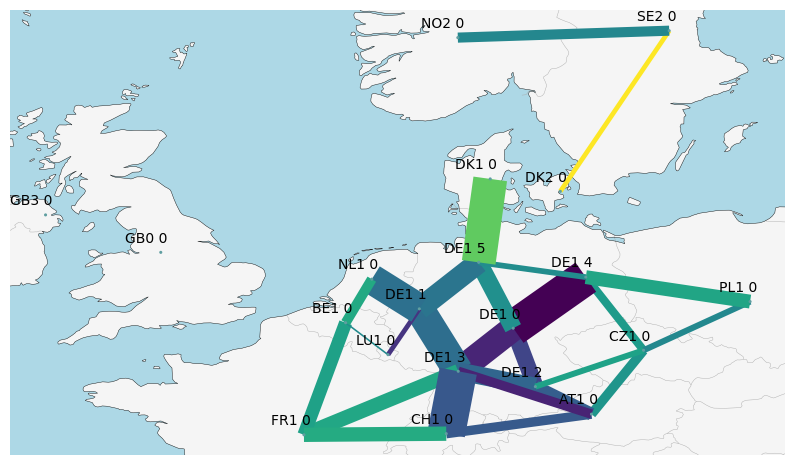

In [11]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [12]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


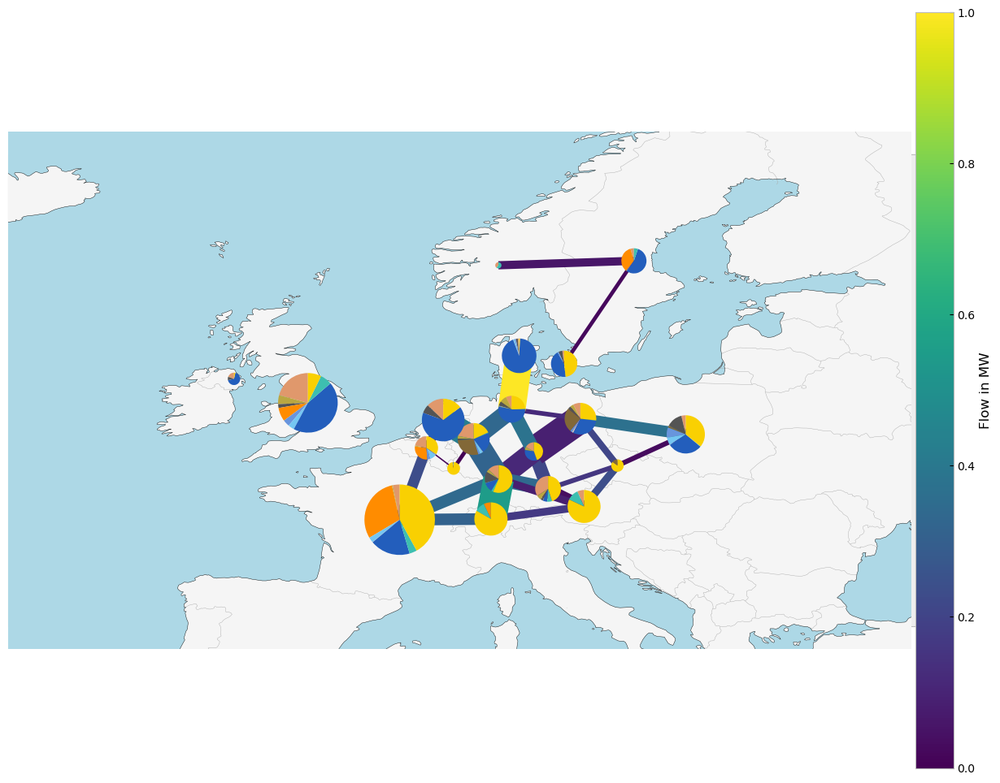

In [13]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [14]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


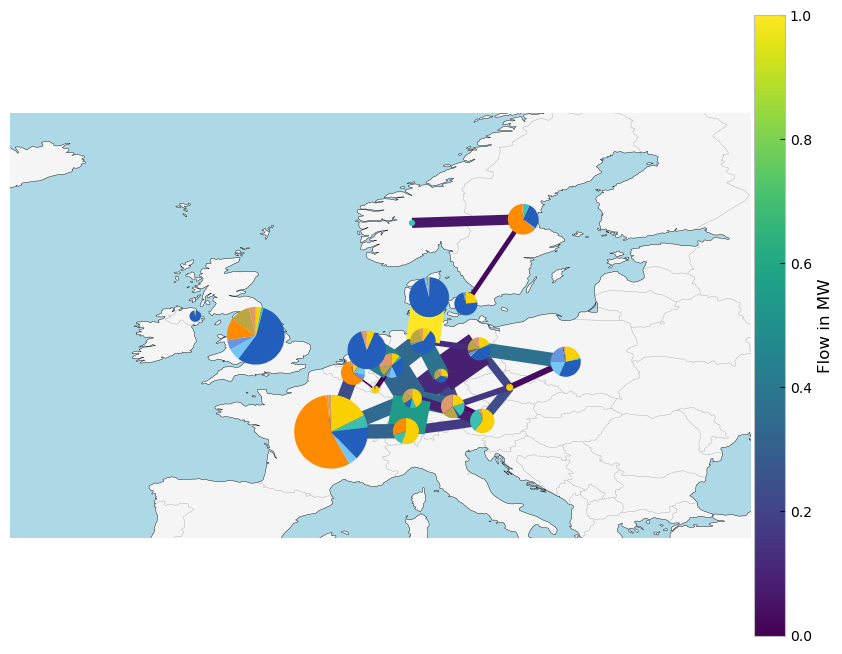

In [15]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

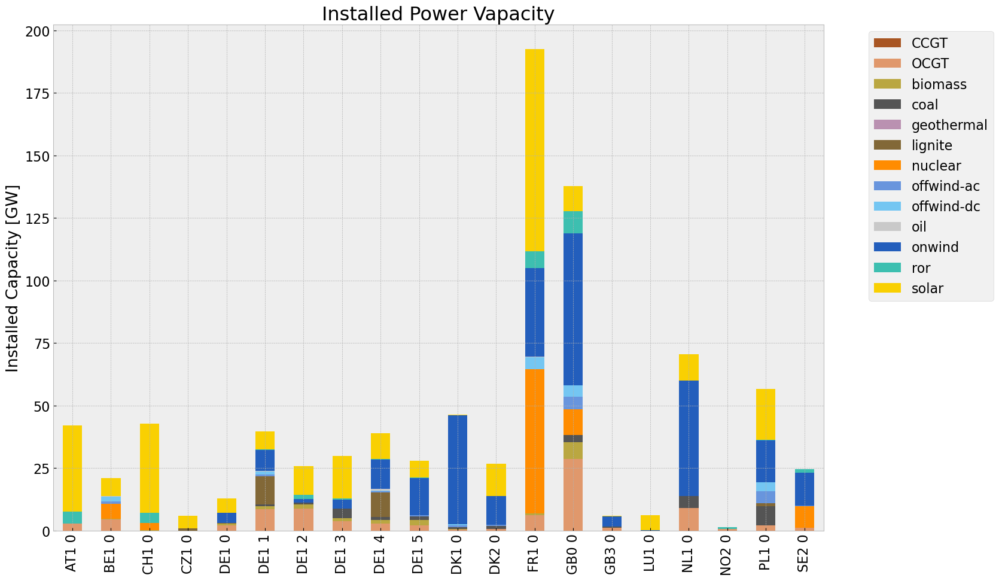

In [16]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

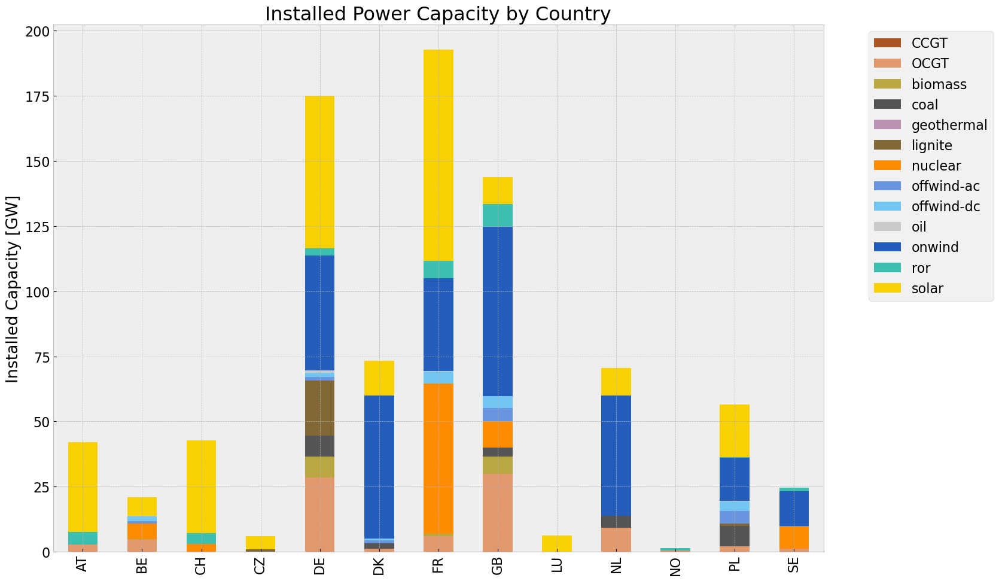

In [17]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

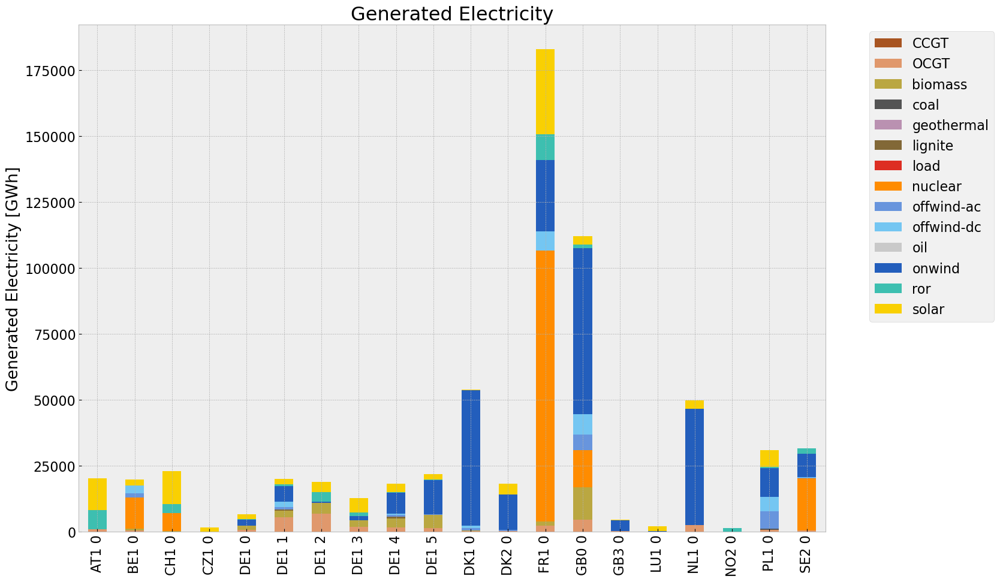

In [18]:
def gen_power_table(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    

    return generations

gen_base = gen_power_table(n,colors_gen_table)

<Figure size 640x480 with 0 Axes>

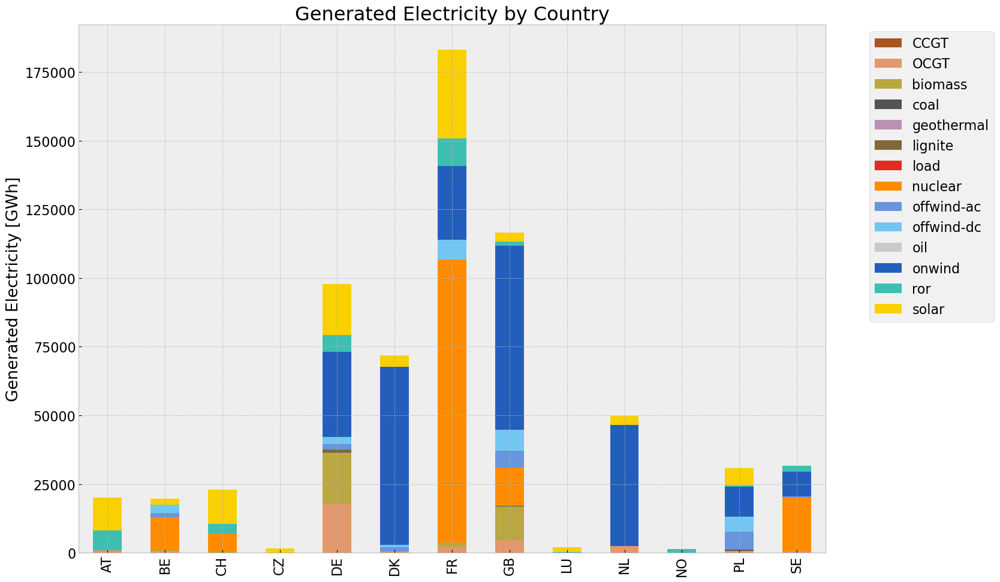

In [19]:
def gen_power_table_country(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    #generations = n.generators
    #generations['country'] = generations['bus'].str[:2]
    #generations = pd.Series(index = n.generators.groupby(['country', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    generations['country'] = generations.index.str[:2]
    generations = generations.groupby(['country']).sum()   
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return generations

gen_base_country = gen_power_table_country(n,colors_gen_table)

## Snapshot

In [20]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [21]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [22]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [23]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [24]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [25]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [26]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

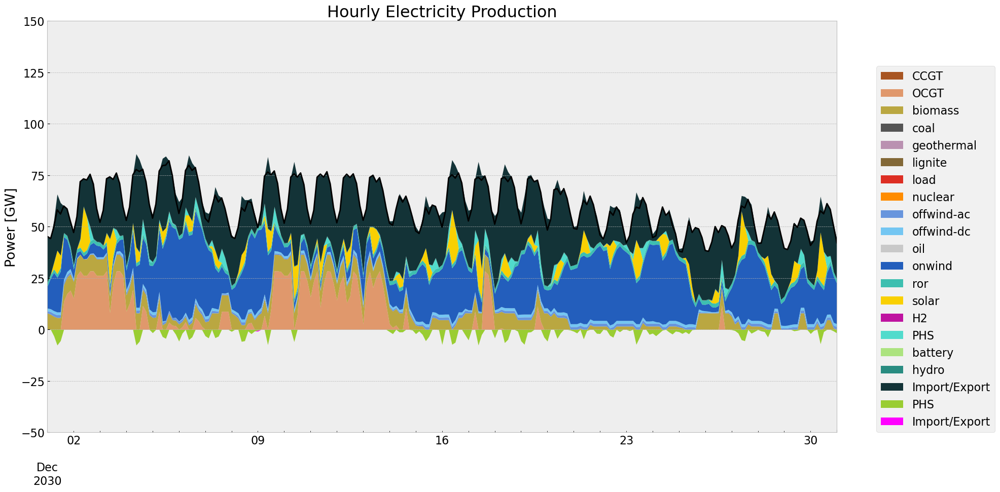

In [27]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

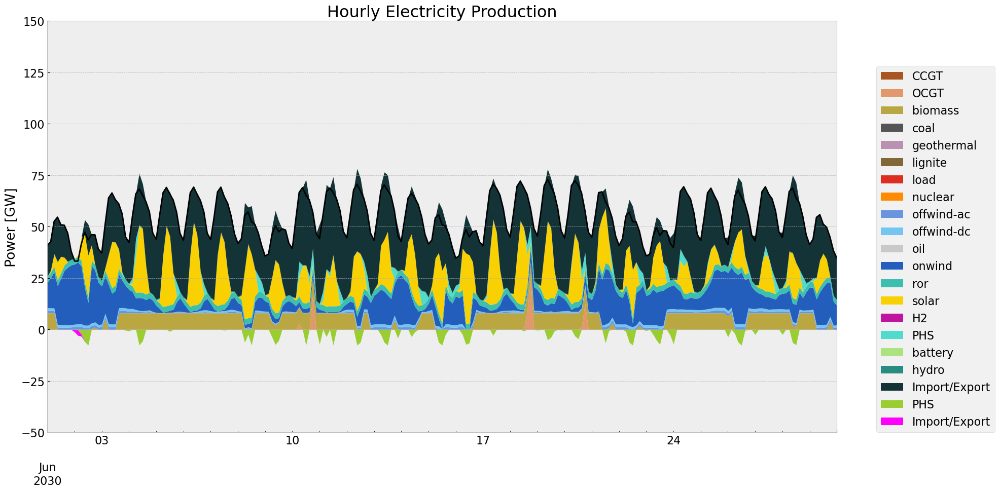

In [28]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [29]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

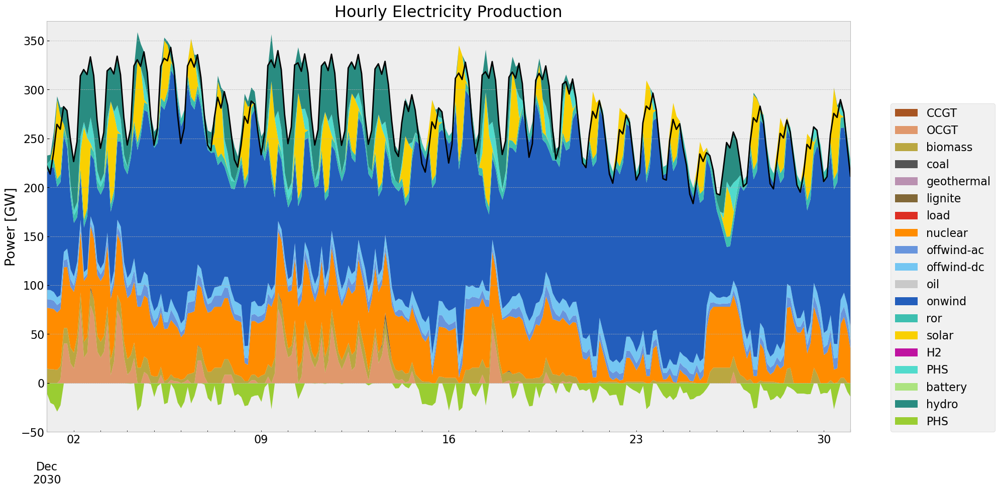

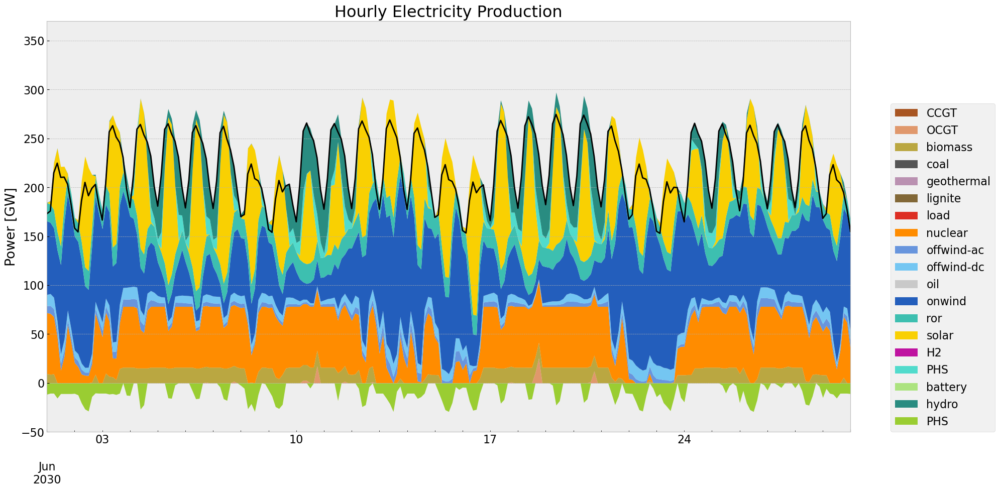

In [30]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [31]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["yellowgreen","magenta","red","blue"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

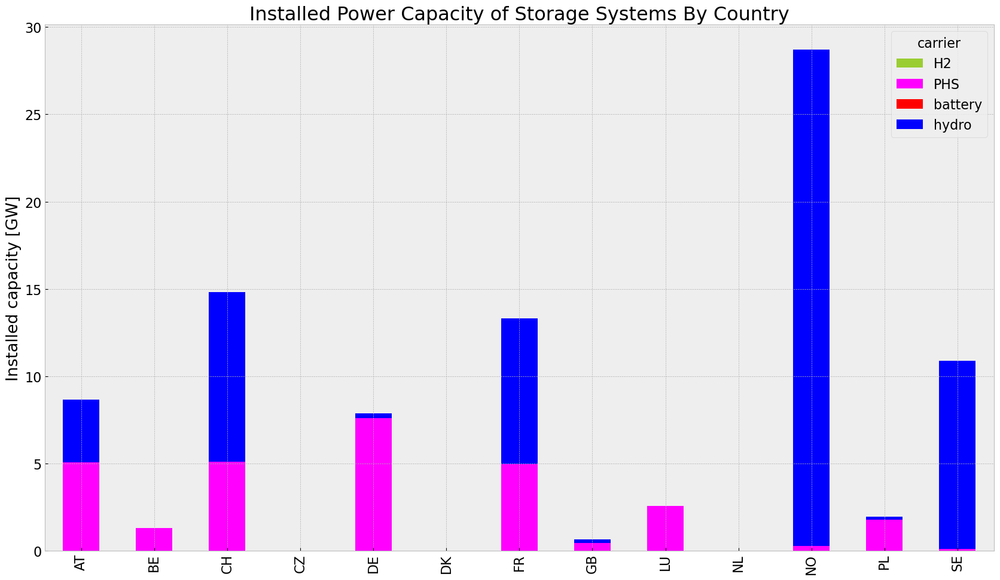

In [32]:
store_base = inst_store_table(n)

In [33]:
def state_of_charge_plot(n):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    soc.plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


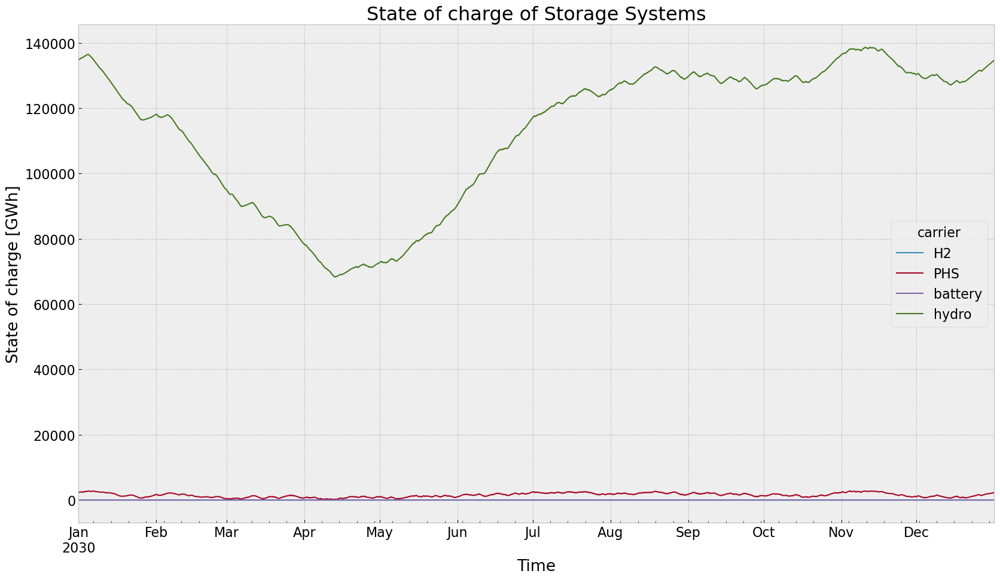

In [34]:
state_of_charge_plot(n)

## Electricity Price

In [35]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [36]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


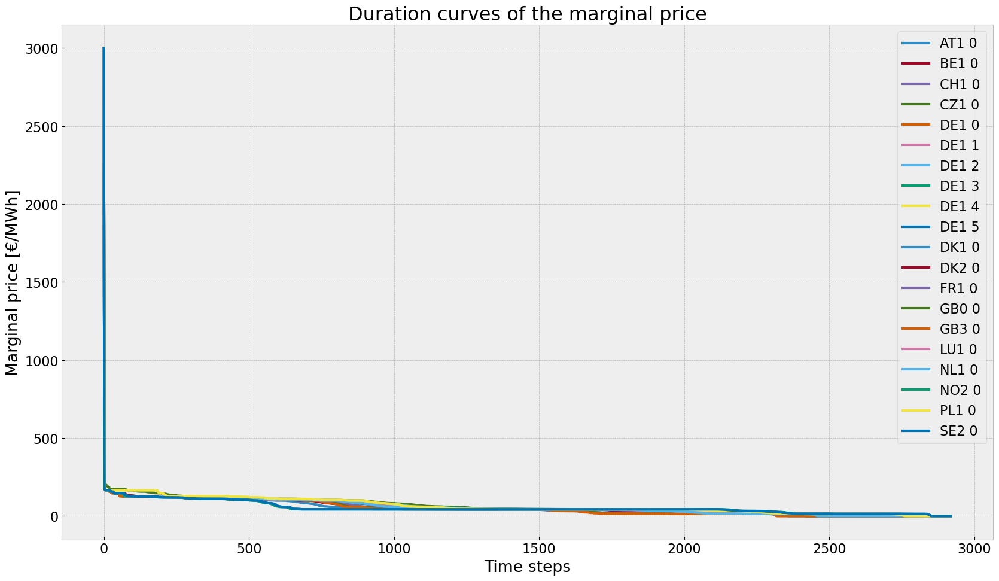

In [37]:
price_dur_curve_plot(n)

In [38]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


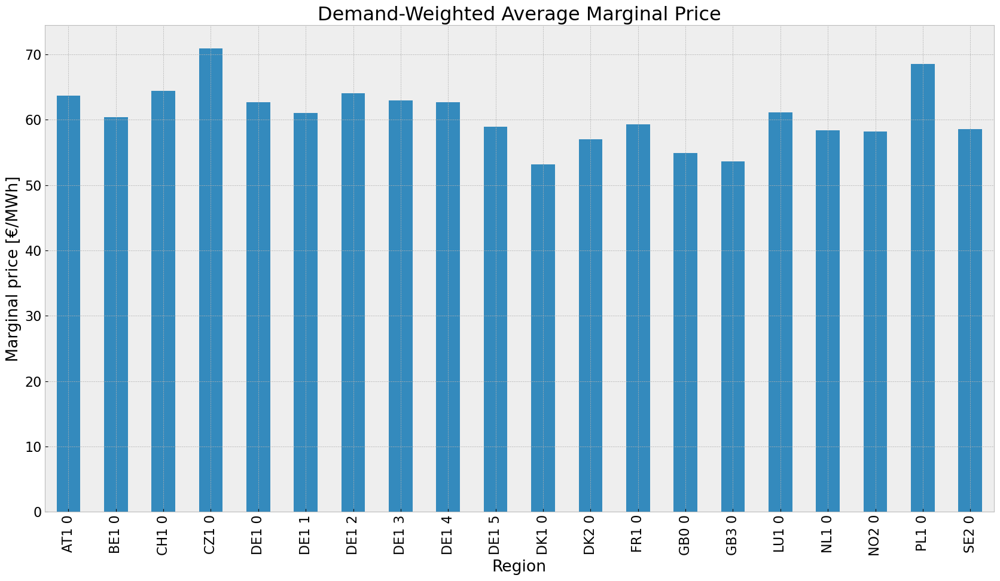

In [39]:
price_regions_table(n)

In [40]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


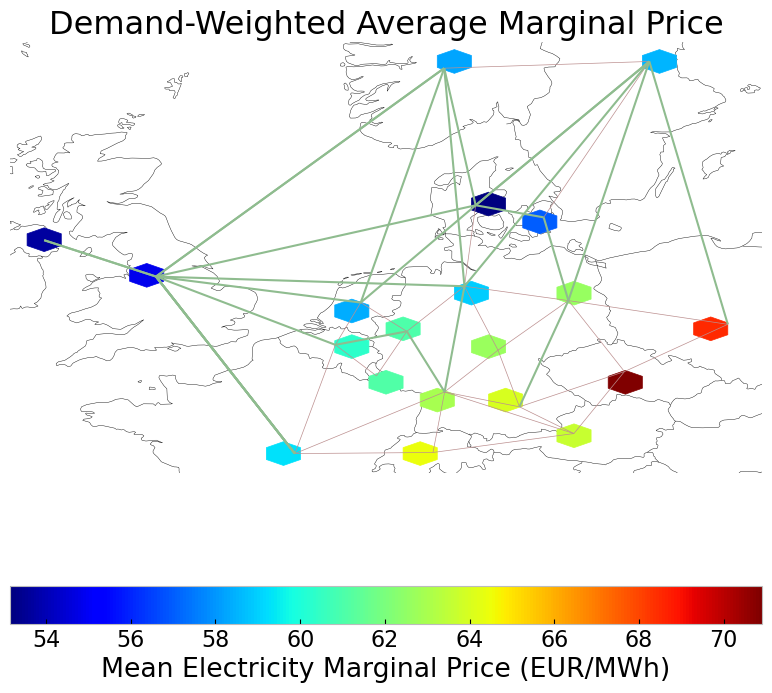

In [41]:
price_regions(n)

## Emission

In [42]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.950103e+07,0.451621,0.1980,1.293387e+07
biomass,3.377481e+07,0.468000,0.0000,0.000000e+00
coal,7.117319e+05,0.329908,0.3361,7.250902e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.211707e+05,0.337285,0.4069,1.111300e+06
load,3.775349e+03,1.000000,0.0000,0.000000e+00
nuclear,1.554148e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.794435e+07,1.000000,0.0000,0.000000e+00


# Drought Scenario



In [45]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.5

def droughtscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)

    #implement drought

    #storage hydro cut
    n_new.storage_units_t.inflow.loc[cut_start:cut_end] *= reductionto

    #ror cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('ror'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu


    return n_new


n1 = droughtscenario(n, cut_start, duration, reductionto)
n1.name = 'inv_drought'          

## 1. Scenario: allow additional investment of extendable generators and storage

### Allow investment

In [46]:
def allow_inv(n1,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']


    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 

allow_inv(n1,n)

In [47]:
n1.optimize(solver_name= "gurobi")
#n1 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Drought\\20240512\\inv_drought.nc")

Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.22it/s]
INFO:linopy.io: Writing time: 39.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4pgram_2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4pgram_2.lp


Reading time = 11.32 seconds


INFO:gurobipy:Reading time = 11.32 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x788eb02a


INFO:gurobipy:Model fingerprint: 0x788eb02a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2150043 rows and 372373 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2150043 rows and 372373 columns (presolve time = 5s) ...


Presolve removed 2150043 rows and 372373 columns


INFO:gurobipy:Presolve removed 2150043 rows and 372373 columns


Presolve time: 6.14s


INFO:gurobipy:Presolve time: 6.14s


Presolved: 1114820 rows, 1149129 columns, 3737809 nonzeros


INFO:gurobipy:Presolved: 1114820 rows, 1149129 columns, 3737809 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 15.05s


INFO:gurobipy:Ordering time: 15.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.970e+06


INFO:gurobipy: AA' NZ     : 3.970e+06


 Factor NZ  : 2.910e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.910e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.213e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.213e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.29510568e+17 -8.23657684e+18  2.82e+10 8.69e+04  8.56e+13    26s


INFO:gurobipy:   0   6.29510568e+17 -8.23657684e+18  2.82e+10 8.69e+04  8.56e+13    26s


   1   5.51089629e+17 -3.54838080e+18  1.80e+10 2.86e+04  5.45e+13    28s


INFO:gurobipy:   1   5.51089629e+17 -3.54838080e+18  1.80e+10 2.86e+04  5.45e+13    28s


   2   4.54384844e+17 -1.79561473e+18  1.43e+10 1.11e+04  3.77e+13    30s


INFO:gurobipy:   2   4.54384844e+17 -1.79561473e+18  1.43e+10 1.11e+04  3.77e+13    30s


   3   3.23355536e+17 -1.06528195e+18  7.42e+09 4.32e+03  1.89e+13    33s


INFO:gurobipy:   3   3.23355536e+17 -1.06528195e+18  7.42e+09 4.32e+03  1.89e+13    33s


   4   2.73496209e+17 -4.87010118e+17  2.88e+09 1.20e+03  7.17e+12    36s


INFO:gurobipy:   4   2.73496209e+17 -4.87010118e+17  2.88e+09 1.20e+03  7.17e+12    36s


   5   2.04133214e+17 -1.32326710e+17  1.07e+09 2.78e+02  2.53e+12    37s


INFO:gurobipy:   5   2.04133214e+17 -1.32326710e+17  1.07e+09 2.78e+02  2.53e+12    37s


   6   6.18897988e+16 -2.65424524e+16  1.05e+08 2.77e+01  2.70e+11    40s


INFO:gurobipy:   6   6.18897988e+16 -2.65424524e+16  1.05e+08 2.77e+01  2.70e+11    40s


   7   1.10651411e+16 -4.59686864e+15  4.64e+06 1.68e+00  1.63e+10    42s


INFO:gurobipy:   7   1.10651411e+16 -4.59686864e+15  4.64e+06 1.68e+00  1.63e+10    42s


   8   2.85766614e+15 -7.68489610e+14  9.15e+05 3.47e-05  3.27e+09    44s


INFO:gurobipy:   8   2.85766614e+15 -7.68489610e+14  9.15e+05 3.47e-05  3.27e+09    44s


   9   1.87475192e+15 -4.35347142e+14  5.87e+05 3.32e-05  2.03e+09    48s


INFO:gurobipy:   9   1.87475192e+15 -4.35347142e+14  5.87e+05 3.32e-05  2.03e+09    48s


  10   1.34255821e+15 -2.82329782e+14  4.07e+05 1.27e-05  1.36e+09    51s


INFO:gurobipy:  10   1.34255821e+15 -2.82329782e+14  4.07e+05 1.27e-05  1.36e+09    51s


  11   9.79164909e+14 -1.62088229e+14  2.89e+05 8.14e-06  9.01e+08    53s


INFO:gurobipy:  11   9.79164909e+14 -1.62088229e+14  2.89e+05 8.14e-06  9.01e+08    53s


  12   7.14936403e+14 -1.09576461e+14  2.06e+05 9.76e-06  6.16e+08    55s


INFO:gurobipy:  12   7.14936403e+14 -1.09576461e+14  2.06e+05 9.76e-06  6.16e+08    55s


  13   4.58612061e+14 -7.78689300e+13  1.27e+05 5.61e-05  3.74e+08    58s


INFO:gurobipy:  13   4.58612061e+14 -7.78689300e+13  1.27e+05 5.61e-05  3.74e+08    58s


  14   3.09410400e+14 -4.45297647e+13  8.37e+04 2.86e-05  2.35e+08    61s


INFO:gurobipy:  14   3.09410400e+14 -4.45297647e+13  8.37e+04 2.86e-05  2.35e+08    61s


  15   2.25562330e+14 -2.88934180e+13  6.10e+04 2.10e-05  1.60e+08    64s


INFO:gurobipy:  15   2.25562330e+14 -2.88934180e+13  6.10e+04 2.10e-05  1.60e+08    64s


  16   1.19819984e+14 -1.86071848e+13  3.14e+04 1.14e-05  8.14e+07    66s


INFO:gurobipy:  16   1.19819984e+14 -1.86071848e+13  3.14e+04 1.14e-05  8.14e+07    66s


  17   9.33065485e+13 -1.07084515e+13  2.42e+04 1.65e-06  5.93e+07    68s


INFO:gurobipy:  17   9.33065485e+13 -1.07084515e+13  2.42e+04 1.65e-06  5.93e+07    68s


  18   5.53570737e+13 -7.79813164e+12  1.41e+04 6.71e-06  3.45e+07    70s


INFO:gurobipy:  18   5.53570737e+13 -7.79813164e+12  1.41e+04 6.71e-06  3.45e+07    70s


  19   3.39790723e+13 -7.36702315e+12  8.86e+03 4.59e-06  2.21e+07    73s


INFO:gurobipy:  19   3.39790723e+13 -7.36702315e+12  8.86e+03 4.59e-06  2.21e+07    73s


  20   3.02414694e+13 -6.83938502e+12  8.04e+03 3.83e-06  1.97e+07    75s


INFO:gurobipy:  20   3.02414694e+13 -6.83938502e+12  8.04e+03 3.83e-06  1.97e+07    75s


  21   2.29198938e+13 -6.40846091e+12  6.14e+03 3.56e-06  1.53e+07    77s


INFO:gurobipy:  21   2.29198938e+13 -6.40846091e+12  6.14e+03 3.56e-06  1.53e+07    77s


  22   1.84280380e+13 -5.60050139e+12  4.89e+03 2.06e-06  1.23e+07    79s


INFO:gurobipy:  22   1.84280380e+13 -5.60050139e+12  4.89e+03 2.06e-06  1.23e+07    79s


  23   1.29092775e+13 -4.08846876e+12  3.48e+03 7.90e-07  8.51e+06    82s


INFO:gurobipy:  23   1.29092775e+13 -4.08846876e+12  3.48e+03 7.90e-07  8.51e+06    82s


  24   5.81233038e+12 -3.54579138e+12  1.52e+03 4.62e-07  4.47e+06    86s


INFO:gurobipy:  24   5.81233038e+12 -3.54579138e+12  1.52e+03 4.62e-07  4.47e+06    86s


  25   2.86176298e+12 -2.41783915e+12  6.92e+02 1.31e-06  2.40e+06    89s


INFO:gurobipy:  25   2.86176298e+12 -2.41783915e+12  6.92e+02 1.31e-06  2.40e+06    89s


  26   1.84137368e+12 -1.97253774e+12  4.14e+02 1.19e-06  1.69e+06    93s


INFO:gurobipy:  26   1.84137368e+12 -1.97253774e+12  4.14e+02 1.19e-06  1.69e+06    93s


  27   1.47340472e+12 -1.36508906e+12  3.21e+02 1.82e-06  1.24e+06    95s


INFO:gurobipy:  27   1.47340472e+12 -1.36508906e+12  3.21e+02 1.82e-06  1.24e+06    95s


  28   1.05797900e+12 -1.16590981e+12  2.22e+02 9.24e-07  9.61e+05    97s


INFO:gurobipy:  28   1.05797900e+12 -1.16590981e+12  2.22e+02 9.24e-07  9.61e+05    97s


  29   1.03905435e+12 -1.11559518e+12  2.17e+02 8.49e-07  9.31e+05    99s


INFO:gurobipy:  29   1.03905435e+12 -1.11559518e+12  2.17e+02 8.49e-07  9.31e+05    99s


  30   5.71965615e+11 -7.97887210e+11  1.05e+02 7.00e-07  5.79e+05   101s


INFO:gurobipy:  30   5.71965615e+11 -7.97887210e+11  1.05e+02 7.00e-07  5.79e+05   101s


  31   5.23032766e+11 -4.34171481e+11  9.41e+01 1.12e-06  4.06e+05   104s


INFO:gurobipy:  31   5.23032766e+11 -4.34171481e+11  9.41e+01 1.12e-06  4.06e+05   104s


  32   3.23501181e+11 -1.59410194e+11  5.06e+01 1.41e-06  2.04e+05   107s


INFO:gurobipy:  32   3.23501181e+11 -1.59410194e+11  5.06e+01 1.41e-06  2.04e+05   107s


  33   2.09230428e+11 -8.44033515e+10  2.78e+01 8.34e-07  1.23e+05   111s


INFO:gurobipy:  33   2.09230428e+11 -8.44033515e+10  2.78e+01 8.34e-07  1.23e+05   111s


  34   1.71805793e+11 -4.96344637e+09  2.06e+01 1.45e-06  7.45e+04   113s


INFO:gurobipy:  34   1.71805793e+11 -4.96344637e+09  2.06e+01 1.45e-06  7.45e+04   113s


  35   1.47602299e+11  8.95555201e+09  1.62e+01 9.98e-07  5.84e+04   115s


INFO:gurobipy:  35   1.47602299e+11  8.95555201e+09  1.62e+01 9.98e-07  5.84e+04   115s


  36   1.38334727e+11  1.61121033e+10  1.44e+01 7.30e-07  5.15e+04   117s


INFO:gurobipy:  36   1.38334727e+11  1.61121033e+10  1.44e+01 7.30e-07  5.15e+04   117s


  37   1.27354322e+11  2.45824576e+10  1.23e+01 7.45e-07  4.33e+04   119s


INFO:gurobipy:  37   1.27354322e+11  2.45824576e+10  1.23e+01 7.45e-07  4.33e+04   119s


  38   1.12642500e+11  3.33180987e+10  9.70e+00 8.79e-07  3.35e+04   121s


INFO:gurobipy:  38   1.12642500e+11  3.33180987e+10  9.70e+00 8.79e-07  3.35e+04   121s


  39   1.00605066e+11  4.01583161e+10  7.68e+00 2.26e-06  2.55e+04   123s


INFO:gurobipy:  39   1.00605066e+11  4.01583161e+10  7.68e+00 2.26e-06  2.55e+04   123s


  40   9.02408131e+10  4.73349654e+10  5.89e+00 3.43e-07  1.82e+04   126s


INFO:gurobipy:  40   9.02408131e+10  4.73349654e+10  5.89e+00 3.43e-07  1.82e+04   126s


  41   8.05807104e+10  4.97965077e+10  4.17e+00 3.28e-07  1.30e+04   129s


INFO:gurobipy:  41   8.05807104e+10  4.97965077e+10  4.17e+00 3.28e-07  1.30e+04   129s


  42   7.54218106e+10  5.16224799e+10  3.23e+00 3.28e-07  1.01e+04   132s


INFO:gurobipy:  42   7.54218106e+10  5.16224799e+10  3.23e+00 3.28e-07  1.01e+04   132s


  43   7.26957422e+10  5.32245582e+10  2.72e+00 3.73e-07  8.26e+03   134s


INFO:gurobipy:  43   7.26957422e+10  5.32245582e+10  2.72e+00 3.73e-07  8.26e+03   134s


  44   6.99231864e+10  5.45803215e+10  2.19e+00 5.07e-07  6.52e+03   138s


INFO:gurobipy:  44   6.99231864e+10  5.45803215e+10  2.19e+00 5.07e-07  6.52e+03   138s


  45   6.70807624e+10  5.56079781e+10  1.66e+00 5.81e-07  4.88e+03   141s


INFO:gurobipy:  45   6.70807624e+10  5.56079781e+10  1.66e+00 5.81e-07  4.88e+03   141s


  46   6.53955832e+10  5.64103576e+10  1.34e+00 7.90e-07  3.83e+03   144s


INFO:gurobipy:  46   6.53955832e+10  5.64103576e+10  1.34e+00 7.90e-07  3.83e+03   144s


  47   6.40611635e+10  5.67870480e+10  1.08e+00 1.88e-06  3.10e+03   147s


INFO:gurobipy:  47   6.40611635e+10  5.67870480e+10  1.08e+00 1.88e-06  3.10e+03   147s


  48   6.33941759e+10  5.71232694e+10  9.53e-01 3.87e-07  2.67e+03   150s


INFO:gurobipy:  48   6.33941759e+10  5.71232694e+10  9.53e-01 3.87e-07  2.67e+03   150s


  49   6.23395885e+10  5.73557017e+10  7.48e-01 1.62e-06  2.12e+03   154s


INFO:gurobipy:  49   6.23395885e+10  5.73557017e+10  7.48e-01 1.62e-06  2.12e+03   154s


  50   6.17720213e+10  5.76737156e+10  6.35e-01 1.94e-06  1.75e+03   157s


INFO:gurobipy:  50   6.17720213e+10  5.76737156e+10  6.35e-01 1.94e-06  1.75e+03   157s


  51   6.11283942e+10  5.78396839e+10  5.04e-01 2.31e-06  1.40e+03   160s


INFO:gurobipy:  51   6.11283942e+10  5.78396839e+10  5.04e-01 2.31e-06  1.40e+03   160s


  52   6.06999631e+10  5.79498127e+10  4.15e-01 5.79e-07  1.17e+03   163s


INFO:gurobipy:  52   6.06999631e+10  5.79498127e+10  4.15e-01 5.79e-07  1.17e+03   163s


  53   6.04378367e+10  5.80679335e+10  3.62e-01 7.85e-07  1.01e+03   167s


INFO:gurobipy:  53   6.04378367e+10  5.80679335e+10  3.62e-01 7.85e-07  1.01e+03   167s


  54   6.01396347e+10  5.81439207e+10  3.01e-01 8.24e-07  8.49e+02   170s


INFO:gurobipy:  54   6.01396347e+10  5.81439207e+10  3.01e-01 8.24e-07  8.49e+02   170s


  55   5.99611077e+10  5.81714610e+10  2.63e-01 5.33e-07  7.60e+02   173s


INFO:gurobipy:  55   5.99611077e+10  5.81714610e+10  2.63e-01 5.33e-07  7.60e+02   173s


  56   5.98793991e+10  5.82721978e+10  2.46e-01 6.56e-07  6.83e+02   176s


INFO:gurobipy:  56   5.98793991e+10  5.82721978e+10  2.46e-01 6.56e-07  6.83e+02   176s


  57   5.96830402e+10  5.83143181e+10  2.05e-01 4.47e-07  5.81e+02   179s


INFO:gurobipy:  57   5.96830402e+10  5.83143181e+10  2.05e-01 4.47e-07  5.81e+02   179s


  58   5.95998908e+10  5.83715270e+10  1.87e-01 5.40e-07  5.22e+02   182s


INFO:gurobipy:  58   5.95998908e+10  5.83715270e+10  1.87e-01 5.40e-07  5.22e+02   182s


  59   5.94696350e+10  5.83997239e+10  1.60e-01 6.11e-07  4.54e+02   186s


INFO:gurobipy:  59   5.94696350e+10  5.83997239e+10  1.60e-01 6.11e-07  4.54e+02   186s


  60   5.94469803e+10  5.84164779e+10  1.55e-01 6.85e-07  4.37e+02   189s


INFO:gurobipy:  60   5.94469803e+10  5.84164779e+10  1.55e-01 6.85e-07  4.37e+02   189s


  61   5.93239536e+10  5.84421746e+10  1.29e-01 6.56e-07  3.74e+02   192s


INFO:gurobipy:  61   5.93239536e+10  5.84421746e+10  1.29e-01 6.56e-07  3.74e+02   192s


  62   5.92656470e+10  5.84872660e+10  1.16e-01 3.85e-07  3.30e+02   195s


INFO:gurobipy:  62   5.92656470e+10  5.84872660e+10  1.16e-01 3.85e-07  3.30e+02   195s


  63   5.92295371e+10  5.85145589e+10  1.09e-01 4.38e-07  3.03e+02   198s


INFO:gurobipy:  63   5.92295371e+10  5.85145589e+10  1.09e-01 4.38e-07  3.03e+02   198s


  64   5.91638151e+10  5.85313749e+10  9.52e-02 3.97e-07  2.68e+02   201s


INFO:gurobipy:  64   5.91638151e+10  5.85313749e+10  9.52e-02 3.97e-07  2.68e+02   201s


  65   5.91450627e+10  5.85427605e+10  9.12e-02 3.56e-07  2.55e+02   203s


INFO:gurobipy:  65   5.91450627e+10  5.85427605e+10  9.12e-02 3.56e-07  2.55e+02   203s


  66   5.91189027e+10  5.85503976e+10  8.56e-02 4.92e-07  2.41e+02   206s


INFO:gurobipy:  66   5.91189027e+10  5.85503976e+10  8.56e-02 4.92e-07  2.41e+02   206s


  67   5.90739354e+10  5.85619533e+10  7.62e-02 3.48e-07  2.17e+02   210s


INFO:gurobipy:  67   5.90739354e+10  5.85619533e+10  7.62e-02 3.48e-07  2.17e+02   210s


  68   5.90658618e+10  5.85786065e+10  7.46e-02 6.18e-07  2.06e+02   213s


INFO:gurobipy:  68   5.90658618e+10  5.85786065e+10  7.46e-02 6.18e-07  2.06e+02   213s


  69   5.90267838e+10  5.85887442e+10  6.64e-02 5.60e-07  1.85e+02   216s


INFO:gurobipy:  69   5.90267838e+10  5.85887442e+10  6.64e-02 5.60e-07  1.85e+02   216s


  70   5.89789272e+10  5.85981746e+10  5.63e-02 4.47e-07  1.61e+02   219s


INFO:gurobipy:  70   5.89789272e+10  5.85981746e+10  5.63e-02 4.47e-07  1.61e+02   219s


  71   5.89610104e+10  5.86130068e+10  5.24e-02 3.16e-07  1.47e+02   222s


INFO:gurobipy:  71   5.89610104e+10  5.86130068e+10  5.24e-02 3.16e-07  1.47e+02   222s


  72   5.89214194e+10  5.86219721e+10  4.42e-02 3.79e-07  1.26e+02   225s


INFO:gurobipy:  72   5.89214194e+10  5.86219721e+10  4.42e-02 3.79e-07  1.26e+02   225s


  73   5.89076547e+10  5.86335629e+10  4.14e-02 1.16e-06  1.16e+02   228s


INFO:gurobipy:  73   5.89076547e+10  5.86335629e+10  4.14e-02 1.16e-06  1.16e+02   228s


  74   5.88945653e+10  5.86386344e+10  3.87e-02 1.07e-06  1.08e+02   230s


INFO:gurobipy:  74   5.88945653e+10  5.86386344e+10  3.87e-02 1.07e-06  1.08e+02   230s


  75   5.88790397e+10  5.86471273e+10  3.55e-02 8.34e-07  9.80e+01   233s


INFO:gurobipy:  75   5.88790397e+10  5.86471273e+10  3.55e-02 8.34e-07  9.80e+01   233s


  76   5.88606772e+10  5.86516553e+10  3.18e-02 9.24e-07  8.83e+01   236s


INFO:gurobipy:  76   5.88606772e+10  5.86516553e+10  3.18e-02 9.24e-07  8.83e+01   236s


  77   5.88497422e+10  5.86571230e+10  2.95e-02 2.42e-07  8.14e+01   240s


INFO:gurobipy:  77   5.88497422e+10  5.86571230e+10  2.95e-02 2.42e-07  8.14e+01   240s


  78   5.88419580e+10  5.86610813e+10  2.79e-02 2.34e-07  7.64e+01   243s


INFO:gurobipy:  78   5.88419580e+10  5.86610813e+10  2.79e-02 2.34e-07  7.64e+01   243s


  79   5.88188052e+10  5.86641597e+10  2.32e-02 2.27e-07  6.53e+01   246s


INFO:gurobipy:  79   5.88188052e+10  5.86641597e+10  2.32e-02 2.27e-07  6.53e+01   246s


  80   5.88062084e+10  5.86689865e+10  2.06e-02 2.77e-07  5.79e+01   249s


INFO:gurobipy:  80   5.88062084e+10  5.86689865e+10  2.06e-02 2.77e-07  5.79e+01   249s


  81   5.87955490e+10  5.86710342e+10  1.84e-02 3.57e-07  5.25e+01   252s


INFO:gurobipy:  81   5.87955490e+10  5.86710342e+10  1.84e-02 3.57e-07  5.25e+01   252s


  82   5.87871025e+10  5.86745900e+10  1.66e-02 2.65e-07  4.74e+01   255s


INFO:gurobipy:  82   5.87871025e+10  5.86745900e+10  1.66e-02 2.65e-07  4.74e+01   255s


  83   5.87768256e+10  5.86772652e+10  1.45e-02 2.87e-07  4.19e+01   258s


INFO:gurobipy:  83   5.87768256e+10  5.86772652e+10  1.45e-02 2.87e-07  4.19e+01   258s


  84   5.87692073e+10  5.86804292e+10  1.29e-02 1.67e-07  3.74e+01   262s


INFO:gurobipy:  84   5.87692073e+10  5.86804292e+10  1.29e-02 1.67e-07  3.74e+01   262s


  85   5.87626895e+10  5.86833952e+10  1.15e-02 2.42e-07  3.34e+01   265s


INFO:gurobipy:  85   5.87626895e+10  5.86833952e+10  1.15e-02 2.42e-07  3.34e+01   265s


  86   5.87562006e+10  5.86841288e+10  1.02e-02 4.88e-07  3.03e+01   268s


INFO:gurobipy:  86   5.87562006e+10  5.86841288e+10  1.02e-02 4.88e-07  3.03e+01   268s


  87   5.87524572e+10  5.86883752e+10  9.41e-03 7.17e-07  2.70e+01   271s


INFO:gurobipy:  87   5.87524572e+10  5.86883752e+10  9.41e-03 7.17e-07  2.70e+01   271s


  88   5.87444271e+10  5.86898897e+10  7.78e-03 1.23e-07  2.30e+01   275s


INFO:gurobipy:  88   5.87444271e+10  5.86898897e+10  7.78e-03 1.23e-07  2.30e+01   275s


  89   5.87421333e+10  5.86923667e+10  7.31e-03 1.94e-06  2.10e+01   279s


INFO:gurobipy:  89   5.87421333e+10  5.86923667e+10  7.31e-03 1.94e-06  2.10e+01   279s


  90   5.87361262e+10  5.86944783e+10  6.07e-03 2.26e-06  1.75e+01   283s


INFO:gurobipy:  90   5.87361262e+10  5.86944783e+10  6.07e-03 2.26e-06  1.75e+01   283s


  91   5.87334900e+10  5.86956610e+10  5.53e-03 2.26e-06  1.59e+01   288s


INFO:gurobipy:  91   5.87334900e+10  5.86956610e+10  5.53e-03 2.26e-06  1.59e+01   288s


  92   5.87312472e+10  5.86959192e+10  5.07e-03 1.94e-06  1.49e+01   292s


INFO:gurobipy:  92   5.87312472e+10  5.86959192e+10  5.07e-03 1.94e-06  1.49e+01   292s


  93   5.87273945e+10  5.86975489e+10  4.28e-03 2.74e-07  1.26e+01   297s


INFO:gurobipy:  93   5.87273945e+10  5.86975489e+10  4.28e-03 2.74e-07  1.26e+01   297s


  94   5.87261138e+10  5.86991270e+10  4.03e-03 7.00e-07  1.14e+01   300s


INFO:gurobipy:  94   5.87261138e+10  5.86991270e+10  4.03e-03 7.00e-07  1.14e+01   300s


  95   5.87232359e+10  5.86995356e+10  3.44e-03 7.73e-07  9.98e+00   303s


INFO:gurobipy:  95   5.87232359e+10  5.86995356e+10  3.44e-03 7.73e-07  9.98e+00   303s


  96   5.87220486e+10  5.87006253e+10  3.21e-03 1.28e-06  9.03e+00   306s


INFO:gurobipy:  96   5.87220486e+10  5.87006253e+10  3.21e-03 1.28e-06  9.03e+00   306s


  97   5.87198805e+10  5.87014175e+10  2.77e-03 1.49e-06  7.79e+00   309s


INFO:gurobipy:  97   5.87198805e+10  5.87014175e+10  2.77e-03 1.49e-06  7.79e+00   309s


  98   5.87178347e+10  5.87018500e+10  2.36e-03 2.33e-06  6.74e+00   313s


INFO:gurobipy:  98   5.87178347e+10  5.87018500e+10  2.36e-03 2.33e-06  6.74e+00   313s


  99   5.87165352e+10  5.87021813e+10  2.10e-03 2.56e-06  6.05e+00   316s


INFO:gurobipy:  99   5.87165352e+10  5.87021813e+10  2.10e-03 2.56e-06  6.05e+00   316s


 100   5.87150287e+10  5.87028492e+10  1.80e-03 9.98e-07  5.13e+00   320s


INFO:gurobipy: 100   5.87150287e+10  5.87028492e+10  1.80e-03 9.98e-07  5.13e+00   320s


 101   5.87134546e+10  5.87031412e+10  1.48e-03 7.30e-07  4.34e+00   325s


INFO:gurobipy: 101   5.87134546e+10  5.87031412e+10  1.48e-03 7.30e-07  4.34e+00   325s


 102   5.87133339e+10  5.87033120e+10  1.46e-03 7.45e-07  4.22e+00   328s


INFO:gurobipy: 102   5.87133339e+10  5.87033120e+10  1.46e-03 7.45e-07  4.22e+00   328s


 103   5.87121172e+10  5.87035429e+10  1.21e-03 7.75e-07  3.61e+00   330s


INFO:gurobipy: 103   5.87121172e+10  5.87035429e+10  1.21e-03 7.75e-07  3.61e+00   330s


 104   5.87113803e+10  5.87038914e+10  1.07e-03 5.51e-07  3.15e+00   334s


INFO:gurobipy: 104   5.87113803e+10  5.87038914e+10  1.07e-03 5.51e-07  3.15e+00   334s


 105   5.87103511e+10  5.87041296e+10  8.62e-04 5.51e-07  2.62e+00   337s


INFO:gurobipy: 105   5.87103511e+10  5.87041296e+10  8.62e-04 5.51e-07  2.62e+00   337s


 106   5.87098505e+10  5.87045298e+10  7.62e-04 4.62e-07  2.24e+00   340s


INFO:gurobipy: 106   5.87098505e+10  5.87045298e+10  7.62e-04 4.62e-07  2.24e+00   340s


 107   5.87091770e+10  5.87046297e+10  6.29e-04 5.76e-07  1.91e+00   344s


INFO:gurobipy: 107   5.87091770e+10  5.87046297e+10  6.29e-04 5.76e-07  1.91e+00   344s


 108   5.87090956e+10  5.87046968e+10  6.13e-04 5.26e-07  1.85e+00   347s


INFO:gurobipy: 108   5.87090956e+10  5.87046968e+10  6.13e-04 5.26e-07  1.85e+00   347s


 109   5.87085924e+10  5.87048734e+10  5.13e-04 5.07e-07  1.56e+00   350s


INFO:gurobipy: 109   5.87085924e+10  5.87048734e+10  5.13e-04 5.07e-07  1.56e+00   350s


 110   5.87082605e+10  5.87050164e+10  4.47e-04 5.36e-07  1.36e+00   353s


INFO:gurobipy: 110   5.87082605e+10  5.87050164e+10  4.47e-04 5.36e-07  1.36e+00   353s


 111   5.87078225e+10  5.87050871e+10  3.60e-04 5.66e-07  1.15e+00   356s


INFO:gurobipy: 111   5.87078225e+10  5.87050871e+10  3.60e-04 5.66e-07  1.15e+00   356s


 112   5.87075570e+10  5.87052190e+10  3.08e-04 3.87e-07  9.81e-01   360s


INFO:gurobipy: 112   5.87075570e+10  5.87052190e+10  3.08e-04 3.87e-07  9.81e-01   360s


 113   5.87074027e+10  5.87052745e+10  2.78e-04 4.62e-07  8.93e-01   364s


INFO:gurobipy: 113   5.87074027e+10  5.87052745e+10  2.78e-04 4.62e-07  8.93e-01   364s


 114   5.87071630e+10  5.87054340e+10  2.31e-04 5.07e-07  7.26e-01   367s


INFO:gurobipy: 114   5.87071630e+10  5.87054340e+10  2.31e-04 5.07e-07  7.26e-01   367s


 115   5.87069490e+10  5.87054800e+10  1.90e-04 4.32e-07  6.16e-01   370s


INFO:gurobipy: 115   5.87069490e+10  5.87054800e+10  1.90e-04 4.32e-07  6.16e-01   370s


 116   5.87068773e+10  5.87055141e+10  1.76e-04 3.28e-07  5.72e-01   374s


INFO:gurobipy: 116   5.87068773e+10  5.87055141e+10  1.76e-04 3.28e-07  5.72e-01   374s


 117   5.87067510e+10  5.87056342e+10  1.51e-04 4.77e-07  4.69e-01   378s


INFO:gurobipy: 117   5.87067510e+10  5.87056342e+10  1.51e-04 4.77e-07  4.69e-01   378s


 118   5.87064480e+10  5.87057240e+10  9.26e-05 7.06e-07  3.03e-01   381s


INFO:gurobipy: 118   5.87064480e+10  5.87057240e+10  9.26e-05 7.06e-07  3.03e-01   381s


 119   5.87063792e+10  5.87057923e+10  7.93e-05 4.77e-07  2.47e-01   384s


INFO:gurobipy: 119   5.87063792e+10  5.87057923e+10  7.93e-05 4.77e-07  2.47e-01   384s


 120   5.87062499e+10  5.87058426e+10  5.44e-05 4.45e-07  1.71e-01   387s


INFO:gurobipy: 120   5.87062499e+10  5.87058426e+10  5.44e-05 4.45e-07  1.71e-01   387s


 121   5.87061583e+10  5.87058561e+10  3.68e-05 7.15e-07  1.26e-01   390s


INFO:gurobipy: 121   5.87061583e+10  5.87058561e+10  3.68e-05 7.15e-07  1.26e-01   390s


 122   5.87061320e+10  5.87058716e+10  3.18e-05 6.85e-07  1.09e-01   393s


INFO:gurobipy: 122   5.87061320e+10  5.87058716e+10  3.18e-05 6.85e-07  1.09e-01   393s


 123   5.87061090e+10  5.87059099e+10  2.74e-05 8.34e-07  8.37e-02   397s


INFO:gurobipy: 123   5.87061090e+10  5.87059099e+10  2.74e-05 8.34e-07  8.37e-02   397s


 124   5.87060609e+10  5.87059306e+10  1.81e-05 7.15e-07  5.48e-02   401s


INFO:gurobipy: 124   5.87060609e+10  5.87059306e+10  1.81e-05 7.15e-07  5.48e-02   401s


 125   5.87060452e+10  5.87059369e+10  1.51e-05 5.81e-07  4.55e-02   405s


INFO:gurobipy: 125   5.87060452e+10  5.87059369e+10  1.51e-05 5.81e-07  4.55e-02   405s


 126   5.87060140e+10  5.87059524e+10  9.18e-06 6.05e-07  2.60e-02   410s


INFO:gurobipy: 126   5.87060140e+10  5.87059524e+10  9.18e-06 6.05e-07  2.60e-02   410s


 127   5.87060005e+10  5.87059544e+10  6.60e-06 4.67e-07  1.94e-02   415s


INFO:gurobipy: 127   5.87060005e+10  5.87059544e+10  6.60e-06 4.67e-07  1.94e-02   415s


 128   5.87059898e+10  5.87059592e+10  4.56e-06 4.74e-07  1.29e-02   419s


INFO:gurobipy: 128   5.87059898e+10  5.87059592e+10  4.56e-06 4.74e-07  1.29e-02   419s


 129   5.87059863e+10  5.87059605e+10  3.90e-06 6.06e-07  1.09e-02   422s


INFO:gurobipy: 129   5.87059863e+10  5.87059605e+10  3.90e-06 6.06e-07  1.09e-02   422s


 130   5.87059809e+10  5.87059636e+10  2.84e-06 4.31e-07  7.31e-03   424s


INFO:gurobipy: 130   5.87059809e+10  5.87059636e+10  2.84e-06 4.31e-07  7.31e-03   424s


 131   5.87059755e+10  5.87059644e+10  1.82e-06 7.68e-07  4.69e-03   427s


INFO:gurobipy: 131   5.87059755e+10  5.87059644e+10  1.82e-06 7.68e-07  4.69e-03   427s


 132   5.87059722e+10  5.87059653e+10  1.17e-06 2.62e-07  2.93e-03   430s


INFO:gurobipy: 132   5.87059722e+10  5.87059653e+10  1.17e-06 2.62e-07  2.93e-03   430s


 133   5.87059695e+10  5.87059656e+10  6.40e-07 1.62e-07  1.65e-03   432s


INFO:gurobipy: 133   5.87059695e+10  5.87059656e+10  6.40e-07 1.62e-07  1.65e-03   432s


 134   5.87059690e+10  5.87059657e+10  3.14e-04 6.84e-07  1.39e-03   435s


INFO:gurobipy: 134   5.87059690e+10  5.87059657e+10  3.14e-04 6.84e-07  1.39e-03   435s


 135   5.87059674e+10  5.87059659e+10  1.47e-04 3.11e-07  6.41e-04   437s


INFO:gurobipy: 135   5.87059674e+10  5.87059659e+10  1.47e-04 3.11e-07  6.41e-04   437s


 136   5.87059667e+10  5.87059660e+10  8.51e-05 3.71e-07  2.95e-04   440s


INFO:gurobipy: 136   5.87059667e+10  5.87059660e+10  8.51e-05 3.71e-07  2.95e-04   440s


 137   5.87059663e+10  5.87059660e+10  2.57e-05 3.32e-07  9.40e-05   442s


INFO:gurobipy: 137   5.87059663e+10  5.87059660e+10  2.57e-05 3.32e-07  9.40e-05   442s


 138   5.87059662e+10  5.87059660e+10  5.81e-05 1.16e-06  6.54e-05   445s


INFO:gurobipy: 138   5.87059662e+10  5.87059660e+10  5.81e-05 1.16e-06  6.54e-05   445s


INFO:gurobipy:


Barrier solved model in 138 iterations and 444.91 seconds (138.81 work units)


INFO:gurobipy:Barrier solved model in 138 iterations and 444.91 seconds (138.81 work units)


Optimal objective 5.87059662e+10


INFO:gurobipy:Optimal objective 5.87059662e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  586045 DPushes remaining with DInf 0.0000000e+00               447s


INFO:gurobipy:  586045 DPushes remaining with DInf 0.0000000e+00               447s


  138903 DPushes remaining with DInf 0.0000000e+00               520s


INFO:gurobipy:  138903 DPushes remaining with DInf 0.0000000e+00               520s


   48736 DPushes remaining with DInf 0.0000000e+00               550s


INFO:gurobipy:   48736 DPushes remaining with DInf 0.0000000e+00               550s


   27624 DPushes remaining with DInf 0.0000000e+00               557s


INFO:gurobipy:   27624 DPushes remaining with DInf 0.0000000e+00               557s


   22597 DPushes remaining with DInf 0.0000000e+00               563s


INFO:gurobipy:   22597 DPushes remaining with DInf 0.0000000e+00               563s


   19654 DPushes remaining with DInf 0.0000000e+00               565s


INFO:gurobipy:   19654 DPushes remaining with DInf 0.0000000e+00               565s


   19037 DPushes remaining with DInf 0.0000000e+00               571s


INFO:gurobipy:   19037 DPushes remaining with DInf 0.0000000e+00               571s


   17981 DPushes remaining with DInf 0.0000000e+00               575s


INFO:gurobipy:   17981 DPushes remaining with DInf 0.0000000e+00               575s


   16925 DPushes remaining with DInf 0.0000000e+00               580s


INFO:gurobipy:   16925 DPushes remaining with DInf 0.0000000e+00               580s


   15871 DPushes remaining with DInf 0.0000000e+00               586s


INFO:gurobipy:   15871 DPushes remaining with DInf 0.0000000e+00               586s


   14817 DPushes remaining with DInf 0.0000000e+00               591s


INFO:gurobipy:   14817 DPushes remaining with DInf 0.0000000e+00               591s


   13763 DPushes remaining with DInf 0.0000000e+00               596s


INFO:gurobipy:   13763 DPushes remaining with DInf 0.0000000e+00               596s


   12709 DPushes remaining with DInf 0.0000000e+00               602s


INFO:gurobipy:   12709 DPushes remaining with DInf 0.0000000e+00               602s


   11655 DPushes remaining with DInf 0.0000000e+00               608s


INFO:gurobipy:   11655 DPushes remaining with DInf 0.0000000e+00               608s


   10601 DPushes remaining with DInf 0.0000000e+00               612s


INFO:gurobipy:   10601 DPushes remaining with DInf 0.0000000e+00               612s


    9547 DPushes remaining with DInf 0.0000000e+00               616s


INFO:gurobipy:    9547 DPushes remaining with DInf 0.0000000e+00               616s


    8493 DPushes remaining with DInf 0.0000000e+00               621s


INFO:gurobipy:    8493 DPushes remaining with DInf 0.0000000e+00               621s


    7439 DPushes remaining with DInf 0.0000000e+00               626s


INFO:gurobipy:    7439 DPushes remaining with DInf 0.0000000e+00               626s


    6385 DPushes remaining with DInf 0.0000000e+00               631s


INFO:gurobipy:    6385 DPushes remaining with DInf 0.0000000e+00               631s


    5500 DPushes remaining with DInf 0.0000000e+00               639s


INFO:gurobipy:    5500 DPushes remaining with DInf 0.0000000e+00               639s


    5110 DPushes remaining with DInf 0.0000000e+00               643s


INFO:gurobipy:    5110 DPushes remaining with DInf 0.0000000e+00               643s


    4690 DPushes remaining with DInf 0.0000000e+00               648s


INFO:gurobipy:    4690 DPushes remaining with DInf 0.0000000e+00               648s


    4260 DPushes remaining with DInf 0.0000000e+00               653s


INFO:gurobipy:    4260 DPushes remaining with DInf 0.0000000e+00               653s


    3820 DPushes remaining with DInf 0.0000000e+00               658s


INFO:gurobipy:    3820 DPushes remaining with DInf 0.0000000e+00               658s


    3380 DPushes remaining with DInf 0.0000000e+00               663s


INFO:gurobipy:    3380 DPushes remaining with DInf 0.0000000e+00               663s


    2930 DPushes remaining with DInf 0.0000000e+00               669s


INFO:gurobipy:    2930 DPushes remaining with DInf 0.0000000e+00               669s


    2362 DPushes remaining with DInf 0.0000000e+00               672s


INFO:gurobipy:    2362 DPushes remaining with DInf 0.0000000e+00               672s


    1213 DPushes remaining with DInf 0.0000000e+00               677s


INFO:gurobipy:    1213 DPushes remaining with DInf 0.0000000e+00               677s


      83 DPushes remaining with DInf 0.0000000e+00               683s


INFO:gurobipy:      83 DPushes remaining with DInf 0.0000000e+00               683s


       0 DPushes remaining with DInf 0.0000000e+00               684s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               684s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


  479241 PPushes remaining with PInf 7.1944346e-02               685s


INFO:gurobipy:  479241 PPushes remaining with PInf 7.1944346e-02               685s


  223862 PPushes remaining with PInf 1.0834990e+00              1071s


INFO:gurobipy:  223862 PPushes remaining with PInf 1.0834990e+00              1071s


  208921 PPushes remaining with PInf 1.1647375e+00              1084s


INFO:gurobipy:  208921 PPushes remaining with PInf 1.1647375e+00              1084s


  202953 PPushes remaining with PInf 1.1838236e+00              1090s


INFO:gurobipy:  202953 PPushes remaining with PInf 1.1838236e+00              1090s


  201206 PPushes remaining with PInf 1.1811133e+00              1096s


INFO:gurobipy:  201206 PPushes remaining with PInf 1.1811133e+00              1096s


  199011 PPushes remaining with PInf 1.1876429e+00              1106s


INFO:gurobipy:  199011 PPushes remaining with PInf 1.1876429e+00              1106s


  197756 PPushes remaining with PInf 1.2053332e+00              1122s


INFO:gurobipy:  197756 PPushes remaining with PInf 1.2053332e+00              1122s


  197267 PPushes remaining with PInf 1.2022964e+00              1126s


INFO:gurobipy:  197267 PPushes remaining with PInf 1.2022964e+00              1126s


  125917 PPushes remaining with PInf 1.2772955e+00              1261s


INFO:gurobipy:  125917 PPushes remaining with PInf 1.2772955e+00              1261s


  118438 PPushes remaining with PInf 1.2762913e+00              1270s


INFO:gurobipy:  118438 PPushes remaining with PInf 1.2762913e+00              1270s


   55547 PPushes remaining with PInf 1.4264052e+00              1331s


INFO:gurobipy:   55547 PPushes remaining with PInf 1.4264052e+00              1331s


   18423 PPushes remaining with PInf 1.5149016e+00              1360s


INFO:gurobipy:   18423 PPushes remaining with PInf 1.5149016e+00              1360s


   10392 PPushes remaining with PInf 1.6132889e+00              1366s


INFO:gurobipy:   10392 PPushes remaining with PInf 1.6132889e+00              1366s


    8076 PPushes remaining with PInf 8.7139356e-01              1371s


INFO:gurobipy:    8076 PPushes remaining with PInf 8.7139356e-01              1371s


    6134 PPushes remaining with PInf 7.6583067e-01              1375s


INFO:gurobipy:    6134 PPushes remaining with PInf 7.6583067e-01              1375s


    4013 PPushes remaining with PInf 7.6578764e-01              1380s


INFO:gurobipy:    4013 PPushes remaining with PInf 7.6578764e-01              1380s


    1787 PPushes remaining with PInf 7.5668749e-01              1385s


INFO:gurobipy:    1787 PPushes remaining with PInf 7.5668749e-01              1385s


       0 PPushes remaining with PInf 0.0000000e+00              1391s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00              1391s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0757169e+06   1391s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0757169e+06   1391s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  820145    5.8705966e+10   0.000000e+00   1.075717e+06   1392s


INFO:gurobipy:  820145    5.8705966e+10   0.000000e+00   1.075717e+06   1392s


  820535    5.8705966e+10   0.000000e+00   3.820319e+05   1397s


INFO:gurobipy:  820535    5.8705966e+10   0.000000e+00   3.820319e+05   1397s


  820885    5.8705966e+10   0.000000e+00   2.551981e+05   1402s


INFO:gurobipy:  820885    5.8705966e+10   0.000000e+00   2.551981e+05   1402s


  821225    5.8705966e+10   0.000000e+00   2.199243e+05   1406s


INFO:gurobipy:  821225    5.8705966e+10   0.000000e+00   2.199243e+05   1406s


  821525    5.8705966e+10   0.000000e+00   1.852068e+05   1411s


INFO:gurobipy:  821525    5.8705966e+10   0.000000e+00   1.852068e+05   1411s


  821835    5.8705966e+10   0.000000e+00   1.249479e+05   1416s


INFO:gurobipy:  821835    5.8705966e+10   0.000000e+00   1.249479e+05   1416s


  822225    5.8705966e+10   0.000000e+00   1.673649e+05   1420s


INFO:gurobipy:  822225    5.8705966e+10   0.000000e+00   1.673649e+05   1420s


  822752    5.8705966e+10   0.000000e+00   8.275856e+04   1425s


INFO:gurobipy:  822752    5.8705966e+10   0.000000e+00   8.275856e+04   1425s


  823806    5.8705966e+10   0.000000e+00   5.302187e+04   1433s


INFO:gurobipy:  823806    5.8705966e+10   0.000000e+00   5.302187e+04   1433s


  824333    5.8705966e+10   0.000000e+00   1.079470e+04   1437s


INFO:gurobipy:  824333    5.8705966e+10   0.000000e+00   1.079470e+04   1437s


  824860    5.8705966e+10   0.000000e+00   3.021406e+03   1440s


INFO:gurobipy:  824860    5.8705966e+10   0.000000e+00   3.021406e+03   1440s


  825914    5.8705966e+10   0.000000e+00   2.560179e+01   1447s


INFO:gurobipy:  825914    5.8705966e+10   0.000000e+00   2.560179e+01   1447s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


  827203    5.8705966e+10   0.000000e+00   2.577097e-06   1452s


INFO:gurobipy:  827203    5.8705966e+10   0.000000e+00   2.577097e-06   1452s


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


  827205    5.8705966e+10   0.000000e+00   0.000000e+00   1453s


INFO:gurobipy:  827205    5.8705966e+10   0.000000e+00   0.000000e+00   1453s


INFO:gurobipy:


Solved in 827205 iterations and 1453.30 seconds (624.77 work units)


INFO:gurobipy:Solved in 827205 iterations and 1453.30 seconds (624.77 work units)


Optimal objective  5.870596605e+10


INFO:gurobipy:Optimal objective  5.870596605e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.87e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [48]:
#file = "inv_drought.nc"
#output_path = os.path.join(os.getcwd(), file)
#n1.export_to_netcdf(output_path)

In [49]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

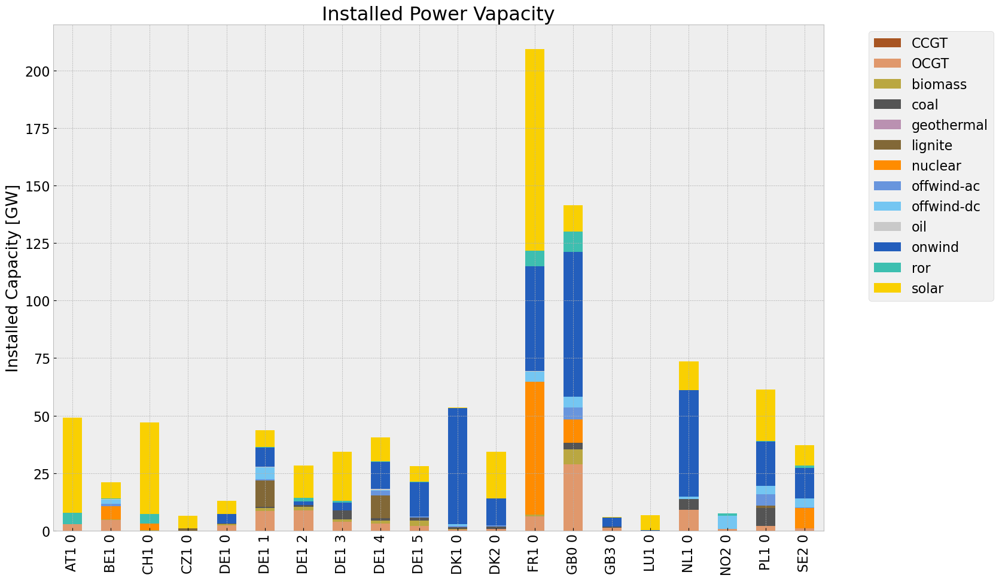

<Figure size 640x480 with 0 Axes>

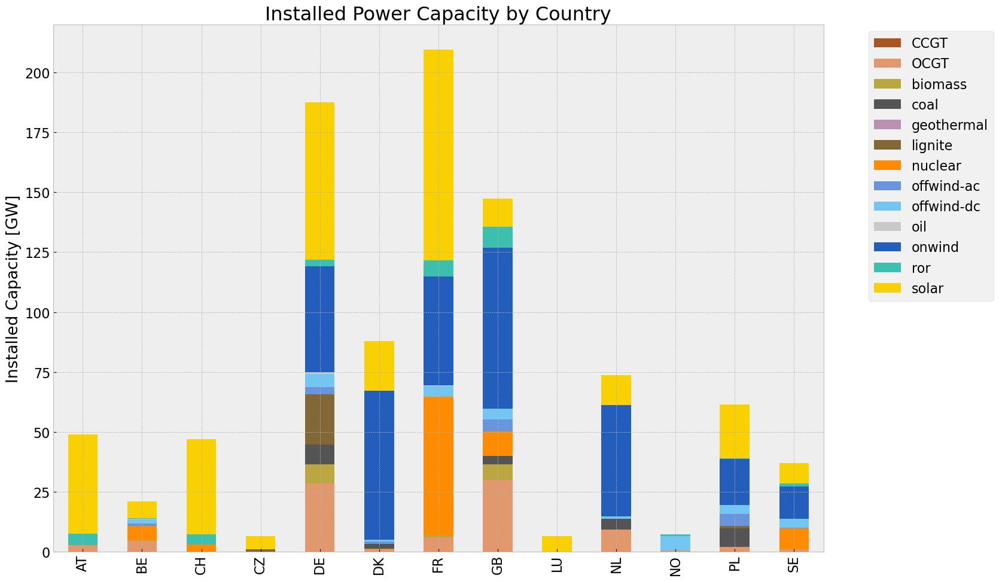

In [50]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


## Generation

<Figure size 640x480 with 0 Axes>

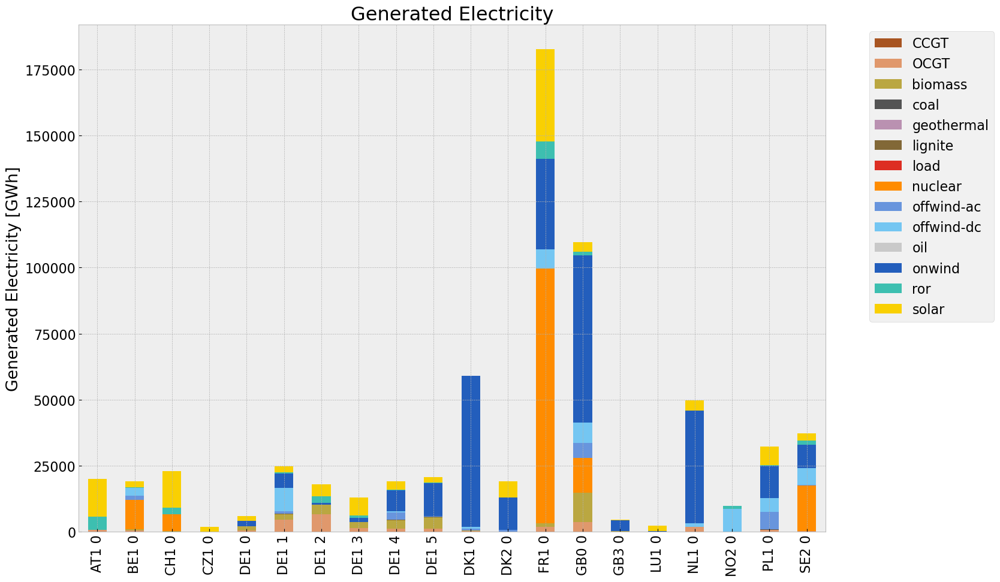

<Figure size 640x480 with 0 Axes>

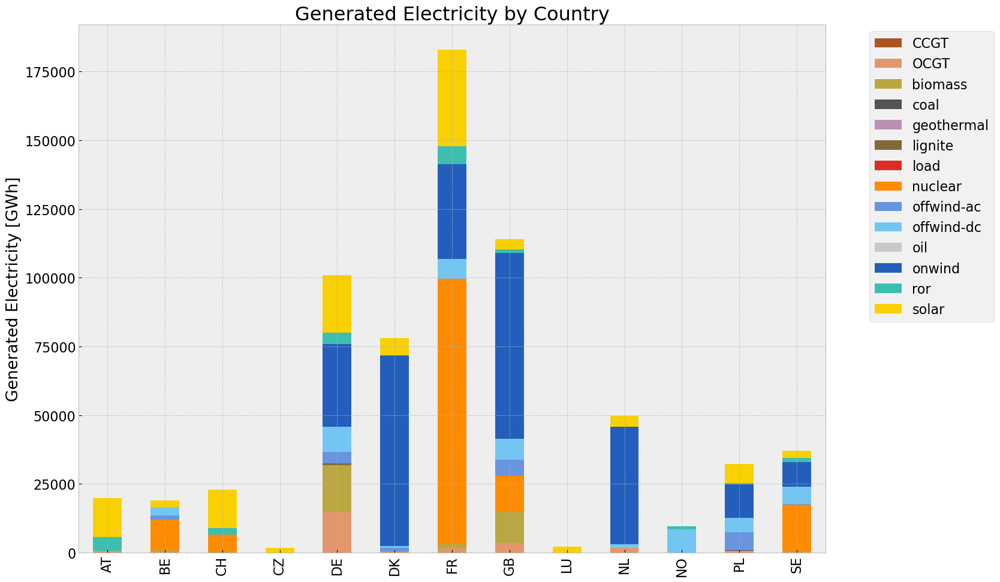

In [51]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1,colors_gen_table)
gen_inv_country = gen_power_table_country(n1,colors_gen_table)

## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

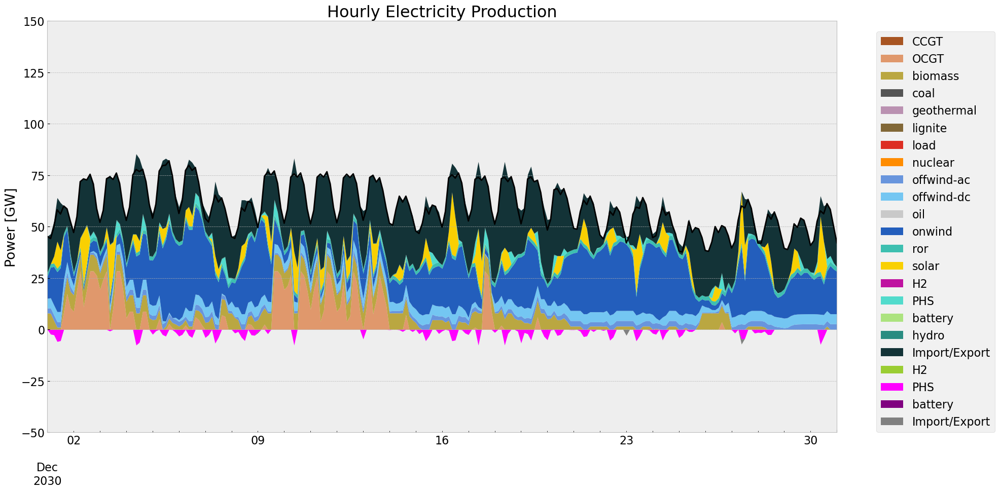

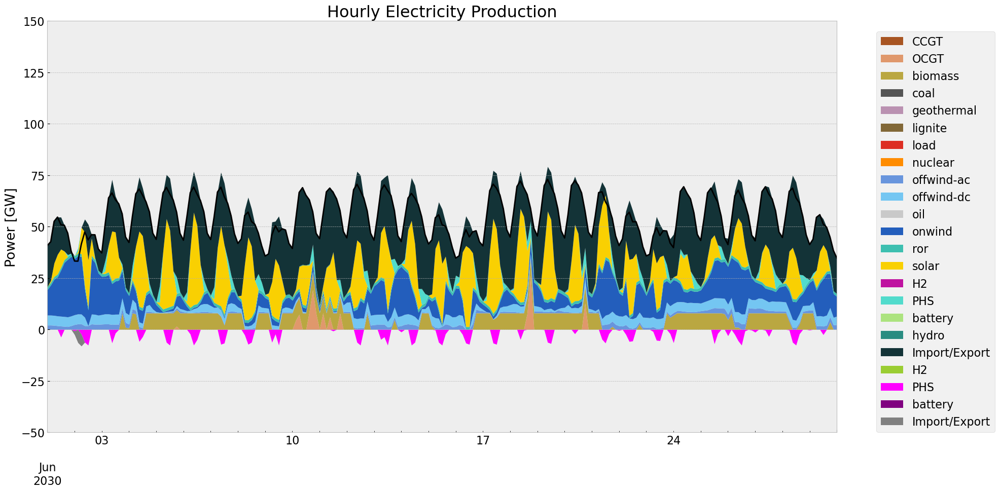

In [52]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-06-1', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

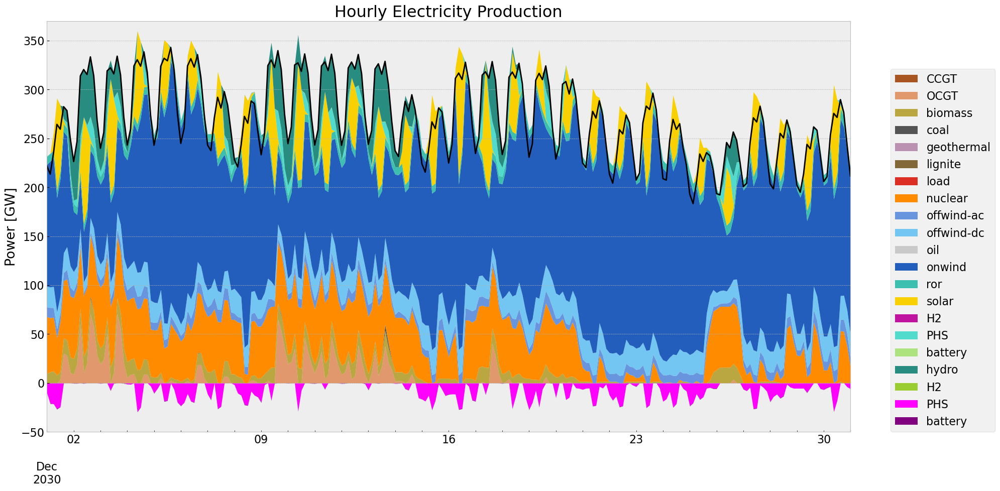

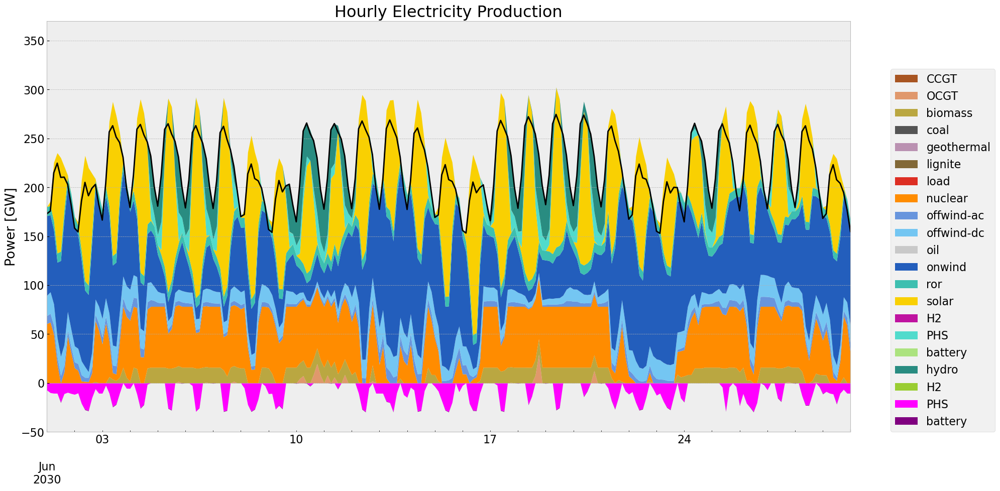

In [53]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

## Storage

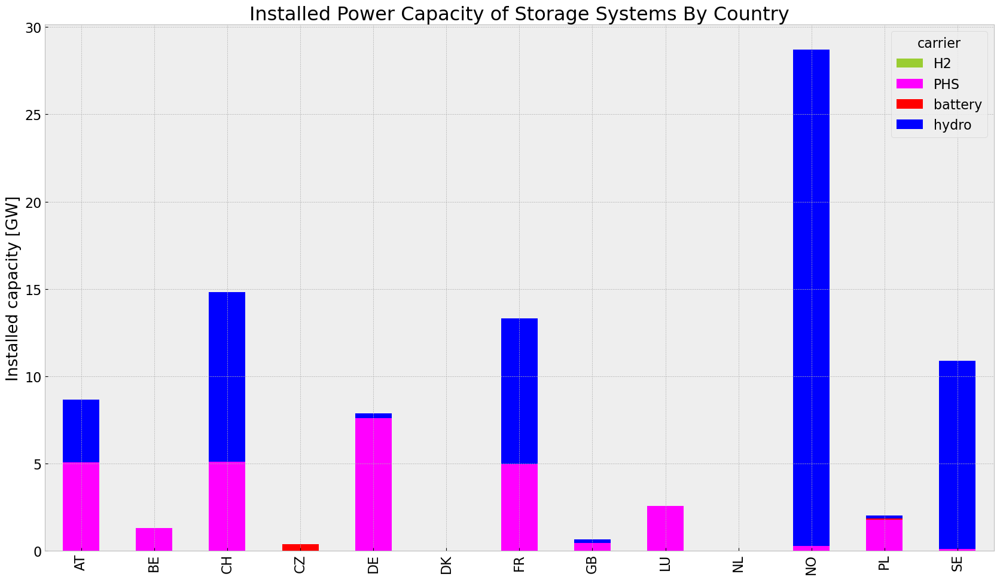

In [54]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


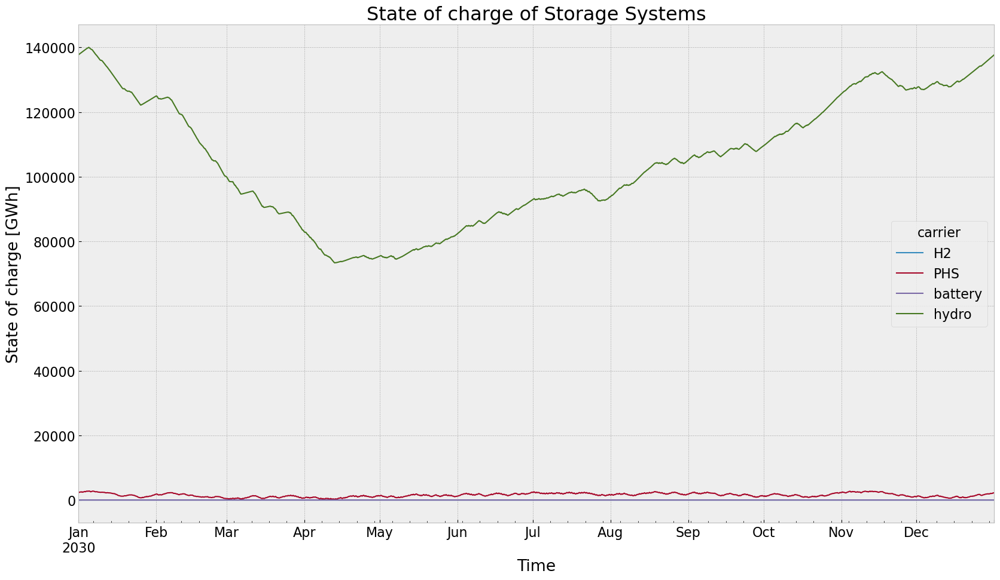

In [55]:
state_of_charge_plot(n1)


## Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


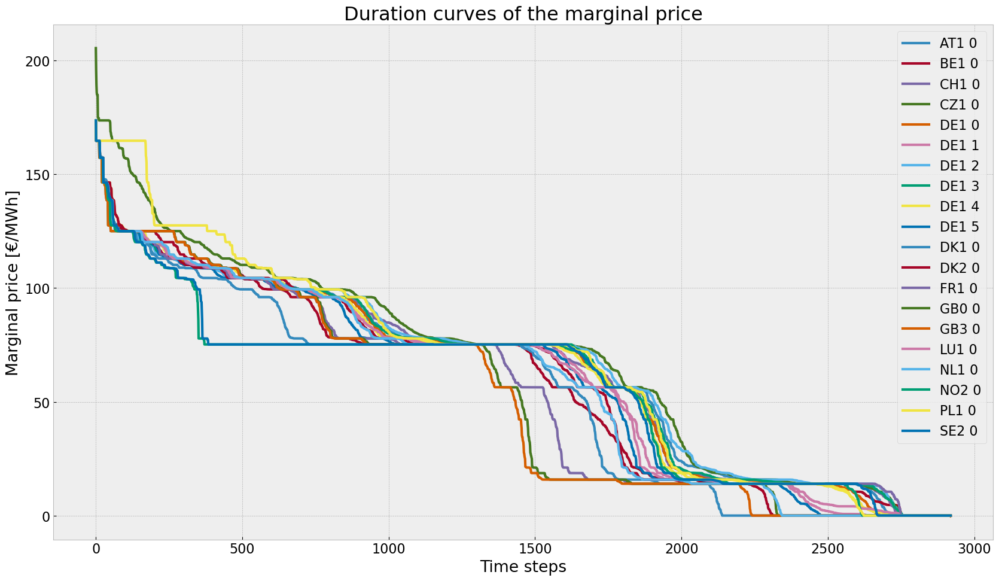

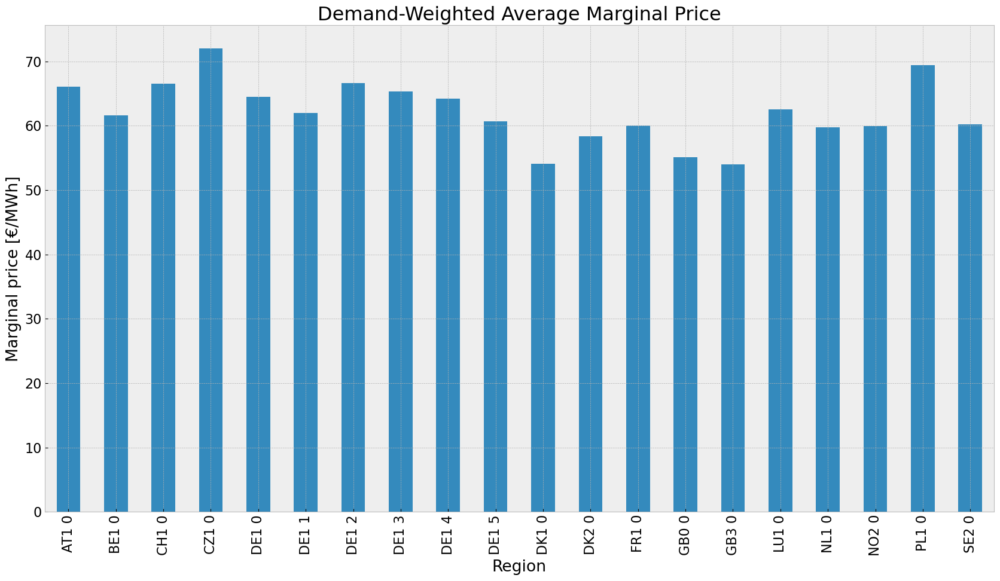

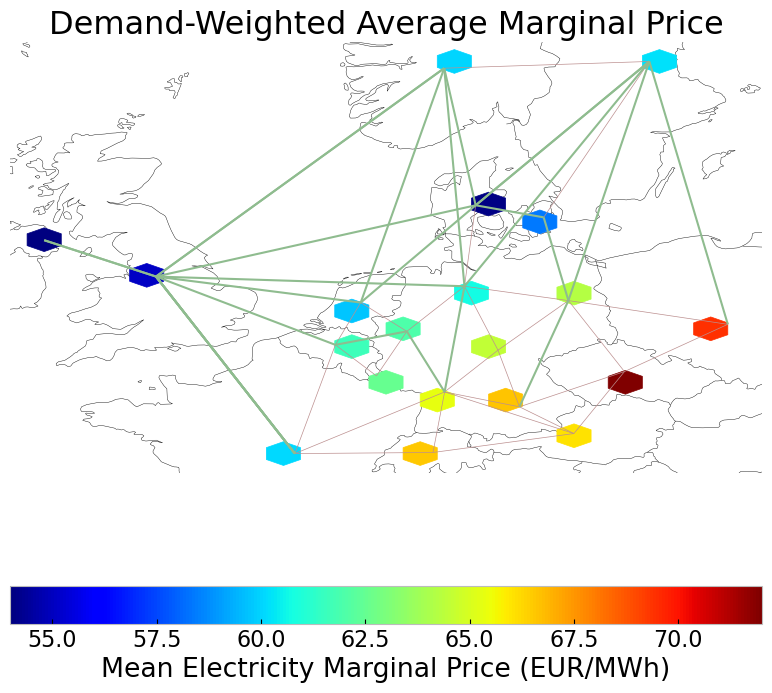

In [56]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


## Emission

In [57]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.376245e+07,0.451621,0.1980,1.041796e+07
biomass,3.063187e+07,0.468000,0.0000,0.000000e+00
coal,5.217035e+05,0.329908,0.3361,5.314953e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.018532e+05,0.337285,0.4069,7.260752e+05
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.446537e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.947079e+07,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [58]:
n2 = droughtscenario(n, cut_start, duration, reductionto)
n2.name = 'noinv_drought'     

### No Investment

In [59]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [60]:
n2.optimize(solver_name ='gurobi')
#n2 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Drought\\20240512\\noinv_drought.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:05<00:00,  1.21it/s]
INFO:linopy.io: Writing time: 36.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpcsh3sz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpcsh3sz.lp


Reading time = 11.48 seconds


INFO:gurobipy:Reading time = 11.48 seconds


obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


INFO:gurobipy:obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


INFO:gurobipy:Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


Model fingerprint: 0xe4ce0456


INFO:gurobipy:Model fingerprint: 0xe4ce0456


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3102057 rows and 854408 columns


INFO:gurobipy:Presolve removed 3102057 rows and 854408 columns


Presolve time: 3.53s


INFO:gurobipy:Presolve time: 3.53s


Presolved: 162503 rows, 666912 columns, 1107792 nonzeros


INFO:gurobipy:Presolved: 162503 rows, 666912 columns, 1107792 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.30s


INFO:gurobipy:Ordering time: 0.30s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.647e+05


INFO:gurobipy: AA' NZ     : 4.647e+05


 Factor NZ  : 5.751e+06 (roughly 400 MB of memory)


INFO:gurobipy: Factor NZ  : 5.751e+06 (roughly 400 MB of memory)


 Factor Ops : 4.303e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.303e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.50180278e+13 -1.93257561e+15  6.95e+05 1.03e+03  2.38e+09     5s


INFO:gurobipy:   0   3.50180278e+13 -1.93257561e+15  6.95e+05 1.03e+03  2.38e+09     5s


   1   1.02677705e+13 -6.02547198e+13  7.47e+04 1.18e-11  1.38e+08     5s


INFO:gurobipy:   1   1.02677705e+13 -6.02547198e+13  7.47e+04 1.18e-11  1.38e+08     5s


   2   1.86656110e+12 -1.46415859e+13  3.93e+03 1.09e-11  1.56e+07     6s


INFO:gurobipy:   2   1.86656110e+12 -1.46415859e+13  3.93e+03 1.09e-11  1.56e+07     6s


   3   5.95452819e+11 -3.56567056e+12  4.36e+02 1.22e-10  3.31e+06     6s


INFO:gurobipy:   3   5.95452819e+11 -3.56567056e+12  4.36e+02 1.22e-10  3.31e+06     6s


   4   2.40984218e+11 -1.83183086e+12  1.57e+02 5.09e-11  1.60e+06     7s


INFO:gurobipy:   4   2.40984218e+11 -1.83183086e+12  1.57e+02 5.09e-11  1.60e+06     7s


   5   1.53696515e+11 -9.42765831e+11  8.21e+01 2.36e-11  8.39e+05     7s


INFO:gurobipy:   5   1.53696515e+11 -9.42765831e+11  8.21e+01 2.36e-11  8.39e+05     7s


   6   1.15595688e+11 -3.79484559e+11  4.49e+01 1.46e-11  3.76e+05     7s


INFO:gurobipy:   6   1.15595688e+11 -3.79484559e+11  4.49e+01 1.46e-11  3.76e+05     7s


   7   8.44792204e+10 -2.07767434e+11  1.93e+01 1.09e-11  2.21e+05     7s


INFO:gurobipy:   7   8.44792204e+10 -2.07767434e+11  1.93e+01 1.09e-11  2.21e+05     7s


   8   6.42308768e+10 -4.93170785e+10  7.18e+00 7.28e-12  8.54e+04     8s


INFO:gurobipy:   8   6.42308768e+10 -4.93170785e+10  7.18e+00 7.28e-12  8.54e+04     8s


   9   5.82410682e+10 -2.99644559e+10  4.92e+00 7.28e-12  6.63e+04     8s


INFO:gurobipy:   9   5.82410682e+10 -2.99644559e+10  4.92e+00 7.28e-12  6.63e+04     8s


  10   4.77213193e+10 -1.90693088e+10  1.55e+00 7.28e-12  5.01e+04     9s


INFO:gurobipy:  10   4.77213193e+10 -1.90693088e+10  1.55e+00 7.28e-12  5.01e+04     9s


  11   4.50155250e+10  9.10331883e+09  9.49e-01 5.46e-12  2.69e+04     9s


INFO:gurobipy:  11   4.50155250e+10  9.10331883e+09  9.49e-01 5.46e-12  2.69e+04     9s


  12   4.29604083e+10  2.35097395e+10  5.83e-01 3.64e-12  1.46e+04     9s


INFO:gurobipy:  12   4.29604083e+10  2.35097395e+10  5.83e-01 3.64e-12  1.46e+04     9s


  13   4.08682475e+10  3.20977679e+10  2.59e-01 3.64e-12  6.58e+03    10s


INFO:gurobipy:  13   4.08682475e+10  3.20977679e+10  2.59e-01 3.64e-12  6.58e+03    10s


  14   3.97889158e+10  3.49573816e+10  1.24e-01 3.64e-12  3.62e+03    10s


INFO:gurobipy:  14   3.97889158e+10  3.49573816e+10  1.24e-01 3.64e-12  3.62e+03    10s


  15   3.94790489e+10  3.61431238e+10  9.05e-02 3.25e-12  2.50e+03    10s


INFO:gurobipy:  15   3.94790489e+10  3.61431238e+10  9.05e-02 3.25e-12  2.50e+03    10s


  16   3.92929573e+10  3.68577650e+10  7.14e-02 2.06e-12  1.83e+03    11s


INFO:gurobipy:  16   3.92929573e+10  3.68577650e+10  7.14e-02 2.06e-12  1.83e+03    11s


  17   3.91040948e+10  3.74468415e+10  5.26e-02 2.40e-12  1.24e+03    11s


INFO:gurobipy:  17   3.91040948e+10  3.74468415e+10  5.26e-02 2.40e-12  1.24e+03    11s


  18   3.89452955e+10  3.78402314e+10  3.72e-02 3.48e-12  8.29e+02    11s


INFO:gurobipy:  18   3.89452955e+10  3.78402314e+10  3.72e-02 3.48e-12  8.29e+02    11s


  19   3.87635733e+10  3.80847993e+10  2.00e-02 2.61e-12  5.09e+02    12s


INFO:gurobipy:  19   3.87635733e+10  3.80847993e+10  2.00e-02 2.61e-12  5.09e+02    12s


  20   3.87045533e+10  3.82830911e+10  1.46e-02 1.88e-12  3.16e+02    12s


INFO:gurobipy:  20   3.87045533e+10  3.82830911e+10  1.46e-02 1.88e-12  3.16e+02    12s


  21   3.86389534e+10  3.83618502e+10  8.72e-03 1.82e-12  2.08e+02    12s


INFO:gurobipy:  21   3.86389534e+10  3.83618502e+10  8.72e-03 1.82e-12  2.08e+02    12s


  22   3.86151732e+10  3.84135360e+10  6.53e-03 1.89e-12  1.51e+02    13s


INFO:gurobipy:  22   3.86151732e+10  3.84135360e+10  6.53e-03 1.89e-12  1.51e+02    13s


  23   3.85941538e+10  3.84465232e+10  4.68e-03 4.66e-11  1.11e+02    13s


INFO:gurobipy:  23   3.85941538e+10  3.84465232e+10  4.68e-03 4.66e-11  1.11e+02    13s


  24   3.85797811e+10  3.84715553e+10  3.42e-03 3.56e-10  8.11e+01    13s


INFO:gurobipy:  24   3.85797811e+10  3.84715553e+10  3.42e-03 3.56e-10  8.11e+01    13s


  25   3.85674866e+10  3.84862952e+10  2.35e-03 8.19e-10  6.09e+01    14s


INFO:gurobipy:  25   3.85674866e+10  3.84862952e+10  2.35e-03 8.19e-10  6.09e+01    14s


  26   3.85593222e+10  3.84952075e+10  1.65e-03 3.12e-09  4.81e+01    14s


INFO:gurobipy:  26   3.85593222e+10  3.84952075e+10  1.65e-03 3.12e-09  4.81e+01    14s


  27   3.85532305e+10  3.85108196e+10  1.11e-03 2.82e-09  3.18e+01    15s


INFO:gurobipy:  27   3.85532305e+10  3.85108196e+10  1.11e-03 2.82e-09  3.18e+01    15s


  28   3.85516343e+10  3.85191948e+10  9.75e-04 8.54e-09  2.43e+01    15s


INFO:gurobipy:  28   3.85516343e+10  3.85191948e+10  9.75e-04 8.54e-09  2.43e+01    15s


  29   3.85467735e+10  3.85230487e+10  5.55e-04 1.11e-08  1.78e+01    16s


INFO:gurobipy:  29   3.85467735e+10  3.85230487e+10  5.55e-04 1.11e-08  1.78e+01    16s


  30   3.85454158e+10  3.85284867e+10  4.33e-04 8.40e-09  1.27e+01    16s


INFO:gurobipy:  30   3.85454158e+10  3.85284867e+10  4.33e-04 8.40e-09  1.27e+01    16s


  31   3.85434404e+10  3.85336395e+10  2.57e-04 6.02e-09  7.35e+00    17s


INFO:gurobipy:  31   3.85434404e+10  3.85336395e+10  2.57e-04 6.02e-09  7.35e+00    17s


  32   3.85421187e+10  3.85365137e+10  1.44e-04 4.36e-09  4.20e+00    17s


INFO:gurobipy:  32   3.85421187e+10  3.85365137e+10  1.44e-04 4.36e-09  4.20e+00    17s


  33   3.85413891e+10  3.85373081e+10  8.14e-05 4.10e-09  3.06e+00    18s


INFO:gurobipy:  33   3.85413891e+10  3.85373081e+10  8.14e-05 4.10e-09  3.06e+00    18s


  34   3.85413148e+10  3.85383027e+10  7.53e-05 3.66e-09  2.26e+00    18s


INFO:gurobipy:  34   3.85413148e+10  3.85383027e+10  7.53e-05 3.66e-09  2.26e+00    18s


  35   3.85411029e+10  3.85388310e+10  5.81e-05 3.10e-09  1.70e+00    18s


INFO:gurobipy:  35   3.85411029e+10  3.85388310e+10  5.81e-05 3.10e-09  1.70e+00    18s


  36   3.85410543e+10  3.85391081e+10  5.42e-05 2.92e-09  1.46e+00    19s


INFO:gurobipy:  36   3.85410543e+10  3.85391081e+10  5.42e-05 2.92e-09  1.46e+00    19s


  37   3.85409709e+10  3.85391390e+10  4.78e-05 2.88e-09  1.37e+00    19s


INFO:gurobipy:  37   3.85409709e+10  3.85391390e+10  4.78e-05 2.88e-09  1.37e+00    19s


  38   3.85408513e+10  3.85395863e+10  3.88e-05 2.84e-09  9.49e-01    20s


INFO:gurobipy:  38   3.85408513e+10  3.85395863e+10  3.88e-05 2.84e-09  9.49e-01    20s


  39   3.85407821e+10  3.85398686e+10  3.33e-05 3.73e-09  6.85e-01    20s


INFO:gurobipy:  39   3.85407821e+10  3.85398686e+10  3.33e-05 3.73e-09  6.85e-01    20s


  40   3.85405321e+10  3.85400127e+10  1.41e-05 3.78e-09  3.89e-01    20s


INFO:gurobipy:  40   3.85405321e+10  3.85400127e+10  1.41e-05 3.78e-09  3.89e-01    20s


  41   3.85405237e+10  3.85401167e+10  1.35e-05 2.97e-09  3.05e-01    21s


INFO:gurobipy:  41   3.85405237e+10  3.85401167e+10  1.35e-05 2.97e-09  3.05e-01    21s


  42   3.85404581e+10  3.85402280e+10  8.45e-06 2.33e-09  1.73e-01    21s


INFO:gurobipy:  42   3.85404581e+10  3.85402280e+10  8.45e-06 2.33e-09  1.73e-01    21s


  43   3.85403889e+10  3.85403008e+10  3.35e-06 1.71e-09  6.61e-02    22s


INFO:gurobipy:  43   3.85403889e+10  3.85403008e+10  3.35e-06 1.71e-09  6.61e-02    22s


  44   3.85403600e+10  3.85403250e+10  1.30e-06 7.10e-10  2.62e-02    22s


INFO:gurobipy:  44   3.85403600e+10  3.85403250e+10  1.30e-06 7.10e-10  2.62e-02    22s


  45   3.85403513e+10  3.85403316e+10  7.50e-07 4.29e-10  1.48e-02    23s


INFO:gurobipy:  45   3.85403513e+10  3.85403316e+10  7.50e-07 4.29e-10  1.48e-02    23s


  46   3.85403469e+10  3.85403352e+10  4.32e-07 2.70e-10  8.79e-03    23s


INFO:gurobipy:  46   3.85403469e+10  3.85403352e+10  4.32e-07 2.70e-10  8.79e-03    23s


  47   3.85403443e+10  3.85403386e+10  2.42e-07 1.12e-10  4.29e-03    24s


INFO:gurobipy:  47   3.85403443e+10  3.85403386e+10  2.42e-07 1.12e-10  4.29e-03    24s


  48   3.85403438e+10  3.85403387e+10  2.05e-07 1.09e-10  3.84e-03    24s


INFO:gurobipy:  48   3.85403438e+10  3.85403387e+10  2.05e-07 1.09e-10  3.84e-03    24s


  49   3.85403422e+10  3.85403397e+10  1.87e-07 1.03e-10  1.83e-03    25s


INFO:gurobipy:  49   3.85403422e+10  3.85403397e+10  1.87e-07 1.03e-10  1.83e-03    25s


  50   3.85403417e+10  3.85403404e+10  1.16e-07 4.85e-11  9.37e-04    25s


INFO:gurobipy:  50   3.85403417e+10  3.85403404e+10  1.16e-07 4.85e-11  9.37e-04    25s


  51   3.85403411e+10  3.85403406e+10  3.50e-08 2.55e-11  3.64e-04    26s


INFO:gurobipy:  51   3.85403411e+10  3.85403406e+10  3.50e-08 2.55e-11  3.64e-04    26s


  52   3.85403409e+10  3.85403407e+10  1.98e-08 1.07e-11  9.75e-05    26s


INFO:gurobipy:  52   3.85403409e+10  3.85403407e+10  1.98e-08 1.07e-11  9.75e-05    26s


  53   3.85403408e+10  3.85403408e+10  1.30e-08 4.41e-12  1.61e-05    26s


INFO:gurobipy:  53   3.85403408e+10  3.85403408e+10  1.30e-08 4.41e-12  1.61e-05    26s


  54   3.85403408e+10  3.85403408e+10  1.06e-08 3.64e-12  1.55e-06    27s


INFO:gurobipy:  54   3.85403408e+10  3.85403408e+10  1.06e-08 3.64e-12  1.55e-06    27s


  55   3.85403408e+10  3.85403408e+10  1.07e-08 5.46e-12  1.66e-08    28s


INFO:gurobipy:  55   3.85403408e+10  3.85403408e+10  1.07e-08 5.46e-12  1.66e-08    28s


  56   3.85403408e+10  3.85403408e+10  1.69e-08 3.64e-12  1.48e-10    28s


INFO:gurobipy:  56   3.85403408e+10  3.85403408e+10  1.69e-08 3.64e-12  1.48e-10    28s


INFO:gurobipy:


Barrier solved model in 56 iterations and 28.20 seconds (13.12 work units)


INFO:gurobipy:Barrier solved model in 56 iterations and 28.20 seconds (13.12 work units)


Optimal objective 3.85403408e+10


INFO:gurobipy:Optimal objective 3.85403408e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   12742 DPushes remaining with DInf 0.0000000e+00                29s


INFO:gurobipy:   12742 DPushes remaining with DInf 0.0000000e+00                29s


       0 DPushes remaining with DInf 0.0000000e+00                30s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                30s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   15914 PPushes remaining with PInf 0.0000000e+00                30s


INFO:gurobipy:   15914 PPushes remaining with PInf 0.0000000e+00                30s


       0 PPushes remaining with PInf 0.0000000e+00                35s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                35s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.5348935e-09     35s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.5348935e-09     35s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   28659    3.8540341e+10   0.000000e+00   0.000000e+00     37s


INFO:gurobipy:   28659    3.8540341e+10   0.000000e+00   0.000000e+00     37s


INFO:gurobipy:


Solved in 28659 iterations and 37.20 seconds (15.91 work units)


INFO:gurobipy:Solved in 28659 iterations and 37.20 seconds (15.91 work units)


Optimal objective  3.854034080e+10


INFO:gurobipy:Optimal objective  3.854034080e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521320 primals, 3264560 duals
Objective: 3.85e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


('ok', 'optimal')

### Export model for later use

In [61]:
#file = "noinv_drought.nc"
#output_path = os.path.join(os.getcwd(), file)
#n2.export_to_netcdf(output_path)

In [62]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

## Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

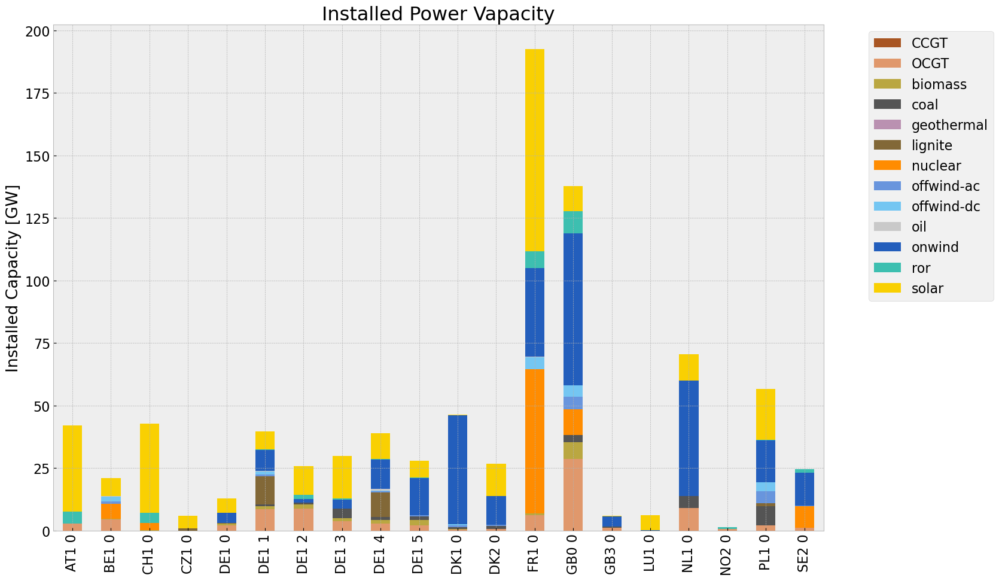

<Figure size 640x480 with 0 Axes>

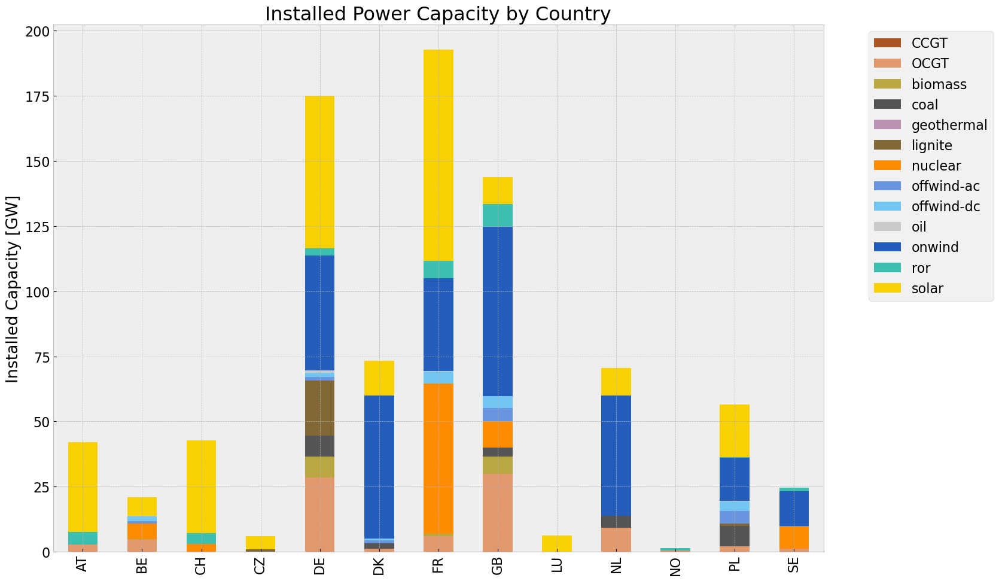

In [63]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



## Generation

<Figure size 640x480 with 0 Axes>

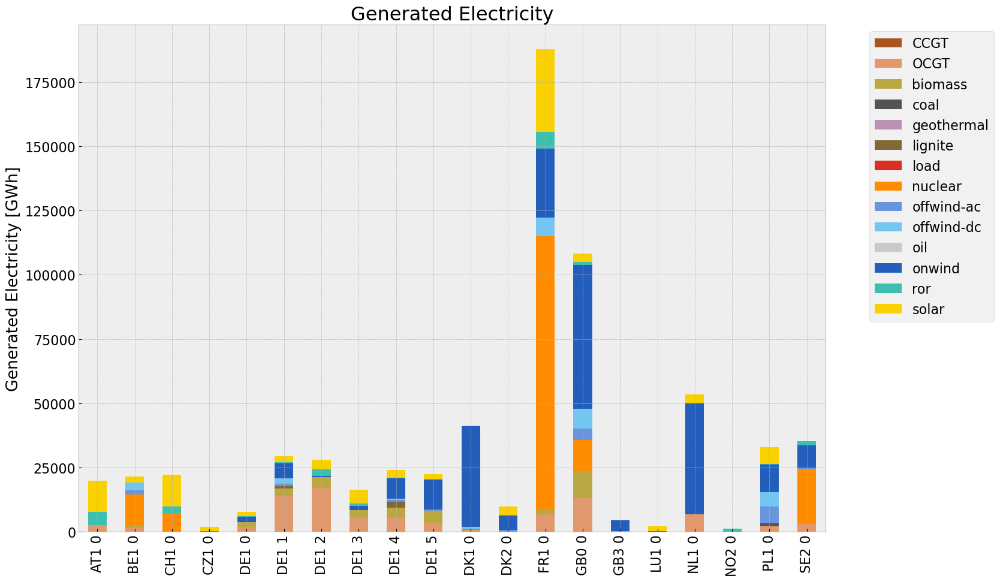

<Figure size 640x480 with 0 Axes>

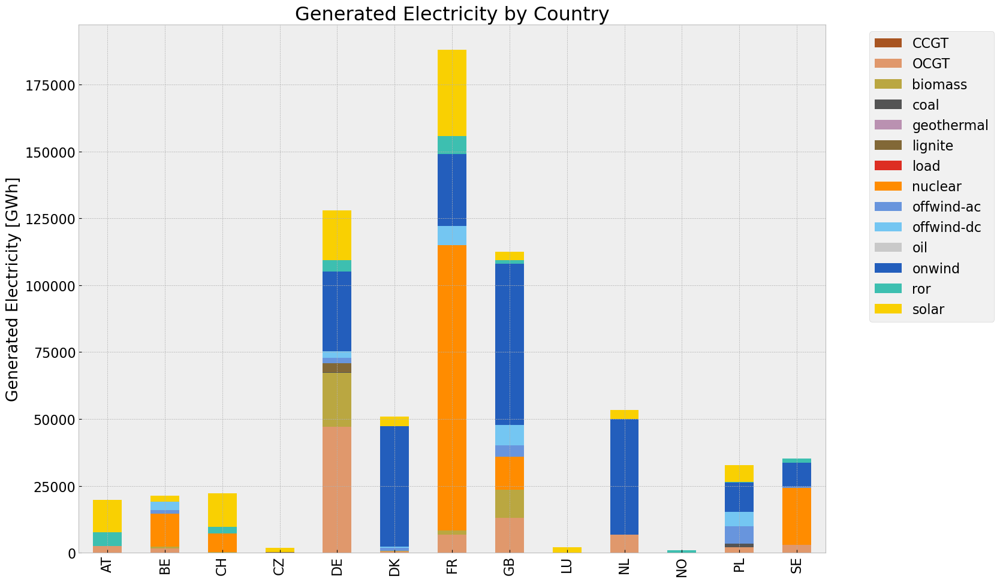

In [64]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2,colors_gen_table)
gen_noinv_country = gen_power_table_country(n2,colors_gen_table)


## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).

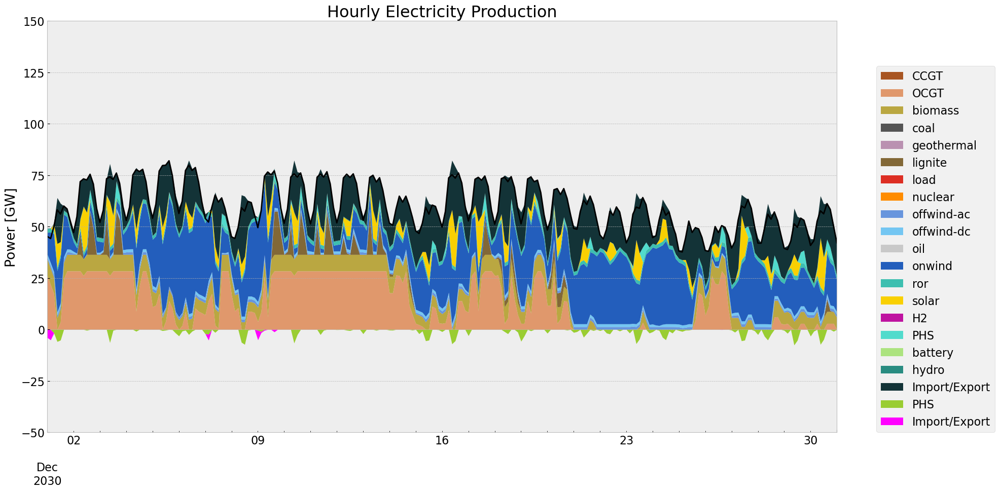

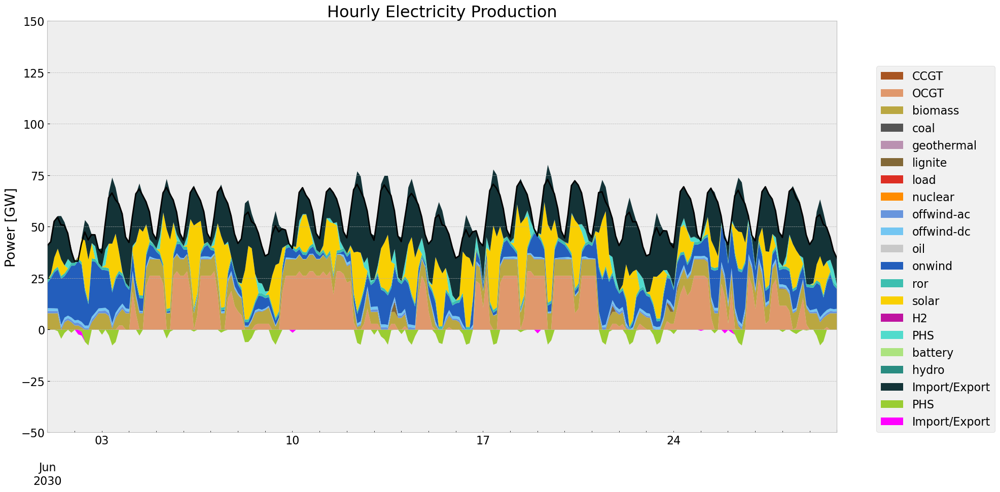

In [65]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

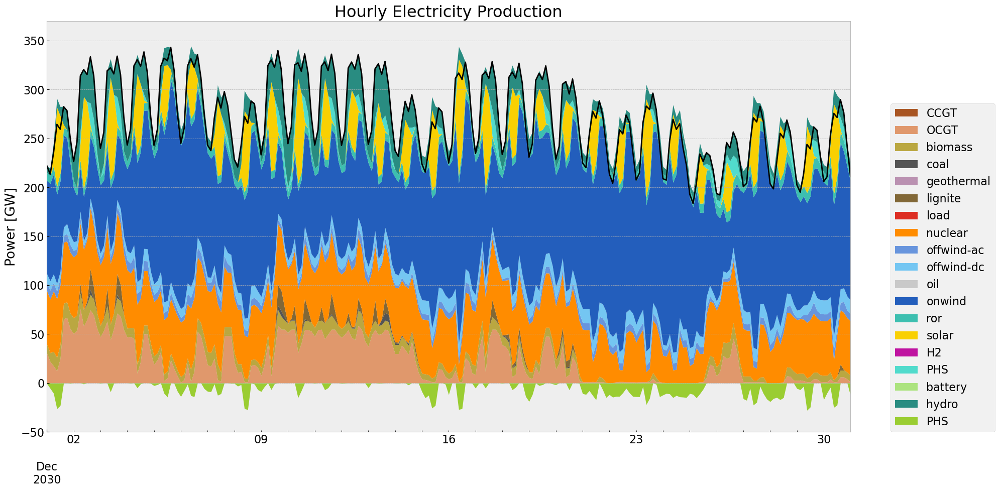

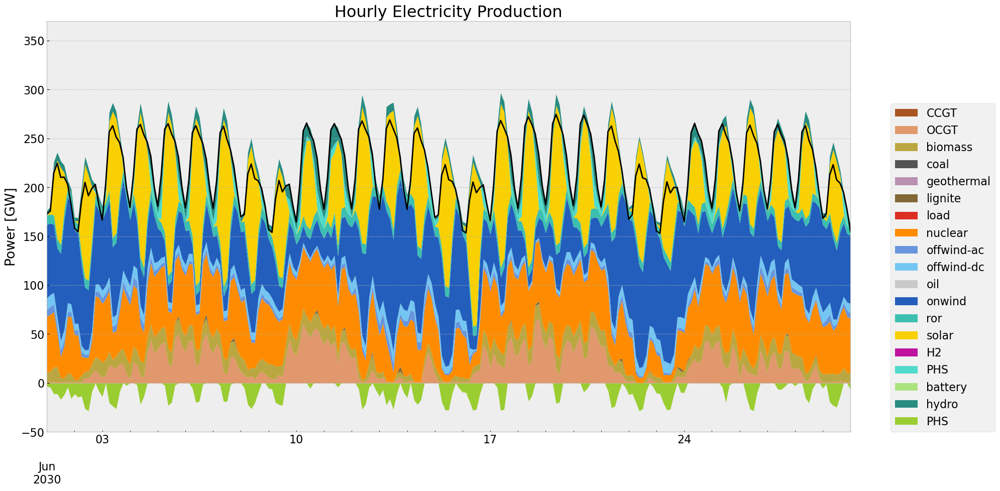

In [66]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

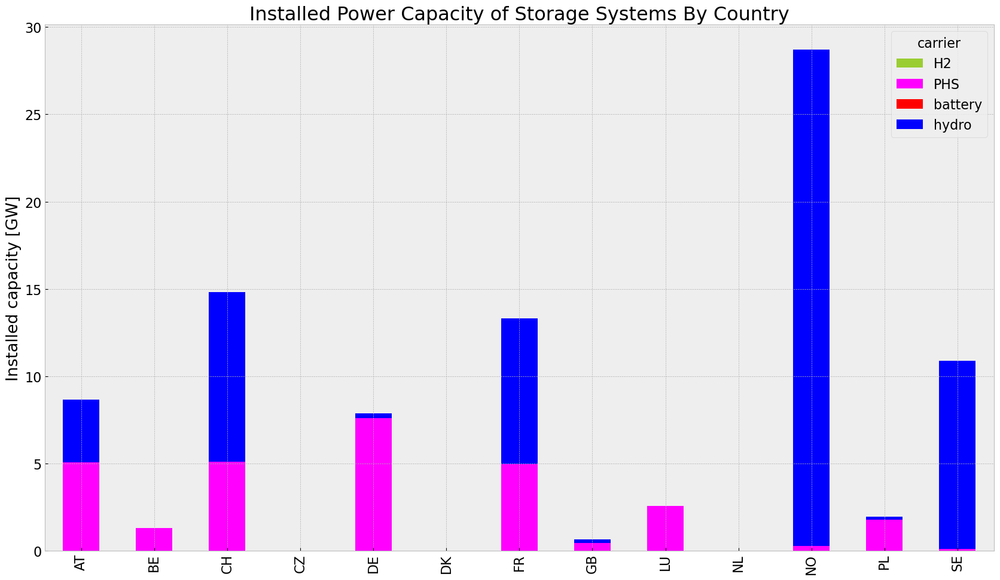

In [67]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\1117423567.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\1117423567.py:3: FutureWarning: 'H' is deprecated and will be removed in a futu

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.323824e+07,0.451621,0.1980,3.649338e+07
biomass,3.341281e+07,0.468000,0.0000,0.000000e+00
coal,1.659330e+06,0.329908,0.3361,1.690474e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,3.498734e+06,0.337285,0.4069,4.220870e+06
load,4.610858e+03,1.000000,0.0000,0.000000e+00
nuclear,1.595945e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.588693e+07,1.000000,0.0000,0.000000e+00


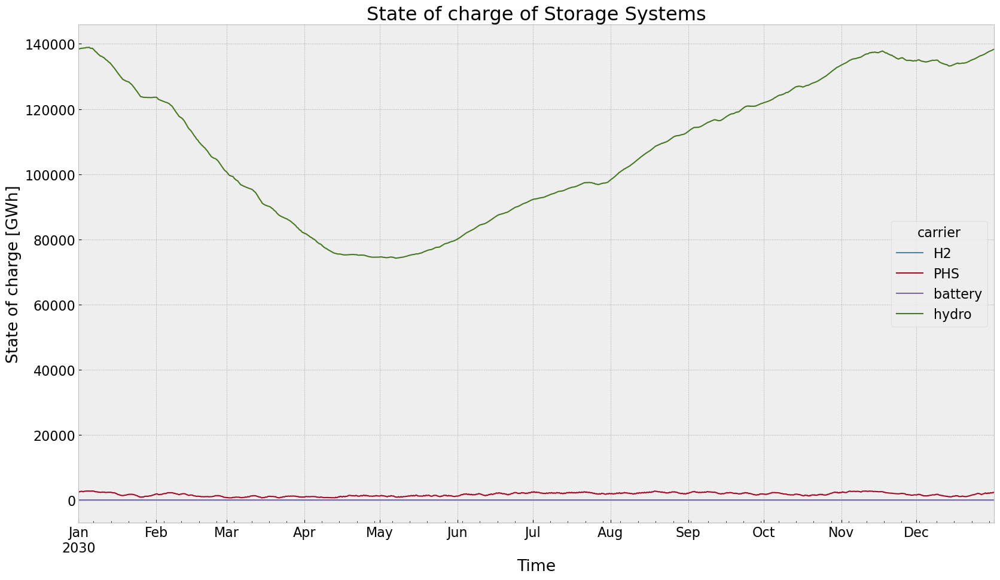

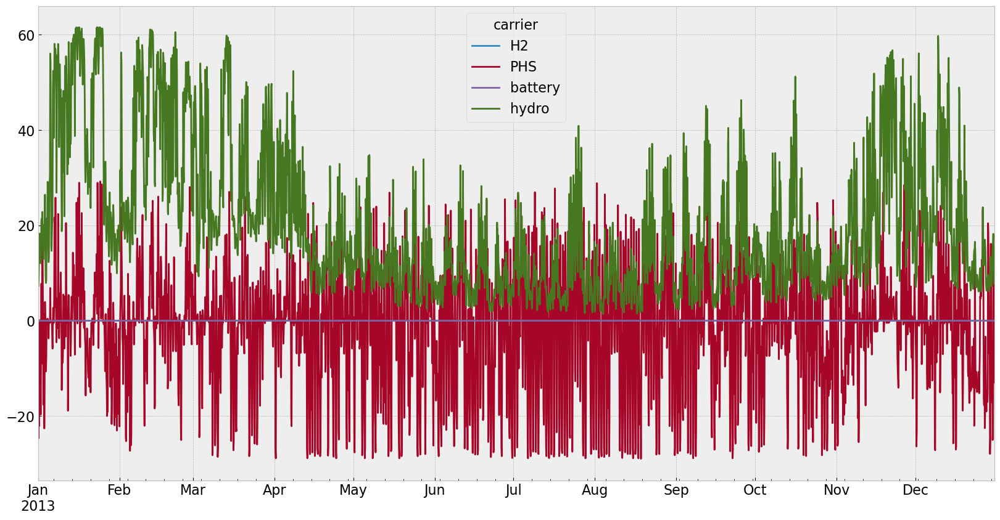

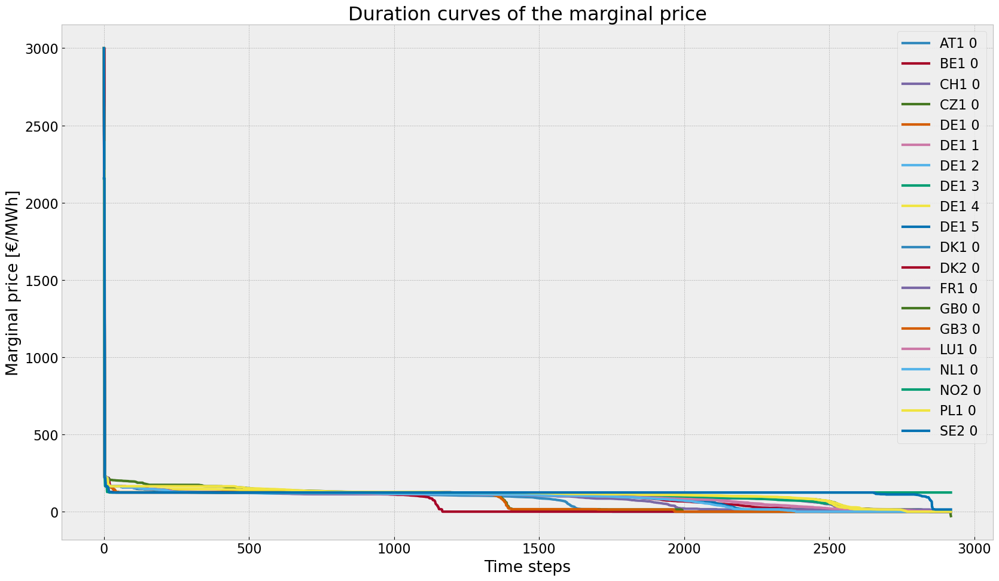

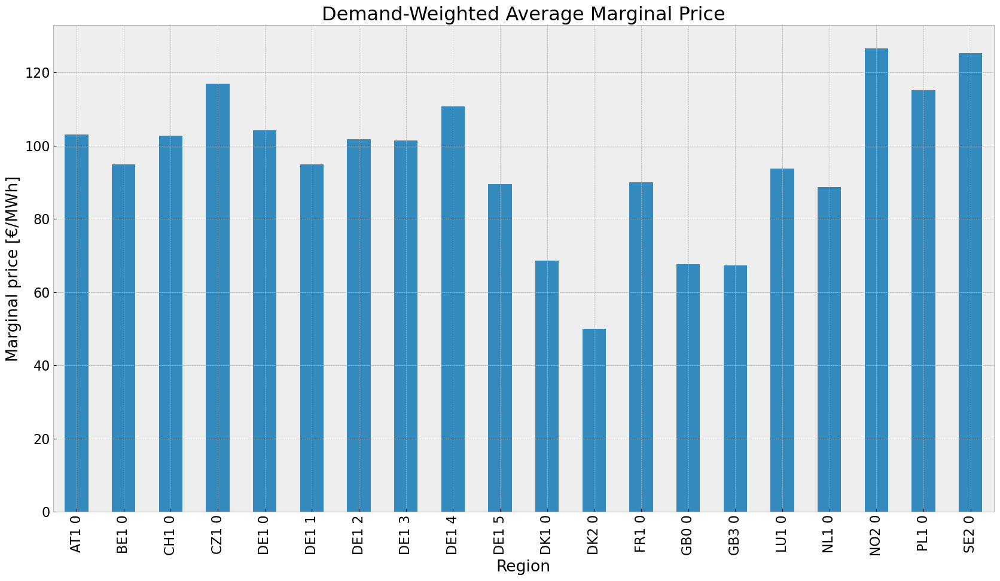

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


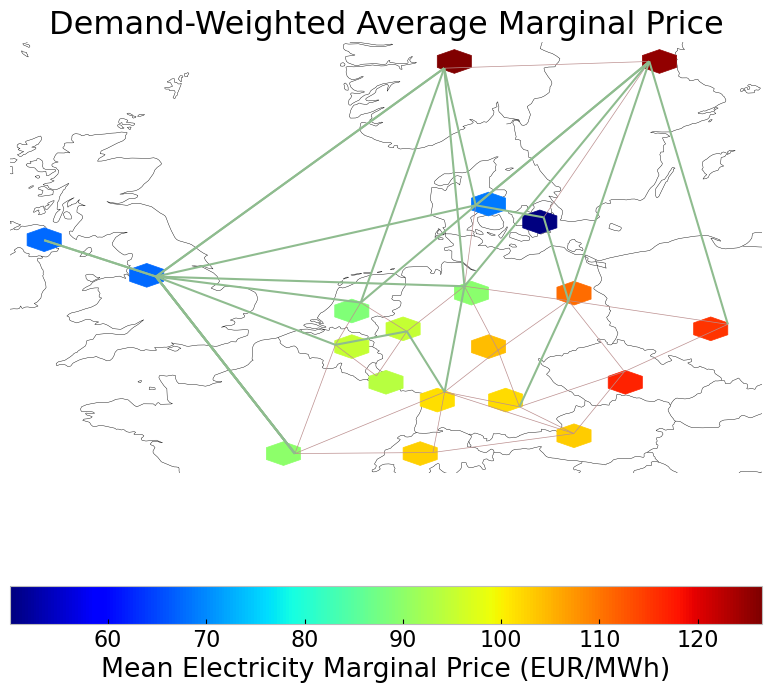

In [68]:
#state of charge
state_of_charge_plot(n2)
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [69]:
n3= n2.copy()
n3.name = 'noinv_roll_drought'
horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#n3 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Drought\\20240512\\noinv_roll_drought.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.8s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wablj6uv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wablj6uv.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x479136f4


INFO:gurobipy:Model fingerprint: 0x479136f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25506 rows and 7247 columns


INFO:gurobipy:Presolve removed 25506 rows and 7247 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


 Factor Ops : 1.344e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.344e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04241454e+11 -5.21982060e+11  8.83e+04 1.14e+04  5.13e+08     0s


INFO:gurobipy:   0   2.04241454e+11 -5.21982060e+11  8.83e+04 1.14e+04  5.13e+08     0s


   1   4.13826371e+10 -2.72086826e+11  1.09e+04 7.28e-11  7.77e+07     0s


INFO:gurobipy:   1   4.13826371e+10 -2.72086826e+11  1.09e+04 7.28e-11  7.77e+07     0s


   2   6.66154104e+09 -7.41310582e+10  6.66e+02 6.55e-11  9.83e+06     0s


INFO:gurobipy:   2   6.66154104e+09 -7.41310582e+10  6.66e+02 6.55e-11  9.83e+06     0s


   3   1.94993210e+09 -1.46243718e+10  1.26e+02 9.90e-10  1.76e+06     0s


INFO:gurobipy:   3   1.94993210e+09 -1.46243718e+10  1.26e+02 9.90e-10  1.76e+06     0s


   4   7.13912028e+08 -3.24736808e+09  1.76e+01 4.22e-10  3.90e+05     0s


INFO:gurobipy:   4   7.13912028e+08 -3.24736808e+09  1.76e+01 4.22e-10  3.90e+05     0s


   5   4.53030983e+08 -9.34377646e+08  6.43e+00 1.60e-10  1.34e+05     0s


INFO:gurobipy:   5   4.53030983e+08 -9.34377646e+08  6.43e+00 1.60e-10  1.34e+05     0s


   6   2.96201256e+08 -2.69034659e+08  2.56e+00 5.46e-11  5.42e+04     0s


INFO:gurobipy:   6   2.96201256e+08 -2.69034659e+08  2.56e+00 5.46e-11  5.42e+04     0s


   7   2.07981565e+08 -5.62923004e+07  7.43e-01 2.95e-11  2.52e+04     0s


INFO:gurobipy:   7   2.07981565e+08 -5.62923004e+07  7.43e-01 2.95e-11  2.52e+04     0s


   8   1.92106253e+08  3.61294740e+07  4.89e-01 2.24e-11  1.49e+04     0s


INFO:gurobipy:   8   1.92106253e+08  3.61294740e+07  4.89e-01 2.24e-11  1.49e+04     0s


   9   1.71923334e+08  1.19392769e+08  1.48e-01 2.55e-11  5.00e+03     0s


INFO:gurobipy:   9   1.71923334e+08  1.19392769e+08  1.48e-01 2.55e-11  5.00e+03     0s


  10   1.61483277e+08  1.46777585e+08  1.17e-02 1.91e-11  1.40e+03     0s


INFO:gurobipy:  10   1.61483277e+08  1.46777585e+08  1.17e-02 1.91e-11  1.40e+03     0s


  11   1.58994387e+08  1.53046750e+08  2.55e-03 3.67e-11  5.65e+02     0s


INFO:gurobipy:  11   1.58994387e+08  1.53046750e+08  2.55e-03 3.67e-11  5.65e+02     0s


  12   1.58163427e+08  1.55971306e+08  9.99e-04 2.36e-11  2.08e+02     0s


INFO:gurobipy:  12   1.58163427e+08  1.55971306e+08  9.99e-04 2.36e-11  2.08e+02     0s


  13   1.57816999e+08  1.56975765e+08  4.01e-04 2.68e-11  7.99e+01     0s


INFO:gurobipy:  13   1.57816999e+08  1.56975765e+08  4.01e-04 2.68e-11  7.99e+01     0s


  14   1.57670911e+08  1.57282749e+08  1.72e-04 3.30e-11  3.69e+01     0s


INFO:gurobipy:  14   1.57670911e+08  1.57282749e+08  1.72e-04 3.30e-11  3.69e+01     0s


  15   1.57585434e+08  1.57483371e+08  3.79e-05 2.91e-11  9.70e+00     0s


INFO:gurobipy:  15   1.57585434e+08  1.57483371e+08  3.79e-05 2.91e-11  9.70e+00     0s


  16   1.57559317e+08  1.57547483e+08  6.31e-06 2.78e-11  1.12e+00     0s


INFO:gurobipy:  16   1.57559317e+08  1.57547483e+08  6.31e-06 2.78e-11  1.12e+00     0s


  17   1.57553796e+08  1.57551326e+08  6.15e-07 3.06e-11  2.35e-01     0s


INFO:gurobipy:  17   1.57553796e+08  1.57551326e+08  6.15e-07 3.06e-11  2.35e-01     0s


  18   1.57553268e+08  1.57552615e+08  1.64e-07 2.58e-11  6.21e-02     0s


INFO:gurobipy:  18   1.57553268e+08  1.57552615e+08  1.64e-07 2.58e-11  6.21e-02     0s


  19   1.57553125e+08  1.57552913e+08  6.04e-08 2.40e-11  2.02e-02     0s


INFO:gurobipy:  19   1.57553125e+08  1.57552913e+08  6.04e-08 2.40e-11  2.02e-02     0s


  20   1.57553075e+08  1.57553023e+08  2.00e-08 2.91e-11  4.99e-03     0s


INFO:gurobipy:  20   1.57553075e+08  1.57553023e+08  2.00e-08 2.91e-11  4.99e-03     0s


  21   1.57553048e+08  1.57553045e+08  1.42e-08 2.91e-11  2.83e-04     0s


INFO:gurobipy:  21   1.57553048e+08  1.57553045e+08  1.42e-08 2.91e-11  2.83e-04     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.29 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.29 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1933    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1933    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1933 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 1933 iterations and 0.33 seconds (0.06 work units)


Optimal objective  1.575530467e+08


INFO:gurobipy:Optimal objective  1.575530467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mlxuulw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mlxuulw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x21e38b35


INFO:gurobipy:Model fingerprint: 0x21e38b35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7031 columns


INFO:gurobipy:Presolve removed 25490 rows and 7031 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


 Factor Ops : 1.588e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.588e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


INFO:gurobipy:   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


INFO:gurobipy:   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


INFO:gurobipy:   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


   3   2.44295641e+09 -1.21888882e+10  9.78e+01 1.31e-09  1.49e+06     0s


INFO:gurobipy:   3   2.44295641e+09 -1.21888882e+10  9.78e+01 1.31e-09  1.49e+06     0s


   4   1.43378101e+09 -2.57481348e+09  3.63e+01 1.75e-10  3.95e+05     0s


INFO:gurobipy:   4   1.43378101e+09 -2.57481348e+09  3.63e+01 1.75e-10  3.95e+05     0s


   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.75e-10  1.44e+05     0s


INFO:gurobipy:   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.75e-10  1.44e+05     0s


   6   7.35733632e+08  8.44111855e+06  7.02e+00 1.16e-10  6.87e+04     0s


INFO:gurobipy:   6   7.35733632e+08  8.44111855e+06  7.02e+00 1.16e-10  6.87e+04     0s


   7   5.58663609e+08  2.75067293e+08  1.49e+00 7.28e-11  2.63e+04     0s


INFO:gurobipy:   7   5.58663609e+08  2.75067293e+08  1.49e+00 7.28e-11  2.63e+04     0s


   8   5.25953990e+08  3.91796375e+08  9.04e-01 4.37e-11  1.24e+04     0s


INFO:gurobipy:   8   5.25953990e+08  3.91796375e+08  9.04e-01 4.37e-11  1.24e+04     0s


   9   4.98468978e+08  4.33234602e+08  4.69e-01 5.82e-11  6.04e+03     0s


INFO:gurobipy:   9   4.98468978e+08  4.33234602e+08  4.69e-01 5.82e-11  6.04e+03     0s


  10   4.80394205e+08  4.47968887e+08  1.89e-01 4.37e-11  2.99e+03     0s


INFO:gurobipy:  10   4.80394205e+08  4.47968887e+08  1.89e-01 4.37e-11  2.99e+03     0s


  11   4.71068110e+08  4.60024095e+08  5.77e-02 3.23e-11  1.02e+03     0s


INFO:gurobipy:  11   4.71068110e+08  4.60024095e+08  5.77e-02 3.23e-11  1.02e+03     0s


  12   4.68482225e+08  4.64041735e+08  2.54e-02 2.91e-11  4.09e+02     0s


INFO:gurobipy:  12   4.68482225e+08  4.64041735e+08  2.54e-02 2.91e-11  4.09e+02     0s


  13   4.66925713e+08  4.65523420e+08  6.53e-03 2.91e-11  1.29e+02     0s


INFO:gurobipy:  13   4.66925713e+08  4.65523420e+08  6.53e-03 2.91e-11  1.29e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1625 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1625 iterations and 0.31 seconds (0.05 work units)


Optimal objective  4.663219780e+08


INFO:gurobipy:Optimal objective  4.663219780e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ux_yl36.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ux_yl36.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd5275684


INFO:gurobipy:Model fingerprint: 0xd5275684


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 7054 columns


INFO:gurobipy:Presolve removed 25488 rows and 7054 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


INFO:gurobipy:   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


INFO:gurobipy:   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


   2   1.40936083e+10 -6.42334191e+10  7.46e+02 7.28e-11  9.61e+06     0s


INFO:gurobipy:   2   1.40936083e+10 -6.42334191e+10  7.46e+02 7.28e-11  9.61e+06     0s


   3   6.66122863e+09 -1.60306457e+10  1.79e+02 1.60e-10  2.44e+06     0s


INFO:gurobipy:   3   6.66122863e+09 -1.60306457e+10  1.79e+02 1.60e-10  2.44e+06     0s


   4   4.21406475e+09 -3.73458527e+09  7.71e+01 1.46e-10  8.27e+05     0s


INFO:gurobipy:   4   4.21406475e+09 -3.73458527e+09  7.71e+01 1.46e-10  8.27e+05     0s


   5   3.08850139e+09 -3.38046182e+07  3.94e+01 1.75e-10  3.20e+05     0s


INFO:gurobipy:   5   3.08850139e+09 -3.38046182e+07  3.94e+01 1.75e-10  3.20e+05     0s


   6   2.63967297e+09  1.05497972e+09  2.06e+01 1.16e-10  1.59e+05     0s


INFO:gurobipy:   6   2.63967297e+09  1.05497972e+09  2.06e+01 1.16e-10  1.59e+05     0s


   7   2.33568386e+09  1.85786014e+09  5.21e+00 8.73e-11  4.64e+04     0s


INFO:gurobipy:   7   2.33568386e+09  1.85786014e+09  5.21e+00 8.73e-11  4.64e+04     0s


   8   2.27087154e+09  2.00700418e+09  2.91e+00 7.28e-11  2.55e+04     0s


INFO:gurobipy:   8   2.27087154e+09  2.00700418e+09  2.91e+00 7.28e-11  2.55e+04     0s


   9   2.24300000e+09  2.08385321e+09  2.02e+00 8.73e-11  1.54e+04     0s


INFO:gurobipy:   9   2.24300000e+09  2.08385321e+09  2.02e+00 8.73e-11  1.54e+04     0s


  10   2.18578650e+09  2.13034740e+09  3.48e-01 8.73e-11  5.21e+03     0s


INFO:gurobipy:  10   2.18578650e+09  2.13034740e+09  3.48e-01 8.73e-11  5.21e+03     0s


  11   2.17480518e+09  2.14930061e+09  1.55e-01 4.37e-11  2.39e+03     0s


INFO:gurobipy:  11   2.17480518e+09  2.14930061e+09  1.55e-01 4.37e-11  2.39e+03     0s


  12   2.17039992e+09  2.15701190e+09  8.68e-02 2.91e-11  1.26e+03     0s


INFO:gurobipy:  12   2.17039992e+09  2.15701190e+09  8.68e-02 2.91e-11  1.26e+03     0s


  13   2.16635856e+09  2.16088126e+09  2.78e-02 2.91e-11  5.12e+02     0s


INFO:gurobipy:  13   2.16635856e+09  2.16088126e+09  2.78e-02 2.91e-11  5.12e+02     0s


  14   2.16505897e+09  2.16284771e+09  1.02e-02 2.91e-11  2.06e+02     0s


INFO:gurobipy:  14   2.16505897e+09  2.16284771e+09  1.02e-02 2.91e-11  2.06e+02     0s


  15   2.16441514e+09  2.16388790e+09  1.76e-03 2.91e-11  4.89e+01     0s


INFO:gurobipy:  15   2.16441514e+09  2.16388790e+09  1.76e-03 2.91e-11  4.89e+01     0s


  16   2.16425845e+09  2.16419449e+09  1.36e-05 2.91e-11  5.86e+00     0s


INFO:gurobipy:  16   2.16425845e+09  2.16419449e+09  1.36e-05 2.91e-11  5.86e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1736 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1736 iterations and 0.29 seconds (0.05 work units)


Optimal objective  2.164251827e+09


INFO:gurobipy:Optimal objective  2.164251827e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-beygjxrt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-beygjxrt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd200fd1c


INFO:gurobipy:Model fingerprint: 0xd200fd1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 7012 columns


INFO:gurobipy:Presolve removed 25488 rows and 7012 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


INFO:gurobipy:   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


   1   3.92901440e+10 -2.30660053e+11  6.23e+03 7.28e-11  5.09e+07     0s


INFO:gurobipy:   1   3.92901440e+10 -2.30660053e+11  6.23e+03 7.28e-11  5.09e+07     0s


   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


INFO:gurobipy:   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


   3   3.80969691e+09 -1.07121039e+10  7.27e+01 9.31e-10  1.43e+06     0s


INFO:gurobipy:   3   3.80969691e+09 -1.07121039e+10  7.27e+01 9.31e-10  1.43e+06     0s


   4   2.68598226e+09 -2.28883931e+09  3.31e+01 4.37e-10  4.81e+05     0s


INFO:gurobipy:   4   2.68598226e+09 -2.28883931e+09  3.31e+01 4.37e-10  4.81e+05     0s


   5   2.24506463e+09  2.58510303e+08  1.26e+01 1.20e-10  1.87e+05     0s


INFO:gurobipy:   5   2.24506463e+09  2.58510303e+08  1.26e+01 1.20e-10  1.87e+05     0s


   6   2.06345426e+09  1.35043442e+09  5.19e+00 4.37e-11  6.65e+04     0s


INFO:gurobipy:   6   2.06345426e+09  1.35043442e+09  5.19e+00 4.37e-11  6.65e+04     0s


   7   1.90606375e+09  1.69123132e+09  7.25e-01 1.16e-10  1.97e+04     0s


INFO:gurobipy:   7   1.90606375e+09  1.69123132e+09  7.25e-01 1.16e-10  1.97e+04     0s


   8   1.88115847e+09  1.77046857e+09  4.38e-01 4.37e-11  1.02e+04     0s


INFO:gurobipy:   8   1.88115847e+09  1.77046857e+09  4.38e-01 4.37e-11  1.02e+04     0s


   9   1.85152230e+09  1.79686151e+09  1.38e-01 3.07e-11  5.00e+03     0s


INFO:gurobipy:   9   1.85152230e+09  1.79686151e+09  1.38e-01 3.07e-11  5.00e+03     0s


  10   1.84280899e+09  1.81528955e+09  6.24e-02 2.91e-11  2.51e+03     0s


INFO:gurobipy:  10   1.84280899e+09  1.81528955e+09  6.24e-02 2.91e-11  2.51e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1642    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1642    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1642 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1642 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.834150870e+09


INFO:gurobipy:Optimal objective  1.834150870e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8_px_gg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8_px_gg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xabaeef46


INFO:gurobipy:Model fingerprint: 0xabaeef46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25489 rows and 7042 columns


INFO:gurobipy:Presolve removed 25489 rows and 7042 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


INFO:gurobipy:   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


INFO:gurobipy:   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


   2   1.42105367e+10 -6.59877202e+10  7.08e+02 8.73e-11  9.64e+06     0s


INFO:gurobipy:   2   1.42105367e+10 -6.59877202e+10  7.08e+02 8.73e-11  9.64e+06     0s


   3   7.61831725e+09 -1.55886806e+10  1.78e+02 6.62e-10  2.48e+06     0s


INFO:gurobipy:   3   7.61831725e+09 -1.55886806e+10  1.78e+02 6.62e-10  2.48e+06     0s


   4   5.31261793e+09 -3.36222817e+09  8.28e+01 3.13e-10  9.02e+05     0s


INFO:gurobipy:   4   5.31261793e+09 -3.36222817e+09  8.28e+01 3.13e-10  9.02e+05     0s


   5   4.14804541e+09  5.26745677e+08  3.82e+01 1.53e-10  3.66e+05     0s


INFO:gurobipy:   5   4.14804541e+09  5.26745677e+08  3.82e+01 1.53e-10  3.66e+05     0s


   6   3.68741086e+09  2.01693049e+09  1.71e+01 1.31e-10  1.64e+05     0s


INFO:gurobipy:   6   3.68741086e+09  2.01693049e+09  1.71e+01 1.31e-10  1.64e+05     0s


   7   3.47799173e+09  3.03848564e+09  4.17e+00 8.73e-11  4.16e+04     0s


INFO:gurobipy:   7   3.47799173e+09  3.03848564e+09  4.17e+00 8.73e-11  4.16e+04     0s


   8   3.43247172e+09  3.18300126e+09  2.42e+00 7.28e-11  2.35e+04     0s


INFO:gurobipy:   8   3.43247172e+09  3.18300126e+09  2.42e+00 7.28e-11  2.35e+04     0s


   9   3.41281052e+09  3.25810058e+09  1.79e+00 4.37e-11  1.46e+04     0s


INFO:gurobipy:   9   3.41281052e+09  3.25810058e+09  1.79e+00 4.37e-11  1.46e+04     0s


  10   3.35696826e+09  3.30909387e+09  2.30e-01 5.82e-11  4.43e+03     0s


INFO:gurobipy:  10   3.35696826e+09  3.30909387e+09  2.30e-01 5.82e-11  4.43e+03     0s


  11   3.34665883e+09  3.31929389e+09  8.95e-02 2.91e-11  2.52e+03     0s


INFO:gurobipy:  11   3.34665883e+09  3.31929389e+09  8.95e-02 2.91e-11  2.52e+03     0s


  12   3.34511263e+09  3.32523507e+09  7.22e-02 2.91e-11  1.83e+03     0s


INFO:gurobipy:  12   3.34511263e+09  3.32523507e+09  7.22e-02 2.91e-11  1.83e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1557 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1557 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.337666524e+09


INFO:gurobipy:Optimal objective  3.337666524e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-438czxqh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-438czxqh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4bd3933b


INFO:gurobipy:Model fingerprint: 0x4bd3933b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25500 rows and 7129 columns


INFO:gurobipy:Presolve removed 25500 rows and 7129 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


 Factor Ops : 1.695e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.695e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


INFO:gurobipy:   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


INFO:gurobipy:   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


INFO:gurobipy:   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


   3   1.12596102e+10 -7.88151022e+09  1.85e+02 3.93e-10  2.15e+06     0s


INFO:gurobipy:   3   1.12596102e+10 -7.88151022e+09  1.85e+02 3.93e-10  2.15e+06     0s


   4   8.42518611e+09  2.46706111e+09  6.08e+01 2.33e-10  6.41e+05     0s


INFO:gurobipy:   4   8.42518611e+09  2.46706111e+09  6.08e+01 2.33e-10  6.41e+05     0s


   5   7.46530401e+09  4.68005728e+09  2.71e+01 2.62e-10  2.90e+05     0s


INFO:gurobipy:   5   7.46530401e+09  4.68005728e+09  2.71e+01 2.62e-10  2.90e+05     0s


   6   7.12903168e+09  5.77393555e+09  1.46e+01 3.20e-10  1.40e+05     0s


INFO:gurobipy:   6   7.12903168e+09  5.77393555e+09  1.46e+01 3.20e-10  1.40e+05     0s


   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.46e-10  7.14e+04     0s


INFO:gurobipy:   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.46e-10  7.14e+04     0s


   8   6.82896302e+09  6.42728293e+09  3.65e+00 1.16e-10  4.03e+04     0s


INFO:gurobipy:   8   6.82896302e+09  6.42728293e+09  3.65e+00 1.16e-10  4.03e+04     0s


   9   6.77092450e+09  6.55396596e+09  1.94e+00 8.73e-11  2.17e+04     0s


INFO:gurobipy:   9   6.77092450e+09  6.55396596e+09  1.94e+00 8.73e-11  2.17e+04     0s


  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


INFO:gurobipy:  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


  11   6.71319524e+09  6.66238006e+09  3.60e-01 4.37e-11  4.98e+03     0s


INFO:gurobipy:  11   6.71319524e+09  6.66238006e+09  3.60e-01 4.37e-11  4.98e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.20 seconds (0.05 work units)


Optimal objective  6.696077858e+09


INFO:gurobipy:Optimal objective  6.696077858e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kj7h1pya.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kj7h1pya.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd7bee1d


INFO:gurobipy:Model fingerprint: 0xfd7bee1d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7154 columns


INFO:gurobipy:Presolve removed 25492 rows and 7154 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


 Factor Ops : 1.708e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.708e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


INFO:gurobipy:   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


   1   4.63804182e+10 -2.60547400e+11  1.04e+04 8.00e-11  7.40e+07     0s


INFO:gurobipy:   1   4.63804182e+10 -2.60547400e+11  1.04e+04 8.00e-11  7.40e+07     0s


   2   1.12221216e+10 -6.73454169e+10  7.56e+02 7.28e-11  9.79e+06     0s


INFO:gurobipy:   2   1.12221216e+10 -6.73454169e+10  7.56e+02 7.28e-11  9.79e+06     0s


   3   4.94963077e+09 -1.50116695e+10  1.87e+02 3.61e-09  2.20e+06     0s


INFO:gurobipy:   3   4.94963077e+09 -1.50116695e+10  1.87e+02 3.61e-09  2.20e+06     0s


   4   3.28877808e+09 -6.91441546e+08  5.96e+01 5.24e-10  4.26e+05     0s


INFO:gurobipy:   4   3.28877808e+09 -6.91441546e+08  5.96e+01 5.24e-10  4.26e+05     0s


   5   2.83469995e+09  9.40231583e+08  2.98e+01 3.06e-10  1.96e+05     0s


INFO:gurobipy:   5   2.83469995e+09  9.40231583e+08  2.98e+01 3.06e-10  1.96e+05     0s


   6   2.66330263e+09  1.57073279e+09  1.96e+01 2.62e-10  1.11e+05     0s


INFO:gurobipy:   6   2.66330263e+09  1.57073279e+09  1.96e+01 2.62e-10  1.11e+05     0s


   7   2.43322597e+09  1.91485954e+09  7.10e+00 8.73e-11  5.08e+04     0s


INFO:gurobipy:   7   2.43322597e+09  1.91485954e+09  7.10e+00 8.73e-11  5.08e+04     0s


   8   2.37390006e+09  2.08251652e+09  4.63e+00 8.73e-11  2.85e+04     0s


INFO:gurobipy:   8   2.37390006e+09  2.08251652e+09  4.63e+00 8.73e-11  2.85e+04     0s


   9   2.31146310e+09  2.16052876e+09  2.32e+00 5.82e-11  1.46e+04     0s


INFO:gurobipy:   9   2.31146310e+09  2.16052876e+09  2.32e+00 5.82e-11  1.46e+04     0s


  10   2.27051763e+09  2.21362528e+09  9.11e-01 5.82e-11  5.48e+03     0s


INFO:gurobipy:  10   2.27051763e+09  2.21362528e+09  9.11e-01 5.82e-11  5.48e+03     0s


  11   2.25125859e+09  2.22853407e+09  3.48e-01 4.37e-11  2.18e+03     0s


INFO:gurobipy:  11   2.25125859e+09  2.22853407e+09  3.48e-01 4.37e-11  2.18e+03     0s


  12   2.24708952e+09  2.23437299e+09  2.32e-01 2.91e-11  1.23e+03     0s


INFO:gurobipy:  12   2.24708952e+09  2.23437299e+09  2.32e-01 2.91e-11  1.23e+03     0s


  13   2.24214595e+09  2.23696840e+09  9.76e-02 4.37e-11  5.00e+02     0s


INFO:gurobipy:  13   2.24214595e+09  2.23696840e+09  9.76e-02 4.37e-11  5.00e+02     0s


  14   2.24103911e+09  2.23754345e+09  6.84e-02 2.91e-11  3.38e+02     0s


INFO:gurobipy:  14   2.24103911e+09  2.23754345e+09  6.84e-02 2.91e-11  3.38e+02     0s


  15   2.23964643e+09  2.23808167e+09  3.15e-02 2.91e-11  1.51e+02     0s


INFO:gurobipy:  15   2.23964643e+09  2.23808167e+09  3.15e-02 2.91e-11  1.51e+02     0s


  16   2.23877380e+09  2.23836676e+09  8.07e-03 2.95e-11  3.93e+01     0s


INFO:gurobipy:  16   2.23877380e+09  2.23836676e+09  8.07e-03 2.95e-11  3.93e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.31 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.31 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.34 seconds (0.05 work units)


Optimal objective  2.238455646e+09


INFO:gurobipy:Optimal objective  2.238455646e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zh5v52mt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zh5v52mt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0018a4eb


INFO:gurobipy:Model fingerprint: 0x0018a4eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7121 columns


INFO:gurobipy:Presolve removed 25489 rows and 7121 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


INFO:gurobipy:   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


INFO:gurobipy:   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


   2   1.65244836e+10 -5.20833022e+10  5.85e+02 1.31e-10  8.20e+06     0s


INFO:gurobipy:   2   1.65244836e+10 -5.20833022e+10  5.85e+02 1.31e-10  8.20e+06     0s


   3   1.07185709e+10 -8.69543212e+09  1.67e+02 7.86e-10  2.14e+06     0s


INFO:gurobipy:   3   1.07185709e+10 -8.69543212e+09  1.67e+02 7.86e-10  2.14e+06     0s


   4   8.19786610e+09  3.42366134e+09  5.70e+01 3.64e-10  5.22e+05     0s


INFO:gurobipy:   4   8.19786610e+09  3.42366134e+09  5.70e+01 3.64e-10  5.22e+05     0s


   5   7.19475485e+09  5.40112177e+09  2.03e+01 2.47e-10  1.89e+05     0s


INFO:gurobipy:   5   7.19475485e+09  5.40112177e+09  2.03e+01 2.47e-10  1.89e+05     0s


   6   6.86250948e+09  6.16695331e+09  7.46e+00 1.02e-10  7.19e+04     0s


INFO:gurobipy:   6   6.86250948e+09  6.16695331e+09  7.46e+00 1.02e-10  7.19e+04     0s


   7   6.74854508e+09  6.48314505e+09  2.97e+00 5.82e-11  2.73e+04     0s


INFO:gurobipy:   7   6.74854508e+09  6.48314505e+09  2.97e+00 5.82e-11  2.73e+04     0s


   8   6.69751011e+09  6.59947266e+09  1.10e+00 5.82e-11  1.00e+04     0s


INFO:gurobipy:   8   6.69751011e+09  6.59947266e+09  1.10e+00 5.82e-11  1.00e+04     0s


   9   6.67287660e+09  6.65268383e+09  2.43e-01 8.73e-11  2.08e+03     0s


INFO:gurobipy:   9   6.67287660e+09  6.65268383e+09  2.43e-01 8.73e-11  2.08e+03     0s


  10   6.66544755e+09  6.66396890e+09  6.73e-03 2.91e-11  1.43e+02     0s


INFO:gurobipy:  10   6.66544755e+09  6.66396890e+09  6.73e-03 2.91e-11  1.43e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1696    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1696    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1696 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1696 iterations and 0.17 seconds (0.05 work units)


Optimal objective  6.664986619e+09


INFO:gurobipy:Optimal objective  6.664986619e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4q8lr3bm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4q8lr3bm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6657718d


INFO:gurobipy:Model fingerprint: 0x6657718d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25514 rows and 7281 columns


INFO:gurobipy:Presolve removed 25514 rows and 7281 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.749e+03


INFO:gurobipy: AA' NZ     : 3.749e+03


 Factor NZ  : 3.243e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.243e+04 (roughly 3 MB of memory)


 Factor Ops : 1.296e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.296e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08472896e+11 -4.96372905e+11  8.26e+04 1.67e+04  4.81e+08     0s


INFO:gurobipy:   0   2.08472896e+11 -4.96372905e+11  8.26e+04 1.67e+04  4.81e+08     0s


   1   3.04427308e+10 -2.51590951e+11  5.93e+03 7.28e-11  5.27e+07     0s


INFO:gurobipy:   1   3.04427308e+10 -2.51590951e+11  5.93e+03 7.28e-11  5.27e+07     0s


   2   1.02180698e+10 -5.62575211e+10  4.46e+02 2.76e-10  7.70e+06     0s


INFO:gurobipy:   2   1.02180698e+10 -5.62575211e+10  4.46e+02 2.76e-10  7.70e+06     0s


   3   5.91209534e+09 -1.13126744e+10  1.10e+02 5.53e-10  1.83e+06     0s


INFO:gurobipy:   3   5.91209534e+09 -1.13126744e+10  1.10e+02 5.53e-10  1.83e+06     0s


   4   4.34267292e+09  5.13384686e+07  3.07e+01 1.60e-10  4.39e+05     0s


INFO:gurobipy:   4   4.34267292e+09  5.13384686e+07  3.07e+01 1.60e-10  4.39e+05     0s


   5   3.86178690e+09  2.26349607e+09  1.16e+01 1.02e-10  1.60e+05     0s


INFO:gurobipy:   5   3.86178690e+09  2.26349607e+09  1.16e+01 1.02e-10  1.60e+05     0s


   6   3.63227682e+09  2.99822328e+09  4.57e+00 8.73e-11  6.29e+04     0s


INFO:gurobipy:   6   3.63227682e+09  2.99822328e+09  4.57e+00 8.73e-11  6.29e+04     0s


   7   3.50442843e+09  3.26648197e+09  1.16e+00 4.37e-11  2.32e+04     0s


INFO:gurobipy:   7   3.50442843e+09  3.26648197e+09  1.16e+00 4.37e-11  2.32e+04     0s


   8   3.47565756e+09  3.35416270e+09  5.97e-01 2.91e-11  1.19e+04     0s


INFO:gurobipy:   8   3.47565756e+09  3.35416270e+09  5.97e-01 2.91e-11  1.19e+04     0s


   9   3.45536442e+09  3.40395936e+09  2.33e-01 2.91e-11  5.00e+03     0s


INFO:gurobipy:   9   3.45536442e+09  3.40395936e+09  2.33e-01 2.91e-11  5.00e+03     0s


  10   3.44689024e+09  3.42880231e+09  1.03e-01 3.62e-11  1.77e+03     0s


INFO:gurobipy:  10   3.44689024e+09  3.42880231e+09  1.03e-01 3.62e-11  1.77e+03     0s


  11   3.44250673e+09  3.43520115e+09  4.46e-02 2.91e-11  7.15e+02     0s


INFO:gurobipy:  11   3.44250673e+09  3.43520115e+09  4.46e-02 2.91e-11  7.15e+02     0s


  12   3.44087108e+09  3.43674602e+09  2.38e-02 2.92e-11  4.03e+02     0s


INFO:gurobipy:  12   3.44087108e+09  3.43674602e+09  2.38e-02 2.92e-11  4.03e+02     0s


  13   3.43960373e+09  3.43829519e+09  8.37e-03 3.15e-11  1.28e+02     0s


INFO:gurobipy:  13   3.43960373e+09  3.43829519e+09  8.37e-03 3.15e-11  1.28e+02     0s


  14   3.43945088e+09  3.43840119e+09  6.61e-03 2.91e-11  1.03e+02     0s


INFO:gurobipy:  14   3.43945088e+09  3.43840119e+09  6.61e-03 2.91e-11  1.03e+02     0s


  15   3.43907302e+09  3.43872717e+09  2.41e-03 2.91e-11  3.39e+01     0s


INFO:gurobipy:  15   3.43907302e+09  3.43872717e+09  2.41e-03 2.91e-11  3.39e+01     0s


  16   3.43885352e+09  3.43880100e+09  4.92e-05 3.14e-11  5.04e+00     0s


INFO:gurobipy:  16   3.43885352e+09  3.43880100e+09  4.92e-05 3.14e-11  5.04e+00     0s


  17   3.43884621e+09  3.43883208e+09  1.90e-06 2.91e-11  1.35e+00     0s


INFO:gurobipy:  17   3.43884621e+09  3.43883208e+09  1.90e-06 2.91e-11  1.35e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1845    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1845    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1845 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1845 iterations and 0.23 seconds (0.05 work units)


Optimal objective  3.438845078e+09


INFO:gurobipy:Optimal objective  3.438845078e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ig558p_m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ig558p_m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe4e94b21


INFO:gurobipy:Model fingerprint: 0xe4e94b21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25526 rows and 7367 columns


INFO:gurobipy:Presolve removed 25526 rows and 7367 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.719e+03


INFO:gurobipy: AA' NZ     : 3.719e+03


 Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


 Factor Ops : 1.385e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.385e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


INFO:gurobipy:   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


   1   1.92700404e+10 -2.23875205e+11  3.22e+03 8.73e-11  3.75e+07     0s


INFO:gurobipy:   1   1.92700404e+10 -2.23875205e+11  3.22e+03 8.73e-11  3.75e+07     0s


   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


INFO:gurobipy:   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


   3   2.78387438e+09 -6.90781663e+09  5.38e+01 1.16e-10  1.00e+06     0s


INFO:gurobipy:   3   2.78387438e+09 -6.90781663e+09  5.38e+01 1.16e-10  1.00e+06     0s


   4   1.60928431e+09 -6.40072599e+08  1.08e+01 5.82e-11  2.25e+05     0s


INFO:gurobipy:   4   1.60928431e+09 -6.40072599e+08  1.08e+01 5.82e-11  2.25e+05     0s


   5   1.35877454e+09  2.38080059e+08  5.47e+00 2.91e-11  1.11e+05     0s


INFO:gurobipy:   5   1.35877454e+09  2.38080059e+08  5.47e+00 2.91e-11  1.11e+05     0s


   6   1.24181182e+09  6.52935371e+08  3.29e+00 3.42e-11  5.81e+04     0s


INFO:gurobipy:   6   1.24181182e+09  6.52935371e+08  3.29e+00 3.42e-11  5.81e+04     0s


   7   1.12085062e+09  8.52927256e+08  1.09e+00 2.91e-11  2.63e+04     0s


INFO:gurobipy:   7   1.12085062e+09  8.52927256e+08  1.09e+00 2.91e-11  2.63e+04     0s


   8   1.09929641e+09  9.27206250e+08  7.69e-01 1.83e-11  1.69e+04     0s


INFO:gurobipy:   8   1.09929641e+09  9.27206250e+08  7.69e-01 1.83e-11  1.69e+04     0s


   9   1.06147008e+09  9.83324162e+08  2.21e-01 2.91e-11  7.64e+03     0s


INFO:gurobipy:   9   1.06147008e+09  9.83324162e+08  2.21e-01 2.91e-11  7.64e+03     0s


  10   1.05059707e+09  1.01282603e+09  8.52e-02 2.91e-11  3.69e+03     0s


INFO:gurobipy:  10   1.05059707e+09  1.01282603e+09  8.52e-02 2.91e-11  3.69e+03     0s


  11   1.04759323e+09  1.02757596e+09  5.42e-02 2.59e-11  1.95e+03     0s


INFO:gurobipy:  11   1.04759323e+09  1.02757596e+09  5.42e-02 2.59e-11  1.95e+03     0s


  12   1.04558808e+09  1.03374235e+09  3.57e-02 1.99e-11  1.16e+03     0s


INFO:gurobipy:  12   1.04558808e+09  1.03374235e+09  3.57e-02 1.99e-11  1.16e+03     0s


  13   1.04379735e+09  1.03662882e+09  1.99e-02 2.91e-11  7.00e+02     0s


INFO:gurobipy:  13   1.04379735e+09  1.03662882e+09  1.99e-02 2.91e-11  7.00e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1970 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1970 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.041224709e+09


INFO:gurobipy:Optimal objective  1.041224709e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4oi6tux0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4oi6tux0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x88b5c1cf


INFO:gurobipy:Model fingerprint: 0x88b5c1cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25501 rows and 7105 columns


INFO:gurobipy:Presolve removed 25501 rows and 7105 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1331 rows, 5399 columns, 8984 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5399 columns, 8984 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.783e+03


INFO:gurobipy: AA' NZ     : 3.783e+03


 Factor NZ  : 3.333e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.333e+04 (roughly 3 MB of memory)


 Factor Ops : 1.411e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.411e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20053194e+11 -4.83089193e+11  4.54e+04 1.16e+04  2.84e+08     0s


INFO:gurobipy:   0   1.20053194e+11 -4.83089193e+11  4.54e+04 1.16e+04  2.84e+08     0s


   1   2.66887656e+10 -2.11624221e+11  4.90e+03 7.28e-11  4.26e+07     0s


INFO:gurobipy:   1   2.66887656e+10 -2.11624221e+11  4.90e+03 7.28e-11  4.26e+07     0s


   2   7.43988028e+09 -4.74341603e+10  3.07e+02 2.36e+02  5.96e+06     0s


INFO:gurobipy:   2   7.43988028e+09 -4.74341603e+10  3.07e+02 2.36e+02  5.96e+06     0s


   3   4.48525627e+09 -7.54475906e+09  1.07e+02 5.97e-10  1.25e+06     0s


INFO:gurobipy:   3   4.48525627e+09 -7.54475906e+09  1.07e+02 5.97e-10  1.25e+06     0s


   4   3.19663634e+09  7.20281783e+08  1.98e+01 3.06e-10  2.43e+05     0s


INFO:gurobipy:   4   3.19663634e+09  7.20281783e+08  1.98e+01 3.06e-10  2.43e+05     0s


   5   2.89011376e+09  1.79632102e+09  8.67e+00 1.46e-10  1.05e+05     0s


INFO:gurobipy:   5   2.89011376e+09  1.79632102e+09  8.67e+00 1.46e-10  1.05e+05     0s


   6   2.72473491e+09  2.18996541e+09  3.84e+00 8.73e-11  5.07e+04     0s


INFO:gurobipy:   6   2.72473491e+09  2.18996541e+09  3.84e+00 8.73e-11  5.07e+04     0s


   7   2.58347324e+09  2.42705927e+09  4.13e-01 5.82e-11  1.46e+04     0s


INFO:gurobipy:   7   2.58347324e+09  2.42705927e+09  4.13e-01 5.82e-11  1.46e+04     0s


   8   2.56057788e+09  2.49325448e+09  1.90e-01 2.91e-11  6.26e+03     0s


INFO:gurobipy:   8   2.56057788e+09  2.49325448e+09  1.90e-01 2.91e-11  6.26e+03     0s


   9   2.54710939e+09  2.51653311e+09  7.65e-02 2.91e-11  2.84e+03     0s


INFO:gurobipy:   9   2.54710939e+09  2.51653311e+09  7.65e-02 2.91e-11  2.84e+03     0s


  10   2.54022585e+09  2.52796383e+09  2.32e-02 2.91e-11  1.14e+03     0s


INFO:gurobipy:  10   2.54022585e+09  2.52796383e+09  2.32e-02 2.91e-11  1.14e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1739    2.5364195e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1739    2.5364195e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1739 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1739 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.536419464e+09


INFO:gurobipy:Optimal objective  2.536419464e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 95.88it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vjgot0s6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vjgot0s6.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x47da5402


INFO:gurobipy:Model fingerprint: 0x47da5402


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25525 rows and 7282 columns


INFO:gurobipy:Presolve removed 25525 rows and 7282 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1307 rows, 5222 columns, 8730 nonzeros


INFO:gurobipy:Presolved: 1307 rows, 5222 columns, 8730 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.719e+03


INFO:gurobipy: AA' NZ     : 3.719e+03


 Factor NZ  : 3.105e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.105e+04 (roughly 3 MB of memory)


 Factor Ops : 1.210e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.210e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.24293402e+11 -4.60174978e+11  5.05e+04 1.15e+04  3.10e+08     0s


INFO:gurobipy:   0   1.24293402e+11 -4.60174978e+11  5.05e+04 1.15e+04  3.10e+08     0s


   1   2.23465486e+10 -2.06971832e+11  4.54e+03 7.28e-11  4.11e+07     0s


INFO:gurobipy:   1   2.23465486e+10 -2.06971832e+11  4.54e+03 7.28e-11  4.11e+07     0s


   2   7.32823345e+09 -4.31057348e+10  4.33e+02 1.05e+01  6.06e+06     0s


INFO:gurobipy:   2   7.32823345e+09 -4.31057348e+10  4.33e+02 1.05e+01  6.06e+06     0s


   3   4.13412909e+09 -4.49872197e+09  5.15e+01 4.22e-10  8.96e+05     0s


INFO:gurobipy:   3   4.13412909e+09 -4.49872197e+09  5.15e+01 4.22e-10  8.96e+05     0s


   4   3.48679005e+09  1.54706827e+09  9.83e+00 1.16e-10  1.92e+05     0s


INFO:gurobipy:   4   3.48679005e+09  1.54706827e+09  9.83e+00 1.16e-10  1.92e+05     0s


   5   3.29536654e+09  2.36212872e+09  4.66e+00 8.73e-11  9.11e+04     0s


INFO:gurobipy:   5   3.29536654e+09  2.36212872e+09  4.66e+00 8.73e-11  9.11e+04     0s


   6   3.17151912e+09  2.79405336e+09  2.09e+00 3.16e-11  3.66e+04     0s


INFO:gurobipy:   6   3.17151912e+09  2.79405336e+09  2.09e+00 3.16e-11  3.66e+04     0s


   7   3.10190867e+09  2.91337262e+09  7.94e-01 2.91e-11  1.82e+04     0s


INFO:gurobipy:   7   3.10190867e+09  2.91337262e+09  7.94e-01 2.91e-11  1.82e+04     0s


   8   3.08494532e+09  2.98183634e+09  5.62e-01 2.91e-11  9.97e+03     0s


INFO:gurobipy:   8   3.08494532e+09  2.98183634e+09  5.62e-01 2.91e-11  9.97e+03     0s


   9   3.06790619e+09  3.01701452e+09  3.32e-01 3.32e-11  4.92e+03     0s


INFO:gurobipy:   9   3.06790619e+09  3.01701452e+09  3.32e-01 3.32e-11  4.92e+03     0s


  10   3.05450881e+09  3.03190740e+09  1.52e-01 2.91e-11  2.19e+03     0s


INFO:gurobipy:  10   3.05450881e+09  3.03190740e+09  1.52e-01 2.91e-11  2.19e+03     0s


  11   3.05204297e+09  3.03485238e+09  1.21e-01 2.91e-11  1.66e+03     0s


INFO:gurobipy:  11   3.05204297e+09  3.03485238e+09  1.21e-01 2.91e-11  1.66e+03     0s


  12   3.05078800e+09  3.03550307e+09  1.06e-01 2.91e-11  1.48e+03     0s


INFO:gurobipy:  12   3.05078800e+09  3.03550307e+09  1.06e-01 2.91e-11  1.48e+03     0s


  13   3.04834292e+09  3.03697465e+09  7.56e-02 3.13e-11  1.10e+03     0s


INFO:gurobipy:  13   3.04834292e+09  3.03697465e+09  7.56e-02 3.13e-11  1.10e+03     0s


  14   3.04822762e+09  3.03777752e+09  7.37e-02 3.00e-11  1.01e+03     0s


INFO:gurobipy:  14   3.04822762e+09  3.03777752e+09  7.37e-02 3.00e-11  1.01e+03     0s


  15   3.04606346e+09  3.03936320e+09  4.60e-02 2.91e-11  6.48e+02     0s


INFO:gurobipy:  15   3.04606346e+09  3.03936320e+09  4.60e-02 2.91e-11  6.48e+02     0s


  16   3.04499543e+09  3.04118184e+09  3.21e-02 3.66e-11  3.70e+02     0s


INFO:gurobipy:  16   3.04499543e+09  3.04118184e+09  3.21e-02 3.66e-11  3.70e+02     0s


  17   3.04446014e+09  3.04133154e+09  2.59e-02 3.11e-11  3.03e+02     0s


INFO:gurobipy:  17   3.04446014e+09  3.04133154e+09  2.59e-02 3.11e-11  3.03e+02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.48 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.48 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1831    3.0423964e+09   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1831    3.0423964e+09   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1831 iterations and 0.56 seconds (0.06 work units)


INFO:gurobipy:Solved in 1831 iterations and 0.56 seconds (0.06 work units)


Optimal objective  3.042396374e+09


INFO:gurobipy:Optimal objective  3.042396374e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-br6_rqix.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-br6_rqix.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe722bc1b


INFO:gurobipy:Model fingerprint: 0xe722bc1b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25499 rows and 7016 columns


INFO:gurobipy:Presolve removed 25499 rows and 7016 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1333 rows, 5488 columns, 9065 nonzeros


INFO:gurobipy:Presolved: 1333 rows, 5488 columns, 9065 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.777e+03


INFO:gurobipy: AA' NZ     : 3.777e+03


 Factor NZ  : 3.404e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.404e+04 (roughly 3 MB of memory)


 Factor Ops : 1.473e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.473e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54044010e+11 -4.53213046e+11  5.35e+04 1.32e+04  3.22e+08     0s


INFO:gurobipy:   0   1.54044010e+11 -4.53213046e+11  5.35e+04 1.32e+04  3.22e+08     0s


   1   3.82374286e+10 -1.75971413e+11  6.35e+03 7.28e-11  4.57e+07     0s


INFO:gurobipy:   1   3.82374286e+10 -1.75971413e+11  6.35e+03 7.28e-11  4.57e+07     0s


   2   1.29950904e+10 -3.99966975e+10  6.23e+02 1.46e-10  6.69e+06     0s


INFO:gurobipy:   2   1.29950904e+10 -3.99966975e+10  6.23e+02 1.46e-10  6.69e+06     0s


   3   6.72437321e+09 -8.33346345e+09  1.28e+02 1.31e-10  1.61e+06     0s


INFO:gurobipy:   3   6.72437321e+09 -8.33346345e+09  1.28e+02 1.31e-10  1.61e+06     0s


   4   5.17717866e+09 -1.20421162e+08  4.23e+01 1.31e-10  5.29e+05     0s


INFO:gurobipy:   4   5.17717866e+09 -1.20421162e+08  4.23e+01 1.31e-10  5.29e+05     0s


   5   4.78632287e+09  2.67345595e+09  1.47e+01 8.73e-11  2.02e+05     0s


INFO:gurobipy:   5   4.78632287e+09  2.67345595e+09  1.47e+01 8.73e-11  2.02e+05     0s


   6   4.62751673e+09  3.85311420e+09  6.35e+00 2.93e-11  7.29e+04     0s


INFO:gurobipy:   6   4.62751673e+09  3.85311420e+09  6.35e+00 2.93e-11  7.29e+04     0s


   7   4.51112591e+09  4.10014996e+09  1.79e+00 2.91e-11  3.79e+04     0s


INFO:gurobipy:   7   4.51112591e+09  4.10014996e+09  1.79e+00 2.91e-11  3.79e+04     0s


   8   4.47168927e+09  4.26404966e+09  9.00e-01 2.91e-11  1.91e+04     0s


INFO:gurobipy:   8   4.47168927e+09  4.26404966e+09  9.00e-01 2.91e-11  1.91e+04     0s


   9   4.43321141e+09  4.35057243e+09  3.07e-01 2.91e-11  7.57e+03     0s


INFO:gurobipy:   9   4.43321141e+09  4.35057243e+09  3.07e-01 2.91e-11  7.57e+03     0s


  10   4.41579304e+09  4.38431621e+09  9.06e-02 2.91e-11  2.88e+03     0s


INFO:gurobipy:  10   4.41579304e+09  4.38431621e+09  9.06e-02 2.91e-11  2.88e+03     0s


  11   4.40888541e+09  4.39313735e+09  2.16e-02 2.62e-11  1.44e+03     0s


INFO:gurobipy:  11   4.40888541e+09  4.39313735e+09  2.16e-02 2.62e-11  1.44e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1725    4.4057766e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1725    4.4057766e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1725 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1725 iterations and 0.18 seconds (0.06 work units)


Optimal objective  4.405776592e+09


INFO:gurobipy:Optimal objective  4.405776592e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jkpjlgg6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jkpjlgg6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5c4faaa4


INFO:gurobipy:Model fingerprint: 0x5c4faaa4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25495 rows and 7057 columns


INFO:gurobipy:Presolve removed 25495 rows and 7057 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5447 columns, 9040 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5447 columns, 9040 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.398e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.398e+04 (roughly 3 MB of memory)


 Factor Ops : 1.550e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.550e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65292874e+11 -4.45702754e+11  5.70e+04 1.56e+04  3.36e+08     0s


INFO:gurobipy:   0   1.65292874e+11 -4.45702754e+11  5.70e+04 1.56e+04  3.36e+08     0s


   1   3.93341344e+10 -1.79697807e+11  6.89e+03 8.73e-11  4.84e+07     0s


INFO:gurobipy:   1   3.93341344e+10 -1.79697807e+11  6.89e+03 8.73e-11  4.84e+07     0s


   2   1.24968615e+10 -3.93652709e+10  7.67e+02 1.31e-10  7.04e+06     0s


INFO:gurobipy:   2   1.24968615e+10 -3.93652709e+10  7.67e+02 1.31e-10  7.04e+06     0s


   3   6.51233766e+09 -8.31710109e+09  1.53e+02 1.02e-10  1.65e+06     0s


INFO:gurobipy:   3   6.51233766e+09 -8.31710109e+09  1.53e+02 1.02e-10  1.65e+06     0s


   4   5.04220633e+09  3.43285509e+08  4.49e+01 1.02e-10  4.84e+05     0s


INFO:gurobipy:   4   5.04220633e+09  3.43285509e+08  4.49e+01 1.02e-10  4.84e+05     0s


   5   4.56564636e+09  2.43591893e+09  1.93e+01 7.28e-11  2.10e+05     0s


INFO:gurobipy:   5   4.56564636e+09  2.43591893e+09  1.93e+01 7.28e-11  2.10e+05     0s


   6   4.39471494e+09  3.37195855e+09  9.21e+00 5.82e-11  9.87e+04     0s


INFO:gurobipy:   6   4.39471494e+09  3.37195855e+09  9.21e+00 5.82e-11  9.87e+04     0s


   7   4.25892753e+09  3.78773704e+09  2.19e+00 1.02e-10  4.40e+04     0s


INFO:gurobipy:   7   4.25892753e+09  3.78773704e+09  2.19e+00 1.02e-10  4.40e+04     0s


   8   4.21945025e+09  4.01197240e+09  1.10e+00 4.37e-11  1.93e+04     0s


INFO:gurobipy:   8   4.21945025e+09  4.01197240e+09  1.10e+00 4.37e-11  1.93e+04     0s


   9   4.19835313e+09  4.08660426e+09  6.58e-01 4.37e-11  1.04e+04     0s


INFO:gurobipy:   9   4.19835313e+09  4.08660426e+09  6.58e-01 4.37e-11  1.04e+04     0s


  10   4.16554327e+09  4.12775201e+09  1.01e-01 3.08e-11  3.48e+03     0s


INFO:gurobipy:  10   4.16554327e+09  4.12775201e+09  1.01e-01 3.08e-11  3.48e+03     0s


  11   4.15914764e+09  4.14342830e+09  4.65e-02 2.91e-11  1.45e+03     0s


INFO:gurobipy:  11   4.15914764e+09  4.14342830e+09  4.65e-02 2.91e-11  1.45e+03     0s


  12   4.15651580e+09  4.14470870e+09  2.73e-02 2.80e-11  1.09e+03     0s


INFO:gurobipy:  12   4.15651580e+09  4.14470870e+09  2.73e-02 2.80e-11  1.09e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1821    4.1524421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1821    4.1524421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1821 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1821 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.152442050e+09


INFO:gurobipy:Optimal objective  4.152442050e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjb7zq5g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjb7zq5g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3c16f72f


INFO:gurobipy:Model fingerprint: 0x3c16f72f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25496 rows and 7173 columns


INFO:gurobipy:Presolve removed 25496 rows and 7173 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1336 rows, 5331 columns, 8911 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5331 columns, 8911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.659e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.659e+04 (roughly 3 MB of memory)


 Factor Ops : 1.838e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.838e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62878459e+11 -4.41731969e+11  5.81e+04 1.45e+04  3.45e+08     0s


INFO:gurobipy:   0   1.62878459e+11 -4.41731969e+11  5.81e+04 1.45e+04  3.45e+08     0s


   1   4.09641031e+10 -1.78153256e+11  7.05e+03 7.28e-11  4.98e+07     0s


INFO:gurobipy:   1   4.09641031e+10 -1.78153256e+11  7.05e+03 7.28e-11  4.98e+07     0s


   2   1.61693639e+10 -3.85203100e+10  7.98e+02 1.60e-10  7.59e+06     0s


INFO:gurobipy:   2   1.61693639e+10 -3.85203100e+10  7.98e+02 1.60e-10  7.59e+06     0s


   3   9.25078054e+09 -3.37950623e+09  1.03e+02 2.04e-10  1.38e+06     0s


INFO:gurobipy:   3   9.25078054e+09 -3.37950623e+09  1.03e+02 2.04e-10  1.38e+06     0s


   4   7.84436068e+09  4.04212135e+09  3.26e+01 2.04e-10  3.97e+05     0s


INFO:gurobipy:   4   7.84436068e+09  4.04212135e+09  3.26e+01 2.04e-10  3.97e+05     0s


   5   7.36818595e+09  5.78972285e+09  1.33e+01 1.02e-10  1.60e+05     0s


INFO:gurobipy:   5   7.36818595e+09  5.78972285e+09  1.33e+01 1.02e-10  1.60e+05     0s


   6   7.15922277e+09  6.54502940e+09  5.49e+00 5.82e-11  6.17e+04     0s


INFO:gurobipy:   6   7.15922277e+09  6.54502940e+09  5.49e+00 5.82e-11  6.17e+04     0s


   7   7.03976964e+09  6.78646519e+09  1.43e+00 8.73e-11  2.47e+04     0s


INFO:gurobipy:   7   7.03976964e+09  6.78646519e+09  1.43e+00 8.73e-11  2.47e+04     0s


   8   7.00349888e+09  6.91287489e+09  4.23e-01 8.73e-11  8.76e+03     0s


INFO:gurobipy:   8   7.00349888e+09  6.91287489e+09  4.23e-01 8.73e-11  8.76e+03     0s


   9   6.98693529e+09  6.96068521e+09  1.05e-01 5.82e-11  2.52e+03     0s


INFO:gurobipy:   9   6.98693529e+09  6.96068521e+09  1.05e-01 5.82e-11  2.52e+03     0s


  10   6.98249691e+09  6.97138700e+09  3.99e-02 2.91e-11  1.06e+03     0s


INFO:gurobipy:  10   6.98249691e+09  6.97138700e+09  3.99e-02 2.91e-11  1.06e+03     0s


  11   6.98086215e+09  6.97504245e+09  1.75e-02 2.91e-11  5.56e+02     0s


INFO:gurobipy:  11   6.98086215e+09  6.97504245e+09  1.75e-02 2.91e-11  5.56e+02     0s


  12   6.98011339e+09  6.97830687e+09  7.66e-03 2.91e-11  1.74e+02     0s


INFO:gurobipy:  12   6.98011339e+09  6.97830687e+09  7.66e-03 2.91e-11  1.74e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1722    6.9794488e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1722    6.9794488e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1722 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1722 iterations and 0.23 seconds (0.05 work units)


Optimal objective  6.979448841e+09


INFO:gurobipy:Optimal objective  6.979448841e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2vl0h9a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2vl0h9a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x933d289f


INFO:gurobipy:Model fingerprint: 0x933d289f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25495 rows and 7152 columns


INFO:gurobipy:Presolve removed 25495 rows and 7152 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5352 columns, 8933 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5352 columns, 8933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.781e+03


INFO:gurobipy: AA' NZ     : 3.781e+03


 Factor NZ  : 3.361e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.361e+04 (roughly 3 MB of memory)


 Factor Ops : 1.449e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.449e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58555723e+11 -4.40218326e+11  5.52e+04 1.44e+04  3.29e+08     0s


INFO:gurobipy:   0   1.58555723e+11 -4.40218326e+11  5.52e+04 1.44e+04  3.29e+08     0s


   1   3.86859142e+10 -1.87754615e+11  6.89e+03 8.73e-11  4.99e+07     0s


INFO:gurobipy:   1   3.86859142e+10 -1.87754615e+11  6.89e+03 8.73e-11  4.99e+07     0s


   2   1.22446009e+10 -3.54247865e+10  4.27e+02 1.16e-10  5.73e+06     0s


INFO:gurobipy:   2   1.22446009e+10 -3.54247865e+10  4.27e+02 1.16e-10  5.73e+06     0s


   3   6.61150875e+09 -2.68822569e+09  4.85e+01 6.69e-10  9.50e+05     0s


INFO:gurobipy:   3   6.61150875e+09 -2.68822569e+09  4.85e+01 6.69e-10  9.50e+05     0s


   4   5.09569290e+09  2.21733921e+09  1.31e+01 3.06e-10  2.83e+05     0s


INFO:gurobipy:   4   5.09569290e+09  2.21733921e+09  1.31e+01 3.06e-10  2.83e+05     0s


   5   4.73082467e+09  3.58249552e+09  6.12e+00 1.16e-10  1.12e+05     0s


INFO:gurobipy:   5   4.73082467e+09  3.58249552e+09  6.12e+00 1.16e-10  1.12e+05     0s


   6   4.56727931e+09  4.02163988e+09  2.86e+00 1.02e-10  5.27e+04     0s


INFO:gurobipy:   6   4.56727931e+09  4.02163988e+09  2.86e+00 1.02e-10  5.27e+04     0s


   7   4.48311425e+09  4.24511751e+09  9.87e-01 8.73e-11  2.27e+04     0s


INFO:gurobipy:   7   4.48311425e+09  4.24511751e+09  9.87e-01 8.73e-11  2.27e+04     0s


   8   4.46237773e+09  4.31023907e+09  6.17e-01 4.37e-11  1.45e+04     0s


INFO:gurobipy:   8   4.46237773e+09  4.31023907e+09  6.17e-01 4.37e-11  1.45e+04     0s


   9   4.43776217e+09  4.36509118e+09  2.23e-01 4.37e-11  6.88e+03     0s


INFO:gurobipy:   9   4.43776217e+09  4.36509118e+09  2.23e-01 4.37e-11  6.88e+03     0s


  10   4.42575983e+09  4.40145541e+09  6.28e-02 3.03e-11  2.29e+03     0s


INFO:gurobipy:  10   4.42575983e+09  4.40145541e+09  6.28e-02 3.03e-11  2.29e+03     0s


  11   4.42402694e+09  4.40799660e+09  4.77e-02 2.91e-11  1.52e+03     0s


INFO:gurobipy:  11   4.42402694e+09  4.40799660e+09  4.77e-02 2.91e-11  1.52e+03     0s


  12   4.42263156e+09  4.41094075e+09  3.62e-02 2.91e-11  1.11e+03     0s


INFO:gurobipy:  12   4.42263156e+09  4.41094075e+09  3.62e-02 2.91e-11  1.11e+03     0s


  13   4.41988847e+09  4.41217762e+09  1.48e-02 2.91e-11  7.26e+02     0s


INFO:gurobipy:  13   4.41988847e+09  4.41217762e+09  1.48e-02 2.91e-11  7.26e+02     0s


  14   4.41862315e+09  4.41608692e+09  5.24e-03 2.99e-11  2.39e+02     0s


INFO:gurobipy:  14   4.41862315e+09  4.41608692e+09  5.24e-03 2.99e-11  2.39e+02     0s


  15   4.41792200e+09  4.41728174e+09  7.22e-04 2.91e-11  6.00e+01     0s


INFO:gurobipy:  15   4.41792200e+09  4.41728174e+09  7.22e-04 2.91e-11  6.00e+01     0s


  16   4.41782347e+09  4.41765857e+09  1.20e-04 2.91e-11  1.54e+01     0s


INFO:gurobipy:  16   4.41782347e+09  4.41765857e+09  1.20e-04 2.91e-11  1.54e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1765    4.4177933e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1765    4.4177933e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1765 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1765 iterations and 0.24 seconds (0.05 work units)


Optimal objective  4.417793330e+09


INFO:gurobipy:Optimal objective  4.417793330e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63k5npyg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63k5npyg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x79b7a6ea


INFO:gurobipy:Model fingerprint: 0x79b7a6ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25492 rows and 7097 columns


INFO:gurobipy:Presolve removed 25492 rows and 7097 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1340 rows, 5407 columns, 9004 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5407 columns, 9004 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.794e+03


INFO:gurobipy: AA' NZ     : 3.794e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.549e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.549e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61393751e+11 -4.52467645e+11  5.80e+04 1.44e+04  3.46e+08     0s


INFO:gurobipy:   0   1.61393751e+11 -4.52467645e+11  5.80e+04 1.44e+04  3.46e+08     0s


   1   3.81569871e+10 -1.96068145e+11  6.80e+03 8.73e-11  5.02e+07     0s


INFO:gurobipy:   1   3.81569871e+10 -1.96068145e+11  6.80e+03 8.73e-11  5.02e+07     0s


   2   1.10733783e+10 -3.99053238e+10  4.37e+02 1.60e-10  6.01e+06     0s


INFO:gurobipy:   2   1.10733783e+10 -3.99053238e+10  4.37e+02 1.60e-10  6.01e+06     0s


   3   6.05958524e+09 -7.62792191e+09  1.03e+02 5.53e-10  1.44e+06     0s


INFO:gurobipy:   3   6.05958524e+09 -7.62792191e+09  1.03e+02 5.53e-10  1.44e+06     0s


   4   4.69389737e+09  9.19683834e+08  2.57e+01 3.27e-10  3.72e+05     0s


INFO:gurobipy:   4   4.69389737e+09  9.19683834e+08  2.57e+01 3.27e-10  3.72e+05     0s


   5   4.41863316e+09  3.00305277e+09  9.87e+00 1.89e-10  1.36e+05     0s


INFO:gurobipy:   5   4.41863316e+09  3.00305277e+09  9.87e+00 1.89e-10  1.36e+05     0s


   6   4.27322692e+09  3.73176451e+09  3.94e+00 1.02e-10  5.12e+04     0s


INFO:gurobipy:   6   4.27322692e+09  3.73176451e+09  3.94e+00 1.02e-10  5.12e+04     0s


   7   4.16235429e+09  3.93382923e+09  5.88e-01 7.28e-11  2.12e+04     0s


INFO:gurobipy:   7   4.16235429e+09  3.93382923e+09  5.88e-01 7.28e-11  2.12e+04     0s


   8   4.13983392e+09  4.01490223e+09  3.09e-01 4.37e-11  1.16e+04     0s


INFO:gurobipy:   8   4.13983392e+09  4.01490223e+09  3.09e-01 4.37e-11  1.16e+04     0s


   9   4.12018650e+09  4.07544760e+09  1.07e-01 2.91e-11  4.15e+03     0s


INFO:gurobipy:   9   4.12018650e+09  4.07544760e+09  1.07e-01 2.91e-11  4.15e+03     0s


  10   4.10921126e+09  4.09195206e+09  1.47e-02 3.11e-11  1.60e+03     0s


INFO:gurobipy:  10   4.10921126e+09  4.09195206e+09  1.47e-02 3.11e-11  1.60e+03     0s


  11   4.10767686e+09  4.10210870e+09  6.72e-03 2.91e-11  5.15e+02     0s


INFO:gurobipy:  11   4.10767686e+09  4.10210870e+09  6.72e-03 2.91e-11  5.15e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1644    4.1060684e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1644    4.1060684e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1644 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1644 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.106068424e+09


INFO:gurobipy:Optimal objective  4.106068424e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1kdxl9h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1kdxl9h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x231a32e9


INFO:gurobipy:Model fingerprint: 0x231a32e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25495 rows and 7001 columns


INFO:gurobipy:Presolve removed 25495 rows and 7001 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5503 columns, 9084 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5503 columns, 9084 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.781e+03


INFO:gurobipy: AA' NZ     : 3.781e+03


 Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


 Factor Ops : 1.583e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.583e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63659756e+11 -4.48101802e+11  5.86e+04 1.53e+04  3.47e+08     0s


INFO:gurobipy:   0   1.63659756e+11 -4.48101802e+11  5.86e+04 1.53e+04  3.47e+08     0s


   1   4.01418869e+10 -1.86166917e+11  7.59e+03 8.73e-11  5.22e+07     0s


INFO:gurobipy:   1   4.01418869e+10 -1.86166917e+11  7.59e+03 8.73e-11  5.22e+07     0s


   2   1.08067544e+10 -4.17993617e+10  4.42e+02 5.82e-11  6.11e+06     0s


INFO:gurobipy:   2   1.08067544e+10 -4.17993617e+10  4.42e+02 5.82e-11  6.11e+06     0s


   3   5.90529429e+09 -5.46774496e+09  7.81e+01 4.66e-10  1.15e+06     0s


INFO:gurobipy:   3   5.90529429e+09 -5.46774496e+09  7.81e+01 4.66e-10  1.15e+06     0s


   4   4.92549440e+09  1.53453441e+09  1.48e+01 4.51e-10  3.20e+05     0s


INFO:gurobipy:   4   4.92549440e+09  1.53453441e+09  1.48e+01 4.51e-10  3.20e+05     0s


   5   4.56259439e+09  3.33879518e+09  3.67e+00 1.31e-10  1.13e+05     0s


INFO:gurobipy:   5   4.56259439e+09  3.33879518e+09  3.67e+00 1.31e-10  1.13e+05     0s


   6   4.44067059e+09  3.84583914e+09  1.31e+00 8.73e-11  5.44e+04     0s


INFO:gurobipy:   6   4.44067059e+09  3.84583914e+09  1.31e+00 8.73e-11  5.44e+04     0s


   7   4.35959226e+09  4.14190309e+09  3.39e-01 4.37e-11  1.98e+04     0s


INFO:gurobipy:   7   4.35959226e+09  4.14190309e+09  3.39e-01 4.37e-11  1.98e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1713    4.3011759e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1713    4.3011759e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1713 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1713 iterations and 0.16 seconds (0.05 work units)


Optimal objective  4.301175915e+09


INFO:gurobipy:Optimal objective  4.301175915e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ox5q1twv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ox5q1twv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4e595900


INFO:gurobipy:Model fingerprint: 0x4e595900


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25491 rows and 7068 columns


INFO:gurobipy:Presolve removed 25491 rows and 7068 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5436 columns, 9041 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5436 columns, 9041 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


 Factor Ops : 1.655e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.655e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55002101e+11 -4.46637871e+11  5.50e+04 1.38e+04  3.30e+08     0s


INFO:gurobipy:   0   1.55002101e+11 -4.46637871e+11  5.50e+04 1.38e+04  3.30e+08     0s


   1   3.72517498e+10 -1.89739858e+11  6.83e+03 7.28e-11  4.95e+07     0s


INFO:gurobipy:   1   3.72517498e+10 -1.89739858e+11  6.83e+03 7.28e-11  4.95e+07     0s


   2   1.08626520e+10 -4.27119592e+10  4.90e+02 1.89e-10  6.42e+06     0s


INFO:gurobipy:   2   1.08626520e+10 -4.27119592e+10  4.90e+02 1.89e-10  6.42e+06     0s


   3   5.25907457e+09 -7.52180785e+09  8.01e+01 8.88e-10  1.31e+06     0s


INFO:gurobipy:   3   5.25907457e+09 -7.52180785e+09  8.01e+01 8.88e-10  1.31e+06     0s


   4   4.10400326e+09  2.23867275e+08  2.30e+01 7.57e-10  3.79e+05     0s


INFO:gurobipy:   4   4.10400326e+09  2.23867275e+08  2.30e+01 7.57e-10  3.79e+05     0s


   5   3.83285979e+09  2.42975927e+09  8.32e+00 1.89e-10  1.33e+05     0s


INFO:gurobipy:   5   3.83285979e+09  2.42975927e+09  8.32e+00 1.89e-10  1.33e+05     0s


   6   3.70146113e+09  3.10526246e+09  3.57e+00 8.73e-11  5.60e+04     0s


INFO:gurobipy:   6   3.70146113e+09  3.10526246e+09  3.57e+00 8.73e-11  5.60e+04     0s


   7   3.60169230e+09  3.37580014e+09  7.81e-01 7.28e-11  2.09e+04     0s


INFO:gurobipy:   7   3.60169230e+09  3.37580014e+09  7.81e-01 7.28e-11  2.09e+04     0s


   8   3.58270345e+09  3.46192425e+09  5.16e-01 2.91e-11  1.12e+04     0s


INFO:gurobipy:   8   3.58270345e+09  3.46192425e+09  5.16e-01 2.91e-11  1.12e+04     0s


   9   3.55647013e+09  3.49419490e+09  2.18e-01 2.91e-11  5.76e+03     0s


INFO:gurobipy:   9   3.55647013e+09  3.49419490e+09  2.18e-01 2.91e-11  5.76e+03     0s


  10   3.54368885e+09  3.50832527e+09  8.95e-02 2.91e-11  3.27e+03     0s


INFO:gurobipy:  10   3.54368885e+09  3.50832527e+09  8.95e-02 2.91e-11  3.27e+03     0s


  11   3.53678588e+09  3.51957314e+09  2.48e-02 2.78e-11  1.59e+03     0s


INFO:gurobipy:  11   3.53678588e+09  3.51957314e+09  2.48e-02 2.78e-11  1.59e+03     0s


  12   3.53604966e+09  3.52593323e+09  1.98e-02 2.91e-11  9.33e+02     0s


INFO:gurobipy:  12   3.53604966e+09  3.52593323e+09  1.98e-02 2.91e-11  9.33e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1663    3.5329426e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1663    3.5329426e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1663 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1663 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.532942581e+09


INFO:gurobipy:Optimal objective  3.532942581e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdvbbfto.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdvbbfto.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x719d91e3


INFO:gurobipy:Model fingerprint: 0x719d91e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25491 rows and 7047 columns


INFO:gurobipy:Presolve removed 25491 rows and 7047 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5457 columns, 9062 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5457 columns, 9062 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


 Factor Ops : 1.655e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.655e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58752797e+11 -4.43568104e+11  5.39e+04 1.68e+04  3.23e+08     0s


INFO:gurobipy:   0   1.58752797e+11 -4.43568104e+11  5.39e+04 1.68e+04  3.23e+08     0s


   1   3.98239628e+10 -1.97004152e+11  6.73e+03 8.73e-11  5.00e+07     0s


INFO:gurobipy:   1   3.98239628e+10 -1.97004152e+11  6.73e+03 8.73e-11  5.00e+07     0s


   2   1.20652327e+10 -3.58613006e+10  4.44e+02 1.60e-10  5.71e+06     0s


INFO:gurobipy:   2   1.20652327e+10 -3.58613006e+10  4.44e+02 1.60e-10  5.71e+06     0s


   3   6.42870958e+09 -3.88846428e+09  9.33e+01 3.49e-10  1.10e+06     0s


INFO:gurobipy:   3   6.42870958e+09 -3.88846428e+09  9.33e+01 3.49e-10  1.10e+06     0s


   4   4.65884904e+09  4.89289274e+08  2.60e+01 1.75e-10  4.12e+05     0s


INFO:gurobipy:   4   4.65884904e+09  4.89289274e+08  2.60e+01 1.75e-10  4.12e+05     0s


   5   4.23434540e+09  2.50907808e+09  1.33e+01 1.02e-10  1.69e+05     0s


INFO:gurobipy:   5   4.23434540e+09  2.50907808e+09  1.33e+01 1.02e-10  1.69e+05     0s


   6   3.98578395e+09  3.33069846e+09  5.40e+00 1.89e-10  6.31e+04     0s


INFO:gurobipy:   6   3.98578395e+09  3.33069846e+09  5.40e+00 1.89e-10  6.31e+04     0s


   7   3.84004835e+09  3.60361816e+09  1.24e+00 7.28e-11  2.22e+04     0s


INFO:gurobipy:   7   3.84004835e+09  3.60361816e+09  1.24e+00 7.28e-11  2.22e+04     0s


   8   3.81714155e+09  3.66333130e+09  7.86e-01 5.82e-11  1.44e+04     0s


INFO:gurobipy:   8   3.81714155e+09  3.66333130e+09  7.86e-01 5.82e-11  1.44e+04     0s


   9   3.80540187e+09  3.70397177e+09  5.72e-01 5.82e-11  9.53e+03     0s


INFO:gurobipy:   9   3.80540187e+09  3.70397177e+09  5.72e-01 5.82e-11  9.53e+03     0s


  10   3.78773508e+09  3.72963414e+09  2.66e-01 2.91e-11  5.43e+03     0s


INFO:gurobipy:  10   3.78773508e+09  3.72963414e+09  2.66e-01 2.91e-11  5.43e+03     0s


  11   3.78193497e+09  3.74987000e+09  1.75e-01 3.41e-11  3.01e+03     0s


INFO:gurobipy:  11   3.78193497e+09  3.74987000e+09  1.75e-01 3.41e-11  3.01e+03     0s


  12   3.77757377e+09  3.76089218e+09  1.12e-01 3.14e-11  1.57e+03     0s


INFO:gurobipy:  12   3.77757377e+09  3.76089218e+09  1.12e-01 3.14e-11  1.57e+03     0s


  13   3.77243262e+09  3.76307802e+09  3.88e-02 2.91e-11  8.72e+02     0s


INFO:gurobipy:  13   3.77243262e+09  3.76307802e+09  3.88e-02 2.91e-11  8.72e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    3.7693691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    3.7693691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.769369134e+09


INFO:gurobipy:Optimal objective  3.769369134e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-js2cro9u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-js2cro9u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6fb0a04c


INFO:gurobipy:Model fingerprint: 0x6fb0a04c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25490 rows and 7041 columns


INFO:gurobipy:Presolve removed 25490 rows and 7041 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5463 columns, 9074 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5463 columns, 9074 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


 Factor Ops : 1.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53956151e+11 -4.49655202e+11  5.52e+04 1.77e+04  3.30e+08     0s


INFO:gurobipy:   0   1.53956151e+11 -4.49655202e+11  5.52e+04 1.77e+04  3.30e+08     0s


   1   3.62290384e+10 -1.93220181e+11  7.06e+03 7.28e-11  5.05e+07     0s


INFO:gurobipy:   1   3.62290384e+10 -1.93220181e+11  7.06e+03 7.28e-11  5.05e+07     0s


   2   8.19018785e+09 -3.93169499e+10  4.20e+02 7.28e-11  5.56e+06     0s


INFO:gurobipy:   2   8.19018785e+09 -3.93169499e+10  4.20e+02 7.28e-11  5.56e+06     0s


   3   4.17334779e+09 -4.48525412e+09  8.31e+01 3.93e-10  9.14e+05     0s


INFO:gurobipy:   3   4.17334779e+09 -4.48525412e+09  8.31e+01 3.93e-10  9.14e+05     0s


   4   3.32393683e+09  1.32803962e+09  2.44e+01 2.04e-10  2.00e+05     0s


INFO:gurobipy:   4   3.32393683e+09  1.32803962e+09  2.44e+01 2.04e-10  2.00e+05     0s


   5   3.05238902e+09  2.23918674e+09  1.11e+01 1.16e-10  7.92e+04     0s


INFO:gurobipy:   5   3.05238902e+09  2.23918674e+09  1.11e+01 1.16e-10  7.92e+04     0s


   6   2.90163231e+09  2.49121089e+09  5.37e+00 1.02e-10  3.92e+04     0s


INFO:gurobipy:   6   2.90163231e+09  2.49121089e+09  5.37e+00 1.02e-10  3.92e+04     0s


   7   2.81847454e+09  2.62853444e+09  2.61e+00 1.60e-10  1.80e+04     0s


INFO:gurobipy:   7   2.81847454e+09  2.62853444e+09  2.61e+00 1.60e-10  1.80e+04     0s


   8   2.79448390e+09  2.67835754e+09  1.88e+00 1.02e-10  1.10e+04     0s


INFO:gurobipy:   8   2.79448390e+09  2.67835754e+09  1.88e+00 1.02e-10  1.10e+04     0s


   9   2.73922341e+09  2.71182202e+09  3.15e-01 8.73e-11  2.56e+03     0s


INFO:gurobipy:   9   2.73922341e+09  2.71182202e+09  3.15e-01 8.73e-11  2.56e+03     0s


  10   2.72852210e+09  2.72193920e+09  7.79e-02 5.82e-11  6.14e+02     0s


INFO:gurobipy:  10   2.72852210e+09  2.72193920e+09  7.79e-02 5.82e-11  6.14e+02     0s


  11   2.72564580e+09  2.72345683e+09  2.17e-02 7.28e-11  2.04e+02     0s


INFO:gurobipy:  11   2.72564580e+09  2.72345683e+09  2.17e-02 7.28e-11  2.04e+02     0s


  12   2.72484545e+09  2.72397257e+09  6.94e-03 2.91e-11  8.09e+01     0s


INFO:gurobipy:  12   2.72484545e+09  2.72397257e+09  6.94e-03 2.91e-11  8.09e+01     0s


  13   2.72458429e+09  2.72424422e+09  2.32e-03 2.91e-11  3.14e+01     0s


INFO:gurobipy:  13   2.72458429e+09  2.72424422e+09  2.32e-03 2.91e-11  3.14e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1789    2.7244449e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1789    2.7244449e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1789 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1789 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.724444899e+09


INFO:gurobipy:Optimal objective  2.724444899e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8tjfw7qe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8tjfw7qe.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc149b313


INFO:gurobipy:Model fingerprint: 0xc149b313


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25494 rows and 7046 columns


INFO:gurobipy:Presolve removed 25494 rows and 7046 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1338 rows, 5458 columns, 9052 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5458 columns, 9052 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.791e+03


INFO:gurobipy: AA' NZ     : 3.791e+03


 Factor NZ  : 3.351e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.351e+04 (roughly 3 MB of memory)


 Factor Ops : 1.441e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.441e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45501991e+11 -4.51318311e+11  5.28e+04 1.43e+04  3.18e+08     0s


INFO:gurobipy:   0   1.45501991e+11 -4.51318311e+11  5.28e+04 1.43e+04  3.18e+08     0s


   1   3.57728985e+10 -1.91072614e+11  6.62e+03 7.28e-11  4.85e+07     0s


INFO:gurobipy:   1   3.57728985e+10 -1.91072614e+11  6.62e+03 7.28e-11  4.85e+07     0s


   2   8.89892409e+09 -3.90559291e+10  4.02e+02 7.28e-11  5.56e+06     0s


INFO:gurobipy:   2   8.89892409e+09 -3.90559291e+10  4.02e+02 7.28e-11  5.56e+06     0s


   3   4.70646576e+09 -5.96781387e+09  6.94e+01 1.40e-09  1.08e+06     0s


INFO:gurobipy:   3   4.70646576e+09 -5.96781387e+09  6.94e+01 1.40e-09  1.08e+06     0s


   4   3.76859253e+09  1.79600571e+09  7.93e+00 3.93e-10  1.86e+05     0s


INFO:gurobipy:   4   3.76859253e+09  1.79600571e+09  7.93e+00 3.93e-10  1.86e+05     0s


   5   3.54259835e+09  2.66772962e+09  2.95e+00 1.75e-10  8.13e+04     0s


INFO:gurobipy:   5   3.54259835e+09  2.66772962e+09  2.95e+00 1.75e-10  8.13e+04     0s


   6   3.41154777e+09  3.10719094e+09  9.39e-01 5.82e-11  2.81e+04     0s


INFO:gurobipy:   6   3.41154777e+09  3.10719094e+09  9.39e-01 5.82e-11  2.81e+04     0s


   7   3.35373968e+09  3.23736026e+09  3.42e-01 2.91e-11  1.07e+04     0s


INFO:gurobipy:   7   3.35373968e+09  3.23736026e+09  3.42e-01 2.91e-11  1.07e+04     0s


   8   3.32909074e+09  3.27938929e+09  1.33e-01 2.91e-11  4.57e+03     0s


INFO:gurobipy:   8   3.32909074e+09  3.27938929e+09  1.33e-01 2.91e-11  4.57e+03     0s


   9   3.31566601e+09  3.30143384e+09  3.18e-02 2.93e-11  1.31e+03     0s


INFO:gurobipy:   9   3.31566601e+09  3.30143384e+09  3.18e-02 2.93e-11  1.31e+03     0s


  10   3.31170517e+09  3.30810843e+09  6.29e-03 2.43e-11  3.30e+02     0s


INFO:gurobipy:  10   3.31170517e+09  3.30810843e+09  6.29e-03 2.43e-11  3.30e+02     0s


  11   3.31078217e+09  3.30931443e+09  1.30e-03 3.28e-11  1.34e+02     0s


INFO:gurobipy:  11   3.31078217e+09  3.30931443e+09  1.30e-03 3.28e-11  1.34e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1756    3.3104737e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1756    3.3104737e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1756 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1756 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.310473729e+09


INFO:gurobipy:Optimal objective  3.310473729e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.31e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qcte_lpp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qcte_lpp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe41aa9bb


INFO:gurobipy:Model fingerprint: 0xe41aa9bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25502 rows and 7201 columns


INFO:gurobipy:Presolve removed 25502 rows and 7201 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1330 rows, 5303 columns, 8872 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5303 columns, 8872 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.342e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.342e+04 (roughly 3 MB of memory)


 Factor Ops : 1.471e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.471e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.26722906e+11 -4.57414614e+11  5.15e+04 1.14e+04  3.19e+08     0s


INFO:gurobipy:   0   1.26722906e+11 -4.57414614e+11  5.15e+04 1.14e+04  3.19e+08     0s


   1   2.29596778e+10 -1.82368493e+11  4.99e+03 7.28e-11  4.05e+07     0s


INFO:gurobipy:   1   2.29596778e+10 -1.82368493e+11  4.99e+03 7.28e-11  4.05e+07     0s


   2   6.55593401e+09 -4.89976992e+10  4.04e+02 8.73e-11  6.45e+06     0s


INFO:gurobipy:   2   6.55593401e+09 -4.89976992e+10  4.04e+02 8.73e-11  6.45e+06     0s


   3   4.11919243e+09 -2.77835346e+09  4.25e+01 1.31e-10  7.03e+05     0s


INFO:gurobipy:   3   4.11919243e+09 -2.77835346e+09  4.25e+01 1.31e-10  7.03e+05     0s


   4   3.48445688e+09  1.94727529e+09  7.93e+00 1.31e-10  1.49e+05     0s


INFO:gurobipy:   4   3.48445688e+09  1.94727529e+09  7.93e+00 1.31e-10  1.49e+05     0s


   5   3.28565758e+09  2.66742234e+09  3.28e+00 8.73e-11  5.93e+04     0s


INFO:gurobipy:   5   3.28565758e+09  2.66742234e+09  3.28e+00 8.73e-11  5.93e+04     0s


   6   3.17462605e+09  2.89653121e+09  1.41e+00 1.33e-10  2.65e+04     0s


INFO:gurobipy:   6   3.17462605e+09  2.89653121e+09  1.41e+00 1.33e-10  2.65e+04     0s


   7   3.09753096e+09  2.99624874e+09  3.54e-01 5.82e-11  9.61e+03     0s


INFO:gurobipy:   7   3.09753096e+09  2.99624874e+09  3.54e-01 5.82e-11  9.61e+03     0s


   8   3.08527085e+09  3.03351695e+09  2.26e-01 3.38e-11  4.92e+03     0s


INFO:gurobipy:   8   3.08527085e+09  3.03351695e+09  2.26e-01 3.38e-11  4.92e+03     0s


   9   3.07404060e+09  3.04681913e+09  1.15e-01 4.37e-11  2.58e+03     0s


INFO:gurobipy:   9   3.07404060e+09  3.04681913e+09  1.15e-01 4.37e-11  2.58e+03     0s


  10   3.06616084e+09  3.05439771e+09  3.97e-02 2.91e-11  1.11e+03     0s


INFO:gurobipy:  10   3.06616084e+09  3.05439771e+09  3.97e-02 2.91e-11  1.11e+03     0s


  11   3.06295139e+09  3.05919475e+09  1.22e-02 2.91e-11  3.56e+02     0s


INFO:gurobipy:  11   3.06295139e+09  3.05919475e+09  1.22e-02 2.91e-11  3.56e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1989    3.0612822e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1989    3.0612822e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1989 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1989 iterations and 0.20 seconds (0.06 work units)


Optimal objective  3.061282181e+09


INFO:gurobipy:Optimal objective  3.061282181e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5af20ye.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5af20ye.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb54f904c


INFO:gurobipy:Model fingerprint: 0xb54f904c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25495 rows and 7095 columns


INFO:gurobipy:Presolve removed 25495 rows and 7095 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5409 columns, 8990 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5409 columns, 8990 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.781e+03


INFO:gurobipy: AA' NZ     : 3.781e+03


 Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


 Factor Ops : 1.583e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.583e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70669905e+11 -4.55613833e+11  6.19e+04 1.39e+04  3.72e+08     0s


INFO:gurobipy:   0   1.70669905e+11 -4.55613833e+11  6.19e+04 1.39e+04  3.72e+08     0s


   1   4.00633809e+10 -1.94331992e+11  6.96e+03 8.73e-11  5.14e+07     0s


INFO:gurobipy:   1   4.00633809e+10 -1.94331992e+11  6.96e+03 8.73e-11  5.14e+07     0s


   2   1.21535946e+10 -3.94436390e+10  4.68e+02 8.73e-11  6.19e+06     0s


INFO:gurobipy:   2   1.21535946e+10 -3.94436390e+10  4.68e+02 8.73e-11  6.19e+06     0s


   3   6.62003330e+09 -3.32543708e+09  7.91e+01 1.11e-09  1.04e+06     0s


INFO:gurobipy:   3   6.62003330e+09 -3.32543708e+09  7.91e+01 1.11e-09  1.04e+06     0s


   4   5.46382907e+09  2.55071380e+09  3.01e+01 2.76e-10  2.94e+05     0s


INFO:gurobipy:   4   5.46382907e+09  2.55071380e+09  3.01e+01 2.76e-10  2.94e+05     0s


   5   5.01353965e+09  3.92494462e+09  9.65e+00 1.46e-10  1.05e+05     0s


INFO:gurobipy:   5   5.01353965e+09  3.92494462e+09  9.65e+00 1.46e-10  1.05e+05     0s


   6   4.87462694e+09  4.38046914e+09  3.94e+00 8.73e-11  4.69e+04     0s


INFO:gurobipy:   6   4.87462694e+09  4.38046914e+09  3.94e+00 8.73e-11  4.69e+04     0s


   7   4.77684211e+09  4.55484562e+09  7.24e-01 7.28e-11  2.07e+04     0s


INFO:gurobipy:   7   4.77684211e+09  4.55484562e+09  7.24e-01 7.28e-11  2.07e+04     0s


   8   4.76096426e+09  4.66047238e+09  4.66e-01 4.37e-11  9.37e+03     0s


INFO:gurobipy:   8   4.76096426e+09  4.66047238e+09  4.66e-01 4.37e-11  9.37e+03     0s


   9   4.73562666e+09  4.69309009e+09  1.38e-01 2.91e-11  3.95e+03     0s


INFO:gurobipy:   9   4.73562666e+09  4.69309009e+09  1.38e-01 2.91e-11  3.95e+03     0s


  10   4.72580153e+09  4.71118247e+09  4.17e-02 2.91e-11  1.36e+03     0s


INFO:gurobipy:  10   4.72580153e+09  4.71118247e+09  4.17e-02 2.91e-11  1.36e+03     0s


  11   4.72142091e+09  4.71562363e+09  7.03e-03 2.84e-11  5.36e+02     0s


INFO:gurobipy:  11   4.72142091e+09  4.71562363e+09  7.03e-03 2.84e-11  5.36e+02     0s


  12   4.72078415e+09  4.71868845e+09  3.08e-03 2.91e-11  1.94e+02     0s


INFO:gurobipy:  12   4.72078415e+09  4.71868845e+09  3.08e-03 2.91e-11  1.94e+02     0s


  13   4.72043020e+09  4.71953697e+09  1.12e-03 2.49e-11  8.26e+01     0s


INFO:gurobipy:  13   4.72043020e+09  4.71953697e+09  1.12e-03 2.49e-11  8.26e+01     0s


  14   4.72034378e+09  4.71995643e+09  6.77e-04 2.78e-11  3.59e+01     0s


INFO:gurobipy:  14   4.72034378e+09  4.71995643e+09  6.77e-04 2.78e-11  3.59e+01     0s


  15   4.72025407e+09  4.72011648e+09  2.32e-04 2.91e-11  1.27e+01     0s


INFO:gurobipy:  15   4.72025407e+09  4.72011648e+09  2.32e-04 2.91e-11  1.27e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1830    4.7202012e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1830    4.7202012e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1830 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1830 iterations and 0.22 seconds (0.05 work units)


Optimal objective  4.720201242e+09


INFO:gurobipy:Optimal objective  4.720201242e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tcb7q5z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tcb7q5z.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6164e6a8


INFO:gurobipy:Model fingerprint: 0x6164e6a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25495 rows and 7132 columns


INFO:gurobipy:Presolve removed 25495 rows and 7132 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5372 columns, 8947 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5372 columns, 8947 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.777e+03


INFO:gurobipy: AA' NZ     : 3.777e+03


 Factor NZ  : 3.474e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.474e+04 (roughly 3 MB of memory)


 Factor Ops : 1.584e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.584e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.77814215e+11 -4.47539391e+11  6.69e+04 1.54e+04  3.92e+08     0s


INFO:gurobipy:   0   1.77814215e+11 -4.47539391e+11  6.69e+04 1.54e+04  3.92e+08     0s


   1   4.15053073e+10 -2.01495097e+11  8.70e+03 7.28e-11  5.95e+07     0s


INFO:gurobipy:   1   4.15053073e+10 -2.01495097e+11  8.70e+03 7.28e-11  5.95e+07     0s


   2   1.16036439e+10 -5.10408003e+10  6.51e+02 5.82e-11  7.88e+06     0s


INFO:gurobipy:   2   1.16036439e+10 -5.10408003e+10  6.51e+02 5.82e-11  7.88e+06     0s


   3   7.03864717e+09 -9.98052309e+09  1.50e+02 5.24e-10  1.87e+06     0s


INFO:gurobipy:   3   7.03864717e+09 -9.98052309e+09  1.50e+02 5.24e-10  1.87e+06     0s


   4   5.29818501e+09  2.03321589e+08  2.59e+01 1.89e-10  5.05e+05     0s


INFO:gurobipy:   4   5.29818501e+09  2.03321589e+08  2.59e+01 1.89e-10  5.05e+05     0s


   5   4.92159973e+09  3.10843492e+09  1.08e+01 1.46e-10  1.76e+05     0s


INFO:gurobipy:   5   4.92159973e+09  3.10843492e+09  1.08e+01 1.46e-10  1.76e+05     0s


   6   4.73344601e+09  3.96045172e+09  4.13e+00 1.16e-10  7.36e+04     0s


INFO:gurobipy:   6   4.73344601e+09  3.96045172e+09  4.13e+00 1.16e-10  7.36e+04     0s


   7   4.63150290e+09  4.39616182e+09  8.62e-01 7.28e-11  2.21e+04     0s


INFO:gurobipy:   7   4.63150290e+09  4.39616182e+09  8.62e-01 7.28e-11  2.21e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1790    4.5690879e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1790    4.5690879e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1790 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1790 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.569087854e+09


INFO:gurobipy:Optimal objective  4.569087854e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7t0zr2mt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7t0zr2mt.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd84f038


INFO:gurobipy:Model fingerprint: 0xfd84f038


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25492 rows and 7128 columns


INFO:gurobipy:Presolve removed 25492 rows and 7128 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 1340 rows, 5376 columns, 8975 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5376 columns, 8975 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.410e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.410e+04 (roughly 3 MB of memory)


 Factor Ops : 1.510e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.510e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61038083e+11 -4.48958941e+11  6.23e+04 1.19e+04  3.74e+08     0s


INFO:gurobipy:   0   1.61038083e+11 -4.48958941e+11  6.23e+04 1.19e+04  3.74e+08     0s


   1   3.55616655e+10 -1.99502234e+11  7.64e+03 7.28e-11  5.47e+07     0s


INFO:gurobipy:   1   3.55616655e+10 -1.99502234e+11  7.64e+03 7.28e-11  5.47e+07     0s


   2   8.46268234e+09 -5.53883004e+10  5.29e+02 5.82e-11  7.62e+06     0s


INFO:gurobipy:   2   8.46268234e+09 -5.53883004e+10  5.29e+02 5.82e-11  7.62e+06     0s


   3   4.73486243e+09 -6.31466771e+09  1.08e+02 1.05e-09  1.19e+06     0s


INFO:gurobipy:   3   4.73486243e+09 -6.31466771e+09  1.08e+02 1.05e-09  1.19e+06     0s


   4   3.79596549e+09  1.57862889e+09  1.34e+01 5.09e-10  2.16e+05     0s


INFO:gurobipy:   4   3.79596549e+09  1.57862889e+09  1.34e+01 5.09e-10  2.16e+05     0s


   5   3.57512413e+09  2.72887817e+09  4.87e+00 2.47e-10  8.07e+04     0s


INFO:gurobipy:   5   3.57512413e+09  2.72887817e+09  4.87e+00 2.47e-10  8.07e+04     0s


   6   3.48309675e+09  3.10023001e+09  2.45e+00 1.31e-10  3.63e+04     0s


INFO:gurobipy:   6   3.48309675e+09  3.10023001e+09  2.45e+00 1.31e-10  3.63e+04     0s


   7   3.39396610e+09  3.25852034e+09  6.45e-01 5.82e-11  1.27e+04     0s


INFO:gurobipy:   7   3.39396610e+09  3.25852034e+09  6.45e-01 5.82e-11  1.27e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.34 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.34 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1660    3.3398233e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1660    3.3398233e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1660 iterations and 0.40 seconds (0.05 work units)


INFO:gurobipy:Solved in 1660 iterations and 0.40 seconds (0.05 work units)


Optimal objective  3.339823337e+09


INFO:gurobipy:Optimal objective  3.339823337e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hz2730ff.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hz2730ff.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc1f768a0


INFO:gurobipy:Model fingerprint: 0xc1f768a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25512 rows and 7226 columns


INFO:gurobipy:Presolve removed 25512 rows and 7226 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1320 rows, 5278 columns, 8816 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5278 columns, 8816 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.272e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.272e+04 (roughly 3 MB of memory)


 Factor Ops : 1.345e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.345e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57264500e+11 -4.43142082e+11  6.24e+04 1.23e+04  3.69e+08     0s


INFO:gurobipy:   0   1.57264500e+11 -4.43142082e+11  6.24e+04 1.23e+04  3.69e+08     0s


   1   3.55335774e+10 -1.93422256e+11  7.77e+03 7.28e-11  5.45e+07     0s


INFO:gurobipy:   1   3.55335774e+10 -1.93422256e+11  7.77e+03 7.28e-11  5.45e+07     0s


   2   9.72156420e+09 -4.45736341e+10  4.96e+02 8.00e-11  6.66e+06     0s


INFO:gurobipy:   2   9.72156420e+09 -4.45736341e+10  4.96e+02 8.00e-11  6.66e+06     0s


   3   5.28520916e+09 -6.41265768e+09  8.47e+01 1.35e-09  1.24e+06     0s


INFO:gurobipy:   3   5.28520916e+09 -6.41265768e+09  8.47e+01 1.35e-09  1.24e+06     0s


   4   4.44332576e+09  1.55518452e+09  5.20e+00 5.82e-10  2.77e+05     0s


INFO:gurobipy:   4   4.44332576e+09  1.55518452e+09  5.20e+00 5.82e-10  2.77e+05     0s


   5   4.22292492e+09  3.24432226e+09  1.55e+00 1.89e-10  9.32e+04     0s


INFO:gurobipy:   5   4.22292492e+09  3.24432226e+09  1.55e+00 1.89e-10  9.32e+04     0s


   6   4.12338786e+09  3.68764828e+09  6.92e-01 5.82e-11  4.14e+04     0s


INFO:gurobipy:   6   4.12338786e+09  3.68764828e+09  6.92e-01 5.82e-11  4.14e+04     0s


   7   4.03756743e+09  3.89394270e+09  1.09e-01 2.91e-11  1.36e+04     0s


INFO:gurobipy:   7   4.03756743e+09  3.89394270e+09  1.09e-01 2.91e-11  1.36e+04     0s


   8   4.02012845e+09  3.94847069e+09  6.15e-02 2.91e-11  6.79e+03     0s


INFO:gurobipy:   8   4.02012845e+09  3.94847069e+09  6.15e-02 2.91e-11  6.79e+03     0s


   9   4.00450007e+09  3.97644279e+09  2.16e-02 2.91e-11  2.66e+03     0s


INFO:gurobipy:   9   4.00450007e+09  3.97644279e+09  2.16e-02 2.91e-11  2.66e+03     0s


  10   3.99806519e+09  3.98901866e+09  7.11e-03 3.38e-11  8.57e+02     0s


INFO:gurobipy:  10   3.99806519e+09  3.98901866e+09  7.11e-03 3.38e-11  8.57e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.21 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.21 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1747    3.9944305e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1747    3.9944305e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1747 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1747 iterations and 0.26 seconds (0.05 work units)


Optimal objective  3.994430539e+09


INFO:gurobipy:Optimal objective  3.994430539e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.99e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z69bqpwh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z69bqpwh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdd934152


INFO:gurobipy:Model fingerprint: 0xdd934152


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+03]


INFO:gurobipy:  Bounds range     [5e+00, 2e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25524 rows and 7232 columns


INFO:gurobipy:Presolve removed 25524 rows and 7232 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1308 rows, 5272 columns, 8775 nonzeros


INFO:gurobipy:Presolved: 1308 rows, 5272 columns, 8775 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.128e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.128e+04 (roughly 3 MB of memory)


 Factor Ops : 1.255e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.255e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39163866e+11 -4.46067822e+11  5.60e+04 1.10e+04  3.38e+08     0s


INFO:gurobipy:   0   1.39163866e+11 -4.46067822e+11  5.60e+04 1.10e+04  3.38e+08     0s


   1   2.56908613e+10 -1.85320874e+11  5.79e+03 8.73e-11  4.44e+07     0s


INFO:gurobipy:   1   2.56908613e+10 -1.85320874e+11  5.79e+03 8.73e-11  4.44e+07     0s


   2   7.09811106e+09 -5.08262970e+10  4.89e+02 8.73e-11  6.98e+06     0s


INFO:gurobipy:   2   7.09811106e+09 -5.08262970e+10  4.89e+02 8.73e-11  6.98e+06     0s


   3   4.30931688e+09 -1.72740886e+09  4.38e+01 9.17e-10  6.27e+05     0s


INFO:gurobipy:   3   4.30931688e+09 -1.72740886e+09  4.38e+01 9.17e-10  6.27e+05     0s


   4   3.77967815e+09  2.05625773e+09  7.09e+00 2.33e-10  1.68e+05     0s


INFO:gurobipy:   4   3.77967815e+09  2.05625773e+09  7.09e+00 2.33e-10  1.68e+05     0s


   5   3.60326341e+09  2.88672045e+09  3.07e+00 7.28e-11  6.90e+04     0s


INFO:gurobipy:   5   3.60326341e+09  2.88672045e+09  3.07e+00 7.28e-11  6.90e+04     0s


   6   3.50626655e+09  3.17156289e+09  1.39e+00 5.82e-11  3.21e+04     0s


INFO:gurobipy:   6   3.50626655e+09  3.17156289e+09  1.39e+00 5.82e-11  3.21e+04     0s


   7   3.43495787e+09  3.31170901e+09  3.83e-01 4.37e-11  1.18e+04     0s


INFO:gurobipy:   7   3.43495787e+09  3.31170901e+09  3.83e-01 4.37e-11  1.18e+04     0s


   8   3.42062297e+09  3.35379232e+09  2.37e-01 2.91e-11  6.37e+03     0s


INFO:gurobipy:   8   3.42062297e+09  3.35379232e+09  2.37e-01 2.91e-11  6.37e+03     0s


   9   3.40744272e+09  3.37819530e+09  1.03e-01 3.00e-11  2.79e+03     0s


INFO:gurobipy:   9   3.40744272e+09  3.37819530e+09  1.03e-01 3.00e-11  2.79e+03     0s


  10   3.40173397e+09  3.38818152e+09  5.48e-02 2.66e-11  1.29e+03     0s


INFO:gurobipy:  10   3.40173397e+09  3.38818152e+09  5.48e-02 2.66e-11  1.29e+03     0s


  11   3.39882649e+09  3.39252484e+09  3.12e-02 2.91e-11  6.02e+02     0s


INFO:gurobipy:  11   3.39882649e+09  3.39252484e+09  3.12e-02 2.91e-11  6.02e+02     0s


  12   3.39748757e+09  3.39337282e+09  2.03e-02 3.06e-11  3.93e+02     0s


INFO:gurobipy:  12   3.39748757e+09  3.39337282e+09  2.03e-02 3.06e-11  3.93e+02     0s


  13   3.39674848e+09  3.39438516e+09  1.43e-02 2.91e-11  2.26e+02     0s


INFO:gurobipy:  13   3.39674848e+09  3.39438516e+09  1.43e-02 2.91e-11  2.26e+02     0s


  14   3.39611045e+09  3.39464210e+09  8.94e-03 3.21e-11  1.41e+02     0s


INFO:gurobipy:  14   3.39611045e+09  3.39464210e+09  8.94e-03 3.21e-11  1.41e+02     0s


  15   3.39557260e+09  3.39484531e+09  4.67e-03 2.91e-11  6.96e+01     0s


INFO:gurobipy:  15   3.39557260e+09  3.39484531e+09  4.67e-03 2.91e-11  6.96e+01     0s


  16   3.39537037e+09  3.39492496e+09  2.98e-03 2.91e-11  4.27e+01     0s


INFO:gurobipy:  16   3.39537037e+09  3.39492496e+09  2.98e-03 2.91e-11  4.27e+01     0s


  17   3.39529708e+09  3.39495772e+09  2.39e-03 2.91e-11  3.25e+01     0s


INFO:gurobipy:  17   3.39529708e+09  3.39495772e+09  2.39e-03 2.91e-11  3.25e+01     0s


  18   3.39512532e+09  3.39496210e+09  1.01e-03 2.91e-11  1.56e+01     0s


INFO:gurobipy:  18   3.39512532e+09  3.39496210e+09  1.01e-03 2.91e-11  1.56e+01     0s


  19   3.39506896e+09  3.39497450e+09  5.64e-04 2.17e-11  9.04e+00     0s


INFO:gurobipy:  19   3.39506896e+09  3.39497450e+09  5.64e-04 2.17e-11  9.04e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2016    3.3949931e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2016    3.3949931e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2016 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 2016 iterations and 0.22 seconds (0.07 work units)


Optimal objective  3.394993095e+09


INFO:gurobipy:Optimal objective  3.394993095e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-perbvniy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-perbvniy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdde09018


INFO:gurobipy:Model fingerprint: 0xdde09018


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+03]


INFO:gurobipy:  Bounds range     [5e+00, 2e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25495 rows and 7015 columns


INFO:gurobipy:Presolve removed 25495 rows and 7015 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5489 columns, 9070 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5489 columns, 9070 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.781e+03


INFO:gurobipy: AA' NZ     : 3.781e+03


 Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


 Factor Ops : 1.583e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.583e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65444115e+11 -4.44586522e+11  6.07e+04 1.38e+04  3.58e+08     0s


INFO:gurobipy:   0   1.65444115e+11 -4.44586522e+11  6.07e+04 1.38e+04  3.58e+08     0s


   1   3.80630100e+10 -1.91042246e+11  7.42e+03 7.28e-11  5.20e+07     0s


INFO:gurobipy:   1   3.80630100e+10 -1.91042246e+11  7.42e+03 7.28e-11  5.20e+07     0s


   2   1.01749649e+10 -4.51897616e+10  5.25e+02 1.02e-10  6.64e+06     0s


INFO:gurobipy:   2   1.01749649e+10 -4.51897616e+10  5.25e+02 1.02e-10  6.64e+06     0s


   3   5.39932697e+09 -5.01313075e+09  1.05e+02 5.38e-10  1.11e+06     0s


INFO:gurobipy:   3   5.39932697e+09 -5.01313075e+09  1.05e+02 5.38e-10  1.11e+06     0s


   4   4.51186488e+09  2.03651800e+09  2.51e+01 5.82e-10  2.44e+05     0s


INFO:gurobipy:   4   4.51186488e+09  2.03651800e+09  2.51e+01 5.82e-10  2.44e+05     0s


   5   4.25760517e+09  3.28188904e+09  1.15e+01 2.47e-10  9.39e+04     0s


INFO:gurobipy:   5   4.25760517e+09  3.28188904e+09  1.15e+01 2.47e-10  9.39e+04     0s


   6   4.11160885e+09  3.62130969e+09  5.73e+00 1.46e-10  4.64e+04     0s


INFO:gurobipy:   6   4.11160885e+09  3.62130969e+09  5.73e+00 1.46e-10  4.64e+04     0s


   7   3.97416973e+09  3.80822733e+09  1.30e+00 1.02e-10  1.54e+04     0s


INFO:gurobipy:   7   3.97416973e+09  3.80822733e+09  1.30e+00 1.02e-10  1.54e+04     0s


   8   3.94645490e+09  3.85867095e+09  7.66e-01 5.82e-11  8.12e+03     0s


INFO:gurobipy:   8   3.94645490e+09  3.85867095e+09  7.66e-01 5.82e-11  8.12e+03     0s


   9   3.92675841e+09  3.88488906e+09  4.08e-01 5.82e-11  3.88e+03     0s


INFO:gurobipy:   9   3.92675841e+09  3.88488906e+09  4.08e-01 5.82e-11  3.88e+03     0s


  10   3.90493206e+09  3.89950235e+09  2.73e-02 5.82e-11  4.98e+02     0s


INFO:gurobipy:  10   3.90493206e+09  3.89950235e+09  2.73e-02 5.82e-11  4.98e+02     0s


  11   3.90363311e+09  3.90155600e+09  1.21e-02 2.91e-11  1.91e+02     0s


INFO:gurobipy:  11   3.90363311e+09  3.90155600e+09  1.21e-02 2.91e-11  1.91e+02     0s


  12   3.90297043e+09  3.90215170e+09  4.85e-03 2.91e-11  7.52e+01     0s


INFO:gurobipy:  12   3.90297043e+09  3.90215170e+09  4.85e-03 2.91e-11  7.52e+01     0s


  13   3.90269512e+09  3.90237843e+09  1.83e-03 2.98e-11  2.91e+01     0s


INFO:gurobipy:  13   3.90269512e+09  3.90237843e+09  1.83e-03 2.98e-11  2.91e+01     0s


  14   3.90259459e+09  3.90244587e+09  7.42e-04 3.44e-11  1.36e+01     0s


INFO:gurobipy:  14   3.90259459e+09  3.90244587e+09  7.42e-04 3.44e-11  1.36e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1627    3.9025190e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1627    3.9025190e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1627 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1627 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.902519007e+09


INFO:gurobipy:Optimal objective  3.902519007e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8nuzzyfk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8nuzzyfk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x44ba9613


INFO:gurobipy:Model fingerprint: 0x44ba9613


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25491 rows and 6951 columns


INFO:gurobipy:Presolve removed 25491 rows and 6951 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1341 rows, 5553 columns, 9158 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5553 columns, 9158 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


 Factor Ops : 1.655e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.655e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55602331e+11 -4.38750459e+11  5.53e+04 1.42e+04  3.26e+08     0s


INFO:gurobipy:   0   1.55602331e+11 -4.38750459e+11  5.53e+04 1.42e+04  3.26e+08     0s


   1   3.50264596e+10 -1.77323821e+11  6.52e+03 7.28e-11  4.61e+07     0s


INFO:gurobipy:   1   3.50264596e+10 -1.77323821e+11  6.52e+03 7.28e-11  4.61e+07     0s


   2   8.43668859e+09 -3.74498775e+10  4.16e+02 1.46e-10  5.35e+06     0s


INFO:gurobipy:   2   8.43668859e+09 -3.74498775e+10  4.16e+02 1.46e-10  5.35e+06     0s


   3   4.44337383e+09 -4.41055386e+09  8.47e+01 6.84e-10  9.18e+05     0s


INFO:gurobipy:   3   4.44337383e+09 -4.41055386e+09  8.47e+01 6.84e-10  9.18e+05     0s


   4   3.63723459e+09  1.61320844e+09  1.57e+01 3.49e-10  1.93e+05     0s


INFO:gurobipy:   4   3.63723459e+09  1.61320844e+09  1.57e+01 3.49e-10  1.93e+05     0s


   5   3.40462551e+09  2.62703572e+09  5.48e+00 2.04e-10  7.23e+04     0s


INFO:gurobipy:   5   3.40462551e+09  2.62703572e+09  5.48e+00 2.04e-10  7.23e+04     0s


   6   3.29988704e+09  2.97897076e+09  2.38e+00 7.28e-11  2.95e+04     0s


INFO:gurobipy:   6   3.29988704e+09  2.97897076e+09  2.38e+00 7.28e-11  2.95e+04     0s


   7   3.20114291e+09  3.10225409e+09  3.23e-01 5.82e-11  8.96e+03     0s


INFO:gurobipy:   7   3.20114291e+09  3.10225409e+09  3.23e-01 5.82e-11  8.96e+03     0s


   8   3.18293493e+09  3.13642445e+09  1.44e-01 4.37e-11  4.21e+03     0s


INFO:gurobipy:   8   3.18293493e+09  3.13642445e+09  1.44e-01 4.37e-11  4.21e+03     0s


   9   3.17132822e+09  3.15379848e+09  3.94e-02 3.19e-11  1.58e+03     0s


INFO:gurobipy:   9   3.17132822e+09  3.15379848e+09  3.94e-02 3.19e-11  1.58e+03     0s


  10   3.16782561e+09  3.15983225e+09  1.34e-02 2.25e-11  7.21e+02     0s


INFO:gurobipy:  10   3.16782561e+09  3.15983225e+09  1.34e-02 2.25e-11  7.21e+02     0s


  11   3.16627583e+09  3.16305886e+09  3.41e-03 2.99e-11  2.90e+02     0s


INFO:gurobipy:  11   3.16627583e+09  3.16305886e+09  3.41e-03 2.99e-11  2.90e+02     0s


  12   3.16583274e+09  3.16449046e+09  1.22e-03 2.91e-11  1.21e+02     0s


INFO:gurobipy:  12   3.16583274e+09  3.16449046e+09  1.22e-03 2.91e-11  1.21e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.31 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.31 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1572    3.1655379e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1572    3.1655379e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1572 iterations and 0.34 seconds (0.04 work units)


INFO:gurobipy:Solved in 1572 iterations and 0.34 seconds (0.04 work units)


Optimal objective  3.165537941e+09


INFO:gurobipy:Optimal objective  3.165537941e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x0vd8pe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x0vd8pe.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38acc6da


INFO:gurobipy:Model fingerprint: 0x38acc6da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25491 rows and 6990 columns


INFO:gurobipy:Presolve removed 25491 rows and 6990 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5514 columns, 9119 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5514 columns, 9119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


 Factor Ops : 1.655e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.655e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56958664e+11 -4.48037638e+11  5.89e+04 1.19e+04  3.47e+08     0s


INFO:gurobipy:   0   1.56958664e+11 -4.48037638e+11  5.89e+04 1.19e+04  3.47e+08     0s


   1   3.48183346e+10 -1.91128500e+11  7.50e+03 7.28e-11  5.19e+07     0s


INFO:gurobipy:   1   3.48183346e+10 -1.91128500e+11  7.50e+03 7.28e-11  5.19e+07     0s


   2   8.32414632e+09 -4.68468704e+10  4.88e+02 1.16e-10  6.48e+06     0s


INFO:gurobipy:   2   8.32414632e+09 -4.68468704e+10  4.88e+02 1.16e-10  6.48e+06     0s


   3   4.50025475e+09 -5.15911387e+09  7.71e+01 3.93e-10  9.86e+05     0s


INFO:gurobipy:   3   4.50025475e+09 -5.15911387e+09  7.71e+01 3.93e-10  9.86e+05     0s


   4   3.68143195e+09  1.75718650e+09  1.42e+01 3.93e-10  1.84e+05     0s


INFO:gurobipy:   4   3.68143195e+09  1.75718650e+09  1.42e+01 3.93e-10  1.84e+05     0s


   5   3.43394557e+09  2.66976807e+09  5.09e+00 2.04e-10  7.14e+04     0s


INFO:gurobipy:   5   3.43394557e+09  2.66976807e+09  5.09e+00 2.04e-10  7.14e+04     0s


   6   3.31986460e+09  2.94628440e+09  2.29e+00 1.16e-10  3.45e+04     0s


INFO:gurobipy:   6   3.31986460e+09  2.94628440e+09  2.29e+00 1.16e-10  3.45e+04     0s


   7   3.23499713e+09  3.12982523e+09  4.62e-01 1.31e-10  9.63e+03     0s


INFO:gurobipy:   7   3.23499713e+09  3.12982523e+09  4.62e-01 1.31e-10  9.63e+03     0s


   8   3.21985929e+09  3.16382405e+09  2.68e-01 5.82e-11  5.13e+03     0s


INFO:gurobipy:   8   3.21985929e+09  3.16382405e+09  2.68e-01 5.82e-11  5.13e+03     0s


   9   3.20597635e+09  3.18254367e+09  1.09e-01 8.73e-11  2.14e+03     0s


INFO:gurobipy:   9   3.20597635e+09  3.18254367e+09  1.09e-01 8.73e-11  2.14e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1636    3.1949193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1636    3.1949193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1636 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1636 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.194919279e+09


INFO:gurobipy:Optimal objective  3.194919279e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wiusfgo3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wiusfgo3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6a15b2cf


INFO:gurobipy:Model fingerprint: 0x6a15b2cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25493 rows and 6996 columns


INFO:gurobipy:Presolve removed 25493 rows and 6996 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1339 rows, 5508 columns, 9099 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5508 columns, 9099 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.789e+03


INFO:gurobipy: AA' NZ     : 3.789e+03


 Factor NZ  : 3.490e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.490e+04 (roughly 3 MB of memory)


 Factor Ops : 1.610e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.610e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45938517e+11 -4.43383569e+11  5.13e+04 1.53e+04  3.09e+08     0s


INFO:gurobipy:   0   1.45938517e+11 -4.43383569e+11  5.13e+04 1.53e+04  3.09e+08     0s


   1   3.46127459e+10 -1.72347833e+11  6.35e+03 7.28e-11  4.50e+07     0s


INFO:gurobipy:   1   3.46127459e+10 -1.72347833e+11  6.35e+03 7.28e-11  4.50e+07     0s


   2   8.67059946e+09 -3.78877419e+10  3.86e+02 5.82e-11  5.35e+06     0s


INFO:gurobipy:   2   8.67059946e+09 -3.78877419e+10  3.86e+02 5.82e-11  5.35e+06     0s


   3   4.53180014e+09 -5.64980367e+09  5.98e+01 1.67e-09  1.01e+06     0s


INFO:gurobipy:   3   4.53180014e+09 -5.64980367e+09  5.98e+01 1.67e-09  1.01e+06     0s


   4   3.77991489e+09  1.86518100e+09  1.20e+01 4.51e-10  1.81e+05     0s


INFO:gurobipy:   4   3.77991489e+09  1.86518100e+09  1.20e+01 4.51e-10  1.81e+05     0s


   5   3.57827553e+09  2.83362228e+09  5.00e+00 2.33e-10  6.94e+04     0s


INFO:gurobipy:   5   3.57827553e+09  2.83362228e+09  5.00e+00 2.33e-10  6.94e+04     0s


   6   3.44798286e+09  3.13624387e+09  2.05e+00 8.73e-11  2.88e+04     0s


INFO:gurobipy:   6   3.44798286e+09  3.13624387e+09  2.05e+00 8.73e-11  2.88e+04     0s


   7   3.36657579e+09  3.25757635e+09  5.13e-01 4.37e-11  9.98e+03     0s


INFO:gurobipy:   7   3.36657579e+09  3.25757635e+09  5.13e-01 4.37e-11  9.98e+03     0s


   8   3.34630537e+09  3.28964291e+09  2.54e-01 4.37e-11  5.18e+03     0s


INFO:gurobipy:   8   3.34630537e+09  3.28964291e+09  2.54e-01 4.37e-11  5.18e+03     0s


   9   3.33582456e+09  3.30875487e+09  1.30e-01 3.98e-11  2.48e+03     0s


INFO:gurobipy:   9   3.33582456e+09  3.30875487e+09  1.30e-01 3.98e-11  2.48e+03     0s


  10   3.32872600e+09  3.31749588e+09  5.07e-02 2.54e-11  1.03e+03     0s


INFO:gurobipy:  10   3.32872600e+09  3.31749588e+09  5.07e-02 2.54e-11  1.03e+03     0s


  11   3.32554881e+09  3.32076879e+09  1.79e-02 2.91e-11  4.36e+02     0s


INFO:gurobipy:  11   3.32554881e+09  3.32076879e+09  1.79e-02 2.91e-11  4.36e+02     0s


  12   3.32452069e+09  3.32187862e+09  7.97e-03 2.91e-11  2.41e+02     0s


INFO:gurobipy:  12   3.32452069e+09  3.32187862e+09  7.97e-03 2.91e-11  2.41e+02     0s


  13   3.32430069e+09  3.32287772e+09  5.93e-03 2.91e-11  1.30e+02     0s


INFO:gurobipy:  13   3.32430069e+09  3.32287772e+09  5.93e-03 2.91e-11  1.30e+02     0s


  14   3.32416410e+09  3.32313492e+09  4.67e-03 4.37e-11  9.40e+01     0s


INFO:gurobipy:  14   3.32416410e+09  3.32313492e+09  4.67e-03 4.37e-11  9.40e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1596    3.3236522e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1596    3.3236522e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1596 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1596 iterations and 0.21 seconds (0.05 work units)


Optimal objective  3.323652191e+09


INFO:gurobipy:Optimal objective  3.323652191e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.32e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kefi4d97.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kefi4d97.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3ac89177


INFO:gurobipy:Model fingerprint: 0x3ac89177


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+03]


INFO:gurobipy:  Bounds range     [4e+00, 2e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25492 rows and 7003 columns


INFO:gurobipy:Presolve removed 25492 rows and 7003 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5501 columns, 9105 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5501 columns, 9105 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.486e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.486e+04 (roughly 3 MB of memory)


 Factor Ops : 1.567e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.567e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58167979e+11 -4.46838445e+11  5.79e+04 1.63e+04  3.45e+08     0s


INFO:gurobipy:   0   1.58167979e+11 -4.46838445e+11  5.79e+04 1.63e+04  3.45e+08     0s


   1   3.73510477e+10 -1.89182405e+11  6.98e+03 8.73e-11  5.01e+07     0s


INFO:gurobipy:   1   3.73510477e+10 -1.89182405e+11  6.98e+03 8.73e-11  5.01e+07     0s


   2   8.75921981e+09 -4.36617512e+10  4.68e+02 1.02e-10  6.17e+06     0s


INFO:gurobipy:   2   8.75921981e+09 -4.36617512e+10  4.68e+02 1.02e-10  6.17e+06     0s


   3   4.79637575e+09 -4.40230475e+09  9.15e+01 1.96e-09  9.66e+05     0s


INFO:gurobipy:   3   4.79637575e+09 -4.40230475e+09  9.15e+01 1.96e-09  9.66e+05     0s


   4   3.80551522e+09  1.66586889e+09  1.61e+01 1.25e-09  2.06e+05     0s


INFO:gurobipy:   4   3.80551522e+09  1.66586889e+09  1.61e+01 1.25e-09  2.06e+05     0s


   5   3.53161767e+09  2.70675592e+09  5.53e+00 3.93e-10  7.74e+04     0s


INFO:gurobipy:   5   3.53161767e+09  2.70675592e+09  5.53e+00 3.93e-10  7.74e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1699    3.2721744e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1699    3.2721744e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1699 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1699 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.272174353e+09


INFO:gurobipy:Optimal objective  3.272174353e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4gjcirf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4gjcirf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc0aef622


INFO:gurobipy:Model fingerprint: 0xc0aef622


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25493 rows and 7004 columns


INFO:gurobipy:Presolve removed 25493 rows and 7004 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1339 rows, 5500 columns, 9091 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5500 columns, 9091 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.789e+03


INFO:gurobipy: AA' NZ     : 3.789e+03


 Factor NZ  : 3.490e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.490e+04 (roughly 3 MB of memory)


 Factor Ops : 1.610e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.610e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58899273e+11 -4.54252090e+11  5.84e+04 1.53e+04  3.52e+08     0s


INFO:gurobipy:   0   1.58899273e+11 -4.54252090e+11  5.84e+04 1.53e+04  3.52e+08     0s


   1   3.66974332e+10 -1.92456802e+11  7.40e+03 7.28e-11  5.22e+07     0s


INFO:gurobipy:   1   3.66974332e+10 -1.92456802e+11  7.40e+03 7.28e-11  5.22e+07     0s


   2   8.92555009e+09 -4.53507361e+10  5.16e+02 5.82e-11  6.51e+06     0s


INFO:gurobipy:   2   8.92555009e+09 -4.53507361e+10  5.16e+02 5.82e-11  6.51e+06     0s


   3   4.82433090e+09 -4.31051683e+09  9.20e+01 6.40e-10  9.61e+05     0s


INFO:gurobipy:   3   4.82433090e+09 -4.31051683e+09  9.20e+01 6.40e-10  9.61e+05     0s


   4   3.91161584e+09  1.96635321e+09  1.67e+01 2.62e-10  1.89e+05     0s


INFO:gurobipy:   4   3.91161584e+09  1.96635321e+09  1.67e+01 2.62e-10  1.89e+05     0s


   5   3.75943712e+09  2.75964081e+09  1.01e+01 2.33e-10  9.55e+04     0s


INFO:gurobipy:   5   3.75943712e+09  2.75964081e+09  1.01e+01 2.33e-10  9.55e+04     0s


   6   3.56690739e+09  3.14203188e+09  3.66e+00 1.16e-10  3.97e+04     0s


INFO:gurobipy:   6   3.56690739e+09  3.14203188e+09  3.66e+00 1.16e-10  3.97e+04     0s


   7   3.45341073e+09  3.29075855e+09  8.90e-01 8.73e-11  1.50e+04     0s


INFO:gurobipy:   7   3.45341073e+09  3.29075855e+09  8.90e-01 8.73e-11  1.50e+04     0s


   8   3.42666690e+09  3.34761568e+09  4.72e-01 4.37e-11  7.27e+03     0s


INFO:gurobipy:   8   3.42666690e+09  3.34761568e+09  4.72e-01 4.37e-11  7.27e+03     0s


   9   3.40804291e+09  3.37646877e+09  2.11e-01 4.37e-11  2.90e+03     0s


INFO:gurobipy:   9   3.40804291e+09  3.37646877e+09  2.11e-01 4.37e-11  2.90e+03     0s


  10   3.39674612e+09  3.38530558e+09  6.48e-02 4.37e-11  1.05e+03     0s


INFO:gurobipy:  10   3.39674612e+09  3.38530558e+09  6.48e-02 4.37e-11  1.05e+03     0s


  11   3.39234889e+09  3.38936004e+09  1.34e-02 2.91e-11  2.74e+02     0s


INFO:gurobipy:  11   3.39234889e+09  3.38936004e+09  1.34e-02 2.91e-11  2.74e+02     0s


  12   3.39159068e+09  3.39023286e+09  5.53e-03 2.91e-11  1.24e+02     0s


INFO:gurobipy:  12   3.39159068e+09  3.39023286e+09  5.53e-03 2.91e-11  1.24e+02     0s


  13   3.39130688e+09  3.39075024e+09  2.72e-03 3.44e-11  5.10e+01     0s


INFO:gurobipy:  13   3.39130688e+09  3.39075024e+09  2.72e-03 3.44e-11  5.10e+01     0s


  14   3.39110124e+09  3.39091995e+09  7.41e-04 2.84e-11  1.66e+01     0s


INFO:gurobipy:  14   3.39110124e+09  3.39091995e+09  7.41e-04 2.84e-11  1.66e+01     0s


  15   3.39104665e+09  3.39101273e+09  2.30e-04 3.39e-11  3.12e+00     0s


INFO:gurobipy:  15   3.39104665e+09  3.39101273e+09  2.30e-04 3.39e-11  3.12e+00     0s


  16   3.39102110e+09  3.39101897e+09  5.00e-06 3.78e-11  1.94e-01     0s


INFO:gurobipy:  16   3.39102110e+09  3.39101897e+09  5.00e-06 3.78e-11  1.94e-01     0s


  17   3.39101992e+09  3.39101982e+09  1.84e-07 2.91e-11  9.05e-03     0s


INFO:gurobipy:  17   3.39101992e+09  3.39101982e+09  1.84e-07 2.91e-11  9.05e-03     0s


  18   3.39101988e+09  3.39101986e+09  4.09e-08 2.91e-11  1.80e-03     0s


INFO:gurobipy:  18   3.39101988e+09  3.39101986e+09  4.09e-08 2.91e-11  1.80e-03     0s


  19   3.39101987e+09  3.39101987e+09  1.78e-08 2.91e-11  1.20e-04     0s


INFO:gurobipy:  19   3.39101987e+09  3.39101987e+09  1.78e-08 2.91e-11  1.20e-04     0s


  20   3.39101987e+09  3.39101987e+09  1.12e-08 2.91e-11  3.68e-07     0s


INFO:gurobipy:  20   3.39101987e+09  3.39101987e+09  1.12e-08 2.91e-11  3.68e-07     0s


  21   3.39101987e+09  3.39101987e+09  1.65e-10 3.14e-11  5.06e-10     0s


INFO:gurobipy:  21   3.39101987e+09  3.39101987e+09  1.65e-10 3.14e-11  5.06e-10     0s


INFO:gurobipy:


Barrier solved model in 21 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 21 iterations and 0.31 seconds (0.05 work units)


Optimal objective 3.39101987e+09


INFO:gurobipy:Optimal objective 3.39101987e+09


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    3.3910199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    3.3910199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.34 seconds (0.05 work units)


Optimal objective  3.391019870e+09


INFO:gurobipy:Optimal objective  3.391019870e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 41.66it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qoh3wpq2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qoh3wpq2.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6a536d37


INFO:gurobipy:Model fingerprint: 0x6a536d37


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25521 rows and 7138 columns


INFO:gurobipy:Presolve removed 25521 rows and 7138 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1311 rows, 5366 columns, 8881 nonzeros


INFO:gurobipy:Presolved: 1311 rows, 5366 columns, 8881 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.725e+03


INFO:gurobipy: AA' NZ     : 3.725e+03


 Factor NZ  : 3.239e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.239e+04 (roughly 3 MB of memory)


 Factor Ops : 1.322e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.322e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32800570e+11 -4.60067512e+11  5.22e+04 1.13e+04  3.18e+08     0s


INFO:gurobipy:   0   1.32800570e+11 -4.60067512e+11  5.22e+04 1.13e+04  3.18e+08     0s


   1   2.86243831e+10 -1.85129231e+11  6.43e+03 7.28e-11  4.67e+07     0s


INFO:gurobipy:   1   2.86243831e+10 -1.85129231e+11  6.43e+03 7.28e-11  4.67e+07     0s


   2   5.50061206e+09 -4.05309313e+10  4.36e+02 6.55e-11  5.52e+06     0s


INFO:gurobipy:   2   5.50061206e+09 -4.05309313e+10  4.36e+02 6.55e-11  5.52e+06     0s


   3   2.78833340e+09 -5.53186455e+09  3.77e+01 1.60e-10  8.28e+05     0s


INFO:gurobipy:   3   2.78833340e+09 -5.53186455e+09  3.77e+01 1.60e-10  8.28e+05     0s


   4   2.24542775e+09  4.71459085e+08  7.40e+00 1.16e-10  1.69e+05     0s


INFO:gurobipy:   4   2.24542775e+09  4.71459085e+08  7.40e+00 1.16e-10  1.69e+05     0s


   5   2.09791569e+09  1.25243791e+09  3.99e+00 1.02e-10  8.02e+04     0s


INFO:gurobipy:   5   2.09791569e+09  1.25243791e+09  3.99e+00 1.02e-10  8.02e+04     0s


   6   1.98470642e+09  1.59532034e+09  2.00e+00 7.28e-11  3.67e+04     0s


INFO:gurobipy:   6   1.98470642e+09  1.59532034e+09  2.00e+00 7.28e-11  3.67e+04     0s


   7   1.87584766e+09  1.71310246e+09  4.04e-01 4.37e-11  1.52e+04     0s


INFO:gurobipy:   7   1.87584766e+09  1.71310246e+09  4.04e-01 4.37e-11  1.52e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1720    1.8300289e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1720    1.8300289e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1720 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1720 iterations and 0.29 seconds (0.05 work units)


Optimal objective  1.830028915e+09


INFO:gurobipy:Optimal objective  1.830028915e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.94it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73awdpht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73awdpht.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe7d879c7


INFO:gurobipy:Model fingerprint: 0xe7d879c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25526 rows and 7286 columns


INFO:gurobipy:Presolve removed 25526 rows and 7286 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1306 rows, 5218 columns, 8715 nonzeros


INFO:gurobipy:Presolved: 1306 rows, 5218 columns, 8715 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.710e+03


INFO:gurobipy: AA' NZ     : 3.710e+03


 Factor NZ  : 3.324e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.324e+04 (roughly 3 MB of memory)


 Factor Ops : 1.480e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.480e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.21336896e+11 -4.67698247e+11  5.15e+04 1.14e+04  3.17e+08     0s


INFO:gurobipy:   0   1.21336896e+11 -4.67698247e+11  5.15e+04 1.14e+04  3.17e+08     0s


   1   1.73284391e+10 -1.84803181e+11  3.07e+03 7.28e-11  3.21e+07     0s


INFO:gurobipy:   1   1.73284391e+10 -1.84803181e+11  3.07e+03 7.28e-11  3.21e+07     0s


   2   5.00900971e+09 -3.35247232e+10  3.18e+02 1.16e-10  4.50e+06     0s


INFO:gurobipy:   2   5.00900971e+09 -3.35247232e+10  3.18e+02 1.16e-10  4.50e+06     0s


   3   2.31083804e+09 -6.07791137e+09  2.53e+01 3.06e-10  8.36e+05     0s


INFO:gurobipy:   3   2.31083804e+09 -6.07791137e+09  2.53e+01 3.06e-10  8.36e+05     0s


   4   1.76746719e+09 -2.69429093e+08  5.18e+00 5.82e-11  1.98e+05     0s


INFO:gurobipy:   4   1.76746719e+09 -2.69429093e+08  5.18e+00 5.82e-11  1.98e+05     0s


   5   1.61594065e+09  6.87607616e+08  2.91e+00 4.37e-11  8.98e+04     0s


INFO:gurobipy:   5   1.61594065e+09  6.87607616e+08  2.91e+00 4.37e-11  8.98e+04     0s


   6   1.50686742e+09  1.03083822e+09  1.63e+00 2.91e-11  4.59e+04     0s


INFO:gurobipy:   6   1.50686742e+09  1.03083822e+09  1.63e+00 2.91e-11  4.59e+04     0s


   7   1.43253974e+09  1.19825586e+09  7.95e-01 2.91e-11  2.26e+04     0s


INFO:gurobipy:   7   1.43253974e+09  1.19825586e+09  7.95e-01 2.91e-11  2.26e+04     0s


   8   1.39879102e+09  1.27263472e+09  4.81e-01 2.91e-11  1.21e+04     0s


INFO:gurobipy:   8   1.39879102e+09  1.27263472e+09  4.81e-01 2.91e-11  1.21e+04     0s


   9   1.37068809e+09  1.31214085e+09  2.35e-01 3.13e-11  5.64e+03     0s


INFO:gurobipy:   9   1.37068809e+09  1.31214085e+09  2.35e-01 3.13e-11  5.64e+03     0s


  10   1.35470685e+09  1.33084705e+09  9.94e-02 2.91e-11  2.30e+03     0s


INFO:gurobipy:  10   1.35470685e+09  1.33084705e+09  9.94e-02 2.91e-11  2.30e+03     0s


  11   1.34803303e+09  1.33676499e+09  4.65e-02 2.91e-11  1.08e+03     0s


INFO:gurobipy:  11   1.34803303e+09  1.33676499e+09  4.65e-02 2.91e-11  1.08e+03     0s


  12   1.34493710e+09  1.33946494e+09  2.32e-02 2.91e-11  5.27e+02     0s


INFO:gurobipy:  12   1.34493710e+09  1.33946494e+09  2.32e-02 2.91e-11  5.27e+02     0s


  13   1.34348807e+09  1.34054776e+09  1.22e-02 2.33e-11  2.83e+02     0s


INFO:gurobipy:  13   1.34348807e+09  1.34054776e+09  1.22e-02 2.33e-11  2.83e+02     0s


  14   1.34299453e+09  1.34106967e+09  8.60e-03 2.91e-11  1.85e+02     0s


INFO:gurobipy:  14   1.34299453e+09  1.34106967e+09  8.60e-03 2.91e-11  1.85e+02     0s


  15   1.34205301e+09  1.34147192e+09  1.86e-03 2.91e-11  5.58e+01     0s


INFO:gurobipy:  15   1.34205301e+09  1.34147192e+09  1.86e-03 2.91e-11  5.58e+01     0s


  16   1.34184970e+09  1.34171070e+09  4.69e-04 2.91e-11  1.34e+01     0s


INFO:gurobipy:  16   1.34184970e+09  1.34171070e+09  4.69e-04 2.91e-11  1.34e+01     0s


  17   1.34178354e+09  1.34175609e+09  5.67e-05 2.91e-11  2.63e+00     0s


INFO:gurobipy:  17   1.34178354e+09  1.34175609e+09  5.67e-05 2.91e-11  2.63e+00     0s


  18   1.34177670e+09  1.34176677e+09  1.90e-05 2.91e-11  9.53e-01     0s


INFO:gurobipy:  18   1.34177670e+09  1.34176677e+09  1.90e-05 2.91e-11  9.53e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1865    1.3417729e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1865    1.3417729e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1865 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1865 iterations and 0.31 seconds (0.05 work units)


Optimal objective  1.341772864e+09


INFO:gurobipy:Optimal objective  1.341772864e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-szm_dn2c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-szm_dn2c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x77c9f1e9


INFO:gurobipy:Model fingerprint: 0x77c9f1e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25496 rows and 7013 columns


INFO:gurobipy:Presolve removed 25496 rows and 7013 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1336 rows, 5491 columns, 9084 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5491 columns, 9084 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.453e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.453e+04 (roughly 3 MB of memory)


 Factor Ops : 1.545e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.545e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37996986e+11 -4.69676679e+11  5.12e+04 1.31e+04  3.11e+08     0s


INFO:gurobipy:   0   1.37996986e+11 -4.69676679e+11  5.12e+04 1.31e+04  3.11e+08     0s


   1   2.85260380e+10 -2.04202224e+11  5.52e+03 7.28e-11  4.42e+07     0s


INFO:gurobipy:   1   2.85260380e+10 -2.04202224e+11  5.52e+03 7.28e-11  4.42e+07     0s


   2   5.52471865e+09 -4.21240051e+10  3.12e+02 8.73e-11  5.20e+06     0s


INFO:gurobipy:   2   5.52471865e+09 -4.21240051e+10  3.12e+02 8.73e-11  5.20e+06     0s


   3   2.41713925e+09 -4.19480502e+09  2.74e+01 8.29e-10  6.32e+05     0s


INFO:gurobipy:   3   2.41713925e+09 -4.19480502e+09  2.74e+01 8.29e-10  6.32e+05     0s


   4   1.65049607e+09  1.53732235e+08  5.46e+00 5.24e-10  1.39e+05     0s


INFO:gurobipy:   4   1.65049607e+09  1.53732235e+08  5.46e+00 5.24e-10  1.39e+05     0s


   5   1.38909580e+09  7.67571869e+08  2.07e+00 2.91e-10  5.72e+04     0s


INFO:gurobipy:   5   1.38909580e+09  7.67571869e+08  2.07e+00 2.91e-10  5.72e+04     0s


   6   1.28180310e+09  1.02383241e+09  9.83e-01 1.16e-10  2.37e+04     0s


INFO:gurobipy:   6   1.28180310e+09  1.02383241e+09  9.83e-01 1.16e-10  2.37e+04     0s


   7   1.19011409e+09  1.11209150e+09  1.63e-01 1.02e-10  7.12e+03     0s


INFO:gurobipy:   7   1.19011409e+09  1.11209150e+09  1.63e-01 1.02e-10  7.12e+03     0s


   8   1.17806770e+09  1.14238178e+09  8.20e-02 4.37e-11  3.26e+03     0s


INFO:gurobipy:   8   1.17806770e+09  1.14238178e+09  8.20e-02 4.37e-11  3.26e+03     0s


   9   1.17107461e+09  1.15778854e+09  3.76e-02 3.33e-11  1.21e+03     0s


INFO:gurobipy:   9   1.17107461e+09  1.15778854e+09  3.76e-02 3.33e-11  1.21e+03     0s


  10   1.16704206e+09  1.16230029e+09  1.35e-02 3.06e-11  4.33e+02     0s


INFO:gurobipy:  10   1.16704206e+09  1.16230029e+09  1.35e-02 3.06e-11  4.33e+02     0s


  11   1.16544746e+09  1.16389069e+09  4.59e-03 2.91e-11  1.42e+02     0s


INFO:gurobipy:  11   1.16544746e+09  1.16389069e+09  4.59e-03 2.91e-11  1.42e+02     0s


  12   1.16507464e+09  1.16414602e+09  2.70e-03 2.98e-11  8.49e+01     0s


INFO:gurobipy:  12   1.16507464e+09  1.16414602e+09  2.70e-03 2.98e-11  8.49e+01     0s


  13   1.16485298e+09  1.16436527e+09  1.59e-03 2.91e-11  4.46e+01     0s


INFO:gurobipy:  13   1.16485298e+09  1.16436527e+09  1.59e-03 2.91e-11  4.46e+01     0s


  14   1.16466692e+09  1.16441905e+09  6.73e-04 2.91e-11  2.26e+01     0s


INFO:gurobipy:  14   1.16466692e+09  1.16441905e+09  6.73e-04 2.91e-11  2.26e+01     0s


  15   1.16461873e+09  1.16451022e+09  4.36e-04 3.04e-11  9.93e+00     0s


INFO:gurobipy:  15   1.16461873e+09  1.16451022e+09  4.36e-04 3.04e-11  9.93e+00     0s


  16   1.16453850e+09  1.16452558e+09  4.65e-05 2.91e-11  1.18e+00     0s


INFO:gurobipy:  16   1.16453850e+09  1.16452558e+09  4.65e-05 2.91e-11  1.18e+00     0s


  17   1.16453052e+09  1.16452723e+09  1.12e-05 3.80e-11  3.01e-01     0s


INFO:gurobipy:  17   1.16453052e+09  1.16452723e+09  1.12e-05 3.80e-11  3.01e-01     0s


  18   1.16452890e+09  1.16452768e+09  4.53e-06 3.27e-11  1.12e-01     0s


INFO:gurobipy:  18   1.16452890e+09  1.16452768e+09  4.53e-06 3.27e-11  1.12e-01     0s


  19   1.16452797e+09  1.16452778e+09  6.98e-07 4.07e-11  1.76e-02     0s


INFO:gurobipy:  19   1.16452797e+09  1.16452778e+09  6.98e-07 4.07e-11  1.76e-02     0s


  20   1.16452781e+09  1.16452780e+09  2.23e-08 2.91e-11  8.76e-04     0s


INFO:gurobipy:  20   1.16452781e+09  1.16452780e+09  2.23e-08 2.91e-11  8.76e-04     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1847    1.1645278e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1847    1.1645278e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1847 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1847 iterations and 0.30 seconds (0.06 work units)


Optimal objective  1.164527801e+09


INFO:gurobipy:Optimal objective  1.164527801e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 134.61it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e65j7oia.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e65j7oia.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x45220917


INFO:gurobipy:Model fingerprint: 0x45220917


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25504 rows and 7128 columns


INFO:gurobipy:Presolve removed 25504 rows and 7128 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5376 columns, 8945 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5376 columns, 8945 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.201e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.201e+04 (roughly 3 MB of memory)


 Factor Ops : 1.277e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.277e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17285054e+11 -4.74319242e+11  4.52e+04 1.43e+04  2.82e+08     0s


INFO:gurobipy:   0   1.17285054e+11 -4.74319242e+11  4.52e+04 1.43e+04  2.82e+08     0s


   1   2.76933145e+10 -1.96031495e+11  5.43e+03 7.28e-11  4.32e+07     0s


INFO:gurobipy:   1   2.76933145e+10 -1.96031495e+11  5.43e+03 7.28e-11  4.32e+07     0s


   2   5.50047063e+09 -3.87063390e+10  3.27e+02 7.28e-11  4.99e+06     0s


INFO:gurobipy:   2   5.50047063e+09 -3.87063390e+10  3.27e+02 7.28e-11  4.99e+06     0s


   3   2.42127357e+09 -6.16417999e+09  3.31e+01 1.75e-10  8.38e+05     0s


INFO:gurobipy:   3   2.42127357e+09 -6.16417999e+09  3.31e+01 1.75e-10  8.38e+05     0s


   4   1.65301172e+09 -5.62851514e+07  6.55e+00 2.04e-10  1.62e+05     0s


INFO:gurobipy:   4   1.65301172e+09 -5.62851514e+07  6.55e+00 2.04e-10  1.62e+05     0s


   5   1.39266064e+09  6.27528100e+08  2.51e+00 7.28e-11  7.18e+04     0s


INFO:gurobipy:   5   1.39266064e+09  6.27528100e+08  2.51e+00 7.28e-11  7.18e+04     0s


   6   1.30601038e+09  9.42875315e+08  1.42e+00 3.64e-11  3.40e+04     0s


INFO:gurobipy:   6   1.30601038e+09  9.42875315e+08  1.42e+00 3.64e-11  3.40e+04     0s


   7   1.18641648e+09  1.09614288e+09  1.52e-01 2.91e-11  8.40e+03     0s


INFO:gurobipy:   7   1.18641648e+09  1.09614288e+09  1.52e-01 2.91e-11  8.40e+03     0s


   8   1.17414542e+09  1.12531891e+09  9.01e-02 2.91e-11  4.54e+03     0s


INFO:gurobipy:   8   1.17414542e+09  1.12531891e+09  9.01e-02 2.91e-11  4.54e+03     0s


   9   1.15967692e+09  1.14498072e+09  2.00e-02 2.91e-11  1.37e+03     0s


INFO:gurobipy:   9   1.15967692e+09  1.14498072e+09  2.00e-02 2.91e-11  1.37e+03     0s


  10   1.15625627e+09  1.15033008e+09  6.59e-03 2.91e-11  5.51e+02     0s


INFO:gurobipy:  10   1.15625627e+09  1.15033008e+09  6.59e-03 2.91e-11  5.51e+02     0s


  11   1.15542616e+09  1.15245066e+09  3.68e-03 2.91e-11  2.77e+02     0s


INFO:gurobipy:  11   1.15542616e+09  1.15245066e+09  3.68e-03 2.91e-11  2.77e+02     0s


  12   1.15505890e+09  1.15343172e+09  2.50e-03 2.31e-11  1.51e+02     0s


INFO:gurobipy:  12   1.15505890e+09  1.15343172e+09  2.50e-03 2.31e-11  1.51e+02     0s


  13   1.15459686e+09  1.15396022e+09  1.05e-03 2.91e-11  5.92e+01     0s


INFO:gurobipy:  13   1.15459686e+09  1.15396022e+09  1.05e-03 2.91e-11  5.92e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    1.1542509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    1.1542509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.154250947e+09


INFO:gurobipy:Optimal objective  1.154250947e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lipcth93.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lipcth93.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb5270da4


INFO:gurobipy:Model fingerprint: 0xb5270da4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25491 rows and 6926 columns


INFO:gurobipy:Presolve removed 25491 rows and 6926 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5578 columns, 9183 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5578 columns, 9183 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.544e+04 (roughly 3 MB of memory)


 Factor Ops : 1.655e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.655e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.26667207e+11 -4.62008298e+11  4.49e+04 1.75e+04  2.75e+08     0s


INFO:gurobipy:   0   1.26667207e+11 -4.62008298e+11  4.49e+04 1.75e+04  2.75e+08     0s


   1   2.94544027e+10 -1.82429391e+11  5.85e+03 6.55e-11  4.29e+07     0s


INFO:gurobipy:   1   2.94544027e+10 -1.82429391e+11  5.85e+03 6.55e-11  4.29e+07     0s


   2   5.98049121e+09 -3.72394974e+10  3.21e+02 7.28e-11  4.76e+06     0s


INFO:gurobipy:   2   5.98049121e+09 -3.72394974e+10  3.21e+02 7.28e-11  4.76e+06     0s


   3   3.23535909e+09 -3.92648629e+09  4.08e+01 6.40e-10  6.93e+05     0s


INFO:gurobipy:   3   3.23535909e+09 -3.92648629e+09  4.08e+01 6.40e-10  6.93e+05     0s


   4   2.60082981e+09  8.48860577e+08  7.27e+00 5.24e-10  1.61e+05     0s


INFO:gurobipy:   4   2.60082981e+09  8.48860577e+08  7.27e+00 5.24e-10  1.61e+05     0s


   5   2.43858268e+09  1.64872743e+09  4.09e+00 1.31e-10  7.23e+04     0s


INFO:gurobipy:   5   2.43858268e+09  1.64872743e+09  4.09e+00 1.31e-10  7.23e+04     0s


   6   2.28463348e+09  1.96027486e+09  1.55e+00 1.16e-10  2.94e+04     0s


INFO:gurobipy:   6   2.28463348e+09  1.96027486e+09  1.55e+00 1.16e-10  2.94e+04     0s


   7   2.20298230e+09  2.08003357e+09  5.59e-01 8.73e-11  1.11e+04     0s


INFO:gurobipy:   7   2.20298230e+09  2.08003357e+09  5.59e-01 8.73e-11  1.11e+04     0s


   8   2.17500969e+09  2.10995444e+09  2.99e-01 4.37e-11  5.88e+03     0s


INFO:gurobipy:   8   2.17500969e+09  2.10995444e+09  2.99e-01 4.37e-11  5.88e+03     0s


   9   2.16040393e+09  2.12351649e+09  1.68e-01 2.91e-11  3.33e+03     0s


INFO:gurobipy:   9   2.16040393e+09  2.12351649e+09  1.68e-01 2.91e-11  3.33e+03     0s


  10   2.14581501e+09  2.13641100e+09  4.20e-02 2.91e-11  8.49e+02     0s


INFO:gurobipy:  10   2.14581501e+09  2.13641100e+09  4.20e-02 2.91e-11  8.49e+02     0s


  11   2.14265508e+09  2.13842506e+09  1.77e-02 3.04e-11  3.82e+02     0s


INFO:gurobipy:  11   2.14265508e+09  2.13842506e+09  1.77e-02 3.04e-11  3.82e+02     0s


  12   2.14118544e+09  2.13916718e+09  7.18e-03 2.91e-11  1.82e+02     0s


INFO:gurobipy:  12   2.14118544e+09  2.13916718e+09  7.18e-03 2.91e-11  1.82e+02     0s


  13   2.14051582e+09  2.13974245e+09  2.57e-03 3.05e-11  6.97e+01     0s


INFO:gurobipy:  13   2.14051582e+09  2.13974245e+09  2.57e-03 3.05e-11  6.97e+01     0s


  14   2.14032948e+09  2.14000837e+09  1.31e-03 2.91e-11  2.90e+01     0s


INFO:gurobipy:  14   2.14032948e+09  2.14000837e+09  1.31e-03 2.91e-11  2.90e+01     0s


  15   2.14019517e+09  2.14008014e+09  4.06e-04 2.77e-11  1.04e+01     0s


INFO:gurobipy:  15   2.14019517e+09  2.14008014e+09  4.06e-04 2.77e-11  1.04e+01     0s


  16   2.14013343e+09  2.14012636e+09  2.43e-05 4.39e-11  6.38e-01     0s


INFO:gurobipy:  16   2.14013343e+09  2.14012636e+09  2.43e-05 4.39e-11  6.38e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.41 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.41 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1769    2.1401282e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1769    2.1401282e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1769 iterations and 0.48 seconds (0.05 work units)


INFO:gurobipy:Solved in 1769 iterations and 0.48 seconds (0.05 work units)


Optimal objective  2.140128152e+09


INFO:gurobipy:Optimal objective  2.140128152e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.61s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n24juf3t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n24juf3t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82fdb655


INFO:gurobipy:Model fingerprint: 0x82fdb655


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 5e+03]


INFO:gurobipy:  Bounds range     [3e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25518 rows and 7161 columns


INFO:gurobipy:Presolve removed 25518 rows and 7161 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1314 rows, 5343 columns, 8870 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5343 columns, 8870 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.735e+03


INFO:gurobipy: AA' NZ     : 3.735e+03


 Factor NZ  : 3.065e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.065e+04 (roughly 3 MB of memory)


 Factor Ops : 1.154e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.154e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61295689e+11 -4.68579246e+11  6.33e+04 1.18e+04  3.76e+08     0s


INFO:gurobipy:   0   1.61295689e+11 -4.68579246e+11  6.33e+04 1.18e+04  3.76e+08     0s


   1   3.26246466e+10 -2.04951254e+11  6.97e+03 8.73e-11  5.16e+07     0s


INFO:gurobipy:   1   3.26246466e+10 -2.04951254e+11  6.97e+03 8.73e-11  5.16e+07     0s


   2   5.94687356e+09 -4.20166022e+10  4.35e+02 1.16e-10  5.73e+06     0s


INFO:gurobipy:   2   5.94687356e+09 -4.20166022e+10  4.35e+02 1.16e-10  5.73e+06     0s


   3   2.43950138e+09 -7.42238711e+09  4.51e+01 2.18e-10  9.89e+05     0s


INFO:gurobipy:   3   2.43950138e+09 -7.42238711e+09  4.51e+01 2.18e-10  9.89e+05     0s


   4   1.81455303e+09 -2.35034000e+08  6.01e+00 1.31e-10  1.95e+05     0s


INFO:gurobipy:   4   1.81455303e+09 -2.35034000e+08  6.01e+00 1.31e-10  1.95e+05     0s


   5   1.62711070e+09  8.05083199e+08  2.88e+00 7.28e-11  7.79e+04     0s


INFO:gurobipy:   5   1.62711070e+09  8.05083199e+08  2.88e+00 7.28e-11  7.79e+04     0s


   6   1.50494679e+09  1.14582041e+09  1.33e+00 1.16e-10  3.39e+04     0s


INFO:gurobipy:   6   1.50494679e+09  1.14582041e+09  1.33e+00 1.16e-10  3.39e+04     0s


   7   1.42399135e+09  1.27163830e+09  6.23e-01 4.37e-11  1.44e+04     0s


INFO:gurobipy:   7   1.42399135e+09  1.27163830e+09  6.23e-01 4.37e-11  1.44e+04     0s


   8   1.39208796e+09  1.31437042e+09  3.53e-01 3.06e-11  7.33e+03     0s


INFO:gurobipy:   8   1.39208796e+09  1.31437042e+09  3.53e-01 3.06e-11  7.33e+03     0s


   9   1.36668078e+09  1.32837464e+09  1.49e-01 2.91e-11  3.61e+03     0s


INFO:gurobipy:   9   1.36668078e+09  1.32837464e+09  1.49e-01 2.91e-11  3.61e+03     0s


  10   1.35457562e+09  1.34326325e+09  5.17e-02 2.96e-11  1.07e+03     0s


INFO:gurobipy:  10   1.35457562e+09  1.34326325e+09  5.17e-02 2.96e-11  1.07e+03     0s


  11   1.35011955e+09  1.34575570e+09  1.87e-02 2.91e-11  4.11e+02     0s


INFO:gurobipy:  11   1.35011955e+09  1.34575570e+09  1.87e-02 2.91e-11  4.11e+02     0s


  12   1.34848994e+09  1.34669084e+09  7.04e-03 2.00e-11  1.69e+02     0s


INFO:gurobipy:  12   1.34848994e+09  1.34669084e+09  7.04e-03 2.00e-11  1.69e+02     0s


  13   1.34783491e+09  1.34718782e+09  2.46e-03 2.91e-11  6.09e+01     0s


INFO:gurobipy:  13   1.34783491e+09  1.34718782e+09  2.46e-03 2.91e-11  6.09e+01     0s


  14   1.34758615e+09  1.34733380e+09  7.84e-04 2.60e-11  2.37e+01     0s


INFO:gurobipy:  14   1.34758615e+09  1.34733380e+09  7.84e-04 2.60e-11  2.37e+01     0s


  15   1.34747467e+09  1.34743839e+09  4.46e-05 2.91e-11  3.40e+00     0s


INFO:gurobipy:  15   1.34747467e+09  1.34743839e+09  4.46e-05 2.91e-11  3.40e+00     0s


  16   1.34746730e+09  1.34745462e+09  1.48e-05 3.71e-11  1.19e+00     0s


INFO:gurobipy:  16   1.34746730e+09  1.34745462e+09  1.48e-05 3.71e-11  1.19e+00     0s


  17   1.34746400e+09  1.34746273e+09  1.41e-06 3.35e-11  1.19e-01     0s


INFO:gurobipy:  17   1.34746400e+09  1.34746273e+09  1.41e-06 3.35e-11  1.19e-01     0s


  18   1.34746348e+09  1.34746341e+09  1.27e-08 2.93e-11  6.24e-03     0s


INFO:gurobipy:  18   1.34746348e+09  1.34746341e+09  1.27e-08 2.93e-11  6.24e-03     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1810    1.3474635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1810    1.3474635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1810 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1810 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.347463467e+09


INFO:gurobipy:Optimal objective  1.347463467e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yv52k6hd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yv52k6hd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11fcfee7


INFO:gurobipy:Model fingerprint: 0x11fcfee7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25492 rows and 6922 columns


INFO:gurobipy:Presolve removed 25492 rows and 6922 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1340 rows, 5582 columns, 9187 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5582 columns, 9187 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.421e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.421e+04 (roughly 3 MB of memory)


 Factor Ops : 1.506e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.506e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.26016109e+11 -4.77712423e+11  4.50e+04 1.44e+04  2.77e+08     0s


INFO:gurobipy:   0   1.26016109e+11 -4.77712423e+11  4.50e+04 1.44e+04  2.77e+08     0s


   1   3.14721767e+10 -1.98230407e+11  5.87e+03 7.28e-11  4.47e+07     0s


INFO:gurobipy:   1   3.14721767e+10 -1.98230407e+11  5.87e+03 7.28e-11  4.47e+07     0s


   2   6.46119608e+09 -4.04906262e+10  3.46e+02 1.16e-10  5.17e+06     0s


INFO:gurobipy:   2   6.46119608e+09 -4.04906262e+10  3.46e+02 1.16e-10  5.17e+06     0s


   3   3.01147187e+09 -5.20814013e+09  3.30e+01 1.66e-09  7.79e+05     0s


INFO:gurobipy:   3   3.01147187e+09 -5.20814013e+09  3.30e+01 1.66e-09  7.79e+05     0s


   4   2.35814415e+09  5.19434852e+08  7.53e+00 4.95e-10  1.69e+05     0s


INFO:gurobipy:   4   2.35814415e+09  5.19434852e+08  7.53e+00 4.95e-10  1.69e+05     0s


   5   2.17661423e+09  1.36727400e+09  4.01e+00 1.60e-10  7.38e+04     0s


INFO:gurobipy:   5   2.17661423e+09  1.36727400e+09  4.01e+00 1.60e-10  7.38e+04     0s


   6   2.00787606e+09  1.66741205e+09  1.66e+00 1.60e-10  3.09e+04     0s


INFO:gurobipy:   6   2.00787606e+09  1.66741205e+09  1.66e+00 1.60e-10  3.09e+04     0s


   7   1.90437161e+09  1.78249202e+09  5.78e-01 1.16e-10  1.10e+04     0s


INFO:gurobipy:   7   1.90437161e+09  1.78249202e+09  5.78e-01 1.16e-10  1.10e+04     0s


   8   1.87452343e+09  1.80990986e+09  3.04e-01 4.37e-11  5.84e+03     0s


INFO:gurobipy:   8   1.87452343e+09  1.80990986e+09  3.04e-01 4.37e-11  5.84e+03     0s


   9   1.85167808e+09  1.82749607e+09  9.78e-02 5.82e-11  2.18e+03     0s


INFO:gurobipy:   9   1.85167808e+09  1.82749607e+09  9.78e-02 5.82e-11  2.18e+03     0s


  10   1.84371743e+09  1.83598087e+09  2.92e-02 2.91e-11  6.97e+02     0s


INFO:gurobipy:  10   1.84371743e+09  1.83598087e+09  2.92e-02 2.91e-11  6.97e+02     0s


  11   1.84112304e+09  1.83802609e+09  9.51e-03 2.93e-11  2.79e+02     0s


INFO:gurobipy:  11   1.84112304e+09  1.83802609e+09  9.51e-03 2.93e-11  2.79e+02     0s


  12   1.84052031e+09  1.83905167e+09  5.18e-03 2.91e-11  1.32e+02     0s


INFO:gurobipy:  12   1.84052031e+09  1.83905167e+09  5.18e-03 2.91e-11  1.32e+02     0s


  13   1.84000272e+09  1.83941111e+09  1.56e-03 2.91e-11  5.32e+01     0s


INFO:gurobipy:  13   1.84000272e+09  1.83941111e+09  1.56e-03 2.91e-11  5.32e+01     0s


  14   1.83988501e+09  1.83959774e+09  8.04e-04 3.00e-11  2.58e+01     0s


INFO:gurobipy:  14   1.83988501e+09  1.83959774e+09  8.04e-04 3.00e-11  2.58e+01     0s


  15   1.83980273e+09  1.83971146e+09  2.85e-04 2.91e-11  8.21e+00     0s


INFO:gurobipy:  15   1.83980273e+09  1.83971146e+09  2.85e-04 2.91e-11  8.21e+00     0s


  16   1.83976037e+09  1.83974635e+09  3.08e-05 3.69e-11  1.26e+00     0s


INFO:gurobipy:  16   1.83976037e+09  1.83974635e+09  3.08e-05 3.69e-11  1.26e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1585    1.8397547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1585    1.8397547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1585 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1585 iterations and 0.28 seconds (0.05 work units)


Optimal objective  1.839754665e+09


INFO:gurobipy:Optimal objective  1.839754665e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.68it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0496t7qn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0496t7qn.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe3062bdb


INFO:gurobipy:Model fingerprint: 0xe3062bdb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25494 rows and 7006 columns


INFO:gurobipy:Presolve removed 25494 rows and 7006 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1338 rows, 5498 columns, 9097 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5498 columns, 9097 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.414e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.414e+04 (roughly 3 MB of memory)


 Factor Ops : 1.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.519e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88735667e+11 -4.86727773e+11  7.24e+04 1.31e+04  4.24e+08     0s


INFO:gurobipy:   0   1.88735667e+11 -4.86727773e+11  7.24e+04 1.31e+04  4.24e+08     0s


   1   3.91955783e+10 -2.25288510e+11  8.62e+03 7.28e-11  6.09e+07     0s


INFO:gurobipy:   1   3.91955783e+10 -2.25288510e+11  8.62e+03 7.28e-11  6.09e+07     0s


   2   6.49981737e+09 -5.12581380e+10  5.51e+02 8.73e-11  6.92e+06     0s


INFO:gurobipy:   2   6.49981737e+09 -5.12581380e+10  5.51e+02 8.73e-11  6.92e+06     0s


   3   2.47061143e+09 -8.09801184e+09  5.87e+01 1.32e-09  1.05e+06     0s


INFO:gurobipy:   3   2.47061143e+09 -8.09801184e+09  5.87e+01 1.32e-09  1.05e+06     0s


   4   1.77700926e+09 -3.02878153e+08  1.01e+01 2.91e-10  1.96e+05     0s


INFO:gurobipy:   4   1.77700926e+09 -3.02878153e+08  1.01e+01 2.91e-10  1.96e+05     0s


   5   1.58021110e+09  6.73194392e+08  5.04e+00 1.89e-10  8.45e+04     0s


INFO:gurobipy:   5   1.58021110e+09  6.73194392e+08  5.04e+00 1.89e-10  8.45e+04     0s


   6   1.43706762e+09  1.08511861e+09  2.29e+00 1.16e-10  3.26e+04     0s


INFO:gurobipy:   6   1.43706762e+09  1.08511861e+09  2.29e+00 1.16e-10  3.26e+04     0s


   7   1.34248615e+09  1.22589569e+09  7.56e-01 5.82e-11  1.08e+04     0s


INFO:gurobipy:   7   1.34248615e+09  1.22589569e+09  7.56e-01 5.82e-11  1.08e+04     0s


   8   1.30831424e+09  1.25878615e+09  2.75e-01 4.37e-11  4.55e+03     0s


INFO:gurobipy:   8   1.30831424e+09  1.25878615e+09  2.75e-01 4.37e-11  4.55e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.39 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.39 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1615    1.2858905e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1615    1.2858905e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1615 iterations and 0.43 seconds (0.05 work units)


INFO:gurobipy:Solved in 1615 iterations and 0.43 seconds (0.05 work units)


Optimal objective  1.285890468e+09


INFO:gurobipy:Optimal objective  1.285890468e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-et7skfed.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-et7skfed.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa0215a66


INFO:gurobipy:Model fingerprint: 0xa0215a66


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25495 rows and 6967 columns


INFO:gurobipy:Presolve removed 25495 rows and 6967 columns


Presolve time: 0.13s


INFO:gurobipy:Presolve time: 0.13s


Presolved: 1337 rows, 5537 columns, 9140 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5537 columns, 9140 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.798e+03


INFO:gurobipy: AA' NZ     : 3.798e+03


 Factor NZ  : 3.779e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.779e+04 (roughly 3 MB of memory)


 Factor Ops : 1.994e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.994e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.04778242e+11 -4.91321751e+11  3.83e+04 1.36e+04  2.46e+08     0s


INFO:gurobipy:   0   1.04778242e+11 -4.91321751e+11  3.83e+04 1.36e+04  2.46e+08     0s


   1   2.29106580e+10 -1.93236320e+11  4.11e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   2.29106580e+10 -1.93236320e+11  4.11e+03 7.28e-11  3.64e+07     0s


   2   4.85398422e+09 -4.02810431e+10  2.60e+02 1.21e+02  4.76e+06     0s


INFO:gurobipy:   2   4.85398422e+09 -4.02810431e+10  2.60e+02 1.21e+02  4.76e+06     0s


   3   2.27913885e+09 -6.20720386e+09  2.62e+01 2.18e-10  7.99e+05     0s


INFO:gurobipy:   3   2.27913885e+09 -6.20720386e+09  2.62e+01 2.18e-10  7.99e+05     0s


   4   1.63794936e+09 -2.75669093e+08  5.54e+00 1.31e-10  1.76e+05     0s


INFO:gurobipy:   4   1.63794936e+09 -2.75669093e+08  5.54e+00 1.31e-10  1.76e+05     0s


   5   1.44821590e+09  6.47911417e+08  2.99e+00 7.28e-11  7.32e+04     0s


INFO:gurobipy:   5   1.44821590e+09  6.47911417e+08  2.99e+00 7.28e-11  7.32e+04     0s


   6   1.30549219e+09  9.25554524e+08  1.55e+00 5.82e-11  3.47e+04     0s


INFO:gurobipy:   6   1.30549219e+09  9.25554524e+08  1.55e+00 5.82e-11  3.47e+04     0s


   7   1.21336526e+09  1.04093697e+09  7.02e-01 4.37e-11  1.57e+04     0s


INFO:gurobipy:   7   1.21336526e+09  1.04093697e+09  7.02e-01 4.37e-11  1.57e+04     0s


   8   1.16619707e+09  1.09374406e+09  2.73e-01 2.91e-11  6.59e+03     0s


INFO:gurobipy:   8   1.16619707e+09  1.09374406e+09  2.73e-01 2.91e-11  6.59e+03     0s


   9   1.14752701e+09  1.11706025e+09  1.22e-01 2.35e-11  2.77e+03     1s


INFO:gurobipy:   9   1.14752701e+09  1.11706025e+09  1.22e-01 2.35e-11  2.77e+03     1s


  10   1.13866418e+09  1.12288707e+09  5.50e-02 2.91e-11  1.43e+03     1s


INFO:gurobipy:  10   1.13866418e+09  1.12288707e+09  5.50e-02 2.91e-11  1.43e+03     1s


  11   1.13594158e+09  1.12657408e+09  3.52e-02 2.91e-11  8.51e+02     1s


INFO:gurobipy:  11   1.13594158e+09  1.12657408e+09  3.52e-02 2.91e-11  8.51e+02     1s


  12   1.13372290e+09  1.12903299e+09  1.97e-02 3.14e-11  4.26e+02     1s


INFO:gurobipy:  12   1.13372290e+09  1.12903299e+09  1.97e-02 3.14e-11  4.26e+02     1s


  13   1.13165423e+09  1.13030410e+09  5.59e-03 2.91e-11  1.23e+02     1s


INFO:gurobipy:  13   1.13165423e+09  1.13030410e+09  5.59e-03 2.91e-11  1.23e+02     1s


  14   1.13093886e+09  1.13067605e+09  8.83e-04 2.94e-11  2.39e+01     1s


INFO:gurobipy:  14   1.13093886e+09  1.13067605e+09  8.83e-04 2.94e-11  2.39e+01     1s


  15   1.13085201e+09  1.13074065e+09  3.58e-04 2.33e-11  1.01e+01     1s


INFO:gurobipy:  15   1.13085201e+09  1.13074065e+09  3.58e-04 2.33e-11  1.01e+01     1s


  16   1.13080324e+09  1.13077156e+09  7.85e-05 2.91e-11  2.87e+00     1s


INFO:gurobipy:  16   1.13080324e+09  1.13077156e+09  7.85e-05 2.91e-11  2.87e+00     1s


INFO:gurobipy:


Barrier performed 16 iterations in 0.62 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.62 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    1.1307885e+09   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1774    1.1307885e+09   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1774 iterations and 0.69 seconds (0.05 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.69 seconds (0.05 work units)


Optimal objective  1.130788493e+09


INFO:gurobipy:Optimal objective  1.130788493e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 89.74it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uixsjhz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uixsjhz.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8db4e74c


INFO:gurobipy:Model fingerprint: 0x8db4e74c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25496 rows and 7016 columns


INFO:gurobipy:Presolve removed 25496 rows and 7016 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 1336 rows, 5488 columns, 9087 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5488 columns, 9087 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.668e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.668e+04 (roughly 3 MB of memory)


 Factor Ops : 1.868e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.868e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.57714794e+10 -5.04517497e+11  3.75e+04 1.26e+04  2.44e+08     0s


INFO:gurobipy:   0   9.57714794e+10 -5.04517497e+11  3.75e+04 1.26e+04  2.44e+08     0s


   1   2.08297539e+10 -1.85701911e+11  4.19e+03 7.28e-11  3.59e+07     0s


INFO:gurobipy:   1   2.08297539e+10 -1.85701911e+11  4.19e+03 7.28e-11  3.59e+07     0s


   2   3.69828364e+09 -4.25356772e+10  2.53e+02 5.82e-11  4.89e+06     0s


INFO:gurobipy:   2   3.69828364e+09 -4.25356772e+10  2.53e+02 5.82e-11  4.89e+06     0s


   3   1.43206156e+09 -6.20432516e+09  1.96e+01 4.95e-10  7.18e+05     0s


INFO:gurobipy:   3   1.43206156e+09 -6.20432516e+09  1.96e+01 4.95e-10  7.18e+05     0s


   4   8.55591338e+08 -1.08568026e+09  2.70e+00 1.16e-10  1.78e+05     0s


INFO:gurobipy:   4   8.55591338e+08 -1.08568026e+09  2.70e+00 1.16e-10  1.78e+05     0s


   5   6.57626049e+08 -2.00232713e+08  9.90e-01 7.28e-11  7.84e+04     0s


INFO:gurobipy:   5   6.57626049e+08 -2.00232713e+08  9.90e-01 7.28e-11  7.84e+04     0s


   6   5.82778891e+08  2.42725233e+08  5.37e-01 4.37e-11  3.11e+04     0s


INFO:gurobipy:   6   5.82778891e+08  2.42725233e+08  5.37e-01 4.37e-11  3.11e+04     0s


   7   5.05256823e+08  3.75723368e+08  1.24e-01 2.91e-11  1.18e+04     0s


INFO:gurobipy:   7   5.05256823e+08  3.75723368e+08  1.24e-01 2.91e-11  1.18e+04     0s


   8   4.84108551e+08  4.29656559e+08  3.87e-02 2.03e-11  4.96e+03     0s


INFO:gurobipy:   8   4.84108551e+08  4.29656559e+08  3.87e-02 2.03e-11  4.96e+03     0s


   9   4.74612641e+08  4.52324594e+08  1.05e-02 2.91e-11  2.03e+03     0s


INFO:gurobipy:   9   4.74612641e+08  4.52324594e+08  1.05e-02 2.91e-11  2.03e+03     0s


  10   4.71609502e+08  4.60537895e+08  4.39e-03 2.17e-11  1.01e+03     0s


INFO:gurobipy:  10   4.71609502e+08  4.60537895e+08  4.39e-03 2.17e-11  1.01e+03     0s


  11   4.70387332e+08  4.63722285e+08  2.18e-03 2.91e-11  6.07e+02     0s


INFO:gurobipy:  11   4.70387332e+08  4.63722285e+08  2.18e-03 2.91e-11  6.07e+02     0s


  12   4.69879993e+08  4.66865732e+08  1.31e-03 3.69e-11  2.75e+02     0s


INFO:gurobipy:  12   4.69879993e+08  4.66865732e+08  1.31e-03 3.69e-11  2.75e+02     0s


  13   4.69304514e+08  4.68116052e+08  4.26e-04 2.91e-11  1.08e+02     0s


INFO:gurobipy:  13   4.69304514e+08  4.68116052e+08  4.26e-04 2.91e-11  1.08e+02     0s


  14   4.69066528e+08  4.68783548e+08  1.10e-04 2.91e-11  2.58e+01     0s


INFO:gurobipy:  14   4.69066528e+08  4.68783548e+08  1.10e-04 2.91e-11  2.58e+01     0s


  15   4.69000306e+08  4.68933273e+08  3.37e-05 2.91e-11  6.11e+00     0s


INFO:gurobipy:  15   4.69000306e+08  4.68933273e+08  3.37e-05 2.91e-11  6.11e+00     0s


  16   4.68980063e+08  4.68951782e+08  1.32e-05 2.91e-11  2.58e+00     0s


INFO:gurobipy:  16   4.68980063e+08  4.68951782e+08  1.32e-05 2.91e-11  2.58e+00     0s


  17   4.68968699e+08  4.68959627e+08  2.22e-06 2.91e-11  8.26e-01     0s


INFO:gurobipy:  17   4.68968699e+08  4.68959627e+08  2.22e-06 2.91e-11  8.26e-01     0s


  18   4.68967002e+08  4.68962100e+08  7.15e-07 2.91e-11  4.46e-01     0s


INFO:gurobipy:  18   4.68967002e+08  4.68962100e+08  7.15e-07 2.91e-11  4.46e-01     0s


  19   4.68966372e+08  4.68965086e+08  1.92e-07 2.91e-11  1.17e-01     0s


INFO:gurobipy:  19   4.68966372e+08  4.68965086e+08  1.92e-07 2.91e-11  1.17e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2021    4.6896609e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2021    4.6896609e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2021 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 2021 iterations and 0.30 seconds (0.06 work units)


Optimal objective  4.689660902e+08


INFO:gurobipy:Optimal objective  4.689660902e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sitjf9l_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sitjf9l_.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8deab4a


INFO:gurobipy:Model fingerprint: 0xb8deab4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25508 rows and 7035 columns


INFO:gurobipy:Presolve removed 25508 rows and 7035 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1324 rows, 5469 columns, 9032 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5469 columns, 9032 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.765e+03


INFO:gurobipy: AA' NZ     : 3.765e+03


 Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


 Factor Ops : 1.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88015611e+11 -5.14061981e+11  7.53e+04 1.21e+04  4.44e+08     0s


INFO:gurobipy:   0   1.88015611e+11 -5.14061981e+11  7.53e+04 1.21e+04  4.44e+08     0s


   1   3.87302288e+10 -2.63088876e+11  8.81e+03 7.28e-11  6.61e+07     0s


INFO:gurobipy:   1   3.87302288e+10 -2.63088876e+11  8.81e+03 7.28e-11  6.61e+07     0s


   2   6.50816745e+09 -5.31998429e+10  5.77e+02 8.73e-11  7.18e+06     0s


INFO:gurobipy:   2   6.50816745e+09 -5.31998429e+10  5.77e+02 8.73e-11  7.18e+06     0s


   3   2.22092035e+09 -9.20698569e+09  6.88e+01 4.95e-10  1.15e+06     0s


INFO:gurobipy:   3   2.22092035e+09 -9.20698569e+09  6.88e+01 4.95e-10  1.15e+06     0s


   4   1.27896902e+09 -8.68098433e+08  1.36e+01 2.33e-10  2.05e+05     0s


INFO:gurobipy:   4   1.27896902e+09 -8.68098433e+08  1.36e+01 2.33e-10  2.05e+05     0s


   5   9.99163028e+08 -1.23822086e+08  5.78e+00 1.16e-10  1.05e+05     0s


INFO:gurobipy:   5   9.99163028e+08 -1.23822086e+08  5.78e+00 1.16e-10  1.05e+05     0s


   6   8.62463573e+08  4.15251757e+08  2.68e+00 1.31e-10  4.16e+04     0s


INFO:gurobipy:   6   8.62463573e+08  4.15251757e+08  2.68e+00 1.31e-10  4.16e+04     0s


   7   7.63163788e+08  5.93126283e+08  8.50e-01 7.28e-11  1.57e+04     0s


INFO:gurobipy:   7   7.63163788e+08  5.93126283e+08  8.50e-01 7.28e-11  1.57e+04     0s


   8   7.34886460e+08  6.43069697e+08  4.17e-01 4.37e-11  8.46e+03     0s


INFO:gurobipy:   8   7.34886460e+08  6.43069697e+08  4.17e-01 4.37e-11  8.46e+03     0s


   9   7.27261659e+08  6.78086306e+08  3.04e-01 2.91e-11  4.54e+03     0s


INFO:gurobipy:   9   7.27261659e+08  6.78086306e+08  3.04e-01 2.91e-11  4.54e+03     0s


  10   7.14360367e+08  6.90326662e+08  1.09e-01 2.91e-11  2.21e+03     0s


INFO:gurobipy:  10   7.14360367e+08  6.90326662e+08  1.09e-01 2.91e-11  2.21e+03     0s


  11   7.12072004e+08  6.96456407e+08  7.81e-02 2.17e-11  1.44e+03     0s


INFO:gurobipy:  11   7.12072004e+08  6.96456407e+08  7.81e-02 2.17e-11  1.44e+03     0s


  12   7.10323828e+08  7.00236677e+08  5.46e-02 2.91e-11  9.30e+02     0s


INFO:gurobipy:  12   7.10323828e+08  7.00236677e+08  5.46e-02 2.91e-11  9.30e+02     0s


  13   7.08690288e+08  7.02000126e+08  3.27e-02 2.91e-11  6.16e+02     0s


INFO:gurobipy:  13   7.08690288e+08  7.02000126e+08  3.27e-02 2.91e-11  6.16e+02     0s


  14   7.08165576e+08  7.03506365e+08  2.63e-02 2.91e-11  4.29e+02     0s


INFO:gurobipy:  14   7.08165576e+08  7.03506365e+08  2.63e-02 2.91e-11  4.29e+02     0s


  15   7.07158488e+08  7.04110076e+08  1.42e-02 3.43e-11  2.81e+02     0s


INFO:gurobipy:  15   7.07158488e+08  7.04110076e+08  1.42e-02 3.43e-11  2.81e+02     0s


  16   7.06521135e+08  7.05096563e+08  6.93e-03 2.81e-11  1.31e+02     0s


INFO:gurobipy:  16   7.06521135e+08  7.05096563e+08  6.93e-03 2.81e-11  1.31e+02     0s


  17   7.06287993e+08  7.05466721e+08  4.45e-03 2.91e-11  7.57e+01     0s


INFO:gurobipy:  17   7.06287993e+08  7.05466721e+08  4.45e-03 2.91e-11  7.57e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.39 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.39 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1778    7.0585043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1778    7.0585043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1778 iterations and 0.43 seconds (0.05 work units)


INFO:gurobipy:Solved in 1778 iterations and 0.43 seconds (0.05 work units)


Optimal objective  7.058504339e+08


INFO:gurobipy:Optimal objective  7.058504339e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.63s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zy_mg4v0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zy_mg4v0.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6fa32712


INFO:gurobipy:Model fingerprint: 0x6fa32712


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 7e+03]


INFO:gurobipy:  Bounds range     [3e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25488 rows and 6955 columns


INFO:gurobipy:Presolve removed 25488 rows and 6955 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5549 columns, 9172 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5549 columns, 9172 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12880225e+11 -5.08576432e+11  4.06e+04 1.42e+04  2.59e+08     0s


INFO:gurobipy:   0   1.12880225e+11 -5.08576432e+11  4.06e+04 1.42e+04  2.59e+08     0s


   1   2.53196422e+10 -2.02409249e+11  4.40e+03 7.28e-11  3.86e+07     0s


INFO:gurobipy:   1   2.53196422e+10 -2.02409249e+11  4.40e+03 7.28e-11  3.86e+07     0s


   2   4.83243885e+09 -4.55896804e+10  2.61e+02 2.74e+02  5.24e+06     0s


INFO:gurobipy:   2   4.83243885e+09 -4.55896804e+10  2.61e+02 2.74e+02  5.24e+06     0s


   3   1.32514512e+09 -6.79282345e+09  9.87e+00 3.20e-10  7.42e+05     0s


INFO:gurobipy:   3   1.32514512e+09 -6.79282345e+09  9.87e+00 3.20e-10  7.42e+05     0s


   4   7.64707947e+08 -1.34511317e+09  2.34e+00 7.28e-11  1.91e+05     0s


INFO:gurobipy:   4   7.64707947e+08 -1.34511317e+09  2.34e+00 7.28e-11  1.91e+05     0s


   5   5.43438411e+08 -3.41980182e+08  9.53e-01 2.91e-11  7.99e+04     0s


INFO:gurobipy:   5   5.43438411e+08 -3.41980182e+08  9.53e-01 2.91e-11  7.99e+04     0s


   6   4.20530015e+08 -1.66455479e+06  4.37e-01 2.13e-11  3.80e+04     0s


INFO:gurobipy:   6   4.20530015e+08 -1.66455479e+06  4.37e-01 2.13e-11  3.80e+04     0s


   7   3.21895902e+08  1.56410410e+08  1.09e-01 2.30e-11  1.49e+04     0s


INFO:gurobipy:   7   3.21895902e+08  1.56410410e+08  1.09e-01 2.30e-11  1.49e+04     0s


   8   2.99100886e+08  2.13085078e+08  6.07e-02 2.91e-11  7.74e+03     0s


INFO:gurobipy:   8   2.99100886e+08  2.13085078e+08  6.07e-02 2.91e-11  7.74e+03     0s


   9   2.75876522e+08  2.39988927e+08  1.49e-02 2.91e-11  3.23e+03     0s


INFO:gurobipy:   9   2.75876522e+08  2.39988927e+08  1.49e-02 2.91e-11  3.23e+03     0s


  10   2.69634729e+08  2.54399433e+08  6.01e-03 2.58e-11  1.37e+03     0s


INFO:gurobipy:  10   2.69634729e+08  2.54399433e+08  6.01e-03 2.58e-11  1.37e+03     0s


  11   2.66634818e+08  2.60323280e+08  2.22e-03 2.63e-11  5.68e+02     0s


INFO:gurobipy:  11   2.66634818e+08  2.60323280e+08  2.22e-03 2.63e-11  5.68e+02     0s


  12   2.65815953e+08  2.61942839e+08  1.25e-03 1.72e-11  3.49e+02     0s


INFO:gurobipy:  12   2.65815953e+08  2.61942839e+08  1.25e-03 1.72e-11  3.49e+02     0s


  13   2.65660393e+08  2.62545631e+08  1.09e-03 1.60e-11  2.80e+02     0s


INFO:gurobipy:  13   2.65660393e+08  2.62545631e+08  1.09e-03 1.60e-11  2.80e+02     0s


  14   2.65107927e+08  2.63178406e+08  5.20e-04 1.97e-11  1.74e+02     0s


INFO:gurobipy:  14   2.65107927e+08  2.63178406e+08  5.20e-04 1.97e-11  1.74e+02     0s


  15   2.64783929e+08  2.63787688e+08  1.84e-04 2.91e-11  8.97e+01     0s


INFO:gurobipy:  15   2.64783929e+08  2.63787688e+08  1.84e-04 2.91e-11  8.97e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1837    2.6454317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1837    2.6454317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1837 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1837 iterations and 0.30 seconds (0.05 work units)


Optimal objective  2.645431728e+08


INFO:gurobipy:Optimal objective  2.645431728e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 101.45it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e4fsz6sg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e4fsz6sg.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3e67c489


INFO:gurobipy:Model fingerprint: 0x3e67c489


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 9e+03]


INFO:gurobipy:  Bounds range     [3e+00, 9e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25488 rows and 6837 columns


INFO:gurobipy:Presolve removed 25488 rows and 6837 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1344 rows, 5667 columns, 9290 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5667 columns, 9290 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.22170517e+11 -5.06517686e+11  4.21e+04 1.53e+04  2.64e+08     0s


INFO:gurobipy:   0   1.22170517e+11 -5.06517686e+11  4.21e+04 1.53e+04  2.64e+08     0s


   1   2.79850391e+10 -2.02464182e+11  5.12e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   2.79850391e+10 -2.02464182e+11  5.12e+03 7.28e-11  4.13e+07     0s


   2   4.72536186e+09 -5.40420633e+10  2.67e+02 3.98e+02  5.93e+06     0s


INFO:gurobipy:   2   4.72536186e+09 -5.40420633e+10  2.67e+02 3.98e+02  5.93e+06     0s


   3   1.36732484e+09 -6.26404419e+09  3.17e+01 2.86e+01  7.09e+05     0s


INFO:gurobipy:   3   1.36732484e+09 -6.26404419e+09  3.17e+01 2.86e+01  7.09e+05     0s


   4   7.41988159e+08 -8.92573630e+08  6.40e+00 1.02e-10  1.47e+05     0s


INFO:gurobipy:   4   7.41988159e+08 -8.92573630e+08  6.40e+00 1.02e-10  1.47e+05     0s


   5   5.24387292e+08 -2.60036197e+08  2.89e+00 4.37e-11  6.98e+04     0s


INFO:gurobipy:   5   5.24387292e+08 -2.60036197e+08  2.89e+00 4.37e-11  6.98e+04     0s


   6   3.77351403e+08  1.62030450e+06  1.19e+00 2.91e-11  3.33e+04     0s


INFO:gurobipy:   6   3.77351403e+08  1.62030450e+06  1.19e+00 2.91e-11  3.33e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.32 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.32 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1752    2.3917480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1752    2.3917480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1752 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 1752 iterations and 0.35 seconds (0.06 work units)


Optimal objective  2.391748018e+08


INFO:gurobipy:Optimal objective  2.391748018e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-30mw2ie2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-30mw2ie2.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdbdce66c


INFO:gurobipy:Model fingerprint: 0xdbdce66c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25502 rows and 7063 columns


INFO:gurobipy:Presolve removed 25502 rows and 7063 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1330 rows, 5441 columns, 9022 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5441 columns, 9022 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.409e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.409e+04 (roughly 3 MB of memory)


 Factor Ops : 1.481e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.481e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86990036e+11 -5.25293916e+11  7.24e+04 1.29e+04  4.28e+08     0s


INFO:gurobipy:   0   1.86990036e+11 -5.25293916e+11  7.24e+04 1.29e+04  4.28e+08     0s


   1   4.25517380e+10 -2.68758338e+11  9.16e+03 7.28e-11  6.86e+07     0s


INFO:gurobipy:   1   4.25517380e+10 -2.68758338e+11  9.16e+03 7.28e-11  6.86e+07     0s


   2   6.68262235e+09 -6.74877573e+10  4.67e+02 1.49e+02  8.28e+06     0s


INFO:gurobipy:   2   6.68262235e+09 -6.74877573e+10  4.67e+02 1.49e+02  8.28e+06     0s


   3   1.46454605e+09 -1.02664291e+10  6.14e+01 1.17e+01  1.16e+06     0s


INFO:gurobipy:   3   1.46454605e+09 -1.02664291e+10  6.14e+01 1.17e+01  1.16e+06     0s


   4   6.96165070e+08 -1.37096918e+09  5.30e+00 2.76e-10  1.93e+05     0s


INFO:gurobipy:   4   6.96165070e+08 -1.37096918e+09  5.30e+00 2.76e-10  1.93e+05     0s


   5   5.12978682e+08 -4.71324275e+08  2.53e+00 1.06e-10  9.10e+04     0s


INFO:gurobipy:   5   5.12978682e+08 -4.71324275e+08  2.53e+00 1.06e-10  9.10e+04     0s


   6   3.90416390e+08 -5.50264333e+07  1.32e+00 3.82e-11  4.10e+04     0s


INFO:gurobipy:   6   3.90416390e+08 -5.50264333e+07  1.32e+00 3.82e-11  4.10e+04     0s


   7   2.52137909e+08  8.88199862e+07  2.82e-01 4.37e-11  1.50e+04     0s


INFO:gurobipy:   7   2.52137909e+08  8.88199862e+07  2.82e-01 4.37e-11  1.50e+04     0s


   8   2.26645515e+08  1.47645014e+08  1.53e-01 2.18e-11  7.25e+03     0s


INFO:gurobipy:   8   2.26645515e+08  1.47645014e+08  1.53e-01 2.18e-11  7.25e+03     0s


   9   2.11195484e+08  1.73924584e+08  7.88e-02 1.66e-11  3.42e+03     0s


INFO:gurobipy:   9   2.11195484e+08  1.73924584e+08  7.88e-02 1.66e-11  3.42e+03     0s


  10   1.97840578e+08  1.86808584e+08  1.61e-02 2.46e-11  1.01e+03     0s


INFO:gurobipy:  10   1.97840578e+08  1.86808584e+08  1.61e-02 2.46e-11  1.01e+03     0s


  11   1.96039321e+08  1.90702524e+08  9.46e-03 2.78e-11  4.90e+02     0s


INFO:gurobipy:  11   1.96039321e+08  1.90702524e+08  9.46e-03 2.78e-11  4.90e+02     0s


  12   1.94931384e+08  1.91573395e+08  5.56e-03 2.37e-11  3.08e+02     0s


INFO:gurobipy:  12   1.94931384e+08  1.91573395e+08  5.56e-03 2.37e-11  3.08e+02     0s


  13   1.94190688e+08  1.92237971e+08  3.03e-03 1.14e-11  1.79e+02     0s


INFO:gurobipy:  13   1.94190688e+08  1.92237971e+08  3.03e-03 1.14e-11  1.79e+02     0s


  14   1.93705753e+08  1.92726585e+08  1.39e-03 1.08e-11  8.99e+01     0s


INFO:gurobipy:  14   1.93705753e+08  1.92726585e+08  1.39e-03 1.08e-11  8.99e+01     0s


  15   1.93383236e+08  1.93074287e+08  3.20e-04 9.35e-12  2.84e+01     0s


INFO:gurobipy:  15   1.93383236e+08  1.93074287e+08  3.20e-04 9.35e-12  2.84e+01     0s


  16   1.93279649e+08  1.93200803e+08  2.13e-05 1.90e-11  7.24e+00     0s


INFO:gurobipy:  16   1.93279649e+08  1.93200803e+08  2.13e-05 1.90e-11  7.24e+00     0s


  17   1.93272594e+08  1.93260382e+08  4.26e-06 1.31e-11  1.12e+00     0s


INFO:gurobipy:  17   1.93272594e+08  1.93260382e+08  4.26e-06 1.31e-11  1.12e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1760    1.9326961e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1760    1.9326961e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1760 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1760 iterations and 0.26 seconds (0.06 work units)


Optimal objective  1.932696070e+08


INFO:gurobipy:Optimal objective  1.932696070e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-egbnrjxu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-egbnrjxu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x74d00b05


INFO:gurobipy:Model fingerprint: 0x74d00b05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25500 rows and 6973 columns


INFO:gurobipy:Presolve removed 25500 rows and 6973 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1332 rows, 5531 columns, 9118 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5531 columns, 9118 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.390e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.390e+04 (roughly 3 MB of memory)


 Factor Ops : 1.435e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.435e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10656271e+11 -5.33468452e+11  4.14e+04 1.10e+04  2.67e+08     0s


INFO:gurobipy:   0   1.10656271e+11 -5.33468452e+11  4.14e+04 1.10e+04  2.67e+08     0s


   1   2.26226906e+10 -1.95743398e+11  4.42e+03 5.82e-11  3.79e+07     0s


INFO:gurobipy:   1   2.26226906e+10 -1.95743398e+11  4.42e+03 5.82e-11  3.79e+07     0s


   2   3.71885061e+09 -5.51578793e+10  2.52e+02 5.12e+02  6.02e+06     0s


INFO:gurobipy:   2   3.71885061e+09 -5.51578793e+10  2.52e+02 5.12e+02  6.02e+06     0s


   3   1.14634496e+09 -6.38327564e+09  5.14e+01 1.31e-10  7.32e+05     0s


INFO:gurobipy:   3   1.14634496e+09 -6.38327564e+09  5.14e+01 1.31e-10  7.32e+05     0s


   4   4.27725245e+08 -1.12470794e+09  2.04e+00 8.00e-11  1.41e+05     0s


INFO:gurobipy:   4   4.27725245e+08 -1.12470794e+09  2.04e+00 8.00e-11  1.41e+05     0s


   5   2.70050335e+08 -4.17549706e+08  7.41e-01 3.64e-11  6.23e+04     0s


INFO:gurobipy:   5   2.70050335e+08 -4.17549706e+08  7.41e-01 3.64e-11  6.23e+04     0s


   6   1.88657033e+08 -1.24003486e+08  3.40e-01 1.64e-11  2.83e+04     0s


INFO:gurobipy:   6   1.88657033e+08 -1.24003486e+08  3.40e-01 1.64e-11  2.83e+04     0s


   7   1.44534859e+08  1.19426738e+06  1.70e-01 1.84e-11  1.30e+04     0s


INFO:gurobipy:   7   1.44534859e+08  1.19426738e+06  1.70e-01 1.84e-11  1.30e+04     0s


   8   1.21306299e+08  6.29864214e+07  8.06e-02 1.65e-11  5.27e+03     0s


INFO:gurobipy:   8   1.21306299e+08  6.29864214e+07  8.06e-02 1.65e-11  5.27e+03     0s


   9   1.08686381e+08  8.44007743e+07  3.47e-02 2.12e-11  2.19e+03     0s


INFO:gurobipy:   9   1.08686381e+08  8.44007743e+07  3.47e-02 2.12e-11  2.19e+03     0s


  10   1.00294208e+08  9.34741207e+07  6.49e-03 2.00e-11  6.16e+02     0s


INFO:gurobipy:  10   1.00294208e+08  9.34741207e+07  6.49e-03 2.00e-11  6.16e+02     0s


  11   9.86079769e+07  9.57979197e+07  2.40e-03 1.16e-11  2.54e+02     0s


INFO:gurobipy:  11   9.86079769e+07  9.57979197e+07  2.40e-03 1.16e-11  2.54e+02     0s


  12   9.80248644e+07  9.68872939e+07  1.16e-03 7.64e-12  1.03e+02     0s


INFO:gurobipy:  12   9.80248644e+07  9.68872939e+07  1.16e-03 7.64e-12  1.03e+02     0s


  13   9.77137561e+07  9.71848708e+07  5.24e-04 2.65e-11  4.78e+01     0s


INFO:gurobipy:  13   9.77137561e+07  9.71848708e+07  5.24e-04 2.65e-11  4.78e+01     0s


  14   9.75652734e+07  9.73398997e+07  2.24e-04 1.71e-11  2.04e+01     0s


INFO:gurobipy:  14   9.75652734e+07  9.73398997e+07  2.24e-04 1.71e-11  2.04e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.31 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.31 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1720    9.7447887e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1720    9.7447887e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1720 iterations and 0.36 seconds (0.05 work units)


INFO:gurobipy:Solved in 1720 iterations and 0.36 seconds (0.05 work units)


Optimal objective  9.744788742e+07


INFO:gurobipy:Optimal objective  9.744788742e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r65rker_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r65rker_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x25aeb1e7


INFO:gurobipy:Model fingerprint: 0x25aeb1e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6906 columns


INFO:gurobipy:Presolve removed 25488 rows and 6906 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5598 columns, 9221 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5598 columns, 9221 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20448454e+11 -5.28317435e+11  4.31e+04 1.32e+04  2.74e+08     0s


INFO:gurobipy:   0   1.20448454e+11 -5.28317435e+11  4.31e+04 1.32e+04  2.74e+08     0s


   1   2.75772612e+10 -1.98509415e+11  4.78e+03 7.28e-11  3.99e+07     0s


INFO:gurobipy:   1   2.75772612e+10 -1.98509415e+11  4.78e+03 7.28e-11  3.99e+07     0s


   2   4.74835115e+09 -5.40750438e+10  2.32e+02 4.49e+02  5.90e+06     0s


INFO:gurobipy:   2   4.74835115e+09 -5.40750438e+10  2.32e+02 4.49e+02  5.90e+06     0s


   3   1.50689362e+09 -1.17305525e+10  4.68e+01 8.04e+01  1.24e+06     0s


INFO:gurobipy:   3   1.50689362e+09 -1.17305525e+10  4.68e+01 8.04e+01  1.24e+06     0s


   4   6.15444668e+08 -1.43078968e+09  6.00e-11 1.09e-10  1.83e+05     0s


INFO:gurobipy:   4   6.15444668e+08 -1.43078968e+09  6.00e-11 1.09e-10  1.83e+05     0s


   5   4.49054761e+08 -4.80427720e+08  5.23e-11 4.73e-11  8.30e+04     0s


INFO:gurobipy:   5   4.49054761e+08 -4.80427720e+08  5.23e-11 4.73e-11  8.30e+04     0s


   6   3.36180675e+08 -7.50459177e+07  2.46e-11 2.91e-11  3.67e+04     0s


INFO:gurobipy:   6   3.36180675e+08 -7.50459177e+07  2.46e-11 2.91e-11  3.67e+04     0s


   7   2.50787375e+08  1.10003411e+08  3.23e-11 1.80e-11  1.26e+04     0s


INFO:gurobipy:   7   2.50787375e+08  1.10003411e+08  3.23e-11 1.80e-11  1.26e+04     0s


   8   2.36388425e+08  1.52521556e+08  2.96e-11 1.46e-11  7.48e+03     0s


INFO:gurobipy:   8   2.36388425e+08  1.52521556e+08  2.96e-11 1.46e-11  7.48e+03     0s


   9   2.27237491e+08  1.96357348e+08  1.56e-10 1.20e-11  2.76e+03     0s


INFO:gurobipy:   9   2.27237491e+08  1.96357348e+08  1.56e-10 1.20e-11  2.76e+03     0s


  10   2.22547921e+08  2.10918686e+08  3.68e-10 1.70e-11  1.04e+03     0s


INFO:gurobipy:  10   2.22547921e+08  2.10918686e+08  3.68e-10 1.70e-11  1.04e+03     0s


  11   2.19206487e+08  2.15538980e+08  3.69e-10 2.15e-11  3.27e+02     0s


INFO:gurobipy:  11   2.19206487e+08  2.15538980e+08  3.69e-10 2.15e-11  3.27e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1734    2.1714984e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1734    2.1714984e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1734 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1734 iterations and 0.21 seconds (0.06 work units)


Optimal objective  2.171498365e+08


INFO:gurobipy:Optimal objective  2.171498365e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h574p3nr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h574p3nr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x33e46a7a


INFO:gurobipy:Model fingerprint: 0x33e46a7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25497 rows and 6947 columns


INFO:gurobipy:Presolve removed 25497 rows and 6947 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1335 rows, 5557 columns, 9163 nonzeros


INFO:gurobipy:Presolved: 1335 rows, 5557 columns, 9163 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.798e+03


INFO:gurobipy: AA' NZ     : 3.798e+03


 Factor NZ  : 3.406e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.406e+04 (roughly 3 MB of memory)


 Factor Ops : 1.486e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.486e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48809955e+11 -5.38402991e+11  5.78e+04 1.32e+04  3.52e+08     0s


INFO:gurobipy:   0   1.48809955e+11 -5.38402991e+11  5.78e+04 1.32e+04  3.52e+08     0s


   1   2.95463600e+10 -2.44845622e+11  6.49e+03 7.28e-11  5.24e+07     0s


INFO:gurobipy:   1   2.95463600e+10 -2.44845622e+11  6.49e+03 7.28e-11  5.24e+07     0s


   2   3.89159814e+09 -5.70367117e+10  3.30e+02 1.96e+02  6.43e+06     0s


INFO:gurobipy:   2   3.89159814e+09 -5.70367117e+10  3.30e+02 1.96e+02  6.43e+06     0s


   3   1.17656251e+09 -6.97523579e+09  5.06e+01 5.53e-10  7.88e+05     0s


INFO:gurobipy:   3   1.17656251e+09 -6.97523579e+09  5.06e+01 5.53e-10  7.88e+05     0s


   4   3.88500345e+08 -1.12744824e+09  4.53e+00 1.38e-10  1.38e+05     0s


INFO:gurobipy:   4   3.88500345e+08 -1.12744824e+09  4.53e+00 1.38e-10  1.38e+05     0s


   5   2.32454184e+08 -5.25038661e+08  2.01e+00 6.73e-11  6.85e+04     0s


INFO:gurobipy:   5   2.32454184e+08 -5.25038661e+08  2.01e+00 6.73e-11  6.85e+04     0s


   6   1.48051495e+08 -2.09071278e+08  1.02e+00 2.73e-11  3.22e+04     0s


INFO:gurobipy:   6   1.48051495e+08 -2.09071278e+08  1.02e+00 2.73e-11  3.22e+04     0s


   7   1.04735667e+08 -4.77935051e+07  4.91e-01 2.40e-11  1.37e+04     0s


INFO:gurobipy:   7   1.04735667e+08 -4.77935051e+07  4.91e-01 2.40e-11  1.37e+04     0s


   8   8.21445485e+07  6.89967219e+06  2.27e-01 1.94e-11  6.77e+03     0s


INFO:gurobipy:   8   8.21445485e+07  6.89967219e+06  2.27e-01 1.94e-11  6.77e+03     0s


   9   6.84262065e+07  3.34411545e+07  8.80e-02 2.92e-11  3.15e+03     0s


INFO:gurobipy:   9   6.84262065e+07  3.34411545e+07  8.80e-02 2.92e-11  3.15e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    5.6267197e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    5.6267197e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.17 seconds (0.05 work units)


Optimal objective  5.626719712e+07


INFO:gurobipy:Optimal objective  5.626719712e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fsduqrd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fsduqrd.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2820842f


INFO:gurobipy:Model fingerprint: 0x2820842f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25536 rows and 7021 columns


INFO:gurobipy:Presolve removed 25536 rows and 7021 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1296 rows, 5483 columns, 9012 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5483 columns, 9012 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57694440e+11 -5.52472159e+11  5.79e+04 1.41e+04  3.54e+08     0s


INFO:gurobipy:   0   1.57694440e+11 -5.52472159e+11  5.79e+04 1.41e+04  3.54e+08     0s


   1   3.46700924e+10 -2.34326785e+11  7.36e+03 7.28e-11  5.55e+07     0s


INFO:gurobipy:   1   3.46700924e+10 -2.34326785e+11  7.36e+03 7.28e-11  5.55e+07     0s


   2   4.99575342e+09 -6.42449692e+10  3.55e+02 3.57e+02  7.36e+06     0s


INFO:gurobipy:   2   4.99575342e+09 -6.42449692e+10  3.55e+02 3.57e+02  7.36e+06     0s


   3   1.30984544e+09 -9.00458588e+09  5.22e+01 3.64e-10  1.00e+06     0s


INFO:gurobipy:   3   1.30984544e+09 -9.00458588e+09  5.22e+01 3.64e-10  1.00e+06     0s


   4   5.93894213e+08 -1.19487752e+09  1.25e+00 5.82e-11  1.64e+05     0s


INFO:gurobipy:   4   5.93894213e+08 -1.19487752e+09  1.25e+00 5.82e-11  1.64e+05     0s


   5   4.13406499e+08 -4.04650168e+08  5.01e-01 3.00e-11  7.46e+04     0s


INFO:gurobipy:   5   4.13406499e+08 -4.04650168e+08  5.01e-01 3.00e-11  7.46e+04     0s


   6   2.82695378e+08 -8.47343210e+07  1.92e-01 2.05e-11  3.35e+04     0s


INFO:gurobipy:   6   2.82695378e+08 -8.47343210e+07  1.92e-01 2.05e-11  3.35e+04     0s


   7   2.05994817e+08  4.38412363e+07  4.29e-02 1.46e-11  1.48e+04     0s


INFO:gurobipy:   7   2.05994817e+08  4.38412363e+07  4.29e-02 1.46e-11  1.48e+04     0s


   8   1.89850547e+08  1.19173421e+08  2.25e-02 1.85e-11  6.44e+03     0s


INFO:gurobipy:   8   1.89850547e+08  1.19173421e+08  2.25e-02 1.85e-11  6.44e+03     0s


   9   1.76895975e+08  1.51298104e+08  8.50e-03 2.21e-11  2.33e+03     0s


INFO:gurobipy:   9   1.76895975e+08  1.51298104e+08  8.50e-03 2.21e-11  2.33e+03     0s


  10   1.72494280e+08  1.58282486e+08  3.88e-03 1.95e-11  1.29e+03     0s


INFO:gurobipy:  10   1.72494280e+08  1.58282486e+08  3.88e-03 1.95e-11  1.29e+03     0s


  11   1.69971011e+08  1.61163122e+08  1.48e-03 1.58e-11  8.03e+02     0s


INFO:gurobipy:  11   1.69971011e+08  1.61163122e+08  1.48e-03 1.58e-11  8.03e+02     0s


  12   1.69882442e+08  1.62108340e+08  1.35e-03 1.80e-11  7.08e+02     0s


INFO:gurobipy:  12   1.69882442e+08  1.62108340e+08  1.35e-03 1.80e-11  7.08e+02     0s


  13   1.69395452e+08  1.63802590e+08  9.76e-04 1.85e-11  5.10e+02     0s


INFO:gurobipy:  13   1.69395452e+08  1.63802590e+08  9.76e-04 1.85e-11  5.10e+02     0s


  14   1.69003156e+08  1.65352128e+08  6.31e-04 1.65e-11  3.33e+02     0s


INFO:gurobipy:  14   1.69003156e+08  1.65352128e+08  6.31e-04 1.65e-11  3.33e+02     0s


  15   1.68491982e+08  1.66708433e+08  2.86e-04 1.72e-11  1.62e+02     0s


INFO:gurobipy:  15   1.68491982e+08  1.66708433e+08  2.86e-04 1.72e-11  1.62e+02     0s


  16   1.68170599e+08  1.67594037e+08  9.81e-05 1.76e-11  5.25e+01     0s


INFO:gurobipy:  16   1.68170599e+08  1.67594037e+08  9.81e-05 1.76e-11  5.25e+01     0s


  17   1.68026245e+08  1.67799437e+08  2.58e-05 1.40e-11  2.07e+01     0s


INFO:gurobipy:  17   1.68026245e+08  1.67799437e+08  2.58e-05 1.40e-11  2.07e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1677    1.6796749e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1677    1.6796749e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1677 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1677 iterations and 0.25 seconds (0.06 work units)


Optimal objective  1.679674940e+08


INFO:gurobipy:Optimal objective  1.679674940e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0etvymht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0etvymht.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x74310fac


INFO:gurobipy:Model fingerprint: 0x74310fac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25532 rows and 7030 columns


INFO:gurobipy:Presolve removed 25532 rows and 7030 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1300 rows, 5474 columns, 9010 nonzeros


INFO:gurobipy:Presolved: 1300 rows, 5474 columns, 9010 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.728e+03


INFO:gurobipy: AA' NZ     : 3.728e+03


 Factor NZ  : 3.306e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.306e+04 (roughly 3 MB of memory)


 Factor Ops : 1.414e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.414e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61277713e+11 -5.57231468e+11  5.86e+04 1.41e+04  3.59e+08     0s


INFO:gurobipy:   0   1.61277713e+11 -5.57231468e+11  5.86e+04 1.41e+04  3.59e+08     0s


   1   3.67854581e+10 -2.37256997e+11  7.63e+03 7.28e-11  5.73e+07     0s


INFO:gurobipy:   1   3.67854581e+10 -2.37256997e+11  7.63e+03 7.28e-11  5.73e+07     0s


   2   5.30206181e+09 -5.98587784e+10  3.65e+02 2.58e+02  7.03e+06     0s


INFO:gurobipy:   2   5.30206181e+09 -5.98587784e+10  3.65e+02 2.58e+02  7.03e+06     0s


   3   1.31301957e+09 -9.69893013e+09  5.06e+01 2.71e+01  1.07e+06     0s


INFO:gurobipy:   3   1.31301957e+09 -9.69893013e+09  5.06e+01 2.71e+01  1.07e+06     0s


   4   6.08914681e+08 -1.30411938e+09  1.33e+00 1.60e-10  1.75e+05     0s


INFO:gurobipy:   4   6.08914681e+08 -1.30411938e+09  1.33e+00 1.60e-10  1.75e+05     0s


   5   4.39771289e+08 -3.47878951e+08  5.08e-01 5.82e-11  7.20e+04     0s


INFO:gurobipy:   5   4.39771289e+08 -3.47878951e+08  5.08e-01 5.82e-11  7.20e+04     0s


   6   3.34875176e+08 -5.45917669e+07  2.52e-01 2.99e-11  3.56e+04     0s


INFO:gurobipy:   6   3.34875176e+08 -5.45917669e+07  2.52e-01 2.99e-11  3.56e+04     0s


   7   2.28533320e+08  9.71475396e+07  3.98e-02 1.45e-11  1.20e+04     0s


INFO:gurobipy:   7   2.28533320e+08  9.71475396e+07  3.98e-02 1.45e-11  1.20e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1920    1.8849744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1920    1.8849744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1920 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1920 iterations and 0.23 seconds (0.06 work units)


Optimal objective  1.884974449e+08


INFO:gurobipy:Optimal objective  1.884974449e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_xkpfqk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_xkpfqk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6605347b


INFO:gurobipy:Model fingerprint: 0x6605347b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25505 rows and 6917 columns


INFO:gurobipy:Presolve removed 25505 rows and 6917 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1327 rows, 5587 columns, 9193 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5587 columns, 9193 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.798e+03


INFO:gurobipy: AA' NZ     : 3.798e+03


 Factor NZ  : 3.451e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.451e+04 (roughly 3 MB of memory)


 Factor Ops : 1.518e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.518e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.35577804e+11 -5.39788471e+11  4.79e+04 1.20e+04  2.97e+08     0s


INFO:gurobipy:   0   1.35577804e+11 -5.39788471e+11  4.79e+04 1.20e+04  2.97e+08     0s


   1   3.02759798e+10 -2.07039443e+11  5.50e+03 7.28e-11  4.38e+07     0s


INFO:gurobipy:   1   3.02759798e+10 -2.07039443e+11  5.50e+03 7.28e-11  4.38e+07     0s


   2   5.21138480e+09 -5.42775346e+10  3.01e+02 4.11e+02  6.17e+06     0s


INFO:gurobipy:   2   5.21138480e+09 -5.42775346e+10  3.01e+02 4.11e+02  6.17e+06     0s


   3   1.51357304e+09 -6.99557133e+09  5.20e+01 1.67e-10  8.21e+05     0s


INFO:gurobipy:   3   1.51357304e+09 -6.99557133e+09  5.20e+01 1.67e-10  8.21e+05     0s


   4   6.89128336e+08 -1.39683518e+09  1.50e+00 5.82e-11  1.87e+05     0s


INFO:gurobipy:   4   6.89128336e+08 -1.39683518e+09  1.50e+00 5.82e-11  1.87e+05     0s


   5   5.51895809e+08 -3.10449841e+08  5.36e-01 2.91e-11  7.72e+04     0s


INFO:gurobipy:   5   5.51895809e+08 -3.10449841e+08  5.36e-01 2.91e-11  7.72e+04     0s


   6   4.56540053e+08  5.22950531e+07  2.78e-01 2.18e-11  3.62e+04     0s


INFO:gurobipy:   6   4.56540053e+08  5.22950531e+07  2.78e-01 2.18e-11  3.62e+04     0s


   7   3.44268571e+08  1.89279063e+08  4.92e-02 1.51e-11  1.39e+04     0s


INFO:gurobipy:   7   3.44268571e+08  1.89279063e+08  4.92e-02 1.51e-11  1.39e+04     0s


   8   3.21066592e+08  2.40873309e+08  2.49e-02 8.04e-12  7.17e+03     0s


INFO:gurobipy:   8   3.21066592e+08  2.40873309e+08  2.49e-02 8.04e-12  7.17e+03     0s


   9   3.09358983e+08  2.71813942e+08  1.35e-02 1.62e-11  3.36e+03     0s


INFO:gurobipy:   9   3.09358983e+08  2.71813942e+08  1.35e-02 1.62e-11  3.36e+03     0s


  10   2.98353003e+08  2.86179700e+08  3.18e-03 1.83e-11  1.09e+03     0s


INFO:gurobipy:  10   2.98353003e+08  2.86179700e+08  3.18e-03 1.83e-11  1.09e+03     0s


  11   2.95107844e+08  2.91609664e+08  7.24e-04 2.30e-11  3.13e+02     0s


INFO:gurobipy:  11   2.95107844e+08  2.91609664e+08  7.24e-04 2.30e-11  3.13e+02     0s


  12   2.94457463e+08  2.92571541e+08  3.32e-04 3.01e-11  1.69e+02     0s


INFO:gurobipy:  12   2.94457463e+08  2.92571541e+08  3.32e-04 3.01e-11  1.69e+02     0s


  13   2.94141770e+08  2.93478410e+08  1.56e-04 2.96e-11  5.93e+01     0s


INFO:gurobipy:  13   2.94141770e+08  2.93478410e+08  1.56e-04 2.96e-11  5.93e+01     0s


  14   2.93962215e+08  2.93709856e+08  5.86e-05 1.43e-11  2.26e+01     0s


INFO:gurobipy:  14   2.93962215e+08  2.93709856e+08  5.86e-05 1.43e-11  2.26e+01     0s


  15   2.93888227e+08  2.93798479e+08  1.92e-05 1.19e-11  8.02e+00     0s


INFO:gurobipy:  15   2.93888227e+08  2.93798479e+08  1.92e-05 1.19e-11  8.02e+00     0s


  16   2.93860301e+08  2.93846293e+08  4.86e-06 3.34e-11  1.25e+00     0s


INFO:gurobipy:  16   2.93860301e+08  2.93846293e+08  4.86e-06 3.34e-11  1.25e+00     0s


  17   2.93850323e+08  2.93848714e+08  3.23e-07 1.91e-11  1.44e-01     0s


INFO:gurobipy:  17   2.93850323e+08  2.93848714e+08  3.23e-07 1.91e-11  1.44e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1761    2.9384947e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1761    2.9384947e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1761 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1761 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.938494692e+08


INFO:gurobipy:Optimal objective  2.938494692e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irvrwtv4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irvrwtv4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9c83b05b


INFO:gurobipy:Model fingerprint: 0x9c83b05b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 7015 columns


INFO:gurobipy:Presolve removed 25488 rows and 7015 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5489 columns, 9112 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5489 columns, 9112 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63848467e+11 -5.47505259e+11  6.46e+04 1.32e+04  3.89e+08     0s


INFO:gurobipy:   0   1.63848467e+11 -5.47505259e+11  6.46e+04 1.32e+04  3.89e+08     0s


   1   3.40067197e+10 -2.51395997e+11  8.03e+03 8.73e-11  6.03e+07     0s


INFO:gurobipy:   1   3.40067197e+10 -2.51395997e+11  8.03e+03 8.73e-11  6.03e+07     0s


   2   4.85214704e+09 -6.49763721e+10  4.45e+02 1.08e+02  7.69e+06     0s


INFO:gurobipy:   2   4.85214704e+09 -6.49763721e+10  4.45e+02 1.08e+02  7.69e+06     0s


   3   1.16439761e+09 -1.20171180e+10  5.82e+01 1.08e+01  1.28e+06     0s


INFO:gurobipy:   3   1.16439761e+09 -1.20171180e+10  5.82e+01 1.08e+01  1.28e+06     0s


   4   4.24270072e+08 -1.68247754e+09  1.63e+00 1.67e-10  1.92e+05     0s


INFO:gurobipy:   4   4.24270072e+08 -1.68247754e+09  1.63e+00 1.67e-10  1.92e+05     0s


   5   2.74872250e+08 -6.12058596e+08  7.12e-01 5.64e-11  8.08e+04     0s


INFO:gurobipy:   5   2.74872250e+08 -6.12058596e+08  7.12e-01 5.64e-11  8.08e+04     0s


   6   1.58674600e+08 -2.56003030e+08  2.85e-01 4.37e-11  3.78e+04     0s


INFO:gurobipy:   6   1.58674600e+08 -2.56003030e+08  2.85e-01 4.37e-11  3.78e+04     0s


   7   1.15851356e+08 -9.74655634e+07  1.65e-01 4.37e-11  1.94e+04     0s


INFO:gurobipy:   7   1.15851356e+08 -9.74655634e+07  1.65e-01 4.37e-11  1.94e+04     0s


   8   8.19198319e+07 -2.65265879e+07  7.07e-02 2.18e-11  9.87e+03     0s


INFO:gurobipy:   8   8.19198319e+07 -2.65265879e+07  7.07e-02 2.18e-11  9.87e+03     0s


   9   6.64545982e+07  2.33385055e+07  3.10e-02 1.44e-11  3.92e+03     0s


INFO:gurobipy:   9   6.64545982e+07  2.33385055e+07  3.10e-02 1.44e-11  3.92e+03     0s


  10   5.67179588e+07  4.17695099e+07  9.56e-03 2.06e-11  1.36e+03     0s


INFO:gurobipy:  10   5.67179588e+07  4.17695099e+07  9.56e-03 2.06e-11  1.36e+03     0s


  11   5.29508195e+07  4.67719029e+07  2.63e-03 1.66e-11  5.62e+02     0s


INFO:gurobipy:  11   5.29508195e+07  4.67719029e+07  2.63e-03 1.66e-11  5.62e+02     0s


  12   5.21995446e+07  4.87328301e+07  1.50e-03 1.37e-11  3.15e+02     0s


INFO:gurobipy:  12   5.21995446e+07  4.87328301e+07  1.50e-03 1.37e-11  3.15e+02     0s


  13   5.16534027e+07  4.99048020e+07  7.66e-04 2.05e-11  1.59e+02     0s


INFO:gurobipy:  13   5.16534027e+07  4.99048020e+07  7.66e-04 2.05e-11  1.59e+02     0s


  14   5.13679320e+07  5.05056223e+07  3.94e-04 1.32e-11  7.84e+01     0s


INFO:gurobipy:  14   5.13679320e+07  5.05056223e+07  3.94e-04 1.32e-11  7.84e+01     0s


  15   5.12602749e+07  5.07631447e+07  2.61e-04 2.00e-11  4.52e+01     0s


INFO:gurobipy:  15   5.12602749e+07  5.07631447e+07  2.61e-04 2.00e-11  4.52e+01     0s


  16   5.10923037e+07  5.09612150e+07  5.81e-05 2.09e-11  1.19e+01     0s


INFO:gurobipy:  16   5.10923037e+07  5.09612150e+07  5.81e-05 2.09e-11  1.19e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1825    5.1036420e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1825    5.1036420e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1825 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1825 iterations and 0.26 seconds (0.05 work units)


Optimal objective  5.103641994e+07


INFO:gurobipy:Optimal objective  5.103641994e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 82.35it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z1hig380.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z1hig380.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x165973f8


INFO:gurobipy:Model fingerprint: 0x165973f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25493 rows and 7008 columns


INFO:gurobipy:Presolve removed 25493 rows and 7008 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1339 rows, 5496 columns, 9106 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5496 columns, 9106 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.262e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.262e+04 (roughly 3 MB of memory)


 Factor Ops : 1.306e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.306e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50438302e+11 -5.38897001e+11  5.93e+04 1.36e+04  3.61e+08     0s


INFO:gurobipy:   0   1.50438302e+11 -5.38897001e+11  5.93e+04 1.36e+04  3.61e+08     0s


   1   3.14355955e+10 -2.43866703e+11  7.15e+03 7.28e-11  5.55e+07     0s


INFO:gurobipy:   1   3.14355955e+10 -2.43866703e+11  7.15e+03 7.28e-11  5.55e+07     0s


   2   3.67913970e+09 -6.40247059e+10  3.18e+02 1.47e+02  7.09e+06     0s


INFO:gurobipy:   2   3.67913970e+09 -6.40247059e+10  3.18e+02 1.47e+02  7.09e+06     0s


   3   9.44902729e+08 -4.77557687e+09  3.21e+01 3.78e-10  5.52e+05     0s


INFO:gurobipy:   3   9.44902729e+08 -4.77557687e+09  3.21e+01 3.78e-10  5.52e+05     0s


   4   3.82201722e+08 -9.72257128e+08  2.06e+00 8.00e-11  1.24e+05     0s


INFO:gurobipy:   4   3.82201722e+08 -9.72257128e+08  2.06e+00 8.00e-11  1.24e+05     0s


   5   2.35662335e+08 -4.09150171e+08  9.29e-01 5.09e-11  5.88e+04     0s


INFO:gurobipy:   5   2.35662335e+08 -4.09150171e+08  9.29e-01 5.09e-11  5.88e+04     0s


   6   1.73605353e+08 -1.78448100e+08  5.17e-01 2.18e-11  3.21e+04     0s


INFO:gurobipy:   6   1.73605353e+08 -1.78448100e+08  5.17e-01 2.18e-11  3.21e+04     0s


   7   1.39990891e+08 -2.05756388e+07  2.90e-01 2.13e-11  1.46e+04     0s


INFO:gurobipy:   7   1.39990891e+08 -2.05756388e+07  2.90e-01 2.13e-11  1.46e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1645    8.8413437e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1645    8.8413437e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1645 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1645 iterations and 0.19 seconds (0.05 work units)


Optimal objective  8.841343711e+07


INFO:gurobipy:Optimal objective  8.841343711e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9p0v8y6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9p0v8y6.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x210578a5


INFO:gurobipy:Model fingerprint: 0x210578a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25488 rows and 6864 columns


INFO:gurobipy:Presolve removed 25488 rows and 6864 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1344 rows, 5640 columns, 9263 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5640 columns, 9263 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54741627e+11 -5.20771207e+11  5.35e+04 1.45e+04  3.24e+08     0s


INFO:gurobipy:   0   1.54741627e+11 -5.20771207e+11  5.35e+04 1.45e+04  3.24e+08     0s


   1   3.51037967e+10 -2.30602555e+11  6.79e+03 7.28e-11  5.19e+07     0s


INFO:gurobipy:   1   3.51037967e+10 -2.30602555e+11  6.79e+03 7.28e-11  5.19e+07     0s


   2   6.06674689e+09 -6.01484727e+10  3.72e+02 3.52e+02  6.96e+06     0s


INFO:gurobipy:   2   6.06674689e+09 -6.01484727e+10  3.72e+02 3.52e+02  6.96e+06     0s


   3   1.60774939e+09 -9.40589450e+09  4.51e+01 1.37e-09  1.03e+06     0s


INFO:gurobipy:   3   1.60774939e+09 -9.40589450e+09  4.51e+01 1.37e-09  1.03e+06     0s


   4   8.60376940e+08 -1.04903857e+09  3.29e+00 1.75e-10  1.71e+05     0s


INFO:gurobipy:   4   8.60376940e+08 -1.04903857e+09  3.29e+00 1.75e-10  1.71e+05     0s


   5   6.56115818e+08 -1.55556606e+08  1.37e+00 5.82e-11  7.22e+04     0s


INFO:gurobipy:   5   6.56115818e+08 -1.55556606e+08  1.37e+00 5.82e-11  7.22e+04     0s


   6   5.39702102e+08  1.45170249e+08  7.53e-01 2.91e-11  3.50e+04     0s


INFO:gurobipy:   6   5.39702102e+08  1.45170249e+08  7.53e-01 2.91e-11  3.50e+04     0s


   7   4.27337492e+08  2.90187186e+08  1.78e-01 2.18e-11  1.22e+04     0s


INFO:gurobipy:   7   4.27337492e+08  2.90187186e+08  1.78e-01 2.18e-11  1.22e+04     0s


   8   4.07865399e+08  3.31153868e+08  1.08e-01 1.84e-11  6.80e+03     0s


INFO:gurobipy:   8   4.07865399e+08  3.31153868e+08  1.08e-01 1.84e-11  6.80e+03     0s


   9   3.92635130e+08  3.55339563e+08  5.83e-02 1.84e-11  3.30e+03     0s


INFO:gurobipy:   9   3.92635130e+08  3.55339563e+08  5.83e-02 1.84e-11  3.30e+03     0s


  10   3.80273885e+08  3.65325839e+08  1.91e-02 1.85e-11  1.32e+03     0s


INFO:gurobipy:  10   3.80273885e+08  3.65325839e+08  1.91e-02 1.85e-11  1.32e+03     0s


  11   3.76905405e+08  3.69354689e+08  9.31e-03 2.71e-11  6.69e+02     0s


INFO:gurobipy:  11   3.76905405e+08  3.69354689e+08  9.31e-03 2.71e-11  6.69e+02     0s


  12   3.75739564e+08  3.71282968e+08  6.20e-03 1.45e-11  3.95e+02     0s


INFO:gurobipy:  12   3.75739564e+08  3.71282968e+08  6.20e-03 1.45e-11  3.95e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.23 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.23 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1865    3.7330220e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1865    3.7330220e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1865 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1865 iterations and 0.29 seconds (0.06 work units)


Optimal objective  3.733021988e+08


INFO:gurobipy:Optimal objective  3.733021988e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.06it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ogvdskl_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ogvdskl_.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd59717b4


INFO:gurobipy:Model fingerprint: 0xd59717b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25505 rows and 7078 columns


INFO:gurobipy:Presolve removed 25505 rows and 7078 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1327 rows, 5426 columns, 9000 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5426 columns, 9000 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.774e+03


INFO:gurobipy: AA' NZ     : 3.774e+03


 Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


 Factor Ops : 1.434e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.434e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19379853e+11 -5.30422495e+11  4.97e+04 1.25e+04  3.10e+08     0s


INFO:gurobipy:   0   1.19379853e+11 -5.30422495e+11  4.97e+04 1.25e+04  3.10e+08     0s


   1   2.56688038e+10 -2.25442213e+11  5.95e+03 6.55e-11  4.82e+07     0s


INFO:gurobipy:   1   2.56688038e+10 -2.25442213e+11  5.95e+03 6.55e-11  4.82e+07     0s


   2   3.11935821e+09 -5.40176104e+10  2.47e+02 2.50e+02  5.96e+06     0s


INFO:gurobipy:   2   3.11935821e+09 -5.40176104e+10  2.47e+02 2.50e+02  5.96e+06     0s


   3   9.68679115e+08 -5.77451899e+09  4.92e+01 2.76e-10  6.70e+05     0s


INFO:gurobipy:   3   9.68679115e+08 -5.77451899e+09  4.92e+01 2.76e-10  6.70e+05     0s


   4   3.08303568e+08 -1.26788507e+09  1.46e+00 2.04e-10  1.46e+05     0s


INFO:gurobipy:   4   3.08303568e+08 -1.26788507e+09  1.46e+00 2.04e-10  1.46e+05     0s


   5   1.88550249e+08 -5.13096259e+08  4.99e-01 7.28e-11  6.47e+04     0s


INFO:gurobipy:   5   1.88550249e+08 -5.13096259e+08  4.99e-01 7.28e-11  6.47e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1838    6.2299470e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1838    6.2299470e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1838 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1838 iterations and 0.24 seconds (0.05 work units)


Optimal objective  6.229946970e+07


INFO:gurobipy:Optimal objective  6.229946970e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1d499006.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1d499006.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe0ab2bdb


INFO:gurobipy:Model fingerprint: 0xe0ab2bdb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6937 columns


INFO:gurobipy:Presolve removed 25492 rows and 6937 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5567 columns, 9178 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5567 columns, 9178 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57701006e+11 -5.23775483e+11  5.85e+04 1.42e+04  3.55e+08     0s


INFO:gurobipy:   0   1.57701006e+11 -5.23775483e+11  5.85e+04 1.42e+04  3.55e+08     0s


   1   3.57694841e+10 -2.38534371e+11  7.56e+03 7.28e-11  5.69e+07     0s


INFO:gurobipy:   1   3.57694841e+10 -2.38534371e+11  7.56e+03 7.28e-11  5.69e+07     0s


   2   5.47182644e+09 -6.07272068e+10  3.55e+02 1.02e+02  7.01e+06     0s


INFO:gurobipy:   2   5.47182644e+09 -6.07272068e+10  3.55e+02 1.02e+02  7.01e+06     0s


   3   1.38786209e+09 -1.04822041e+10  4.76e+01 6.72e+00  1.13e+06     0s


INFO:gurobipy:   3   1.38786209e+09 -1.04822041e+10  4.76e+01 6.72e+00  1.13e+06     0s


   4   6.36897351e+08 -1.34887318e+09  1.63e+00 1.42e-10  1.79e+05     0s


INFO:gurobipy:   4   6.36897351e+08 -1.34887318e+09  1.63e+00 1.42e-10  1.79e+05     0s


   5   4.52406757e+08 -4.33368475e+08  6.35e-01 6.18e-11  7.96e+04     0s


INFO:gurobipy:   5   4.52406757e+08 -4.33368475e+08  6.35e-01 6.18e-11  7.96e+04     0s


   6   3.25076024e+08 -8.92594551e+07  2.49e-01 2.36e-11  3.72e+04     0s


INFO:gurobipy:   6   3.25076024e+08 -8.92594551e+07  2.49e-01 2.36e-11  3.72e+04     0s


   7   2.37946869e+08  7.79054041e+07  5.44e-02 1.46e-11  1.44e+04     0s


INFO:gurobipy:   7   2.37946869e+08  7.79054041e+07  5.44e-02 1.46e-11  1.44e+04     0s


   8   2.19397687e+08  1.45565460e+08  2.93e-02 2.13e-11  6.62e+03     0s


INFO:gurobipy:   8   2.19397687e+08  1.45565460e+08  2.93e-02 2.13e-11  6.62e+03     0s


   9   2.05807075e+08  1.75948827e+08  1.18e-02 2.04e-11  2.68e+03     0s


INFO:gurobipy:   9   2.05807075e+08  1.75948827e+08  1.18e-02 2.04e-11  2.68e+03     0s


  10   1.98169070e+08  1.89098245e+08  2.42e-03 3.52e-11  8.14e+02     0s


INFO:gurobipy:  10   1.98169070e+08  1.89098245e+08  2.42e-03 3.52e-11  8.14e+02     0s


  11   1.95934537e+08  1.92542660e+08  5.28e-04 2.48e-11  3.04e+02     0s


INFO:gurobipy:  11   1.95934537e+08  1.92542660e+08  5.28e-04 2.48e-11  3.04e+02     0s


  12   1.95582300e+08  1.93389810e+08  3.20e-04 2.53e-11  1.97e+02     0s


INFO:gurobipy:  12   1.95582300e+08  1.93389810e+08  3.20e-04 2.53e-11  1.97e+02     0s


  13   1.95333077e+08  1.94369095e+08  1.81e-04 2.04e-11  8.65e+01     0s


INFO:gurobipy:  13   1.95333077e+08  1.94369095e+08  1.81e-04 2.04e-11  8.65e+01     0s


  14   1.95154348e+08  1.94794112e+08  8.38e-05 1.84e-11  3.23e+01     0s


INFO:gurobipy:  14   1.95154348e+08  1.94794112e+08  8.38e-05 1.84e-11  3.23e+01     0s


  15   1.95046732e+08  1.94936508e+08  2.93e-05 1.99e-11  9.89e+00     0s


INFO:gurobipy:  15   1.95046732e+08  1.94936508e+08  2.93e-05 1.99e-11  9.89e+00     0s


  16   1.94997514e+08  1.94969616e+08  5.71e-06 2.37e-11  2.50e+00     0s


INFO:gurobipy:  16   1.94997514e+08  1.94969616e+08  5.71e-06 2.37e-11  2.50e+00     0s


  17   1.94987648e+08  1.94978147e+08  1.47e-06 1.81e-11  8.52e-01     0s


INFO:gurobipy:  17   1.94987648e+08  1.94978147e+08  1.47e-06 1.81e-11  8.52e-01     0s


  18   1.94984732e+08  1.94980260e+08  3.28e-07 1.68e-11  4.01e-01     0s


INFO:gurobipy:  18   1.94984732e+08  1.94980260e+08  3.28e-07 1.68e-11  4.01e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1841    1.9498368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1841    1.9498368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1841 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1841 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.949836754e+08


INFO:gurobipy:Optimal objective  1.949836754e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ydp8ki8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ydp8ki8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x302132f0


INFO:gurobipy:Model fingerprint: 0x302132f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 6951 columns


INFO:gurobipy:Presolve removed 25490 rows and 6951 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5553 columns, 9170 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5553 columns, 9170 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.378e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.378e+04 (roughly 3 MB of memory)


 Factor Ops : 1.437e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.437e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.04715713e+11 -5.21890322e+11  3.95e+04 1.23e+04  2.55e+08     0s


INFO:gurobipy:   0   1.04715713e+11 -5.21890322e+11  3.95e+04 1.23e+04  2.55e+08     0s


   1   2.37892133e+10 -1.88687819e+11  4.39e+03 7.28e-11  3.70e+07     0s


INFO:gurobipy:   1   2.37892133e+10 -1.88687819e+11  4.39e+03 7.28e-11  3.70e+07     0s


   2   3.88528881e+09 -4.92769683e+10  2.24e+02 3.77e+02  5.39e+06     0s


INFO:gurobipy:   2   3.88528881e+09 -4.92769683e+10  2.24e+02 3.77e+02  5.39e+06     0s


   3   1.44792059e+09 -5.55089781e+09  4.88e+01 5.24e-10  6.78e+05     0s


INFO:gurobipy:   3   1.44792059e+09 -5.55089781e+09  4.88e+01 5.24e-10  6.78e+05     0s


   4   5.75878414e+08 -1.13941839e+09  7.80e+00 8.00e-11  1.58e+05     0s


INFO:gurobipy:   4   5.75878414e+08 -1.13941839e+09  7.80e+00 8.00e-11  1.58e+05     0s


   5   3.70918869e+08 -4.00919764e+08  3.13e+00 3.27e-11  7.02e+04     0s


INFO:gurobipy:   5   3.70918869e+08 -4.00919764e+08  3.13e+00 3.27e-11  7.02e+04     0s


   6   2.63163805e+08 -1.65946826e+08  1.55e+00 2.11e-11  3.88e+04     0s


INFO:gurobipy:   6   2.63163805e+08 -1.65946826e+08  1.55e+00 2.11e-11  3.88e+04     0s


   7   1.82140485e+08  3.38212609e+05  5.64e-01 2.08e-11  1.64e+04     0s


INFO:gurobipy:   7   1.82140485e+08  3.38212609e+05  5.64e-01 2.08e-11  1.64e+04     0s


   8   1.53339923e+08  5.67572670e+07  2.82e-01 2.18e-11  8.70e+03     0s


INFO:gurobipy:   8   1.53339923e+08  5.67572670e+07  2.82e-01 2.18e-11  8.70e+03     0s


   9   1.37857457e+08  8.66957870e+07  1.42e-01 1.46e-11  4.60e+03     0s


INFO:gurobipy:   9   1.37857457e+08  8.66957870e+07  1.42e-01 1.46e-11  4.60e+03     0s


  10   1.24986901e+08  1.12848119e+08  3.11e-02 2.32e-11  1.09e+03     0s


INFO:gurobipy:  10   1.24986901e+08  1.12848119e+08  3.11e-02 2.32e-11  1.09e+03     0s


  11   1.21078037e+08  1.16055360e+08  6.96e-03 2.73e-11  4.52e+02     0s


INFO:gurobipy:  11   1.21078037e+08  1.16055360e+08  6.96e-03 2.73e-11  4.52e+02     0s


  12   1.20449358e+08  1.17924741e+08  3.61e-03 2.45e-11  2.27e+02     0s


INFO:gurobipy:  12   1.20449358e+08  1.17924741e+08  3.61e-03 2.45e-11  2.27e+02     0s


  13   1.19995839e+08  1.18902047e+08  1.38e-03 1.39e-11  9.84e+01     0s


INFO:gurobipy:  13   1.19995839e+08  1.18902047e+08  1.38e-03 1.39e-11  9.84e+01     0s


  14   1.19835235e+08  1.19304289e+08  6.42e-04 1.25e-11  4.78e+01     0s


INFO:gurobipy:  14   1.19835235e+08  1.19304289e+08  6.42e-04 1.25e-11  4.78e+01     0s


  15   1.19721586e+08  1.19534386e+08  1.47e-04 1.60e-11  1.68e+01     0s


INFO:gurobipy:  15   1.19721586e+08  1.19534386e+08  1.47e-04 1.60e-11  1.68e+01     0s


  16   1.19684842e+08  1.19651687e+08  3.93e-06 1.57e-11  2.98e+00     0s


INFO:gurobipy:  16   1.19684842e+08  1.19651687e+08  3.93e-06 1.57e-11  2.98e+00     0s


  17   1.19681572e+08  1.19675196e+08  1.17e-07 1.83e-11  5.73e-01     0s


INFO:gurobipy:  17   1.19681572e+08  1.19675196e+08  1.17e-07 1.83e-11  5.73e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1945    1.1968125e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1945    1.1968125e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1945 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1945 iterations and 0.23 seconds (0.06 work units)


Optimal objective  1.196812522e+08


INFO:gurobipy:Optimal objective  1.196812522e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gv3vjfpx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gv3vjfpx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x878e716b


INFO:gurobipy:Model fingerprint: 0x878e716b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25504 rows and 6943 columns


INFO:gurobipy:Presolve removed 25504 rows and 6943 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5561 columns, 9136 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5561 columns, 9136 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.308e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.308e+04 (roughly 3 MB of memory)


 Factor Ops : 1.408e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.408e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06781885e+11 -5.16968438e+11  3.88e+04 1.40e+04  2.51e+08     0s


INFO:gurobipy:   0   1.06781885e+11 -5.16968438e+11  3.88e+04 1.40e+04  2.51e+08     0s


   1   2.43466128e+10 -1.87941135e+11  4.24e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   2.43466128e+10 -1.87941135e+11  4.24e+03 7.28e-11  3.64e+07     0s


   2   3.99947189e+09 -4.98177475e+10  2.71e+02 4.56e+02  5.58e+06     0s


INFO:gurobipy:   2   3.99947189e+09 -4.98177475e+10  2.71e+02 4.56e+02  5.58e+06     0s


   3   1.08228314e+09 -7.81769497e+09  2.70e+01 1.02e-10  8.31e+05     0s


INFO:gurobipy:   3   1.08228314e+09 -7.81769497e+09  2.70e+01 1.02e-10  8.31e+05     0s


   4   4.56252937e+08 -1.27780607e+09  5.34e-01 1.24e-10  1.56e+05     0s


INFO:gurobipy:   4   4.56252937e+08 -1.27780607e+09  5.34e-01 1.24e-10  1.56e+05     0s


   5   3.15023443e+08 -5.19541724e+08  2.06e-01 5.82e-11  7.50e+04     0s


INFO:gurobipy:   5   3.15023443e+08 -5.19541724e+08  2.06e-01 5.82e-11  7.50e+04     0s


   6   2.12048410e+08 -1.36495627e+08  7.46e-02 2.72e-11  3.13e+04     0s


INFO:gurobipy:   6   2.12048410e+08 -1.36495627e+08  7.46e-02 2.72e-11  3.13e+04     0s


   7   1.34293749e+08  8.03809536e+05  1.26e-02 1.45e-11  1.20e+04     0s


INFO:gurobipy:   7   1.34293749e+08  8.03809536e+05  1.26e-02 1.45e-11  1.20e+04     0s


   8   1.19940009e+08  5.31038338e+07  6.52e-03 2.22e-11  6.00e+03     0s


INFO:gurobipy:   8   1.19940009e+08  5.31038338e+07  6.52e-03 2.22e-11  6.00e+03     0s


   9   1.07993672e+08  8.20691132e+07  2.03e-03 2.29e-11  2.33e+03     0s


INFO:gurobipy:   9   1.07993672e+08  8.20691132e+07  2.03e-03 2.29e-11  2.33e+03     0s


  10   1.02807534e+08  9.50318516e+07  5.04e-04 1.91e-11  6.98e+02     0s


INFO:gurobipy:  10   1.02807534e+08  9.50318516e+07  5.04e-04 1.91e-11  6.98e+02     0s


  11   1.01642810e+08  9.84212939e+07  2.27e-04 1.89e-11  2.89e+02     0s


INFO:gurobipy:  11   1.01642810e+08  9.84212939e+07  2.27e-04 1.89e-11  2.89e+02     0s


  12   1.01267439e+08  9.97930260e+07  1.45e-04 2.01e-11  1.32e+02     0s


INFO:gurobipy:  12   1.01267439e+08  9.97930260e+07  1.45e-04 2.01e-11  1.32e+02     0s


  13   1.00836655e+08  1.00342301e+08  4.72e-05 1.06e-11  4.44e+01     0s


INFO:gurobipy:  13   1.00836655e+08  1.00342301e+08  4.72e-05 1.06e-11  4.44e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1670    1.0059647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1670    1.0059647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1670 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1670 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.005964720e+08


INFO:gurobipy:Optimal objective  1.005964720e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o2a9qqaj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o2a9qqaj.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x62b7a5f2


INFO:gurobipy:Model fingerprint: 0x62b7a5f2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25492 rows and 6892 columns


INFO:gurobipy:Presolve removed 25492 rows and 6892 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1340 rows, 5612 columns, 9223 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5612 columns, 9223 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


 Factor Ops : 1.446e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.446e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54432631e+11 -5.08174276e+11  5.63e+04 1.20e+04  3.42e+08     0s


INFO:gurobipy:   0   1.54432631e+11 -5.08174276e+11  5.63e+04 1.20e+04  3.42e+08     0s


   1   3.14314372e+10 -2.27919441e+11  6.70e+03 7.28e-11  5.17e+07     0s


INFO:gurobipy:   1   3.14314372e+10 -2.27919441e+11  6.70e+03 7.28e-11  5.17e+07     0s


   2   5.60617774e+09 -6.00596704e+10  3.84e+02 1.40e+02  7.00e+06     0s


INFO:gurobipy:   2   5.60617774e+09 -6.00596704e+10  3.84e+02 1.40e+02  7.00e+06     0s


   3   1.40277986e+09 -9.61523172e+09  5.29e+01 7.09e+00  1.05e+06     0s


INFO:gurobipy:   3   1.40277986e+09 -9.61523172e+09  5.29e+01 7.09e+00  1.05e+06     0s


   4   7.13243659e+08 -1.15746009e+09  2.12e+00 2.33e-10  1.68e+05     0s


INFO:gurobipy:   4   7.13243659e+08 -1.15746009e+09  2.12e+00 2.33e-10  1.68e+05     0s


   5   5.12537045e+08 -3.66380713e+08  7.37e-01 1.16e-10  7.84e+04     0s


INFO:gurobipy:   5   5.12537045e+08 -3.66380713e+08  7.37e-01 1.16e-10  7.84e+04     0s


   6   4.10197863e+08  3.35039153e+07  3.45e-01 2.91e-11  3.36e+04     0s


INFO:gurobipy:   6   4.10197863e+08  3.35039153e+07  3.45e-01 2.91e-11  3.36e+04     0s


   7   3.20464256e+08  1.82005337e+08  9.99e-02 2.28e-11  1.23e+04     0s


INFO:gurobipy:   7   3.20464256e+08  1.82005337e+08  9.99e-02 2.28e-11  1.23e+04     0s


   8   2.94630689e+08  2.21854866e+08  4.86e-02 2.23e-11  6.48e+03     0s


INFO:gurobipy:   8   2.94630689e+08  2.21854866e+08  4.86e-02 2.23e-11  6.48e+03     0s


   9   2.77772594e+08  2.45199125e+08  1.70e-02 2.20e-11  2.90e+03     0s


INFO:gurobipy:   9   2.77772594e+08  2.45199125e+08  1.70e-02 2.20e-11  2.90e+03     0s


  10   2.70842058e+08  2.61101354e+08  5.29e-03 2.42e-11  8.67e+02     0s


INFO:gurobipy:  10   2.70842058e+08  2.61101354e+08  5.29e-03 2.42e-11  8.67e+02     0s


  11   2.68695672e+08  2.64686344e+08  2.26e-03 1.22e-11  3.57e+02     0s


INFO:gurobipy:  11   2.68695672e+08  2.64686344e+08  2.26e-03 1.22e-11  3.57e+02     0s


  12   2.67625679e+08  2.65625713e+08  9.24e-04 1.91e-11  1.78e+02     0s


INFO:gurobipy:  12   2.67625679e+08  2.65625713e+08  9.24e-04 1.91e-11  1.78e+02     0s


  13   2.67236197e+08  2.66179435e+08  4.46e-04 1.70e-11  9.40e+01     0s


INFO:gurobipy:  13   2.67236197e+08  2.66179435e+08  4.46e-04 1.70e-11  9.40e+01     0s


  14   2.67112249e+08  2.66569159e+08  2.94e-04 2.47e-11  4.83e+01     0s


INFO:gurobipy:  14   2.67112249e+08  2.66569159e+08  2.94e-04 2.47e-11  4.83e+01     0s


  15   2.66909854e+08  2.66771545e+08  5.81e-05 1.32e-11  1.23e+01     0s


INFO:gurobipy:  15   2.66909854e+08  2.66771545e+08  5.81e-05 1.32e-11  1.23e+01     0s


  16   2.66856965e+08  2.66842084e+08  3.15e-06 2.89e-11  1.32e+00     0s


INFO:gurobipy:  16   2.66856965e+08  2.66842084e+08  3.15e-06 2.89e-11  1.32e+00     0s


  17   2.66853036e+08  2.66850912e+08  6.11e-07 1.85e-11  1.89e-01     0s


INFO:gurobipy:  17   2.66853036e+08  2.66850912e+08  6.11e-07 1.85e-11  1.89e-01     0s


  18   2.66852240e+08  2.66851825e+08  1.15e-07 1.83e-11  3.69e-02     0s


INFO:gurobipy:  18   2.66852240e+08  2.66851825e+08  1.15e-07 1.83e-11  3.69e-02     0s


  19   2.66852040e+08  2.66852006e+08  7.65e-09 2.69e-11  3.02e-03     0s


INFO:gurobipy:  19   2.66852040e+08  2.66852006e+08  7.65e-09 2.69e-11  3.02e-03     0s


  20   2.66852034e+08  2.66852030e+08  6.86e-09 1.56e-11  3.57e-04     0s


INFO:gurobipy:  20   2.66852034e+08  2.66852030e+08  6.86e-09 1.56e-11  3.57e-04     0s


  21   2.66852034e+08  2.66852034e+08  8.10e-09 1.85e-11  9.50e-06     0s


INFO:gurobipy:  21   2.66852034e+08  2.66852034e+08  8.10e-09 1.85e-11  9.50e-06     0s


  22   2.66852034e+08  2.66852034e+08  6.39e-09 2.91e-11  5.86e-09     0s


INFO:gurobipy:  22   2.66852034e+08  2.66852034e+08  6.39e-09 2.91e-11  5.86e-09     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.24 seconds (0.05 work units)


Optimal objective 2.66852034e+08


INFO:gurobipy:Optimal objective 2.66852034e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     247 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     247 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      96 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      96 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1811    2.6685203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1811    2.6685203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1811 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 1811 iterations and 0.34 seconds (0.06 work units)


Optimal objective  2.668520339e+08


INFO:gurobipy:Optimal objective  2.668520339e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bsxfal3t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bsxfal3t.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x421aea96


INFO:gurobipy:Model fingerprint: 0x421aea96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25490 rows and 6857 columns


INFO:gurobipy:Presolve removed 25490 rows and 6857 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5647 columns, 9264 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5647 columns, 9264 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.577e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.577e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15248053e+11 -5.05854716e+11  4.07e+04 1.38e+04  2.56e+08     0s


INFO:gurobipy:   0   1.15248053e+11 -5.05854716e+11  4.07e+04 1.38e+04  2.56e+08     0s


   1   2.64120665e+10 -1.90763162e+11  5.02e+03 7.28e-11  3.96e+07     0s


INFO:gurobipy:   1   2.64120665e+10 -1.90763162e+11  5.02e+03 7.28e-11  3.96e+07     0s


   2   3.62291355e+09 -5.18626131e+10  2.30e+02 4.17e+02  5.55e+06     0s


INFO:gurobipy:   2   3.62291355e+09 -5.18626131e+10  2.30e+02 4.17e+02  5.55e+06     0s


   3   1.10210903e+09 -6.13654575e+09  2.96e+01 9.02e-10  6.72e+05     0s


INFO:gurobipy:   3   1.10210903e+09 -6.13654575e+09  2.96e+01 9.02e-10  6.72e+05     0s


   4   5.08472648e+08 -9.31755883e+08  2.44e+00 2.84e-10  1.28e+05     0s


INFO:gurobipy:   4   5.08472648e+08 -9.31755883e+08  2.44e+00 2.84e-10  1.28e+05     0s


   5   3.23320122e+08 -2.96973314e+08  9.76e-01 1.13e-10  5.51e+04     0s


INFO:gurobipy:   5   3.23320122e+08 -2.96973314e+08  9.76e-01 1.13e-10  5.51e+04     0s


   6   2.19224594e+08 -5.35460365e+07  3.92e-01 4.55e-11  2.42e+04     0s


INFO:gurobipy:   6   2.19224594e+08 -5.35460365e+07  3.92e-01 4.55e-11  2.42e+04     0s


   7   1.62173090e+08  4.48381778e+07  9.12e-02 1.82e-11  1.04e+04     0s


INFO:gurobipy:   7   1.62173090e+08  4.48381778e+07  9.12e-02 1.82e-11  1.04e+04     0s


   8   1.46507999e+08  9.58444917e+07  3.85e-02 1.09e-11  4.48e+03     0s


INFO:gurobipy:   8   1.46507999e+08  9.58444917e+07  3.85e-02 1.09e-11  4.48e+03     0s


   9   1.39246724e+08  1.16312540e+08  1.58e-02 1.31e-11  2.03e+03     0s


INFO:gurobipy:   9   1.39246724e+08  1.16312540e+08  1.58e-02 1.31e-11  2.03e+03     0s


  10   1.34463604e+08  1.28827781e+08  1.85e-03 2.12e-11  4.99e+02     0s


INFO:gurobipy:  10   1.34463604e+08  1.28827781e+08  1.85e-03 2.12e-11  4.99e+02     0s


  11   1.33722902e+08  1.31836305e+08  5.42e-04 1.72e-11  1.67e+02     0s


INFO:gurobipy:  11   1.33722902e+08  1.31836305e+08  5.42e-04 1.72e-11  1.67e+02     0s


  12   1.33560585e+08  1.32114035e+08  3.35e-04 1.31e-11  1.28e+02     0s


INFO:gurobipy:  12   1.33560585e+08  1.32114035e+08  3.35e-04 1.31e-11  1.28e+02     0s


  13   1.33393384e+08  1.32794723e+08  1.21e-04 1.92e-11  5.30e+01     0s


INFO:gurobipy:  13   1.33393384e+08  1.32794723e+08  1.21e-04 1.92e-11  5.30e+01     0s


  14   1.33322736e+08  1.33117657e+08  4.63e-05 3.48e-11  1.81e+01     0s


INFO:gurobipy:  14   1.33322736e+08  1.33117657e+08  4.63e-05 3.48e-11  1.81e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1795    1.3327266e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1795    1.3327266e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1795 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1795 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.332726617e+08


INFO:gurobipy:Optimal objective  1.332726617e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 67.30it/s]
INFO:linopy.io: Writing time: 0.59s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-he8chvyr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-he8chvyr.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1910acab


INFO:gurobipy:Model fingerprint: 0x1910acab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 6924 columns


INFO:gurobipy:Presolve removed 25488 rows and 6924 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5580 columns, 9203 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5580 columns, 9203 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11049719e+11 -5.07522652e+11  3.96e+04 1.35e+04  2.54e+08     0s


INFO:gurobipy:   0   1.11049719e+11 -5.07522652e+11  3.96e+04 1.35e+04  2.54e+08     0s


   1   2.53679570e+10 -1.89232551e+11  4.50e+03 7.28e-11  3.76e+07     0s


INFO:gurobipy:   1   2.53679570e+10 -1.89232551e+11  4.50e+03 7.28e-11  3.76e+07     0s


   2   4.26736267e+09 -5.02923011e+10  2.20e+02 4.39e+02  5.49e+06     0s


INFO:gurobipy:   2   4.26736267e+09 -5.02923011e+10  2.20e+02 4.39e+02  5.49e+06     0s


   3   1.53586933e+09 -7.58613087e+09  3.95e+01 5.03e+01  8.59e+05     0s


INFO:gurobipy:   3   1.53586933e+09 -7.58613087e+09  3.95e+01 5.03e+01  8.59e+05     0s


   4   6.60008012e+08 -9.24853591e+08  2.31e+00 1.38e-10  1.43e+05     0s


INFO:gurobipy:   4   6.60008012e+08 -9.24853591e+08  2.31e+00 1.38e-10  1.43e+05     0s


   5   4.54408343e+08 -2.32400128e+08  7.90e-01 5.09e-11  6.16e+04     0s


INFO:gurobipy:   5   4.54408343e+08 -2.32400128e+08  7.90e-01 5.09e-11  6.16e+04     0s


   6   3.58842791e+08  2.91107059e+07  3.76e-01 2.00e-11  2.96e+04     0s


INFO:gurobipy:   6   3.58842791e+08  2.91107059e+07  3.76e-01 2.00e-11  2.96e+04     0s


   7   2.83019728e+08  1.41718966e+08  1.24e-01 2.37e-11  1.27e+04     0s


INFO:gurobipy:   7   2.83019728e+08  1.41718966e+08  1.24e-01 2.37e-11  1.27e+04     0s


   8   2.58605756e+08  1.94758163e+08  5.43e-02 1.91e-11  5.72e+03     0s


INFO:gurobipy:   8   2.58605756e+08  1.94758163e+08  5.43e-02 1.91e-11  5.72e+03     0s


   9   2.47385906e+08  2.23458151e+08  2.39e-02 1.40e-11  2.14e+03     0s


INFO:gurobipy:   9   2.47385906e+08  2.23458151e+08  2.39e-02 1.40e-11  2.14e+03     0s


  10   2.39139811e+08  2.32536201e+08  2.91e-03 1.67e-11  5.91e+02     0s


INFO:gurobipy:  10   2.39139811e+08  2.32536201e+08  2.91e-03 1.67e-11  5.91e+02     0s


  11   2.37893855e+08  2.35040150e+08  7.60e-04 1.54e-11  2.55e+02     0s


INFO:gurobipy:  11   2.37893855e+08  2.35040150e+08  7.60e-04 1.54e-11  2.55e+02     0s


  12   2.37642022e+08  2.35993768e+08  3.71e-04 8.27e-12  1.48e+02     0s


INFO:gurobipy:  12   2.37642022e+08  2.35993768e+08  3.71e-04 8.27e-12  1.48e+02     0s


  13   2.37512580e+08  2.36971534e+08  2.17e-04 2.30e-11  4.84e+01     0s


INFO:gurobipy:  13   2.37512580e+08  2.36971534e+08  2.17e-04 2.30e-11  4.84e+01     0s


  14   2.37421886e+08  2.37198751e+08  1.10e-04 1.98e-11  2.00e+01     0s


INFO:gurobipy:  14   2.37421886e+08  2.37198751e+08  1.10e-04 1.98e-11  2.00e+01     0s


  15   2.37353641e+08  2.37286281e+08  3.26e-05 1.33e-11  6.03e+00     0s


INFO:gurobipy:  15   2.37353641e+08  2.37286281e+08  3.26e-05 1.33e-11  6.03e+00     0s


  16   2.37328785e+08  2.37318242e+08  5.47e-06 2.14e-11  9.43e-01     0s


INFO:gurobipy:  16   2.37328785e+08  2.37318242e+08  5.47e-06 2.14e-11  9.43e-01     0s


  17   2.37323406e+08  2.37321090e+08  1.15e-06 2.30e-11  2.07e-01     0s


INFO:gurobipy:  17   2.37323406e+08  2.37321090e+08  1.15e-06 2.30e-11  2.07e-01     0s


  18   2.37322241e+08  2.37321679e+08  2.93e-07 1.89e-11  5.03e-02     0s


INFO:gurobipy:  18   2.37322241e+08  2.37321679e+08  2.93e-07 1.89e-11  5.03e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1815    2.3732184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1815    2.3732184e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1815 iterations and 0.32 seconds (0.05 work units)


INFO:gurobipy:Solved in 1815 iterations and 0.32 seconds (0.05 work units)


Optimal objective  2.373218363e+08


INFO:gurobipy:Optimal objective  2.373218363e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.94it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dxzjucni.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dxzjucni.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3d57bf07


INFO:gurobipy:Model fingerprint: 0x3d57bf07


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25490 rows and 6972 columns


INFO:gurobipy:Presolve removed 25490 rows and 6972 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1342 rows, 5532 columns, 9149 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5532 columns, 9149 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.405e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.405e+04 (roughly 3 MB of memory)


 Factor Ops : 1.459e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.459e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08194330e+11 -5.00036725e+11  3.94e+04 1.43e+04  2.52e+08     0s


INFO:gurobipy:   0   1.08194330e+11 -5.00036725e+11  3.94e+04 1.43e+04  2.52e+08     0s


   1   2.46478559e+10 -1.84529064e+11  4.79e+03 7.28e-11  3.84e+07     0s


INFO:gurobipy:   1   2.46478559e+10 -1.84529064e+11  4.79e+03 7.28e-11  3.84e+07     0s


   2   3.51182947e+09 -4.43042134e+10  2.31e+02 2.89e+02  4.95e+06     0s


INFO:gurobipy:   2   3.51182947e+09 -4.43042134e+10  2.31e+02 2.89e+02  4.95e+06     0s


   3   1.21708563e+09 -8.02393841e+09  4.61e+01 3.92e+01  8.90e+05     0s


INFO:gurobipy:   3   1.21708563e+09 -8.02393841e+09  4.61e+01 3.92e+01  8.90e+05     0s


   4   5.80017861e+08 -1.12171887e+09  3.77e+00 9.46e-11  1.55e+05     0s


INFO:gurobipy:   4   5.80017861e+08 -1.12171887e+09  3.77e+00 9.46e-11  1.55e+05     0s


   5   4.02594227e+08 -3.11830941e+08  1.55e+00 5.09e-11  6.49e+04     0s


INFO:gurobipy:   5   4.02594227e+08 -3.11830941e+08  1.55e+00 5.09e-11  6.49e+04     0s


   6   3.18857717e+08 -2.94158988e+07  8.45e-01 2.24e-11  3.16e+04     0s


INFO:gurobipy:   6   3.18857717e+08 -2.94158988e+07  8.45e-01 2.24e-11  3.16e+04     0s


   7   2.60526174e+08  1.02934451e+08  3.78e-01 2.19e-11  1.43e+04     0s


INFO:gurobipy:   7   2.60526174e+08  1.02934451e+08  3.78e-01 2.19e-11  1.43e+04     0s


   8   2.34072543e+08  1.58216563e+08  1.83e-01 1.04e-11  6.86e+03     0s


INFO:gurobipy:   8   2.34072543e+08  1.58216563e+08  1.83e-01 1.04e-11  6.86e+03     0s


   9   2.19046208e+08  1.85992607e+08  7.31e-02 2.36e-11  2.99e+03     0s


INFO:gurobipy:   9   2.19046208e+08  1.85992607e+08  7.31e-02 2.36e-11  2.99e+03     0s


  10   2.11677898e+08  2.00948157e+08  2.63e-02 2.21e-11  9.69e+02     0s


INFO:gurobipy:  10   2.11677898e+08  2.00948157e+08  2.63e-02 2.21e-11  9.69e+02     0s


  11   2.09750045e+08  2.04453008e+08  1.59e-02 2.30e-11  4.78e+02     0s


INFO:gurobipy:  11   2.09750045e+08  2.04453008e+08  1.59e-02 2.30e-11  4.78e+02     0s


  12   2.07775737e+08  2.05506675e+08  5.57e-03 1.31e-11  2.05e+02     0s


INFO:gurobipy:  12   2.07775737e+08  2.05506675e+08  5.57e-03 1.31e-11  2.05e+02     0s


  13   2.07193850e+08  2.06008034e+08  2.54e-03 1.30e-11  1.07e+02     0s


INFO:gurobipy:  13   2.07193850e+08  2.06008034e+08  2.54e-03 1.30e-11  1.07e+02     0s


  14   2.06863631e+08  2.06457369e+08  9.38e-04 2.07e-11  3.67e+01     0s


INFO:gurobipy:  14   2.06863631e+08  2.06457369e+08  9.38e-04 2.07e-11  3.67e+01     0s


  15   2.06702180e+08  2.06598134e+08  1.87e-04 2.29e-11  9.39e+00     0s


INFO:gurobipy:  15   2.06702180e+08  2.06598134e+08  1.87e-04 2.29e-11  9.39e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1649    2.0665600e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1649    2.0665600e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1649 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1649 iterations and 0.31 seconds (0.05 work units)


Optimal objective  2.066559960e+08


INFO:gurobipy:Optimal objective  2.066559960e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gb5qt7s0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gb5qt7s0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x726c69c6


INFO:gurobipy:Model fingerprint: 0x726c69c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6975 columns


INFO:gurobipy:Presolve removed 25488 rows and 6975 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5529 columns, 9152 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5529 columns, 9152 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13506943e+11 -5.01102748e+11  4.04e+04 1.53e+04  2.58e+08     0s


INFO:gurobipy:   0   1.13506943e+11 -5.01102748e+11  4.04e+04 1.53e+04  2.58e+08     0s


   1   2.68982959e+10 -1.87866796e+11  4.93e+03 7.28e-11  3.96e+07     0s


INFO:gurobipy:   1   2.68982959e+10 -1.87866796e+11  4.93e+03 7.28e-11  3.96e+07     0s


   2   4.06980450e+09 -5.02821492e+10  2.36e+02 4.18e+02  5.57e+06     0s


INFO:gurobipy:   2   4.06980450e+09 -5.02821492e+10  2.36e+02 4.18e+02  5.57e+06     0s


   3   1.32503183e+09 -5.91004705e+09  4.54e+01 9.62e+00  7.01e+05     0s


INFO:gurobipy:   3   1.32503183e+09 -5.91004705e+09  4.54e+01 9.62e+00  7.01e+05     0s


   4   5.89927956e+08 -1.01887880e+09  9.43e-01 2.33e-10  1.46e+05     0s


INFO:gurobipy:   4   5.89927956e+08 -1.01887880e+09  9.43e-01 2.33e-10  1.46e+05     0s


   5   4.42790529e+08 -2.58901485e+08  3.67e-01 8.73e-11  6.35e+04     0s


INFO:gurobipy:   5   4.42790529e+08 -2.58901485e+08  3.67e-01 8.73e-11  6.35e+04     0s


   6   3.65737962e+08  2.99360404e+07  1.90e-01 3.64e-11  3.04e+04     0s


INFO:gurobipy:   6   3.65737962e+08  2.99360404e+07  1.90e-01 3.64e-11  3.04e+04     0s


   7   3.02703419e+08  1.49137464e+08  8.13e-02 2.53e-11  1.39e+04     0s


INFO:gurobipy:   7   3.02703419e+08  1.49137464e+08  8.13e-02 2.53e-11  1.39e+04     0s


   8   2.78592188e+08  2.00108360e+08  4.21e-02 1.66e-11  7.09e+03     0s


INFO:gurobipy:   8   2.78592188e+08  2.00108360e+08  4.21e-02 1.66e-11  7.09e+03     0s


   9   2.64574037e+08  2.30401085e+08  2.17e-02 1.47e-11  3.09e+03     0s


INFO:gurobipy:   9   2.64574037e+08  2.30401085e+08  2.17e-02 1.47e-11  3.09e+03     0s


  10   2.58419784e+08  2.39464503e+08  1.36e-02 1.97e-11  1.71e+03     0s


INFO:gurobipy:  10   2.58419784e+08  2.39464503e+08  1.36e-02 1.97e-11  1.71e+03     0s


  11   2.53153236e+08  2.43982811e+08  6.63e-03 2.24e-11  8.28e+02     0s


INFO:gurobipy:  11   2.53153236e+08  2.43982811e+08  6.63e-03 2.24e-11  8.28e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1666    2.4807092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1666    2.4807092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1666 iterations and 0.18 seconds (0.04 work units)


INFO:gurobipy:Solved in 1666 iterations and 0.18 seconds (0.04 work units)


Optimal objective  2.480709156e+08


INFO:gurobipy:Optimal objective  2.480709156e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7m06p2n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7m06p2n.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x56422fa4


INFO:gurobipy:Model fingerprint: 0x56422fa4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25488 rows and 6933 columns


INFO:gurobipy:Presolve removed 25488 rows and 6933 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5571 columns, 9194 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5571 columns, 9194 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51713544e+11 -4.99189009e+11  5.56e+04 1.36e+04  3.36e+08     0s


INFO:gurobipy:   0   1.51713544e+11 -4.99189009e+11  5.56e+04 1.36e+04  3.36e+08     0s


   1   3.18084754e+10 -2.25548857e+11  6.68e+03 8.73e-11  5.14e+07     0s


INFO:gurobipy:   1   3.18084754e+10 -2.25548857e+11  6.68e+03 8.73e-11  5.14e+07     0s


   2   4.25376576e+09 -5.40898117e+10  3.17e+02 7.94e+01  6.15e+06     0s


INFO:gurobipy:   2   4.25376576e+09 -5.40898117e+10  3.17e+02 7.94e+01  6.15e+06     0s


   3   1.46293421e+09 -6.31689409e+09  5.60e+01 1.16e-10  7.60e+05     0s


INFO:gurobipy:   3   1.46293421e+09 -6.31689409e+09  5.60e+01 1.16e-10  7.60e+05     0s


   4   5.28244280e+08 -8.84669856e+08  2.52e+00 5.82e-11  1.28e+05     0s


INFO:gurobipy:   4   5.28244280e+08 -8.84669856e+08  2.52e+00 5.82e-11  1.28e+05     0s


   5   3.52044525e+08 -3.27206076e+08  8.99e-01 2.55e-11  6.11e+04     0s


INFO:gurobipy:   5   3.52044525e+08 -3.27206076e+08  8.99e-01 2.55e-11  6.11e+04     0s


   6   2.72067317e+08 -3.04167008e+07  4.33e-01 2.49e-11  2.72e+04     0s


INFO:gurobipy:   6   2.72067317e+08 -3.04167008e+07  4.33e-01 2.49e-11  2.72e+04     0s


   7   2.07556669e+08  7.48487789e+07  1.28e-01 1.83e-11  1.19e+04     0s


INFO:gurobipy:   7   2.07556669e+08  7.48487789e+07  1.28e-01 1.83e-11  1.19e+04     0s


   8   1.83692801e+08  1.20544526e+08  5.06e-02 1.55e-11  5.66e+03     0s


INFO:gurobipy:   8   1.83692801e+08  1.20544526e+08  5.06e-02 1.55e-11  5.66e+03     0s


   9   1.72506856e+08  1.54449408e+08  1.74e-02 1.59e-11  1.62e+03     0s


INFO:gurobipy:   9   1.72506856e+08  1.54449408e+08  1.74e-02 1.59e-11  1.62e+03     0s


  10   1.66756859e+08  1.62422592e+08  3.54e-03 3.02e-11  3.89e+02     0s


INFO:gurobipy:  10   1.66756859e+08  1.62422592e+08  3.54e-03 3.02e-11  3.89e+02     0s


  11   1.65238849e+08  1.64064682e+08  5.73e-04 2.59e-11  1.05e+02     0s


INFO:gurobipy:  11   1.65238849e+08  1.64064682e+08  5.73e-04 2.59e-11  1.05e+02     0s


  12   1.65029557e+08  1.64497252e+08  2.27e-04 2.21e-11  4.77e+01     0s


INFO:gurobipy:  12   1.65029557e+08  1.64497252e+08  2.27e-04 2.21e-11  4.77e+01     0s


  13   1.64917863e+08  1.64761173e+08  5.21e-05 2.67e-11  1.40e+01     0s


INFO:gurobipy:  13   1.64917863e+08  1.64761173e+08  5.21e-05 2.67e-11  1.40e+01     0s


  14   1.64896552e+08  1.64839085e+08  2.33e-05 2.71e-11  5.15e+00     0s


INFO:gurobipy:  14   1.64896552e+08  1.64839085e+08  2.33e-05 2.71e-11  5.15e+00     0s


  15   1.64880863e+08  1.64858994e+08  4.14e-06 1.68e-11  1.96e+00     0s


INFO:gurobipy:  15   1.64880863e+08  1.64858994e+08  4.14e-06 1.68e-11  1.96e+00     0s


  16   1.64877655e+08  1.64874293e+08  4.27e-07 9.38e-12  3.01e-01     0s


INFO:gurobipy:  16   1.64877655e+08  1.64874293e+08  4.27e-07 9.38e-12  3.01e-01     0s


  17   1.64877260e+08  1.64876698e+08  5.90e-08 1.80e-11  5.04e-02     0s


INFO:gurobipy:  17   1.64877260e+08  1.64876698e+08  5.90e-08 1.80e-11  5.04e-02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1858    1.6487715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1858    1.6487715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1858 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1858 iterations and 0.27 seconds (0.05 work units)


Optimal objective  1.648771539e+08


INFO:gurobipy:Optimal objective  1.648771539e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.94it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a76mrdzd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a76mrdzd.lp


Reading time = 0.29 seconds


INFO:gurobipy:Reading time = 0.29 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6c287698


INFO:gurobipy:Model fingerprint: 0x6c287698


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 6968 columns


INFO:gurobipy:Presolve removed 25489 rows and 6968 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1343 rows, 5536 columns, 9158 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5536 columns, 9158 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.458e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.458e+04 (roughly 3 MB of memory)


 Factor Ops : 1.552e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.552e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50830389e+11 -4.88245700e+11  5.33e+04 1.42e+04  3.20e+08     0s


INFO:gurobipy:   0   1.50830389e+11 -4.88245700e+11  5.33e+04 1.42e+04  3.20e+08     0s


   1   3.15842030e+10 -2.15439317e+11  6.01e+03 7.28e-11  4.73e+07     0s


INFO:gurobipy:   1   3.15842030e+10 -2.15439317e+11  6.01e+03 7.28e-11  4.73e+07     0s


   2   4.73010473e+09 -5.08552745e+10  2.84e+02 9.31e+01  5.82e+06     0s


INFO:gurobipy:   2   4.73010473e+09 -5.08552745e+10  2.84e+02 9.31e+01  5.82e+06     0s


   3   1.25495580e+09 -4.95613300e+09  2.54e+01 1.89e-10  5.88e+05     0s


INFO:gurobipy:   3   1.25495580e+09 -4.95613300e+09  2.54e+01 1.89e-10  5.88e+05     0s


   4   6.10232706e+08 -7.95611384e+08  2.58e-01 7.28e-11  1.27e+05     0s


INFO:gurobipy:   4   6.10232706e+08 -7.95611384e+08  2.58e-01 7.28e-11  1.27e+05     0s


   5   4.74417182e+08 -1.51964180e+08  9.73e-02 4.73e-11  5.65e+04     0s


INFO:gurobipy:   5   4.74417182e+08 -1.51964180e+08  9.73e-02 4.73e-11  5.65e+04     0s


   6   4.00327308e+08  9.16821103e+07  4.79e-02 2.36e-11  2.78e+04     0s


INFO:gurobipy:   6   4.00327308e+08  9.16821103e+07  4.79e-02 2.36e-11  2.78e+04     0s


   7   3.31503579e+08  1.76564187e+08  1.22e-02 2.18e-11  1.40e+04     0s


INFO:gurobipy:   7   3.31503579e+08  1.76564187e+08  1.22e-02 2.18e-11  1.40e+04     0s


   8   3.13800336e+08  2.43023054e+08  6.29e-03 2.20e-11  6.38e+03     0s


INFO:gurobipy:   8   3.13800336e+08  2.43023054e+08  6.29e-03 2.20e-11  6.38e+03     0s


   9   2.99766812e+08  2.66557044e+08  1.93e-03 1.61e-11  3.00e+03     0s


INFO:gurobipy:   9   2.99766812e+08  2.66557044e+08  1.93e-03 1.61e-11  3.00e+03     0s


  10   2.95675874e+08  2.82703909e+08  8.95e-04 2.05e-11  1.17e+03     0s


INFO:gurobipy:  10   2.95675874e+08  2.82703909e+08  8.95e-04 2.05e-11  1.17e+03     0s


  11   2.93552520e+08  2.86299761e+08  4.46e-04 1.26e-11  6.54e+02     0s


INFO:gurobipy:  11   2.93552520e+08  2.86299761e+08  4.46e-04 1.26e-11  6.54e+02     0s


  12   2.93326408e+08  2.87847937e+08  3.98e-04 2.23e-11  4.94e+02     0s


INFO:gurobipy:  12   2.93326408e+08  2.87847937e+08  3.98e-04 2.23e-11  4.94e+02     0s


  13   2.91832032e+08  2.90049603e+08  8.97e-05 1.63e-11  1.61e+02     0s


INFO:gurobipy:  13   2.91832032e+08  2.90049603e+08  8.97e-05 1.63e-11  1.61e+02     0s


  14   2.91443113e+08  2.90792270e+08  1.64e-05 3.27e-11  5.87e+01     0s


INFO:gurobipy:  14   2.91443113e+08  2.90792270e+08  1.64e-05 3.27e-11  5.87e+01     0s


  15   2.91346691e+08  2.91277709e+08  7.55e-07 1.86e-11  6.22e+00     0s


INFO:gurobipy:  15   2.91346691e+08  2.91277709e+08  7.55e-07 1.86e-11  6.22e+00     0s


  16   2.91335443e+08  2.91326518e+08  6.65e-08 1.79e-11  8.05e-01     0s


INFO:gurobipy:  16   2.91335443e+08  2.91326518e+08  6.65e-08 1.79e-11  8.05e-01     0s


  17   2.91333689e+08  2.91332574e+08  2.56e-10 2.20e-11  1.01e-01     0s


INFO:gurobipy:  17   2.91333689e+08  2.91332574e+08  2.56e-10 2.20e-11  1.01e-01     0s


  18   2.91333624e+08  2.91333280e+08  1.26e-10 1.96e-11  3.10e-02     0s


INFO:gurobipy:  18   2.91333624e+08  2.91333280e+08  1.26e-10 1.96e-11  3.10e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.36 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.36 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1636    2.9133358e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1636    2.9133358e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1636 iterations and 0.40 seconds (0.05 work units)


INFO:gurobipy:Solved in 1636 iterations and 0.40 seconds (0.05 work units)


Optimal objective  2.913335846e+08


INFO:gurobipy:Optimal objective  2.913335846e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 92.10it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_f0lsi6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_f0lsi6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeab787d3


INFO:gurobipy:Model fingerprint: 0xeab787d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 9e+03]


INFO:gurobipy:  Bounds range     [1e+00, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 7042 columns


INFO:gurobipy:Presolve removed 25488 rows and 7042 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1344 rows, 5462 columns, 9085 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5462 columns, 9085 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20445674e+11 -4.78611305e+11  4.01e+04 1.62e+04  2.52e+08     0s


INFO:gurobipy:   0   1.20445674e+11 -4.78611305e+11  4.01e+04 1.62e+04  2.52e+08     0s


   1   2.95620325e+10 -1.90932137e+11  4.94e+03 7.28e-11  4.02e+07     0s


INFO:gurobipy:   1   2.95620325e+10 -1.90932137e+11  4.94e+03 7.28e-11  4.02e+07     0s


   2   6.34699267e+09 -4.70018570e+10  2.70e+02 4.13e+02  5.64e+06     0s


INFO:gurobipy:   2   6.34699267e+09 -4.70018570e+10  2.70e+02 4.13e+02  5.64e+06     0s


   3   1.67242248e+09 -8.21163605e+09  3.76e+01 1.19e-09  9.53e+05     0s


INFO:gurobipy:   3   1.67242248e+09 -8.21163605e+09  3.76e+01 1.19e-09  9.53e+05     0s


   4   9.78507430e+08 -7.59326461e+08  2.03e+00 3.20e-10  1.60e+05     0s


INFO:gurobipy:   4   9.78507430e+08 -7.59326461e+08  2.03e+00 3.20e-10  1.60e+05     0s


   5   8.23469024e+08  1.30050794e+08  8.29e-01 1.02e-10  6.36e+04     0s


INFO:gurobipy:   5   8.23469024e+08  1.30050794e+08  8.29e-01 1.02e-10  6.36e+04     0s


   6   7.04108557e+08  3.92380526e+08  2.94e-01 4.00e-11  2.85e+04     0s


INFO:gurobipy:   6   7.04108557e+08  3.92380526e+08  2.94e-01 4.00e-11  2.85e+04     0s


   7   6.30688979e+08  5.08528090e+08  6.52e-02 1.82e-11  1.12e+04     0s


INFO:gurobipy:   7   6.30688979e+08  5.08528090e+08  6.52e-02 1.82e-11  1.12e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.29 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.29 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1744    5.9366504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1744    5.9366504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1744 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1744 iterations and 0.31 seconds (0.06 work units)


Optimal objective  5.936650384e+08


INFO:gurobipy:Optimal objective  5.936650384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tneiybok.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tneiybok.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdd0fdbb2


INFO:gurobipy:Model fingerprint: 0xdd0fdbb2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 9e+03]


INFO:gurobipy:  Bounds range     [1e+00, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25490 rows and 6904 columns


INFO:gurobipy:Presolve removed 25490 rows and 6904 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5600 columns, 9221 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5600 columns, 9221 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.813e+03


INFO:gurobipy: AA' NZ     : 3.813e+03


 Factor NZ  : 3.278e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.278e+04 (roughly 3 MB of memory)


 Factor Ops : 1.335e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.335e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08799249e+11 -4.86832839e+11  3.85e+04 1.34e+04  2.46e+08     0s


INFO:gurobipy:   0   1.08799249e+11 -4.86832839e+11  3.85e+04 1.34e+04  2.46e+08     0s


   1   2.41841016e+10 -1.92300571e+11  4.23e+03 7.28e-11  3.68e+07     0s


INFO:gurobipy:   1   2.41841016e+10 -1.92300571e+11  4.23e+03 7.28e-11  3.68e+07     0s


   2   3.95849601e+09 -4.85499845e+10  2.16e+02 4.31e+02  5.28e+06     0s


INFO:gurobipy:   2   3.95849601e+09 -4.85499845e+10  2.16e+02 4.31e+02  5.28e+06     0s


   3   1.14899014e+09 -9.00137416e+09  2.99e+01 6.44e+01  9.41e+05     0s


INFO:gurobipy:   3   1.14899014e+09 -9.00137416e+09  2.99e+01 6.44e+01  9.41e+05     0s


   4   5.71733358e+08 -1.25239672e+09  1.07e+00 7.28e-11  1.63e+05     0s


INFO:gurobipy:   4   5.71733358e+08 -1.25239672e+09  1.07e+00 7.28e-11  1.63e+05     0s


   5   3.82948308e+08 -3.60132953e+08  3.38e-01 8.73e-11  6.64e+04     0s


INFO:gurobipy:   5   3.82948308e+08 -3.60132953e+08  3.38e-01 8.73e-11  6.64e+04     0s


   6   2.98539463e+08 -1.01388318e+07  1.46e-01 1.46e-11  2.76e+04     0s


INFO:gurobipy:   6   2.98539463e+08 -1.01388318e+07  1.46e-01 1.46e-11  2.76e+04     0s


   7   2.35187058e+08  1.11691963e+08  3.02e-02 2.41e-11  1.10e+04     0s


INFO:gurobipy:   7   2.35187058e+08  1.11691963e+08  3.02e-02 2.41e-11  1.10e+04     0s


   8   2.22107511e+08  1.57388364e+08  1.41e-02 1.45e-11  5.78e+03     0s


INFO:gurobipy:   8   2.22107511e+08  1.57388364e+08  1.41e-02 1.45e-11  5.78e+03     0s


   9   2.13788118e+08  1.89289531e+08  4.65e-03 2.19e-11  2.19e+03     0s


INFO:gurobipy:   9   2.13788118e+08  1.89289531e+08  4.65e-03 2.19e-11  2.19e+03     0s


  10   2.09558600e+08  2.01999444e+08  8.65e-04 2.47e-11  6.74e+02     0s


INFO:gurobipy:  10   2.09558600e+08  2.01999444e+08  8.65e-04 2.47e-11  6.74e+02     0s


  11   2.08574347e+08  2.05529500e+08  2.43e-04 2.23e-11  2.72e+02     0s


INFO:gurobipy:  11   2.08574347e+08  2.05529500e+08  2.43e-04 2.23e-11  2.72e+02     0s


  12   2.08280709e+08  2.07024740e+08  1.00e-04 1.91e-11  1.12e+02     0s


INFO:gurobipy:  12   2.08280709e+08  2.07024740e+08  1.00e-04 1.91e-11  1.12e+02     0s


  13   2.08144151e+08  2.07785204e+08  3.99e-05 2.18e-11  3.20e+01     0s


INFO:gurobipy:  13   2.08144151e+08  2.07785204e+08  3.99e-05 2.18e-11  3.20e+01     0s


  14   2.08081815e+08  2.07973129e+08  1.42e-05 1.99e-11  9.70e+00     0s


INFO:gurobipy:  14   2.08081815e+08  2.07973129e+08  1.42e-05 1.99e-11  9.70e+00     0s


  15   2.08055059e+08  2.08025147e+08  4.50e-06 2.37e-11  2.67e+00     0s


INFO:gurobipy:  15   2.08055059e+08  2.08025147e+08  4.50e-06 2.37e-11  2.67e+00     0s


  16   2.08048375e+08  2.08035460e+08  2.25e-06 1.16e-11  1.15e+00     0s


INFO:gurobipy:  16   2.08048375e+08  2.08035460e+08  2.25e-06 1.16e-11  1.15e+00     0s


  17   2.08042151e+08  2.08039273e+08  1.61e-07 2.18e-11  2.57e-01     0s


INFO:gurobipy:  17   2.08042151e+08  2.08039273e+08  1.61e-07 2.18e-11  2.57e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1661    2.0804155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1661    2.0804155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1661 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1661 iterations and 0.26 seconds (0.05 work units)


Optimal objective  2.080415471e+08


INFO:gurobipy:Optimal objective  2.080415471e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcv4v10f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcv4v10f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7564d2b


INFO:gurobipy:Model fingerprint: 0xf7564d2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6880 columns


INFO:gurobipy:Presolve removed 25488 rows and 6880 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5624 columns, 9247 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5624 columns, 9247 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.77227802e+11 -5.25734379e+11  6.63e+04 1.33e+04  3.96e+08     0s


INFO:gurobipy:   0   1.77227802e+11 -5.25734379e+11  6.63e+04 1.33e+04  3.96e+08     0s


   1   3.77156821e+10 -2.53536968e+11  8.24e+03 7.28e-11  6.16e+07     0s


INFO:gurobipy:   1   3.77156821e+10 -2.53536968e+11  8.24e+03 7.28e-11  6.16e+07     0s


   2   4.68742200e+09 -6.33074057e+10  3.85e+02 9.35e+01  7.21e+06     0s


INFO:gurobipy:   2   4.68742200e+09 -6.33074057e+10  3.85e+02 9.35e+01  7.21e+06     0s


   3   1.32019524e+09 -1.04444807e+10  5.67e+01 2.08e+00  1.12e+06     0s


INFO:gurobipy:   3   1.32019524e+09 -1.04444807e+10  5.67e+01 2.08e+00  1.12e+06     0s


   4   5.09906911e+08 -1.50955583e+09  1.08e+00 1.89e-10  1.80e+05     0s


INFO:gurobipy:   4   5.09906911e+08 -1.50955583e+09  1.08e+00 1.89e-10  1.80e+05     0s


   5   3.41855976e+08 -4.52384071e+08  4.43e-01 6.91e-11  7.06e+04     0s


INFO:gurobipy:   5   3.41855976e+08 -4.52384071e+08  4.43e-01 6.91e-11  7.06e+04     0s


   6   2.09185209e+08 -1.27053551e+08  1.67e-01 2.73e-11  2.99e+04     0s


INFO:gurobipy:   6   2.09185209e+08 -1.27053551e+08  1.67e-01 2.73e-11  2.99e+04     0s


   7   1.38677164e+08  4.91184344e+06  5.43e-02 1.09e-11  1.19e+04     0s


INFO:gurobipy:   7   1.38677164e+08  4.91184344e+06  5.43e-02 1.09e-11  1.19e+04     0s


   8   1.20261703e+08  5.22362950e+07  3.20e-02 1.58e-11  6.04e+03     0s


INFO:gurobipy:   8   1.20261703e+08  5.22362950e+07  3.20e-02 1.58e-11  6.04e+03     0s


   9   1.05554548e+08  7.43646316e+07  1.55e-02 1.59e-11  2.77e+03     0s


INFO:gurobipy:   9   1.05554548e+08  7.43646316e+07  1.55e-02 1.59e-11  2.77e+03     0s


  10   9.59094302e+07  8.57592063e+07  4.34e-03 1.46e-11  9.01e+02     0s


INFO:gurobipy:  10   9.59094302e+07  8.57592063e+07  4.34e-03 1.46e-11  9.01e+02     0s


  11   9.36492297e+07  8.91875899e+07  2.23e-03 1.39e-11  3.96e+02     0s


INFO:gurobipy:  11   9.36492297e+07  8.91875899e+07  2.23e-03 1.39e-11  3.96e+02     0s


  12   9.23712073e+07  9.01637201e+07  1.10e-03 2.30e-11  1.96e+02     0s


INFO:gurobipy:  12   9.23712073e+07  9.01637201e+07  1.10e-03 2.30e-11  1.96e+02     0s


  13   9.15373265e+07  9.07517835e+07  3.64e-04 1.91e-11  6.97e+01     0s


INFO:gurobipy:  13   9.15373265e+07  9.07517835e+07  3.64e-04 1.91e-11  6.97e+01     0s


  14   9.12689198e+07  9.10106857e+07  1.34e-04 1.39e-11  2.29e+01     0s


INFO:gurobipy:  14   9.12689198e+07  9.10106857e+07  1.34e-04 1.39e-11  2.29e+01     0s


  15   9.11111446e+07  9.10805923e+07  5.93e-06 1.84e-11  2.71e+00     0s


INFO:gurobipy:  15   9.11111446e+07  9.10805923e+07  5.93e-06 1.84e-11  2.71e+00     0s


  16   9.11020759e+07  9.10965440e+07  3.40e-07 1.43e-11  4.91e-01     0s


INFO:gurobipy:  16   9.11020759e+07  9.10965440e+07  3.40e-07 1.43e-11  4.91e-01     0s


  17   9.11014053e+07  9.10998265e+07  3.64e-08 1.57e-11  1.40e-01     0s


INFO:gurobipy:  17   9.11014053e+07  9.10998265e+07  3.64e-08 1.57e-11  1.40e-01     0s


  18   9.11013090e+07  9.11008152e+07  7.97e-09 2.01e-11  4.38e-02     0s


INFO:gurobipy:  18   9.11013090e+07  9.11008152e+07  7.97e-09 2.01e-11  4.38e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1782    9.1101269e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1782    9.1101269e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1782 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1782 iterations and 0.23 seconds (0.05 work units)


Optimal objective  9.110126860e+07


INFO:gurobipy:Optimal objective  9.110126860e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmocgiat.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmocgiat.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd8534ac


INFO:gurobipy:Model fingerprint: 0xfd8534ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25509 rows and 7095 columns


INFO:gurobipy:Presolve removed 25509 rows and 7095 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1323 rows, 5409 columns, 8974 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5409 columns, 8974 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.766e+03


INFO:gurobipy: AA' NZ     : 3.766e+03


 Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


 Factor Ops : 1.425e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.425e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91402311e+11 -5.62079774e+11  7.61e+04 1.43e+04  4.52e+08     0s


INFO:gurobipy:   0   1.91402311e+11 -5.62079774e+11  7.61e+04 1.43e+04  4.52e+08     0s


   1   3.79060609e+10 -2.70587169e+11  9.36e+03 7.28e-11  6.94e+07     0s


INFO:gurobipy:   1   3.79060609e+10 -2.70587169e+11  9.36e+03 7.28e-11  6.94e+07     0s


   2   4.07580376e+09 -6.57091640e+10  4.15e+02 1.44e+02  7.73e+06     0s


INFO:gurobipy:   2   4.07580376e+09 -6.57091640e+10  4.15e+02 1.44e+02  7.73e+06     0s


   3   9.26549147e+08 -6.19901465e+09  3.70e+01 2.91e-10  7.00e+05     0s


INFO:gurobipy:   3   9.26549147e+08 -6.19901465e+09  3.70e+01 2.91e-10  7.00e+05     0s


   4   3.71306090e+08 -1.08970765e+09  1.49e+00 8.37e-11  1.36e+05     0s


INFO:gurobipy:   4   3.71306090e+08 -1.08970765e+09  1.49e+00 8.37e-11  1.36e+05     0s


   5   2.16060852e+08 -4.59021171e+08  6.10e-01 3.64e-11  6.24e+04     0s


INFO:gurobipy:   5   2.16060852e+08 -4.59021171e+08  6.10e-01 3.64e-11  6.24e+04     0s


   6   1.24113015e+08 -1.71468235e+08  2.44e-01 1.74e-11  2.73e+04     0s


INFO:gurobipy:   6   1.24113015e+08 -1.71468235e+08  2.44e-01 1.74e-11  2.73e+04     0s


   7   7.63839749e+07 -4.06633939e+07  6.50e-02 1.46e-11  1.08e+04     0s


INFO:gurobipy:   7   7.63839749e+07 -4.06633939e+07  6.50e-02 1.46e-11  1.08e+04     0s


   8   7.06848135e+07 -1.05517627e+07  4.97e-02 1.57e-11  7.50e+03     0s


INFO:gurobipy:   8   7.06848135e+07 -1.05517627e+07  4.97e-02 1.57e-11  7.50e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1563    5.1509238e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1563    5.1509238e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1563 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1563 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.150923770e+07


INFO:gurobipy:Optimal objective  5.150923770e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.15e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.69it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr2au6ct.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr2au6ct.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x50f8b768


INFO:gurobipy:Model fingerprint: 0x50f8b768


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 7002 columns


INFO:gurobipy:Presolve removed 25488 rows and 7002 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5502 columns, 9125 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5502 columns, 9125 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96628876e+11 -5.52029829e+11  7.30e+04 1.39e+04  4.33e+08     0s


INFO:gurobipy:   0   1.96628876e+11 -5.52029829e+11  7.30e+04 1.39e+04  4.33e+08     0s


   1   4.30316994e+10 -2.65245972e+11  9.63e+03 7.28e-11  6.98e+07     0s


INFO:gurobipy:   1   4.30316994e+10 -2.65245972e+11  9.63e+03 7.28e-11  6.98e+07     0s


   2   5.30773481e+09 -6.45817462e+10  4.08e+02 9.02e+01  7.61e+06     0s


INFO:gurobipy:   2   5.30773481e+09 -6.45817462e+10  4.08e+02 9.02e+01  7.61e+06     0s


   3   1.30889231e+09 -6.42566531e+09  4.71e+01 2.11e-10  7.56e+05     0s


INFO:gurobipy:   3   1.30889231e+09 -6.42566531e+09  4.71e+01 2.11e-10  7.56e+05     0s


   4   5.79467100e+08 -9.12082930e+08  2.18e+00 8.00e-11  1.36e+05     0s


INFO:gurobipy:   4   5.79467100e+08 -9.12082930e+08  2.18e+00 8.00e-11  1.36e+05     0s


   5   4.37101132e+08 -2.13244736e+08  1.09e+00 2.55e-11  5.92e+04     0s


INFO:gurobipy:   5   4.37101132e+08 -2.13244736e+08  1.09e+00 2.55e-11  5.92e+04     0s


   6   3.23436513e+08  2.71877260e+07  4.62e-01 1.77e-11  2.69e+04     0s


INFO:gurobipy:   6   3.23436513e+08  2.71877260e+07  4.62e-01 1.77e-11  2.69e+04     0s


   7   2.59539470e+08  1.57552574e+08  1.55e-01 1.94e-11  9.26e+03     0s


INFO:gurobipy:   7   2.59539470e+08  1.57552574e+08  1.55e-01 1.94e-11  9.26e+03     0s


   8   2.40510924e+08  1.89935072e+08  7.78e-02 2.40e-11  4.59e+03     0s


INFO:gurobipy:   8   2.40510924e+08  1.89935072e+08  7.78e-02 2.40e-11  4.59e+03     0s


   9   2.25924222e+08  2.02754059e+08  2.20e-02 2.18e-11  2.10e+03     0s


INFO:gurobipy:   9   2.25924222e+08  2.02754059e+08  2.20e-02 2.18e-11  2.10e+03     0s


  10   2.22137002e+08  2.16992923e+08  9.08e-03 2.91e-11  4.67e+02     0s


INFO:gurobipy:  10   2.22137002e+08  2.16992923e+08  9.08e-03 2.91e-11  4.67e+02     0s


  11   2.19875492e+08  2.18195467e+08  2.18e-03 2.26e-11  1.52e+02     0s


INFO:gurobipy:  11   2.19875492e+08  2.18195467e+08  2.18e-03 2.26e-11  1.52e+02     0s


  12   2.19462689e+08  2.18714043e+08  1.01e-03 1.56e-11  6.79e+01     0s


INFO:gurobipy:  12   2.19462689e+08  2.18714043e+08  1.01e-03 1.56e-11  6.79e+01     0s


  13   2.19318783e+08  2.18970509e+08  6.25e-04 2.06e-11  3.16e+01     0s


INFO:gurobipy:  13   2.19318783e+08  2.18970509e+08  6.25e-04 2.06e-11  3.16e+01     0s


  14   2.19160195e+08  2.19031285e+08  1.95e-04 2.02e-11  1.17e+01     0s


INFO:gurobipy:  14   2.19160195e+08  2.19031285e+08  1.95e-04 2.02e-11  1.17e+01     0s


  15   2.19103146e+08  2.19065429e+08  4.35e-05 1.71e-11  3.42e+00     0s


INFO:gurobipy:  15   2.19103146e+08  2.19065429e+08  4.35e-05 1.71e-11  3.42e+00     0s


  16   2.19091599e+08  2.19079335e+08  1.47e-05 9.26e-12  1.11e+00     0s


INFO:gurobipy:  16   2.19091599e+08  2.19079335e+08  1.47e-05 9.26e-12  1.11e+00     0s


  17   2.19085826e+08  2.19083620e+08  1.68e-06 2.69e-11  2.00e-01     0s


INFO:gurobipy:  17   2.19085826e+08  2.19083620e+08  1.68e-06 2.69e-11  2.00e-01     0s


  18   2.19085394e+08  2.19084425e+08  8.34e-07 1.82e-11  8.79e-02     0s


INFO:gurobipy:  18   2.19085394e+08  2.19084425e+08  8.34e-07 1.82e-11  8.79e-02     0s


  19   2.19085100e+08  2.19084809e+08  2.62e-07 1.10e-11  2.64e-02     0s


INFO:gurobipy:  19   2.19085100e+08  2.19084809e+08  2.62e-07 1.10e-11  2.64e-02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1738    2.1908495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1738    2.1908495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1738 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1738 iterations and 0.27 seconds (0.05 work units)


Optimal objective  2.190849497e+08


INFO:gurobipy:Optimal objective  2.190849497e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 95.88it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2yk3bnbe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2yk3bnbe.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc6af41bf


INFO:gurobipy:Model fingerprint: 0xc6af41bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25488 rows and 6891 columns


INFO:gurobipy:Presolve removed 25488 rows and 6891 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5613 columns, 9236 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5613 columns, 9236 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86043795e+11 -5.56164791e+11  6.76e+04 1.39e+04  4.01e+08     0s


INFO:gurobipy:   0   1.86043795e+11 -5.56164791e+11  6.76e+04 1.39e+04  4.01e+08     0s


   1   3.83717976e+10 -2.45498848e+11  8.04e+03 7.28e-11  5.95e+07     0s


INFO:gurobipy:   1   3.83717976e+10 -2.45498848e+11  8.04e+03 7.28e-11  5.95e+07     0s


   2   4.85829703e+09 -6.48186747e+10  3.34e+02 2.74e+02  7.22e+06     0s


INFO:gurobipy:   2   4.85829703e+09 -6.48186747e+10  3.34e+02 2.74e+02  7.22e+06     0s


   3   1.20305729e+09 -6.58033318e+09  3.56e+01 1.00e-09  7.32e+05     0s


INFO:gurobipy:   3   1.20305729e+09 -6.58033318e+09  3.56e+01 1.00e-09  7.32e+05     0s


   4   5.90849885e+08 -1.15570036e+09  1.78e+00 2.40e-10  1.56e+05     0s


INFO:gurobipy:   4   5.90849885e+08 -1.15570036e+09  1.78e+00 2.40e-10  1.56e+05     0s


   5   4.39537665e+08 -3.06702744e+08  7.08e-01 8.37e-11  6.66e+04     0s


INFO:gurobipy:   5   4.39537665e+08 -3.06702744e+08  7.08e-01 8.37e-11  6.66e+04     0s


   6   3.12686990e+08 -7.51717522e+06  2.51e-01 3.05e-11  2.85e+04     0s


INFO:gurobipy:   6   3.12686990e+08 -7.51717522e+06  2.51e-01 3.05e-11  2.85e+04     0s


   7   2.42428347e+08  1.05773900e+08  5.28e-02 1.45e-11  1.22e+04     0s


INFO:gurobipy:   7   2.42428347e+08  1.05773900e+08  5.28e-02 1.45e-11  1.22e+04     0s


   8   2.27781818e+08  1.47483752e+08  3.01e-02 1.63e-11  7.15e+03     0s


INFO:gurobipy:   8   2.27781818e+08  1.47483752e+08  3.01e-02 1.63e-11  7.15e+03     0s


   9   2.16738231e+08  1.75451221e+08  1.47e-02 1.81e-11  3.67e+03     0s


INFO:gurobipy:   9   2.16738231e+08  1.75451221e+08  1.47e-02 1.81e-11  3.67e+03     0s


  10   2.09232160e+08  1.93249607e+08  5.42e-03 2.54e-11  1.42e+03     0s


INFO:gurobipy:  10   2.09232160e+08  1.93249607e+08  5.42e-03 2.54e-11  1.42e+03     0s


  11   2.06373396e+08  1.98248253e+08  2.40e-03 1.53e-11  7.23e+02     0s


INFO:gurobipy:  11   2.06373396e+08  1.98248253e+08  2.40e-03 1.53e-11  7.23e+02     0s


  12   2.05251435e+08  2.01097329e+08  1.18e-03 1.78e-11  3.70e+02     0s


INFO:gurobipy:  12   2.05251435e+08  2.01097329e+08  1.18e-03 1.78e-11  3.70e+02     0s


  13   2.04865922e+08  2.02088972e+08  7.93e-04 1.54e-11  2.47e+02     0s


INFO:gurobipy:  13   2.04865922e+08  2.02088972e+08  7.93e-04 1.54e-11  2.47e+02     0s


  14   2.04557842e+08  2.03175075e+08  5.12e-04 1.54e-11  1.23e+02     0s


INFO:gurobipy:  14   2.04557842e+08  2.03175075e+08  5.12e-04 1.54e-11  1.23e+02     0s


  15   2.04084140e+08  2.03706166e+08  1.01e-04 1.31e-11  3.36e+01     0s


INFO:gurobipy:  15   2.04084140e+08  2.03706166e+08  1.01e-04 1.31e-11  3.36e+01     0s


  16   2.03999142e+08  2.03895922e+08  3.23e-05 2.64e-11  9.19e+00     0s


INFO:gurobipy:  16   2.03999142e+08  2.03895922e+08  3.23e-05 2.64e-11  9.19e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.30 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.30 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1688    2.0395528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1688    2.0395528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1688 iterations and 0.33 seconds (0.05 work units)


INFO:gurobipy:Solved in 1688 iterations and 0.33 seconds (0.05 work units)


Optimal objective  2.039552786e+08


INFO:gurobipy:Optimal objective  2.039552786e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 89.74it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94jachqo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94jachqo.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe9128d8b


INFO:gurobipy:Model fingerprint: 0xe9128d8b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25491 rows and 7014 columns


INFO:gurobipy:Presolve removed 25491 rows and 7014 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1341 rows, 5490 columns, 9110 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5490 columns, 9110 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.812e+03


INFO:gurobipy: AA' NZ     : 3.812e+03


 Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


 Factor Ops : 1.551e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.551e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.46649529e+10 -5.73409405e+11  3.61e+04 1.34e+04  2.47e+08     0s


INFO:gurobipy:   0   9.46649529e+10 -5.73409405e+11  3.61e+04 1.34e+04  2.47e+08     0s


   1   2.01715155e+10 -1.85527813e+11  3.97e+03 5.82e-11  3.50e+07     0s


INFO:gurobipy:   1   2.01715155e+10 -1.85527813e+11  3.97e+03 5.82e-11  3.50e+07     0s


   2   2.86116685e+09 -5.05207998e+10  2.19e+02 3.58e+02  5.44e+06     0s


INFO:gurobipy:   2   2.86116685e+09 -5.05207998e+10  2.19e+02 3.58e+02  5.44e+06     0s


   3   9.61584149e+08 -3.49046313e+09  2.13e+01 3.86e-10  4.22e+05     0s


INFO:gurobipy:   3   9.61584149e+08 -3.49046313e+09  2.13e+01 3.86e-10  4.22e+05     0s


   4   3.28005828e+08 -9.43775554e+08  2.21e+00 1.16e-10  1.16e+05     0s


INFO:gurobipy:   4   3.28005828e+08 -9.43775554e+08  2.21e+00 1.16e-10  1.16e+05     0s


   5   1.96615909e+08 -4.20977292e+08  9.75e-01 5.28e-11  5.64e+04     0s


INFO:gurobipy:   5   1.96615909e+08 -4.20977292e+08  9.75e-01 5.28e-11  5.64e+04     0s


   6   1.39306300e+08 -1.26343157e+08  5.57e-01 1.70e-11  2.42e+04     0s


INFO:gurobipy:   6   1.39306300e+08 -1.26343157e+08  5.57e-01 1.70e-11  2.42e+04     0s


   7   8.63878134e+07 -3.58092103e+07  1.60e-01 1.85e-11  1.11e+04     1s


INFO:gurobipy:   7   8.63878134e+07 -3.58092103e+07  1.60e-01 1.85e-11  1.11e+04     1s


   8   7.75860918e+07  8.54579643e+06  1.03e-01 1.95e-11  6.28e+03     1s


INFO:gurobipy:   8   7.75860918e+07  8.54579643e+06  1.03e-01 1.95e-11  6.28e+03     1s


   9   6.57930351e+07  3.84858053e+07  2.95e-02 1.86e-11  2.49e+03     1s


INFO:gurobipy:   9   6.57930351e+07  3.84858053e+07  2.95e-02 1.86e-11  2.49e+03     1s


  10   6.51313051e+07  4.58743789e+07  2.65e-02 1.63e-11  1.75e+03     1s


INFO:gurobipy:  10   6.51313051e+07  4.58743789e+07  2.65e-02 1.63e-11  1.75e+03     1s


  11   6.27456761e+07  5.26991436e+07  1.67e-02 1.72e-11  9.14e+02     1s


INFO:gurobipy:  11   6.27456761e+07  5.26991436e+07  1.67e-02 1.72e-11  9.14e+02     1s


  12   6.11229204e+07  5.53157601e+07  1.05e-02 2.62e-11  5.28e+02     1s


INFO:gurobipy:  12   6.11229204e+07  5.53157601e+07  1.05e-02 2.62e-11  5.28e+02     1s


  13   5.96908973e+07  5.65119686e+07  5.28e-03 2.48e-11  2.89e+02     1s


INFO:gurobipy:  13   5.96908973e+07  5.65119686e+07  5.28e-03 2.48e-11  2.89e+02     1s


  14   5.93220915e+07  5.73002006e+07  3.97e-03 2.54e-11  1.84e+02     1s


INFO:gurobipy:  14   5.93220915e+07  5.73002006e+07  3.97e-03 2.54e-11  1.84e+02     1s


  15   5.89045556e+07  5.76157408e+07  2.46e-03 1.57e-11  1.17e+02     1s


INFO:gurobipy:  15   5.89045556e+07  5.76157408e+07  2.46e-03 1.57e-11  1.17e+02     1s


  16   5.85004945e+07  5.78939294e+07  9.65e-04 1.54e-11  5.52e+01     1s


INFO:gurobipy:  16   5.85004945e+07  5.78939294e+07  9.65e-04 1.54e-11  5.52e+01     1s


INFO:gurobipy:


Barrier performed 16 iterations in 0.85 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.85 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1757    5.8213517e+07   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1757    5.8213517e+07   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1757 iterations and 0.90 seconds (0.06 work units)


INFO:gurobipy:Solved in 1757 iterations and 0.90 seconds (0.06 work units)


Optimal objective  5.821351717e+07


INFO:gurobipy:Optimal objective  5.821351717e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sr8wxoga.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sr8wxoga.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xda3ff1c7


INFO:gurobipy:Model fingerprint: 0xda3ff1c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7008 columns


INFO:gurobipy:Presolve removed 25490 rows and 7008 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5496 columns, 9112 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5496 columns, 9112 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.351e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.351e+04 (roughly 3 MB of memory)


 Factor Ops : 1.410e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.410e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.94906535e+10 -5.55990733e+11  3.67e+04 1.28e+04  2.45e+08     0s


INFO:gurobipy:   0   9.94906535e+10 -5.55990733e+11  3.67e+04 1.28e+04  2.45e+08     0s


   1   2.05686189e+10 -1.82692433e+11  3.75e+03 7.28e-11  3.36e+07     0s


INFO:gurobipy:   1   2.05686189e+10 -1.82692433e+11  3.75e+03 7.28e-11  3.36e+07     0s


   2   3.45783527e+09 -4.81363270e+10  2.51e+02 3.65e+02  5.34e+06     0s


INFO:gurobipy:   2   3.45783527e+09 -4.81363270e+10  2.51e+02 3.65e+02  5.34e+06     0s


   3   1.08820232e+09 -3.72455349e+09  2.38e+01 1.96e-10  4.59e+05     0s


INFO:gurobipy:   3   1.08820232e+09 -3.72455349e+09  2.38e+01 1.96e-10  4.59e+05     0s


   4   3.87644340e+08 -1.03102364e+09  1.22e+00 5.82e-11  1.29e+05     0s


INFO:gurobipy:   4   3.87644340e+08 -1.03102364e+09  1.22e+00 5.82e-11  1.29e+05     0s


   5   2.75225196e+08 -3.55008597e+08  5.92e-01 2.55e-11  5.74e+04     0s


INFO:gurobipy:   5   2.75225196e+08 -3.55008597e+08  5.92e-01 2.55e-11  5.74e+04     0s


   6   1.92118407e+08 -1.11574526e+08  2.75e-01 1.46e-11  2.76e+04     0s


INFO:gurobipy:   6   1.92118407e+08 -1.11574526e+08  2.75e-01 1.46e-11  2.76e+04     0s


   7   1.24461570e+08 -1.08070667e+07  6.82e-02 2.18e-11  1.23e+04     0s


INFO:gurobipy:   7   1.24461570e+08 -1.08070667e+07  6.82e-02 2.18e-11  1.23e+04     0s


   8   1.12191886e+08  3.48098950e+07  4.34e-02 2.15e-11  7.03e+03     0s


INFO:gurobipy:   8   1.12191886e+08  3.48098950e+07  4.34e-02 2.15e-11  7.03e+03     0s


   9   9.90044961e+07  6.07903332e+07  1.76e-02 1.86e-11  3.47e+03     0s


INFO:gurobipy:   9   9.90044961e+07  6.07903332e+07  1.76e-02 1.86e-11  3.47e+03     0s


  10   9.41161527e+07  7.60330044e+07  8.67e-03 1.90e-11  1.64e+03     0s


INFO:gurobipy:  10   9.41161527e+07  7.60330044e+07  8.67e-03 1.90e-11  1.64e+03     0s


  11   9.16977022e+07  8.42978145e+07  4.53e-03 1.61e-11  6.72e+02     0s


INFO:gurobipy:  11   9.16977022e+07  8.42978145e+07  4.53e-03 1.61e-11  6.72e+02     0s


  12   9.03419938e+07  8.60903317e+07  2.25e-03 1.91e-11  3.86e+02     0s


INFO:gurobipy:  12   9.03419938e+07  8.60903317e+07  2.25e-03 1.91e-11  3.86e+02     0s


  13   8.99233374e+07  8.71318306e+07  1.51e-03 2.77e-11  2.54e+02     0s


INFO:gurobipy:  13   8.99233374e+07  8.71318306e+07  1.51e-03 2.77e-11  2.54e+02     0s


  14   8.96172118e+07  8.77912063e+07  1.01e-03 1.46e-11  1.66e+02     0s


INFO:gurobipy:  14   8.96172118e+07  8.77912063e+07  1.01e-03 1.46e-11  1.66e+02     0s


  15   8.94054159e+07  8.84844135e+07  6.84e-04 2.59e-11  8.37e+01     0s


INFO:gurobipy:  15   8.94054159e+07  8.84844135e+07  6.84e-04 2.59e-11  8.37e+01     0s


  16   8.92196693e+07  8.86328582e+07  4.01e-04 1.74e-11  5.33e+01     0s


INFO:gurobipy:  16   8.92196693e+07  8.86328582e+07  4.01e-04 1.74e-11  5.33e+01     0s


  17   8.91348361e+07  8.87354750e+07  2.72e-04 2.05e-11  3.63e+01     0s


INFO:gurobipy:  17   8.91348361e+07  8.87354750e+07  2.72e-04 2.05e-11  3.63e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1784    8.8940190e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1784    8.8940190e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1784 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1784 iterations and 0.20 seconds (0.05 work units)


Optimal objective  8.894018967e+07


INFO:gurobipy:Optimal objective  8.894018967e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.36it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9e2_93ww.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9e2_93ww.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfc5d5047


INFO:gurobipy:Model fingerprint: 0xfc5d5047


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25515 rows and 7056 columns


INFO:gurobipy:Presolve removed 25515 rows and 7056 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1317 rows, 5448 columns, 8991 nonzeros


INFO:gurobipy:Presolved: 1317 rows, 5448 columns, 8991 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.748e+03


INFO:gurobipy: AA' NZ     : 3.748e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.626e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.626e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73513574e+11 -5.44747646e+11  6.83e+04 1.10e+04  4.10e+08     0s


INFO:gurobipy:   0   1.73513574e+11 -5.44747646e+11  6.83e+04 1.10e+04  4.10e+08     0s


   1   3.52168910e+10 -2.44763471e+11  7.57e+03 7.28e-11  5.85e+07     0s


INFO:gurobipy:   1   3.52168910e+10 -2.44763471e+11  7.57e+03 7.28e-11  5.85e+07     0s


   2   4.54654843e+09 -6.20941708e+10  4.04e+02 2.57e+02  7.34e+06     0s


INFO:gurobipy:   2   4.54654843e+09 -6.20941708e+10  4.04e+02 2.57e+02  7.34e+06     0s


   3   9.69354856e+08 -5.46241908e+09  3.63e+01 6.40e-10  6.30e+05     0s


INFO:gurobipy:   3   9.69354856e+08 -5.46241908e+09  3.63e+01 6.40e-10  6.30e+05     0s


   4   4.28909195e+08 -9.92562961e+08  3.49e+00 9.46e-11  1.32e+05     0s


INFO:gurobipy:   4   4.28909195e+08 -9.92562961e+08  3.49e+00 9.46e-11  1.32e+05     0s


   5   3.29849064e+08 -4.14460592e+08  1.97e+00 4.55e-11  6.87e+04     0s


INFO:gurobipy:   5   3.29849064e+08 -4.14460592e+08  1.97e+00 4.55e-11  6.87e+04     0s


   6   2.13102386e+08 -8.68238220e+07  6.89e-01 2.91e-11  2.76e+04     0s


INFO:gurobipy:   6   2.13102386e+08 -8.68238220e+07  6.89e-01 2.91e-11  2.76e+04     0s


   7   1.47420110e+08  4.24136686e+07  2.06e-01 2.00e-11  9.63e+03     0s


INFO:gurobipy:   7   1.47420110e+08  4.24136686e+07  2.06e-01 2.00e-11  9.63e+03     0s


   8   1.28236597e+08  7.69454740e+07  1.01e-01 2.78e-11  4.70e+03     0s


INFO:gurobipy:   8   1.28236597e+08  7.69454740e+07  1.01e-01 2.78e-11  4.70e+03     0s


   9   1.17202918e+08  9.23613155e+07  4.33e-02 2.01e-11  2.28e+03     0s


INFO:gurobipy:   9   1.17202918e+08  9.23613155e+07  4.33e-02 2.01e-11  2.28e+03     0s


  10   1.10726198e+08  1.00364698e+08  1.01e-02 2.14e-11  9.50e+02     0s


INFO:gurobipy:  10   1.10726198e+08  1.00364698e+08  1.01e-02 2.14e-11  9.50e+02     0s


  11   1.09266737e+08  1.05723723e+08  4.04e-03 1.37e-11  3.25e+02     0s


INFO:gurobipy:  11   1.09266737e+08  1.05723723e+08  4.04e-03 1.37e-11  3.25e+02     0s


  12   1.08580069e+08  1.06817967e+08  1.51e-03 1.41e-11  1.62e+02     0s


INFO:gurobipy:  12   1.08580069e+08  1.06817967e+08  1.51e-03 1.41e-11  1.62e+02     0s


  13   1.08311703e+08  1.07672605e+08  5.88e-04 1.45e-11  5.86e+01     0s


INFO:gurobipy:  13   1.08311703e+08  1.07672605e+08  5.88e-04 1.45e-11  5.86e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1630    1.0812133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1630    1.0812133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1630 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1630 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.081213320e+08


INFO:gurobipy:Optimal objective  1.081213320e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.68it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_nmi15l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_nmi15l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x71692a93


INFO:gurobipy:Model fingerprint: 0x71692a93


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7005 columns


INFO:gurobipy:Presolve removed 25490 rows and 7005 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5499 columns, 9115 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5499 columns, 9115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.351e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.351e+04 (roughly 3 MB of memory)


 Factor Ops : 1.410e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.410e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97206898e+11 -5.40895593e+11  7.02e+04 1.46e+04  4.13e+08     0s


INFO:gurobipy:   0   1.97206898e+11 -5.40895593e+11  7.02e+04 1.46e+04  4.13e+08     0s


   1   4.39928319e+10 -2.43337995e+11  9.37e+03 7.28e-11  6.59e+07     0s


INFO:gurobipy:   1   4.39928319e+10 -2.43337995e+11  9.37e+03 7.28e-11  6.59e+07     0s


   2   6.32386727e+09 -6.44712403e+10  4.21e+02 2.69e+02  7.74e+06     0s


INFO:gurobipy:   2   6.32386727e+09 -6.44712403e+10  4.21e+02 2.69e+02  7.74e+06     0s


   3   1.51382129e+09 -9.23352100e+09  5.99e+01 4.37e-10  1.06e+06     0s


INFO:gurobipy:   3   1.51382129e+09 -9.23352100e+09  5.99e+01 4.37e-10  1.06e+06     0s


   4   8.41401921e+08 -1.05319934e+09  2.35e+00 1.46e-10  1.73e+05     0s


INFO:gurobipy:   4   8.41401921e+08 -1.05319934e+09  2.35e+00 1.46e-10  1.73e+05     0s


   5   6.88054683e+08 -1.17857001e+08  1.08e+00 5.28e-11  7.35e+04     0s


INFO:gurobipy:   5   6.88054683e+08 -1.17857001e+08  1.08e+00 5.28e-11  7.35e+04     0s


   6   5.82677235e+08  1.35440323e+08  5.98e-01 2.27e-11  4.07e+04     0s


INFO:gurobipy:   6   5.82677235e+08  1.35440323e+08  5.98e-01 2.27e-11  4.07e+04     0s


   7   4.54265605e+08  2.93730002e+08  1.17e-01 1.94e-11  1.46e+04     0s


INFO:gurobipy:   7   4.54265605e+08  2.93730002e+08  1.17e-01 1.94e-11  1.46e+04     0s


   8   4.31926184e+08  3.42056358e+08  7.13e-02 1.46e-11  8.16e+03     0s


INFO:gurobipy:   8   4.31926184e+08  3.42056358e+08  7.13e-02 1.46e-11  8.16e+03     0s


   9   4.11412748e+08  3.74691631e+08  3.07e-02 3.21e-11  3.34e+03     0s


INFO:gurobipy:   9   4.11412748e+08  3.74691631e+08  3.07e-02 3.21e-11  3.34e+03     0s


  10   4.02903096e+08  3.85083879e+08  1.54e-02 1.91e-11  1.62e+03     0s


INFO:gurobipy:  10   4.02903096e+08  3.85083879e+08  1.54e-02 1.91e-11  1.62e+03     0s


  11   3.98071519e+08  3.91468979e+08  6.98e-03 1.55e-11  6.00e+02     0s


INFO:gurobipy:  11   3.98071519e+08  3.91468979e+08  6.98e-03 1.55e-11  6.00e+02     0s


  12   3.95514319e+08  3.92230887e+08  2.72e-03 2.02e-11  2.98e+02     0s


INFO:gurobipy:  12   3.95514319e+08  3.92230887e+08  2.72e-03 2.02e-11  2.98e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1654    3.9378158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1654    3.9378158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1654 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1654 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.937815804e+08


INFO:gurobipy:Optimal objective  3.937815804e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x7rtc7pm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x7rtc7pm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x34f14723


INFO:gurobipy:Model fingerprint: 0x34f14723


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25489 rows and 6914 columns


INFO:gurobipy:Presolve removed 25489 rows and 6914 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5590 columns, 9212 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5590 columns, 9212 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


 Factor Ops : 1.564e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.564e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08995725e+11 -5.59612970e+11  3.94e+04 1.40e+04  2.58e+08     0s


INFO:gurobipy:   0   1.08995725e+11 -5.59612970e+11  3.94e+04 1.40e+04  2.58e+08     0s


   1   2.24944912e+10 -1.92058522e+11  5.08e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:   1   2.24944912e+10 -1.92058522e+11  5.08e+03 7.28e-11  4.00e+07     0s


   2   3.37481747e+09 -5.17212925e+10  3.03e+02 3.01e+02  5.77e+06     0s


INFO:gurobipy:   2   3.37481747e+09 -5.17212925e+10  3.03e+02 3.01e+02  5.77e+06     0s


   3   9.56454644e+08 -6.79445239e+09  2.69e+01 1.61e-09  7.24e+05     0s


INFO:gurobipy:   3   9.56454644e+08 -6.79445239e+09  2.69e+01 1.61e-09  7.24e+05     0s


   4   5.02775870e+08 -1.06394474e+09  2.05e+00 2.22e-10  1.41e+05     0s


INFO:gurobipy:   4   5.02775870e+08 -1.06394474e+09  2.05e+00 2.22e-10  1.41e+05     0s


   5   3.73871661e+08 -3.71863694e+08  1.06e+00 8.55e-11  6.68e+04     0s


INFO:gurobipy:   5   3.73871661e+08 -3.71863694e+08  1.06e+00 8.55e-11  6.68e+04     0s


   6   2.60537453e+08 -9.39147262e+07  4.78e-01 3.27e-11  3.17e+04     0s


INFO:gurobipy:   6   2.60537453e+08 -9.39147262e+07  4.78e-01 3.27e-11  3.17e+04     0s


   7   1.97492037e+08  3.30185228e+07  2.21e-01 2.01e-11  1.47e+04     0s


INFO:gurobipy:   7   1.97492037e+08  3.30185228e+07  2.21e-01 2.01e-11  1.47e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1813    1.3846063e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1813    1.3846063e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1813 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1813 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.384606288e+08


INFO:gurobipy:Optimal objective  1.384606288e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rvmwvxea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rvmwvxea.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xac9d794f


INFO:gurobipy:Model fingerprint: 0xac9d794f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 6936 columns


INFO:gurobipy:Presolve removed 25488 rows and 6936 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 1344 rows, 5568 columns, 9191 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5568 columns, 9191 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16194677e+11 -5.35604756e+11  3.93e+04 1.54e+04  2.52e+08     0s


INFO:gurobipy:   0   1.16194677e+11 -5.35604756e+11  3.93e+04 1.54e+04  2.52e+08     0s


   1   2.86640652e+10 -1.85987467e+11  5.37e+03 7.28e-11  4.09e+07     0s


INFO:gurobipy:   1   2.86640652e+10 -1.85987467e+11  5.37e+03 7.28e-11  4.09e+07     0s


   2   6.07614609e+09 -5.33417204e+10  3.81e+02 3.93e+02  6.42e+06     0s


INFO:gurobipy:   2   6.07614609e+09 -5.33417204e+10  3.81e+02 3.93e+02  6.42e+06     0s


   3   1.69379084e+09 -8.88065171e+09  6.54e+01 3.49e-10  1.04e+06     0s


INFO:gurobipy:   3   1.69379084e+09 -8.88065171e+09  6.54e+01 3.49e-10  1.04e+06     0s


   4   8.11357405e+08 -1.14172327e+09  7.82e-01 1.46e-10  1.76e+05     0s


INFO:gurobipy:   4   8.11357405e+08 -1.14172327e+09  7.82e-01 1.46e-10  1.76e+05     0s


   5   6.98096587e+08 -1.89825435e+08  3.88e-01 5.09e-11  7.98e+04     1s


INFO:gurobipy:   5   6.98096587e+08 -1.89825435e+08  3.88e-01 5.09e-11  7.98e+04     1s


   6   5.79899430e+08  1.38783585e+08  1.70e-01 2.73e-11  3.96e+04     1s


INFO:gurobipy:   6   5.79899430e+08  1.38783585e+08  1.70e-01 2.73e-11  3.96e+04     1s


   7   4.90655692e+08  3.14857245e+08  5.19e-02 2.38e-11  1.58e+04     1s


INFO:gurobipy:   7   4.90655692e+08  3.14857245e+08  5.19e-02 2.38e-11  1.58e+04     1s


   8   4.65370453e+08  3.63445547e+08  3.12e-02 1.09e-11  9.15e+03     1s


INFO:gurobipy:   8   4.65370453e+08  3.63445547e+08  3.12e-02 1.09e-11  9.15e+03     1s


INFO:gurobipy:


Barrier performed 8 iterations in 0.55 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.55 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1740    4.2344346e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1740    4.2344346e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1740 iterations and 0.58 seconds (0.06 work units)


INFO:gurobipy:Solved in 1740 iterations and 0.58 seconds (0.06 work units)


Optimal objective  4.234434577e+08


INFO:gurobipy:Optimal objective  4.234434577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.58it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-po30tls7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-po30tls7.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xddca9fa5


INFO:gurobipy:Model fingerprint: 0xddca9fa5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25502 rows and 7049 columns


INFO:gurobipy:Presolve removed 25502 rows and 7049 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1330 rows, 5455 columns, 9036 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5455 columns, 9036 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.477e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.477e+04 (roughly 3 MB of memory)


 Factor Ops : 1.602e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92760116e+11 -5.42103639e+11  7.27e+04 1.31e+04  4.32e+08     0s


INFO:gurobipy:   0   1.92760116e+11 -5.42103639e+11  7.27e+04 1.31e+04  4.32e+08     0s


   1   4.02133508e+10 -2.62759939e+11  9.75e+03 7.28e-11  7.02e+07     0s


INFO:gurobipy:   1   4.02133508e+10 -2.62759939e+11  9.75e+03 7.28e-11  7.02e+07     0s


   2   5.28299724e+09 -7.18776116e+10  4.31e+02 1.14e+02  8.44e+06     0s


INFO:gurobipy:   2   5.28299724e+09 -7.18776116e+10  4.31e+02 1.14e+02  8.44e+06     0s


   3   1.21790087e+09 -9.62569246e+09  5.16e+01 1.24e-09  1.06e+06     0s


INFO:gurobipy:   3   1.21790087e+09 -9.62569246e+09  5.16e+01 1.24e-09  1.06e+06     0s


   4   6.17211351e+08 -1.20141814e+09  1.59e+00 3.38e-10  1.67e+05     0s


INFO:gurobipy:   4   6.17211351e+08 -1.20141814e+09  1.59e+00 3.38e-10  1.67e+05     0s


   5   4.81325240e+08 -4.16494104e+08  8.21e-01 1.42e-10  8.24e+04     0s


INFO:gurobipy:   5   4.81325240e+08 -4.16494104e+08  8.21e-01 1.42e-10  8.24e+04     0s


   6   3.71066873e+08 -1.40015375e+08  4.23e-01 7.19e-11  4.68e+04     0s


INFO:gurobipy:   6   3.71066873e+08 -1.40015375e+08  4.23e-01 7.19e-11  4.68e+04     0s


   7   2.51603006e+08  3.64853494e+07  7.86e-02 3.18e-11  1.97e+04     0s


INFO:gurobipy:   7   2.51603006e+08  3.64853494e+07  7.86e-02 3.18e-11  1.97e+04     0s


   8   2.28577548e+08  1.15291987e+08  4.24e-02 1.71e-11  1.04e+04     0s


INFO:gurobipy:   8   2.28577548e+08  1.15291987e+08  4.24e-02 1.71e-11  1.04e+04     0s


   9   2.06957930e+08  1.57993524e+08  1.06e-02 1.85e-11  4.48e+03     0s


INFO:gurobipy:   9   2.06957930e+08  1.57993524e+08  1.06e-02 1.85e-11  4.48e+03     0s


  10   2.00095127e+08  1.84501843e+08  3.47e-03 1.82e-11  1.43e+03     0s


INFO:gurobipy:  10   2.00095127e+08  1.84501843e+08  3.47e-03 1.82e-11  1.43e+03     0s


  11   1.97319833e+08  1.91790504e+08  1.20e-03 2.00e-11  5.06e+02     0s


INFO:gurobipy:  11   1.97319833e+08  1.91790504e+08  1.20e-03 2.00e-11  5.06e+02     0s


  12   1.96417954e+08  1.93571848e+08  5.46e-04 1.63e-11  2.60e+02     0s


INFO:gurobipy:  12   1.96417954e+08  1.93571848e+08  5.46e-04 1.63e-11  2.60e+02     0s


  13   1.96063104e+08  1.94952760e+08  2.97e-04 2.15e-11  1.02e+02     0s


INFO:gurobipy:  13   1.96063104e+08  1.94952760e+08  2.97e-04 2.15e-11  1.02e+02     0s


  14   1.95831555e+08  1.95275824e+08  1.40e-04 2.61e-11  5.09e+01     0s


INFO:gurobipy:  14   1.95831555e+08  1.95275824e+08  1.40e-04 2.61e-11  5.09e+01     0s


  15   1.95649469e+08  1.95530758e+08  2.12e-05 1.81e-11  1.09e+01     0s


INFO:gurobipy:  15   1.95649469e+08  1.95530758e+08  2.12e-05 1.81e-11  1.09e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1634    1.9561082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1634    1.9561082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1634 iterations and 0.30 seconds (0.04 work units)


INFO:gurobipy:Solved in 1634 iterations and 0.30 seconds (0.04 work units)


Optimal objective  1.956108191e+08


INFO:gurobipy:Optimal objective  1.956108191e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slhq4plr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-slhq4plr.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe5bc23a5


INFO:gurobipy:Model fingerprint: 0xe5bc23a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25510 rows and 7154 columns


INFO:gurobipy:Presolve removed 25510 rows and 7154 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1322 rows, 5350 columns, 8907 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5350 columns, 8907 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.760e+03


INFO:gurobipy: AA' NZ     : 3.760e+03


 Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


 Factor Ops : 1.421e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.421e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00218559e+11 -5.48222431e+11  4.01e+04 1.13e+04  2.63e+08     0s


INFO:gurobipy:   0   1.00218559e+11 -5.48222431e+11  4.01e+04 1.13e+04  2.63e+08     0s


   1   2.08165938e+10 -1.89837070e+11  4.23e+03 5.82e-11  3.69e+07     0s


INFO:gurobipy:   1   2.08165938e+10 -1.89837070e+11  4.23e+03 5.82e-11  3.69e+07     0s


   2   3.58704130e+09 -5.19315772e+10  2.90e+02 3.91e+02  5.98e+06     0s


INFO:gurobipy:   2   3.58704130e+09 -5.19315772e+10  2.90e+02 3.91e+02  5.98e+06     0s


   3   9.99069665e+08 -4.12719278e+09  2.56e+01 1.24e-10  5.03e+05     0s


INFO:gurobipy:   3   9.99069665e+08 -4.12719278e+09  2.56e+01 1.24e-10  5.03e+05     0s


   4   3.24995907e+08 -1.06970989e+09  1.02e+00 4.37e-11  1.31e+05     0s


INFO:gurobipy:   4   3.24995907e+08 -1.06970989e+09  1.02e+00 4.37e-11  1.31e+05     0s


   5   2.28809018e+08 -3.81219841e+08  5.00e-01 2.91e-11  5.70e+04     0s


INFO:gurobipy:   5   2.28809018e+08 -3.81219841e+08  5.00e-01 2.91e-11  5.70e+04     0s


   6   1.62002711e+08 -1.05669100e+08  2.53e-01 2.91e-11  2.50e+04     0s


INFO:gurobipy:   6   1.62002711e+08 -1.05669100e+08  2.53e-01 2.91e-11  2.50e+04     0s


   7   1.08563931e+08 -1.04346858e+07  8.58e-02 9.95e-12  1.11e+04     0s


INFO:gurobipy:   7   1.08563931e+08 -1.04346858e+07  8.58e-02 9.95e-12  1.11e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1616    7.4386273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1616    7.4386273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1616 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1616 iterations and 0.29 seconds (0.05 work units)


Optimal objective  7.438627280e+07


INFO:gurobipy:Optimal objective  7.438627280e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 81.39it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kpgwsnc7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kpgwsnc7.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3983196b


INFO:gurobipy:Model fingerprint: 0x3983196b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25488 rows and 7039 columns


INFO:gurobipy:Presolve removed 25488 rows and 7039 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5465 columns, 9088 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5465 columns, 9088 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20762798e+11 -5.34023470e+11  4.23e+04 1.45e+04  2.71e+08     0s


INFO:gurobipy:   0   1.20762798e+11 -5.34023470e+11  4.23e+04 1.45e+04  2.71e+08     0s


   1   2.92298738e+10 -1.90288432e+11  5.22e+03 5.82e-11  4.13e+07     0s


INFO:gurobipy:   1   2.92298738e+10 -1.90288432e+11  5.22e+03 5.82e-11  4.13e+07     0s


   2   5.56762443e+09 -5.07243482e+10  3.34e+02 3.62e+02  6.09e+06     0s


INFO:gurobipy:   2   5.56762443e+09 -5.07243482e+10  3.34e+02 3.62e+02  6.09e+06     0s


   3   1.52728132e+09 -1.01060373e+10  4.96e+01 1.75e-10  1.13e+06     0s


INFO:gurobipy:   3   1.52728132e+09 -1.01060373e+10  4.96e+01 1.75e-10  1.13e+06     0s


   4   7.44009397e+08 -1.19332768e+09  2.32e+00 1.16e-10  1.78e+05     0s


INFO:gurobipy:   4   7.44009397e+08 -1.19332768e+09  2.32e+00 1.16e-10  1.78e+05     0s


   5   5.46345730e+08 -2.97793827e+08  7.53e-01 5.82e-11  7.74e+04     0s


INFO:gurobipy:   5   5.46345730e+08 -2.97793827e+08  7.53e-01 5.82e-11  7.74e+04     0s


   6   4.40931557e+08  6.37353023e+07  3.24e-01 3.16e-11  3.45e+04     0s


INFO:gurobipy:   6   4.40931557e+08  6.37353023e+07  3.24e-01 3.16e-11  3.45e+04     0s


   7   3.49780284e+08  2.06567983e+08  5.34e-02 2.06e-11  1.31e+04     0s


INFO:gurobipy:   7   3.49780284e+08  2.06567983e+08  5.34e-02 2.06e-11  1.31e+04     0s


   8   3.32649859e+08  2.51650645e+08  2.81e-02 3.00e-11  7.41e+03     0s


INFO:gurobipy:   8   3.32649859e+08  2.51650645e+08  2.81e-02 3.00e-11  7.41e+03     0s


   9   3.21972121e+08  2.83019910e+08  1.38e-02 1.92e-11  3.56e+03     0s


INFO:gurobipy:   9   3.21972121e+08  2.83019910e+08  1.38e-02 1.92e-11  3.56e+03     0s


  10   3.13927759e+08  2.99647913e+08  3.87e-03 1.64e-11  1.31e+03     0s


INFO:gurobipy:  10   3.13927759e+08  2.99647913e+08  3.87e-03 1.64e-11  1.31e+03     0s


  11   3.11227645e+08  3.06409382e+08  1.15e-03 2.06e-11  4.40e+02     0s


INFO:gurobipy:  11   3.11227645e+08  3.06409382e+08  1.15e-03 2.06e-11  4.40e+02     0s


  12   3.10507038e+08  3.08870980e+08  5.36e-04 2.05e-11  1.50e+02     0s


INFO:gurobipy:  12   3.10507038e+08  3.08870980e+08  5.36e-04 2.05e-11  1.50e+02     0s


  13   3.10131593e+08  3.09370323e+08  2.49e-04 2.04e-11  6.96e+01     0s


INFO:gurobipy:  13   3.10131593e+08  3.09370323e+08  2.49e-04 2.04e-11  6.96e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1834    3.0978642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1834    3.0978642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1834 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1834 iterations and 0.29 seconds (0.05 work units)


Optimal objective  3.097864216e+08


INFO:gurobipy:Optimal objective  3.097864216e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.59s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knbgd44r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knbgd44r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x349081dd


INFO:gurobipy:Model fingerprint: 0x349081dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25491 rows and 6965 columns


INFO:gurobipy:Presolve removed 25491 rows and 6965 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5539 columns, 9155 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5539 columns, 9155 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.382e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.382e+04 (roughly 3 MB of memory)


 Factor Ops : 1.453e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.453e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85573103e+11 -5.27565094e+11  6.97e+04 1.33e+04  4.13e+08     0s


INFO:gurobipy:   0   1.85573103e+11 -5.27565094e+11  6.97e+04 1.33e+04  4.13e+08     0s


   1   3.84061554e+10 -2.51866754e+11  8.45e+03 8.73e-11  6.29e+07     0s


INFO:gurobipy:   1   3.84061554e+10 -2.51866754e+11  8.45e+03 8.73e-11  6.29e+07     0s


   2   4.86591654e+09 -6.78940832e+10  3.55e+02 1.89e+02  7.67e+06     0s


INFO:gurobipy:   2   4.86591654e+09 -6.78940832e+10  3.55e+02 1.89e+02  7.67e+06     0s


   3   1.25458152e+09 -5.36281573e+09  4.65e+01 8.00e-10  6.48e+05     0s


INFO:gurobipy:   3   1.25458152e+09 -5.36281573e+09  4.65e+01 8.00e-10  6.48e+05     0s


   4   5.46510498e+08 -8.75277877e+08  4.38e+00 2.26e-10  1.30e+05     0s


INFO:gurobipy:   4   5.46510498e+08 -8.75277877e+08  4.38e+00 2.26e-10  1.30e+05     0s


   5   4.02667487e+08 -1.75235515e+08  2.25e+00 6.91e-11  5.25e+04     0s


INFO:gurobipy:   5   4.02667487e+08 -1.75235515e+08  2.25e+00 6.91e-11  5.25e+04     0s


   6   3.05507999e+08  5.03058244e+07  1.14e+00 2.36e-11  2.31e+04     0s


INFO:gurobipy:   6   3.05507999e+08  5.03058244e+07  1.14e+00 2.36e-11  2.31e+04     0s


   7   2.30338349e+08  1.18322505e+08  3.22e-01 1.82e-11  1.01e+04     0s


INFO:gurobipy:   7   2.30338349e+08  1.18322505e+08  3.22e-01 1.82e-11  1.01e+04     0s


   8   2.12736134e+08  1.57221632e+08  1.68e-01 1.82e-11  5.01e+03     0s


INFO:gurobipy:   8   2.12736134e+08  1.57221632e+08  1.68e-01 1.82e-11  5.01e+03     0s


   9   2.01123467e+08  1.76246659e+08  7.21e-02 1.29e-11  2.24e+03     0s


INFO:gurobipy:   9   2.01123467e+08  1.76246659e+08  7.21e-02 1.29e-11  2.24e+03     0s


  10   1.93699917e+08  1.86759479e+08  1.51e-02 2.47e-11  6.26e+02     0s


INFO:gurobipy:  10   1.93699917e+08  1.86759479e+08  1.51e-02 2.47e-11  6.26e+02     0s


  11   1.91745688e+08  1.89875159e+08  3.13e-03 1.78e-11  1.69e+02     0s


INFO:gurobipy:  11   1.91745688e+08  1.89875159e+08  3.13e-03 1.78e-11  1.69e+02     0s


  12   1.91326166e+08  1.90601702e+08  9.95e-04 1.39e-11  6.53e+01     0s


INFO:gurobipy:  12   1.91326166e+08  1.90601702e+08  9.95e-04 1.39e-11  6.53e+01     0s


  13   1.91252984e+08  1.90948625e+08  6.58e-04 1.84e-11  2.74e+01     0s


INFO:gurobipy:  13   1.91252984e+08  1.90948625e+08  6.58e-04 1.84e-11  2.74e+01     0s


  14   1.91128595e+08  1.91053981e+08  1.13e-04 2.74e-11  6.73e+00     0s


INFO:gurobipy:  14   1.91128595e+08  1.91053981e+08  1.13e-04 2.74e-11  6.73e+00     0s


  15   1.91106518e+08  1.91089943e+08  1.91e-05 2.09e-11  1.49e+00     0s


INFO:gurobipy:  15   1.91106518e+08  1.91089943e+08  1.91e-05 2.09e-11  1.49e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1754    1.9110113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1754    1.9110113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1754 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1754 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.911011302e+08


INFO:gurobipy:Optimal objective  1.911011302e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq46l4zn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq46l4zn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4610c1cc


INFO:gurobipy:Model fingerprint: 0x4610c1cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25488 rows and 6929 columns


INFO:gurobipy:Presolve removed 25488 rows and 6929 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


INFO:gurobipy:   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


INFO:gurobipy:   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


INFO:gurobipy:   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


   3   1.81067485e+09 -1.06004573e+10  7.91e+01 1.12e-09  1.22e+06     0s


INFO:gurobipy:   3   1.81067485e+09 -1.06004573e+10  7.91e+01 1.12e-09  1.22e+06     0s


   4   8.54267105e+08 -1.26965397e+09  1.43e+00 2.84e-10  1.91e+05     0s


INFO:gurobipy:   4   8.54267105e+08 -1.26965397e+09  1.43e+00 2.84e-10  1.91e+05     0s


   5   7.11021821e+08 -2.23157330e+08  6.53e-01 1.09e-10  8.39e+04     0s


INFO:gurobipy:   5   7.11021821e+08 -2.23157330e+08  6.53e-01 1.09e-10  8.39e+04     0s


   6   5.94131469e+08  1.52707184e+08  3.05e-01 4.18e-11  3.96e+04     0s


INFO:gurobipy:   6   5.94131469e+08  1.52707184e+08  3.05e-01 4.18e-11  3.96e+04     0s


   7   4.84645013e+08  3.06434065e+08  7.68e-02 2.87e-11  1.60e+04     0s


INFO:gurobipy:   7   4.84645013e+08  3.06434065e+08  7.68e-02 2.87e-11  1.60e+04     0s


   8   4.56696184e+08  3.75323286e+08  4.11e-02 2.03e-11  7.29e+03     0s


INFO:gurobipy:   8   4.56696184e+08  3.75323286e+08  4.11e-02 2.03e-11  7.29e+03     0s


   9   4.41578569e+08  3.99324411e+08  2.35e-02 2.24e-11  3.79e+03     0s


INFO:gurobipy:   9   4.41578569e+08  3.99324411e+08  2.35e-02 2.24e-11  3.79e+03     0s


  10   4.27693308e+08  4.11439054e+08  7.66e-03 2.32e-11  1.46e+03     0s


INFO:gurobipy:  10   4.27693308e+08  4.11439054e+08  7.66e-03 2.32e-11  1.46e+03     0s


  11   4.22990316e+08  4.15884092e+08  2.87e-03 1.40e-11  6.37e+02     0s


INFO:gurobipy:  11   4.22990316e+08  4.15884092e+08  2.87e-03 1.40e-11  6.37e+02     0s


  12   4.21729718e+08  4.18229422e+08  1.70e-03 1.16e-11  3.14e+02     0s


INFO:gurobipy:  12   4.21729718e+08  4.18229422e+08  1.70e-03 1.16e-11  3.14e+02     0s


  13   4.20549952e+08  4.19096835e+08  6.31e-04 2.11e-11  1.30e+02     0s


INFO:gurobipy:  13   4.20549952e+08  4.19096835e+08  6.31e-04 2.11e-11  1.30e+02     0s


  14   4.20068414e+08  4.19596929e+08  2.17e-04 2.69e-11  4.22e+01     0s


INFO:gurobipy:  14   4.20068414e+08  4.19596929e+08  2.17e-04 2.69e-11  4.22e+01     0s


  15   4.19859173e+08  4.19747358e+08  4.76e-05 2.25e-11  1.00e+01     0s


INFO:gurobipy:  15   4.19859173e+08  4.19747358e+08  4.76e-05 2.25e-11  1.00e+01     0s


  16   4.19807502e+08  4.19784053e+08  8.20e-06 2.57e-11  2.10e+00     0s


INFO:gurobipy:  16   4.19807502e+08  4.19784053e+08  8.20e-06 2.57e-11  2.10e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1653 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1653 iterations and 0.24 seconds (0.06 work units)


Optimal objective  4.197954400e+08


INFO:gurobipy:Optimal objective  4.197954400e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 28.34it/s]
INFO:linopy.io: Writing time: 1.07s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1ogphx0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1ogphx0.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x15209b02


INFO:gurobipy:Model fingerprint: 0x15209b02


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25504 rows and 7054 columns


INFO:gurobipy:Presolve removed 25504 rows and 7054 columns


Presolve time: 0.17s


INFO:gurobipy:Presolve time: 0.17s


Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.353e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.353e+04 (roughly 3 MB of memory)


 Factor Ops : 1.423e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.423e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09128874e+11 -5.36838853e+11  4.02e+04 1.41e+04  2.61e+08     0s


INFO:gurobipy:   0   1.09128874e+11 -5.36838853e+11  4.02e+04 1.41e+04  2.61e+08     0s


   1   2.50190901e+10 -1.86435704e+11  4.46e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   2.50190901e+10 -1.86435704e+11  4.46e+03 7.28e-11  3.75e+07     0s


   2   4.67343143e+09 -4.80402194e+10  2.83e+02 3.45e+02  5.60e+06     0s


INFO:gurobipy:   2   4.67343143e+09 -4.80402194e+10  2.83e+02 3.45e+02  5.60e+06     0s


   3   1.26843725e+09 -1.00164246e+10  4.11e+01 4.37e-10  1.09e+06     0s


INFO:gurobipy:   3   1.26843725e+09 -1.00164246e+10  4.11e+01 4.37e-10  1.09e+06     0s


   4   5.99836446e+08 -1.31985001e+09  3.42e-01 1.16e-10  1.76e+05     0s


INFO:gurobipy:   4   5.99836446e+08 -1.31985001e+09  3.42e-01 1.16e-10  1.76e+05     0s


   5   4.55425769e+08 -3.53580311e+08  1.25e-01 5.09e-11  7.42e+04     0s


INFO:gurobipy:   5   4.55425769e+08 -3.53580311e+08  1.25e-01 5.09e-11  7.42e+04     0s


   6   3.77452607e+08 -5.37608308e+07  7.02e-02 2.91e-11  3.95e+04     0s


INFO:gurobipy:   6   3.77452607e+08 -5.37608308e+07  7.02e-02 2.91e-11  3.95e+04     0s


   7   2.87513563e+08  9.09120504e+07  2.05e-02 2.18e-11  1.80e+04     0s


INFO:gurobipy:   7   2.87513563e+08  9.09120504e+07  2.05e-02 2.18e-11  1.80e+04     0s


   8   2.64666656e+08  1.55092855e+08  1.15e-02 1.58e-11  1.00e+04     0s


INFO:gurobipy:   8   2.64666656e+08  1.55092855e+08  1.15e-02 1.58e-11  1.00e+04     0s


   9   2.48229746e+08  1.89452904e+08  5.37e-03 1.12e-11  5.39e+03     1s


INFO:gurobipy:   9   2.48229746e+08  1.89452904e+08  5.37e-03 1.12e-11  5.39e+03     1s


  10   2.41707691e+08  2.14492427e+08  2.94e-03 1.65e-11  2.49e+03     1s


INFO:gurobipy:  10   2.41707691e+08  2.14492427e+08  2.94e-03 1.65e-11  2.49e+03     1s


  11   2.36765426e+08  2.22999180e+08  1.33e-03 9.27e-12  1.26e+03     1s


INFO:gurobipy:  11   2.36765426e+08  2.22999180e+08  1.33e-03 9.27e-12  1.26e+03     1s


  12   2.35683793e+08  2.25937664e+08  1.01e-03 1.48e-11  8.93e+02     1s


INFO:gurobipy:  12   2.35683793e+08  2.25937664e+08  1.01e-03 1.48e-11  8.93e+02     1s


  13   2.33892846e+08  2.28690658e+08  4.97e-04 2.22e-11  4.77e+02     1s


INFO:gurobipy:  13   2.33892846e+08  2.28690658e+08  4.97e-04 2.22e-11  4.77e+02     1s


  14   2.33050119e+08  2.30455283e+08  2.70e-04 1.78e-11  2.38e+02     1s


INFO:gurobipy:  14   2.33050119e+08  2.30455283e+08  2.70e-04 1.78e-11  2.38e+02     1s


  15   2.32293840e+08  2.31557164e+08  7.20e-05 2.61e-11  6.75e+01     1s


INFO:gurobipy:  15   2.32293840e+08  2.31557164e+08  7.20e-05 2.61e-11  6.75e+01     1s


  16   2.32064718e+08  2.31840951e+08  1.69e-05 1.49e-11  2.05e+01     1s


INFO:gurobipy:  16   2.32064718e+08  2.31840951e+08  1.69e-05 1.49e-11  2.05e+01     1s


  17   2.31999793e+08  2.31951729e+08  2.49e-06 2.27e-11  4.40e+00     1s


INFO:gurobipy:  17   2.31999793e+08  2.31951729e+08  2.49e-06 2.27e-11  4.40e+00     1s


  18   2.31987975e+08  2.31971548e+08  4.54e-07 1.61e-11  1.51e+00     1s


INFO:gurobipy:  18   2.31987975e+08  2.31971548e+08  4.54e-07 1.61e-11  1.51e+00     1s


  19   2.31986082e+08  2.31979544e+08  1.71e-07 1.47e-11  5.99e-01     1s


INFO:gurobipy:  19   2.31986082e+08  2.31979544e+08  1.71e-07 1.47e-11  5.99e-01     1s


  20   2.31985147e+08  2.31982754e+08  4.89e-08 1.29e-11  2.19e-01     1s


INFO:gurobipy:  20   2.31985147e+08  2.31982754e+08  4.89e-08 1.29e-11  2.19e-01     1s


  21   2.31984765e+08  2.31984059e+08  6.61e-09 1.01e-11  6.47e-02     1s


INFO:gurobipy:  21   2.31984765e+08  2.31984059e+08  6.61e-09 1.01e-11  6.47e-02     1s


  22   2.31984677e+08  2.31984467e+08  1.41e-09 1.73e-11  1.93e-02     1s


INFO:gurobipy:  22   2.31984677e+08  2.31984467e+08  1.41e-09 1.73e-11  1.93e-02     1s


  23   2.31984675e+08  2.31984639e+08  8.39e-10 1.25e-11  3.30e-03     1s


INFO:gurobipy:  23   2.31984675e+08  2.31984639e+08  8.39e-10 1.25e-11  3.30e-03     1s


  24   2.31984673e+08  2.31984668e+08  1.54e-09 2.16e-11  3.99e-04     1s


INFO:gurobipy:  24   2.31984673e+08  2.31984668e+08  1.54e-09 2.16e-11  3.99e-04     1s


INFO:gurobipy:


Barrier performed 24 iterations in 0.78 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.78 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1924    2.3198467e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1924    2.3198467e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1924 iterations and 0.81 seconds (0.06 work units)


INFO:gurobipy:Solved in 1924 iterations and 0.81 seconds (0.06 work units)


Optimal objective  2.319846722e+08


INFO:gurobipy:Optimal objective  2.319846722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 97.21it/s]
INFO:linopy.io: Writing time: 0.59s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqprshqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqprshqb.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x04636fad


INFO:gurobipy:Model fingerprint: 0x04636fad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25508 rows and 7131 columns


INFO:gurobipy:Presolve removed 25508 rows and 7131 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.765e+03


INFO:gurobipy: AA' NZ     : 3.765e+03


 Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


 Factor Ops : 1.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


INFO:gurobipy:   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


   1   3.69353520e+10 -2.45313679e+11  7.78e+03 7.28e-11  5.97e+07     0s


INFO:gurobipy:   1   3.69353520e+10 -2.45313679e+11  7.78e+03 7.28e-11  5.97e+07     0s


   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


INFO:gurobipy:   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


   3   1.36351600e+09 -7.13842577e+09  5.76e+01 6.98e-10  8.55e+05     0s


INFO:gurobipy:   3   1.36351600e+09 -7.13842577e+09  5.76e+01 6.98e-10  8.55e+05     0s


   4   6.71078284e+08 -1.23846109e+09  1.10e+01 1.89e-10  1.83e+05     0s


INFO:gurobipy:   4   6.71078284e+08 -1.23846109e+09  1.10e+01 1.89e-10  1.83e+05     0s


   5   5.08599626e+08 -4.01190085e+08  6.01e+00 1.02e-10  8.61e+04     0s


INFO:gurobipy:   5   5.08599626e+08 -4.01190085e+08  6.01e+00 1.02e-10  8.61e+04     0s


   6   3.47153718e+08 -8.18620413e+07  2.55e+00 4.73e-11  4.02e+04     0s


INFO:gurobipy:   6   3.47153718e+08 -8.18620413e+07  2.55e+00 4.73e-11  4.02e+04     0s


   7   2.37108912e+08  6.13689018e+07  6.12e-01 2.18e-11  1.64e+04     0s


INFO:gurobipy:   7   2.37108912e+08  6.13689018e+07  6.12e-01 2.18e-11  1.64e+04     0s


   8   2.12618116e+08  1.17700026e+08  3.31e-01 1.46e-11  8.84e+03     0s


INFO:gurobipy:   8   2.12618116e+08  1.17700026e+08  3.31e-01 1.46e-11  8.84e+03     0s


   9   1.91681646e+08  1.56197828e+08  1.08e-01 2.39e-11  3.30e+03     0s


INFO:gurobipy:   9   1.91681646e+08  1.56197828e+08  1.08e-01 2.39e-11  3.30e+03     0s


  10   1.83411103e+08  1.71807809e+08  3.05e-02 3.41e-11  1.08e+03     0s


INFO:gurobipy:  10   1.83411103e+08  1.71807809e+08  3.05e-02 3.41e-11  1.08e+03     0s


  11   1.81153992e+08  1.76516651e+08  1.27e-02 1.87e-11  4.31e+02     0s


INFO:gurobipy:  11   1.81153992e+08  1.76516651e+08  1.27e-02 1.87e-11  4.31e+02     0s


  12   1.80180869e+08  1.78318112e+08  5.45e-03 1.92e-11  1.73e+02     0s


INFO:gurobipy:  12   1.80180869e+08  1.78318112e+08  5.45e-03 1.92e-11  1.73e+02     0s


  13   1.79621840e+08  1.79024113e+08  1.68e-03 1.59e-11  5.56e+01     0s


INFO:gurobipy:  13   1.79621840e+08  1.79024113e+08  1.68e-03 1.59e-11  5.56e+01     0s


  14   1.79414145e+08  1.79188557e+08  3.55e-04 2.35e-11  2.10e+01     0s


INFO:gurobipy:  14   1.79414145e+08  1.79188557e+08  3.55e-04 2.35e-11  2.10e+01     0s


  15   1.79366229e+08  1.79316601e+08  6.04e-05 2.20e-11  4.61e+00     0s


INFO:gurobipy:  15   1.79366229e+08  1.79316601e+08  6.04e-05 2.20e-11  4.61e+00     0s


  16   1.79354595e+08  1.79349217e+08  5.05e-06 1.51e-11  5.00e-01     0s


INFO:gurobipy:  16   1.79354595e+08  1.79349217e+08  5.05e-06 1.51e-11  5.00e-01     0s


  17   1.79353453e+08  1.79352644e+08  4.41e-07 3.08e-11  7.52e-02     0s


INFO:gurobipy:  17   1.79353453e+08  1.79352644e+08  4.41e-07 3.08e-11  7.52e-02     0s


  18   1.79353301e+08  1.79353142e+08  8.90e-08 2.91e-11  1.48e-02     0s


INFO:gurobipy:  18   1.79353301e+08  1.79353142e+08  8.90e-08 2.91e-11  1.48e-02     0s


  19   1.79353261e+08  1.79353242e+08  4.19e-09 2.60e-11  1.80e-03     0s


INFO:gurobipy:  19   1.79353261e+08  1.79353242e+08  4.19e-09 2.60e-11  1.80e-03     0s


  20   1.79353258e+08  1.79353258e+08  2.92e-10 3.01e-11  2.59e-05     0s


INFO:gurobipy:  20   1.79353258e+08  1.79353258e+08  2.92e-10 3.01e-11  2.59e-05     0s


  21   1.79353258e+08  1.79353258e+08  3.89e-10 2.91e-11  2.61e-08     0s


INFO:gurobipy:  21   1.79353258e+08  1.79353258e+08  3.89e-10 2.91e-11  2.61e-08     0s


  22   1.79353258e+08  1.79353258e+08  3.22e-11 2.91e-11  2.61e-11     0s


INFO:gurobipy:  22   1.79353258e+08  1.79353258e+08  3.22e-11 2.91e-11  2.61e-11     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.40 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.40 seconds (0.05 work units)


Optimal objective 1.79353258e+08


INFO:gurobipy:Optimal objective 1.79353258e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     146 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     146 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     133 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     133 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.3611784e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.3611784e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     282    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.49 seconds (0.06 work units)


INFO:gurobipy:Solved in 282 iterations and 0.49 seconds (0.06 work units)


Optimal objective  1.793532577e+08


INFO:gurobipy:Optimal objective  1.793532577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.72s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qidnjdgp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qidnjdgp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x081caa45


INFO:gurobipy:Model fingerprint: 0x081caa45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25490 rows and 6920 columns


INFO:gurobipy:Presolve removed 25490 rows and 6920 columns


Presolve time: 0.15s


INFO:gurobipy:Presolve time: 0.15s


Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


INFO:gurobipy:   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


   1   2.53916207e+10 -1.89724101e+11  4.25e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   2.53916207e+10 -1.89724101e+11  4.25e+03 7.28e-11  3.64e+07     0s


   2   5.17215538e+09 -5.25025108e+10  2.96e+02 4.26e+02  5.97e+06     0s


INFO:gurobipy:   2   5.17215538e+09 -5.25025108e+10  2.96e+02 4.26e+02  5.97e+06     0s


   3   1.55160228e+09 -7.87397267e+09  5.77e+01 2.33e-10  9.08e+05     0s


INFO:gurobipy:   3   1.55160228e+09 -7.87397267e+09  5.77e+01 2.33e-10  9.08e+05     0s


   4   6.86011030e+08 -1.24732547e+09  3.29e+00 5.82e-11  1.75e+05     0s


INFO:gurobipy:   4   6.86011030e+08 -1.24732547e+09  3.29e+00 5.82e-11  1.75e+05     0s


   5   5.31878995e+08 -3.86604442e+08  1.48e+00 2.91e-11  8.25e+04     0s


INFO:gurobipy:   5   5.31878995e+08 -3.86604442e+08  1.48e+00 2.91e-11  8.25e+04     0s


   6   4.05276236e+08 -1.39121853e+07  6.58e-01 2.65e-11  3.76e+04     0s


INFO:gurobipy:   6   4.05276236e+08 -1.39121853e+07  6.58e-01 2.65e-11  3.76e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.24 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.24 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1712    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1712    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1712 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1712 iterations and 0.28 seconds (0.05 work units)


Optimal objective  2.379666841e+08


INFO:gurobipy:Optimal objective  2.379666841e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj5u3h30.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj5u3h30.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x07f42e0c


INFO:gurobipy:Model fingerprint: 0x07f42e0c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7061 columns


INFO:gurobipy:Presolve removed 25492 rows and 7061 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5443 columns, 9054 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5443 columns, 9054 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84203773e+11 -5.54460999e+11  7.00e+04 1.47e+04  4.18e+08     0s


INFO:gurobipy:   0   1.84203773e+11 -5.54460999e+11  7.00e+04 1.47e+04  4.18e+08     0s


   1   4.02232282e+10 -2.61495226e+11  8.94e+03 5.82e-11  6.62e+07     0s


INFO:gurobipy:   1   4.02232282e+10 -2.61495226e+11  8.94e+03 5.82e-11  6.62e+07     0s


   2   4.93187908e+09 -6.97336340e+10  3.77e+02 1.79e+02  8.01e+06     0s


INFO:gurobipy:   2   4.93187908e+09 -6.97336340e+10  3.77e+02 1.79e+02  8.01e+06     0s


   3   1.35591345e+09 -6.14580125e+09  5.42e+01 1.96e-10  7.47e+05     0s


INFO:gurobipy:   3   1.35591345e+09 -6.14580125e+09  5.42e+01 1.96e-10  7.47e+05     0s


   4   5.76166575e+08 -9.80835662e+08  3.36e+00 8.73e-11  1.44e+05     0s


INFO:gurobipy:   4   5.76166575e+08 -9.80835662e+08  3.36e+00 8.73e-11  1.44e+05     0s


   5   4.43722876e+08 -2.71253891e+08  1.59e+00 3.82e-11  6.59e+04     0s


INFO:gurobipy:   5   4.43722876e+08 -2.71253891e+08  1.59e+00 3.82e-11  6.59e+04     0s


   6   3.42461488e+08  2.25672053e+07  6.75e-01 1.82e-11  2.94e+04     0s


INFO:gurobipy:   6   3.42461488e+08  2.25672053e+07  6.75e-01 1.82e-11  2.94e+04     0s


   7   2.60573750e+08  1.41844992e+08  1.09e-01 1.53e-11  1.09e+04     0s


INFO:gurobipy:   7   2.60573750e+08  1.41844992e+08  1.09e-01 1.53e-11  1.09e+04     0s


   8   2.48443116e+08  1.91616027e+08  6.57e-02 1.18e-11  5.21e+03     0s


INFO:gurobipy:   8   2.48443116e+08  1.91616027e+08  6.57e-02 1.18e-11  5.21e+03     0s


   9   2.35432423e+08  2.14742856e+08  2.23e-02 1.99e-11  1.90e+03     0s


INFO:gurobipy:   9   2.35432423e+08  2.14742856e+08  2.23e-02 1.99e-11  1.90e+03     0s


  10   2.31502535e+08  2.22225722e+08  1.03e-02 2.07e-11  8.51e+02     0s


INFO:gurobipy:  10   2.31502535e+08  2.22225722e+08  1.03e-02 2.07e-11  8.51e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.29 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.29 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1566    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1566    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1566 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1566 iterations and 0.31 seconds (0.05 work units)


Optimal objective  2.279169554e+08


INFO:gurobipy:Optimal objective  2.279169554e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 86.42it/s]
INFO:linopy.io: Writing time: 0.69s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_2hxqkd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_2hxqkd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x70fec508


INFO:gurobipy:Model fingerprint: 0x70fec508


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6952 columns


INFO:gurobipy:Presolve removed 25488 rows and 6952 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20904611e+11 -5.32571792e+11  4.02e+04 1.55e+04  2.57e+08     0s


INFO:gurobipy:   0   1.20904611e+11 -5.32571792e+11  4.02e+04 1.55e+04  2.57e+08     0s


   1   2.99912255e+10 -1.82506420e+11  4.85e+03 5.82e-11  3.86e+07     0s


INFO:gurobipy:   1   2.99912255e+10 -1.82506420e+11  4.85e+03 5.82e-11  3.86e+07     0s


   2   7.19454133e+09 -4.78575217e+10  4.13e+02 3.98e+02  6.12e+06     0s


INFO:gurobipy:   2   7.19454133e+09 -4.78575217e+10  4.13e+02 3.98e+02  6.12e+06     0s


   3   2.16034899e+09 -8.61565879e+09  9.35e+01 1.31e-10  1.10e+06     0s


INFO:gurobipy:   3   2.16034899e+09 -8.61565879e+09  9.35e+01 1.31e-10  1.10e+06     0s


   4   1.01218647e+09 -1.26297076e+09  5.26e+00 8.73e-11  2.08e+05     0s


INFO:gurobipy:   4   1.01218647e+09 -1.26297076e+09  5.26e+00 8.73e-11  2.08e+05     0s


   5   8.62791943e+08 -1.97193226e+08  2.38e+00 3.64e-11  9.62e+04     0s


INFO:gurobipy:   5   8.62791943e+08 -1.97193226e+08  2.38e+00 3.64e-11  9.62e+04     0s


   6   7.65214712e+08  2.37292590e+08  1.30e+00 2.18e-11  4.77e+04     0s


INFO:gurobipy:   6   7.65214712e+08  2.37292590e+08  1.30e+00 2.18e-11  4.77e+04     0s


   7   6.43206968e+08  4.01965499e+08  3.67e-01 1.46e-11  2.17e+04     0s


INFO:gurobipy:   7   6.43206968e+08  4.01965499e+08  3.67e-01 1.46e-11  2.17e+04     0s


   8   6.07097101e+08  4.75359050e+08  2.17e-01 2.18e-11  1.19e+04     0s


INFO:gurobipy:   8   6.07097101e+08  4.75359050e+08  2.17e-01 2.18e-11  1.19e+04     0s


   9   5.80343245e+08  5.15243264e+08  1.08e-01 2.42e-11  5.86e+03     0s


INFO:gurobipy:   9   5.80343245e+08  5.15243264e+08  1.08e-01 2.42e-11  5.86e+03     0s


  10   5.64145682e+08  5.32866356e+08  4.66e-02 1.51e-11  2.81e+03     0s


INFO:gurobipy:  10   5.64145682e+08  5.32866356e+08  4.66e-02 1.51e-11  2.81e+03     0s


  11   5.56810936e+08  5.42778983e+08  2.12e-02 2.39e-11  1.26e+03     0s


INFO:gurobipy:  11   5.56810936e+08  5.42778983e+08  2.12e-02 2.39e-11  1.26e+03     0s


  12   5.53851441e+08  5.46915942e+08  1.16e-02 2.05e-11  6.24e+02     0s


INFO:gurobipy:  12   5.53851441e+08  5.46915942e+08  1.16e-02 2.05e-11  6.24e+02     0s


  13   5.51899220e+08  5.48379447e+08  5.57e-03 2.03e-11  3.17e+02     0s


INFO:gurobipy:  13   5.51899220e+08  5.48379447e+08  5.57e-03 2.03e-11  3.17e+02     0s


  14   5.50828489e+08  5.49240197e+08  2.29e-03 1.77e-11  1.43e+02     0s


INFO:gurobipy:  14   5.50828489e+08  5.49240197e+08  2.29e-03 1.77e-11  1.43e+02     0s


  15   5.50358417e+08  5.49839008e+08  8.79e-04 2.17e-11  4.67e+01     0s


INFO:gurobipy:  15   5.50358417e+08  5.49839008e+08  8.79e-04 2.17e-11  4.67e+01     0s


  16   5.50134512e+08  5.49990487e+08  2.55e-04 2.10e-11  1.30e+01     0s


INFO:gurobipy:  16   5.50134512e+08  5.49990487e+08  2.55e-04 2.10e-11  1.30e+01     0s


  17   5.50088289e+08  5.50017615e+08  1.33e-04 1.60e-11  6.36e+00     0s


INFO:gurobipy:  17   5.50088289e+08  5.50017615e+08  1.33e-04 1.60e-11  6.36e+00     0s


  18   5.50059408e+08  5.50028598e+08  6.12e-05 2.06e-11  2.77e+00     0s


INFO:gurobipy:  18   5.50059408e+08  5.50028598e+08  6.12e-05 2.06e-11  2.77e+00     0s


  19   5.50044144e+08  5.50031758e+08  2.33e-05 1.63e-11  1.11e+00     0s


INFO:gurobipy:  19   5.50044144e+08  5.50031758e+08  2.33e-05 1.63e-11  1.11e+00     0s


  20   5.50037289e+08  5.50033587e+08  6.95e-06 1.29e-11  3.33e-01     0s


INFO:gurobipy:  20   5.50037289e+08  5.50033587e+08  6.95e-06 1.29e-11  3.33e-01     0s


  21   5.50034814e+08  5.50034178e+08  1.32e-06 1.95e-11  5.71e-02     0s


INFO:gurobipy:  21   5.50034814e+08  5.50034178e+08  1.32e-06 1.95e-11  5.71e-02     0s


  22   5.50034233e+08  5.50034216e+08  2.50e-07 2.91e-11  1.49e-03     0s


INFO:gurobipy:  22   5.50034233e+08  5.50034216e+08  2.50e-07 2.91e-11  1.49e-03     0s


  23   5.50034226e+08  5.50034226e+08  5.69e-07 2.91e-11  8.94e-06     0s


INFO:gurobipy:  23   5.50034226e+08  5.50034226e+08  5.69e-07 2.91e-11  8.94e-06     0s


  24   5.50034226e+08  5.50034226e+08  1.33e-07 2.91e-11  8.99e-11     0s


INFO:gurobipy:  24   5.50034226e+08  5.50034226e+08  1.33e-07 2.91e-11  8.99e-11     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.34 seconds (0.05 work units)


Optimal objective 5.50034226e+08


INFO:gurobipy:Optimal objective 5.50034226e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.38 seconds (0.05 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.38 seconds (0.05 work units)


Optimal objective  5.500342259e+08


INFO:gurobipy:Optimal objective  5.500342259e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ece3sds.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ece3sds.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x98e4aee5


INFO:gurobipy:Model fingerprint: 0x98e4aee5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25489 rows and 6928 columns


INFO:gurobipy:Presolve removed 25489 rows and 6928 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


 Factor Ops : 1.552e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.552e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


INFO:gurobipy:   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


   1   4.24990163e+10 -2.67691673e+11  1.12e+04 5.82e-11  7.65e+07     0s


INFO:gurobipy:   1   4.24990163e+10 -2.67691673e+11  1.12e+04 5.82e-11  7.65e+07     0s


   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


INFO:gurobipy:   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


   3   1.25549607e+09 -1.03097216e+10  8.43e+01 2.04e-10  1.15e+06     0s


INFO:gurobipy:   3   1.25549607e+09 -1.03097216e+10  8.43e+01 2.04e-10  1.15e+06     0s


   4   5.47271566e+08 -1.35246075e+09  7.42e+00 1.89e-10  1.74e+05     0s


INFO:gurobipy:   4   5.47271566e+08 -1.35246075e+09  7.42e+00 1.89e-10  1.74e+05     0s


   5   3.21305585e+08 -6.23050394e+08  2.71e+00 8.73e-11  8.54e+04     0s


INFO:gurobipy:   5   3.21305585e+08 -6.23050394e+08  2.71e+00 8.73e-11  8.54e+04     0s


   6   2.19727793e+08 -3.12076095e+08  1.39e+00 4.73e-11  4.79e+04     0s


INFO:gurobipy:   6   2.19727793e+08 -3.12076095e+08  1.39e+00 4.73e-11  4.79e+04     0s


   7   1.20618654e+08 -1.27710301e+08  3.14e-01 2.55e-11  2.23e+04     0s


INFO:gurobipy:   7   1.20618654e+08 -1.27710301e+08  3.14e-01 2.55e-11  2.23e+04     0s


   8   1.04181924e+08 -6.15692684e+07  1.98e-01 2.13e-11  1.49e+04     0s


INFO:gurobipy:   8   1.04181924e+08 -6.15692684e+07  1.98e-01 2.13e-11  1.49e+04     0s


   9   9.03821173e+07  5.17103835e+06  1.04e-01 1.84e-11  7.63e+03     0s


INFO:gurobipy:   9   9.03821173e+07  5.17103835e+06  1.04e-01 1.84e-11  7.63e+03     0s


  10   8.13374106e+07  5.03549111e+07  3.40e-02 2.19e-11  2.78e+03     0s


INFO:gurobipy:  10   8.13374106e+07  5.03549111e+07  3.40e-02 2.19e-11  2.78e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.22 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.22 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.26 seconds (0.06 work units)


Optimal objective  7.263330490e+07


INFO:gurobipy:Optimal objective  7.263330490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idylh6en.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idylh6en.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x61343bc2


INFO:gurobipy:Model fingerprint: 0x61343bc2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 7112 columns


INFO:gurobipy:Presolve removed 25498 rows and 7112 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.439e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.439e+04 (roughly 3 MB of memory)


 Factor Ops : 1.504e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.504e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50986913e+11 -5.39452920e+11  6.13e+04 1.35e+04  3.72e+08     0s


INFO:gurobipy:   0   1.50986913e+11 -5.39452920e+11  6.13e+04 1.35e+04  3.72e+08     0s


   1   2.66589472e+10 -2.47437496e+11  6.51e+03 8.73e-11  5.34e+07     0s


INFO:gurobipy:   1   2.66589472e+10 -2.47437496e+11  6.51e+03 8.73e-11  5.34e+07     0s


   2   4.89634321e+09 -6.45129692e+10  3.76e+02 1.46e+02  7.55e+06     0s


INFO:gurobipy:   2   4.89634321e+09 -6.45129692e+10  3.76e+02 1.46e+02  7.55e+06     0s


   3   1.39072557e+09 -1.04759396e+10  8.00e+01 1.70e+01  1.20e+06     0s


INFO:gurobipy:   3   1.39072557e+09 -1.04759396e+10  8.00e+01 1.70e+01  1.20e+06     0s


   4   6.20380107e+08 -1.75658328e+09  1.14e+01 1.46e-10  2.27e+05     0s


INFO:gurobipy:   4   6.20380107e+08 -1.75658328e+09  1.14e+01 1.46e-10  2.27e+05     0s


   5   3.74785637e+08 -6.88428003e+08  4.00e+00 6.18e-11  9.97e+04     0s


INFO:gurobipy:   5   3.74785637e+08 -6.88428003e+08  4.00e+00 6.18e-11  9.97e+04     0s


   6   2.59121007e+08 -2.66442316e+08  1.92e+00 5.82e-11  4.90e+04     0s


INFO:gurobipy:   6   2.59121007e+08 -2.66442316e+08  1.92e+00 5.82e-11  4.90e+04     0s


   7   1.58458108e+08 -7.69302457e+07  5.67e-01 2.91e-11  2.19e+04     0s


INFO:gurobipy:   7   1.58458108e+08 -7.69302457e+07  5.67e-01 2.91e-11  2.19e+04     0s


   8   1.24603991e+08  1.04958665e+07  2.58e-01 2.18e-11  1.06e+04     0s


INFO:gurobipy:   8   1.24603991e+08  1.04958665e+07  2.58e-01 2.18e-11  1.06e+04     0s


   9   1.09618534e+08  5.28124725e+07  1.31e-01 1.97e-11  5.27e+03     0s


INFO:gurobipy:   9   1.09618534e+08  5.28124725e+07  1.31e-01 1.97e-11  5.27e+03     0s


  10   9.74157991e+07  7.99357159e+07  3.86e-02 1.72e-11  1.62e+03     0s


INFO:gurobipy:  10   9.74157991e+07  7.99357159e+07  3.86e-02 1.72e-11  1.62e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1911    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1911    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1911 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1911 iterations and 0.17 seconds (0.05 work units)


Optimal objective  9.027785847e+07


INFO:gurobipy:Optimal objective  9.027785847e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o8lizpe3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o8lizpe3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1f22778


INFO:gurobipy:Model fingerprint: 0xa1f22778


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25492 rows and 7004 columns


INFO:gurobipy:Presolve removed 25492 rows and 7004 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


INFO:gurobipy:   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.00e-11  5.32e+07     0s


INFO:gurobipy:   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.00e-11  5.32e+07     0s


   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


INFO:gurobipy:   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


INFO:gurobipy:   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


   4   5.57369540e+08 -1.44008904e+09  2.10e+00 2.55e-10  1.82e+05     0s


INFO:gurobipy:   4   5.57369540e+08 -1.44008904e+09  2.10e+00 2.55e-10  1.82e+05     0s


   5   3.65629352e+08 -5.55281789e+08  6.80e-01 1.09e-10  8.38e+04     0s


INFO:gurobipy:   5   3.65629352e+08 -5.55281789e+08  6.80e-01 1.09e-10  8.38e+04     0s


   6   2.67845329e+08 -1.13235927e+08  3.09e-01 3.82e-11  3.46e+04     0s


INFO:gurobipy:   6   2.67845329e+08 -1.13235927e+08  3.09e-01 3.82e-11  3.46e+04     0s


   7   1.73356953e+08  3.98015602e+07  4.81e-02 1.87e-11  1.21e+04     0s


INFO:gurobipy:   7   1.73356953e+08  3.98015602e+07  4.81e-02 1.87e-11  1.21e+04     0s


   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.73e-11  5.92e+03     0s


INFO:gurobipy:   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.73e-11  5.92e+03     0s


   9   1.42705699e+08  1.24058713e+08  5.29e-03 2.27e-11  1.69e+03     0s


INFO:gurobipy:   9   1.42705699e+08  1.24058713e+08  5.29e-03 2.27e-11  1.69e+03     0s


  10   1.38814547e+08  1.34235149e+08  1.69e-03 2.24e-11  4.16e+02     0s


INFO:gurobipy:  10   1.38814547e+08  1.34235149e+08  1.69e-03 2.24e-11  4.16e+02     0s


  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.34e-11  2.01e+02     0s


INFO:gurobipy:  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.34e-11  2.01e+02     0s


  12   1.37184918e+08  1.36237872e+08  4.01e-04 1.42e-11  8.60e+01     0s


INFO:gurobipy:  12   1.37184918e+08  1.36237872e+08  4.01e-04 1.42e-11  8.60e+01     0s


  13   1.36936310e+08  1.36461398e+08  2.08e-04 1.45e-11  4.31e+01     0s


INFO:gurobipy:  13   1.36936310e+08  1.36461398e+08  2.08e-04 1.45e-11  4.31e+01     0s


  14   1.36787389e+08  1.36534708e+08  9.60e-05 1.70e-11  2.29e+01     0s


INFO:gurobipy:  14   1.36787389e+08  1.36534708e+08  9.60e-05 1.70e-11  2.29e+01     0s


  15   1.36677381e+08  1.36611452e+08  1.62e-05 1.54e-11  5.99e+00     0s


INFO:gurobipy:  15   1.36677381e+08  1.36611452e+08  1.62e-05 1.54e-11  5.99e+00     0s


  16   1.36666541e+08  1.36641088e+08  8.88e-06 1.20e-11  2.31e+00     0s


INFO:gurobipy:  16   1.36666541e+08  1.36641088e+08  8.88e-06 1.20e-11  2.31e+00     0s


  17   1.36656414e+08  1.36650642e+08  1.19e-06 2.00e-11  5.24e-01     0s


INFO:gurobipy:  17   1.36656414e+08  1.36650642e+08  1.19e-06 2.00e-11  5.24e-01     0s


  18   1.36654403e+08  1.36653118e+08  1.60e-07 2.34e-11  1.17e-01     0s


INFO:gurobipy:  18   1.36654403e+08  1.36653118e+08  1.60e-07 2.34e-11  1.17e-01     0s


  19   1.36654104e+08  1.36653818e+08  1.58e-08 1.43e-11  2.60e-02     0s


INFO:gurobipy:  19   1.36654104e+08  1.36653818e+08  1.58e-08 1.43e-11  2.60e-02     0s


  20   1.36654064e+08  1.36653992e+08  3.16e-09 2.52e-11  6.49e-03     0s


INFO:gurobipy:  20   1.36654064e+08  1.36653992e+08  3.16e-09 2.52e-11  6.49e-03     0s


  21   1.36654060e+08  1.36654056e+08  2.73e-09 2.25e-11  3.91e-04     0s


INFO:gurobipy:  21   1.36654060e+08  1.36654056e+08  2.73e-09 2.25e-11  3.91e-04     0s


  22   1.36654060e+08  1.36654060e+08  2.24e-09 2.91e-11  2.84e-06     0s


INFO:gurobipy:  22   1.36654060e+08  1.36654060e+08  2.24e-09 2.91e-11  2.84e-06     0s


  23   1.36654060e+08  1.36654060e+08  6.88e-10 2.91e-11  2.84e-09     0s


INFO:gurobipy:  23   1.36654060e+08  1.36654060e+08  6.88e-10 2.91e-11  2.84e-09     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.22 seconds (0.05 work units)


Optimal objective 1.36654060e+08


INFO:gurobipy:Optimal objective 1.36654060e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1956    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1956    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1956 iterations and 0.25 seconds (0.08 work units)


INFO:gurobipy:Solved in 1956 iterations and 0.25 seconds (0.08 work units)


Optimal objective  1.366540600e+08


INFO:gurobipy:Optimal objective  1.366540600e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j922ijmp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j922ijmp.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x25bc2b73


INFO:gurobipy:Model fingerprint: 0x25bc2b73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25500 rows and 7055 columns


INFO:gurobipy:Presolve removed 25500 rows and 7055 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1332 rows, 5449 columns, 9036 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5449 columns, 9036 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07824172e+11 -5.52644834e+11  3.93e+04 1.31e+04  2.58e+08     0s


INFO:gurobipy:   0   1.07824172e+11 -5.52644834e+11  3.93e+04 1.31e+04  2.58e+08     0s


   1   2.43785618e+10 -1.83676746e+11  4.18e+03 7.28e-11  3.61e+07     0s


INFO:gurobipy:   1   2.43785618e+10 -1.83676746e+11  4.18e+03 7.28e-11  3.61e+07     0s


   2   5.84015944e+09 -4.87743234e+10  3.70e+02 3.81e+02  6.04e+06     0s


INFO:gurobipy:   2   5.84015944e+09 -4.87743234e+10  3.70e+02 3.81e+02  6.04e+06     0s


   3   1.79457871e+09 -7.34623258e+09  8.41e+01 1.46e-10  9.39e+05     0s


INFO:gurobipy:   3   1.79457871e+09 -7.34623258e+09  8.41e+01 1.46e-10  9.39e+05     0s


   4   7.43445396e+08 -1.19676373e+09  6.51e+00 7.28e-11  1.82e+05     0s


INFO:gurobipy:   4   7.43445396e+08 -1.19676373e+09  6.51e+00 7.28e-11  1.82e+05     0s


   5   5.55431779e+08 -2.42228574e+08  2.35e+00 3.27e-11  7.37e+04     0s


INFO:gurobipy:   5   5.55431779e+08 -2.42228574e+08  2.35e+00 3.27e-11  7.37e+04     0s


   6   4.71840857e+08  1.14197727e+08  1.21e+00 1.56e-11  3.29e+04     0s


INFO:gurobipy:   6   4.71840857e+08  1.14197727e+08  1.21e+00 1.56e-11  3.29e+04     0s


   7   3.88912001e+08  2.42353965e+08  3.35e-01 1.90e-11  1.35e+04     0s


INFO:gurobipy:   7   3.88912001e+08  2.42353965e+08  3.35e-01 1.90e-11  1.35e+04     0s


   8   3.67870068e+08  2.88185696e+08  1.86e-01 1.33e-11  7.31e+03     0s


INFO:gurobipy:   8   3.67870068e+08  2.88185696e+08  1.86e-01 1.33e-11  7.31e+03     0s


   9   3.50627048e+08  3.07435016e+08  7.80e-02 1.06e-11  3.96e+03     0s


INFO:gurobipy:   9   3.50627048e+08  3.07435016e+08  7.80e-02 1.06e-11  3.96e+03     0s


  10   3.40809488e+08  3.28260605e+08  2.17e-02 2.01e-11  1.15e+03     0s


INFO:gurobipy:  10   3.40809488e+08  3.28260605e+08  2.17e-02 2.01e-11  1.15e+03     0s


  11   3.38236531e+08  3.33622490e+08  1.03e-02 2.43e-11  4.23e+02     0s


INFO:gurobipy:  11   3.38236531e+08  3.33622490e+08  1.03e-02 2.43e-11  4.23e+02     0s


  12   3.37009369e+08  3.34827378e+08  5.14e-03 2.05e-11  2.00e+02     0s


INFO:gurobipy:  12   3.37009369e+08  3.34827378e+08  5.14e-03 2.05e-11  2.00e+02     0s


  13   3.36472435e+08  3.35327695e+08  2.99e-03 1.54e-11  1.05e+02     0s


INFO:gurobipy:  13   3.36472435e+08  3.35327695e+08  2.99e-03 1.54e-11  1.05e+02     0s


  14   3.35945228e+08  3.35524826e+08  8.54e-04 1.30e-11  3.85e+01     0s


INFO:gurobipy:  14   3.35945228e+08  3.35524826e+08  8.54e-04 1.30e-11  3.85e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.33 seconds (0.05 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.33 seconds (0.05 work units)


Optimal objective  3.357090460e+08


INFO:gurobipy:Optimal objective  3.357090460e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jdeu9fo2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jdeu9fo2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcf4df1b2


INFO:gurobipy:Model fingerprint: 0xcf4df1b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7029 columns


INFO:gurobipy:Presolve removed 25492 rows and 7029 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14329817e+11 -5.63055055e+11  4.09e+04 1.51e+04  2.66e+08     0s


INFO:gurobipy:   0   1.14329817e+11 -5.63055055e+11  4.09e+04 1.51e+04  2.66e+08     0s


   1   2.72504753e+10 -1.89683258e+11  4.66e+03 7.28e-11  3.87e+07     0s


INFO:gurobipy:   1   2.72504753e+10 -1.89683258e+11  4.66e+03 7.28e-11  3.87e+07     0s


   2   5.53909196e+09 -5.28429213e+10  3.26e+02 3.96e+02  6.24e+06     0s


INFO:gurobipy:   2   5.53909196e+09 -5.28429213e+10  3.26e+02 3.96e+02  6.24e+06     0s


   3   1.55131445e+09 -1.00519559e+10  6.25e+01 1.31e-10  1.14e+06     0s


INFO:gurobipy:   3   1.55131445e+09 -1.00519559e+10  6.25e+01 1.31e-10  1.14e+06     0s


   4   6.03719607e+08 -1.42842545e+09  8.31e-01 5.46e-11  1.86e+05     0s


INFO:gurobipy:   4   6.03719607e+08 -1.42842545e+09  8.31e-01 5.46e-11  1.86e+05     0s


   5   4.42185506e+08 -3.59920498e+08  2.60e-01 4.73e-11  7.32e+04     0s


INFO:gurobipy:   5   4.42185506e+08 -3.59920498e+08  2.60e-01 4.73e-11  7.32e+04     0s


   6   3.63898613e+08 -1.12237974e+05  1.40e-01 2.38e-11  3.32e+04     0s


INFO:gurobipy:   6   3.63898613e+08 -1.12237974e+05  1.40e-01 2.38e-11  3.32e+04     0s


   7   2.63807490e+08  1.31431339e+08  2.27e-02 1.95e-11  1.21e+04     0s


INFO:gurobipy:   7   2.63807490e+08  1.31431339e+08  2.27e-02 1.95e-11  1.21e+04     0s


   8   2.48671693e+08  1.78589357e+08  1.30e-02 2.50e-11  6.39e+03     0s


INFO:gurobipy:   8   2.48671693e+08  1.78589357e+08  1.30e-02 2.50e-11  6.39e+03     0s


   9   2.34027052e+08  2.00036163e+08  4.63e-03 1.33e-11  3.10e+03     0s


INFO:gurobipy:   9   2.34027052e+08  2.00036163e+08  4.63e-03 1.33e-11  3.10e+03     0s


  10   2.28986472e+08  2.11274732e+08  2.08e-03 1.43e-11  1.62e+03     0s


INFO:gurobipy:  10   2.28986472e+08  2.11274732e+08  2.08e-03 1.43e-11  1.62e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1726    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1726    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1726 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1726 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.244275857e+08


INFO:gurobipy:Optimal objective  2.244275857e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afgrc3b2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afgrc3b2.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xca511d2c


INFO:gurobipy:Model fingerprint: 0xca511d2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6919 columns


INFO:gurobipy:Presolve removed 25488 rows and 6919 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


INFO:gurobipy:   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


INFO:gurobipy:   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


INFO:gurobipy:   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


   3   1.52798703e+09 -1.16848448e+10  6.31e+01 1.37e-09  1.27e+06     0s


INFO:gurobipy:   3   1.52798703e+09 -1.16848448e+10  6.31e+01 1.37e-09  1.27e+06     0s


   4   7.95567466e+08 -1.38273173e+09  2.12e+00 8.00e-11  1.96e+05     0s


INFO:gurobipy:   4   7.95567466e+08 -1.38273173e+09  2.12e+00 8.00e-11  1.96e+05     0s


   5   6.03011482e+08 -4.38534781e+08  8.62e-01 7.28e-11  9.34e+04     0s


INFO:gurobipy:   5   6.03011482e+08 -4.38534781e+08  8.62e-01 7.28e-11  9.34e+04     0s


   6   4.79320583e+08 -9.93622460e+07  3.80e-01 4.37e-11  5.18e+04     0s


INFO:gurobipy:   6   4.79320583e+08 -9.93622460e+07  3.80e-01 4.37e-11  5.18e+04     0s


   7   3.68120158e+08  1.70082625e+08  7.87e-02 2.02e-11  1.77e+04     0s


INFO:gurobipy:   7   3.68120158e+08  1.70082625e+08  7.87e-02 2.02e-11  1.77e+04     0s


   8   3.45933737e+08  2.31816084e+08  4.29e-02 2.86e-11  1.02e+04     0s


INFO:gurobipy:   8   3.45933737e+08  2.31816084e+08  4.29e-02 2.86e-11  1.02e+04     0s


   9   3.26002842e+08  2.76333964e+08  1.46e-02 1.83e-11  4.44e+03     0s


INFO:gurobipy:   9   3.26002842e+08  2.76333964e+08  1.46e-02 1.83e-11  4.44e+03     0s


  10   3.18282901e+08  3.03830514e+08  5.38e-03 1.82e-11  1.29e+03     0s


INFO:gurobipy:  10   3.18282901e+08  3.03830514e+08  5.38e-03 1.82e-11  1.29e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1655    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1655    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1655 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1655 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.126254774e+08


INFO:gurobipy:Optimal objective  3.126254774e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cmmppay3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cmmppay3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x54a6863c


INFO:gurobipy:Model fingerprint: 0x54a6863c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25491 rows and 7028 columns


INFO:gurobipy:Presolve removed 25491 rows and 7028 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


 Factor Ops : 1.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.519e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


INFO:gurobipy:   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


INFO:gurobipy:   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


INFO:gurobipy:   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


   3   2.08003368e+09 -1.43218591e+10  6.48e+01 6.11e-10  1.60e+06     0s


INFO:gurobipy:   3   2.08003368e+09 -1.43218591e+10  6.48e+01 6.11e-10  1.60e+06     0s


   4   1.21674453e+09 -3.93425535e+09  1.73e+01 1.46e-10  4.84e+05     0s


INFO:gurobipy:   4   1.21674453e+09 -3.93425535e+09  1.73e+01 1.46e-10  4.84e+05     0s


   5   7.36287486e+08 -1.31754954e+09  4.80e+00 1.02e-10  1.89e+05     0s


INFO:gurobipy:   5   7.36287486e+08 -1.31754954e+09  4.80e+00 1.02e-10  1.89e+05     0s


   6   5.88276744e+08 -2.71051160e+08  2.01e+00 3.64e-11  7.88e+04     0s


INFO:gurobipy:   6   5.88276744e+08 -2.71051160e+08  2.01e+00 3.64e-11  7.88e+04     0s


   7   4.44801821e+08  6.61683906e+07  4.21e-01 1.63e-11  3.46e+04     0s


INFO:gurobipy:   7   4.44801821e+08  6.61683906e+07  4.21e-01 1.63e-11  3.46e+04     0s


   8   4.02076695e+08  2.06728360e+08  2.23e-01 1.46e-11  1.78e+04     0s


INFO:gurobipy:   8   4.02076695e+08  2.06728360e+08  2.23e-01 1.46e-11  1.78e+04     0s


   9   3.59583866e+08  2.71737078e+08  6.11e-02 2.67e-11  8.01e+03     0s


INFO:gurobipy:   9   3.59583866e+08  2.71737078e+08  6.11e-02 2.67e-11  8.01e+03     0s


  10   3.45252743e+08  3.06302283e+08  2.18e-02 2.09e-11  3.55e+03     0s


INFO:gurobipy:  10   3.45252743e+08  3.06302283e+08  2.18e-02 2.09e-11  3.55e+03     0s


  11   3.39104779e+08  3.23555741e+08  8.26e-03 2.18e-11  1.42e+03     0s


INFO:gurobipy:  11   3.39104779e+08  3.23555741e+08  8.26e-03 2.18e-11  1.42e+03     0s


  12   3.36344482e+08  3.29391622e+08  3.19e-03 1.94e-11  6.34e+02     0s


INFO:gurobipy:  12   3.36344482e+08  3.29391622e+08  3.19e-03 1.94e-11  6.34e+02     0s


  13   3.35905281e+08  3.30760052e+08  2.45e-03 1.92e-11  4.69e+02     0s


INFO:gurobipy:  13   3.35905281e+08  3.30760052e+08  2.45e-03 1.92e-11  4.69e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1747 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1747 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.343400910e+08


INFO:gurobipy:Optimal objective  3.343400910e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4naqjv8h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4naqjv8h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3db4ce7b


INFO:gurobipy:Model fingerprint: 0x3db4ce7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6933 columns


INFO:gurobipy:Presolve removed 25494 rows and 6933 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


 Factor Ops : 1.420e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.420e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


INFO:gurobipy:   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


   1   4.21150761e+10 -2.73829037e+11  1.01e+04 5.82e-11  7.25e+07     0s


INFO:gurobipy:   1   4.21150761e+10 -2.73829037e+11  1.01e+04 5.82e-11  7.25e+07     0s


   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


INFO:gurobipy:   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


INFO:gurobipy:   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


   4   4.91915577e+08 -2.18654075e+09  1.93e+00 7.28e-11  2.41e+05     0s


INFO:gurobipy:   4   4.91915577e+08 -2.18654075e+09  1.93e+00 7.28e-11  2.41e+05     0s


   5   2.80480600e+08 -8.54828650e+08  6.79e-01 5.82e-11  1.02e+05     0s


INFO:gurobipy:   5   2.80480600e+08 -8.54828650e+08  6.79e-01 5.82e-11  1.02e+05     0s


   6   1.74377468e+08 -3.62119867e+08  2.87e-01 3.27e-11  4.81e+04     0s


INFO:gurobipy:   6   1.74377468e+08 -3.62119867e+08  2.87e-01 3.27e-11  4.81e+04     0s


   7   1.01288773e+08 -1.73098006e+08  8.52e-02 2.34e-11  2.46e+04     0s


INFO:gurobipy:   7   1.01288773e+08 -1.73098006e+08  8.52e-02 2.34e-11  2.46e+04     0s


   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.76e-11  1.51e+04     0s


INFO:gurobipy:   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.76e-11  1.51e+04     0s


   9   7.06631329e+07 -1.71181111e+05  2.16e-02 2.74e-11  6.35e+03     0s


INFO:gurobipy:   9   7.06631329e+07 -1.71181111e+05  2.16e-02 2.74e-11  6.35e+03     0s


  10   6.19946515e+07  4.11991803e+07  6.85e-03 1.93e-11  1.86e+03     0s


INFO:gurobipy:  10   6.19946515e+07  4.11991803e+07  6.85e-03 1.93e-11  1.86e+03     0s


  11   5.77042358e+07  4.78533897e+07  2.20e-03 1.38e-11  8.83e+02     0s


INFO:gurobipy:  11   5.77042358e+07  4.78533897e+07  2.20e-03 1.38e-11  8.83e+02     0s


  12   5.66983812e+07  5.16554725e+07  1.36e-03 1.65e-11  4.52e+02     0s


INFO:gurobipy:  12   5.66983812e+07  5.16554725e+07  1.36e-03 1.65e-11  4.52e+02     0s


  13   5.57307006e+07  5.37723293e+07  6.03e-04 1.49e-11  1.76e+02     0s


INFO:gurobipy:  13   5.57307006e+07  5.37723293e+07  6.03e-04 1.49e-11  1.76e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1776    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1776    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1776 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1776 iterations and 0.18 seconds (0.06 work units)


Optimal objective  5.487949979e+07


INFO:gurobipy:Optimal objective  5.487949979e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr4k9fhi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr4k9fhi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfb976235


INFO:gurobipy:Model fingerprint: 0xfb976235


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 7212 columns


INFO:gurobipy:Presolve removed 25504 rows and 7212 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5292 columns, 8867 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5292 columns, 8867 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


 Factor Ops : 1.381e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.381e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06778732e+11 -5.48508954e+11  4.22e+04 1.53e+04  2.79e+08     0s


INFO:gurobipy:   0   1.06778732e+11 -5.48508954e+11  4.22e+04 1.53e+04  2.79e+08     0s


   1   2.46717292e+10 -1.96979872e+11  4.74e+03 6.55e-11  4.06e+07     0s


INFO:gurobipy:   1   2.46717292e+10 -1.96979872e+11  4.74e+03 6.55e-11  4.06e+07     0s


   2   5.07371935e+09 -5.41259765e+10  3.62e+02 4.03e+02  6.62e+06     0s


INFO:gurobipy:   2   5.07371935e+09 -5.41259765e+10  3.62e+02 4.03e+02  6.62e+06     0s


   3   1.42447975e+09 -1.21469223e+10  9.56e+01 8.73e-11  1.41e+06     0s


INFO:gurobipy:   3   1.42447975e+09 -1.21469223e+10  9.56e+01 8.73e-11  1.41e+06     0s


   4   5.62662145e+08 -1.80264808e+09  5.54e+00 7.28e-11  2.27e+05     0s


INFO:gurobipy:   4   5.62662145e+08 -1.80264808e+09  5.54e+00 7.28e-11  2.27e+05     0s


   5   3.64630225e+08 -7.23973892e+08  2.31e+00 2.91e-11  1.03e+05     0s


INFO:gurobipy:   5   3.64630225e+08 -7.23973892e+08  2.31e+00 2.91e-11  1.03e+05     0s


   6   2.52450071e+08 -3.60187172e+08  1.19e+00 2.42e-11  5.81e+04     0s


INFO:gurobipy:   6   2.52450071e+08 -3.60187172e+08  1.19e+00 2.42e-11  5.81e+04     0s


   7   1.41882000e+08 -1.12618189e+08  2.74e-01 2.82e-11  2.41e+04     0s


INFO:gurobipy:   7   1.41882000e+08 -1.12618189e+08  2.74e-01 2.82e-11  2.41e+04     0s


   8   1.23414752e+08 -1.20060669e+07  1.86e-01 2.18e-11  1.28e+04     0s


INFO:gurobipy:   8   1.23414752e+08 -1.20060669e+07  1.86e-01 2.18e-11  1.28e+04     0s


   9   9.93589853e+07  3.49420118e+07  8.47e-02 2.74e-11  6.08e+03     0s


INFO:gurobipy:   9   9.93589853e+07  3.49420118e+07  8.47e-02 2.74e-11  6.08e+03     0s


  10   8.93132324e+07  6.09385528e+07  4.69e-02 1.84e-11  2.68e+03     0s


INFO:gurobipy:  10   8.93132324e+07  6.09385528e+07  4.69e-02 1.84e-11  2.68e+03     0s


  11   8.63804901e+07  6.95346640e+07  3.54e-02 1.87e-11  1.59e+03     0s


INFO:gurobipy:  11   8.63804901e+07  6.95346640e+07  3.54e-02 1.87e-11  1.59e+03     0s


  12   8.43480153e+07  7.11134466e+07  2.72e-02 1.59e-11  1.25e+03     0s


INFO:gurobipy:  12   8.43480153e+07  7.11134466e+07  2.72e-02 1.59e-11  1.25e+03     0s


  13   8.34553721e+07  7.20554250e+07  2.36e-02 2.20e-11  1.08e+03     0s


INFO:gurobipy:  13   8.34553721e+07  7.20554250e+07  2.36e-02 2.20e-11  1.08e+03     0s


  14   8.20716181e+07  7.34996658e+07  1.78e-02 1.59e-11  8.09e+02     0s


INFO:gurobipy:  14   8.20716181e+07  7.34996658e+07  1.78e-02 1.59e-11  8.09e+02     0s


  15   8.07174190e+07  7.43101743e+07  1.24e-02 1.41e-11  6.05e+02     0s


INFO:gurobipy:  15   8.07174190e+07  7.43101743e+07  1.24e-02 1.41e-11  6.05e+02     0s


  16   7.99248221e+07  7.51852122e+07  9.24e-03 1.64e-11  4.47e+02     0s


INFO:gurobipy:  16   7.99248221e+07  7.51852122e+07  9.24e-03 1.64e-11  4.47e+02     0s


  17   7.97655262e+07  7.58240763e+07  8.59e-03 1.38e-11  3.72e+02     0s


INFO:gurobipy:  17   7.97655262e+07  7.58240763e+07  8.59e-03 1.38e-11  3.72e+02     0s


  18   7.90098736e+07  7.61789303e+07  5.35e-03 1.45e-11  2.67e+02     0s


INFO:gurobipy:  18   7.90098736e+07  7.61789303e+07  5.35e-03 1.45e-11  2.67e+02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1829    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1829    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1829 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1829 iterations and 0.22 seconds (0.05 work units)


Optimal objective  7.765108907e+07


INFO:gurobipy:Optimal objective  7.765108907e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ax2jn8u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ax2jn8u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd10dcf3e


INFO:gurobipy:Model fingerprint: 0xd10dcf3e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25518 rows and 7267 columns


INFO:gurobipy:Presolve removed 25518 rows and 7267 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.740e+03


INFO:gurobipy: AA' NZ     : 3.740e+03


 Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


 Factor Ops : 1.536e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.536e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57287223e+11 -5.60538811e+11  6.99e+04 1.35e+04  4.21e+08     0s


INFO:gurobipy:   0   1.57287223e+11 -5.60538811e+11  6.99e+04 1.35e+04  4.21e+08     0s


   1   3.18736969e+10 -2.62737308e+11  7.75e+03 7.28e-11  6.17e+07     0s


INFO:gurobipy:   1   3.18736969e+10 -2.62737308e+11  7.75e+03 7.28e-11  6.17e+07     0s


   2   4.40267930e+09 -6.72244892e+10  3.90e+02 1.35e+02  8.01e+06     0s


INFO:gurobipy:   2   4.40267930e+09 -6.72244892e+10  3.90e+02 1.35e+02  8.01e+06     0s


   3   1.08819061e+09 -9.75516393e+09  6.84e+01 8.29e-10  1.12e+06     0s


INFO:gurobipy:   3   1.08819061e+09 -9.75516393e+09  6.84e+01 8.29e-10  1.12e+06     0s


   4   3.77459651e+08 -1.62402298e+09  4.04e+00 2.40e-10  1.93e+05     0s


INFO:gurobipy:   4   3.77459651e+08 -1.62402298e+09  4.04e+00 2.40e-10  1.93e+05     0s


   5   2.46111353e+08 -6.64732881e+08  1.91e+00 1.16e-10  8.73e+04     0s


INFO:gurobipy:   5   2.46111353e+08 -6.64732881e+08  1.91e+00 1.16e-10  8.73e+04     0s


   6   1.52252460e+08 -3.07194174e+08  9.07e-01 4.73e-11  4.39e+04     0s


INFO:gurobipy:   6   1.52252460e+08 -3.07194174e+08  9.07e-01 4.73e-11  4.39e+04     0s


   7   1.06260747e+08 -1.25548451e+08  5.10e-01 2.36e-11  2.21e+04     0s


INFO:gurobipy:   7   1.06260747e+08 -1.25548451e+08  5.10e-01 2.36e-11  2.21e+04     0s


   8   7.28991814e+07 -5.31631002e+07  2.43e-01 2.15e-11  1.20e+04     0s


INFO:gurobipy:   8   7.28991814e+07 -5.31631002e+07  2.43e-01 2.15e-11  1.20e+04     0s


   9   5.47221447e+07 -1.10491386e+07  1.08e-01 1.68e-11  6.27e+03     0s


INFO:gurobipy:   9   5.47221447e+07 -1.10491386e+07  1.08e-01 1.68e-11  6.27e+03     0s


  10   4.46119982e+07  2.47547638e+07  3.99e-02 2.84e-11  1.89e+03     0s


INFO:gurobipy:  10   4.46119982e+07  2.47547638e+07  3.99e-02 2.84e-11  1.89e+03     0s


  11   3.99683649e+07  3.13309666e+07  1.52e-02 1.49e-11  8.24e+02     0s


INFO:gurobipy:  11   3.99683649e+07  3.13309666e+07  1.52e-02 1.49e-11  8.24e+02     0s


  12   3.85207672e+07  3.41713256e+07  7.88e-03 1.49e-11  4.15e+02     0s


INFO:gurobipy:  12   3.85207672e+07  3.41713256e+07  7.88e-03 1.49e-11  4.15e+02     0s


  13   3.75545876e+07  3.53079284e+07  2.96e-03 2.42e-11  2.14e+02     0s


INFO:gurobipy:  13   3.75545876e+07  3.53079284e+07  2.96e-03 2.42e-11  2.14e+02     0s


  14   3.73008448e+07  3.60763035e+07  1.71e-03 1.69e-11  1.17e+02     0s


INFO:gurobipy:  14   3.73008448e+07  3.60763035e+07  1.71e-03 1.69e-11  1.17e+02     0s


  15   3.70976523e+07  3.67654803e+07  7.32e-04 2.31e-11  3.17e+01     0s


INFO:gurobipy:  15   3.70976523e+07  3.67654803e+07  7.32e-04 2.31e-11  3.17e+01     0s


  16   3.69606320e+07  3.68671223e+07  1.36e-04 2.56e-11  8.92e+00     0s


INFO:gurobipy:  16   3.69606320e+07  3.68671223e+07  1.36e-04 2.56e-11  8.92e+00     0s


  17   3.69404050e+07  3.68897087e+07  6.01e-05 2.29e-11  4.83e+00     0s


INFO:gurobipy:  17   3.69404050e+07  3.68897087e+07  6.01e-05 2.29e-11  4.83e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.19 seconds (0.04 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.19 seconds (0.04 work units)


Optimal objective  3.692071829e+07


INFO:gurobipy:Optimal objective  3.692071829e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uesxig1e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uesxig1e.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x42fda78a


INFO:gurobipy:Model fingerprint: 0x42fda78a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25500 rows and 7199 columns


INFO:gurobipy:Presolve removed 25500 rows and 7199 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5305 columns, 8892 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5305 columns, 8892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


 Factor Ops : 1.492e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.492e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20294466e+11 -5.72022966e+11  5.08e+04 1.34e+04  3.22e+08     0s


INFO:gurobipy:   0   1.20294466e+11 -5.72022966e+11  5.08e+04 1.34e+04  3.22e+08     0s


   1   2.12758421e+10 -2.23654237e+11  4.90e+03 7.28e-11  4.36e+07     0s


INFO:gurobipy:   1   2.12758421e+10 -2.23654237e+11  4.90e+03 7.28e-11  4.36e+07     0s


   2   4.38730816e+09 -5.96910416e+10  3.82e+02 3.94e+02  7.12e+06     0s


INFO:gurobipy:   2   4.38730816e+09 -5.96910416e+10  3.82e+02 3.94e+02  7.12e+06     0s


   3   1.18095989e+09 -1.15184469e+10  9.33e+01 1.31e-10  1.32e+06     0s


INFO:gurobipy:   3   1.18095989e+09 -1.15184469e+10  9.33e+01 1.31e-10  1.32e+06     0s


   4   4.60526900e+08 -1.91245547e+09  8.75e+00 7.28e-11  2.28e+05     0s


INFO:gurobipy:   4   4.60526900e+08 -1.91245547e+09  8.75e+00 7.28e-11  2.28e+05     0s


   5   2.82753290e+08 -9.12897995e+08  3.72e+00 3.64e-11  1.14e+05     0s


INFO:gurobipy:   5   2.82753290e+08 -9.12897995e+08  3.72e+00 3.64e-11  1.14e+05     0s


   6   1.83813481e+08 -4.27188915e+08  1.99e+00 1.46e-11  5.79e+04     0s


INFO:gurobipy:   6   1.83813481e+08 -4.27188915e+08  1.99e+00 1.46e-11  5.79e+04     0s


   7   1.11145827e+08 -2.00747412e+08  8.94e-01 2.01e-11  2.95e+04     0s


INFO:gurobipy:   7   1.11145827e+08 -2.00747412e+08  8.94e-01 2.01e-11  2.95e+04     0s


   8   8.46651058e+07 -9.12206128e+07  5.69e-01 1.77e-11  1.66e+04     0s


INFO:gurobipy:   8   8.46651058e+07 -9.12206128e+07  5.69e-01 1.77e-11  1.66e+04     0s


   9   7.12491285e+07 -3.12179114e+07  4.11e-01 2.21e-11  9.66e+03     0s


INFO:gurobipy:   9   7.12491285e+07 -3.12179114e+07  4.11e-01 2.21e-11  9.66e+03     0s


  10   4.93812072e+07  1.19471732e+07  1.37e-01 2.05e-11  3.53e+03     0s


INFO:gurobipy:  10   4.93812072e+07  1.19471732e+07  1.37e-01 2.05e-11  3.53e+03     0s


  11   3.95227192e+07  2.54283273e+07  4.06e-02 2.98e-11  1.33e+03     0s


INFO:gurobipy:  11   3.95227192e+07  2.54283273e+07  4.06e-02 2.98e-11  1.33e+03     0s


  12   3.75851698e+07  2.97929321e+07  2.49e-02 1.28e-11  7.34e+02     0s


INFO:gurobipy:  12   3.75851698e+07  2.97929321e+07  2.49e-02 1.28e-11  7.34e+02     0s


  13   3.55896523e+07  3.24441176e+07  1.00e-02 2.23e-11  2.96e+02     0s


INFO:gurobipy:  13   3.55896523e+07  3.24441176e+07  1.00e-02 2.23e-11  2.96e+02     0s


  14   3.50360104e+07  3.34595341e+07  6.08e-03 1.91e-11  1.48e+02     0s


INFO:gurobipy:  14   3.50360104e+07  3.34595341e+07  6.08e-03 1.91e-11  1.48e+02     0s


  15   3.45157858e+07  3.38397339e+07  2.42e-03 2.12e-11  6.37e+01     0s


INFO:gurobipy:  15   3.45157858e+07  3.38397339e+07  2.42e-03 2.12e-11  6.37e+01     0s


  16   3.42343434e+07  3.40204108e+07  4.97e-04 1.84e-11  2.01e+01     0s


INFO:gurobipy:  16   3.42343434e+07  3.40204108e+07  4.97e-04 1.84e-11  2.01e+01     0s


  17   3.41906498e+07  3.41009191e+07  2.32e-04 1.95e-11  8.45e+00     0s


INFO:gurobipy:  17   3.41906498e+07  3.41009191e+07  2.32e-04 1.95e-11  8.45e+00     0s


  18   3.41652413e+07  3.41257221e+07  8.58e-05 1.55e-11  3.72e+00     0s


INFO:gurobipy:  18   3.41652413e+07  3.41257221e+07  8.58e-05 1.55e-11  3.72e+00     0s


  19   3.41548841e+07  3.41381694e+07  2.94e-05 1.35e-11  1.57e+00     0s


INFO:gurobipy:  19   3.41548841e+07  3.41381694e+07  2.94e-05 1.35e-11  1.57e+00     0s


  20   3.41518925e+07  3.41417626e+07  1.48e-05 1.76e-11  9.54e-01     0s


INFO:gurobipy:  20   3.41518925e+07  3.41417626e+07  1.48e-05 1.76e-11  9.54e-01     0s


  21   3.41499914e+07  3.41447177e+07  5.55e-06 1.54e-11  4.97e-01     0s


INFO:gurobipy:  21   3.41499914e+07  3.41447177e+07  5.55e-06 1.54e-11  4.97e-01     0s


  22   3.41492174e+07  3.41477908e+07  2.10e-06 1.67e-11  1.34e-01     0s


INFO:gurobipy:  22   3.41492174e+07  3.41477908e+07  2.10e-06 1.67e-11  1.34e-01     0s


  23   3.41488052e+07  3.41483237e+07  4.13e-07 1.40e-11  4.53e-02     0s


INFO:gurobipy:  23   3.41488052e+07  3.41483237e+07  4.13e-07 1.40e-11  4.53e-02     0s


  24   3.41487409e+07  3.41485201e+07  1.80e-07 1.60e-11  2.08e-02     0s


INFO:gurobipy:  24   3.41487409e+07  3.41485201e+07  1.80e-07 1.60e-11  2.08e-02     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1914    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1914    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1914 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1914 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.414868312e+07


INFO:gurobipy:Optimal objective  3.414868312e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hl40f8x3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hl40f8x3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64d32e56


INFO:gurobipy:Model fingerprint: 0x64d32e56


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25501 rows and 7135 columns


INFO:gurobipy:Presolve removed 25501 rows and 7135 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.784e+03


INFO:gurobipy: AA' NZ     : 3.784e+03


 Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


 Factor Ops : 1.622e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.622e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


INFO:gurobipy:   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


   1   4.33661347e+10 -2.75481914e+11  1.09e+04 7.28e-11  7.73e+07     0s


INFO:gurobipy:   1   4.33661347e+10 -2.75481914e+11  1.09e+04 7.28e-11  7.73e+07     0s


   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


INFO:gurobipy:   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


   3   1.31306125e+09 -1.07432359e+10  9.43e+01 6.11e-10  1.25e+06     0s


INFO:gurobipy:   3   1.31306125e+09 -1.07432359e+10  9.43e+01 6.11e-10  1.25e+06     0s


   4   5.32290220e+08 -1.85541312e+09  6.72e+00 1.75e-10  2.26e+05     0s


INFO:gurobipy:   4   5.32290220e+08 -1.85541312e+09  6.72e+00 1.75e-10  2.26e+05     0s


   5   3.24060577e+08 -6.32722437e+08  2.29e+00 5.46e-11  8.96e+04     0s


INFO:gurobipy:   5   3.24060577e+08 -6.32722437e+08  2.29e+00 5.46e-11  8.96e+04     0s


   6   2.00969833e+08 -2.91454675e+08  1.00e+00 2.36e-11  4.59e+04     0s


INFO:gurobipy:   6   2.00969833e+08 -2.91454675e+08  1.00e+00 2.36e-11  4.59e+04     0s


   7   1.18879176e+08 -1.17647245e+08  3.07e-01 2.44e-11  2.20e+04     0s


INFO:gurobipy:   7   1.18879176e+08 -1.17647245e+08  3.07e-01 2.44e-11  2.20e+04     0s


   8   1.01684123e+08 -3.24477793e+07  2.04e-01 1.77e-11  1.25e+04     0s


INFO:gurobipy:   8   1.01684123e+08 -3.24477793e+07  2.04e-01 1.77e-11  1.25e+04     0s


   9   8.66341887e+07  1.92605021e+07  1.23e-01 1.54e-11  6.27e+03     0s


INFO:gurobipy:   9   8.66341887e+07  1.92605021e+07  1.23e-01 1.54e-11  6.27e+03     0s


  10   7.50587679e+07  4.35711574e+07  6.65e-02 1.88e-11  2.93e+03     0s


INFO:gurobipy:  10   7.50587679e+07  4.35711574e+07  6.65e-02 1.88e-11  2.93e+03     0s


  11   6.89661730e+07  5.28942889e+07  4.05e-02 2.44e-11  1.49e+03     0s


INFO:gurobipy:  11   6.89661730e+07  5.28942889e+07  4.05e-02 2.44e-11  1.49e+03     0s


  12   6.71742299e+07  5.63381826e+07  3.30e-02 1.44e-11  1.01e+03     0s


INFO:gurobipy:  12   6.71742299e+07  5.63381826e+07  3.30e-02 1.44e-11  1.01e+03     0s


  13   6.46878991e+07  5.74599708e+07  2.23e-02 1.06e-11  6.72e+02     0s


INFO:gurobipy:  13   6.46878991e+07  5.74599708e+07  2.23e-02 1.06e-11  6.72e+02     0s


  14   6.26859990e+07  5.82077512e+07  1.37e-02 1.28e-11  4.17e+02     0s


INFO:gurobipy:  14   6.26859990e+07  5.82077512e+07  1.37e-02 1.28e-11  4.17e+02     0s


  15   6.05023281e+07  5.89887505e+07  4.61e-03 2.26e-11  1.41e+02     0s


INFO:gurobipy:  15   6.05023281e+07  5.89887505e+07  4.61e-03 2.26e-11  1.41e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1888    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1888    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1888 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1888 iterations and 0.19 seconds (0.06 work units)


Optimal objective  5.935507295e+07


INFO:gurobipy:Optimal objective  5.935507295e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9douvs0w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9douvs0w.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x385a5316


INFO:gurobipy:Model fingerprint: 0x385a5316


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25498 rows and 7142 columns


INFO:gurobipy:Presolve removed 25498 rows and 7142 columns


Presolve time: 0.14s


INFO:gurobipy:Presolve time: 0.14s


Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


 Factor Ops : 1.585e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.585e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


INFO:gurobipy:   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


   1   2.55054353e+10 -2.05037669e+11  4.99e+03 7.28e-11  4.19e+07     0s


INFO:gurobipy:   1   2.55054353e+10 -2.05037669e+11  4.99e+03 7.28e-11  4.19e+07     0s


   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


INFO:gurobipy:   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


INFO:gurobipy:   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


   4   4.60970554e+08 -2.05877363e+09  2.78e+00 5.82e-11  2.36e+05     0s


INFO:gurobipy:   4   4.60970554e+08 -2.05877363e+09  2.78e+00 5.82e-11  2.36e+05     0s


   5   3.15606251e+08 -8.19800198e+08  1.19e+00 2.91e-11  1.06e+05     0s


INFO:gurobipy:   5   3.15606251e+08 -8.19800198e+08  1.19e+00 2.91e-11  1.06e+05     0s


   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


INFO:gurobipy:   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


   7   1.26707523e+08 -2.09694745e+08  1.95e-01 2.13e-11  3.14e+04     0s


INFO:gurobipy:   7   1.26707523e+08 -2.09694745e+08  1.95e-01 2.13e-11  3.14e+04     0s


   8   1.11834676e+08 -5.79513668e+07  1.29e-01 2.21e-11  1.58e+04     0s


INFO:gurobipy:   8   1.11834676e+08 -5.79513668e+07  1.29e-01 2.21e-11  1.58e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.37 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.37 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.41 seconds (0.06 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.41 seconds (0.06 work units)


Optimal objective  7.446623491e+07


INFO:gurobipy:Optimal objective  7.446623491e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f5luxdeo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f5luxdeo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb283bb63


INFO:gurobipy:Model fingerprint: 0xb283bb63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25496 rows and 7047 columns


INFO:gurobipy:Presolve removed 25496 rows and 7047 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


 Factor Ops : 1.330e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.330e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


INFO:gurobipy:   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


   1   4.18256198e+10 -2.61475040e+11  8.45e+03 5.82e-11  6.42e+07     0s


INFO:gurobipy:   1   4.18256198e+10 -2.61475040e+11  8.45e+03 5.82e-11  6.42e+07     0s


   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


INFO:gurobipy:   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


   3   1.76740718e+09 -1.06559814e+10  6.86e+01 1.64e-09  1.23e+06     0s


INFO:gurobipy:   3   1.76740718e+09 -1.06559814e+10  6.86e+01 1.64e-09  1.23e+06     0s


   4   9.47635996e+08 -2.92916530e+09  1.17e+01 4.22e-10  3.63e+05     0s


INFO:gurobipy:   4   9.47635996e+08 -2.92916530e+09  1.17e+01 4.22e-10  3.63e+05     0s


   5   6.17461866e+08 -8.30572727e+08  3.75e+00 1.31e-10  1.34e+05     0s


INFO:gurobipy:   5   6.17461866e+08 -8.30572727e+08  3.75e+00 1.31e-10  1.34e+05     0s


   6   5.04868790e+08 -2.26194054e+08  2.08e+00 8.00e-11  6.72e+04     0s


INFO:gurobipy:   6   5.04868790e+08 -2.26194054e+08  2.08e+00 8.00e-11  6.72e+04     0s


   7   3.41073483e+08  4.70630269e+07  2.89e-01 3.27e-11  2.69e+04     0s


INFO:gurobipy:   7   3.41073483e+08  4.70630269e+07  2.89e-01 3.27e-11  2.69e+04     0s


   8   3.06034839e+08  1.58640516e+08  1.51e-01 1.57e-11  1.35e+04     0s


INFO:gurobipy:   8   3.06034839e+08  1.58640516e+08  1.51e-01 1.57e-11  1.35e+04     0s


   9   2.79480431e+08  2.14775170e+08  5.21e-02 1.69e-11  5.92e+03     0s


INFO:gurobipy:   9   2.79480431e+08  2.14775170e+08  5.21e-02 1.69e-11  5.92e+03     0s


  10   2.67346130e+08  2.49779821e+08  1.34e-02 1.51e-11  1.61e+03     0s


INFO:gurobipy:  10   2.67346130e+08  2.49779821e+08  1.34e-02 1.51e-11  1.61e+03     0s


  11   2.63881011e+08  2.56246515e+08  5.67e-03 2.27e-11  6.99e+02     0s


INFO:gurobipy:  11   2.63881011e+08  2.56246515e+08  5.67e-03 2.27e-11  6.99e+02     0s


  12   2.62226242e+08  2.59168607e+08  2.19e-03 1.64e-11  2.80e+02     0s


INFO:gurobipy:  12   2.62226242e+08  2.59168607e+08  2.19e-03 1.64e-11  2.80e+02     0s


  13   2.61726865e+08  2.60171627e+08  1.22e-03 2.07e-11  1.42e+02     0s


INFO:gurobipy:  13   2.61726865e+08  2.60171627e+08  1.22e-03 2.07e-11  1.42e+02     0s


  14   2.61232205e+08  2.60626063e+08  2.77e-04 2.83e-11  5.55e+01     0s


INFO:gurobipy:  14   2.61232205e+08  2.60626063e+08  2.77e-04 2.83e-11  5.55e+01     0s


  15   2.61118234e+08  2.60976687e+08  9.52e-05 2.24e-11  1.30e+01     0s


INFO:gurobipy:  15   2.61118234e+08  2.60976687e+08  9.52e-05 2.24e-11  1.30e+01     0s


  16   2.61064113e+08  2.61032133e+08  1.29e-05 2.18e-11  2.93e+00     0s


INFO:gurobipy:  16   2.61064113e+08  2.61032133e+08  1.29e-05 2.18e-11  2.93e+00     0s


  17   2.61053374e+08  2.61050498e+08  2.49e-07 1.32e-11  2.63e-01     0s


INFO:gurobipy:  17   2.61053374e+08  2.61050498e+08  2.49e-07 1.32e-11  2.63e-01     0s


  18   2.61052944e+08  2.61051831e+08  8.64e-08 8.60e-12  1.02e-01     0s


INFO:gurobipy:  18   2.61052944e+08  2.61051831e+08  8.64e-08 8.60e-12  1.02e-01     0s


  19   2.61052774e+08  2.61052429e+08  2.89e-08 1.51e-11  3.16e-02     0s


INFO:gurobipy:  19   2.61052774e+08  2.61052429e+08  2.89e-08 1.51e-11  3.16e-02     0s


  20   2.61052706e+08  2.61052622e+08  1.80e-08 1.83e-11  7.70e-03     0s


INFO:gurobipy:  20   2.61052706e+08  2.61052622e+08  1.80e-08 1.83e-11  7.70e-03     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.29 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.29 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.32 seconds (0.05 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.32 seconds (0.05 work units)


Optimal objective  2.610526831e+08


INFO:gurobipy:Optimal objective  2.610526831e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 44.02it/s]
INFO:linopy.io: Writing time: 1.04s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qitzgkat.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qitzgkat.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8d5524ee


INFO:gurobipy:Model fingerprint: 0x8d5524ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25495 rows and 7014 columns


INFO:gurobipy:Presolve removed 25495 rows and 7014 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


 Factor Ops : 1.451e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.451e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     1s


INFO:gurobipy:   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     1s


   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     1s


INFO:gurobipy:   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     1s


   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     1s


INFO:gurobipy:   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     1s


   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     1s


INFO:gurobipy:   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     1s


   4   5.74570401e+08 -2.63989799e+09  1.27e+00 2.33e-10  2.93e+05     1s


INFO:gurobipy:   4   5.74570401e+08 -2.63989799e+09  1.27e+00 2.33e-10  2.93e+05     1s


   5   3.85069166e+08 -8.64376545e+08  4.24e-01 7.28e-11  1.14e+05     1s


INFO:gurobipy:   5   3.85069166e+08 -8.64376545e+08  4.24e-01 7.28e-11  1.14e+05     1s


   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.91e-11  4.98e+04     1s


INFO:gurobipy:   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.91e-11  4.98e+04     1s


   7   1.66979804e+08 -7.18653732e+07  3.67e-02 1.64e-11  2.17e+04     1s


INFO:gurobipy:   7   1.66979804e+08 -7.18653732e+07  3.67e-02 1.64e-11  2.17e+04     1s


   8   1.43715796e+08  2.71914351e+07  1.78e-02 1.95e-11  1.06e+04     1s


INFO:gurobipy:   8   1.43715796e+08  2.71914351e+07  1.78e-02 1.95e-11  1.06e+04     1s


   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.73e-11  5.40e+03     1s


INFO:gurobipy:   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.73e-11  5.40e+03     1s


  10   1.19286229e+08  1.04538911e+08  1.13e-03 1.82e-11  1.34e+03     1s


INFO:gurobipy:  10   1.19286229e+08  1.04538911e+08  1.13e-03 1.82e-11  1.34e+03     1s


  11   1.16645368e+08  1.11866698e+08  2.83e-04 2.46e-11  4.35e+02     1s


INFO:gurobipy:  11   1.16645368e+08  1.11866698e+08  2.83e-04 2.46e-11  4.35e+02     1s


  12   1.16009970e+08  1.13817965e+08  1.36e-04 1.79e-11  1.99e+02     1s


INFO:gurobipy:  12   1.16009970e+08  1.13817965e+08  1.36e-04 1.79e-11  1.99e+02     1s


  13   1.15719564e+08  1.14755698e+08  7.31e-05 2.16e-11  8.77e+01     1s


INFO:gurobipy:  13   1.15719564e+08  1.14755698e+08  7.31e-05 2.16e-11  8.77e+01     1s


  14   1.15526501e+08  1.15169792e+08  3.33e-05 2.23e-11  3.24e+01     1s


INFO:gurobipy:  14   1.15526501e+08  1.15169792e+08  3.33e-05 2.23e-11  3.24e+01     1s


  15   1.15429856e+08  1.15300456e+08  1.33e-05 1.99e-11  1.18e+01     1s


INFO:gurobipy:  15   1.15429856e+08  1.15300456e+08  1.33e-05 1.99e-11  1.18e+01     1s


  16   1.15375937e+08  1.15341753e+08  2.58e-06 2.13e-11  3.11e+00     1s


INFO:gurobipy:  16   1.15375937e+08  1.15341753e+08  2.58e-06 2.13e-11  3.11e+00     1s


INFO:gurobipy:


Barrier performed 16 iterations in 0.98 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.98 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1804    1.1536130e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1804    1.1536130e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1804 iterations and 1.02 seconds (0.05 work units)


INFO:gurobipy:Solved in 1804 iterations and 1.02 seconds (0.05 work units)


Optimal objective  1.153612999e+08


INFO:gurobipy:Optimal objective  1.153612999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 67.30it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nvs5q38w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nvs5q38w.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3030985b


INFO:gurobipy:Model fingerprint: 0x3030985b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25502 rows and 7175 columns


INFO:gurobipy:Presolve removed 25502 rows and 7175 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.779e+03


INFO:gurobipy: AA' NZ     : 3.779e+03


 Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


 Factor Ops : 1.370e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.370e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


INFO:gurobipy:   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


   1   4.66441538e+10 -2.81844425e+11  9.65e+03 5.82e-11  7.40e+07     0s


INFO:gurobipy:   1   4.66441538e+10 -2.81844425e+11  9.65e+03 5.82e-11  7.40e+07     0s


   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


INFO:gurobipy:   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


   3   1.85709627e+09 -1.36566375e+10  6.84e+01 2.47e-10  1.56e+06     0s


INFO:gurobipy:   3   1.85709627e+09 -1.36566375e+10  6.84e+01 2.47e-10  1.56e+06     0s


   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.75e-10  2.48e+05     0s


INFO:gurobipy:   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.75e-10  2.48e+05     0s


   5   6.95498923e+08 -4.86557329e+08  1.70e+00 7.28e-11  1.11e+05     0s


INFO:gurobipy:   5   6.95498923e+08 -4.86557329e+08  1.70e+00 7.28e-11  1.11e+05     0s


   6   5.83705274e+08 -1.37342390e+08  9.30e-01 4.00e-11  6.77e+04     0s


INFO:gurobipy:   6   5.83705274e+08 -1.37342390e+08  9.30e-01 4.00e-11  6.77e+04     0s


   7   4.67150575e+08  1.12110981e+08  3.68e-01 1.82e-11  3.33e+04     0s


INFO:gurobipy:   7   4.67150575e+08  1.12110981e+08  3.68e-01 1.82e-11  3.33e+04     0s


   8   4.27506030e+08  2.10714975e+08  2.15e-01 1.15e-11  2.03e+04     0s


INFO:gurobipy:   8   4.27506030e+08  2.10714975e+08  2.15e-01 1.15e-11  2.03e+04     0s


   9   4.04859351e+08  2.79554913e+08  1.42e-01 1.68e-11  1.17e+04     0s


INFO:gurobipy:   9   4.04859351e+08  2.79554913e+08  1.42e-01 1.68e-11  1.17e+04     0s


  10   3.72490234e+08  3.31748975e+08  3.83e-02 1.47e-11  3.82e+03     0s


INFO:gurobipy:  10   3.72490234e+08  3.31748975e+08  3.83e-02 1.47e-11  3.82e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.27 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.27 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1720    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1720    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1720 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1720 iterations and 0.30 seconds (0.05 work units)


Optimal objective  3.559255714e+08


INFO:gurobipy:Optimal objective  3.559255714e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.61s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-60yipxev.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-60yipxev.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3a5ae007


INFO:gurobipy:Model fingerprint: 0x3a5ae007


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7075 columns


INFO:gurobipy:Presolve removed 25490 rows and 7075 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.577e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.577e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


INFO:gurobipy:   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


   1   4.79788836e+10 -2.72402149e+11  1.03e+04 8.00e-11  7.42e+07     0s


INFO:gurobipy:   1   4.79788836e+10 -2.72402149e+11  1.03e+04 8.00e-11  7.42e+07     0s


   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


INFO:gurobipy:   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


INFO:gurobipy:   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.76e-10  3.25e+05     0s


INFO:gurobipy:   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.76e-10  3.25e+05     0s


   5   8.35558416e+08 -5.14883294e+08  2.78e+00 1.24e-10  1.25e+05     0s


INFO:gurobipy:   5   8.35558416e+08 -5.14883294e+08  2.78e+00 1.24e-10  1.25e+05     0s


   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.37e-11  5.63e+04     0s


INFO:gurobipy:   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.37e-11  5.63e+04     0s


   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.18e-11  1.93e+04     0s


INFO:gurobipy:   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.18e-11  1.93e+04     0s


   8   5.65198846e+08  4.72439545e+08  9.15e-02 2.37e-11  8.54e+03     0s


INFO:gurobipy:   8   5.65198846e+08  4.72439545e+08  9.15e-02 2.37e-11  8.54e+03     0s


   9   5.48820402e+08  5.12981170e+08  3.18e-02 2.24e-11  3.30e+03     0s


INFO:gurobipy:   9   5.48820402e+08  5.12981170e+08  3.18e-02 2.24e-11  3.30e+03     0s


  10   5.42173427e+08  5.25118321e+08  1.21e-02 1.02e-11  1.57e+03     0s


INFO:gurobipy:  10   5.42173427e+08  5.25118321e+08  1.21e-02 1.02e-11  1.57e+03     0s


  11   5.38191264e+08  5.32744447e+08  1.68e-03 1.98e-11  5.01e+02     0s


INFO:gurobipy:  11   5.38191264e+08  5.32744447e+08  1.68e-03 1.98e-11  5.01e+02     0s


  12   5.37612553e+08  5.35638969e+08  5.40e-04 2.00e-11  1.82e+02     0s


INFO:gurobipy:  12   5.37612553e+08  5.35638969e+08  5.40e-04 2.00e-11  1.82e+02     0s


  13   5.37395337e+08  5.36447975e+08  2.38e-04 2.27e-11  8.72e+01     0s


INFO:gurobipy:  13   5.37395337e+08  5.36447975e+08  2.38e-04 2.27e-11  8.72e+01     0s


  14   5.37308584e+08  5.36999486e+08  1.11e-04 1.74e-11  2.84e+01     0s


INFO:gurobipy:  14   5.37308584e+08  5.36999486e+08  1.11e-04 1.74e-11  2.84e+01     0s


  15   5.37251266e+08  5.37152691e+08  4.09e-05 1.78e-11  9.07e+00     0s


INFO:gurobipy:  15   5.37251266e+08  5.37152691e+08  4.09e-05 1.78e-11  9.07e+00     0s


  16   5.37227871e+08  5.37204126e+08  1.35e-05 2.54e-11  2.18e+00     0s


INFO:gurobipy:  16   5.37227871e+08  5.37204126e+08  1.35e-05 2.54e-11  2.18e+00     0s


  17   5.37216526e+08  5.37210222e+08  2.72e-06 1.65e-11  5.80e-01     0s


INFO:gurobipy:  17   5.37216526e+08  5.37210222e+08  2.72e-06 1.65e-11  5.80e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1690    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1690    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1690 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1690 iterations and 0.23 seconds (0.05 work units)


Optimal objective  5.372133582e+08


INFO:gurobipy:Optimal objective  5.372133582e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 99.99it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2o_8j9j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2o_8j9j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf541d5cd


INFO:gurobipy:Model fingerprint: 0xf541d5cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25500 rows and 7043 columns


INFO:gurobipy:Presolve removed 25500 rows and 7043 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


 Factor Ops : 1.594e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.594e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


INFO:gurobipy:   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


   1   4.81257545e+10 -2.61357868e+11  1.01e+04 7.28e-11  7.19e+07     0s


INFO:gurobipy:   1   4.81257545e+10 -2.61357868e+11  1.01e+04 7.28e-11  7.19e+07     0s


   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


INFO:gurobipy:   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


   3   3.16877991e+09 -1.57256748e+10  6.25e+01 1.22e-09  1.84e+06     0s


INFO:gurobipy:   3   3.16877991e+09 -1.57256748e+10  6.25e+01 1.22e-09  1.84e+06     0s


   4   1.56320024e+09 -7.23923471e+09  2.47e+01 4.51e-10  8.33e+05     0s


INFO:gurobipy:   4   1.56320024e+09 -7.23923471e+09  2.47e+01 4.51e-10  8.33e+05     0s


   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.60e-10  2.60e+05     0s


INFO:gurobipy:   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.60e-10  2.60e+05     0s


   6   1.00487467e+09 -5.74685349e+07  4.12e+00 5.28e-11  9.81e+04     0s


INFO:gurobipy:   6   1.00487467e+09 -5.74685349e+07  4.12e+00 5.28e-11  9.81e+04     0s


   7   8.63887533e+08  4.38957670e+08  1.20e+00 2.91e-11  3.90e+04     0s


INFO:gurobipy:   7   8.63887533e+08  4.38957670e+08  1.20e+00 2.91e-11  3.90e+04     0s


   8   8.02607968e+08  5.93655549e+08  5.41e-01 1.46e-11  1.91e+04     0s


INFO:gurobipy:   8   8.02607968e+08  5.93655549e+08  5.41e-01 1.46e-11  1.91e+04     0s


   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.35e-11  7.21e+03     0s


INFO:gurobipy:   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.35e-11  7.21e+03     0s


  10   7.30263354e+08  7.00736495e+08  2.86e-02 2.39e-11  2.70e+03     0s


INFO:gurobipy:  10   7.30263354e+08  7.00736495e+08  2.86e-02 2.39e-11  2.70e+03     0s


  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.31e-11  1.40e+03     0s


INFO:gurobipy:  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.31e-11  1.40e+03     0s


  12   7.23939856e+08  7.14127726e+08  7.02e-03 1.67e-11  8.97e+02     0s


INFO:gurobipy:  12   7.23939856e+08  7.14127726e+08  7.02e-03 1.67e-11  8.97e+02     0s


  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.53e-11  7.12e+02     0s


INFO:gurobipy:  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.53e-11  7.12e+02     0s


  14   7.22942827e+08  7.16730637e+08  4.15e-03 1.82e-11  5.68e+02     0s


INFO:gurobipy:  14   7.22942827e+08  7.16730637e+08  4.15e-03 1.82e-11  5.68e+02     0s


  15   7.21712252e+08  7.19213734e+08  6.63e-04 2.07e-11  2.28e+02     0s


INFO:gurobipy:  15   7.21712252e+08  7.19213734e+08  6.63e-04 2.07e-11  2.28e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.24 seconds (0.06 work units)


Optimal objective  7.213591248e+08


INFO:gurobipy:Optimal objective  7.213591248e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h02j2f7t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h02j2f7t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf24a1f79


INFO:gurobipy:Model fingerprint: 0xf24a1f79


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6996 columns


INFO:gurobipy:Presolve removed 25492 rows and 6996 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


INFO:gurobipy:   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


   1   3.57805573e+10 -1.98365996e+11  5.75e+03 7.28e-11  4.47e+07     0s


INFO:gurobipy:   1   3.57805573e+10 -1.98365996e+11  5.75e+03 7.28e-11  4.47e+07     0s


   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


INFO:gurobipy:   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


   3   2.77263393e+09 -1.00309104e+10  6.56e+01 3.70e-09  1.26e+06     0s


INFO:gurobipy:   3   2.77263393e+09 -1.00309104e+10  6.56e+01 3.70e-09  1.26e+06     0s


   4   1.51945407e+09 -3.42632150e+09  2.54e+01 1.38e-09  4.71e+05     0s


INFO:gurobipy:   4   1.51945407e+09 -3.42632150e+09  2.54e+01 1.38e-09  4.71e+05     0s


   5   1.17445427e+09 -5.30306395e+08  9.42e+00 3.93e-10  1.59e+05     0s


INFO:gurobipy:   5   1.17445427e+09 -5.30306395e+08  9.42e+00 3.93e-10  1.59e+05     0s


   6   9.94811838e+08  3.43211500e+08  3.65e+00 8.73e-11  5.98e+04     0s


INFO:gurobipy:   6   9.94811838e+08  3.43211500e+08  3.65e+00 8.73e-11  5.98e+04     0s


   7   8.81149653e+08  5.80533344e+08  1.00e+00 7.28e-11  2.74e+04     0s


INFO:gurobipy:   7   8.81149653e+08  5.80533344e+08  1.00e+00 7.28e-11  2.74e+04     0s


   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.91e-11  1.48e+04     0s


INFO:gurobipy:   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.91e-11  1.48e+04     0s


   9   8.04478989e+08  7.23419459e+08  1.38e-01 1.98e-11  7.36e+03     0s


INFO:gurobipy:   9   8.04478989e+08  7.23419459e+08  1.38e-01 1.98e-11  7.36e+03     0s


  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.89e-11  3.82e+03     0s


INFO:gurobipy:  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.89e-11  3.82e+03     0s


  11   7.86661170e+08  7.67218847e+08  2.96e-02 8.19e-12  1.76e+03     0s


INFO:gurobipy:  11   7.86661170e+08  7.67218847e+08  2.96e-02 8.19e-12  1.76e+03     0s


  12   7.83415165e+08  7.74754751e+08  1.34e-02 9.31e-12  7.86e+02     0s


INFO:gurobipy:  12   7.83415165e+08  7.74754751e+08  1.34e-02 9.31e-12  7.86e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1758    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1758    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1758 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1758 iterations and 0.18 seconds (0.05 work units)


Optimal objective  7.803821088e+08


INFO:gurobipy:Optimal objective  7.803821088e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygye23u6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygye23u6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcb3e9ed8


INFO:gurobipy:Model fingerprint: 0xcb3e9ed8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25488 rows and 7018 columns


INFO:gurobipy:Presolve removed 25488 rows and 7018 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


INFO:gurobipy:   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


   1   3.48028291e+10 -2.09999879e+11  6.21e+03 7.28e-11  4.80e+07     0s


INFO:gurobipy:   1   3.48028291e+10 -2.09999879e+11  6.21e+03 7.28e-11  4.80e+07     0s


   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


INFO:gurobipy:   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


   3   2.06064838e+09 -9.20804816e+09  6.89e+01 2.62e-10  1.12e+06     0s


INFO:gurobipy:   3   2.06064838e+09 -9.20804816e+09  6.89e+01 2.62e-10  1.12e+06     0s


   4   1.19310122e+09 -1.11125991e+09  1.47e+01 8.73e-11  2.18e+05     0s


INFO:gurobipy:   4   1.19310122e+09 -1.11125991e+09  1.47e+01 8.73e-11  2.18e+05     0s


   5   8.97929207e+08 -7.32762418e+06  5.62e+00 4.37e-11  8.40e+04     0s


INFO:gurobipy:   5   8.97929207e+08 -7.32762418e+06  5.62e+00 4.37e-11  8.40e+04     0s


   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.91e-11  4.16e+04     0s


INFO:gurobipy:   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.91e-11  4.16e+04     0s


   7   6.84805334e+08  4.68493827e+08  1.02e+00 2.18e-11  1.98e+04     0s


INFO:gurobipy:   7   6.84805334e+08  4.68493827e+08  1.02e+00 2.18e-11  1.98e+04     0s


   8   6.49842541e+08  5.38471361e+08  5.47e-01 1.60e-11  1.02e+04     0s


INFO:gurobipy:   8   6.49842541e+08  5.38471361e+08  5.47e-01 1.60e-11  1.02e+04     0s


   9   6.24392505e+08  5.64724987e+08  2.57e-01 1.96e-11  5.44e+03     0s


INFO:gurobipy:   9   6.24392505e+08  5.64724987e+08  2.57e-01 1.96e-11  5.44e+03     0s


  10   6.10078905e+08  5.84113840e+08  1.10e-01 1.84e-11  2.37e+03     0s


INFO:gurobipy:  10   6.10078905e+08  5.84113840e+08  1.10e-01 1.84e-11  2.37e+03     0s


  11   6.00873091e+08  5.92393117e+08  2.45e-02 3.23e-11  7.72e+02     0s


INFO:gurobipy:  11   6.00873091e+08  5.92393117e+08  2.45e-02 3.23e-11  7.72e+02     0s


  12   5.99237865e+08  5.95232903e+08  1.19e-02 1.90e-11  3.65e+02     0s


INFO:gurobipy:  12   5.99237865e+08  5.95232903e+08  1.19e-02 1.90e-11  3.65e+02     0s


  13   5.98489055e+08  5.96481411e+08  6.38e-03 1.56e-11  1.83e+02     0s


INFO:gurobipy:  13   5.98489055e+08  5.96481411e+08  6.38e-03 1.56e-11  1.83e+02     0s


  14   5.98013670e+08  5.97242833e+08  3.01e-03 2.11e-11  7.02e+01     0s


INFO:gurobipy:  14   5.98013670e+08  5.97242833e+08  3.01e-03 2.11e-11  7.02e+01     0s


  15   5.97679220e+08  5.97492478e+08  7.10e-04 2.07e-11  1.70e+01     0s


INFO:gurobipy:  15   5.97679220e+08  5.97492478e+08  7.10e-04 2.07e-11  1.70e+01     0s


  16   5.97574723e+08  5.97554952e+08  2.15e-05 2.45e-11  1.80e+00     0s


INFO:gurobipy:  16   5.97574723e+08  5.97554952e+08  2.15e-05 2.45e-11  1.80e+00     0s


  17   5.97570249e+08  5.97566687e+08  1.65e-06 2.05e-11  3.24e-01     0s


INFO:gurobipy:  17   5.97570249e+08  5.97566687e+08  1.65e-06 2.05e-11  3.24e-01     0s


  18   5.97569732e+08  5.97568764e+08  3.74e-07 1.21e-11  8.81e-02     0s


INFO:gurobipy:  18   5.97569732e+08  5.97568764e+08  3.74e-07 1.21e-11  8.81e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.32 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.32 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1520 iterations and 0.38 seconds (0.05 work units)


INFO:gurobipy:Solved in 1520 iterations and 0.38 seconds (0.05 work units)


Optimal objective  5.975695158e+08


INFO:gurobipy:Optimal objective  5.975695158e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vse3pzro.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vse3pzro.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1ef5b6c8


INFO:gurobipy:Model fingerprint: 0x1ef5b6c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25502 rows and 7241 columns


INFO:gurobipy:Presolve removed 25502 rows and 7241 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


 Factor Ops : 1.473e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.473e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


INFO:gurobipy:   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


   1   4.87909770e+10 -2.70153674e+11  1.08e+04 8.73e-11  7.81e+07     0s


INFO:gurobipy:   1   4.87909770e+10 -2.70153674e+11  1.08e+04 8.73e-11  7.81e+07     0s


   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


INFO:gurobipy:   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


INFO:gurobipy:   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


   4   1.84913803e+09 -5.63064832e+09  4.34e+01 2.62e-10  7.54e+05     0s


INFO:gurobipy:   4   1.84913803e+09 -5.63064832e+09  4.34e+01 2.62e-10  7.54e+05     0s


   5   1.30892570e+09 -2.83685445e+09  2.29e+01 1.75e-10  4.10e+05     0s


INFO:gurobipy:   5   1.30892570e+09 -2.83685445e+09  2.29e+01 1.75e-10  4.10e+05     0s


   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.75e-10  2.18e+05     0s


INFO:gurobipy:   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.75e-10  2.18e+05     0s


   7   9.02065442e+08 -1.02511634e+08  7.24e+00 1.46e-10  9.71e+04     0s


INFO:gurobipy:   7   9.02065442e+08 -1.02511634e+08  7.24e+00 1.46e-10  9.71e+04     0s


   8   7.52177824e+08  2.28303533e+08  3.04e+00 8.00e-11  5.01e+04     0s


INFO:gurobipy:   8   7.52177824e+08  2.28303533e+08  3.04e+00 8.00e-11  5.01e+04     0s


   9   6.57265965e+08  3.83647917e+08  9.40e-01 4.37e-11  2.60e+04     0s


INFO:gurobipy:   9   6.57265965e+08  3.83647917e+08  9.40e-01 4.37e-11  2.60e+04     0s


  10   6.10065615e+08  5.07349971e+08  2.35e-01 2.30e-11  9.76e+03     0s


INFO:gurobipy:  10   6.10065615e+08  5.07349971e+08  2.35e-01 2.30e-11  9.76e+03     0s


  11   5.93796054e+08  5.52798588e+08  8.95e-02 2.20e-11  3.89e+03     0s


INFO:gurobipy:  11   5.93796054e+08  5.52798588e+08  8.95e-02 2.20e-11  3.89e+03     0s


  12   5.87598712e+08  5.62394377e+08  4.70e-02 1.64e-11  2.39e+03     0s


INFO:gurobipy:  12   5.87598712e+08  5.62394377e+08  4.70e-02 1.64e-11  2.39e+03     0s


  13   5.85443767e+08  5.72174036e+08  3.37e-02 1.52e-11  1.26e+03     0s


INFO:gurobipy:  13   5.85443767e+08  5.72174036e+08  3.37e-02 1.52e-11  1.26e+03     0s


  14   5.82100628e+08  5.75784783e+08  1.43e-02 2.58e-11  5.99e+02     0s


INFO:gurobipy:  14   5.82100628e+08  5.75784783e+08  1.43e-02 2.58e-11  5.99e+02     0s


  15   5.80650301e+08  5.78351432e+08  6.27e-03 1.22e-11  2.18e+02     0s


INFO:gurobipy:  15   5.80650301e+08  5.78351432e+08  6.27e-03 1.22e-11  2.18e+02     0s


  16   5.79826187e+08  5.79019427e+08  1.94e-03 1.39e-11  7.66e+01     0s


INFO:gurobipy:  16   5.79826187e+08  5.79019427e+08  1.94e-03 1.39e-11  7.66e+01     0s


  17   5.79684475e+08  5.79288418e+08  1.26e-03 1.39e-11  3.76e+01     0s


INFO:gurobipy:  17   5.79684475e+08  5.79288418e+08  1.26e-03 1.39e-11  3.76e+01     0s


  18   5.79607298e+08  5.79339894e+08  8.67e-04 1.89e-11  2.54e+01     0s


INFO:gurobipy:  18   5.79607298e+08  5.79339894e+08  8.67e-04 1.89e-11  2.54e+01     0s


  19   5.79541430e+08  5.79376263e+08  5.43e-04 1.20e-11  1.57e+01     0s


INFO:gurobipy:  19   5.79541430e+08  5.79376263e+08  5.43e-04 1.20e-11  1.57e+01     0s


  20   5.79485570e+08  5.79402656e+08  2.69e-04 1.94e-11  7.87e+00     0s


INFO:gurobipy:  20   5.79485570e+08  5.79402656e+08  2.69e-04 1.94e-11  7.87e+00     0s


  21   5.79451592e+08  5.79420064e+08  1.17e-04 1.65e-11  2.99e+00     0s


INFO:gurobipy:  21   5.79451592e+08  5.79420064e+08  1.17e-04 1.65e-11  2.99e+00     0s


  22   5.79429574e+08  5.79427303e+08  8.06e-06 2.28e-11  2.16e-01     0s


INFO:gurobipy:  22   5.79429574e+08  5.79427303e+08  8.06e-06 2.28e-11  2.16e-01     0s


  23   5.79427971e+08  5.79427739e+08  2.06e-07 1.38e-11  2.21e-02     0s


INFO:gurobipy:  23   5.79427971e+08  5.79427739e+08  2.06e-07 1.38e-11  2.21e-02     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.37 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.37 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1919    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1919    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1919 iterations and 0.47 seconds (0.06 work units)


INFO:gurobipy:Solved in 1919 iterations and 0.47 seconds (0.06 work units)


Optimal objective  5.794278407e+08


INFO:gurobipy:Optimal objective  5.794278407e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4yh0b_ay.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4yh0b_ay.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x30be5f58


INFO:gurobipy:Model fingerprint: 0x30be5f58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25490 rows and 7047 columns


INFO:gurobipy:Presolve removed 25490 rows and 7047 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


INFO:gurobipy:   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


   1   3.24702201e+10 -2.08769683e+11  5.46e+03 6.55e-11  4.48e+07     0s


INFO:gurobipy:   1   3.24702201e+10 -2.08769683e+11  5.46e+03 6.55e-11  4.48e+07     0s


   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


INFO:gurobipy:   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


INFO:gurobipy:   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


   4   1.00096016e+09 -1.85101267e+09  3.55e+00 1.09e-10  2.63e+05     0s


INFO:gurobipy:   4   1.00096016e+09 -1.85101267e+09  3.55e+00 1.09e-10  2.63e+05     0s


   5   7.17593088e+08 -5.39414382e+08  7.48e-01 5.09e-11  1.15e+05     0s


INFO:gurobipy:   5   7.17593088e+08 -5.39414382e+08  7.48e-01 5.09e-11  1.15e+05     0s


   6   6.32837089e+08 -2.81646963e+07  3.29e-01 2.22e-11  6.06e+04     0s


INFO:gurobipy:   6   6.32837089e+08 -2.81646963e+07  3.29e-01 2.22e-11  6.06e+04     0s


   7   5.37979244e+08  2.70480486e+08  4.00e-02 1.79e-11  2.45e+04     0s


INFO:gurobipy:   7   5.37979244e+08  2.70480486e+08  4.00e-02 1.79e-11  2.45e+04     0s


   8   5.08572413e+08  3.47341865e+08  1.76e-02 1.46e-11  1.48e+04     0s


INFO:gurobipy:   8   5.08572413e+08  3.47341865e+08  1.76e-02 1.46e-11  1.48e+04     0s


   9   4.91340848e+08  4.29353262e+08  6.01e-03 1.36e-11  5.68e+03     0s


INFO:gurobipy:   9   4.91340848e+08  4.29353262e+08  6.01e-03 1.36e-11  5.68e+03     0s


  10   4.82419253e+08  4.56843960e+08  1.90e-03 2.16e-11  2.34e+03     0s


INFO:gurobipy:  10   4.82419253e+08  4.56843960e+08  1.90e-03 2.16e-11  2.34e+03     0s


  11   4.78479356e+08  4.70028983e+08  4.47e-04 1.74e-11  7.74e+02     0s


INFO:gurobipy:  11   4.78479356e+08  4.70028983e+08  4.47e-04 1.74e-11  7.74e+02     0s


  12   4.77373829e+08  4.74395489e+08  1.58e-04 1.82e-11  2.73e+02     0s


INFO:gurobipy:  12   4.77373829e+08  4.74395489e+08  1.58e-04 1.82e-11  2.73e+02     0s


  13   4.76988066e+08  4.75742848e+08  6.90e-05 3.14e-11  1.14e+02     1s


INFO:gurobipy:  13   4.76988066e+08  4.75742848e+08  6.90e-05 3.14e-11  1.14e+02     1s


  14   4.76843354e+08  4.76231052e+08  3.93e-05 1.84e-11  5.61e+01     1s


INFO:gurobipy:  14   4.76843354e+08  4.76231052e+08  3.93e-05 1.84e-11  5.61e+01     1s


  15   4.76682101e+08  4.76525281e+08  5.40e-06 3.76e-11  1.44e+01     1s


INFO:gurobipy:  15   4.76682101e+08  4.76525281e+08  5.40e-06 3.76e-11  1.44e+01     1s


  16   4.76653402e+08  4.76626398e+08  6.61e-07 1.84e-11  2.47e+00     1s


INFO:gurobipy:  16   4.76653402e+08  4.76626398e+08  6.61e-07 1.84e-11  2.47e+00     1s


INFO:gurobipy:


Barrier performed 16 iterations in 0.59 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.59 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1665    4.7664642e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1665    4.7664642e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1665 iterations and 0.64 seconds (0.05 work units)


INFO:gurobipy:Solved in 1665 iterations and 0.64 seconds (0.05 work units)


Optimal objective  4.766464249e+08


INFO:gurobipy:Optimal objective  4.766464249e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.57s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozulhjz2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozulhjz2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4aad6420


INFO:gurobipy:Model fingerprint: 0x4aad6420


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25502 rows and 7249 columns


INFO:gurobipy:Presolve removed 25502 rows and 7249 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


 Factor Ops : 1.460e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.460e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


INFO:gurobipy:   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


   1   3.83294286e+10 -2.45732047e+11  7.36e+03 8.73e-11  5.91e+07     0s


INFO:gurobipy:   1   3.83294286e+10 -2.45732047e+11  7.36e+03 8.73e-11  5.91e+07     0s


   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


INFO:gurobipy:   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


   3   3.15012507e+09 -1.28835187e+10  9.08e+01 2.62e-10  1.67e+06     0s


INFO:gurobipy:   3   3.15012507e+09 -1.28835187e+10  9.08e+01 2.62e-10  1.67e+06     0s


   4   1.91010866e+09 -5.80219856e+09  5.16e+01 2.62e-10  7.87e+05     0s


INFO:gurobipy:   4   1.91010866e+09 -5.80219856e+09  5.16e+01 2.62e-10  7.87e+05     0s


   5   1.25090272e+09 -2.49124179e+09  2.85e+01 1.60e-10  3.75e+05     0s


INFO:gurobipy:   5   1.25090272e+09 -2.49124179e+09  2.85e+01 1.60e-10  3.75e+05     0s


   6   9.10698107e+08 -7.40629099e+08  1.46e+01 7.28e-11  1.62e+05     0s


INFO:gurobipy:   6   9.10698107e+08 -7.40629099e+08  1.46e+01 7.28e-11  1.62e+05     0s


   7   7.22893067e+08 -4.83302976e+07  7.42e+00 3.27e-11  7.49e+04     0s


INFO:gurobipy:   7   7.22893067e+08 -4.83302976e+07  7.42e+00 3.27e-11  7.49e+04     0s


   8   6.52847530e+08  1.34736200e+08  5.01e+00 2.91e-11  5.00e+04     0s


INFO:gurobipy:   8   6.52847530e+08  1.34736200e+08  5.01e+00 2.91e-11  5.00e+04     0s


   9   5.44718765e+08  2.91960413e+08  1.58e+00 1.74e-11  2.42e+04     0s


INFO:gurobipy:   9   5.44718765e+08  2.91960413e+08  1.58e+00 1.74e-11  2.42e+04     0s


  10   5.04097095e+08  3.63438172e+08  6.37e-01 1.44e-11  1.34e+04     0s


INFO:gurobipy:  10   5.04097095e+08  3.63438172e+08  6.37e-01 1.44e-11  1.34e+04     0s


  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.65e-11  7.53e+03     0s


INFO:gurobipy:  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.65e-11  7.53e+03     0s


  12   4.78309771e+08  4.30179403e+08  1.93e-01 2.86e-11  4.58e+03     0s


INFO:gurobipy:  12   4.78309771e+08  4.30179403e+08  1.93e-01 2.86e-11  4.58e+03     0s


  13   4.72301129e+08  4.45025557e+08  1.11e-01 2.20e-11  2.59e+03     0s


INFO:gurobipy:  13   4.72301129e+08  4.45025557e+08  1.11e-01 2.20e-11  2.59e+03     0s


  14   4.68706535e+08  4.53294676e+08  6.61e-02 1.52e-11  1.47e+03     0s


INFO:gurobipy:  14   4.68706535e+08  4.53294676e+08  6.61e-02 1.52e-11  1.47e+03     0s


  15   4.65333349e+08  4.58939801e+08  2.84e-02 3.07e-11  6.08e+02     0s


INFO:gurobipy:  15   4.65333349e+08  4.58939801e+08  2.84e-02 3.07e-11  6.08e+02     0s


  16   4.63639475e+08  4.61236045e+08  1.21e-02 2.33e-11  2.28e+02     0s


INFO:gurobipy:  16   4.63639475e+08  4.61236045e+08  1.21e-02 2.33e-11  2.28e+02     0s


  17   4.62788332e+08  4.61990444e+08  4.13e-03 1.76e-11  7.58e+01     0s


INFO:gurobipy:  17   4.62788332e+08  4.61990444e+08  4.13e-03 1.76e-11  7.58e+01     0s


  18   4.62552086e+08  4.62144371e+08  2.13e-03 1.44e-11  3.88e+01     0s


INFO:gurobipy:  18   4.62552086e+08  4.62144371e+08  2.13e-03 1.44e-11  3.88e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.48 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.48 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1973    4.6229607e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1973    4.6229607e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1973 iterations and 0.53 seconds (0.06 work units)


INFO:gurobipy:Solved in 1973 iterations and 0.53 seconds (0.06 work units)


Optimal objective  4.622960653e+08


INFO:gurobipy:Optimal objective  4.622960653e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.72s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d182fm7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d182fm7d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3de3b533


INFO:gurobipy:Model fingerprint: 0x3de3b533


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25509 rows and 7277 columns


INFO:gurobipy:Presolve removed 25509 rows and 7277 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.454e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.454e+04 (roughly 3 MB of memory)


 Factor Ops : 1.566e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.566e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


INFO:gurobipy:   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


INFO:gurobipy:   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


INFO:gurobipy:   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


   3   1.71173091e+09 -9.22485957e+09  5.89e+01 3.35e-10  1.12e+06     0s


INFO:gurobipy:   3   1.71173091e+09 -9.22485957e+09  5.89e+01 3.35e-10  1.12e+06     0s


   4   7.18533815e+08 -2.58261763e+09  1.21e+01 1.46e-10  3.23e+05     0s


INFO:gurobipy:   4   7.18533815e+08 -2.58261763e+09  1.21e+01 1.46e-10  3.23e+05     0s


   5   4.66244888e+08 -1.01274872e+09  4.45e+00 9.46e-11  1.43e+05     0s


INFO:gurobipy:   5   4.66244888e+08 -1.01274872e+09  4.45e+00 9.46e-11  1.43e+05     0s


   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.73e-11  7.98e+04     0s


INFO:gurobipy:   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.73e-11  7.98e+04     0s


   7   2.64550639e+08 -9.73221754e+07  8.97e-01 1.73e-11  3.47e+04     0s


INFO:gurobipy:   7   2.64550639e+08 -9.73221754e+07  8.97e-01 1.73e-11  3.47e+04     0s


   8   2.20890441e+08  4.27469633e+07  4.26e-01 1.93e-11  1.70e+04     0s


INFO:gurobipy:   8   2.20890441e+08  4.27469633e+07  4.26e-01 1.93e-11  1.70e+04     0s


   9   1.84756169e+08  1.10377725e+08  1.22e-01 2.22e-11  7.11e+03     0s


INFO:gurobipy:   9   1.84756169e+08  1.10377725e+08  1.22e-01 2.22e-11  7.11e+03     0s


  10   1.73053181e+08  1.39972737e+08  5.46e-02 1.50e-11  3.16e+03     0s


INFO:gurobipy:  10   1.73053181e+08  1.39972737e+08  5.46e-02 1.50e-11  3.16e+03     0s


  11   1.67119868e+08  1.48404615e+08  2.58e-02 1.97e-11  1.79e+03     0s


INFO:gurobipy:  11   1.67119868e+08  1.48404615e+08  2.58e-02 1.97e-11  1.79e+03     0s


  12   1.64749440e+08  1.54160506e+08  1.53e-02 1.26e-11  1.01e+03     0s


INFO:gurobipy:  12   1.64749440e+08  1.54160506e+08  1.53e-02 1.26e-11  1.01e+03     0s


  13   1.63864256e+08  1.57128079e+08  1.15e-02 1.75e-11  6.44e+02     0s


INFO:gurobipy:  13   1.63864256e+08  1.57128079e+08  1.15e-02 1.75e-11  6.44e+02     0s


  14   1.62831381e+08  1.59089629e+08  7.06e-03 1.55e-11  3.58e+02     0s


INFO:gurobipy:  14   1.62831381e+08  1.59089629e+08  7.06e-03 1.55e-11  3.58e+02     0s


  15   1.61628283e+08  1.60029438e+08  2.11e-03 1.21e-11  1.53e+02     0s


INFO:gurobipy:  15   1.61628283e+08  1.60029438e+08  2.11e-03 1.21e-11  1.53e+02     0s


  16   1.61244315e+08  1.60894468e+08  6.45e-04 2.26e-11  3.34e+01     0s


INFO:gurobipy:  16   1.61244315e+08  1.60894468e+08  6.45e-04 2.26e-11  3.34e+01     0s


  17   1.61122483e+08  1.60984718e+08  2.26e-04 2.23e-11  1.32e+01     0s


INFO:gurobipy:  17   1.61122483e+08  1.60984718e+08  2.26e-04 2.23e-11  1.32e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1838    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1838    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1838 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1838 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.610534675e+08


INFO:gurobipy:Optimal objective  1.610534675e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jszkvkv1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jszkvkv1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb9c7ee0a


INFO:gurobipy:Model fingerprint: 0xb9c7ee0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25507 rows and 7168 columns


INFO:gurobipy:Presolve removed 25507 rows and 7168 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.772e+03


INFO:gurobipy: AA' NZ     : 3.772e+03


 Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


INFO:gurobipy:   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


   1   3.38563623e+10 -2.37833912e+11  6.53e+03 7.28e-11  5.34e+07     0s


INFO:gurobipy:   1   3.38563623e+10 -2.37833912e+11  6.53e+03 7.28e-11  5.34e+07     0s


   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


INFO:gurobipy:   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


INFO:gurobipy:   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


   4   2.14459298e+09 -5.59449315e+09  2.84e+01 3.64e-10  7.57e+05     0s


INFO:gurobipy:   4   2.14459298e+09 -5.59449315e+09  2.84e+01 3.64e-10  7.57e+05     0s


   5   1.64151908e+09 -1.73587199e+09  1.72e+01 1.46e-10  3.28e+05     0s


INFO:gurobipy:   5   1.64151908e+09 -1.73587199e+09  1.72e+01 1.46e-10  3.28e+05     0s


   6   1.33854511e+09 -3.67776361e+08  7.34e+00 9.46e-11  1.63e+05     0s


INFO:gurobipy:   6   1.33854511e+09 -3.67776361e+08  7.34e+00 9.46e-11  1.63e+05     0s


   7   1.27422248e+09  1.42220518e+08  5.48e+00 6.55e-11  1.08e+05     0s


INFO:gurobipy:   7   1.27422248e+09  1.42220518e+08  5.48e+00 6.55e-11  1.08e+05     0s


   8   1.14861799e+09  7.51479764e+08  1.24e+00 2.91e-11  3.74e+04     0s


INFO:gurobipy:   8   1.14861799e+09  7.51479764e+08  1.24e+00 2.91e-11  3.74e+04     0s


   9   1.11731315e+09  8.34031020e+08  7.32e-01 2.91e-11  2.66e+04     0s


INFO:gurobipy:   9   1.11731315e+09  8.34031020e+08  7.32e-01 2.91e-11  2.66e+04     0s


  10   1.10271673e+09  9.19631931e+08  5.55e-01 2.91e-11  1.72e+04     0s


INFO:gurobipy:  10   1.10271673e+09  9.19631931e+08  5.55e-01 2.91e-11  1.72e+04     0s


  11   1.09386689e+09  9.52703721e+08  4.61e-01 2.91e-11  1.33e+04     0s


INFO:gurobipy:  11   1.09386689e+09  9.52703721e+08  4.61e-01 2.91e-11  1.33e+04     0s


  12   1.08428331e+09  9.79754487e+08  3.53e-01 2.91e-11  9.82e+03     0s


INFO:gurobipy:  12   1.08428331e+09  9.79754487e+08  3.53e-01 2.91e-11  9.82e+03     0s


  13   1.07907880e+09  9.95496563e+08  3.01e-01 2.91e-11  7.85e+03     0s


INFO:gurobipy:  13   1.07907880e+09  9.95496563e+08  3.01e-01 2.91e-11  7.85e+03     0s


  14   1.06456233e+09  1.01185835e+09  1.60e-01 2.22e-11  4.95e+03     0s


INFO:gurobipy:  14   1.06456233e+09  1.01185835e+09  1.60e-01 2.22e-11  4.95e+03     0s


  15   1.06202302e+09  1.02266813e+09  1.39e-01 2.91e-11  3.69e+03     0s


INFO:gurobipy:  15   1.06202302e+09  1.02266813e+09  1.39e-01 2.91e-11  3.69e+03     0s


  16   1.05905582e+09  1.02500461e+09  1.15e-01 2.91e-11  3.20e+03     0s


INFO:gurobipy:  16   1.05905582e+09  1.02500461e+09  1.15e-01 2.91e-11  3.20e+03     0s


  17   1.05721666e+09  1.03310039e+09  1.00e-01 2.91e-11  2.26e+03     0s


INFO:gurobipy:  17   1.05721666e+09  1.03310039e+09  1.00e-01 2.91e-11  2.26e+03     0s


  18   1.05638914e+09  1.03460544e+09  9.36e-02 2.91e-11  2.05e+03     0s


INFO:gurobipy:  18   1.05638914e+09  1.03460544e+09  9.36e-02 2.91e-11  2.05e+03     0s


  19   1.05260383e+09  1.03859743e+09  6.41e-02 2.91e-11  1.32e+03     0s


INFO:gurobipy:  19   1.05260383e+09  1.03859743e+09  6.41e-02 2.91e-11  1.32e+03     0s


  20   1.05053502e+09  1.04050711e+09  4.88e-02 2.24e-11  9.42e+02     0s


INFO:gurobipy:  20   1.05053502e+09  1.04050711e+09  4.88e-02 2.24e-11  9.42e+02     0s


  21   1.04942893e+09  1.04062038e+09  4.04e-02 2.91e-11  8.27e+02     0s


INFO:gurobipy:  21   1.04942893e+09  1.04062038e+09  4.04e-02 2.91e-11  8.27e+02     0s


  22   1.04889969e+09  1.04140955e+09  3.56e-02 2.91e-11  7.03e+02     0s


INFO:gurobipy:  22   1.04889969e+09  1.04140955e+09  3.56e-02 2.91e-11  7.03e+02     0s


  23   1.04858863e+09  1.04188348e+09  3.32e-02 3.03e-11  6.30e+02     0s


INFO:gurobipy:  23   1.04858863e+09  1.04188348e+09  3.32e-02 3.03e-11  6.30e+02     0s


  24   1.04783382e+09  1.04224490e+09  2.73e-02 3.23e-11  5.25e+02     0s


INFO:gurobipy:  24   1.04783382e+09  1.04224490e+09  2.73e-02 3.23e-11  5.25e+02     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.33 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.33 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.41 seconds (0.05 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.41 seconds (0.05 work units)


Optimal objective  1.044315704e+09


INFO:gurobipy:Optimal objective  1.044315704e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.69it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cfzx5zib.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cfzx5zib.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x741019d0


INFO:gurobipy:Model fingerprint: 0x741019d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25517 rows and 7232 columns


INFO:gurobipy:Presolve removed 25517 rows and 7232 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


 Factor Ops : 1.325e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.325e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


INFO:gurobipy:   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


INFO:gurobipy:   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


INFO:gurobipy:   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


   3   2.80687168e+09 -1.42913690e+10  7.09e+01 1.75e-09  1.74e+06     0s


INFO:gurobipy:   3   2.80687168e+09 -1.42913690e+10  7.09e+01 1.75e-09  1.74e+06     0s


   4   1.73420596e+09 -6.18419080e+09  4.15e+01 5.09e-10  7.92e+05     0s


INFO:gurobipy:   4   1.73420596e+09 -6.18419080e+09  4.15e+01 5.09e-10  7.92e+05     0s


   5   1.11884924e+09 -2.93733649e+09  1.78e+01 2.91e-10  3.96e+05     0s


INFO:gurobipy:   5   1.11884924e+09 -2.93733649e+09  1.78e+01 2.91e-10  3.96e+05     0s


   6   8.90118355e+08 -8.18251978e+08  6.83e+00 5.82e-11  1.64e+05     0s


INFO:gurobipy:   6   8.90118355e+08 -8.18251978e+08  6.83e+00 5.82e-11  1.64e+05     0s


   7   7.21747949e+08  1.92121771e+08  1.44e+00 4.37e-11  5.04e+04     0s


INFO:gurobipy:   7   7.21747949e+08  1.92121771e+08  1.44e+00 4.37e-11  5.04e+04     0s


   8   6.66791076e+08  3.75714034e+08  7.34e-01 2.18e-11  2.76e+04     0s


INFO:gurobipy:   8   6.66791076e+08  3.75714034e+08  7.34e-01 2.18e-11  2.76e+04     0s


   9   6.02048357e+08  4.76203588e+08  1.20e-01 1.56e-11  1.19e+04     0s


INFO:gurobipy:   9   6.02048357e+08  4.76203588e+08  1.20e-01 1.56e-11  1.19e+04     0s


  10   5.81344313e+08  5.11573942e+08  3.49e-02 2.20e-11  6.61e+03     0s


INFO:gurobipy:  10   5.81344313e+08  5.11573942e+08  3.49e-02 2.20e-11  6.61e+03     0s


  11   5.73297199e+08  5.45581103e+08  1.06e-02 2.10e-11  2.63e+03     0s


INFO:gurobipy:  11   5.73297199e+08  5.45581103e+08  1.06e-02 2.10e-11  2.63e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.20 seconds (0.05 work units)


Optimal objective  5.676137612e+08


INFO:gurobipy:Optimal objective  5.676137612e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.73s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s1ti2i6c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s1ti2i6c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa3c0ee64


INFO:gurobipy:Model fingerprint: 0xa3c0ee64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25511 rows and 7207 columns


INFO:gurobipy:Presolve removed 25511 rows and 7207 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.27912670e+11 -5.37754361e+11  5.01e+04 1.10e+04  3.15e+08     0s


INFO:gurobipy:   0   1.27912670e+11 -5.37754361e+11  5.01e+04 1.10e+04  3.15e+08     0s


   1   2.37197562e+10 -2.14867176e+11  4.76e+03 7.28e-11  4.25e+07     0s


INFO:gurobipy:   1   2.37197562e+10 -2.14867176e+11  4.76e+03 7.28e-11  4.25e+07     0s


   2   6.33586605e+09 -5.73654732e+10  4.77e+02 4.24e+02  7.40e+06     0s


INFO:gurobipy:   2   6.33586605e+09 -5.73654732e+10  4.77e+02 4.24e+02  7.40e+06     0s


   3   1.70670856e+09 -1.24093729e+10  1.00e+02 1.60e+01  1.47e+06     0s


INFO:gurobipy:   3   1.70670856e+09 -1.24093729e+10  1.00e+02 1.60e+01  1.47e+06     0s


   4   6.32387073e+08 -1.74727322e+09  4.94e+00 8.73e-11  2.27e+05     0s


INFO:gurobipy:   4   6.32387073e+08 -1.74727322e+09  4.94e+00 8.73e-11  2.27e+05     0s


   5   4.63325035e+08 -6.68987508e+08  2.24e+00 3.64e-11  1.07e+05     0s


INFO:gurobipy:   5   4.63325035e+08 -6.68987508e+08  2.24e+00 3.64e-11  1.07e+05     0s


   6   3.23707224e+08 -2.88120465e+08  8.41e-01 1.82e-11  5.78e+04     0s


INFO:gurobipy:   6   3.23707224e+08 -2.88120465e+08  8.41e-01 1.82e-11  5.78e+04     0s


   7   2.22410719e+08 -5.61948293e+07  1.26e-01 2.31e-11  2.63e+04     0s


INFO:gurobipy:   7   2.22410719e+08 -5.61948293e+07  1.26e-01 2.31e-11  2.63e+04     0s


   8   1.98796036e+08  6.79276546e+07  5.78e-02 3.03e-11  1.23e+04     0s


INFO:gurobipy:   8   1.98796036e+08  6.79276546e+07  5.78e-02 3.03e-11  1.23e+04     0s


   9   1.81045344e+08  1.37275867e+08  1.72e-02 2.51e-11  4.13e+03     0s


INFO:gurobipy:   9   1.81045344e+08  1.37275867e+08  1.72e-02 2.51e-11  4.13e+03     0s


  10   1.72908222e+08  1.55503720e+08  3.72e-03 2.07e-11  1.64e+03     0s


INFO:gurobipy:  10   1.72908222e+08  1.55503720e+08  3.72e-03 2.07e-11  1.64e+03     0s


  11   1.70812395e+08  1.66681821e+08  1.42e-03 3.25e-11  3.90e+02     0s


INFO:gurobipy:  11   1.70812395e+08  1.66681821e+08  1.42e-03 3.25e-11  3.90e+02     0s


  12   1.70147647e+08  1.68065875e+08  7.94e-04 2.51e-11  1.96e+02     0s


INFO:gurobipy:  12   1.70147647e+08  1.68065875e+08  7.94e-04 2.51e-11  1.96e+02     0s


  13   1.69648029e+08  1.68836283e+08  3.54e-04 1.98e-11  7.65e+01     0s


INFO:gurobipy:  13   1.69648029e+08  1.68836283e+08  3.54e-04 1.98e-11  7.65e+01     0s


  14   1.69382381e+08  1.69034280e+08  1.29e-04 1.42e-11  3.28e+01     0s


INFO:gurobipy:  14   1.69382381e+08  1.69034280e+08  1.29e-04 1.42e-11  3.28e+01     0s


  15   1.69273375e+08  1.69148036e+08  3.65e-05 1.72e-11  1.18e+01     0s


INFO:gurobipy:  15   1.69273375e+08  1.69148036e+08  3.65e-05 1.72e-11  1.18e+01     0s


  16   1.69235111e+08  1.69217982e+08  6.54e-06 3.69e-11  1.62e+00     0s


INFO:gurobipy:  16   1.69235111e+08  1.69217982e+08  6.54e-06 3.69e-11  1.62e+00     0s


  17   1.69226887e+08  1.69223218e+08  1.55e-06 1.71e-11  3.46e-01     0s


INFO:gurobipy:  17   1.69226887e+08  1.69223218e+08  1.55e-06 1.71e-11  3.46e-01     0s


  18   1.69224605e+08  1.69223750e+08  2.26e-07 2.13e-11  8.07e-02     0s


INFO:gurobipy:  18   1.69224605e+08  1.69223750e+08  2.26e-07 2.13e-11  8.07e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.32 seconds (0.06 work units)


Optimal objective  1.692241639e+08


INFO:gurobipy:Optimal objective  1.692241639e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 101.44it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1v72k_w5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1v72k_w5.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1cb9f324


INFO:gurobipy:Model fingerprint: 0x1cb9f324


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25522 rows and 7339 columns


INFO:gurobipy:Presolve removed 25522 rows and 7339 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.730e+03


INFO:gurobipy: AA' NZ     : 3.730e+03


 Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


 Factor Ops : 1.501e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.501e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


INFO:gurobipy:   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


   1   3.04961123e+10 -2.61216668e+11  6.95e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   3.04961123e+10 -2.61216668e+11  6.95e+03 7.28e-11  5.91e+07     0s


   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


INFO:gurobipy:   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


INFO:gurobipy:   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


   4   1.13366284e+09 -2.48492389e+09  3.45e+01 2.04e-10  3.75e+05     0s


INFO:gurobipy:   4   1.13366284e+09 -2.48492389e+09  3.45e+01 2.04e-10  3.75e+05     0s


   5   7.34960071e+08 -8.25201352e+08  1.59e+01 8.73e-11  1.57e+05     0s


INFO:gurobipy:   5   7.34960071e+08 -8.25201352e+08  1.59e+01 8.73e-11  1.57e+05     0s


   6   5.77645126e+08 -2.76128247e+08  9.24e+00 1.09e-10  8.47e+04     0s


INFO:gurobipy:   6   5.77645126e+08 -2.76128247e+08  9.24e+00 1.09e-10  8.47e+04     0s


   7   4.10905365e+08 -4.50994414e+07  3.78e+00 2.18e-11  4.47e+04     0s


INFO:gurobipy:   7   4.10905365e+08 -4.50994414e+07  3.78e+00 2.18e-11  4.47e+04     0s


   8   3.65961031e+08  1.00982961e+08  2.59e+00 1.56e-11  2.58e+04     0s


INFO:gurobipy:   8   3.65961031e+08  1.00982961e+08  2.59e+00 1.56e-11  2.58e+04     0s


   9   3.16193895e+08  1.81677987e+08  1.35e+00 2.28e-11  1.31e+04     0s


INFO:gurobipy:   9   3.16193895e+08  1.81677987e+08  1.35e+00 2.28e-11  1.31e+04     0s


  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.83e-11  5.34e+03     0s


INFO:gurobipy:  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.83e-11  5.34e+03     0s


  11   2.59317934e+08  2.30215075e+08  1.50e-01 1.37e-11  2.82e+03     0s


INFO:gurobipy:  11   2.59317934e+08  2.30215075e+08  1.50e-01 1.37e-11  2.82e+03     0s


  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.35e-11  1.70e+03     0s


INFO:gurobipy:  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.35e-11  1.70e+03     0s


  13   2.53920158e+08  2.41738636e+08  6.09e-02 1.23e-11  1.18e+03     0s


INFO:gurobipy:  13   2.53920158e+08  2.41738636e+08  6.09e-02 1.23e-11  1.18e+03     0s


  14   2.52107786e+08  2.45756175e+08  3.24e-02 1.70e-11  6.14e+02     0s


INFO:gurobipy:  14   2.52107786e+08  2.45756175e+08  3.24e-02 1.70e-11  6.14e+02     0s


  15   2.50715814e+08  2.47853860e+08  1.22e-02 2.12e-11  2.77e+02     0s


INFO:gurobipy:  15   2.50715814e+08  2.47853860e+08  1.22e-02 2.12e-11  2.77e+02     0s


  16   2.50284536e+08  2.49386492e+08  6.42e-03 2.69e-11  8.69e+01     0s


INFO:gurobipy:  16   2.50284536e+08  2.49386492e+08  6.42e-03 2.69e-11  8.69e+01     0s


  17   2.49865167e+08  2.49614000e+08  9.87e-04 2.21e-11  2.43e+01     0s


INFO:gurobipy:  17   2.49865167e+08  2.49614000e+08  9.87e-04 2.21e-11  2.43e+01     0s


  18   2.49796463e+08  2.49712255e+08  2.26e-04 1.92e-11  8.14e+00     0s


INFO:gurobipy:  18   2.49796463e+08  2.49712255e+08  2.26e-04 1.92e-11  8.14e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1940    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1940    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1940 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1940 iterations and 0.25 seconds (0.05 work units)


Optimal objective  2.497726530e+08


INFO:gurobipy:Optimal objective  2.497726530e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 97.22it/s]
INFO:linopy.io: Writing time: 0.62s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aft0eq_3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aft0eq_3.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x019c4c41


INFO:gurobipy:Model fingerprint: 0x019c4c41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25527 rows and 7406 columns


INFO:gurobipy:Presolve removed 25527 rows and 7406 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


 Factor Ops : 1.500e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.500e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


INFO:gurobipy:   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


INFO:gurobipy:   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


INFO:gurobipy:   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


INFO:gurobipy:   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


   4   3.87588654e+08 -2.02518330e+09  1.68e+00 5.09e-11  2.37e+05     0s


INFO:gurobipy:   4   3.87588654e+08 -2.02518330e+09  1.68e+00 5.09e-11  2.37e+05     0s


   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.91e-11  1.20e+05     0s


INFO:gurobipy:   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.91e-11  1.20e+05     0s


   6   1.41076708e+08 -5.63317307e+08  4.25e-01 1.58e-11  6.91e+04     0s


INFO:gurobipy:   6   1.41076708e+08 -5.63317307e+08  4.25e-01 1.58e-11  6.91e+04     0s


   7   9.20720823e+07 -3.10418566e+08  2.21e-01 2.91e-11  3.95e+04     0s


INFO:gurobipy:   7   9.20720823e+07 -3.10418566e+08  2.21e-01 2.91e-11  3.95e+04     0s


   8   6.35455638e+07 -1.11363529e+08  1.07e-01 1.55e-11  1.71e+04     0s


INFO:gurobipy:   8   6.35455638e+07 -1.11363529e+08  1.07e-01 1.55e-11  1.71e+04     0s


   9   4.00422695e+07 -2.22760096e+07  2.91e-02 2.01e-11  6.11e+03     0s


INFO:gurobipy:   9   4.00422695e+07 -2.22760096e+07  2.91e-02 2.01e-11  6.11e+03     0s


  10   2.83189922e+07  5.84302622e+06  6.52e-03 1.09e-11  2.20e+03     0s


INFO:gurobipy:  10   2.83189922e+07  5.84302622e+06  6.52e-03 1.09e-11  2.20e+03     0s


  11   2.46878167e+07  1.48841272e+07  2.47e-03 2.61e-11  9.60e+02     0s


INFO:gurobipy:  11   2.46878167e+07  1.48841272e+07  2.47e-03 2.61e-11  9.60e+02     0s


  12   2.33255658e+07  1.89843147e+07  1.22e-03 1.66e-11  4.25e+02     0s


INFO:gurobipy:  12   2.33255658e+07  1.89843147e+07  1.22e-03 1.66e-11  4.25e+02     0s


  13   2.25650823e+07  2.07628487e+07  5.72e-04 1.70e-11  1.77e+02     0s


INFO:gurobipy:  13   2.25650823e+07  2.07628487e+07  5.72e-04 1.70e-11  1.77e+02     0s


  14   2.22452992e+07  2.14031490e+07  3.15e-04 1.76e-11  8.25e+01     0s


INFO:gurobipy:  14   2.22452992e+07  2.14031490e+07  3.15e-04 1.76e-11  8.25e+01     0s


  15   2.19860313e+07  2.16874848e+07  1.09e-04 2.23e-11  2.92e+01     0s


INFO:gurobipy:  15   2.19860313e+07  2.16874848e+07  1.09e-04 2.23e-11  2.92e+01     0s


  16   2.18839726e+07  2.17951839e+07  3.08e-05 2.94e-11  8.70e+00     0s


INFO:gurobipy:  16   2.18839726e+07  2.17951839e+07  3.08e-05 2.94e-11  8.70e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1822 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1822 iterations and 0.24 seconds (0.06 work units)


Optimal objective  2.183982107e+07


INFO:gurobipy:Optimal objective  2.183982107e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iqp0h9kt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iqp0h9kt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf43ce760


INFO:gurobipy:Model fingerprint: 0xf43ce760


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25519 rows and 7261 columns


INFO:gurobipy:Presolve removed 25519 rows and 7261 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.739e+03


INFO:gurobipy: AA' NZ     : 3.739e+03


 Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


 Factor Ops : 1.463e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.463e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


INFO:gurobipy:   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


   1   3.34021121e+10 -2.58612467e+11  7.96e+03 7.28e-11  6.24e+07     0s


INFO:gurobipy:   1   3.34021121e+10 -2.58612467e+11  7.96e+03 7.28e-11  6.24e+07     0s


   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


INFO:gurobipy:   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


INFO:gurobipy:   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


   4   4.19868166e+08 -1.63671339e+09  1.21e+00 8.00e-11  1.97e+05     0s


INFO:gurobipy:   4   4.19868166e+08 -1.63671339e+09  1.21e+00 8.00e-11  1.97e+05     0s


   5   2.41924405e+08 -6.40208829e+08  4.27e-01 3.27e-11  8.41e+04     0s


INFO:gurobipy:   5   2.41924405e+08 -6.40208829e+08  4.27e-01 3.27e-11  8.41e+04     0s


   6   1.44162920e+08 -3.77863659e+08  1.61e-01 1.82e-11  4.98e+04     0s


INFO:gurobipy:   6   1.44162920e+08 -3.77863659e+08  1.61e-01 1.82e-11  4.98e+04     0s


   7   1.09221075e+08 -7.47859119e+07  9.10e-02 1.98e-11  1.75e+04     0s


INFO:gurobipy:   7   1.09221075e+08 -7.47859119e+07  9.10e-02 1.98e-11  1.75e+04     0s


   8   7.67303164e+07 -3.99996345e+06  3.97e-02 1.95e-11  7.69e+03     0s


INFO:gurobipy:   8   7.67303164e+07 -3.99996345e+06  3.97e-02 1.95e-11  7.69e+03     0s


   9   5.93418630e+07  3.65854788e+07  1.19e-02 2.26e-11  2.17e+03     0s


INFO:gurobipy:   9   5.93418630e+07  3.65854788e+07  1.19e-02 2.26e-11  2.17e+03     0s


  10   5.30996763e+07  4.41879318e+07  3.32e-03 2.83e-11  8.49e+02     0s


INFO:gurobipy:  10   5.30996763e+07  4.41879318e+07  3.32e-03 2.83e-11  8.49e+02     0s


  11   5.12405107e+07  4.72098323e+07  1.39e-03 1.72e-11  3.84e+02     0s


INFO:gurobipy:  11   5.12405107e+07  4.72098323e+07  1.39e-03 1.72e-11  3.84e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1631    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1631    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1631 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1631 iterations and 0.16 seconds (0.05 work units)


Optimal objective  4.967570458e+07


INFO:gurobipy:Optimal objective  4.967570458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.69it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89y4dwfd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89y4dwfd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x795c2d21


INFO:gurobipy:Model fingerprint: 0x795c2d21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25517 rows and 7276 columns


INFO:gurobipy:Presolve removed 25517 rows and 7276 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


 Factor Ops : 1.317e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.317e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


INFO:gurobipy:   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


   1   1.60124082e+10 -2.01413691e+11  2.77e+03 7.28e-11  3.24e+07     0s


INFO:gurobipy:   1   1.60124082e+10 -2.01413691e+11  2.77e+03 7.28e-11  3.24e+07     0s


   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


INFO:gurobipy:   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


INFO:gurobipy:   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


INFO:gurobipy:   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


   5   2.43583710e+08 -7.25044184e+08  3.55e+00 2.26e-11  9.34e+04     0s


INFO:gurobipy:   5   2.43583710e+08 -7.25044184e+08  3.55e+00 2.26e-11  9.34e+04     0s


   6   1.49920828e+08 -3.90021725e+08  1.89e+00 2.37e-11  5.19e+04     0s


INFO:gurobipy:   6   1.49920828e+08 -3.90021725e+08  1.89e+00 2.37e-11  5.19e+04     0s


   7   1.03974627e+08 -1.75033898e+08  1.08e+00 2.05e-11  2.67e+04     0s


INFO:gurobipy:   7   1.03974627e+08 -1.75033898e+08  1.08e+00 2.05e-11  2.67e+04     0s


   8   8.05020919e+07 -5.33172908e+07  6.67e-01 1.23e-11  1.28e+04     0s


INFO:gurobipy:   8   8.05020919e+07 -5.33172908e+07  6.67e-01 1.23e-11  1.28e+04     0s


   9   5.21236346e+07  5.38667670e+06  1.98e-01 2.20e-11  4.47e+03     0s


INFO:gurobipy:   9   5.21236346e+07  5.38667670e+06  1.98e-01 2.20e-11  4.47e+03     0s


  10   4.31426993e+07  1.77087377e+07  9.30e-02 2.41e-11  2.43e+03     0s


INFO:gurobipy:  10   4.31426993e+07  1.77087377e+07  9.30e-02 2.41e-11  2.43e+03     0s


  11   3.77850110e+07  2.62450288e+07  3.91e-02 1.03e-11  1.10e+03     0s


INFO:gurobipy:  11   3.77850110e+07  2.62450288e+07  3.91e-02 1.03e-11  1.10e+03     0s


  12   3.55434291e+07  2.95544924e+07  1.94e-02 1.62e-11  5.72e+02     0s


INFO:gurobipy:  12   3.55434291e+07  2.95544924e+07  1.94e-02 1.62e-11  5.72e+02     0s


  13   3.48162891e+07  3.13489608e+07  1.35e-02 2.46e-11  3.31e+02     0s


INFO:gurobipy:  13   3.48162891e+07  3.13489608e+07  1.35e-02 2.46e-11  3.31e+02     0s


  14   3.38669749e+07  3.22137938e+07  5.91e-03 6.25e-12  1.58e+02     0s


INFO:gurobipy:  14   3.38669749e+07  3.22137938e+07  5.91e-03 6.25e-12  1.58e+02     0s


  15   3.33214779e+07  3.27029880e+07  1.68e-03 1.21e-11  5.91e+01     0s


INFO:gurobipy:  15   3.33214779e+07  3.27029880e+07  1.68e-03 1.21e-11  5.91e+01     0s


  16   3.31463937e+07  3.29358748e+07  4.29e-04 1.33e-11  2.01e+01     0s


INFO:gurobipy:  16   3.31463937e+07  3.29358748e+07  4.29e-04 1.33e-11  2.01e+01     0s


  17   3.31169652e+07  3.30257789e+07  2.44e-04 1.52e-11  8.71e+00     0s


INFO:gurobipy:  17   3.31169652e+07  3.30257789e+07  2.44e-04 1.52e-11  8.71e+00     0s


  18   3.30945187e+07  3.30445604e+07  1.06e-04 1.55e-11  4.77e+00     0s


INFO:gurobipy:  18   3.30945187e+07  3.30445604e+07  1.06e-04 1.55e-11  4.77e+00     0s


  19   3.30824257e+07  3.30670154e+07  3.56e-05 1.15e-11  1.47e+00     0s


INFO:gurobipy:  19   3.30824257e+07  3.30670154e+07  3.56e-05 1.15e-11  1.47e+00     0s


  20   3.30818720e+07  3.30719692e+07  3.23e-05 1.06e-11  9.46e-01     0s


INFO:gurobipy:  20   3.30818720e+07  3.30719692e+07  3.23e-05 1.06e-11  9.46e-01     0s


  21   3.30773904e+07  3.30750342e+07  8.01e-06 2.26e-11  2.25e-01     0s


INFO:gurobipy:  21   3.30773904e+07  3.30750342e+07  8.01e-06 2.26e-11  2.25e-01     0s


  22   3.30760525e+07  3.30758389e+07  6.91e-07 1.75e-11  2.04e-02     0s


INFO:gurobipy:  22   3.30760525e+07  3.30758389e+07  6.91e-07 1.75e-11  2.04e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.23 seconds (0.06 work units)


Optimal objective  3.307587412e+07


INFO:gurobipy:Optimal objective  3.307587412e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x93b3qon.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x93b3qon.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x3bab83c7


INFO:gurobipy:Model fingerprint: 0x3bab83c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 17006 rows and 4864 columns


INFO:gurobipy:Presolve removed 17006 rows and 4864 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


    1271    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1271    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1271 iterations and 0.17 seconds (0.03 work units)


INFO:gurobipy:Solved in 1271 iterations and 0.17 seconds (0.03 work units)


Optimal objective  2.574455624e+07


INFO:gurobipy:Optimal objective  2.574455624e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 2.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'noinv_roll_drought'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [70]:
#file = "noinv_roll_drought.nc"
#output_path = os.path.join(os.getcwd(), file)
#n3.export_to_netcdf(output_path)

In [71]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

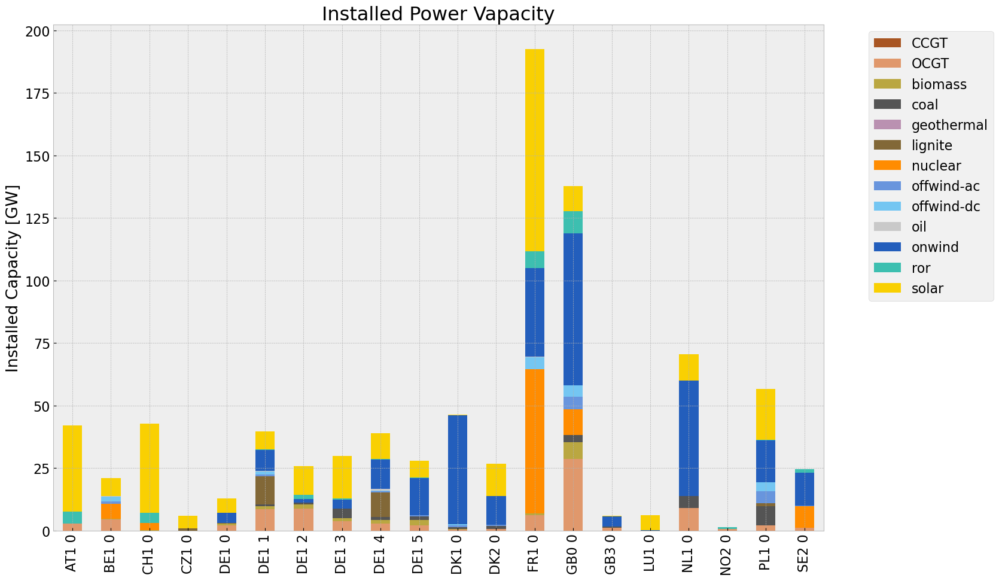

<Figure size 640x480 with 0 Axes>

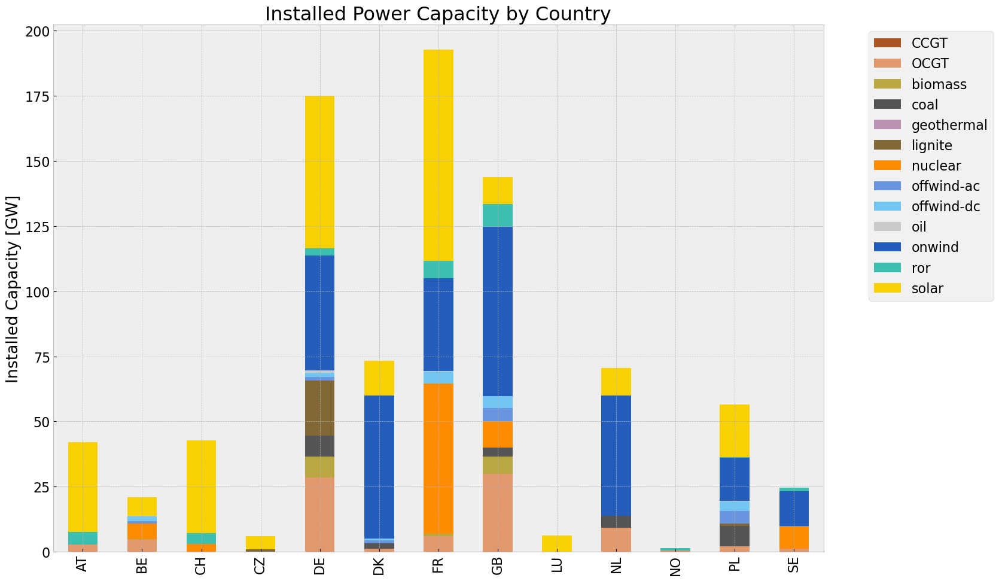

<Figure size 640x480 with 0 Axes>

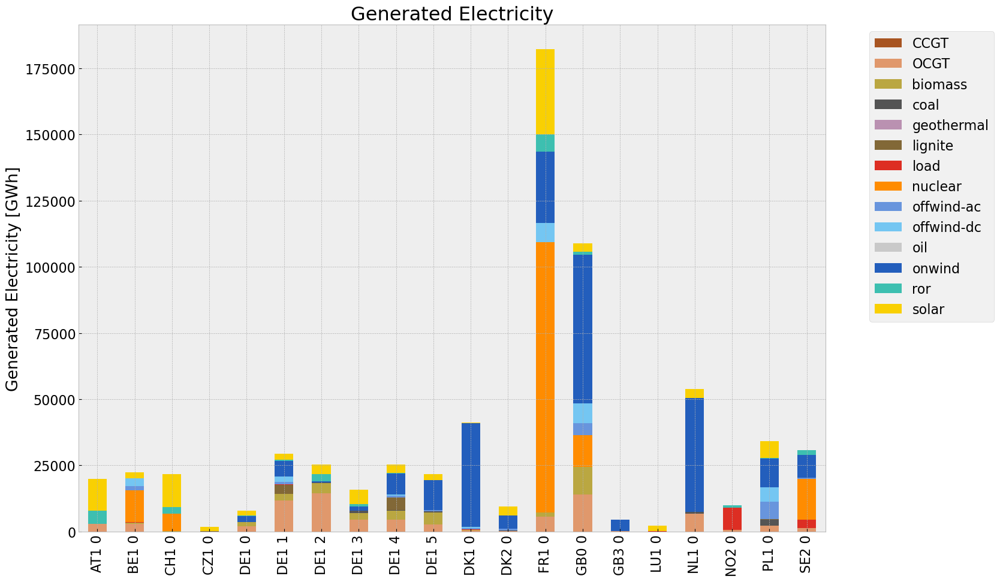

<Figure size 640x480 with 0 Axes>

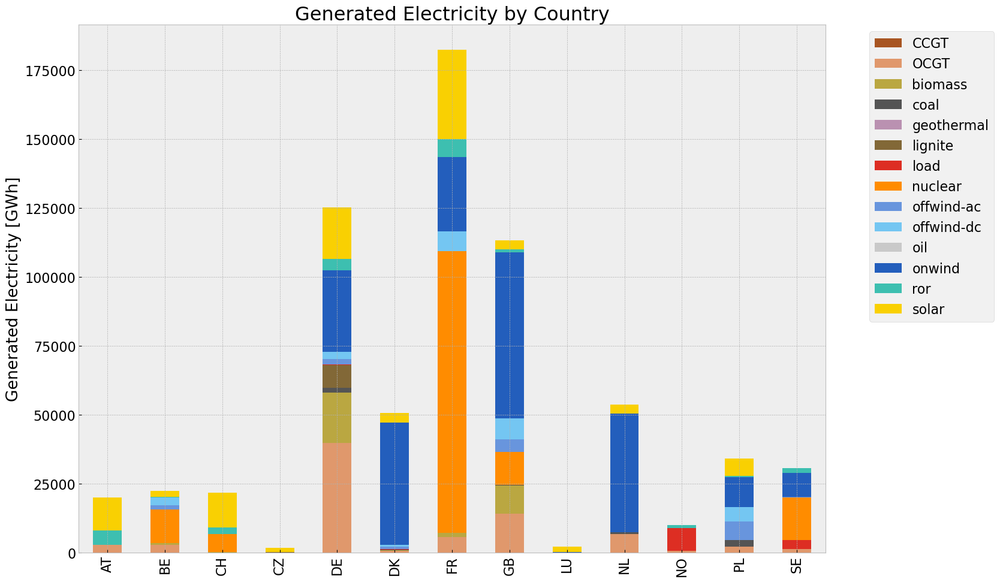

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.703966e+07,0.451621,0.1980,3.377580e+07
biomass,3.115830e+07,0.468000,0.0000,0.000000e+00
coal,5.070020e+06,0.329908,0.3361,5.165179e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,8.495291e+06,0.337285,0.4069,1.024871e+07
load,1.237293e+07,1.000000,0.0000,0.000000e+00
nuclear,1.482081e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.581032e+07,1.000000,0.0000,0.000000e+00


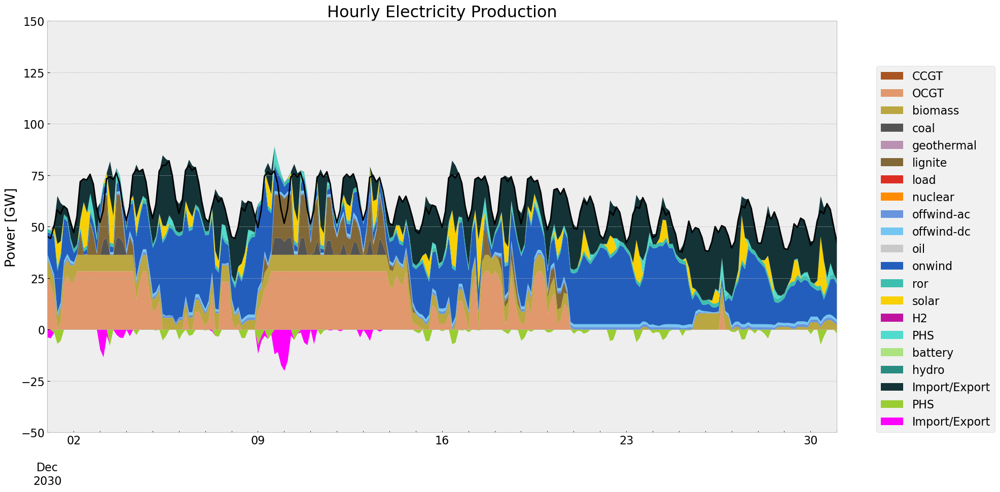

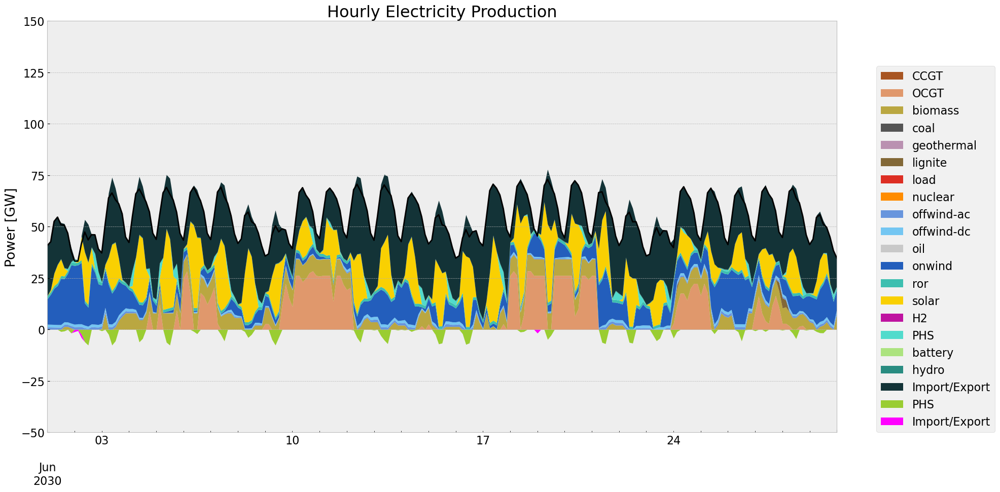

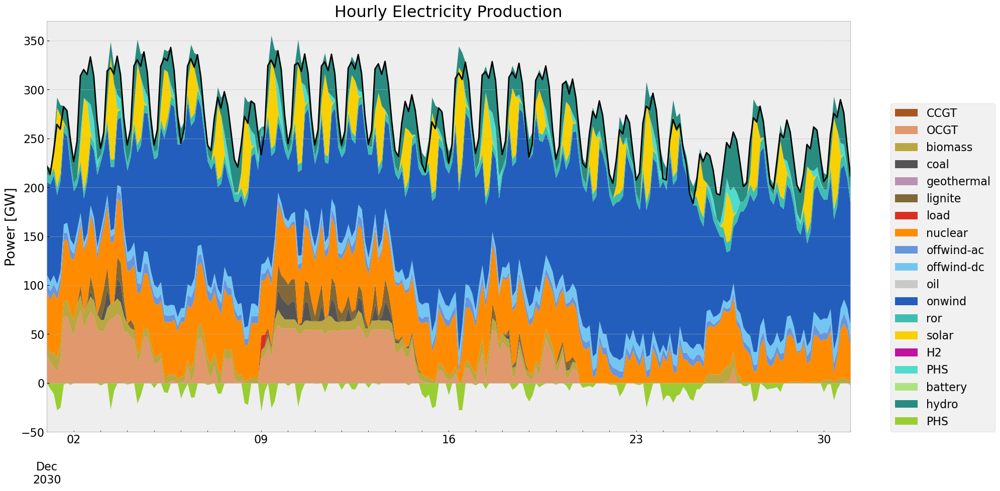

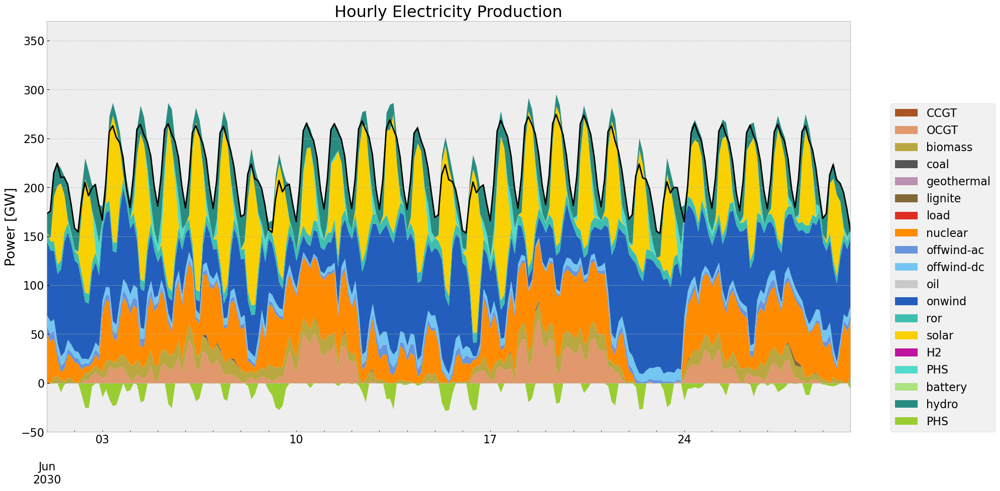

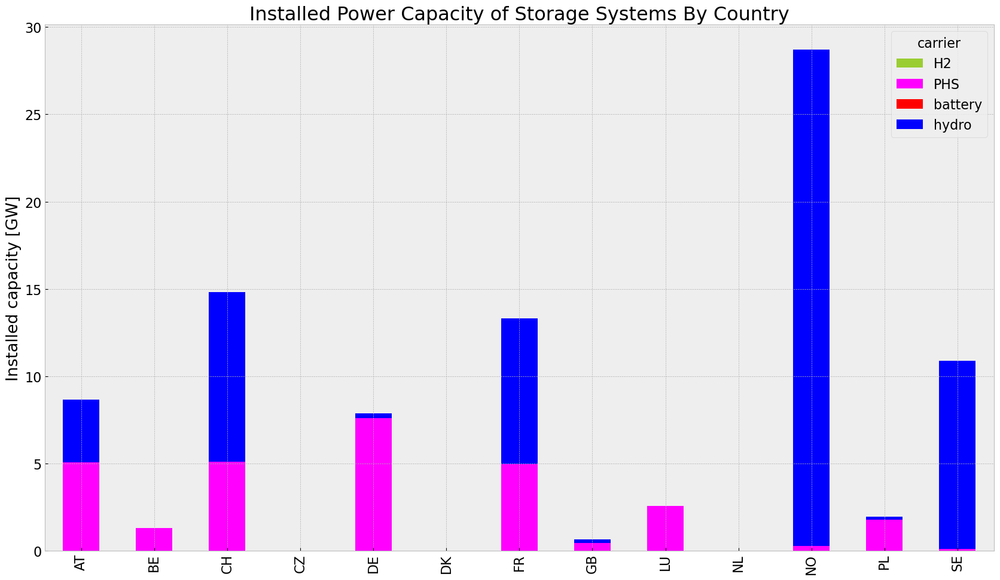

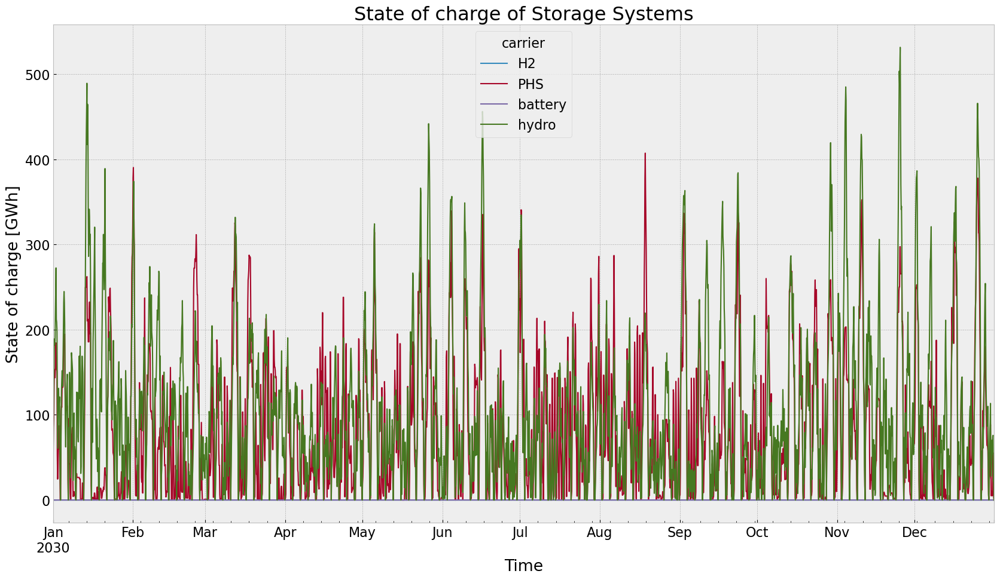

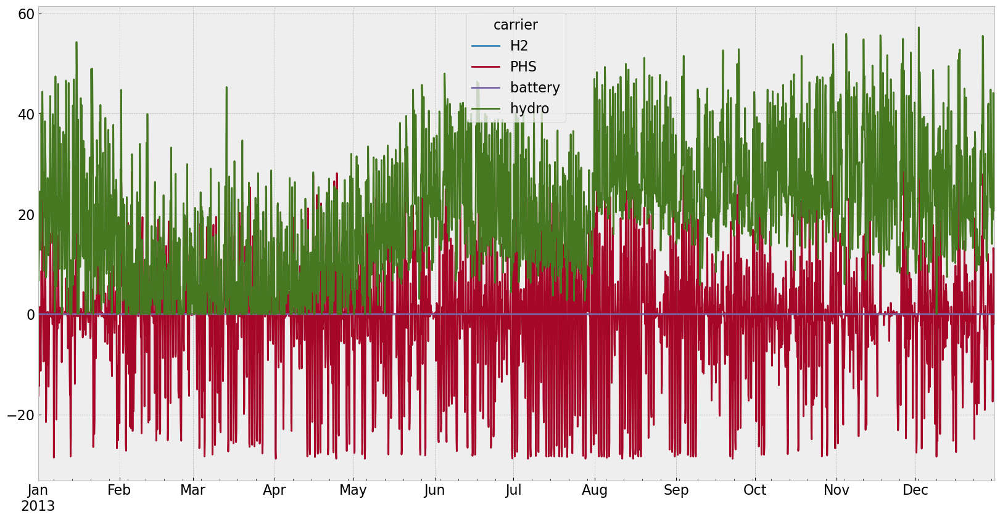

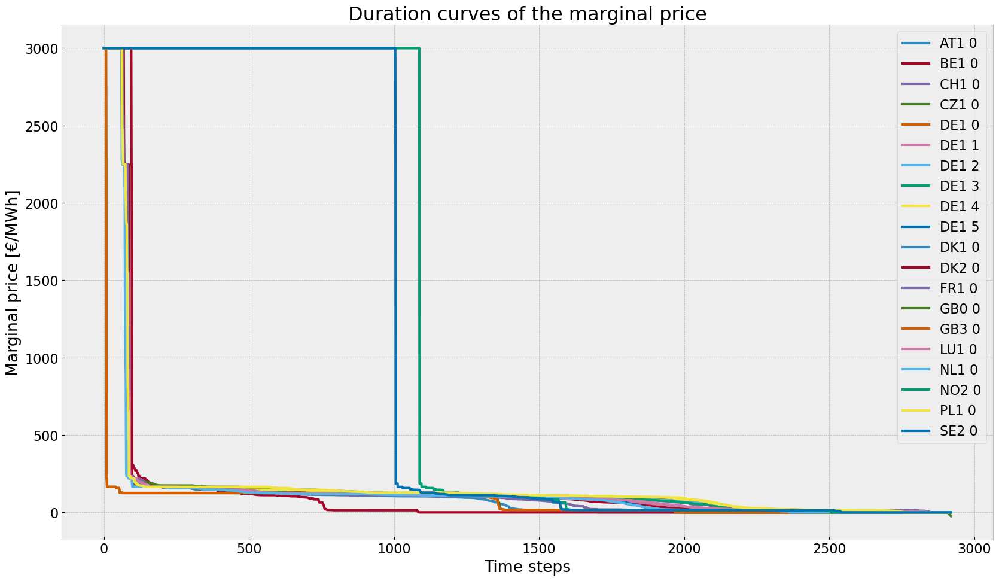

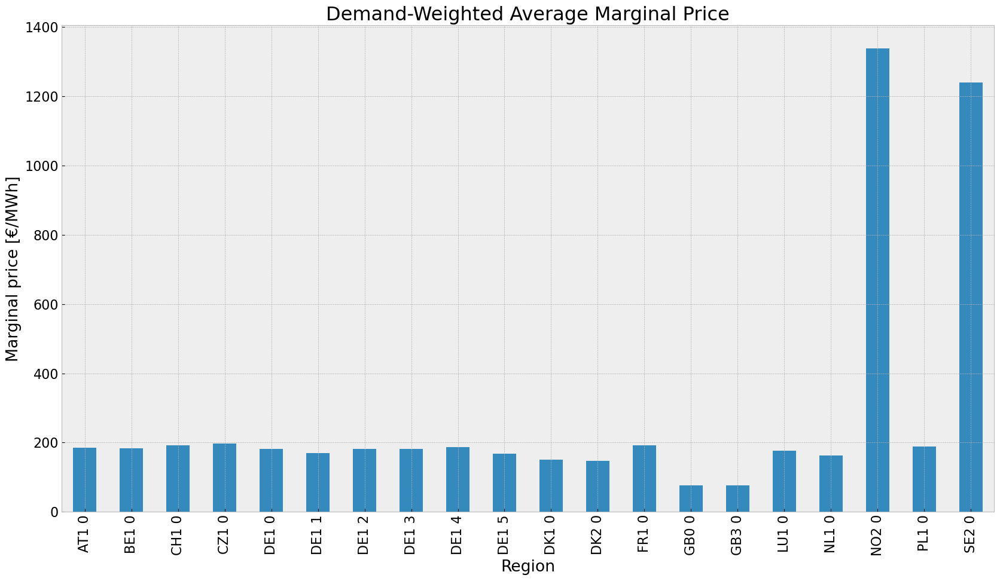

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


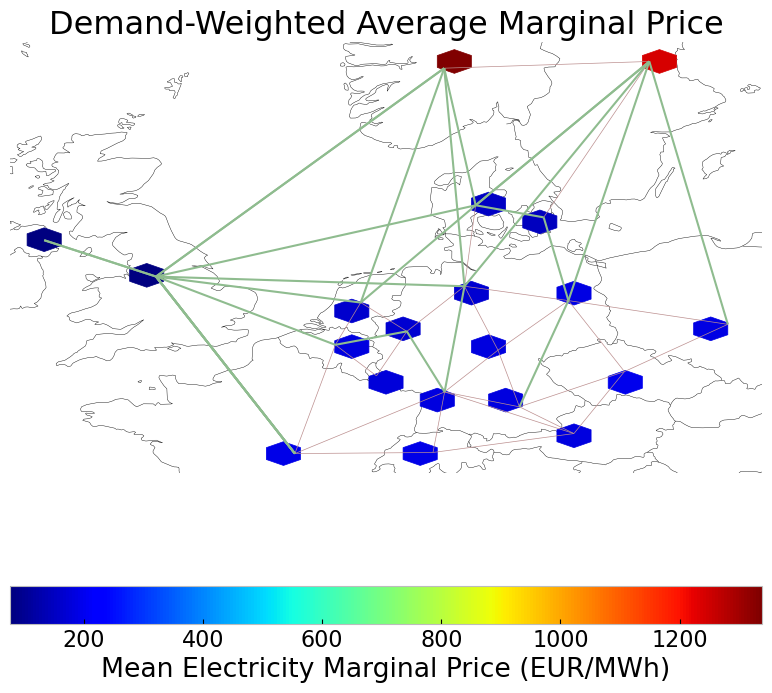

In [72]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3,colors_gen_table)
gen_noinv_roll_country = gen_power_table_country(n3,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3)
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [73]:
n4 = n1.copy()
n4.name = 'inv_roll_drought'
horizon = 24

no_inv(n4,n1)
#set extendable to false
#set the optimal capacity of generators from the base scenario as the new minimum capacity 
#for index, value in n4.generators.p_nom_extendable.items():
#    if value:  
#        n4.generators.at[index, 'p_nom'] = n1.generators.at[index, 'p_nom_opt']
#        #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
#        n4.generators.at[index,'p_nom_extendable'] = False

#set the optimal capacity of storage units from the base scenario as the new minimum capacity 
#for index, value in n4.storage_units.p_nom_extendable.items():
#    if value:  
#        n4.storage_units.at[index, 'p_nom'] = n1.storage_units.at[index, 'p_nom_opt']
#        #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
#        n4.storage_units.at[index,'p_nom_extendable'] = False

#set the optimal capacity of stores from the base scenario as the new minimum capacity 
#for index, value in n4.stores.e_nom_extendable.items():
#    if value:  
#        n4.stores.at[index, 'e_nom'] = n1.stores.at[index, 'e_nom_opt']
#        #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
#        n4.stores.at[index, 'e_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n2.lines.s_nom_extendable.items():
#    if value:  
#        n4.lines.at[index, 's_nom'] = n1.lines.at[index, 's_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.lines.at[index, 's_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n4.links.p_nom_extendable.items():
#    if value:  
#        n4.links.at[index, 's_nom'] = n1.links.at[index, 'p_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.links.at[index, 'p_nom_extendable'] =False

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#n4 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Drought\\20240512\\inv_roll_drought.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22tdfnh1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22tdfnh1.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfc2743a0


INFO:gurobipy:Model fingerprint: 0xfc2743a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25458 rows and 7061 columns


INFO:gurobipy:Presolve removed 25458 rows and 7061 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1374 rows, 5443 columns, 9154 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5443 columns, 9154 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


 Factor Ops : 2.031e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.031e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06274054e+11 -5.26498819e+11  9.05e+04 1.12e+04  5.25e+08     0s


INFO:gurobipy:   0   2.06274054e+11 -5.26498819e+11  9.05e+04 1.12e+04  5.25e+08     0s


   1   3.26702158e+10 -2.78583266e+11  9.75e+03 7.28e-11  7.18e+07     0s


INFO:gurobipy:   1   3.26702158e+10 -2.78583266e+11  9.75e+03 7.28e-11  7.18e+07     0s


   2   5.03807767e+09 -7.32363670e+10  5.45e+02 7.28e-11  8.94e+06     0s


INFO:gurobipy:   2   5.03807767e+09 -7.32363670e+10  5.45e+02 7.28e-11  8.94e+06     0s


   3   1.28805019e+09 -1.15907171e+10  9.76e+01 1.05e-09  1.31e+06     0s


INFO:gurobipy:   3   1.28805019e+09 -1.15907171e+10  9.76e+01 1.05e-09  1.31e+06     0s


   4   4.12648416e+08 -1.79962437e+09  5.20e+00 2.84e-10  2.05e+05     0s


INFO:gurobipy:   4   4.12648416e+08 -1.79962437e+09  5.20e+00 2.84e-10  2.05e+05     0s


   5   2.30984519e+08 -7.46625816e+08  1.89e+00 1.12e-10  9.01e+04     0s


INFO:gurobipy:   5   2.30984519e+08 -7.46625816e+08  1.89e+00 1.12e-10  9.01e+04     0s


   6   1.42708572e+08 -4.28935895e+08  9.32e-01 6.18e-11  5.26e+04     0s


INFO:gurobipy:   6   1.42708572e+08 -4.28935895e+08  9.32e-01 6.18e-11  5.26e+04     0s


   7   1.02530171e+08 -2.33345378e+08  5.48e-01 3.32e-11  3.09e+04     0s


INFO:gurobipy:   7   1.02530171e+08 -2.33345378e+08  5.48e-01 3.32e-11  3.09e+04     0s


   8   6.12411459e+07 -1.46165143e+05  9.69e-02 2.62e-11  5.63e+03     0s


INFO:gurobipy:   8   6.12411459e+07 -1.46165143e+05  9.69e-02 2.62e-11  5.63e+03     0s


   9   4.93147613e+07  2.49762474e+07  3.72e-02 2.20e-11  2.23e+03     0s


INFO:gurobipy:   9   4.93147613e+07  2.49762474e+07  3.72e-02 2.20e-11  2.23e+03     0s


  10   4.44064878e+07  3.25651732e+07  1.68e-02 2.47e-11  1.09e+03     0s


INFO:gurobipy:  10   4.44064878e+07  3.25651732e+07  1.68e-02 2.47e-11  1.09e+03     0s


  11   4.22060706e+07  3.57612846e+07  8.80e-03 2.41e-11  5.91e+02     0s


INFO:gurobipy:  11   4.22060706e+07  3.57612846e+07  8.80e-03 2.41e-11  5.91e+02     0s


  12   4.07320550e+07  3.77254199e+07  3.92e-03 1.75e-11  2.76e+02     0s


INFO:gurobipy:  12   4.07320550e+07  3.77254199e+07  3.92e-03 1.75e-11  2.76e+02     0s


  13   4.00558053e+07  3.84635903e+07  1.71e-03 1.42e-11  1.46e+02     0s


INFO:gurobipy:  13   4.00558053e+07  3.84635903e+07  1.71e-03 1.42e-11  1.46e+02     0s


  14   3.96195624e+07  3.90989041e+07  4.52e-04 2.26e-11  4.78e+01     0s


INFO:gurobipy:  14   3.96195624e+07  3.90989041e+07  4.52e-04 2.26e-11  4.78e+01     0s


  15   3.95381706e+07  3.93595666e+07  2.38e-04 2.95e-11  1.64e+01     0s


INFO:gurobipy:  15   3.95381706e+07  3.93595666e+07  2.38e-04 2.95e-11  1.64e+01     0s


  16   3.94770502e+07  3.94006057e+07  8.82e-05 2.20e-11  7.01e+00     0s


INFO:gurobipy:  16   3.94770502e+07  3.94006057e+07  8.82e-05 2.20e-11  7.01e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1868    3.9439259e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1868    3.9439259e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1868 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1868 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.943925942e+07


INFO:gurobipy:Optimal objective  3.943925942e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 77.77it/s]
INFO:linopy.io: Writing time: 0.66s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ljij4apl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ljij4apl.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1b696c2b


INFO:gurobipy:Model fingerprint: 0x1b696c2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25444 rows and 6838 columns


INFO:gurobipy:Presolve removed 25444 rows and 6838 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1388 rows, 5666 columns, 9419 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5666 columns, 9419 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.20655873e+11 -5.23868648e+11  8.44e+04 1.15e+04  4.91e+08     0s


INFO:gurobipy:   0   2.20655873e+11 -5.23868648e+11  8.44e+04 1.15e+04  4.91e+08     0s


   1   4.57989264e+10 -2.78525365e+11  1.03e+04 8.73e-11  7.44e+07     0s


INFO:gurobipy:   1   4.57989264e+10 -2.78525365e+11  1.03e+04 8.73e-11  7.44e+07     0s


   2   7.22451686e+09 -7.02119594e+10  5.14e+02 1.40e+02  8.50e+06     0s


INFO:gurobipy:   2   7.22451686e+09 -7.02119594e+10  5.14e+02 1.40e+02  8.50e+06     0s


   3   1.72223184e+09 -1.08521006e+10  7.61e+01 5.68e-10  1.21e+06     0s


INFO:gurobipy:   3   1.72223184e+09 -1.08521006e+10  7.61e+01 5.68e-10  1.21e+06     0s


   4   8.17273943e+08 -1.94282218e+09  1.18e+01 2.18e-10  2.50e+05     0s


INFO:gurobipy:   4   8.17273943e+08 -1.94282218e+09  1.18e+01 2.18e-10  2.50e+05     0s


   5   5.45412441e+08 -5.95812010e+08  4.00e+00 8.37e-11  1.02e+05     0s


INFO:gurobipy:   5   5.45412441e+08 -5.95812010e+08  4.00e+00 8.37e-11  1.02e+05     0s


   6   4.39090269e+08 -1.59726694e+08  2.35e+00 4.00e-11  5.32e+04     0s


INFO:gurobipy:   6   4.39090269e+08 -1.59726694e+08  2.35e+00 4.00e-11  5.32e+04     0s


   7   3.69863158e+08  4.34640501e+07  1.49e+00 2.91e-11  2.89e+04     0s


INFO:gurobipy:   7   3.69863158e+08  4.34640501e+07  1.49e+00 2.91e-11  2.89e+04     0s


   8   3.29818273e+08  1.32137325e+08  1.03e+00 2.91e-11  1.75e+04     0s


INFO:gurobipy:   8   3.29818273e+08  1.32137325e+08  1.03e+00 2.91e-11  1.75e+04     0s


   9   2.59675536e+08  1.82267368e+08  2.20e-01 2.14e-11  6.83e+03     0s


INFO:gurobipy:   9   2.59675536e+08  1.82267368e+08  2.20e-01 2.14e-11  6.83e+03     0s


  10   2.38447645e+08  2.15569440e+08  5.11e-02 2.24e-11  2.02e+03     0s


INFO:gurobipy:  10   2.38447645e+08  2.15569440e+08  5.11e-02 2.24e-11  2.02e+03     0s


  11   2.33963708e+08  2.23868557e+08  2.51e-02 1.89e-11  8.90e+02     0s


INFO:gurobipy:  11   2.33963708e+08  2.23868557e+08  2.51e-02 1.89e-11  8.90e+02     0s


  12   2.31754859e+08  2.26841321e+08  1.28e-02 2.15e-11  4.33e+02     0s


INFO:gurobipy:  12   2.31754859e+08  2.26841321e+08  1.28e-02 2.15e-11  4.33e+02     0s


  13   2.30789356e+08  2.28267726e+08  7.69e-03 1.81e-11  2.22e+02     0s


INFO:gurobipy:  13   2.30789356e+08  2.28267726e+08  7.69e-03 1.81e-11  2.22e+02     0s


  14   2.29873297e+08  2.28973934e+08  2.80e-03 2.02e-11  7.93e+01     0s


INFO:gurobipy:  14   2.29873297e+08  2.28973934e+08  2.80e-03 2.02e-11  7.93e+01     0s


  15   2.29523371e+08  2.29193833e+08  1.04e-03 2.20e-11  2.91e+01     0s


INFO:gurobipy:  15   2.29523371e+08  2.29193833e+08  1.04e-03 2.20e-11  2.91e+01     0s


  16   2.29329176e+08  2.29289546e+08  9.24e-05 2.59e-11  3.49e+00     0s


INFO:gurobipy:  16   2.29329176e+08  2.29289546e+08  9.24e-05 2.59e-11  3.49e+00     0s


  17   2.29310586e+08  2.29305487e+08  9.16e-06 1.76e-11  4.49e-01     0s


INFO:gurobipy:  17   2.29310586e+08  2.29305487e+08  9.16e-06 1.76e-11  4.49e-01     0s


  18   2.29308656e+08  2.29307300e+08  2.04e-06 1.96e-11  1.20e-01     0s


INFO:gurobipy:  18   2.29308656e+08  2.29307300e+08  2.04e-06 1.96e-11  1.20e-01     0s


  19   2.29308126e+08  2.29307763e+08  2.06e-07 1.66e-11  3.20e-02     0s


INFO:gurobipy:  19   2.29308126e+08  2.29307763e+08  2.06e-07 1.66e-11  3.20e-02     0s


  20   2.29308089e+08  2.29308004e+08  8.35e-08 2.38e-11  7.47e-03     0s


INFO:gurobipy:  20   2.29308089e+08  2.29308004e+08  8.35e-08 2.38e-11  7.47e-03     0s


  21   2.29308058e+08  2.29308052e+08  4.46e-09 2.65e-11  5.16e-04     0s


INFO:gurobipy:  21   2.29308058e+08  2.29308052e+08  4.46e-09 2.65e-11  5.16e-04     0s


  22   2.29308057e+08  2.29308057e+08  8.48e-09 2.91e-11  1.34e-05     0s


INFO:gurobipy:  22   2.29308057e+08  2.29308057e+08  8.48e-09 2.91e-11  1.34e-05     0s


  23   2.29308057e+08  2.29308057e+08  6.17e-09 2.91e-11  2.14e-08     0s


INFO:gurobipy:  23   2.29308057e+08  2.29308057e+08  6.17e-09 2.91e-11  2.14e-08     0s


  24   2.29308057e+08  2.29308057e+08  3.43e-11 2.91e-11  2.96e-10     0s


INFO:gurobipy:  24   2.29308057e+08  2.29308057e+08  3.43e-11 2.91e-11  2.96e-10     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.35 seconds (0.06 work units)


Optimal objective 2.29308057e+08


INFO:gurobipy:Optimal objective 2.29308057e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     115 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     115 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     112 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     112 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    2.2930806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    2.2930806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.42 seconds (0.06 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.42 seconds (0.06 work units)


Optimal objective  2.293080575e+08


INFO:gurobipy:Optimal objective  2.293080575e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oxtj6fbb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oxtj6fbb.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfb47f918


INFO:gurobipy:Model fingerprint: 0xfb47f918


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25440 rows and 6831 columns


INFO:gurobipy:Presolve removed 25440 rows and 6831 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1392 rows, 5673 columns, 9438 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5673 columns, 9438 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.61940887e+11 -5.06023327e+11  9.14e+04 1.32e+04  5.22e+08     0s


INFO:gurobipy:   0   2.61940887e+11 -5.06023327e+11  9.14e+04 1.32e+04  5.22e+08     0s


   1   5.75545799e+10 -2.70050483e+11  1.17e+04 7.28e-11  8.04e+07     0s


INFO:gurobipy:   1   5.75545799e+10 -2.70050483e+11  1.17e+04 7.28e-11  8.04e+07     0s


   2   1.30252977e+10 -6.41548104e+10  7.34e+02 1.31e-10  9.22e+06     0s


INFO:gurobipy:   2   1.30252977e+10 -6.41548104e+10  7.34e+02 1.31e-10  9.22e+06     0s


   3   5.07330664e+09 -1.33591028e+10  1.13e+02 2.62e-10  1.84e+06     0s


INFO:gurobipy:   3   5.07330664e+09 -1.33591028e+10  1.13e+02 2.62e-10  1.84e+06     0s


   4   2.88072707e+09 -4.41956410e+09  4.74e+01 2.18e-10  7.00e+05     0s


INFO:gurobipy:   4   2.88072707e+09 -4.41956410e+09  4.74e+01 2.18e-10  7.00e+05     0s


   5   1.97492040e+09 -1.04715416e+09  2.56e+01 1.31e-10  2.86e+05     0s


INFO:gurobipy:   5   1.97492040e+09 -1.04715416e+09  2.56e+01 1.31e-10  2.86e+05     0s


   6   1.51010797e+09  1.44579128e+08  1.26e+01 8.73e-11  1.27e+05     0s


INFO:gurobipy:   6   1.51010797e+09  1.44579128e+08  1.26e+01 8.73e-11  1.27e+05     0s


   7   1.25613521e+09  7.01214056e+08  4.65e+00 5.82e-11  5.05e+04     0s


INFO:gurobipy:   7   1.25613521e+09  7.01214056e+08  4.65e+00 5.82e-11  5.05e+04     0s


   8   1.12063109e+09  9.52842946e+08  1.17e+00 4.37e-11  1.50e+04     0s


INFO:gurobipy:   8   1.12063109e+09  9.52842946e+08  1.17e+00 4.37e-11  1.50e+04     0s


   9   1.10014683e+09  1.00388963e+09  7.94e-01 2.91e-11  8.57e+03     0s


INFO:gurobipy:   9   1.10014683e+09  1.00388963e+09  7.94e-01 2.91e-11  8.57e+03     0s


  10   1.07598884e+09  1.02173480e+09  3.52e-01 2.91e-11  4.81e+03     1s


INFO:gurobipy:  10   1.07598884e+09  1.02173480e+09  3.52e-01 2.91e-11  4.81e+03     1s


  11   1.06805387e+09  1.03451952e+09  2.20e-01 1.74e-11  2.97e+03     1s


INFO:gurobipy:  11   1.06805387e+09  1.03451952e+09  2.20e-01 1.74e-11  2.97e+03     1s


  12   1.06625418e+09  1.03873514e+09  1.93e-01 2.91e-11  2.44e+03     1s


INFO:gurobipy:  12   1.06625418e+09  1.03873514e+09  1.93e-01 2.91e-11  2.44e+03     1s


  13   1.05850554e+09  1.04403086e+09  8.23e-02 2.91e-11  1.28e+03     1s


INFO:gurobipy:  13   1.05850554e+09  1.04403086e+09  8.23e-02 2.91e-11  1.28e+03     1s


  14   1.05581585e+09  1.04809108e+09  4.85e-02 1.62e-11  6.83e+02     1s


INFO:gurobipy:  14   1.05581585e+09  1.04809108e+09  4.85e-02 1.62e-11  6.83e+02     1s


  15   1.05445049e+09  1.04967156e+09  3.24e-02 1.77e-11  4.23e+02     1s


INFO:gurobipy:  15   1.05445049e+09  1.04967156e+09  3.24e-02 1.77e-11  4.23e+02     1s


INFO:gurobipy:


Barrier performed 15 iterations in 0.55 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.55 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1841    1.0516354e+09   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1841    1.0516354e+09   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1841 iterations and 0.59 seconds (0.05 work units)


INFO:gurobipy:Solved in 1841 iterations and 0.59 seconds (0.05 work units)


Optimal objective  1.051635446e+09


INFO:gurobipy:Optimal objective  1.051635446e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ldbvn6ez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ldbvn6ez.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xef5c18c7


INFO:gurobipy:Model fingerprint: 0xef5c18c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6810 columns


INFO:gurobipy:Presolve removed 25440 rows and 6810 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5694 columns, 9459 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5694 columns, 9459 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60683684e+11 -5.17417451e+11  5.46e+04 1.38e+04  3.32e+08     0s


INFO:gurobipy:   0   1.60683684e+11 -5.17417451e+11  5.46e+04 1.38e+04  3.32e+08     0s


   1   3.73143353e+10 -2.31552921e+11  6.10e+03 8.00e-11  4.96e+07     0s


INFO:gurobipy:   1   3.73143353e+10 -2.31552921e+11  6.10e+03 8.00e-11  4.96e+07     0s


   2   9.36586224e+09 -5.76430937e+10  4.20e+02 3.86e+02  7.15e+06     0s


INFO:gurobipy:   2   9.36586224e+09 -5.76430937e+10  4.20e+02 3.86e+02  7.15e+06     0s


   3   2.84360975e+09 -1.15814755e+10  6.59e+01 2.18e-10  1.36e+06     0s


INFO:gurobipy:   3   2.84360975e+09 -1.15814755e+10  6.59e+01 2.18e-10  1.36e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.15 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.15 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1702    9.3214511e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1702    9.3214511e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1702 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1702 iterations and 0.22 seconds (0.05 work units)


Optimal objective  9.321451061e+08


INFO:gurobipy:Optimal objective  9.321451061e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ukd3qab.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ukd3qab.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x23b7b74e


INFO:gurobipy:Model fingerprint: 0x23b7b74e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25441 rows and 6821 columns


INFO:gurobipy:Presolve removed 25441 rows and 6821 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1391 rows, 5683 columns, 9442 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5683 columns, 9442 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.52189685e+11 -5.04419391e+11  8.77e+04 1.32e+04  5.00e+08     0s


INFO:gurobipy:   0   2.52189685e+11 -5.04419391e+11  8.77e+04 1.32e+04  5.00e+08     0s


   1   5.63722052e+10 -2.67674339e+11  1.12e+04 7.28e-11  7.74e+07     0s


INFO:gurobipy:   1   5.63722052e+10 -2.67674339e+11  1.12e+04 7.28e-11  7.74e+07     0s


   2   1.27426623e+10 -6.56996246e+10  6.47e+02 7.28e-11  9.02e+06     0s


INFO:gurobipy:   2   1.27426623e+10 -6.56996246e+10  6.47e+02 7.28e-11  9.02e+06     0s


   3   6.12905202e+09 -1.72023176e+10  1.60e+02 6.69e-10  2.37e+06     0s


INFO:gurobipy:   3   6.12905202e+09 -1.72023176e+10  1.60e+02 6.69e-10  2.37e+06     0s


   4   3.88353575e+09 -4.73042764e+09  6.80e+01 5.38e-10  8.42e+05     0s


INFO:gurobipy:   4   3.88353575e+09 -4.73042764e+09  6.80e+01 5.38e-10  8.42e+05     0s


   5   3.02904433e+09 -1.45576047e+09  2.95e+01 2.62e-10  4.21e+05     0s


INFO:gurobipy:   5   3.02904433e+09 -1.45576047e+09  2.95e+01 2.62e-10  4.21e+05     0s


   6   2.74285369e+09  9.57676634e+08  1.38e+01 1.31e-10  1.64e+05     0s


INFO:gurobipy:   6   2.74285369e+09  9.57676634e+08  1.38e+01 1.31e-10  1.64e+05     0s


   7   2.50298300e+09  2.06589253e+09  6.14e-01 1.02e-10  3.86e+04     0s


INFO:gurobipy:   7   2.50298300e+09  2.06589253e+09  6.14e-01 1.02e-10  3.86e+04     0s


   8   2.46422775e+09  2.29364029e+09  2.35e-01 4.37e-11  1.50e+04     0s


INFO:gurobipy:   8   2.46422775e+09  2.29364029e+09  2.35e-01 4.37e-11  1.50e+04     0s


   9   2.42537328e+09  2.35457749e+09  3.06e-02 2.91e-11  6.23e+03     0s


INFO:gurobipy:   9   2.42537328e+09  2.35457749e+09  3.06e-02 2.91e-11  6.23e+03     0s


  10   2.41394709e+09  2.38987884e+09  4.23e-03 2.91e-11  2.12e+03     0s


INFO:gurobipy:  10   2.41394709e+09  2.38987884e+09  4.23e-03 2.91e-11  2.12e+03     0s


  11   2.41279027e+09  2.39978746e+09  2.83e-03 2.58e-11  1.14e+03     0s


INFO:gurobipy:  11   2.41279027e+09  2.39978746e+09  2.83e-03 2.58e-11  1.14e+03     0s


  12   2.41142095e+09  2.40536123e+09  1.42e-03 2.91e-11  5.33e+02     0s


INFO:gurobipy:  12   2.41142095e+09  2.40536123e+09  1.42e-03 2.91e-11  5.33e+02     0s


  13   2.41067829e+09  2.40751899e+09  7.43e-04 2.91e-11  2.78e+02     0s


INFO:gurobipy:  13   2.41067829e+09  2.40751899e+09  7.43e-04 2.91e-11  2.78e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1571    2.4097778e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1571    2.4097778e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1571 iterations and 0.22 seconds (0.04 work units)


INFO:gurobipy:Solved in 1571 iterations and 0.22 seconds (0.04 work units)


Optimal objective  2.409777794e+09


INFO:gurobipy:Optimal objective  2.409777794e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xv9rxvsg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xv9rxvsg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcdd0b4c6


INFO:gurobipy:Model fingerprint: 0xcdd0b4c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25454 rows and 6917 columns


INFO:gurobipy:Presolve removed 25454 rows and 6917 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1378 rows, 5587 columns, 9313 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5587 columns, 9313 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.876e+03


INFO:gurobipy: AA' NZ     : 3.876e+03


 Factor NZ  : 3.841e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.841e+04 (roughly 3 MB of memory)


 Factor Ops : 1.952e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.952e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.45250186e+11 -5.02522310e+11  8.72e+04 1.48e+04  4.99e+08     0s


INFO:gurobipy:   0   2.45250186e+11 -5.02522310e+11  8.72e+04 1.48e+04  4.99e+08     0s


   1   5.80184323e+10 -2.68121353e+11  1.10e+04 7.28e-11  7.73e+07     0s


INFO:gurobipy:   1   5.80184323e+10 -2.68121353e+11  1.10e+04 7.28e-11  7.73e+07     0s


   2   1.60045016e+10 -6.04495614e+10  7.14e+02 1.16e-10  9.20e+06     0s


INFO:gurobipy:   2   1.60045016e+10 -6.04495614e+10  7.14e+02 1.16e-10  9.20e+06     0s


   3   9.13023828e+09 -7.47214155e+09  1.70e+02 4.80e-10  1.81e+06     0s


INFO:gurobipy:   3   9.13023828e+09 -7.47214155e+09  1.70e+02 4.80e-10  1.81e+06     0s


   4   6.09054671e+09  4.04466483e+07  4.45e+01 2.91e-10  6.06e+05     0s


INFO:gurobipy:   4   6.09054671e+09  4.04466483e+07  4.45e+01 2.91e-10  6.06e+05     0s


   5   5.50125646e+09  2.21077470e+09  2.41e+01 2.47e-10  3.23e+05     0s


INFO:gurobipy:   5   5.50125646e+09  2.21077470e+09  2.41e+01 2.47e-10  3.23e+05     0s


   6   5.08324746e+09  3.37946162e+09  9.28e+00 1.24e-10  1.62e+05     0s


INFO:gurobipy:   6   5.08324746e+09  3.37946162e+09  9.28e+00 1.24e-10  1.62e+05     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1806    4.7569163e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1806    4.7569163e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1806 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1806 iterations and 0.19 seconds (0.05 work units)


Optimal objective  4.756916254e+09


INFO:gurobipy:Optimal objective  4.756916254e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.76e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uvk58jbx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uvk58jbx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6756c507


INFO:gurobipy:Model fingerprint: 0x6756c507


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25443 rows and 6942 columns


INFO:gurobipy:Presolve removed 25443 rows and 6942 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 1389 rows, 5562 columns, 9320 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5562 columns, 9320 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.919e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.919e+04 (roughly 3 MB of memory)


 Factor Ops : 2.045e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.045e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.07302472e+11 -5.12542125e+11  7.99e+04 1.21e+04  4.65e+08     0s


INFO:gurobipy:   0   2.07302472e+11 -5.12542125e+11  7.99e+04 1.21e+04  4.65e+08     0s


   1   4.48940126e+10 -2.61670027e+11  1.04e+04 7.28e-11  7.32e+07     0s


INFO:gurobipy:   1   4.48940126e+10 -2.61670027e+11  1.04e+04 7.28e-11  7.32e+07     0s


   2   9.32552205e+09 -6.59452985e+10  6.33e+02 8.73e-11  8.79e+06     0s


INFO:gurobipy:   2   9.32552205e+09 -6.59452985e+10  6.33e+02 8.73e-11  8.79e+06     0s


   3   3.27823874e+09 -1.05920547e+10  1.58e+02 1.78e-09  1.48e+06     0s


INFO:gurobipy:   3   3.27823874e+09 -1.05920547e+10  1.58e+02 1.78e-09  1.48e+06     0s


   4   1.99943911e+09 -1.83024684e+09  6.25e+01 2.47e-10  3.99e+05     0s


INFO:gurobipy:   4   1.99943911e+09 -1.83024684e+09  6.25e+01 2.47e-10  3.99e+05     0s


   5   1.53266420e+09 -3.65371099e+08  3.18e+01 1.46e-10  1.90e+05     0s


INFO:gurobipy:   5   1.53266420e+09 -3.65371099e+08  3.18e+01 1.46e-10  1.90e+05     0s


   6   1.32802184e+09  3.36470762e+08  1.90e+01 1.75e-10  9.73e+04     0s


INFO:gurobipy:   6   1.32802184e+09  3.36470762e+08  1.90e+01 1.75e-10  9.73e+04     0s


   7   1.14166650e+09  6.63302619e+08  8.76e+00 4.37e-10  4.58e+04     0s


INFO:gurobipy:   7   1.14166650e+09  6.63302619e+08  8.76e+00 4.37e-10  4.58e+04     0s


   8   1.01034167e+09  8.48543793e+08  2.35e+00 1.60e-10  1.51e+04     0s


INFO:gurobipy:   8   1.01034167e+09  8.48543793e+08  2.35e+00 1.60e-10  1.51e+04     0s


   9   9.73433832e+08  8.85439693e+08  1.18e+00 1.89e-10  8.15e+03     0s


INFO:gurobipy:   9   9.73433832e+08  8.85439693e+08  1.18e+00 1.89e-10  8.15e+03     0s


  10   9.54611917e+08  9.06081972e+08  6.29e-01 2.47e-10  4.48e+03     0s


INFO:gurobipy:  10   9.54611917e+08  9.06081972e+08  6.29e-01 2.47e-10  4.48e+03     0s


  11   9.45697004e+08  9.19606435e+08  3.82e-01 8.73e-11  2.41e+03     0s


INFO:gurobipy:  11   9.45697004e+08  9.19606435e+08  3.82e-01 8.73e-11  2.41e+03     0s


  12   9.38816058e+08  9.25925290e+08  1.98e-01 7.28e-11  1.19e+03     0s


INFO:gurobipy:  12   9.38816058e+08  9.25925290e+08  1.98e-01 7.28e-11  1.19e+03     0s


  13   9.34771872e+08  9.29319837e+08  9.52e-02 8.73e-11  5.06e+02     0s


INFO:gurobipy:  13   9.34771872e+08  9.29319837e+08  9.52e-02 8.73e-11  5.06e+02     0s


  14   9.32088449e+08  9.30483173e+08  2.85e-02 7.28e-11  1.49e+02     0s


INFO:gurobipy:  14   9.32088449e+08  9.30483173e+08  2.85e-02 7.28e-11  1.49e+02     0s


  15   9.31204137e+08  9.30789302e+08  7.33e-03 8.73e-11  3.85e+01     0s


INFO:gurobipy:  15   9.31204137e+08  9.30789302e+08  7.33e-03 8.73e-11  3.85e+01     0s


  16   9.30994426e+08  9.30836869e+08  2.58e-03 4.37e-11  1.46e+01     0s


INFO:gurobipy:  16   9.30994426e+08  9.30836869e+08  2.58e-03 4.37e-11  1.46e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.39 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.39 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1908    9.3087781e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1908    9.3087781e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1908 iterations and 0.41 seconds (0.06 work units)


INFO:gurobipy:Solved in 1908 iterations and 0.41 seconds (0.06 work units)


Optimal objective  9.308778094e+08


INFO:gurobipy:Optimal objective  9.308778094e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 99.99it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lf4el0a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lf4el0a.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64856ab7


INFO:gurobipy:Model fingerprint: 0x64856ab7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25441 rows and 6913 columns


INFO:gurobipy:Presolve removed 25441 rows and 6913 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1391 rows, 5591 columns, 9350 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5591 columns, 9350 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00112574e+11 -5.06724585e+11  6.78e+04 1.35e+04  4.00e+08     0s


INFO:gurobipy:   0   2.00112574e+11 -5.06724585e+11  6.78e+04 1.35e+04  4.00e+08     0s


   1   4.76376482e+10 -2.39834629e+11  8.10e+03 7.28e-11  6.06e+07     0s


INFO:gurobipy:   1   4.76376482e+10 -2.39834629e+11  8.10e+03 7.28e-11  6.06e+07     0s


   2   1.51908350e+10 -5.42033026e+10  5.51e+02 8.73e-11  7.96e+06     0s


INFO:gurobipy:   2   1.51908350e+10 -5.42033026e+10  5.51e+02 8.73e-11  7.96e+06     0s


   3   9.03259258e+09 -9.93110333e+09  1.49e+02 6.84e-10  1.99e+06     0s


INFO:gurobipy:   3   9.03259258e+09 -9.93110333e+09  1.49e+02 6.84e-10  1.99e+06     0s


   4   6.07862484e+09  8.45458476e+08  2.95e+01 4.80e-10  5.08e+05     0s


INFO:gurobipy:   4   6.07862484e+09  8.45458476e+08  2.95e+01 4.80e-10  5.08e+05     0s


   5   5.44344039e+09  3.30771052e+09  1.37e+01 1.75e-10  2.05e+05     0s


INFO:gurobipy:   5   5.44344039e+09  3.30771052e+09  1.37e+01 1.75e-10  2.05e+05     0s


   6   5.08094048e+09  4.25252516e+09  5.06e+00 1.16e-10  7.86e+04     0s


INFO:gurobipy:   6   5.08094048e+09  4.25252516e+09  5.06e+00 1.16e-10  7.86e+04     0s


   7   4.92373748e+09  4.63117273e+09  1.17e+00 7.28e-11  2.71e+04     0s


INFO:gurobipy:   7   4.92373748e+09  4.63117273e+09  1.17e+00 7.28e-11  2.71e+04     0s


   8   4.89657420e+09  4.75890531e+09  6.29e-01 8.73e-11  1.28e+04     0s


INFO:gurobipy:   8   4.89657420e+09  4.75890531e+09  6.29e-01 8.73e-11  1.28e+04     0s


   9   4.87195473e+09  4.82859828e+09  1.72e-01 4.37e-11  4.01e+03     0s


INFO:gurobipy:   9   4.87195473e+09  4.82859828e+09  1.72e-01 4.37e-11  4.01e+03     0s


  10   4.86273857e+09  4.84842653e+09  2.06e-02 2.91e-11  1.29e+03     0s


INFO:gurobipy:  10   4.86273857e+09  4.84842653e+09  2.06e-02 2.91e-11  1.29e+03     0s


  11   4.86111914e+09  4.85753275e+09  3.19e-03 2.91e-11  3.23e+02     0s


INFO:gurobipy:  11   4.86111914e+09  4.85753275e+09  3.19e-03 2.91e-11  3.23e+02     0s


  12   4.86084897e+09  4.85956839e+09  8.42e-04 2.91e-11  1.15e+02     0s


INFO:gurobipy:  12   4.86084897e+09  4.85956839e+09  8.42e-04 2.91e-11  1.15e+02     0s


  13   4.86077834e+09  4.86045732e+09  3.41e-04 2.91e-11  2.89e+01     0s


INFO:gurobipy:  13   4.86077834e+09  4.86045732e+09  3.41e-04 2.91e-11  2.89e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1778    4.8607199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1778    4.8607199e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1778 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1778 iterations and 0.29 seconds (0.05 work units)


Optimal objective  4.860719880e+09


INFO:gurobipy:Optimal objective  4.860719880e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.86e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ow05qsiw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ow05qsiw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x12dc7795


INFO:gurobipy:Model fingerprint: 0x12dc7795


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25466 rows and 7087 columns


INFO:gurobipy:Presolve removed 25466 rows and 7087 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1366 rows, 5417 columns, 9103 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 5417 columns, 9103 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.843e+03


INFO:gurobipy: AA' NZ     : 3.843e+03


 Factor NZ  : 3.586e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.586e+04 (roughly 3 MB of memory)


 Factor Ops : 1.650e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.650e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02899780e+11 -5.01806393e+11  8.17e+04 1.60e+04  4.76e+08     0s


INFO:gurobipy:   0   2.02899780e+11 -5.01806393e+11  8.17e+04 1.60e+04  4.76e+08     0s


   1   2.86480185e+10 -2.54674465e+11  5.74e+03 7.28e-11  5.13e+07     0s


INFO:gurobipy:   1   2.86480185e+10 -2.54674465e+11  5.74e+03 7.28e-11  5.13e+07     0s


   2   8.82770433e+09 -5.78881896e+10  4.20e+02 1.60e-10  7.43e+06     0s


INFO:gurobipy:   2   8.82770433e+09 -5.78881896e+10  4.20e+02 1.60e-10  7.43e+06     0s


   3   4.40437986e+09 -1.00623916e+10  8.55e+01 2.62e-10  1.46e+06     0s


INFO:gurobipy:   3   4.40437986e+09 -1.00623916e+10  8.55e+01 2.62e-10  1.46e+06     0s


   4   2.68069549e+09 -2.69414997e+09  1.98e+01 1.75e-10  5.14e+05     0s


INFO:gurobipy:   4   2.68069549e+09 -2.69414997e+09  1.98e+01 1.75e-10  5.14e+05     0s


   5   2.25798164e+09  4.69905818e+08  7.54e+00 1.16e-10  1.69e+05     0s


INFO:gurobipy:   5   2.25798164e+09  4.69905818e+08  7.54e+00 1.16e-10  1.69e+05     0s


   6   2.06086961e+09  1.28275095e+09  3.45e+00 8.73e-11  7.32e+04     0s


INFO:gurobipy:   6   2.06086961e+09  1.28275095e+09  3.45e+00 8.73e-11  7.32e+04     0s


   7   1.92181863e+09  1.58051443e+09  1.03e+00 4.37e-11  3.18e+04     0s


INFO:gurobipy:   7   1.92181863e+09  1.58051443e+09  1.03e+00 4.37e-11  3.18e+04     0s


   8   1.90113599e+09  1.70628742e+09  7.64e-01 5.82e-11  1.82e+04     0s


INFO:gurobipy:   8   1.90113599e+09  1.70628742e+09  7.64e-01 5.82e-11  1.82e+04     0s


   9   1.85491802e+09  1.78126089e+09  1.47e-01 2.91e-11  6.83e+03     0s


INFO:gurobipy:   9   1.85491802e+09  1.78126089e+09  1.47e-01 2.91e-11  6.83e+03     0s


  10   1.84144446e+09  1.81522855e+09  2.66e-02 2.91e-11  2.42e+03     0s


INFO:gurobipy:  10   1.84144446e+09  1.81522855e+09  2.66e-02 2.91e-11  2.42e+03     0s


  11   1.83843161e+09  1.82994074e+09  1.05e-02 2.91e-11  7.86e+02     0s


INFO:gurobipy:  11   1.83843161e+09  1.82994074e+09  1.05e-02 2.91e-11  7.86e+02     0s


  12   1.83763011e+09  1.83298481e+09  7.19e-03 2.91e-11  4.30e+02     0s


INFO:gurobipy:  12   1.83763011e+09  1.83298481e+09  7.19e-03 2.91e-11  4.30e+02     0s


  13   1.83671660e+09  1.83413218e+09  3.63e-03 2.91e-11  2.39e+02     0s


INFO:gurobipy:  13   1.83671660e+09  1.83413218e+09  3.63e-03 2.91e-11  2.39e+02     0s


  14   1.83615924e+09  1.83498361e+09  1.51e-03 2.91e-11  1.09e+02     0s


INFO:gurobipy:  14   1.83615924e+09  1.83498361e+09  1.51e-03 2.91e-11  1.09e+02     0s


  15   1.83602218e+09  1.83537580e+09  9.99e-04 2.91e-11  5.99e+01     0s


INFO:gurobipy:  15   1.83602218e+09  1.83537580e+09  9.99e-04 2.91e-11  5.99e+01     0s


  16   1.83581389e+09  1.83563796e+09  2.14e-04 2.91e-11  1.63e+01     0s


INFO:gurobipy:  16   1.83581389e+09  1.83563796e+09  2.14e-04 2.91e-11  1.63e+01     0s


  17   1.83575279e+09  1.83569449e+09  2.44e-05 2.91e-11  5.38e+00     0s


INFO:gurobipy:  17   1.83575279e+09  1.83569449e+09  2.44e-05 2.91e-11  5.38e+00     0s


  18   1.83574576e+09  1.83573219e+09  5.66e-06 3.08e-11  1.25e+00     0s


INFO:gurobipy:  18   1.83574576e+09  1.83573219e+09  5.66e-06 3.08e-11  1.25e+00     0s


  19   1.83574318e+09  1.83573823e+09  8.01e-07 2.91e-11  4.56e-01     0s


INFO:gurobipy:  19   1.83574318e+09  1.83573823e+09  8.01e-07 2.91e-11  4.56e-01     0s


  20   1.83574285e+09  1.83574119e+09  3.31e-07 3.15e-11  1.53e-01     0s


INFO:gurobipy:  20   1.83574285e+09  1.83574119e+09  3.31e-07 3.15e-11  1.53e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2013    1.8357425e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2013    1.8357425e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2013 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 2013 iterations and 0.26 seconds (0.06 work units)


Optimal objective  1.835742524e+09


INFO:gurobipy:Optimal objective  1.835742524e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uu7h_qrv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uu7h_qrv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc9cb3c68


INFO:gurobipy:Model fingerprint: 0xc9cb3c68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25480 rows and 7191 columns


INFO:gurobipy:Presolve removed 25480 rows and 7191 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1352 rows, 5313 columns, 8958 nonzeros


INFO:gurobipy:Presolved: 1352 rows, 5313 columns, 8958 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.515e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.515e+04 (roughly 3 MB of memory)


 Factor Ops : 1.586e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.586e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12657258e+11 -5.11086310e+11  4.73e+04 1.09e+04  3.03e+08     0s


INFO:gurobipy:   0   1.12657258e+11 -5.11086310e+11  4.73e+04 1.09e+04  3.03e+08     0s


   1   1.78622234e+10 -2.22820227e+11  3.18e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   1.78622234e+10 -2.22820227e+11  3.18e+03 7.28e-11  3.64e+07     0s


   2   5.09154302e+09 -5.11852355e+10  2.20e+02 2.69e+02  5.90e+06     0s


INFO:gurobipy:   2   5.09154302e+09 -5.11852355e+10  2.20e+02 2.69e+02  5.90e+06     0s


   3   1.71080687e+09 -8.05056236e+09  5.47e+01 2.21e+01  9.78e+05     0s


INFO:gurobipy:   3   1.71080687e+09 -8.05056236e+09  5.47e+01 2.21e+01  9.78e+05     0s


   4   6.96682855e+08 -1.57662483e+09  1.39e+01 1.02e-10  2.20e+05     0s


INFO:gurobipy:   4   6.96682855e+08 -1.57662483e+09  1.39e+01 1.02e-10  2.20e+05     0s


   5   4.46870341e+08 -7.43291498e+08  7.26e+00 5.82e-11  1.14e+05     0s


INFO:gurobipy:   5   4.46870341e+08 -7.43291498e+08  7.26e+00 5.82e-11  1.14e+05     0s


   6   3.18417795e+08 -4.05810222e+08  4.46e+00 4.37e-11  6.90e+04     0s


INFO:gurobipy:   6   3.18417795e+08 -4.05810222e+08  4.46e+00 4.37e-11  6.90e+04     0s


   7   2.34715074e+08 -1.51005468e+08  2.74e+00 3.64e-11  3.66e+04     0s


INFO:gurobipy:   7   2.34715074e+08 -1.51005468e+08  2.74e+00 3.64e-11  3.66e+04     0s


   8   1.91127769e+08 -4.44062741e+07  1.84e+00 2.26e-11  2.23e+04     0s


INFO:gurobipy:   8   1.91127769e+08 -4.44062741e+07  1.84e+00 2.26e-11  2.23e+04     0s


   9   1.59077738e+08  1.03390640e+07  1.17e+00 1.57e-11  1.41e+04     0s


INFO:gurobipy:   9   1.59077738e+08  1.03390640e+07  1.17e+00 1.57e-11  1.41e+04     0s


  10   1.14977980e+08  6.53058030e+07  2.21e-01 2.83e-11  4.68e+03     0s


INFO:gurobipy:  10   1.14977980e+08  6.53058030e+07  2.21e-01 2.83e-11  4.68e+03     0s


  11   1.07925120e+08  8.60094055e+07  1.15e-01 2.63e-11  2.07e+03     0s


INFO:gurobipy:  11   1.07925120e+08  8.60094055e+07  1.15e-01 2.63e-11  2.07e+03     0s


  12   1.04099723e+08  9.20503339e+07  6.63e-02 2.91e-11  1.14e+03     0s


INFO:gurobipy:  12   1.04099723e+08  9.20503339e+07  6.63e-02 2.91e-11  1.14e+03     0s


  13   1.02472638e+08  9.38154639e+07  4.75e-02 2.65e-11  8.16e+02     0s


INFO:gurobipy:  13   1.02472638e+08  9.38154639e+07  4.75e-02 2.65e-11  8.16e+02     0s


  14   1.00908676e+08  9.58826611e+07  2.98e-02 2.14e-11  4.74e+02     0s


INFO:gurobipy:  14   1.00908676e+08  9.58826611e+07  2.98e-02 2.14e-11  4.74e+02     0s


  15   9.96625676e+07  9.69791676e+07  1.61e-02 2.62e-11  2.53e+02     0s


INFO:gurobipy:  15   9.96625676e+07  9.69791676e+07  1.61e-02 2.62e-11  2.53e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2009    9.8135366e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2009    9.8135366e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2009 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2009 iterations and 0.21 seconds (0.06 work units)


Optimal objective  9.813536582e+07


INFO:gurobipy:Optimal objective  9.813536582e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.36it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06f7farr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06f7farr.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0fb87e4e


INFO:gurobipy:Model fingerprint: 0x0fb87e4e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 8e+03]


INFO:gurobipy:  Bounds range     [6e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25452 rows and 6892 columns


INFO:gurobipy:Presolve removed 25452 rows and 6892 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1380 rows, 5612 columns, 9345 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 5612 columns, 9345 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.882e+03


INFO:gurobipy: AA' NZ     : 3.882e+03


 Factor NZ  : 3.782e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.782e+04 (roughly 3 MB of memory)


 Factor Ops : 1.821e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.821e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18307574e+11 -4.90579168e+11  4.53e+04 1.18e+04  2.83e+08     0s


INFO:gurobipy:   0   1.18307574e+11 -4.90579168e+11  4.53e+04 1.18e+04  2.83e+08     0s


   1   2.61680800e+10 -2.17903660e+11  5.00e+03 7.28e-11  4.30e+07     0s


INFO:gurobipy:   1   2.61680800e+10 -2.17903660e+11  5.00e+03 7.28e-11  4.30e+07     0s


   2   6.31251313e+09 -4.93320202e+10  2.95e+02 1.93e+02  5.81e+06     0s


INFO:gurobipy:   2   6.31251313e+09 -4.93320202e+10  2.95e+02 1.93e+02  5.81e+06     0s


   3   2.91673031e+09 -1.34898426e+10  6.67e+01 6.40e-10  1.56e+06     0s


INFO:gurobipy:   3   2.91673031e+09 -1.34898426e+10  6.67e+01 6.40e-10  1.56e+06     0s


   4   1.86550872e+09 -9.65052291e+08  8.02e+00 5.53e-10  2.57e+05     0s


INFO:gurobipy:   4   1.86550872e+09 -9.65052291e+08  8.02e+00 5.53e-10  2.57e+05     0s


   5   1.59750168e+09  3.38239206e+08  3.02e+00 2.33e-10  1.13e+05     0s


INFO:gurobipy:   5   1.59750168e+09  3.38239206e+08  3.02e+00 2.33e-10  1.13e+05     0s


   6   1.47947288e+09  8.42608674e+08  1.59e+00 1.02e-10  5.72e+04     0s


INFO:gurobipy:   6   1.47947288e+09  8.42608674e+08  1.59e+00 1.02e-10  5.72e+04     0s


   7   1.40299626e+09  1.03202148e+09  7.68e-01 5.82e-11  3.32e+04     0s


INFO:gurobipy:   7   1.40299626e+09  1.03202148e+09  7.68e-01 5.82e-11  3.32e+04     0s


   8   1.33491265e+09  1.22769945e+09  1.85e-01 2.91e-11  9.58e+03     0s


INFO:gurobipy:   8   1.33491265e+09  1.22769945e+09  1.85e-01 2.91e-11  9.58e+03     0s


   9   1.31391999e+09  1.26429732e+09  6.22e-02 3.25e-11  4.43e+03     0s


INFO:gurobipy:   9   1.31391999e+09  1.26429732e+09  6.22e-02 3.25e-11  4.43e+03     0s


  10   1.30959981e+09  1.28364724e+09  4.20e-02 2.49e-11  2.32e+03     0s


INFO:gurobipy:  10   1.30959981e+09  1.28364724e+09  4.20e-02 2.49e-11  2.32e+03     0s


  11   1.30558396e+09  1.29024610e+09  2.39e-02 3.02e-11  1.37e+03     0s


INFO:gurobipy:  11   1.30558396e+09  1.29024610e+09  2.39e-02 3.02e-11  1.37e+03     0s


  12   1.30298761e+09  1.29384736e+09  1.29e-02 2.91e-11  8.16e+02     0s


INFO:gurobipy:  12   1.30298761e+09  1.29384736e+09  1.29e-02 2.91e-11  8.16e+02     0s


  13   1.30081758e+09  1.29688778e+09  3.95e-03 3.12e-11  3.50e+02     0s


INFO:gurobipy:  13   1.30081758e+09  1.29688778e+09  3.95e-03 3.12e-11  3.50e+02     0s


  14   1.30005467e+09  1.29864241e+09  1.20e-03 2.91e-11  1.26e+02     0s


INFO:gurobipy:  14   1.30005467e+09  1.29864241e+09  1.20e-03 2.91e-11  1.26e+02     0s


  15   1.29975262e+09  1.29948960e+09  2.02e-04 2.91e-11  2.34e+01     0s


INFO:gurobipy:  15   1.29975262e+09  1.29948960e+09  2.02e-04 2.91e-11  2.34e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1887    1.2996721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1887    1.2996721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1887 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1887 iterations and 0.22 seconds (0.05 work units)


Optimal objective  1.299672121e+09


INFO:gurobipy:Optimal objective  1.299672121e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_j4ik2hr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_j4ik2hr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xafad8e76


INFO:gurobipy:Model fingerprint: 0xafad8e76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25481 rows and 7118 columns


INFO:gurobipy:Presolve removed 25481 rows and 7118 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1351 rows, 5386 columns, 9025 nonzeros


INFO:gurobipy:Presolved: 1351 rows, 5386 columns, 9025 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.655e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.655e+04 (roughly 3 MB of memory)


 Factor Ops : 1.764e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.764e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.23388290e+11 -4.66739466e+11  5.19e+04 1.23e+04  3.17e+08     0s


INFO:gurobipy:   0   1.23388290e+11 -4.66739466e+11  5.19e+04 1.23e+04  3.17e+08     0s


   1   1.95897885e+10 -2.12557924e+11  3.86e+03 8.73e-11  3.80e+07     0s


INFO:gurobipy:   1   1.95897885e+10 -2.12557924e+11  3.86e+03 8.73e-11  3.80e+07     0s


   2   5.87273074e+09 -4.40570923e+10  3.54e+02 7.28e-11  5.63e+06     0s


INFO:gurobipy:   2   5.87273074e+09 -4.40570923e+10  3.54e+02 7.28e-11  5.63e+06     0s


   3   2.89659165e+09 -5.65936756e+09  4.04e+01 4.37e-10  8.46e+05     0s


INFO:gurobipy:   3   2.89659165e+09 -5.65936756e+09  4.04e+01 4.37e-10  8.46e+05     0s


   4   2.24909115e+09  2.63654850e+08  6.40e+00 8.73e-11  1.88e+05     0s


INFO:gurobipy:   4   2.24909115e+09  2.63654850e+08  6.40e+00 8.73e-11  1.88e+05     0s


   5   2.07857158e+09  1.03475844e+09  3.32e+00 3.48e-11  9.81e+04     0s


INFO:gurobipy:   5   2.07857158e+09  1.03475844e+09  3.32e+00 3.48e-11  9.81e+04     0s


   6   1.98468133e+09  1.45129468e+09  1.84e+00 3.08e-11  5.00e+04     0s


INFO:gurobipy:   6   1.98468133e+09  1.45129468e+09  1.84e+00 3.08e-11  5.00e+04     0s


   7   1.90864905e+09  1.66431203e+09  8.16e-01 2.91e-11  2.28e+04     0s


INFO:gurobipy:   7   1.90864905e+09  1.66431203e+09  8.16e-01 2.91e-11  2.28e+04     0s


   8   1.87278962e+09  1.76288233e+09  3.66e-01 2.91e-11  1.03e+04     0s


INFO:gurobipy:   8   1.87278962e+09  1.76288233e+09  3.66e-01 2.91e-11  1.03e+04     0s


   9   1.85474829e+09  1.80779987e+09  1.26e-01 3.06e-11  4.38e+03     0s


INFO:gurobipy:   9   1.85474829e+09  1.80779987e+09  1.26e-01 3.06e-11  4.38e+03     0s


  10   1.84936637e+09  1.82679808e+09  6.91e-02 3.25e-11  2.10e+03     0s


INFO:gurobipy:  10   1.84936637e+09  1.82679808e+09  6.91e-02 3.25e-11  2.10e+03     0s


  11   1.84734144e+09  1.83276195e+09  5.22e-02 2.03e-11  1.36e+03     0s


INFO:gurobipy:  11   1.84734144e+09  1.83276195e+09  5.22e-02 2.03e-11  1.36e+03     0s


  12   1.84453067e+09  1.83778002e+09  2.96e-02 2.93e-11  6.31e+02     0s


INFO:gurobipy:  12   1.84453067e+09  1.83778002e+09  2.96e-02 2.93e-11  6.31e+02     0s


  13   1.84253701e+09  1.83955254e+09  1.44e-02 2.91e-11  2.79e+02     0s


INFO:gurobipy:  13   1.84253701e+09  1.83955254e+09  1.44e-02 2.91e-11  2.79e+02     0s


  14   1.84155993e+09  1.84005536e+09  7.21e-03 2.91e-11  1.41e+02     0s


INFO:gurobipy:  14   1.84155993e+09  1.84005536e+09  7.21e-03 2.91e-11  1.41e+02     0s


  15   1.84106815e+09  1.84038891e+09  3.64e-03 2.91e-11  6.36e+01     0s


INFO:gurobipy:  15   1.84106815e+09  1.84038891e+09  3.64e-03 2.91e-11  6.36e+01     0s


  16   1.84086027e+09  1.84047394e+09  2.18e-03 2.33e-11  3.62e+01     0s


INFO:gurobipy:  16   1.84086027e+09  1.84047394e+09  2.18e-03 2.33e-11  3.62e+01     0s


  17   1.84070596e+09  1.84049549e+09  1.06e-03 3.13e-11  1.97e+01     0s


INFO:gurobipy:  17   1.84070596e+09  1.84049549e+09  1.06e-03 3.13e-11  1.97e+01     0s


  18   1.84061660e+09  1.84052408e+09  4.47e-04 2.91e-11  8.65e+00     0s


INFO:gurobipy:  18   1.84061660e+09  1.84052408e+09  4.47e-04 2.91e-11  8.65e+00     0s


  19   1.84056988e+09  1.84053975e+09  1.35e-04 2.97e-11  2.82e+00     0s


INFO:gurobipy:  19   1.84056988e+09  1.84053975e+09  1.35e-04 2.97e-11  2.82e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1808    1.8405487e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1808    1.8405487e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1808 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1808 iterations and 0.31 seconds (0.05 work units)


Optimal objective  1.840548650e+09


INFO:gurobipy:Optimal objective  1.840548650e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m1pf5446.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m1pf5446.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2b675963


INFO:gurobipy:Model fingerprint: 0x2b675963


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25448 rows and 6779 columns


INFO:gurobipy:Presolve removed 25448 rows and 6779 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1384 rows, 5725 columns, 9460 nonzeros


INFO:gurobipy:Presolved: 1384 rows, 5725 columns, 9460 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


 Factor Ops : 1.941e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.941e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50777754e+11 -4.55108821e+11  5.25e+04 1.26e+04  3.13e+08     0s


INFO:gurobipy:   0   1.50777754e+11 -4.55108821e+11  5.25e+04 1.26e+04  3.13e+08     0s


   1   3.65662244e+10 -1.76578794e+11  6.21e+03 7.28e-11  4.43e+07     0s


INFO:gurobipy:   1   3.65662244e+10 -1.76578794e+11  6.21e+03 7.28e-11  4.43e+07     0s


   2   1.20574002e+10 -4.62563815e+10  7.32e+02 1.16e-10  7.35e+06     0s


INFO:gurobipy:   2   1.20574002e+10 -4.62563815e+10  7.32e+02 1.16e-10  7.35e+06     0s


   3   5.76457945e+09 -1.02242328e+10  1.47e+02 8.73e-11  1.68e+06     0s


INFO:gurobipy:   3   5.76457945e+09 -1.02242328e+10  1.47e+02 8.73e-11  1.68e+06     0s


   4   4.41606785e+09 -3.14826838e+08  4.95e+01 8.73e-11  4.64e+05     0s


INFO:gurobipy:   4   4.41606785e+09 -3.14826838e+08  4.95e+01 8.73e-11  4.64e+05     0s


   5   3.99781573e+09  2.06184017e+09  1.80e+01 1.82e-10  1.81e+05     0s


INFO:gurobipy:   5   3.99781573e+09  2.06184017e+09  1.80e+01 1.82e-10  1.81e+05     0s


   6   3.81510298e+09  3.10066571e+09  7.00e+00 1.31e-10  6.50e+04     0s


INFO:gurobipy:   6   3.81510298e+09  3.10066571e+09  7.00e+00 1.31e-10  6.50e+04     0s


   7   3.69765503e+09  3.38056682e+09  1.98e+00 2.91e-11  2.82e+04     0s


INFO:gurobipy:   7   3.69765503e+09  3.38056682e+09  1.98e+00 2.91e-11  2.82e+04     0s


   8   3.65841251e+09  3.51154635e+09  9.91e-01 8.73e-11  1.30e+04     0s


INFO:gurobipy:   8   3.65841251e+09  3.51154635e+09  9.91e-01 8.73e-11  1.30e+04     0s


   9   3.62302479e+09  3.57723820e+09  3.21e-01 3.40e-11  4.05e+03     0s


INFO:gurobipy:   9   3.62302479e+09  3.57723820e+09  3.21e-01 3.40e-11  4.05e+03     0s


  10   3.60559563e+09  3.59285094e+09  3.61e-02 2.91e-11  1.12e+03     0s


INFO:gurobipy:  10   3.60559563e+09  3.59285094e+09  3.61e-02 2.91e-11  1.12e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    3.6020168e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    3.6020168e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.602016769e+09


INFO:gurobipy:Optimal objective  3.602016769e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mg2be9ya.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mg2be9ya.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb1ebacd1


INFO:gurobipy:Model fingerprint: 0xb1ebacd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 4e+03]


INFO:gurobipy:  Bounds range     [6e+00, 4e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25447 rows and 6849 columns


INFO:gurobipy:Presolve removed 25447 rows and 6849 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1385 rows, 5655 columns, 9390 nonzeros


INFO:gurobipy:Presolved: 1385 rows, 5655 columns, 9390 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 4.043e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.043e+04 (roughly 3 MB of memory)


 Factor Ops : 2.240e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.240e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60819540e+11 -4.52773748e+11  5.61e+04 1.56e+04  3.33e+08     0s


INFO:gurobipy:   0   1.60819540e+11 -4.52773748e+11  5.61e+04 1.56e+04  3.33e+08     0s


   1   3.69894365e+10 -1.82521031e+11  6.41e+03 7.28e-11  4.61e+07     0s


INFO:gurobipy:   1   3.69894365e+10 -1.82521031e+11  6.41e+03 7.28e-11  4.61e+07     0s


   2   1.11449349e+10 -4.26194461e+10  6.59e+02 1.60e-10  6.75e+06     0s


INFO:gurobipy:   2   1.11449349e+10 -4.26194461e+10  6.59e+02 1.60e-10  6.75e+06     0s


   3   5.54924875e+09 -7.88612156e+09  1.18e+02 2.33e-10  1.39e+06     0s


INFO:gurobipy:   3   5.54924875e+09 -7.88612156e+09  1.18e+02 2.33e-10  1.39e+06     0s


   4   4.09467343e+09  5.84687510e+08  2.64e+01 2.62e-10  3.36e+05     0s


INFO:gurobipy:   4   4.09467343e+09  5.84687510e+08  2.64e+01 2.62e-10  3.36e+05     0s


   5   3.75134471e+09  2.15663876e+09  1.07e+01 1.16e-10  1.48e+05     0s


INFO:gurobipy:   5   3.75134471e+09  2.15663876e+09  1.07e+01 1.16e-10  1.48e+05     0s


   6   3.60443757e+09  2.95430401e+09  5.25e+00 4.37e-11  5.94e+04     0s


INFO:gurobipy:   6   3.60443757e+09  2.95430401e+09  5.25e+00 4.37e-11  5.94e+04     0s


   7   3.49004114e+09  3.23028933e+09  1.51e+00 3.00e-11  2.33e+04     0s


INFO:gurobipy:   7   3.49004114e+09  3.23028933e+09  1.51e+00 3.00e-11  2.33e+04     0s


   8   3.43414758e+09  3.33253480e+09  2.77e-01 3.57e-11  9.03e+03     0s


INFO:gurobipy:   8   3.43414758e+09  3.33253480e+09  2.77e-01 3.57e-11  9.03e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1757    3.4046971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1757    3.4046971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1757 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1757 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.404697057e+09


INFO:gurobipy:Optimal objective  3.404697057e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 99.99it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i479_cqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i479_cqb.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xee8c6954


INFO:gurobipy:Model fingerprint: 0xee8c6954


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25448 rows and 6971 columns


INFO:gurobipy:Presolve removed 25448 rows and 6971 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1384 rows, 5533 columns, 9259 nonzeros


INFO:gurobipy:Presolved: 1384 rows, 5533 columns, 9259 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.877e+03


INFO:gurobipy: AA' NZ     : 3.877e+03


 Factor NZ  : 3.899e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.899e+04 (roughly 3 MB of memory)


 Factor Ops : 2.032e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.032e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58637358e+11 -4.44732804e+11  5.68e+04 1.39e+04  3.37e+08     0s


INFO:gurobipy:   0   1.58637358e+11 -4.44732804e+11  5.68e+04 1.39e+04  3.37e+08     0s


   1   3.88063292e+10 -1.78467620e+11  6.74e+03 8.73e-11  4.78e+07     0s


INFO:gurobipy:   1   3.88063292e+10 -1.78467620e+11  6.74e+03 8.73e-11  4.78e+07     0s


   2   1.42481751e+10 -3.65483862e+10  6.99e+02 1.89e-10  6.72e+06     0s


INFO:gurobipy:   2   1.42481751e+10 -3.65483862e+10  6.99e+02 1.89e-10  6.72e+06     0s


   3   7.53671827e+09 -4.09277655e+09  7.89e+01 2.04e-10  1.20e+06     0s


INFO:gurobipy:   3   7.53671827e+09 -4.09277655e+09  7.89e+01 2.04e-10  1.20e+06     0s


   4   6.36701183e+09  2.14376471e+09  2.59e+01 3.35e-10  4.14e+05     0s


INFO:gurobipy:   4   6.36701183e+09  2.14376471e+09  2.59e+01 3.35e-10  4.14e+05     0s


   5   5.86074415e+09  4.21771200e+09  1.03e+01 1.31e-10  1.58e+05     0s


INFO:gurobipy:   5   5.86074415e+09  4.21771200e+09  1.03e+01 1.31e-10  1.58e+05     0s


   6   5.65773155e+09  4.89381725e+09  4.51e+00 8.73e-11  7.24e+04     0s


INFO:gurobipy:   6   5.65773155e+09  4.89381725e+09  4.51e+00 8.73e-11  7.24e+04     0s


   7   5.55405757e+09  5.19878715e+09  1.79e+00 5.82e-11  3.33e+04     0s


INFO:gurobipy:   7   5.55405757e+09  5.19878715e+09  1.79e+00 5.82e-11  3.33e+04     0s


   8   5.50243495e+09  5.38457342e+09  6.03e-01 5.82e-11  1.10e+04     0s


INFO:gurobipy:   8   5.50243495e+09  5.38457342e+09  6.03e-01 5.82e-11  1.10e+04     0s


   9   5.48291138e+09  5.43160602e+09  2.69e-01 4.37e-11  4.78e+03     0s


INFO:gurobipy:   9   5.48291138e+09  5.43160602e+09  2.69e-01 4.37e-11  4.78e+03     0s


  10   5.47572436e+09  5.44257458e+09  1.62e-01 2.91e-11  3.08e+03     0s


INFO:gurobipy:  10   5.47572436e+09  5.44257458e+09  1.62e-01 2.91e-11  3.08e+03     0s


  11   5.47044772e+09  5.45069948e+09  8.58e-02 2.91e-11  1.83e+03     0s


INFO:gurobipy:  11   5.47044772e+09  5.45069948e+09  8.58e-02 2.91e-11  1.83e+03     0s


  12   5.46871986e+09  5.45512144e+09  6.18e-02 2.91e-11  1.26e+03     0s


INFO:gurobipy:  12   5.46871986e+09  5.45512144e+09  6.18e-02 2.91e-11  1.26e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1752    5.4639788e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1752    5.4639788e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1752 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1752 iterations and 0.23 seconds (0.05 work units)


Optimal objective  5.463978830e+09


INFO:gurobipy:Optimal objective  5.463978830e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5z3gyc_i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5z3gyc_i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x630173b7


INFO:gurobipy:Model fingerprint: 0x630173b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25445 rows and 6918 columns


INFO:gurobipy:Presolve removed 25445 rows and 6918 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1387 rows, 5586 columns, 9323 nonzeros


INFO:gurobipy:Presolved: 1387 rows, 5586 columns, 9323 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.886e+03


INFO:gurobipy: AA' NZ     : 3.886e+03


 Factor NZ  : 4.079e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.079e+04 (roughly 3 MB of memory)


 Factor Ops : 2.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58803860e+11 -4.43592850e+11  5.50e+04 1.36e+04  3.27e+08     0s


INFO:gurobipy:   0   1.58803860e+11 -4.43592850e+11  5.50e+04 1.36e+04  3.27e+08     0s


   1   3.76851177e+10 -1.90083527e+11  6.89e+03 7.28e-11  4.94e+07     0s


INFO:gurobipy:   1   3.76851177e+10 -1.90083527e+11  6.89e+03 7.28e-11  4.94e+07     0s


   2   1.12567218e+10 -4.16806350e+10  4.45e+02 1.16e-10  6.11e+06     0s


INFO:gurobipy:   2   1.12567218e+10 -4.16806350e+10  4.45e+02 1.16e-10  6.11e+06     0s


   3   5.86096685e+09 -5.11377370e+09  5.59e+01 1.00e-09  1.08e+06     0s


INFO:gurobipy:   3   5.86096685e+09 -5.11377370e+09  5.59e+01 1.00e-09  1.08e+06     0s


   4   4.20105830e+09  4.43712875e+08  1.55e+01 6.40e-10  3.53e+05     0s


INFO:gurobipy:   4   4.20105830e+09  4.43712875e+08  1.55e+01 6.40e-10  3.53e+05     0s


   5   3.75115321e+09  2.33901602e+09  6.54e+00 2.91e-10  1.31e+05     0s


INFO:gurobipy:   5   3.75115321e+09  2.33901602e+09  6.54e+00 2.91e-10  1.31e+05     0s


   6   3.57121381e+09  3.00390519e+09  2.69e+00 1.31e-10  5.20e+04     0s


INFO:gurobipy:   6   3.57121381e+09  3.00390519e+09  2.69e+00 1.31e-10  5.20e+04     0s


   7   3.49193370e+09  3.22514708e+09  4.31e-01 5.82e-11  2.40e+04     0s


INFO:gurobipy:   7   3.49193370e+09  3.22514708e+09  4.31e-01 5.82e-11  2.40e+04     0s


   8   3.46334049e+09  3.37994524e+09  3.54e-02 2.91e-11  7.46e+03     0s


INFO:gurobipy:   8   3.46334049e+09  3.37994524e+09  3.54e-02 2.91e-11  7.46e+03     0s


   9   3.45738882e+09  3.40371502e+09  1.71e-02 2.91e-11  4.80e+03     0s


INFO:gurobipy:   9   3.45738882e+09  3.40371502e+09  1.71e-02 2.91e-11  4.80e+03     0s


  10   3.45487889e+09  3.41823955e+09  1.21e-02 2.91e-11  3.28e+03     0s


INFO:gurobipy:  10   3.45487889e+09  3.41823955e+09  1.21e-02 2.91e-11  3.28e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1743    3.4465876e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1743    3.4465876e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1743 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1743 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.446587592e+09


INFO:gurobipy:Optimal objective  3.446587592e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 43.47it/s]
INFO:linopy.io: Writing time: 0.6s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kxumth_k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kxumth_k.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x08a13f71


INFO:gurobipy:Model fingerprint: 0x08a13f71


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25443 rows and 6920 columns


INFO:gurobipy:Presolve removed 25443 rows and 6920 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1389 rows, 5584 columns, 9331 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5584 columns, 9331 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60329094e+11 -4.55884842e+11  5.83e+04 1.44e+04  3.47e+08     0s


INFO:gurobipy:   0   1.60329094e+11 -4.55884842e+11  5.83e+04 1.44e+04  3.47e+08     0s


   1   3.70259245e+10 -2.00158100e+11  6.93e+03 8.73e-11  5.05e+07     0s


INFO:gurobipy:   1   3.70259245e+10 -2.00158100e+11  6.93e+03 8.73e-11  5.05e+07     0s


   2   9.80897504e+09 -4.38031373e+10  4.82e+02 7.28e-11  6.24e+06     0s


INFO:gurobipy:   2   9.80897504e+09 -4.38031373e+10  4.82e+02 7.28e-11  6.24e+06     0s


   3   4.59949448e+09 -1.14101913e+10  1.17e+02 2.18e-10  1.64e+06     0s


INFO:gurobipy:   3   4.59949448e+09 -1.14101913e+10  1.17e+02 2.18e-10  1.64e+06     0s


   4   3.39866222e+09  8.08886707e+07  3.70e+01 4.66e-10  3.29e+05     0s


INFO:gurobipy:   4   3.39866222e+09  8.08886707e+07  3.70e+01 4.66e-10  3.29e+05     0s


   5   3.06863556e+09  1.66566635e+09  1.80e+01 1.60e-10  1.35e+05     0s


INFO:gurobipy:   5   3.06863556e+09  1.66566635e+09  1.80e+01 1.60e-10  1.35e+05     0s


   6   2.90420871e+09  2.21859579e+09  9.64e+00 5.82e-11  6.49e+04     0s


INFO:gurobipy:   6   2.90420871e+09  2.21859579e+09  9.64e+00 5.82e-11  6.49e+04     0s


   7   2.72841616e+09  2.46062546e+09  2.26e+00 5.82e-11  2.45e+04     0s


INFO:gurobipy:   7   2.72841616e+09  2.46062546e+09  2.26e+00 5.82e-11  2.45e+04     0s


   8   2.66322695e+09  2.57798811e+09  5.59e-01 4.37e-11  7.73e+03     0s


INFO:gurobipy:   8   2.66322695e+09  2.57798811e+09  5.59e-01 4.37e-11  7.73e+03     0s


   9   2.63888224e+09  2.60861024e+09  1.85e-01 4.37e-11  2.74e+03     0s


INFO:gurobipy:   9   2.63888224e+09  2.60861024e+09  1.85e-01 4.37e-11  2.74e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1748    2.6241497e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1748    2.6241497e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1748 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1748 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.624149694e+09


INFO:gurobipy:Optimal objective  2.624149694e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 101.44it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0v1lryu7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0v1lryu7.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38872962


INFO:gurobipy:Model fingerprint: 0x38872962


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 3e+03]


INFO:gurobipy:  Bounds range     [6e+00, 3e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25443 rows and 6786 columns


INFO:gurobipy:Presolve removed 25443 rows and 6786 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 1389 rows, 5718 columns, 9465 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5718 columns, 9465 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60993989e+11 -4.55926502e+11  5.80e+04 1.45e+04  3.45e+08     0s


INFO:gurobipy:   0   1.60993989e+11 -4.55926502e+11  5.80e+04 1.45e+04  3.45e+08     0s


   1   3.84342689e+10 -1.90647040e+11  7.51e+03 8.73e-11  5.18e+07     0s


INFO:gurobipy:   1   3.84342689e+10 -1.90647040e+11  7.51e+03 8.73e-11  5.18e+07     0s


   2   9.66979619e+09 -5.25522960e+10  4.56e+02 6.55e-11  6.87e+06     0s


INFO:gurobipy:   2   9.66979619e+09 -5.25522960e+10  4.56e+02 6.55e-11  6.87e+06     0s


   3   4.95033608e+09 -7.71557236e+09  9.99e+01 5.38e-10  1.26e+06     0s


INFO:gurobipy:   3   4.95033608e+09 -7.71557236e+09  9.99e+01 5.38e-10  1.26e+06     0s


   4   3.78947156e+09  8.02005782e+08  1.06e+01 4.51e-10  2.69e+05     0s


INFO:gurobipy:   4   3.78947156e+09  8.02005782e+08  1.06e+01 4.51e-10  2.69e+05     0s


   5   3.54873479e+09  2.36057703e+09  4.41e+00 1.16e-10  1.06e+05     0s


INFO:gurobipy:   5   3.54873479e+09  2.36057703e+09  4.41e+00 1.16e-10  1.06e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1765    3.2290413e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1765    3.2290413e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1765 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1765 iterations and 0.24 seconds (0.05 work units)


Optimal objective  3.229041278e+09


INFO:gurobipy:Optimal objective  3.229041278e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d5z0pdvr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d5z0pdvr.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6a0c986f


INFO:gurobipy:Model fingerprint: 0x6a0c986f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25441 rows and 6839 columns


INFO:gurobipy:Presolve removed 25441 rows and 6839 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1391 rows, 5665 columns, 9424 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5665 columns, 9424 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47957800e+11 -4.53008835e+11  5.28e+04 1.31e+04  3.18e+08     0s


INFO:gurobipy:   0   1.47957800e+11 -4.53008835e+11  5.28e+04 1.31e+04  3.18e+08     0s


   1   3.42383693e+10 -1.90470184e+11  6.17e+03 8.73e-11  4.59e+07     0s


INFO:gurobipy:   1   3.42383693e+10 -1.90470184e+11  6.17e+03 8.73e-11  4.59e+07     0s


   2   8.52664067e+09 -3.86472367e+10  3.56e+02 8.73e-11  5.22e+06     0s


INFO:gurobipy:   2   8.52664067e+09 -3.86472367e+10  3.56e+02 8.73e-11  5.22e+06     0s


   3   3.93379162e+09 -7.25624485e+09  9.09e+01 2.91e-10  1.13e+06     0s


INFO:gurobipy:   3   3.93379162e+09 -7.25624485e+09  9.09e+01 2.91e-10  1.13e+06     0s


   4   2.71602435e+09  5.30373099e+06  2.24e+01 1.60e-10  2.57e+05     0s


INFO:gurobipy:   4   2.71602435e+09  5.30373099e+06  2.24e+01 1.60e-10  2.57e+05     0s


   5   2.38080974e+09  1.34451461e+09  9.78e+00 7.28e-11  9.59e+04     0s


INFO:gurobipy:   5   2.38080974e+09  1.34451461e+09  9.78e+00 7.28e-11  9.59e+04     0s


   6   2.22779552e+09  1.72030916e+09  4.78e+00 4.37e-11  4.63e+04     0s


INFO:gurobipy:   6   2.22779552e+09  1.72030916e+09  4.78e+00 4.37e-11  4.63e+04     0s


   7   2.13215864e+09  1.85585708e+09  2.18e+00 4.37e-11  2.50e+04     0s


INFO:gurobipy:   7   2.13215864e+09  1.85585708e+09  2.18e+00 4.37e-11  2.50e+04     0s


   8   2.09711075e+09  1.94466747e+09  1.38e+00 2.99e-11  1.38e+04     0s


INFO:gurobipy:   8   2.09711075e+09  1.94466747e+09  1.38e+00 2.99e-11  1.38e+04     0s


   9   2.03503463e+09  1.99139346e+09  1.22e-01 7.28e-11  3.87e+03     0s


INFO:gurobipy:   9   2.03503463e+09  1.99139346e+09  1.22e-01 7.28e-11  3.87e+03     0s


  10   2.02508125e+09  2.01492266e+09  2.75e-02 3.41e-11  9.01e+02     0s


INFO:gurobipy:  10   2.02508125e+09  2.01492266e+09  2.75e-02 3.41e-11  9.01e+02     0s


  11   2.02286918e+09  2.01917823e+09  1.19e-02 3.03e-11  3.28e+02     0s


INFO:gurobipy:  11   2.02286918e+09  2.01917823e+09  1.19e-02 3.03e-11  3.28e+02     0s


  12   2.02175026e+09  2.02044613e+09  4.38e-03 2.36e-11  1.16e+02     0s


INFO:gurobipy:  12   2.02175026e+09  2.02044613e+09  4.38e-03 2.36e-11  1.16e+02     0s


  13   2.02130446e+09  2.02078440e+09  1.51e-03 2.91e-11  4.61e+01     0s


INFO:gurobipy:  13   2.02130446e+09  2.02078440e+09  1.51e-03 2.91e-11  4.61e+01     0s


  14   2.02117672e+09  2.02094054e+09  7.15e-04 2.91e-11  2.10e+01     0s


INFO:gurobipy:  14   2.02117672e+09  2.02094054e+09  7.15e-04 2.91e-11  2.10e+01     0s


  15   2.02107722e+09  2.02099710e+09  1.11e-04 2.58e-11  7.08e+00     0s


INFO:gurobipy:  15   2.02107722e+09  2.02099710e+09  1.11e-04 2.58e-11  7.08e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1707    2.0210551e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1707    2.0210551e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1707 iterations and 0.33 seconds (0.05 work units)


INFO:gurobipy:Solved in 1707 iterations and 0.33 seconds (0.05 work units)


Optimal objective  2.021055142e+09


INFO:gurobipy:Optimal objective  2.021055142e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8gdcksz1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8gdcksz1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa44e6b0e


INFO:gurobipy:Model fingerprint: 0xa44e6b0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25441 rows and 6806 columns


INFO:gurobipy:Presolve removed 25441 rows and 6806 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1391 rows, 5698 columns, 9457 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5698 columns, 9457 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55801703e+11 -4.49366715e+11  5.26e+04 1.50e+04  3.16e+08     0s


INFO:gurobipy:   0   1.55801703e+11 -4.49366715e+11  5.26e+04 1.50e+04  3.16e+08     0s


   1   3.79550690e+10 -1.99551291e+11  6.52e+03 8.73e-11  4.85e+07     0s


INFO:gurobipy:   1   3.79550690e+10 -1.99551291e+11  6.52e+03 8.73e-11  4.85e+07     0s


   2   1.00681665e+10 -3.63541603e+10  3.94e+02 1.46e-10  5.23e+06     0s


INFO:gurobipy:   2   1.00681665e+10 -3.63541603e+10  3.94e+02 1.46e-10  5.23e+06     0s


   3   4.06544158e+09 -6.23421438e+09  5.95e+01 5.97e-10  9.97e+05     0s


INFO:gurobipy:   3   4.06544158e+09 -6.23421438e+09  5.95e+01 5.97e-10  9.97e+05     0s


   4   2.73062593e+09 -2.07065911e+09  1.84e+01 1.60e-10  4.41e+05     0s


INFO:gurobipy:   4   2.73062593e+09 -2.07065911e+09  1.84e+01 1.60e-10  4.41e+05     0s


   5   2.25783970e+09  5.61453636e+08  7.69e+00 1.60e-10  1.54e+05     0s


INFO:gurobipy:   5   2.25783970e+09  5.61453636e+08  7.69e+00 1.60e-10  1.54e+05     0s


   6   2.05575560e+09  1.29665379e+09  3.22e+00 7.28e-11  6.81e+04     0s


INFO:gurobipy:   6   2.05575560e+09  1.29665379e+09  3.22e+00 7.28e-11  6.81e+04     0s


   7   1.94866025e+09  1.63225582e+09  1.26e+00 7.28e-11  2.82e+04     0s


INFO:gurobipy:   7   1.94866025e+09  1.63225582e+09  1.26e+00 7.28e-11  2.82e+04     0s


   8   1.91799830e+09  1.73278656e+09  8.26e-01 2.91e-11  1.65e+04     0s


INFO:gurobipy:   8   1.91799830e+09  1.73278656e+09  8.26e-01 2.91e-11  1.65e+04     0s


   9   1.88325324e+09  1.80330109e+09  3.77e-01 2.91e-11  7.14e+03     0s


INFO:gurobipy:   9   1.88325324e+09  1.80330109e+09  3.77e-01 2.91e-11  7.14e+03     0s


  10   1.85184576e+09  1.82882873e+09  2.29e-02 2.91e-11  2.02e+03     0s


INFO:gurobipy:  10   1.85184576e+09  1.82882873e+09  2.29e-02 2.91e-11  2.02e+03     0s


  11   1.84911677e+09  1.84037688e+09  9.46e-03 2.91e-11  7.69e+02     0s


INFO:gurobipy:  11   1.84911677e+09  1.84037688e+09  9.46e-03 2.91e-11  7.69e+02     0s


  12   1.84813806e+09  1.84345177e+09  5.43e-03 2.91e-11  4.13e+02     0s


INFO:gurobipy:  12   1.84813806e+09  1.84345177e+09  5.43e-03 2.91e-11  4.13e+02     0s


  13   1.84726989e+09  1.84496373e+09  2.29e-03 2.91e-11  2.03e+02     0s


INFO:gurobipy:  13   1.84726989e+09  1.84496373e+09  2.29e-03 2.91e-11  2.03e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1807    1.8466292e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1807    1.8466292e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1807 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1807 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.846629154e+09


INFO:gurobipy:Optimal objective  1.846629154e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8jyc36gb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8jyc36gb.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0b8d43a8


INFO:gurobipy:Model fingerprint: 0x0b8d43a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6812 columns


INFO:gurobipy:Presolve removed 25440 rows and 6812 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5692 columns, 9457 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5692 columns, 9457 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.52506219e+11 -4.56011776e+11  5.46e+04 1.54e+04  3.27e+08     0s


INFO:gurobipy:   0   1.52506219e+11 -4.56011776e+11  5.46e+04 1.54e+04  3.27e+08     0s


   1   3.50016332e+10 -1.96570321e+11  6.99e+03 7.28e-11  4.99e+07     0s


INFO:gurobipy:   1   3.50016332e+10 -1.96570321e+11  6.99e+03 7.28e-11  4.99e+07     0s


   2   6.95825581e+09 -4.13996908e+10  3.85e+02 5.82e-11  5.37e+06     0s


INFO:gurobipy:   2   6.95825581e+09 -4.13996908e+10  3.85e+02 5.82e-11  5.37e+06     0s


   3   2.83868884e+09 -6.11242950e+09  5.88e+01 1.50e-09  8.68e+05     0s


INFO:gurobipy:   3   2.83868884e+09 -6.11242950e+09  5.88e+01 1.50e-09  8.68e+05     0s


   4   1.95233073e+09  5.83965127e+07  1.52e+01 2.91e-10  1.76e+05     0s


INFO:gurobipy:   4   1.95233073e+09  5.83965127e+07  1.52e+01 2.91e-10  1.76e+05     0s


   5   1.75555108e+09  8.07689897e+08  8.78e+00 1.16e-10  8.67e+04     0s


INFO:gurobipy:   5   1.75555108e+09  8.07689897e+08  8.78e+00 1.16e-10  8.67e+04     0s


   6   1.55640863e+09  1.11489503e+09  3.45e+00 8.73e-11  3.97e+04     0s


INFO:gurobipy:   6   1.55640863e+09  1.11489503e+09  3.45e+00 8.73e-11  3.97e+04     0s


   7   1.42837661e+09  1.24661426e+09  6.48e-01 4.37e-11  1.61e+04     0s


INFO:gurobipy:   7   1.42837661e+09  1.24661426e+09  6.48e-01 4.37e-11  1.61e+04     0s


   8   1.39413352e+09  1.33397304e+09  2.18e-01 4.37e-11  5.32e+03     0s


INFO:gurobipy:   8   1.39413352e+09  1.33397304e+09  2.18e-01 4.37e-11  5.32e+03     0s


   9   1.38129448e+09  1.35422377e+09  9.13e-02 4.37e-11  2.39e+03     0s


INFO:gurobipy:   9   1.38129448e+09  1.35422377e+09  9.13e-02 4.37e-11  2.39e+03     0s


  10   1.37534211e+09  1.36320825e+09  3.98e-02 2.83e-11  1.07e+03     0s


INFO:gurobipy:  10   1.37534211e+09  1.36320825e+09  3.98e-02 2.83e-11  1.07e+03     0s


  11   1.37308965e+09  1.36671985e+09  2.13e-02 4.21e-11  5.62e+02     0s


INFO:gurobipy:  11   1.37308965e+09  1.36671985e+09  2.13e-02 4.21e-11  5.62e+02     0s


  12   1.37158031e+09  1.36885429e+09  9.47e-03 4.37e-11  2.41e+02     0s


INFO:gurobipy:  12   1.37158031e+09  1.36885429e+09  9.47e-03 4.37e-11  2.41e+02     0s


  13   1.37049885e+09  1.36976160e+09  1.10e-03 2.91e-11  6.48e+01     0s


INFO:gurobipy:  13   1.37049885e+09  1.36976160e+09  1.10e-03 2.91e-11  6.48e+01     0s


  14   1.37035595e+09  1.37018945e+09  1.59e-04 2.29e-11  1.46e+01     0s


INFO:gurobipy:  14   1.37035595e+09  1.37018945e+09  1.59e-04 2.29e-11  1.46e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1728    1.3703161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1728    1.3703161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1728 iterations and 0.24 seconds (0.04 work units)


INFO:gurobipy:Solved in 1728 iterations and 0.24 seconds (0.04 work units)


Optimal objective  1.370316065e+09


INFO:gurobipy:Optimal objective  1.370316065e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nuvtvtk_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nuvtvtk_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x942b3ea0


INFO:gurobipy:Model fingerprint: 0x942b3ea0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25442 rows and 6805 columns


INFO:gurobipy:Presolve removed 25442 rows and 6805 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1390 rows, 5699 columns, 9457 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5699 columns, 9457 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 4.035e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.035e+04 (roughly 3 MB of memory)


 Factor Ops : 2.228e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.228e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.44012321e+11 -4.57473409e+11  5.22e+04 1.36e+04  3.15e+08     0s


INFO:gurobipy:   0   1.44012321e+11 -4.57473409e+11  5.22e+04 1.36e+04  3.15e+08     0s


   1   3.44406880e+10 -1.95125237e+11  6.50e+03 7.28e-11  4.76e+07     0s


INFO:gurobipy:   1   3.44406880e+10 -1.95125237e+11  6.50e+03 7.28e-11  4.76e+07     0s


   2   7.69731545e+09 -4.28642973e+10  4.18e+02 7.28e-11  5.66e+06     0s


INFO:gurobipy:   2   7.69731545e+09 -4.28642973e+10  4.18e+02 7.28e-11  5.66e+06     0s


   3   3.37775002e+09 -7.28370382e+09  7.56e+01 3.20e-10  1.04e+06     0s


INFO:gurobipy:   3   3.37775002e+09 -7.28370382e+09  7.56e+01 3.20e-10  1.04e+06     0s


   4   2.22763571e+09  2.00996359e+08  1.06e+01 3.06e-10  1.85e+05     0s


INFO:gurobipy:   4   2.22763571e+09  2.00996359e+08  1.06e+01 3.06e-10  1.85e+05     0s


   5   2.02741805e+09  1.22287751e+09  4.86e+00 1.16e-10  7.25e+04     0s


INFO:gurobipy:   5   2.02741805e+09  1.22287751e+09  4.86e+00 1.16e-10  7.25e+04     0s


   6   1.87928728e+09  1.52732661e+09  1.91e+00 5.82e-11  3.14e+04     0s


INFO:gurobipy:   6   1.87928728e+09  1.52732661e+09  1.91e+00 5.82e-11  3.14e+04     0s


   7   1.78830437e+09  1.69930542e+09  4.22e-01 3.36e-11  7.89e+03     0s


INFO:gurobipy:   7   1.78830437e+09  1.69930542e+09  4.22e-01 3.36e-11  7.89e+03     0s


   8   1.75977729e+09  1.73481497e+09  7.20e-02 2.91e-11  2.20e+03     0s


INFO:gurobipy:   8   1.75977729e+09  1.73481497e+09  7.20e-02 2.91e-11  2.20e+03     0s


   9   1.75346012e+09  1.74463519e+09  1.19e-02 2.91e-11  7.75e+02     0s


INFO:gurobipy:   9   1.75346012e+09  1.74463519e+09  1.19e-02 2.91e-11  7.75e+02     0s


  10   1.75246593e+09  1.74881325e+09  5.41e-03 2.71e-11  3.21e+02     0s


INFO:gurobipy:  10   1.75246593e+09  1.74881325e+09  5.41e-03 2.71e-11  3.21e+02     0s


  11   1.75189063e+09  1.75035052e+09  2.10e-03 3.36e-11  1.35e+02     0s


INFO:gurobipy:  11   1.75189063e+09  1.75035052e+09  2.10e-03 3.36e-11  1.35e+02     0s


  12   1.75172504e+09  1.75115656e+09  1.24e-03 2.91e-11  5.00e+01     0s


INFO:gurobipy:  12   1.75172504e+09  1.75115656e+09  1.24e-03 2.91e-11  5.00e+01     0s


  13   1.75151593e+09  1.75142670e+09  2.11e-04 3.08e-11  7.85e+00     0s


INFO:gurobipy:  13   1.75151593e+09  1.75142670e+09  2.11e-04 3.08e-11  7.85e+00     0s


  14   1.75147237e+09  1.75146481e+09  1.44e-05 2.91e-11  6.65e-01     0s


INFO:gurobipy:  14   1.75147237e+09  1.75146481e+09  1.44e-05 2.91e-11  6.65e-01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1824    1.7514682e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1824    1.7514682e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1824 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1824 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.751468223e+09


INFO:gurobipy:Optimal objective  1.751468223e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ishiqa37.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ishiqa37.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x83ca44d2


INFO:gurobipy:Model fingerprint: 0x83ca44d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25453 rows and 6976 columns


INFO:gurobipy:Presolve removed 25453 rows and 6976 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1379 rows, 5528 columns, 9245 nonzeros


INFO:gurobipy:Presolved: 1379 rows, 5528 columns, 9245 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.797e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.797e+04 (roughly 3 MB of memory)


 Factor Ops : 1.885e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.885e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.25135154e+11 -4.63415292e+11  5.10e+04 1.07e+04  3.16e+08     0s


INFO:gurobipy:   0   1.25135154e+11 -4.63415292e+11  5.10e+04 1.07e+04  3.16e+08     0s


   1   2.25783411e+10 -1.86149503e+11  5.26e+03 8.73e-11  4.14e+07     0s


INFO:gurobipy:   1   2.25783411e+10 -1.86149503e+11  5.26e+03 8.73e-11  4.14e+07     0s


   2   5.25545828e+09 -4.88712373e+10  3.63e+02 8.73e-11  5.99e+06     0s


INFO:gurobipy:   2   5.25545828e+09 -4.88712373e+10  3.63e+02 8.73e-11  5.99e+06     0s


   3   2.72942320e+09 -8.92441341e+09  5.15e+01 5.68e-10  1.13e+06     0s


INFO:gurobipy:   3   2.72942320e+09 -8.92441341e+09  5.15e+01 5.68e-10  1.13e+06     0s


   4   1.94079339e+09 -1.27592902e+08  7.45e+00 2.47e-10  1.92e+05     0s


INFO:gurobipy:   4   1.94079339e+09 -1.27592902e+08  7.45e+00 2.47e-10  1.92e+05     0s


   5   1.71161997e+09  8.75576665e+08  3.19e+00 1.09e-10  7.67e+04     0s


INFO:gurobipy:   5   1.71161997e+09  8.75576665e+08  3.19e+00 1.09e-10  7.67e+04     0s


   6   1.59172498e+09  1.24814165e+09  1.49e+00 4.37e-11  3.14e+04     0s


INFO:gurobipy:   6   1.59172498e+09  1.24814165e+09  1.49e+00 4.37e-11  3.14e+04     0s


   7   1.52360599e+09  1.34141236e+09  6.07e-01 2.49e-11  1.66e+04     0s


INFO:gurobipy:   7   1.52360599e+09  1.34141236e+09  6.07e-01 2.49e-11  1.66e+04     0s


   8   1.50433331e+09  1.41004611e+09  3.90e-01 2.64e-11  8.60e+03     0s


INFO:gurobipy:   8   1.50433331e+09  1.41004611e+09  3.90e-01 2.64e-11  8.60e+03     0s


   9   1.48540060e+09  1.43900275e+09  1.91e-01 2.91e-11  4.23e+03     0s


INFO:gurobipy:   9   1.48540060e+09  1.43900275e+09  1.91e-01 2.91e-11  4.23e+03     0s


  10   1.47927647e+09  1.45055605e+09  1.29e-01 2.64e-11  2.62e+03     0s


INFO:gurobipy:  10   1.47927647e+09  1.45055605e+09  1.29e-01 2.64e-11  2.62e+03     0s


  11   1.47225061e+09  1.45688876e+09  5.76e-02 2.91e-11  1.40e+03     0s


INFO:gurobipy:  11   1.47225061e+09  1.45688876e+09  5.76e-02 2.91e-11  1.40e+03     0s


  12   1.46882298e+09  1.46171705e+09  2.53e-02 2.91e-11  6.47e+02     0s


INFO:gurobipy:  12   1.46882298e+09  1.46171705e+09  2.53e-02 2.91e-11  6.47e+02     0s


  13   1.46716479e+09  1.46443259e+09  1.05e-02 2.91e-11  2.49e+02     0s


INFO:gurobipy:  13   1.46716479e+09  1.46443259e+09  1.05e-02 2.91e-11  2.49e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1841    1.4658858e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1841    1.4658858e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1841 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1841 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.465885820e+09


INFO:gurobipy:Optimal objective  1.465885820e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.47e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5l0cfbi_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5l0cfbi_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe2e3ac85


INFO:gurobipy:Model fingerprint: 0xe2e3ac85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25443 rows and 6850 columns


INFO:gurobipy:Presolve removed 25443 rows and 6850 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1389 rows, 5654 columns, 9401 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5654 columns, 9401 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.74277014e+11 -4.55259008e+11  6.33e+04 1.31e+04  3.73e+08     0s


INFO:gurobipy:   0   1.74277014e+11 -4.55259008e+11  6.33e+04 1.31e+04  3.73e+08     0s


   1   3.92917163e+10 -1.98704202e+11  7.38e+03 7.28e-11  5.25e+07     0s


INFO:gurobipy:   1   3.92917163e+10 -1.98704202e+11  7.38e+03 7.28e-11  5.25e+07     0s


   2   1.03232779e+10 -4.28648994e+10  4.49e+02 9.46e-11  6.08e+06     0s


INFO:gurobipy:   2   1.03232779e+10 -4.28648994e+10  4.49e+02 9.46e-11  6.08e+06     0s


   3   5.26467148e+09 -4.83405810e+09  8.00e+01 5.68e-10  1.01e+06     0s


INFO:gurobipy:   3   5.26467148e+09 -4.83405810e+09  8.00e+01 5.68e-10  1.01e+06     0s


   4   4.26712832e+09  1.47047058e+09  2.95e+01 5.38e-10  2.70e+05     0s


INFO:gurobipy:   4   4.26712832e+09  1.47047058e+09  2.95e+01 5.38e-10  2.70e+05     0s


   5   3.90708534e+09  2.78743014e+09  1.24e+01 2.33e-10  1.05e+05     0s


INFO:gurobipy:   5   3.90708534e+09  2.78743014e+09  1.24e+01 2.33e-10  1.05e+05     0s


   6   3.73641985e+09  3.18438088e+09  5.86e+00 1.46e-10  5.08e+04     0s


INFO:gurobipy:   6   3.73641985e+09  3.18438088e+09  5.86e+00 1.46e-10  5.08e+04     0s


   7   3.60803378e+09  3.41217531e+09  1.49e+00 1.60e-10  1.77e+04     0s


INFO:gurobipy:   7   3.60803378e+09  3.41217531e+09  1.49e+00 1.60e-10  1.77e+04     0s


   8   3.54839564e+09  3.49000696e+09  2.41e-01 7.28e-11  5.21e+03     0s


INFO:gurobipy:   8   3.54839564e+09  3.49000696e+09  2.41e-01 7.28e-11  5.21e+03     0s


   9   3.53552101e+09  3.51078971e+09  5.98e-02 4.37e-11  2.20e+03     0s


INFO:gurobipy:   9   3.53552101e+09  3.51078971e+09  5.98e-02 4.37e-11  2.20e+03     0s


  10   3.53240389e+09  3.52160404e+09  2.53e-02 2.91e-11  9.58e+02     0s


INFO:gurobipy:  10   3.53240389e+09  3.52160404e+09  2.53e-02 2.91e-11  9.58e+02     0s


  11   3.53088527e+09  3.52549547e+09  1.09e-02 2.91e-11  4.78e+02     0s


INFO:gurobipy:  11   3.53088527e+09  3.52549547e+09  1.09e-02 2.91e-11  4.78e+02     0s


  12   3.53028346e+09  3.52774021e+09  5.72e-03 2.91e-11  2.26e+02     0s


INFO:gurobipy:  12   3.53028346e+09  3.52774021e+09  5.72e-03 2.91e-11  2.26e+02     0s


  13   3.52983642e+09  3.52894543e+09  2.05e-03 3.13e-11  7.91e+01     0s


INFO:gurobipy:  13   3.52983642e+09  3.52894543e+09  2.05e-03 3.13e-11  7.91e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1901    3.5295514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1901    3.5295514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1901 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1901 iterations and 0.21 seconds (0.06 work units)


Optimal objective  3.529551439e+09


INFO:gurobipy:Optimal objective  3.529551439e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2gz7d51.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2gz7d51.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4454488d


INFO:gurobipy:Model fingerprint: 0x4454488d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25446 rows and 6910 columns


INFO:gurobipy:Presolve removed 25446 rows and 6910 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1386 rows, 5594 columns, 9319 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 5594 columns, 9319 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.877e+03


INFO:gurobipy: AA' NZ     : 3.877e+03


 Factor NZ  : 4.021e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.021e+04 (roughly 3 MB of memory)


 Factor Ops : 2.221e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.221e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.74451043e+11 -4.54512833e+11  6.62e+04 1.46e+04  3.89e+08     0s


INFO:gurobipy:   0   1.74451043e+11 -4.54512833e+11  6.62e+04 1.46e+04  3.89e+08     0s


   1   4.07390947e+10 -2.05507705e+11  8.95e+03 8.73e-11  6.04e+07     0s


INFO:gurobipy:   1   4.07390947e+10 -2.05507705e+11  8.95e+03 8.73e-11  6.04e+07     0s


   2   1.02399077e+10 -4.80608774e+10  6.56e+02 5.82e-11  7.30e+06     0s


INFO:gurobipy:   2   1.02399077e+10 -4.80608774e+10  6.56e+02 5.82e-11  7.30e+06     0s


   3   5.20846674e+09 -9.85077330e+09  7.47e+01 3.78e-10  1.48e+06     0s


INFO:gurobipy:   3   5.20846674e+09 -9.85077330e+09  7.47e+01 3.78e-10  1.48e+06     0s


   4   4.04138628e+09 -9.11351581e+08  1.12e+01 2.18e-10  4.54e+05     0s


INFO:gurobipy:   4   4.04138628e+09 -9.11351581e+08  1.12e+01 2.18e-10  4.54e+05     0s


   5   3.78566513e+09  2.04559034e+09  5.32e+00 3.49e-10  1.58e+05     0s


INFO:gurobipy:   5   3.78566513e+09  2.04559034e+09  5.32e+00 3.49e-10  1.58e+05     0s


   6   3.62636389e+09  2.85935645e+09  2.12e+00 1.60e-10  6.92e+04     0s


INFO:gurobipy:   6   3.62636389e+09  2.85935645e+09  2.12e+00 1.60e-10  6.92e+04     0s


   7   3.50356623e+09  3.19893168e+09  2.69e-01 1.53e-10  2.73e+04     0s


INFO:gurobipy:   7   3.50356623e+09  3.19893168e+09  2.69e-01 1.53e-10  2.73e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1744    3.4407720e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1744    3.4407720e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1744 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1744 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.440771997e+09


INFO:gurobipy:Optimal objective  3.440771997e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h18jvhc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h18jvhc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8f3526c0


INFO:gurobipy:Model fingerprint: 0x8f3526c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25441 rows and 6891 columns


INFO:gurobipy:Presolve removed 25441 rows and 6891 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5613 columns, 9372 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5613 columns, 9372 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57477252e+11 -4.57077601e+11  6.17e+04 1.21e+04  3.72e+08     0s


INFO:gurobipy:   0   1.57477252e+11 -4.57077601e+11  6.17e+04 1.21e+04  3.72e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1743    1.5247175e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1743    1.5247175e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1743 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1743 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.524717452e+09


INFO:gurobipy:Optimal objective  1.524717452e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xd5utwr1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xd5utwr1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8ca27f0f


INFO:gurobipy:Model fingerprint: 0x8ca27f0f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25462 rows and 7043 columns


INFO:gurobipy:Presolve removed 25462 rows and 7043 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1370 rows, 5461 columns, 9153 nonzeros


INFO:gurobipy:Presolved: 1370 rows, 5461 columns, 9153 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.848e+03


INFO:gurobipy: AA' NZ     : 3.848e+03


 Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


 Factor Ops : 1.947e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.947e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53972694e+11 -4.49267341e+11  6.07e+04 1.15e+04  3.66e+08     0s


INFO:gurobipy:   0   1.53972694e+11 -4.49267341e+11  6.07e+04 1.15e+04  3.66e+08     0s


   1   3.27783680e+10 -1.97561401e+11  7.08e+03 7.28e-11  5.20e+07     0s


INFO:gurobipy:   1   3.27783680e+10 -1.97561401e+11  7.08e+03 7.28e-11  5.20e+07     0s


   2   7.90004028e+09 -4.41994457e+10  4.24e+02 7.28e-11  6.09e+06     0s


INFO:gurobipy:   2   7.90004028e+09 -4.41994457e+10  4.24e+02 7.28e-11  6.09e+06     0s


   3   3.52265728e+09 -7.68721541e+09  6.48e+01 1.51e-09  1.13e+06     0s


INFO:gurobipy:   3   3.52265728e+09 -7.68721541e+09  6.48e+01 1.51e-09  1.13e+06     0s


   4   2.67833892e+09  3.95840468e+08  1.39e+01 3.35e-10  2.19e+05     0s


INFO:gurobipy:   4   2.67833892e+09  3.95840468e+08  1.39e+01 3.35e-10  2.19e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1767    2.1386791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1767    2.1386791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1767 iterations and 0.17 seconds (0.04 work units)


INFO:gurobipy:Solved in 1767 iterations and 0.17 seconds (0.04 work units)


Optimal objective  2.138679057e+09


INFO:gurobipy:Optimal objective  2.138679057e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j51wlokg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j51wlokg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4d1c338


INFO:gurobipy:Model fingerprint: 0xd4d1c338


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+03]


INFO:gurobipy:  Bounds range     [5e+00, 2e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25475 rows and 7062 columns


INFO:gurobipy:Presolve removed 25475 rows and 7062 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1357 rows, 5442 columns, 9093 nonzeros


INFO:gurobipy:Presolved: 1357 rows, 5442 columns, 9093 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.512e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.512e+04 (roughly 3 MB of memory)


 Factor Ops : 1.518e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.518e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.40097298e+11 -4.50029493e+11  5.74e+04 1.09e+04  3.44e+08     0s


INFO:gurobipy:   0   1.40097298e+11 -4.50029493e+11  5.74e+04 1.09e+04  3.44e+08     0s


   1   2.48466927e+10 -1.91593447e+11  5.96e+03 8.73e-11  4.52e+07     0s


INFO:gurobipy:   1   2.48466927e+10 -1.91593447e+11  5.96e+03 8.73e-11  4.52e+07     0s


   2   5.72067968e+09 -4.61231193e+10  4.71e+02 8.73e-11  6.15e+06     0s


INFO:gurobipy:   2   5.72067968e+09 -4.61231193e+10  4.71e+02 8.73e-11  6.15e+06     0s


   3   3.03148064e+09 -3.48438324e+09  4.66e+01 1.60e-10  6.58e+05     0s


INFO:gurobipy:   3   3.03148064e+09 -3.48438324e+09  4.66e+01 1.60e-10  6.58e+05     0s


   4   2.39167733e+09  6.20425455e+08  7.94e+00 2.04e-10  1.67e+05     0s


INFO:gurobipy:   4   2.39167733e+09  6.20425455e+08  7.94e+00 2.04e-10  1.67e+05     0s


   5   2.18821962e+09  1.46649945e+09  3.20e+00 5.82e-11  6.74e+04     0s


INFO:gurobipy:   5   2.18821962e+09  1.46649945e+09  3.20e+00 5.82e-11  6.74e+04     0s


   6   2.09470818e+09  1.73344893e+09  1.58e+00 2.91e-11  3.36e+04     0s


INFO:gurobipy:   6   2.09470818e+09  1.73344893e+09  1.58e+00 2.91e-11  3.36e+04     0s


   7   2.04401041e+09  1.88250735e+09  7.17e-01 3.63e-11  1.50e+04     0s


INFO:gurobipy:   7   2.04401041e+09  1.88250735e+09  7.17e-01 3.63e-11  1.50e+04     0s


   8   2.02848570e+09  1.93170860e+09  4.94e-01 3.16e-11  8.98e+03     0s


INFO:gurobipy:   8   2.02848570e+09  1.93170860e+09  4.94e-01 3.16e-11  8.98e+03     0s


   9   2.01860344e+09  1.97084325e+09  3.55e-01 2.91e-11  4.45e+03     0s


INFO:gurobipy:   9   2.01860344e+09  1.97084325e+09  3.55e-01 2.91e-11  4.45e+03     0s


  10   2.00476676e+09  1.98065388e+09  1.55e-01 2.91e-11  2.24e+03     0s


INFO:gurobipy:  10   2.00476676e+09  1.98065388e+09  1.55e-01 2.91e-11  2.24e+03     0s


  11   2.00300387e+09  1.98507791e+09  1.26e-01 2.91e-11  1.67e+03     0s


INFO:gurobipy:  11   2.00300387e+09  1.98507791e+09  1.26e-01 2.91e-11  1.67e+03     0s


  12   2.00113693e+09  1.98807643e+09  9.60e-02 2.91e-11  1.22e+03     0s


INFO:gurobipy:  12   2.00113693e+09  1.98807643e+09  9.60e-02 2.91e-11  1.22e+03     0s


  13   1.99922388e+09  1.99043387e+09  6.72e-02 3.09e-11  8.18e+02     0s


INFO:gurobipy:  13   1.99922388e+09  1.99043387e+09  6.72e-02 3.09e-11  8.18e+02     0s


  14   1.99793138e+09  1.99183480e+09  4.90e-02 2.91e-11  5.68e+02     0s


INFO:gurobipy:  14   1.99793138e+09  1.99183480e+09  4.90e-02 2.91e-11  5.68e+02     0s


  15   1.99564993e+09  1.99307351e+09  1.81e-02 3.09e-11  2.40e+02     0s


INFO:gurobipy:  15   1.99564993e+09  1.99307351e+09  1.81e-02 3.09e-11  2.40e+02     0s


  16   1.99488571e+09  1.99361970e+09  8.47e-03 2.91e-11  1.18e+02     0s


INFO:gurobipy:  16   1.99488571e+09  1.99361970e+09  8.47e-03 2.91e-11  1.18e+02     0s


  17   1.99459594e+09  1.99396686e+09  5.08e-03 3.45e-11  5.86e+01     0s


INFO:gurobipy:  17   1.99459594e+09  1.99396686e+09  5.08e-03 3.45e-11  5.86e+01     0s


  18   1.99437231e+09  1.99404323e+09  2.58e-03 2.91e-11  3.06e+01     0s


INFO:gurobipy:  18   1.99437231e+09  1.99404323e+09  2.58e-03 2.91e-11  3.06e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1897    1.9941362e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1897    1.9941362e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1897 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1897 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.994136188e+09


INFO:gurobipy:Optimal objective  1.994136188e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.99e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tesr9err.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tesr9err.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1b374cab


INFO:gurobipy:Model fingerprint: 0x1b374cab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+03]


INFO:gurobipy:  Bounds range     [5e+00, 2e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25443 rows and 6781 columns


INFO:gurobipy:Presolve removed 25443 rows and 6781 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1389 rows, 5723 columns, 9470 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5723 columns, 9470 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64646420e+11 -4.47532604e+11  6.02e+04 1.18e+04  3.53e+08     0s


INFO:gurobipy:   0   1.64646420e+11 -4.47532604e+11  6.02e+04 1.18e+04  3.53e+08     0s


   1   3.64391305e+10 -1.93676225e+11  7.27e+03 8.73e-11  5.07e+07     0s


INFO:gurobipy:   1   3.64391305e+10 -1.93676225e+11  7.27e+03 8.73e-11  5.07e+07     0s


   2   8.48082172e+09 -4.49054685e+10  4.83e+02 7.28e-11  6.12e+06     0s


INFO:gurobipy:   2   8.48082172e+09 -4.49054685e+10  4.83e+02 7.28e-11  6.12e+06     0s


   3   4.06742762e+09 -6.04330748e+09  9.42e+01 3.35e-10  1.02e+06     0s


INFO:gurobipy:   3   4.06742762e+09 -6.04330748e+09  9.42e+01 3.35e-10  1.02e+06     0s


   4   3.04397556e+09  6.72957248e+08  1.47e+01 1.89e-10  2.18e+05     0s


INFO:gurobipy:   4   3.04397556e+09  6.72957248e+08  1.47e+01 1.89e-10  2.18e+05     0s


   5   2.81840300e+09  1.90620825e+09  5.56e+00 1.31e-10  8.20e+04     0s


INFO:gurobipy:   5   2.81840300e+09  1.90620825e+09  5.56e+00 1.31e-10  8.20e+04     0s


   6   2.70576696e+09  2.28415163e+09  2.60e+00 7.28e-11  3.75e+04     0s


INFO:gurobipy:   6   2.70576696e+09  2.28415163e+09  2.60e+00 7.28e-11  3.75e+04     0s


   7   2.61532920e+09  2.43896929e+09  8.06e-01 2.91e-11  1.56e+04     0s


INFO:gurobipy:   7   2.61532920e+09  2.43896929e+09  8.06e-01 2.91e-11  1.56e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    2.5493696e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    2.5493696e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.549369599e+09


INFO:gurobipy:Optimal objective  2.549369599e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zys5r4d5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zys5r4d5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x558967bb


INFO:gurobipy:Model fingerprint: 0x558967bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+03]


INFO:gurobipy:  Bounds range     [5e+00, 3e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25443 rows and 6734 columns


INFO:gurobipy:Presolve removed 25443 rows and 6734 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1389 rows, 5770 columns, 9517 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5770 columns, 9517 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59888521e+11 -4.44639502e+11  5.75e+04 1.33e+04  3.38e+08     0s


INFO:gurobipy:   0   1.59888521e+11 -4.44639502e+11  5.75e+04 1.33e+04  3.38e+08     0s


   1   3.52975864e+10 -1.85877332e+11  6.89e+03 7.28e-11  4.82e+07     0s


INFO:gurobipy:   1   3.52975864e+10 -1.85877332e+11  6.89e+03 7.28e-11  4.82e+07     0s


   2   7.12889570e+09 -3.97424766e+10  4.31e+02 7.28e-11  5.34e+06     0s


INFO:gurobipy:   2   7.12889570e+09 -3.97424766e+10  4.31e+02 7.28e-11  5.34e+06     0s


   3   3.05773491e+09 -5.42195045e+09  7.64e+01 1.60e-10  8.41e+05     0s


INFO:gurobipy:   3   3.05773491e+09 -5.42195045e+09  7.64e+01 1.60e-10  8.41e+05     0s


   4   2.11752329e+09  8.99642672e+07  1.57e+01 1.31e-10  1.87e+05     0s


INFO:gurobipy:   4   2.11752329e+09  8.99642672e+07  1.57e+01 1.31e-10  1.87e+05     0s


   5   1.85643294e+09  1.09214377e+09  5.93e+00 8.73e-11  6.86e+04     0s


INFO:gurobipy:   5   1.85643294e+09  1.09214377e+09  5.93e+00 8.73e-11  6.86e+04     0s


   6   1.73106298e+09  1.41727595e+09  2.68e+00 4.37e-11  2.79e+04     0s


INFO:gurobipy:   6   1.73106298e+09  1.41727595e+09  2.68e+00 4.37e-11  2.79e+04     0s


   7   1.63784211e+09  1.52973403e+09  6.41e-01 2.91e-11  9.49e+03     0s


INFO:gurobipy:   7   1.63784211e+09  1.52973403e+09  6.41e-01 2.91e-11  9.49e+03     0s


   8   1.60642316e+09  1.56726056e+09  1.53e-01 2.91e-11  3.42e+03     0s


INFO:gurobipy:   8   1.60642316e+09  1.56726056e+09  1.53e-01 2.91e-11  3.42e+03     0s


   9   1.59593501e+09  1.58560264e+09  2.81e-02 3.23e-11  8.99e+02     0s


INFO:gurobipy:   9   1.59593501e+09  1.58560264e+09  2.81e-02 3.23e-11  8.99e+02     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1680    1.5926894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1680    1.5926894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1680 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1680 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.592689379e+09


INFO:gurobipy:Optimal objective  1.592689379e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-48uf0tdg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-48uf0tdg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc07dc530


INFO:gurobipy:Model fingerprint: 0xc07dc530


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25442 rows and 6768 columns


INFO:gurobipy:Presolve removed 25442 rows and 6768 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1390 rows, 5736 columns, 9489 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5736 columns, 9489 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 4.142e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.142e+04 (roughly 3 MB of memory)


 Factor Ops : 2.413e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.413e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55209529e+11 -4.53353653e+11  5.85e+04 1.18e+04  3.44e+08     0s


INFO:gurobipy:   0   1.55209529e+11 -4.53353653e+11  5.85e+04 1.18e+04  3.44e+08     0s


   1   3.37475040e+10 -1.94529189e+11  7.50e+03 8.73e-11  5.16e+07     0s


INFO:gurobipy:   1   3.37475040e+10 -1.94529189e+11  7.50e+03 8.73e-11  5.16e+07     0s


   2   6.93026207e+09 -4.47088590e+10  4.34e+02 6.55e-11  5.81e+06     0s


INFO:gurobipy:   2   6.93026207e+09 -4.47088590e+10  4.34e+02 6.55e-11  5.81e+06     0s


   3   3.22428906e+09 -5.23722504e+09  5.67e+01 7.28e-10  8.15e+05     0s


INFO:gurobipy:   3   3.22428906e+09 -5.23722504e+09  5.67e+01 7.28e-10  8.15e+05     0s


   4   2.43734738e+09  6.18418106e+08  1.24e+01 3.35e-10  1.66e+05     0s


INFO:gurobipy:   4   2.43734738e+09  6.18418106e+08  1.24e+01 3.35e-10  1.66e+05     0s


   5   2.16727596e+09  1.41767249e+09  4.57e+00 2.33e-10  6.71e+04     0s


INFO:gurobipy:   5   2.16727596e+09  1.41767249e+09  4.57e+00 2.33e-10  6.71e+04     0s


   6   2.05258488e+09  1.70937881e+09  2.01e+00 8.73e-11  3.05e+04     0s


INFO:gurobipy:   6   2.05258488e+09  1.70937881e+09  2.01e+00 8.73e-11  3.05e+04     0s


   7   1.97687271e+09  1.83761558e+09  7.16e-01 7.28e-11  1.23e+04     0s


INFO:gurobipy:   7   1.97687271e+09  1.83761558e+09  7.16e-01 7.28e-11  1.23e+04     0s


   8   1.93984621e+09  1.89741698e+09  1.84e-01 4.37e-11  3.73e+03     0s


INFO:gurobipy:   8   1.93984621e+09  1.89741698e+09  1.84e-01 4.37e-11  3.73e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1661    1.9220758e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1661    1.9220758e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1661 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1661 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.922075837e+09


INFO:gurobipy:Optimal objective  1.922075837e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qyhr3fid.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qyhr3fid.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xec11b644


INFO:gurobipy:Model fingerprint: 0xec11b644


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25443 rows and 6760 columns


INFO:gurobipy:Presolve removed 25443 rows and 6760 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1389 rows, 5744 columns, 9491 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5744 columns, 9491 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50595554e+11 -4.49944406e+11  5.31e+04 1.45e+04  3.19e+08     0s


INFO:gurobipy:   0   1.50595554e+11 -4.49944406e+11  5.31e+04 1.45e+04  3.19e+08     0s


   1   3.49519537e+10 -1.80811126e+11  6.73e+03 7.28e-11  4.71e+07     0s


INFO:gurobipy:   1   3.49519537e+10 -1.80811126e+11  6.73e+03 7.28e-11  4.71e+07     0s


   2   7.75683930e+09 -4.05649112e+10  4.37e+02 1.02e-10  5.51e+06     0s


INFO:gurobipy:   2   7.75683930e+09 -4.05649112e+10  4.37e+02 1.02e-10  5.51e+06     0s


   3   3.36696749e+09 -6.48420854e+09  6.52e+01 1.60e-10  9.51e+05     0s


INFO:gurobipy:   3   3.36696749e+09 -6.48420854e+09  6.52e+01 1.60e-10  9.51e+05     0s


   4   2.51929345e+09  4.70176791e+08  1.37e+01 1.46e-10  1.87e+05     0s


INFO:gurobipy:   4   2.51929345e+09  4.70176791e+08  1.37e+01 1.46e-10  1.87e+05     0s


   5   2.27960872e+09  1.45059784e+09  5.51e+00 7.28e-11  7.43e+04     0s


INFO:gurobipy:   5   2.27960872e+09  1.45059784e+09  5.51e+00 7.28e-11  7.43e+04     0s


   6   2.15525559e+09  1.79682325e+09  2.65e+00 4.37e-11  3.19e+04     0s


INFO:gurobipy:   6   2.15525559e+09  1.79682325e+09  2.65e+00 4.37e-11  3.19e+04     0s


   7   2.05703137e+09  1.92756348e+09  7.45e-01 4.37e-11  1.14e+04     0s


INFO:gurobipy:   7   2.05703137e+09  1.92756348e+09  7.45e-01 4.37e-11  1.14e+04     0s


   8   2.03094051e+09  1.96662652e+09  3.37e-01 2.91e-11  5.66e+03     0s


INFO:gurobipy:   8   2.03094051e+09  1.96662652e+09  3.37e-01 2.91e-11  5.66e+03     0s


   9   2.01938127e+09  1.98174222e+09  1.78e-01 2.91e-11  3.31e+03     0s


INFO:gurobipy:   9   2.01938127e+09  1.98174222e+09  1.78e-01 2.91e-11  3.31e+03     0s


  10   2.01678271e+09  1.98482203e+09  1.44e-01 2.91e-11  2.80e+03     0s


INFO:gurobipy:  10   2.01678271e+09  1.98482203e+09  1.44e-01 2.91e-11  2.80e+03     0s


  11   2.01035122e+09  1.99231973e+09  5.95e-02 2.91e-11  1.58e+03     0s


INFO:gurobipy:  11   2.01035122e+09  1.99231973e+09  5.95e-02 2.91e-11  1.58e+03     0s


  12   2.00766665e+09  2.00041460e+09  2.67e-02 2.91e-11  6.35e+02     0s


INFO:gurobipy:  12   2.00766665e+09  2.00041460e+09  2.67e-02 2.91e-11  6.35e+02     0s


  13   2.00566574e+09  2.00393399e+09  4.32e-03 3.10e-11  1.51e+02     0s


INFO:gurobipy:  13   2.00566574e+09  2.00393399e+09  4.32e-03 3.10e-11  1.51e+02     0s


  14   2.00523450e+09  2.00496103e+09  4.03e-04 2.91e-11  2.38e+01     0s


INFO:gurobipy:  14   2.00523450e+09  2.00496103e+09  4.03e-04 2.91e-11  2.38e+01     0s


  15   2.00518342e+09  2.00513090e+09  8.21e-05 4.34e-11  4.58e+00     0s


INFO:gurobipy:  15   2.00518342e+09  2.00513090e+09  8.21e-05 4.34e-11  4.58e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1734    2.0051674e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1734    2.0051674e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1734 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1734 iterations and 0.22 seconds (0.06 work units)


Optimal objective  2.005167353e+09


INFO:gurobipy:Optimal objective  2.005167353e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4p3jvfqv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4p3jvfqv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x147816a3


INFO:gurobipy:Model fingerprint: 0x147816a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+03]


INFO:gurobipy:  Bounds range     [4e+00, 2e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25444 rows and 6800 columns


INFO:gurobipy:Presolve removed 25444 rows and 6800 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1388 rows, 5704 columns, 9450 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5704 columns, 9450 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 4.014e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.014e+04 (roughly 3 MB of memory)


 Factor Ops : 2.223e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.223e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55032315e+11 -4.51744884e+11  5.75e+04 1.53e+04  3.43e+08     0s


INFO:gurobipy:   0   1.55032315e+11 -4.51744884e+11  5.75e+04 1.53e+04  3.43e+08     0s


   1   3.57791431e+10 -1.92160780e+11  6.87e+03 7.28e-11  4.93e+07     0s


INFO:gurobipy:   1   3.57791431e+10 -1.92160780e+11  6.87e+03 7.28e-11  4.93e+07     0s


   2   7.64651247e+09 -4.63416148e+10  4.53e+02 1.02e-10  6.12e+06     0s


INFO:gurobipy:   2   7.64651247e+09 -4.63416148e+10  4.53e+02 1.02e-10  6.12e+06     0s


   3   3.65518296e+09 -6.08081283e+09  8.45e+01 3.65e-09  9.75e+05     0s


INFO:gurobipy:   3   3.65518296e+09 -6.08081283e+09  8.45e+01 3.65e-09  9.75e+05     0s


   4   2.72069549e+09  5.69366342e+08  1.56e+01 3.93e-10  2.00e+05     0s


INFO:gurobipy:   4   2.72069549e+09  5.69366342e+08  1.56e+01 3.93e-10  2.00e+05     0s


   5   2.45051629e+09  1.62309734e+09  5.21e+00 2.76e-10  7.48e+04     0s


INFO:gurobipy:   5   2.45051629e+09  1.62309734e+09  5.21e+00 2.76e-10  7.48e+04     0s


   6   2.34688713e+09  1.95736248e+09  2.50e+00 1.16e-10  3.49e+04     0s


INFO:gurobipy:   6   2.34688713e+09  1.95736248e+09  2.50e+00 1.16e-10  3.49e+04     0s


   7   2.23794894e+09  2.09464888e+09  3.00e-01 7.28e-11  1.26e+04     0s


INFO:gurobipy:   7   2.23794894e+09  2.09464888e+09  3.00e-01 7.28e-11  1.26e+04     0s


   8   2.21419173e+09  2.17870679e+09  9.26e-02 2.91e-11  3.12e+03     0s


INFO:gurobipy:   8   2.21419173e+09  2.17870679e+09  9.26e-02 2.91e-11  3.12e+03     0s


   9   2.20361131e+09  2.19377593e+09  2.02e-02 2.91e-11  8.65e+02     0s


INFO:gurobipy:   9   2.20361131e+09  2.19377593e+09  2.02e-02 2.91e-11  8.65e+02     0s


  10   2.20187465e+09  2.19775855e+09  1.05e-02 3.15e-11  3.62e+02     0s


INFO:gurobipy:  10   2.20187465e+09  2.19775855e+09  1.05e-02 3.15e-11  3.62e+02     0s


  11   2.20053565e+09  2.19872167e+09  3.41e-03 2.91e-11  1.59e+02     0s


INFO:gurobipy:  11   2.20053565e+09  2.19872167e+09  3.41e-03 2.91e-11  1.59e+02     0s


  12   2.20019448e+09  2.19947250e+09  1.67e-03 3.21e-11  6.35e+01     0s


INFO:gurobipy:  12   2.20019448e+09  2.19947250e+09  1.67e-03 3.21e-11  6.35e+01     0s


  13   2.19990766e+09  2.19976942e+09  2.54e-04 3.05e-11  1.21e+01     0s


INFO:gurobipy:  13   2.19990766e+09  2.19976942e+09  2.54e-04 3.05e-11  1.21e+01     0s


  14   2.19985703e+09  2.19984426e+09  2.57e-05 2.91e-11  1.12e+00     0s


INFO:gurobipy:  14   2.19985703e+09  2.19984426e+09  2.57e-05 2.91e-11  1.12e+00     0s


  15   2.19985000e+09  2.19984818e+09  1.80e-06 2.91e-11  1.59e-01     0s


INFO:gurobipy:  15   2.19985000e+09  2.19984818e+09  1.80e-06 2.91e-11  1.59e-01     0s


  16   2.19984947e+09  2.19984905e+09  3.10e-07 2.29e-11  3.70e-02     0s


INFO:gurobipy:  16   2.19984947e+09  2.19984905e+09  3.10e-07 2.29e-11  3.70e-02     0s


  17   2.19984935e+09  2.19984929e+09  3.86e-08 2.92e-11  4.64e-03     0s


INFO:gurobipy:  17   2.19984935e+09  2.19984929e+09  3.86e-08 2.92e-11  4.64e-03     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.29 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.29 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1797    2.1998493e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1797    2.1998493e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1797 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1797 iterations and 0.31 seconds (0.05 work units)


Optimal objective  2.199849328e+09


INFO:gurobipy:Optimal objective  2.199849328e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7tnzzje.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7tnzzje.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd3359ff


INFO:gurobipy:Model fingerprint: 0xfd3359ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+03]


INFO:gurobipy:  Bounds range     [4e+00, 3e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25443 rows and 6774 columns


INFO:gurobipy:Presolve removed 25443 rows and 6774 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1389 rows, 5730 columns, 9477 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5730 columns, 9477 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.102e+04 (roughly 3 MB of memory)


 Factor Ops : 2.351e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.351e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.56477750e+11 -4.54736316e+11  5.79e+04 1.40e+04  3.44e+08     0s


INFO:gurobipy:   0   1.56477750e+11 -4.54736316e+11  5.79e+04 1.40e+04  3.44e+08     0s


   1   3.51145589e+10 -1.93318169e+11  7.37e+03 7.28e-11  5.12e+07     0s


INFO:gurobipy:   1   3.51145589e+10 -1.93318169e+11  7.37e+03 7.28e-11  5.12e+07     0s


   2   7.29833718e+09 -4.42058306e+10  4.50e+02 7.28e-11  5.85e+06     0s


INFO:gurobipy:   2   7.29833718e+09 -4.42058306e+10  4.50e+02 7.28e-11  5.85e+06     0s


   3   3.33270708e+09 -4.94851930e+09  5.50e+01 1.05e-09  7.97e+05     0s


INFO:gurobipy:   3   3.33270708e+09 -4.94851930e+09  5.50e+01 1.05e-09  7.97e+05     0s


   4   2.53700103e+09  7.24157967e+08  1.20e+01 4.66e-10  1.66e+05     0s


INFO:gurobipy:   4   2.53700103e+09  7.24157967e+08  1.20e+01 4.66e-10  1.66e+05     0s


   5   2.31483841e+09  1.55348827e+09  5.46e+00 1.89e-10  6.85e+04     0s


INFO:gurobipy:   5   2.31483841e+09  1.55348827e+09  5.46e+00 1.89e-10  6.85e+04     0s


   6   2.17692614e+09  1.78741002e+09  2.56e+00 7.28e-11  3.47e+04     0s


INFO:gurobipy:   6   2.17692614e+09  1.78741002e+09  2.56e+00 7.28e-11  3.47e+04     0s


   7   2.07199458e+09  1.93808221e+09  7.96e-01 7.28e-11  1.18e+04     0s


INFO:gurobipy:   7   2.07199458e+09  1.93808221e+09  7.96e-01 7.28e-11  1.18e+04     0s


   8   2.02883879e+09  1.98762402e+09  1.75e-01 5.82e-11  3.63e+03     0s


INFO:gurobipy:   8   2.02883879e+09  1.98762402e+09  1.75e-01 5.82e-11  3.63e+03     0s


   9   2.01868322e+09  2.00284706e+09  7.11e-02 4.37e-11  1.39e+03     0s


INFO:gurobipy:   9   2.01868322e+09  2.00284706e+09  7.11e-02 4.37e-11  1.39e+03     0s


  10   2.01396473e+09  2.00776047e+09  2.65e-02 3.18e-11  5.45e+02     0s


INFO:gurobipy:  10   2.01396473e+09  2.00776047e+09  2.65e-02 3.18e-11  5.45e+02     0s


  11   2.01206593e+09  2.00972737e+09  9.46e-03 2.91e-11  2.05e+02     0s


INFO:gurobipy:  11   2.01206593e+09  2.00972737e+09  9.46e-03 2.91e-11  2.05e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1798    2.0109473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1798    2.0109473e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1798 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1798 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.010947309e+09


INFO:gurobipy:Optimal objective  2.010947309e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf4bd7xq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf4bd7xq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeafc317e


INFO:gurobipy:Model fingerprint: 0xeafc317e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25475 rows and 6949 columns


INFO:gurobipy:Presolve removed 25475 rows and 6949 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1357 rows, 5555 columns, 9206 nonzeros


INFO:gurobipy:Presolved: 1357 rows, 5555 columns, 9206 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.647e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.647e+04 (roughly 3 MB of memory)


 Factor Ops : 1.724e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.724e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.28641413e+11 -4.66137807e+11  5.18e+04 1.22e+04  3.16e+08     0s


INFO:gurobipy:   0   1.28641413e+11 -4.66137807e+11  5.18e+04 1.22e+04  3.16e+08     0s


   1   2.80395151e+10 -1.87996445e+11  5.77e+03 7.28e-11  4.37e+07     0s


INFO:gurobipy:   1   2.80395151e+10 -1.87996445e+11  5.77e+03 7.28e-11  4.37e+07     0s


   2   4.36598568e+09 -4.20075329e+10  3.15e+02 7.28e-11  5.07e+06     0s


INFO:gurobipy:   2   4.36598568e+09 -4.20075329e+10  3.15e+02 7.28e-11  5.07e+06     0s


   3   1.55034878e+09 -9.58332335e+09  3.04e+01 1.24e-09  1.05e+06     0s


INFO:gurobipy:   3   1.55034878e+09 -9.58332335e+09  3.04e+01 1.24e-09  1.05e+06     0s


   4   1.10082779e+09 -1.44028043e+09  3.74e+00 2.62e-10  2.31e+05     0s


INFO:gurobipy:   4   1.10082779e+09 -1.44028043e+09  3.74e+00 2.62e-10  2.31e+05     0s


   5   9.35658528e+08 -7.60635104e+07  1.68e+00 8.73e-11  9.15e+04     0s


INFO:gurobipy:   5   9.35658528e+08 -7.60635104e+07  1.68e+00 8.73e-11  9.15e+04     0s


   6   8.09109457e+08  3.82310763e+08  8.43e-01 3.25e-11  3.85e+04     0s


INFO:gurobipy:   6   8.09109457e+08  3.82310763e+08  8.43e-01 3.25e-11  3.85e+04     0s


   7   7.33457756e+08  5.23248192e+08  3.25e-01 3.00e-11  1.90e+04     0s


INFO:gurobipy:   7   7.33457756e+08  5.23248192e+08  3.25e-01 3.00e-11  1.90e+04     0s


   8   7.11574991e+08  6.01662321e+08  1.97e-01 2.91e-11  9.91e+03     0s


INFO:gurobipy:   8   7.11574991e+08  6.01662321e+08  1.97e-01 2.91e-11  9.91e+03     0s


   9   6.85984110e+08  6.43472283e+08  5.52e-02 3.02e-11  3.83e+03     0s


INFO:gurobipy:   9   6.85984110e+08  6.43472283e+08  5.52e-02 3.02e-11  3.83e+03     0s


  10   6.77724132e+08  6.61546318e+08  1.76e-02 2.91e-11  1.46e+03     0s


INFO:gurobipy:  10   6.77724132e+08  6.61546318e+08  1.76e-02 2.91e-11  1.46e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1704    6.7232623e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1704    6.7232623e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1704 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1704 iterations and 0.17 seconds (0.05 work units)


Optimal objective  6.723262254e+08


INFO:gurobipy:Optimal objective  6.723262254e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3mhamyt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3mhamyt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7bf2438f


INFO:gurobipy:Model fingerprint: 0x7bf2438f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25477 rows and 7071 columns


INFO:gurobipy:Presolve removed 25477 rows and 7071 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1355 rows, 5433 columns, 9084 nonzeros


INFO:gurobipy:Presolved: 1355 rows, 5433 columns, 9084 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.671e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.671e+04 (roughly 3 MB of memory)


 Factor Ops : 1.777e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.777e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19736089e+11 -4.74391135e+11  5.11e+04 1.07e+04  3.14e+08     0s


INFO:gurobipy:   0   1.19736089e+11 -4.74391135e+11  5.11e+04 1.07e+04  3.14e+08     0s


   1   1.61023736e+10 -1.87957019e+11  3.05e+03 8.73e-11  3.15e+07     0s


INFO:gurobipy:   1   1.61023736e+10 -1.87957019e+11  3.05e+03 8.73e-11  3.15e+07     0s


   2   3.11407600e+09 -3.69640754e+10  1.71e+02 1.16e-10  4.12e+06     0s


INFO:gurobipy:   2   3.11407600e+09 -3.69640754e+10  1.71e+02 1.16e-10  4.12e+06     0s


   3   1.22740294e+09 -5.92373307e+09  1.83e+01 2.04e-10  6.77e+05     0s


INFO:gurobipy:   3   1.22740294e+09 -5.92373307e+09  1.83e+01 2.04e-10  6.77e+05     0s


   4   6.22898057e+08 -1.39779224e+09  4.05e+00 5.82e-11  1.88e+05     0s


INFO:gurobipy:   4   6.22898057e+08 -1.39779224e+09  4.05e+00 5.82e-11  1.88e+05     0s


   5   4.21636607e+08 -6.29084295e+08  1.90e+00 2.91e-11  9.72e+04     0s


INFO:gurobipy:   5   4.21636607e+08 -6.29084295e+08  1.90e+00 2.91e-11  9.72e+04     0s


   6   3.05792776e+08 -2.14833450e+08  9.64e-01 2.91e-11  4.81e+04     0s


INFO:gurobipy:   6   3.05792776e+08 -2.14833450e+08  9.64e-01 2.91e-11  4.81e+04     0s


   7   2.29234917e+08 -1.98821805e+07  4.04e-01 2.91e-11  2.30e+04     0s


INFO:gurobipy:   7   2.29234917e+08 -1.98821805e+07  4.04e-01 2.91e-11  2.30e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1779    1.5890844e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1779    1.5890844e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1779 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1779 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.589084414e+08


INFO:gurobipy:Optimal objective  1.589084414e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-deamxbwr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-deamxbwr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x978af976


INFO:gurobipy:Model fingerprint: 0x978af976


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25446 rows and 6787 columns


INFO:gurobipy:Presolve removed 25446 rows and 6787 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1386 rows, 5717 columns, 9464 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 5717 columns, 9464 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 4.080e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.080e+04 (roughly 3 MB of memory)


 Factor Ops : 2.324e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.324e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.35528199e+11 -4.76459606e+11  5.10e+04 1.23e+04  3.10e+08     0s


INFO:gurobipy:   0   1.35528199e+11 -4.76459606e+11  5.10e+04 1.23e+04  3.10e+08     0s


   1   2.75854287e+10 -2.08959388e+11  5.53e+03 7.28e-11  4.40e+07     0s


INFO:gurobipy:   1   2.75854287e+10 -2.08959388e+11  5.53e+03 7.28e-11  4.40e+07     0s


   2   4.32364961e+09 -4.36491768e+10  2.66e+02 7.28e-11  4.93e+06     0s


INFO:gurobipy:   2   4.32364961e+09 -4.36491768e+10  2.66e+02 7.28e-11  4.93e+06     0s


   3   1.43387877e+09 -7.40757803e+09  2.49e+01 1.47e-09  8.01e+05     0s


INFO:gurobipy:   3   1.43387877e+09 -7.40757803e+09  2.49e+01 1.47e-09  8.01e+05     0s


   4   7.97980261e+08 -1.99570931e+09  8.77e+00 3.35e-10  2.48e+05     0s


INFO:gurobipy:   4   7.97980261e+08 -1.99570931e+09  8.77e+00 3.35e-10  2.48e+05     0s


   5   4.33334115e+08 -6.31797245e+08  3.03e+00 1.02e-10  9.37e+04     0s


INFO:gurobipy:   5   4.33334115e+08 -6.31797245e+08  3.03e+00 1.02e-10  9.37e+04     0s


   6   2.52315719e+08 -1.84787519e+08  1.06e+00 4.37e-11  3.83e+04     0s


INFO:gurobipy:   6   2.52315719e+08 -1.84787519e+08  1.06e+00 4.37e-11  3.83e+04     0s


   7   1.66509518e+08 -6.81222716e+06  2.81e-01 1.73e-11  1.52e+04     0s


INFO:gurobipy:   7   1.66509518e+08 -6.81222716e+06  2.81e-01 1.73e-11  1.52e+04     0s


   8   1.31502929e+08  6.60960854e+07  5.88e-02 1.46e-11  5.71e+03     0s


INFO:gurobipy:   8   1.31502929e+08  6.60960854e+07  5.88e-02 1.46e-11  5.71e+03     0s


   9   1.20985517e+08  9.09283786e+07  2.11e-02 2.24e-11  2.63e+03     0s


INFO:gurobipy:   9   1.20985517e+08  9.09283786e+07  2.11e-02 2.24e-11  2.63e+03     0s


  10   1.18127013e+08  1.01377647e+08  1.26e-02 1.53e-11  1.46e+03     0s


INFO:gurobipy:  10   1.18127013e+08  1.01377647e+08  1.26e-02 1.53e-11  1.46e+03     0s


  11   1.16682812e+08  1.06895376e+08  8.39e-03 1.51e-11  8.55e+02     0s


INFO:gurobipy:  11   1.16682812e+08  1.06895376e+08  8.39e-03 1.51e-11  8.55e+02     0s


  12   1.15377544e+08  1.10080803e+08  4.84e-03 1.49e-11  4.63e+02     0s


INFO:gurobipy:  12   1.15377544e+08  1.10080803e+08  4.84e-03 1.49e-11  4.63e+02     0s


  13   1.14498026e+08  1.11089869e+08  2.61e-03 1.81e-11  2.98e+02     0s


INFO:gurobipy:  13   1.14498026e+08  1.11089869e+08  2.61e-03 1.81e-11  2.98e+02     0s


  14   1.13765317e+08  1.12947351e+08  7.20e-04 2.17e-11  7.14e+01     0s


INFO:gurobipy:  14   1.13765317e+08  1.12947351e+08  7.20e-04 2.17e-11  7.14e+01     0s


  15   1.13608662e+08  1.13143940e+08  3.85e-04 3.85e-11  4.06e+01     0s


INFO:gurobipy:  15   1.13608662e+08  1.13143940e+08  3.85e-04 3.85e-11  4.06e+01     0s


  16   1.13494080e+08  1.13303392e+08  1.45e-04 2.13e-11  1.67e+01     0s


INFO:gurobipy:  16   1.13494080e+08  1.13303392e+08  1.45e-04 2.13e-11  1.67e+01     0s


  17   1.13438019e+08  1.13374650e+08  3.88e-05 1.52e-11  5.53e+00     0s


INFO:gurobipy:  17   1.13438019e+08  1.13374650e+08  3.88e-05 1.52e-11  5.53e+00     0s


  18   1.13423352e+08  1.13392573e+08  1.16e-05 1.68e-11  2.69e+00     0s


INFO:gurobipy:  18   1.13423352e+08  1.13392573e+08  1.16e-05 1.68e-11  2.69e+00     0s


  19   1.13419140e+08  1.13408476e+08  5.06e-06 2.00e-11  9.31e-01     0s


INFO:gurobipy:  19   1.13419140e+08  1.13408476e+08  5.06e-06 2.00e-11  9.31e-01     0s


  20   1.13416785e+08  1.13414799e+08  1.38e-06 2.22e-11  1.73e-01     0s


INFO:gurobipy:  20   1.13416785e+08  1.13414799e+08  1.38e-06 2.22e-11  1.73e-01     0s


  21   1.13415925e+08  1.13415490e+08  2.77e-07 2.00e-11  3.80e-02     0s


INFO:gurobipy:  21   1.13415925e+08  1.13415490e+08  2.77e-07 2.00e-11  3.80e-02     0s


  22   1.13415741e+08  1.13415638e+08  5.97e-08 1.54e-11  8.91e-03     0s


INFO:gurobipy:  22   1.13415741e+08  1.13415638e+08  5.97e-08 1.54e-11  8.91e-03     0s


  23   1.13415700e+08  1.13415684e+08  1.29e-08 2.91e-11  1.43e-03     0s


INFO:gurobipy:  23   1.13415700e+08  1.13415684e+08  1.29e-08 2.91e-11  1.43e-03     0s


  24   1.13415689e+08  1.13415689e+08  2.54e-09 2.95e-11  5.50e-06     0s


INFO:gurobipy:  24   1.13415689e+08  1.13415689e+08  2.54e-09 2.95e-11  5.50e-06     0s


  25   1.13415689e+08  1.13415689e+08  6.37e-09 2.91e-11  9.71e-11     0s


INFO:gurobipy:  25   1.13415689e+08  1.13415689e+08  6.37e-09 2.91e-11  9.71e-11     0s


INFO:gurobipy:


Barrier solved model in 25 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 25 iterations and 0.26 seconds (0.06 work units)


Optimal objective 1.13415689e+08


INFO:gurobipy:Optimal objective 1.13415689e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     131 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     131 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1928    1.1341569e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1928    1.1341569e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1928 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 1928 iterations and 0.35 seconds (0.06 work units)


Optimal objective  1.134156886e+08


INFO:gurobipy:Optimal objective  1.134156886e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6n63ifm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6n63ifm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x756c67fa


INFO:gurobipy:Model fingerprint: 0x756c67fa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25458 rows and 6921 columns


INFO:gurobipy:Presolve removed 25458 rows and 6921 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1374 rows, 5583 columns, 9294 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5583 columns, 9294 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.06s


INFO:gurobipy:Ordering time: 0.06s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.747e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.747e+04 (roughly 3 MB of memory)


 Factor Ops : 1.905e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.905e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14240320e+11 -4.80004656e+11  4.47e+04 1.36e+04  2.79e+08     0s


INFO:gurobipy:   0   1.14240320e+11 -4.80004656e+11  4.47e+04 1.36e+04  2.79e+08     0s


   1   2.63800577e+10 -1.99803945e+11  5.35e+03 5.82e-11  4.26e+07     0s


INFO:gurobipy:   1   2.63800577e+10 -1.99803945e+11  5.35e+03 5.82e-11  4.26e+07     0s


   2   4.42882814e+09 -4.19460406e+10  2.76e+02 7.28e-11  4.90e+06     0s


INFO:gurobipy:   2   4.42882814e+09 -4.19460406e+10  2.76e+02 7.28e-11  4.90e+06     0s


   3   1.24665412e+09 -8.15666927e+09  2.67e+01 4.80e-10  8.73e+05     0s


INFO:gurobipy:   3   1.24665412e+09 -8.15666927e+09  2.67e+01 4.80e-10  8.73e+05     0s


   4   6.77817238e+08 -1.83717114e+09  5.76e+00 1.60e-10  2.28e+05     0s


INFO:gurobipy:   4   6.77817238e+08 -1.83717114e+09  5.76e+00 1.60e-10  2.28e+05     0s


   5   4.30251142e+08 -6.07729433e+08  2.31e+00 6.55e-11  9.34e+04     0s


INFO:gurobipy:   5   4.30251142e+08 -6.07729433e+08  2.31e+00 6.55e-11  9.34e+04     0s


   6   3.28856259e+08 -1.44263171e+08  1.33e+00 2.23e-11  4.25e+04     0s


INFO:gurobipy:   6   3.28856259e+08 -1.44263171e+08  1.33e+00 2.23e-11  4.25e+04     0s


   7   2.56135210e+08  2.76255177e+07  7.15e-01 1.67e-11  2.05e+04     0s


INFO:gurobipy:   7   2.56135210e+08  2.76255177e+07  7.15e-01 1.67e-11  2.05e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1859    1.4986799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1859    1.4986799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1859 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1859 iterations and 0.22 seconds (0.05 work units)


Optimal objective  1.498679901e+08


INFO:gurobipy:Optimal objective  1.498679901e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.67it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6l8i8hyo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6l8i8hyo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0b06841e


INFO:gurobipy:Model fingerprint: 0x0b06841e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 4e+03]


INFO:gurobipy:  Bounds range     [4e+00, 4e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6677 columns


INFO:gurobipy:Presolve removed 25440 rows and 6677 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5827 columns, 9592 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5827 columns, 9592 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.25190195e+11 -4.67602298e+11  4.43e+04 1.53e+04  2.71e+08     0s


INFO:gurobipy:   0   1.25190195e+11 -4.67602298e+11  4.43e+04 1.53e+04  2.71e+08     0s


   1   2.82158587e+10 -1.85324185e+11  5.75e+03 7.28e-11  4.20e+07     0s


INFO:gurobipy:   1   2.82158587e+10 -1.85324185e+11  5.75e+03 7.28e-11  4.20e+07     0s


   2   5.08070281e+09 -3.91273319e+10  3.11e+02 5.82e-11  4.66e+06     0s


INFO:gurobipy:   2   5.08070281e+09 -3.91273319e+10  3.11e+02 5.82e-11  4.66e+06     0s


   3   2.26868317e+09 -6.51503621e+09  4.22e+01 9.60e-10  8.09e+05     0s


INFO:gurobipy:   3   2.26868317e+09 -6.51503621e+09  4.22e+01 9.60e-10  8.09e+05     0s


   4   1.49151048e+09 -5.21367874e+08  9.49e+00 2.04e-10  1.78e+05     0s


INFO:gurobipy:   4   1.49151048e+09 -5.21367874e+08  9.49e+00 2.04e-10  1.78e+05     0s


   5   1.30532397e+09  3.49394731e+08  5.32e+00 1.60e-10  8.40e+04     0s


INFO:gurobipy:   5   1.30532397e+09  3.49394731e+08  5.32e+00 1.60e-10  8.40e+04     0s


   6   1.11851084e+09  6.91933613e+08  2.13e+00 1.02e-10  3.71e+04     0s


INFO:gurobipy:   6   1.11851084e+09  6.91933613e+08  2.13e+00 1.02e-10  3.71e+04     0s


   7   9.94724025e+08  8.50467980e+08  4.94e-01 8.73e-11  1.25e+04     0s


INFO:gurobipy:   7   9.94724025e+08  8.50467980e+08  4.94e-01 8.73e-11  1.25e+04     0s


   8   9.53362016e+08  9.15289696e+08  1.35e-01 8.73e-11  3.29e+03     0s


INFO:gurobipy:   8   9.53362016e+08  9.15289696e+08  1.35e-01 8.73e-11  3.29e+03     0s


   9   9.43061821e+08  9.23915001e+08  6.35e-02 4.37e-11  1.65e+03     0s


INFO:gurobipy:   9   9.43061821e+08  9.23915001e+08  6.35e-02 4.37e-11  1.65e+03     0s


  10   9.40107561e+08  9.29126074e+08  4.31e-02 2.91e-11  9.48e+02     0s


INFO:gurobipy:  10   9.40107561e+08  9.29126074e+08  4.31e-02 2.91e-11  9.48e+02     0s


  11   9.37028441e+08  9.31284911e+08  2.24e-02 2.91e-11  4.96e+02     0s


INFO:gurobipy:  11   9.37028441e+08  9.31284911e+08  2.24e-02 2.91e-11  4.96e+02     0s


  12   9.35907988e+08  9.32342949e+08  1.50e-02 2.91e-11  3.08e+02     0s


INFO:gurobipy:  12   9.35907988e+08  9.32342949e+08  1.50e-02 2.91e-11  3.08e+02     0s


  13   9.34704891e+08  9.32986838e+08  7.17e-03 3.21e-11  1.48e+02     0s


INFO:gurobipy:  13   9.34704891e+08  9.32986838e+08  7.17e-03 3.21e-11  1.48e+02     0s


  14   9.34198294e+08  9.33358341e+08  4.18e-03 2.91e-11  7.27e+01     0s


INFO:gurobipy:  14   9.34198294e+08  9.33358341e+08  4.18e-03 2.91e-11  7.27e+01     0s


  15   9.33818583e+08  9.33491140e+08  1.60e-03 3.13e-11  2.83e+01     0s


INFO:gurobipy:  15   9.33818583e+08  9.33491140e+08  1.60e-03 3.13e-11  2.83e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1899    9.3356897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1899    9.3356897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1899 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1899 iterations and 0.26 seconds (0.06 work units)


Optimal objective  9.335689684e+08


INFO:gurobipy:Optimal objective  9.335689684e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8iwsfftv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8iwsfftv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4a6df961


INFO:gurobipy:Model fingerprint: 0x4a6df961


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 5e+03]


INFO:gurobipy:  Bounds range     [3e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25469 rows and 6947 columns


INFO:gurobipy:Presolve removed 25469 rows and 6947 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1363 rows, 5557 columns, 9232 nonzeros


INFO:gurobipy:Presolved: 1363 rows, 5557 columns, 9232 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.834e+03


INFO:gurobipy: AA' NZ     : 3.834e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58371028e+11 -4.74018348e+11  6.30e+04 1.11e+04  3.74e+08     0s


INFO:gurobipy:   0   1.58371028e+11 -4.74018348e+11  6.30e+04 1.11e+04  3.74e+08     0s


   1   3.13437221e+10 -2.08606298e+11  6.92e+03 7.28e-11  5.11e+07     0s


INFO:gurobipy:   1   3.13437221e+10 -2.08606298e+11  6.92e+03 7.28e-11  5.11e+07     0s


   2   5.16939342e+09 -4.67273062e+10  4.38e+02 8.73e-11  5.95e+06     0s


INFO:gurobipy:   2   5.16939342e+09 -4.67273062e+10  4.38e+02 8.73e-11  5.95e+06     0s


   3   1.67368213e+09 -7.39040073e+09  3.47e+01 1.46e-10  8.60e+05     0s


INFO:gurobipy:   3   1.67368213e+09 -7.39040073e+09  3.47e+01 1.46e-10  8.60e+05     0s


   4   9.53508215e+08 -7.32840466e+08  3.13e+00 1.75e-10  1.53e+05     0s


INFO:gurobipy:   4   9.53508215e+08 -7.32840466e+08  3.13e+00 1.75e-10  1.53e+05     0s


   5   7.16273447e+08 -1.18259130e+08  1.21e+00 8.73e-11  7.54e+04     0s


INFO:gurobipy:   5   7.16273447e+08 -1.18259130e+08  1.21e+00 8.73e-11  7.54e+04     0s


   6   5.98077910e+08  2.29664049e+08  4.99e-01 4.37e-11  3.32e+04     0s


INFO:gurobipy:   6   5.98077910e+08  2.29664049e+08  4.99e-01 4.37e-11  3.32e+04     0s


   7   5.32210667e+08  3.98408083e+08  1.76e-01 2.91e-11  1.20e+04     0s


INFO:gurobipy:   7   5.32210667e+08  3.98408083e+08  1.76e-01 2.91e-11  1.20e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1925    4.8551774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1925    4.8551774e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1925 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1925 iterations and 0.18 seconds (0.06 work units)


Optimal objective  4.855177362e+08


INFO:gurobipy:Optimal objective  4.855177362e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hll0cie6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hll0cie6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1c02b1e


INFO:gurobipy:Model fingerprint: 0xa1c02b1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25444 rows and 6683 columns


INFO:gurobipy:Presolve removed 25444 rows and 6683 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1388 rows, 5821 columns, 9574 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5821 columns, 9574 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.696e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.696e+04 (roughly 3 MB of memory)


 Factor Ops : 1.750e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.750e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.24557528e+11 -4.83456954e+11  4.44e+04 1.37e+04  2.73e+08     0s


INFO:gurobipy:   0   1.24557528e+11 -4.83456954e+11  4.44e+04 1.37e+04  2.73e+08     0s


   1   3.04402816e+10 -2.01215779e+11  5.77e+03 7.28e-11  4.39e+07     0s


INFO:gurobipy:   1   3.04402816e+10 -2.01215779e+11  5.77e+03 7.28e-11  4.39e+07     0s


   2   5.19598484e+09 -3.90412701e+10  2.91e+02 7.28e-11  4.60e+06     0s


INFO:gurobipy:   2   5.19598484e+09 -3.90412701e+10  2.91e+02 7.28e-11  4.60e+06     0s


   3   1.68876741e+09 -6.43145461e+09  3.46e+01 2.04e-09  7.42e+05     0s


INFO:gurobipy:   3   1.68876741e+09 -6.43145461e+09  3.46e+01 2.04e-09  7.42e+05     0s


   4   1.10299433e+09 -1.08799640e+09  8.73e+00 4.07e-10  1.93e+05     0s


INFO:gurobipy:   4   1.10299433e+09 -1.08799640e+09  8.73e+00 4.07e-10  1.93e+05     0s


   5   9.24961878e+08 -6.09105148e+07  4.64e+00 1.53e-10  8.62e+04     0s


INFO:gurobipy:   5   9.24961878e+08 -6.09105148e+07  4.64e+00 1.53e-10  8.62e+04     0s


   6   7.64139476e+08  3.26679876e+08  2.11e+00 5.09e-11  3.80e+04     0s


INFO:gurobipy:   6   7.64139476e+08  3.26679876e+08  2.11e+00 5.09e-11  3.80e+04     0s


   7   6.40044633e+08  4.86173904e+08  5.97e-01 2.91e-11  1.33e+04     0s


INFO:gurobipy:   7   6.40044633e+08  4.86173904e+08  5.97e-01 2.91e-11  1.33e+04     0s


   8   6.03987256e+08  5.35724728e+08  2.48e-01 2.91e-11  5.88e+03     0s


INFO:gurobipy:   8   6.03987256e+08  5.35724728e+08  2.48e-01 2.91e-11  5.88e+03     0s


   9   5.85184938e+08  5.62189711e+08  7.48e-02 2.51e-11  1.98e+03     0s


INFO:gurobipy:   9   5.85184938e+08  5.62189711e+08  7.48e-02 2.51e-11  1.98e+03     0s


  10   5.77977282e+08  5.71607523e+08  1.72e-02 2.91e-11  5.48e+02     0s


INFO:gurobipy:  10   5.77977282e+08  5.71607523e+08  1.72e-02 2.91e-11  5.48e+02     0s


  11   5.76828467e+08  5.73691574e+08  9.96e-03 2.52e-11  2.70e+02     0s


INFO:gurobipy:  11   5.76828467e+08  5.73691574e+08  9.96e-03 2.52e-11  2.70e+02     0s


  12   5.75903556e+08  5.74349798e+08  4.31e-03 2.91e-11  1.34e+02     0s


INFO:gurobipy:  12   5.75903556e+08  5.74349798e+08  4.31e-03 2.91e-11  1.34e+02     0s


  13   5.75559740e+08  5.74805173e+08  2.25e-03 2.56e-11  6.49e+01     0s


INFO:gurobipy:  13   5.75559740e+08  5.74805173e+08  2.25e-03 2.56e-11  6.49e+01     0s


  14   5.75349812e+08  5.74984341e+08  1.01e-03 2.29e-11  3.14e+01     0s


INFO:gurobipy:  14   5.75349812e+08  5.74984341e+08  1.01e-03 2.29e-11  3.14e+01     0s


  15   5.75233152e+08  5.75125740e+08  3.52e-04 2.91e-11  9.24e+00     0s


INFO:gurobipy:  15   5.75233152e+08  5.75125740e+08  3.52e-04 2.91e-11  9.24e+00     0s


  16   5.75195349e+08  5.75157883e+08  1.47e-04 2.91e-11  3.22e+00     0s


INFO:gurobipy:  16   5.75195349e+08  5.75157883e+08  1.47e-04 2.91e-11  3.22e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    5.7516748e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    5.7516748e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.751674762e+08


INFO:gurobipy:Optimal objective  5.751674762e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2mp4v27g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2mp4v27g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd3b913c8


INFO:gurobipy:Model fingerprint: 0xd3b913c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25447 rows and 6784 columns


INFO:gurobipy:Presolve removed 25447 rows and 6784 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1385 rows, 5720 columns, 9461 nonzeros


INFO:gurobipy:Presolved: 1385 rows, 5720 columns, 9461 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.948e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.948e+04 (roughly 3 MB of memory)


 Factor Ops : 2.075e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.075e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87467286e+11 -4.93033283e+11  7.23e+04 1.24e+04  4.24e+08     0s


INFO:gurobipy:   0   1.87467286e+11 -4.93033283e+11  7.23e+04 1.24e+04  4.24e+08     0s


   1   3.83079275e+10 -2.29469352e+11  8.59e+03 7.28e-11  6.06e+07     0s


INFO:gurobipy:   1   3.83079275e+10 -2.29469352e+11  8.59e+03 7.28e-11  6.06e+07     0s


   2   5.19051728e+09 -5.35372025e+10  4.65e+02 1.16e-10  6.56e+06     0s


INFO:gurobipy:   2   5.19051728e+09 -5.35372025e+10  4.65e+02 1.16e-10  6.56e+06     0s


   3   1.35447250e+09 -9.55199482e+09  3.31e+01 2.71e-09  1.00e+06     0s


INFO:gurobipy:   3   1.35447250e+09 -9.55199482e+09  3.31e+01 2.71e-09  1.00e+06     0s


   4   8.00979301e+08 -1.91260053e+09  7.43e+00 3.35e-10  2.41e+05     0s


INFO:gurobipy:   4   8.00979301e+08 -1.91260053e+09  7.43e+00 3.35e-10  2.41e+05     0s


   5   5.91718461e+08 -7.56353204e+08  3.86e+00 1.60e-10  1.19e+05     0s


INFO:gurobipy:   5   5.91718461e+08 -7.56353204e+08  3.86e+00 1.60e-10  1.19e+05     0s


   6   4.09761097e+08 -2.04136300e+08  1.49e+00 8.73e-11  5.39e+04     0s


INFO:gurobipy:   6   4.09761097e+08 -2.04136300e+08  1.49e+00 8.73e-11  5.39e+04     0s


   7   3.30466620e+08  1.02417046e+08  6.87e-01 3.07e-11  2.00e+04     0s


INFO:gurobipy:   7   3.30466620e+08  1.02417046e+08  6.87e-01 3.07e-11  2.00e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1676    2.4361656e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1676    2.4361656e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1676 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1676 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.436165625e+08


INFO:gurobipy:Optimal objective  2.436165625e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2b2ozs2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2b2ozs2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa7b85a72


INFO:gurobipy:Model fingerprint: 0xa7b85a72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25452 rows and 6775 columns


INFO:gurobipy:Presolve removed 25452 rows and 6775 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1380 rows, 5729 columns, 9458 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 5729 columns, 9458 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.879e+03


INFO:gurobipy: AA' NZ     : 3.879e+03


 Factor NZ  : 3.750e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.750e+04 (roughly 3 MB of memory)


 Factor Ops : 1.806e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.806e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16046457e+11 -4.97413865e+11  4.36e+04 1.29e+04  2.74e+08     0s


INFO:gurobipy:   0   1.16046457e+11 -4.97413865e+11  4.36e+04 1.29e+04  2.74e+08     0s


   1   2.46475168e+10 -2.07482138e+11  4.97e+03 7.28e-11  4.12e+07     0s


INFO:gurobipy:   1   2.46475168e+10 -2.07482138e+11  4.97e+03 7.28e-11  4.12e+07     0s


   2   4.29738674e+09 -4.30417609e+10  2.70e+02 1.80e+01  4.87e+06     0s


INFO:gurobipy:   2   4.29738674e+09 -4.30417609e+10  2.70e+02 1.80e+01  4.87e+06     0s


   3   1.50787738e+09 -7.34615489e+09  2.70e+01 2.18e-10  8.04e+05     0s


INFO:gurobipy:   3   1.50787738e+09 -7.34615489e+09  2.70e+01 2.18e-10  8.04e+05     0s


   4   7.46629133e+08 -1.29307607e+09  6.92e+00 1.02e-10  1.81e+05     0s


INFO:gurobipy:   4   7.46629133e+08 -1.29307607e+09  6.92e+00 1.02e-10  1.81e+05     0s


   5   4.29840252e+08 -4.98989118e+08  2.58e+00 5.82e-11  8.16e+04     0s


INFO:gurobipy:   5   4.29840252e+08 -4.98989118e+08  2.58e+00 5.82e-11  8.16e+04     0s


   6   2.85845601e+08 -1.37060292e+08  1.00e+00 2.91e-11  3.70e+04     0s


INFO:gurobipy:   6   2.85845601e+08 -1.37060292e+08  1.00e+00 2.91e-11  3.70e+04     0s


   7   2.06107306e+08  3.92869308e+07  2.68e-01 2.91e-11  1.46e+04     0s


INFO:gurobipy:   7   2.06107306e+08  3.92869308e+07  2.68e-01 2.91e-11  1.46e+04     0s


   8   1.91492439e+08  9.31355088e+07  1.72e-01 1.72e-11  8.59e+03     0s


INFO:gurobipy:   8   1.91492439e+08  9.31355088e+07  1.72e-01 1.72e-11  8.59e+03     0s


   9   1.70590674e+08  1.25816011e+08  4.34e-02 2.06e-11  3.91e+03     0s


INFO:gurobipy:   9   1.70590674e+08  1.25816011e+08  4.34e-02 2.06e-11  3.91e+03     0s


  10   1.63529793e+08  1.49577409e+08  1.14e-02 2.00e-11  1.22e+03     0s


INFO:gurobipy:  10   1.63529793e+08  1.49577409e+08  1.14e-02 2.00e-11  1.22e+03     0s


  11   1.61768268e+08  1.55248041e+08  5.96e-03 2.39e-11  5.69e+02     0s


INFO:gurobipy:  11   1.61768268e+08  1.55248041e+08  5.96e-03 2.39e-11  5.69e+02     0s


  12   1.60909671e+08  1.56982467e+08  3.58e-03 2.00e-11  3.42e+02     0s


INFO:gurobipy:  12   1.60909671e+08  1.56982467e+08  3.58e-03 2.00e-11  3.42e+02     0s


  13   1.60126170e+08  1.58318550e+08  1.49e-03 2.91e-11  1.58e+02     0s


INFO:gurobipy:  13   1.60126170e+08  1.58318550e+08  1.49e-03 2.91e-11  1.58e+02     0s


  14   1.59737150e+08  1.59071512e+08  5.46e-04 1.69e-11  5.80e+01     0s


INFO:gurobipy:  14   1.59737150e+08  1.59071512e+08  5.46e-04 1.69e-11  5.80e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1820    1.5949217e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1820    1.5949217e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1820 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1820 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.594921747e+08


INFO:gurobipy:Optimal objective  1.594921747e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yrsyic22.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yrsyic22.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x076b1e5d


INFO:gurobipy:Model fingerprint: 0x076b1e5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25450 rows and 6821 columns


INFO:gurobipy:Presolve removed 25450 rows and 6821 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1382 rows, 5683 columns, 9418 nonzeros


INFO:gurobipy:Presolved: 1382 rows, 5683 columns, 9418 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.858e+04 (roughly 3 MB of memory)


 Factor Ops : 1.935e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.935e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.43434119e+10 -5.09513616e+11  3.75e+04 1.27e+04  2.44e+08     0s


INFO:gurobipy:   0   9.43434119e+10 -5.09513616e+11  3.75e+04 1.27e+04  2.44e+08     0s


   1   2.20556302e+10 -1.88295686e+11  4.24e+03 7.28e-11  3.60e+07     0s


INFO:gurobipy:   1   2.20556302e+10 -1.88295686e+11  4.24e+03 7.28e-11  3.60e+07     0s


   2   3.46333713e+09 -4.24616218e+10  2.54e+02 5.82e-11  4.72e+06     0s


INFO:gurobipy:   2   3.46333713e+09 -4.24616218e+10  2.54e+02 5.82e-11  4.72e+06     0s


   3   1.15587732e+09 -5.66223903e+09  4.50e+01 1.15e-09  6.49e+05     0s


INFO:gurobipy:   3   1.15587732e+09 -5.66223903e+09  4.50e+01 1.15e-09  6.49e+05     0s


   4   5.43912074e+08 -1.59173633e+09  1.45e+01 3.93e-10  1.95e+05     0s


INFO:gurobipy:   4   5.43912074e+08 -1.59173633e+09  1.45e+01 3.93e-10  1.95e+05     0s


   5   2.46544339e+08 -5.24677843e+08  5.15e+00 1.09e-10  6.90e+04     0s


INFO:gurobipy:   5   2.46544339e+08 -5.24677843e+08  5.15e+00 1.09e-10  6.90e+04     0s


   6   1.46946682e+08 -2.39721065e+08  2.57e+00 4.37e-11  3.43e+04     0s


INFO:gurobipy:   6   1.46946682e+08 -2.39721065e+08  2.57e+00 4.37e-11  3.43e+04     0s


   7   7.48824337e+07 -1.17132056e+08  7.51e-01 2.18e-11  1.69e+04     0s


INFO:gurobipy:   7   7.48824337e+07 -1.17132056e+08  7.51e-01 2.18e-11  1.69e+04     0s


   8   5.69784858e+07 -4.22751462e+07  3.96e-01 1.00e-11  8.74e+03     0s


INFO:gurobipy:   8   5.69784858e+07 -4.22751462e+07  3.96e-01 1.00e-11  8.74e+03     0s


   9   4.72930803e+07 -6.42470686e+06  2.25e-01 1.99e-11  4.73e+03     0s


INFO:gurobipy:   9   4.72930803e+07 -6.42470686e+06  2.25e-01 1.99e-11  4.73e+03     0s


  10   4.13147316e+07  1.25228693e+07  1.25e-01 1.57e-11  2.53e+03     0s


INFO:gurobipy:  10   4.13147316e+07  1.25228693e+07  1.25e-01 1.57e-11  2.53e+03     0s


  11   3.98120878e+07  2.20740667e+07  1.03e-01 2.16e-11  1.56e+03     0s


INFO:gurobipy:  11   3.98120878e+07  2.20740667e+07  1.03e-01 2.16e-11  1.56e+03     0s


  12   3.68303684e+07  2.59034586e+07  6.47e-02 1.69e-11  9.61e+02     0s


INFO:gurobipy:  12   3.68303684e+07  2.59034586e+07  6.47e-02 1.69e-11  9.61e+02     0s


  13   3.36968031e+07  2.87007159e+07  2.49e-02 1.05e-11  4.39e+02     0s


INFO:gurobipy:  13   3.36968031e+07  2.87007159e+07  2.49e-02 1.05e-11  4.39e+02     0s


  14   3.25044109e+07  3.02950956e+07  1.10e-02 2.55e-11  1.94e+02     0s


INFO:gurobipy:  14   3.25044109e+07  3.02950956e+07  1.10e-02 2.55e-11  1.94e+02     0s


  15   3.20595476e+07  3.10165994e+07  6.23e-03 2.21e-11  9.17e+01     0s


INFO:gurobipy:  15   3.20595476e+07  3.10165994e+07  6.23e-03 2.21e-11  9.17e+01     0s


  16   3.17272130e+07  3.12780914e+07  2.71e-03 1.67e-11  3.95e+01     0s


INFO:gurobipy:  16   3.17272130e+07  3.12780914e+07  2.71e-03 1.67e-11  3.95e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2011    3.1455956e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2011    3.1455956e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2011 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 2011 iterations and 0.28 seconds (0.06 work units)


Optimal objective  3.145595633e+07


INFO:gurobipy:Optimal objective  3.145595633e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.15e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 79.54it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p1urgs4l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p1urgs4l.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8b5b4dfa


INFO:gurobipy:Model fingerprint: 0x8b5b4dfa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 6e+03]


INFO:gurobipy:  Bounds range     [3e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25460 rows and 6834 columns


INFO:gurobipy:Presolve removed 25460 rows and 6834 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1372 rows, 5670 columns, 9375 nonzeros


INFO:gurobipy:Presolved: 1372 rows, 5670 columns, 9375 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.859e+03


INFO:gurobipy: AA' NZ     : 3.859e+03


 Factor NZ  : 3.502e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.502e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82835668e+11 -5.20018821e+11  7.52e+04 1.36e+04  4.43e+08     0s


INFO:gurobipy:   0   1.82835668e+11 -5.20018821e+11  7.52e+04 1.36e+04  4.43e+08     0s


   1   3.71467406e+10 -2.67121530e+11  8.77e+03 7.28e-11  6.56e+07     0s


INFO:gurobipy:   1   3.71467406e+10 -2.67121530e+11  8.77e+03 7.28e-11  6.56e+07     0s


   2   5.15003627e+09 -5.43676413e+10  4.65e+02 7.28e-11  6.65e+06     0s


INFO:gurobipy:   2   5.15003627e+09 -5.43676413e+10  4.65e+02 7.28e-11  6.65e+06     0s


   3   1.44944539e+09 -1.00439168e+10  6.24e+01 2.04e-10  1.10e+06     0s


INFO:gurobipy:   3   1.44944539e+09 -1.00439168e+10  6.24e+01 2.04e-10  1.10e+06     0s


   4   8.39396319e+08 -3.68116242e+09  2.55e+01 9.46e-11  4.17e+05     0s


INFO:gurobipy:   4   8.39396319e+08 -3.68116242e+09  2.55e+01 9.46e-11  4.17e+05     0s


   5   3.88615651e+08 -1.26018114e+09  5.27e+00 4.00e-11  1.47e+05     0s


INFO:gurobipy:   5   3.88615651e+08 -1.26018114e+09  5.27e+00 4.00e-11  1.47e+05     0s


   6   2.28593418e+08 -5.18676726e+08  2.26e+00 4.37e-11  6.63e+04     0s


INFO:gurobipy:   6   2.28593418e+08 -5.18676726e+08  2.26e+00 4.37e-11  6.63e+04     0s


   7   1.12666522e+08 -2.22305924e+08  4.68e-01 1.46e-11  2.96e+04     0s


INFO:gurobipy:   7   1.12666522e+08 -2.22305924e+08  4.68e-01 1.46e-11  2.96e+04     0s


   8   8.93970241e+07 -1.10284798e+08  2.74e-01 1.46e-11  1.76e+04     0s


INFO:gurobipy:   8   8.93970241e+07 -1.10284798e+08  2.74e-01 1.46e-11  1.76e+04     0s


   9   7.51498298e+07 -1.88283874e+07  1.54e-01 1.46e-11  8.28e+03     0s


INFO:gurobipy:   9   7.51498298e+07 -1.88283874e+07  1.54e-01 1.46e-11  8.28e+03     0s


  10   5.97068848e+07  2.85666544e+07  3.43e-02 1.85e-11  2.74e+03     0s


INFO:gurobipy:  10   5.97068848e+07  2.85666544e+07  3.43e-02 1.85e-11  2.74e+03     0s


  11   5.54455908e+07  4.13744907e+07  1.61e-02 2.26e-11  1.24e+03     0s


INFO:gurobipy:  11   5.54455908e+07  4.13744907e+07  1.61e-02 2.26e-11  1.24e+03     0s


  12   5.28750118e+07  4.62439807e+07  6.63e-03 1.92e-11  5.84e+02     0s


INFO:gurobipy:  12   5.28750118e+07  4.62439807e+07  6.63e-03 1.92e-11  5.84e+02     0s


  13   5.22022639e+07  4.87747713e+07  4.39e-03 1.70e-11  3.02e+02     0s


INFO:gurobipy:  13   5.22022639e+07  4.87747713e+07  4.39e-03 1.70e-11  3.02e+02     0s


  14   5.19212705e+07  4.94416625e+07  3.50e-03 2.04e-11  2.18e+02     0s


INFO:gurobipy:  14   5.19212705e+07  4.94416625e+07  3.50e-03 2.04e-11  2.18e+02     0s


  15   5.18065883e+07  4.94889187e+07  3.15e-03 1.61e-11  2.04e+02     0s


INFO:gurobipy:  15   5.18065883e+07  4.94889187e+07  3.15e-03 1.61e-11  2.04e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1819    5.0735212e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1819    5.0735212e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1819 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1819 iterations and 0.23 seconds (0.06 work units)


Optimal objective  5.073521240e+07


INFO:gurobipy:Optimal objective  5.073521240e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-reehbo_5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-reehbo_5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5641a3d0


INFO:gurobipy:Model fingerprint: 0x5641a3d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 7e+03]


INFO:gurobipy:  Bounds range     [3e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25440 rows and 6752 columns


INFO:gurobipy:Presolve removed 25440 rows and 6752 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5752 columns, 9517 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5752 columns, 9517 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10406863e+11 -5.15300764e+11  4.05e+04 1.34e+04  2.59e+08     0s


INFO:gurobipy:   0   1.10406863e+11 -5.15300764e+11  4.05e+04 1.34e+04  2.59e+08     0s


   1   2.41529441e+10 -2.05376689e+11  4.36e+03 7.28e-11  3.81e+07     0s


INFO:gurobipy:   1   2.41529441e+10 -2.05376689e+11  4.36e+03 7.28e-11  3.81e+07     0s


   2   3.86209685e+09 -4.39892649e+10  2.13e+02 1.63e+02  4.73e+06     0s


INFO:gurobipy:   2   3.86209685e+09 -4.39892649e+10  2.13e+02 1.63e+02  4.73e+06     0s


   3   1.27923434e+09 -5.38605862e+09  3.30e+01 6.11e-10  6.10e+05     0s


INFO:gurobipy:   3   1.27923434e+09 -5.38605862e+09  3.30e+01 6.11e-10  6.10e+05     0s


   4   5.09005592e+08 -9.82508883e+08  2.74e-01 9.46e-11  1.30e+05     0s


INFO:gurobipy:   4   5.09005592e+08 -9.82508883e+08  2.74e-01 9.46e-11  1.30e+05     0s


   5   3.95483548e+08 -2.65540467e+08  1.37e-01 2.91e-11  5.74e+04     0s


INFO:gurobipy:   5   3.95483548e+08 -2.65540467e+08  1.37e-01 2.91e-11  5.74e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1810    1.8132929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1810    1.8132929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1810 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1810 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.813292914e+08


INFO:gurobipy:Optimal objective  1.813292914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxd5y9y1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxd5y9y1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xef801fc3


INFO:gurobipy:Model fingerprint: 0xef801fc3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 9e+03]


INFO:gurobipy:  Bounds range     [3e+00, 9e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25440 rows and 6615 columns


INFO:gurobipy:Presolve removed 25440 rows and 6615 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5889 columns, 9654 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5889 columns, 9654 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20042911e+11 -5.11458185e+11  4.21e+04 1.45e+04  2.63e+08     0s


INFO:gurobipy:   0   1.20042911e+11 -5.11458185e+11  4.21e+04 1.45e+04  2.63e+08     0s


   1   2.66933439e+10 -2.04755048e+11  5.07e+03 6.55e-11  4.07e+07     0s


INFO:gurobipy:   1   2.66933439e+10 -2.04755048e+11  5.07e+03 6.55e-11  4.07e+07     0s


   2   3.77299994e+09 -5.59961809e+10  2.18e+02 3.83e+02  5.69e+06     0s


INFO:gurobipy:   2   3.77299994e+09 -5.59961809e+10  2.18e+02 3.83e+02  5.69e+06     0s


   3   1.01752411e+09 -5.10209490e+09  1.30e+01 3.20e-10  5.32e+05     0s


INFO:gurobipy:   3   1.01752411e+09 -5.10209490e+09  1.30e+01 3.20e-10  5.32e+05     0s


   4   5.33734587e+08 -1.03931993e+09  9.48e-01 7.28e-11  1.34e+05     0s


INFO:gurobipy:   4   5.33734587e+08 -1.03931993e+09  9.48e-01 7.28e-11  1.34e+05     0s


   5   3.87103305e+08 -3.89427494e+08  4.16e-01 3.09e-11  6.59e+04     0s


INFO:gurobipy:   5   3.87103305e+08 -3.89427494e+08  4.16e-01 3.09e-11  6.59e+04     0s


   6   2.71830179e+08 -9.33067388e+07  1.61e-01 2.14e-11  3.10e+04     0s


INFO:gurobipy:   6   2.71830179e+08 -9.33067388e+07  1.61e-01 2.14e-11  3.10e+04     0s


   7   1.96890498e+08  4.51359954e+07  3.93e-02 2.30e-11  1.29e+04     0s


INFO:gurobipy:   7   1.96890498e+08  4.51359954e+07  3.93e-02 2.30e-11  1.29e+04     0s


   8   1.71099301e+08  1.20656906e+08  1.31e-02 2.35e-11  4.28e+03     0s


INFO:gurobipy:   8   1.71099301e+08  1.20656906e+08  1.31e-02 2.35e-11  4.28e+03     0s


   9   1.60869449e+08  1.40629137e+08  4.42e-03 2.66e-11  1.72e+03     0s


INFO:gurobipy:   9   1.60869449e+08  1.40629137e+08  4.42e-03 2.66e-11  1.72e+03     0s


  10   1.58273427e+08  1.47748928e+08  2.56e-03 1.57e-11  8.93e+02     0s


INFO:gurobipy:  10   1.58273427e+08  1.47748928e+08  2.56e-03 1.57e-11  8.93e+02     0s


  11   1.56334152e+08  1.50957150e+08  1.23e-03 2.03e-11  4.56e+02     0s


INFO:gurobipy:  11   1.56334152e+08  1.50957150e+08  1.23e-03 2.03e-11  4.56e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1937    1.5437753e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1937    1.5437753e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1937 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1937 iterations and 0.17 seconds (0.06 work units)


Optimal objective  1.543775339e+08


INFO:gurobipy:Optimal objective  1.543775339e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02y3zx8l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02y3zx8l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x24c3b57b


INFO:gurobipy:Model fingerprint: 0x24c3b57b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25460 rows and 6866 columns


INFO:gurobipy:Presolve removed 25460 rows and 6866 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1372 rows, 5638 columns, 9343 nonzeros


INFO:gurobipy:Presolved: 1372 rows, 5638 columns, 9343 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.859e+03


INFO:gurobipy: AA' NZ     : 3.859e+03


 Factor NZ  : 3.746e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.746e+04 (roughly 3 MB of memory)


 Factor Ops : 1.834e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.834e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85617314e+11 -5.29713974e+11  7.27e+04 1.19e+04  4.30e+08     0s


INFO:gurobipy:   0   1.85617314e+11 -5.29713974e+11  7.27e+04 1.19e+04  4.30e+08     0s


   1   4.13706072e+10 -2.72207305e+11  9.10e+03 6.55e-11  6.80e+07     0s


INFO:gurobipy:   1   4.13706072e+10 -2.72207305e+11  9.10e+03 6.55e-11  6.80e+07     0s


   2   5.70422068e+09 -5.94399628e+10  4.06e+02 2.03e+01  7.03e+06     0s


INFO:gurobipy:   2   5.70422068e+09 -5.94399628e+10  4.06e+02 2.03e+01  7.03e+06     0s


   3   1.28057799e+09 -7.60119924e+09  4.88e+01 2.11e-10  8.46e+05     0s


INFO:gurobipy:   3   1.28057799e+09 -7.60119924e+09  4.88e+01 2.11e-10  8.46e+05     0s


   4   5.18279794e+08 -1.23093838e+09  2.14e+00 6.18e-11  1.56e+05     0s


INFO:gurobipy:   4   5.18279794e+08 -1.23093838e+09  2.14e+00 6.18e-11  1.56e+05     0s


   5   3.69649548e+08 -4.59051670e+08  9.49e-01 2.91e-11  7.36e+04     0s


INFO:gurobipy:   5   3.69649548e+08 -4.59051670e+08  9.49e-01 2.91e-11  7.36e+04     0s


   6   2.41324686e+08 -1.23636994e+08  3.90e-01 3.22e-11  3.24e+04     0s


INFO:gurobipy:   6   2.41324686e+08 -1.23636994e+08  3.90e-01 3.22e-11  3.24e+04     0s


   7   1.67448969e+08  2.99021585e+07  8.61e-02 2.61e-11  1.22e+04     0s


INFO:gurobipy:   7   1.67448969e+08  2.99021585e+07  8.61e-02 2.61e-11  1.22e+04     0s


   8   1.49550386e+08  8.61185598e+07  4.23e-02 2.08e-11  5.62e+03     0s


INFO:gurobipy:   8   1.49550386e+08  8.61185598e+07  4.23e-02 2.08e-11  5.62e+03     0s


   9   1.33683317e+08  1.14065226e+08  7.92e-03 2.67e-11  1.74e+03     0s


INFO:gurobipy:   9   1.33683317e+08  1.14065226e+08  7.92e-03 2.67e-11  1.74e+03     0s


  10   1.29591974e+08  1.24480344e+08  2.00e-03 2.73e-11  4.53e+02     0s


INFO:gurobipy:  10   1.29591974e+08  1.24480344e+08  2.00e-03 2.73e-11  4.53e+02     0s


  11   1.28264651e+08  1.27117230e+08  4.31e-04 2.93e-11  1.02e+02     0s


INFO:gurobipy:  11   1.28264651e+08  1.27117230e+08  4.31e-04 2.93e-11  1.02e+02     0s


  12   1.27993263e+08  1.27507638e+08  1.64e-04 1.80e-11  4.30e+01     0s


INFO:gurobipy:  12   1.27993263e+08  1.27507638e+08  1.64e-04 1.80e-11  4.30e+01     0s


  13   1.27889942e+08  1.27707608e+08  6.47e-05 2.34e-11  1.61e+01     0s


INFO:gurobipy:  13   1.27889942e+08  1.27707608e+08  6.47e-05 2.34e-11  1.61e+01     0s


  14   1.27842852e+08  1.27775582e+08  2.26e-05 2.00e-11  5.96e+00     0s


INFO:gurobipy:  14   1.27842852e+08  1.27775582e+08  2.26e-05 2.00e-11  5.96e+00     0s


  15   1.27820740e+08  1.27810315e+08  3.23e-06 1.91e-11  9.23e-01     0s


INFO:gurobipy:  15   1.27820740e+08  1.27810315e+08  3.23e-06 1.91e-11  9.23e-01     0s


  16   1.27817141e+08  1.27816304e+08  2.88e-07 1.74e-11  7.42e-02     0s


INFO:gurobipy:  16   1.27817141e+08  1.27816304e+08  2.88e-07 1.74e-11  7.42e-02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1733    1.2781667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1733    1.2781667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1733 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1733 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.278166674e+08


INFO:gurobipy:Optimal objective  1.278166674e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8w5ggeji.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8w5ggeji.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8fafbc63


INFO:gurobipy:Model fingerprint: 0x8fafbc63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25452 rows and 6770 columns


INFO:gurobipy:Presolve removed 25452 rows and 6770 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1380 rows, 5734 columns, 9463 nonzeros


INFO:gurobipy:Presolved: 1380 rows, 5734 columns, 9463 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.879e+03


INFO:gurobipy: AA' NZ     : 3.879e+03


 Factor NZ  : 3.895e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.895e+04 (roughly 3 MB of memory)


 Factor Ops : 2.031e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.031e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08982914e+11 -5.36960320e+11  4.13e+04 1.11e+04  2.65e+08     0s


INFO:gurobipy:   0   1.08982914e+11 -5.36960320e+11  4.13e+04 1.11e+04  2.65e+08     0s


   1   2.41249131e+10 -1.98195117e+11  4.65e+03 5.82e-11  3.87e+07     0s


INFO:gurobipy:   1   2.41249131e+10 -1.98195117e+11  4.65e+03 5.82e-11  3.87e+07     0s


   2   3.30285549e+09 -5.49457628e+10  2.25e+02 4.47e+02  5.71e+06     0s


INFO:gurobipy:   2   3.30285549e+09 -5.49457628e+10  2.25e+02 4.47e+02  5.71e+06     0s


   3   9.88250172e+08 -3.72219615e+09  2.03e+01 1.67e-10  4.28e+05     0s


INFO:gurobipy:   3   9.88250172e+08 -3.72219615e+09  2.03e+01 1.67e-10  4.28e+05     0s


   4   3.42819127e+08 -9.53209168e+08  1.42e+00 5.09e-11  1.13e+05     0s


INFO:gurobipy:   4   3.42819127e+08 -9.53209168e+08  1.42e+00 5.09e-11  1.13e+05     0s


   5   2.10809567e+08 -3.85123890e+08  5.62e-01 2.91e-11  5.20e+04     0s


INFO:gurobipy:   5   2.10809567e+08 -3.85123890e+08  5.62e-01 2.91e-11  5.20e+04     0s


   6   1.43350118e+08 -1.53712900e+08  2.71e-01 1.63e-11  2.59e+04     0s


INFO:gurobipy:   6   1.43350118e+08 -1.53712900e+08  2.71e-01 1.63e-11  2.59e+04     0s


   7   1.03754875e+08 -3.95974102e+07  9.84e-02 1.76e-11  1.25e+04     0s


INFO:gurobipy:   7   1.03754875e+08 -3.95974102e+07  9.84e-02 1.76e-11  1.25e+04     0s


   8   8.71778728e+07  2.78610514e+07  3.92e-02 1.45e-11  5.17e+03     0s


INFO:gurobipy:   8   8.71778728e+07  2.78610514e+07  3.92e-02 1.45e-11  5.17e+03     0s


   9   7.98255521e+07  5.00829668e+07  1.94e-02 2.47e-11  2.59e+03     0s


INFO:gurobipy:   9   7.98255521e+07  5.00829668e+07  1.94e-02 2.47e-11  2.59e+03     0s


  10   7.57331324e+07  6.12375953e+07  9.44e-03 2.23e-11  1.26e+03     0s


INFO:gurobipy:  10   7.57331324e+07  6.12375953e+07  9.44e-03 2.23e-11  1.26e+03     0s


  11   7.40586341e+07  6.54310308e+07  5.65e-03 1.56e-11  7.52e+02     0s


INFO:gurobipy:  11   7.40586341e+07  6.54310308e+07  5.65e-03 1.56e-11  7.52e+02     0s


  12   7.26300561e+07  6.90495315e+07  2.53e-03 1.06e-11  3.12e+02     0s


INFO:gurobipy:  12   7.26300561e+07  6.90495315e+07  2.53e-03 1.06e-11  3.12e+02     0s


  13   7.18257515e+07  7.04875395e+07  9.10e-04 1.48e-11  1.17e+02     0s


INFO:gurobipy:  13   7.18257515e+07  7.04875395e+07  9.10e-04 1.48e-11  1.17e+02     0s


  14   7.14352084e+07  7.10365424e+07  1.59e-04 1.71e-11  3.47e+01     0s


INFO:gurobipy:  14   7.14352084e+07  7.10365424e+07  1.59e-04 1.71e-11  3.47e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1783    7.1327922e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1783    7.1327922e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1783 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1783 iterations and 0.25 seconds (0.05 work units)


Optimal objective  7.132792217e+07


INFO:gurobipy:Optimal objective  7.132792217e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-os2yeqlm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-os2yeqlm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8c0cf328


INFO:gurobipy:Model fingerprint: 0x8c0cf328


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6709 columns


INFO:gurobipy:Presolve removed 25440 rows and 6709 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5795 columns, 9560 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5795 columns, 9560 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17755922e+11 -5.32942147e+11  4.30e+04 1.20e+04  2.73e+08     0s


INFO:gurobipy:   0   1.17755922e+11 -5.32942147e+11  4.30e+04 1.20e+04  2.73e+08     0s


   1   2.63172264e+10 -2.01390633e+11  4.83e+03 5.82e-11  3.98e+07     0s


INFO:gurobipy:   1   2.63172264e+10 -2.01390633e+11  4.83e+03 5.82e-11  3.98e+07     0s


   2   3.87291997e+09 -5.24811798e+10  1.96e+02 3.68e+02  5.41e+06     0s


INFO:gurobipy:   2   3.87291997e+09 -5.24811798e+10  1.96e+02 3.68e+02  5.41e+06     0s


   3   1.16496238e+09 -5.58501242e+09  1.35e+01 2.62e-10  5.94e+05     0s


INFO:gurobipy:   3   1.16496238e+09 -5.58501242e+09  1.35e+01 2.62e-10  5.94e+05     0s


   4   4.94595225e+08 -8.31174321e+08  1.05e+00 4.73e-11  1.15e+05     0s


INFO:gurobipy:   4   4.94595225e+08 -8.31174321e+08  1.05e+00 4.73e-11  1.15e+05     0s


   5   3.21078511e+08 -2.25183353e+08  3.75e-01 1.78e-11  4.71e+04     0s


INFO:gurobipy:   5   3.21078511e+08 -2.25183353e+08  3.75e-01 1.78e-11  4.71e+04     0s


   6   2.32148325e+08 -1.16402690e+07  1.52e-01 2.42e-11  2.10e+04     0s


INFO:gurobipy:   6   2.32148325e+08 -1.16402690e+07  1.52e-01 2.42e-11  2.10e+04     0s


   7   1.69848269e+08  7.91868390e+07  2.86e-02 1.76e-11  7.82e+03     0s


INFO:gurobipy:   7   1.69848269e+08  7.91868390e+07  2.86e-02 1.76e-11  7.82e+03     0s


   8   1.53867956e+08  1.23416177e+08  8.87e-03 1.31e-11  2.62e+03     0s


INFO:gurobipy:   8   1.53867956e+08  1.23416177e+08  8.87e-03 1.31e-11  2.62e+03     0s


   9   1.49838405e+08  1.34293262e+08  4.87e-03 1.35e-11  1.34e+03     0s


INFO:gurobipy:   9   1.49838405e+08  1.34293262e+08  4.87e-03 1.35e-11  1.34e+03     0s


  10   1.47011356e+08  1.39945669e+08  2.14e-03 9.06e-12  6.09e+02     0s


INFO:gurobipy:  10   1.47011356e+08  1.39945669e+08  2.14e-03 9.06e-12  6.09e+02     0s


  11   1.45770222e+08  1.42753744e+08  9.94e-04 2.79e-11  2.60e+02     0s


INFO:gurobipy:  11   1.45770222e+08  1.42753744e+08  9.94e-04 2.79e-11  2.60e+02     0s


  12   1.45176914e+08  1.43573583e+08  4.66e-04 1.99e-11  1.38e+02     0s


INFO:gurobipy:  12   1.45176914e+08  1.43573583e+08  4.66e-04 1.99e-11  1.38e+02     0s


  13   1.44773062e+08  1.44045289e+08  9.27e-05 1.08e-11  6.27e+01     0s


INFO:gurobipy:  13   1.44773062e+08  1.44045289e+08  9.27e-05 1.08e-11  6.27e+01     0s


  14   1.44690712e+08  1.44284660e+08  2.76e-05 1.75e-11  3.50e+01     0s


INFO:gurobipy:  14   1.44690712e+08  1.44284660e+08  2.76e-05 1.75e-11  3.50e+01     0s


  15   1.44682362e+08  1.44343400e+08  2.18e-05 1.31e-11  2.92e+01     0s


INFO:gurobipy:  15   1.44682362e+08  1.44343400e+08  2.18e-05 1.31e-11  2.92e+01     0s


  16   1.44664894e+08  1.44475510e+08  1.14e-05 1.66e-11  1.63e+01     0s


INFO:gurobipy:  16   1.44664894e+08  1.44475510e+08  1.14e-05 1.66e-11  1.63e+01     0s


  17   1.44650861e+08  1.44613755e+08  2.55e-06 1.98e-11  3.20e+00     0s


INFO:gurobipy:  17   1.44650861e+08  1.44613755e+08  2.55e-06 1.98e-11  3.20e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1765    1.4464244e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1765    1.4464244e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1765 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1765 iterations and 0.29 seconds (0.05 work units)


Optimal objective  1.446424370e+08


INFO:gurobipy:Optimal objective  1.446424370e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9grnn32.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9grnn32.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc5b5fd7f


INFO:gurobipy:Model fingerprint: 0xc5b5fd7f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 1e+04]


INFO:gurobipy:  Bounds range     [3e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25449 rows and 6740 columns


INFO:gurobipy:Presolve removed 25449 rows and 6740 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1383 rows, 5764 columns, 9512 nonzeros


INFO:gurobipy:Presolved: 1383 rows, 5764 columns, 9512 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.892e+03


INFO:gurobipy: AA' NZ     : 3.892e+03


 Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.052e+04 (roughly 3 MB of memory)


 Factor Ops : 2.285e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.285e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.44678789e+11 -5.44324668e+11  5.75e+04 1.35e+04  3.50e+08     0s


INFO:gurobipy:   0   1.44678789e+11 -5.44324668e+11  5.75e+04 1.35e+04  3.50e+08     0s


   1   2.84484954e+10 -2.48499909e+11  6.49e+03 8.73e-11  5.20e+07     0s


INFO:gurobipy:   1   2.84484954e+10 -2.48499909e+11  6.49e+03 8.73e-11  5.20e+07     0s


   2   3.22852344e+09 -5.64624401e+10  2.83e+02 1.02e-10  6.01e+06     0s


INFO:gurobipy:   2   3.22852344e+09 -5.64624401e+10  2.83e+02 1.02e-10  6.01e+06     0s


   3   9.46240922e+08 -4.20004392e+09  1.88e+01 1.67e-10  4.63e+05     0s


INFO:gurobipy:   3   9.46240922e+08 -4.20004392e+09  1.88e+01 1.67e-10  4.63e+05     0s


   4   2.79384335e+08 -1.20773239e+09  1.60e+00 4.37e-11  1.29e+05     0s


INFO:gurobipy:   4   2.79384335e+08 -1.20773239e+09  1.60e+00 4.37e-11  1.29e+05     0s


   5   1.75651307e+08 -4.95612090e+08  7.50e-01 2.18e-11  5.83e+04     0s


INFO:gurobipy:   5   1.75651307e+08 -4.95612090e+08  7.50e-01 2.18e-11  5.83e+04     0s


   6   1.22870504e+08 -1.92282502e+08  4.29e-01 1.46e-11  2.73e+04     0s


INFO:gurobipy:   6   1.22870504e+08 -1.92282502e+08  4.29e-01 1.46e-11  2.73e+04     0s


   7   8.11068619e+07 -3.07806173e+07  1.71e-01 1.47e-11  9.70e+03     0s


INFO:gurobipy:   7   8.11068619e+07 -3.07806173e+07  1.71e-01 1.47e-11  9.70e+03     0s


   8   5.91442317e+07  2.53411333e+07  6.78e-02 1.57e-11  2.93e+03     0s


INFO:gurobipy:   8   5.91442317e+07  2.53411333e+07  6.78e-02 1.57e-11  2.93e+03     0s


   9   5.17780414e+07  3.42578263e+07  3.96e-02 2.01e-11  1.52e+03     0s


INFO:gurobipy:   9   5.17780414e+07  3.42578263e+07  3.96e-02 2.01e-11  1.52e+03     0s


  10   4.73201230e+07  3.69775493e+07  2.31e-02 1.42e-11  8.96e+02     0s


INFO:gurobipy:  10   4.73201230e+07  3.69775493e+07  2.31e-02 1.42e-11  8.96e+02     0s


  11   4.45154594e+07  3.93562436e+07  1.26e-02 1.20e-11  4.47e+02     0s


INFO:gurobipy:  11   4.45154594e+07  3.93562436e+07  1.26e-02 1.20e-11  4.47e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1923    4.1148919e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1923    4.1148919e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1923 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1923 iterations and 0.20 seconds (0.06 work units)


Optimal objective  4.114891902e+07


INFO:gurobipy:Optimal objective  4.114891902e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-imi5ouf0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-imi5ouf0.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xace461ef


INFO:gurobipy:Model fingerprint: 0xace461ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25488 rows and 6820 columns


INFO:gurobipy:Presolve removed 25488 rows and 6820 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 1344 rows, 5684 columns, 9355 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5684 columns, 9355 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.846e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.846e+04 (roughly 3 MB of memory)


 Factor Ops : 1.976e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.976e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54430237e+11 -5.58890655e+11  5.77e+04 1.34e+04  3.53e+08     0s


INFO:gurobipy:   0   1.54430237e+11 -5.58890655e+11  5.77e+04 1.34e+04  3.53e+08     0s


   1   3.33164372e+10 -2.37595298e+11  7.28e+03 8.73e-11  5.48e+07     0s


INFO:gurobipy:   1   3.33164372e+10 -2.37595298e+11  7.28e+03 8.73e-11  5.48e+07     0s


   2   4.11639884e+09 -6.32089952e+10  2.86e+02 2.99e+02  6.77e+06     0s


INFO:gurobipy:   2   4.11639884e+09 -6.32089952e+10  2.86e+02 2.99e+02  6.77e+06     0s


   3   1.03271251e+09 -4.34181446e+09  2.33e+01 3.13e-10  4.94e+05     0s


INFO:gurobipy:   3   1.03271251e+09 -4.34181446e+09  2.33e+01 3.13e-10  4.94e+05     0s


   4   4.13284944e+08 -8.84209857e+08  1.28e-02 6.73e-11  1.14e+05     0s


INFO:gurobipy:   4   4.13284944e+08 -8.84209857e+08  1.28e-02 6.73e-11  1.14e+05     0s


   5   3.03466322e+08 -3.06999659e+08  6.17e-03 2.91e-11  5.37e+04     0s


INFO:gurobipy:   5   3.03466322e+08 -3.06999659e+08  6.17e-03 2.91e-11  5.37e+04     0s


   6   2.32424227e+08 -5.33526515e+07  3.17e-03 1.80e-11  2.51e+04     0s


INFO:gurobipy:   6   2.32424227e+08 -5.33526515e+07  3.17e-03 1.80e-11  2.51e+04     0s


   7   1.77755024e+08  6.53595996e+07  1.19e-03 1.60e-11  9.88e+03     0s


INFO:gurobipy:   7   1.77755024e+08  6.53595996e+07  1.19e-03 1.60e-11  9.88e+03     0s


   8   1.55140794e+08  1.18923039e+08  3.66e-04 2.29e-11  3.18e+03     0s


INFO:gurobipy:   8   1.55140794e+08  1.18923039e+08  3.66e-04 2.29e-11  3.18e+03     0s


   9   1.45936033e+08  1.31034224e+08  1.12e-04 2.25e-11  1.31e+03     0s


INFO:gurobipy:   9   1.45936033e+08  1.31034224e+08  1.12e-04 2.25e-11  1.31e+03     0s


  10   1.43468345e+08  1.34490554e+08  6.12e-05 1.45e-11  7.89e+02     0s


INFO:gurobipy:  10   1.43468345e+08  1.34490554e+08  6.12e-05 1.45e-11  7.89e+02     0s


  11   1.41777083e+08  1.37196035e+08  2.83e-05 1.13e-11  4.03e+02     0s


INFO:gurobipy:  11   1.41777083e+08  1.37196035e+08  2.83e-05 1.13e-11  4.03e+02     0s


  12   1.40784724e+08  1.38914391e+08  1.00e-05 1.68e-11  1.64e+02     0s


INFO:gurobipy:  12   1.40784724e+08  1.38914391e+08  1.00e-05 1.68e-11  1.64e+02     0s


  13   1.40393545e+08  1.39742417e+08  3.23e-06 2.35e-11  5.72e+01     0s


INFO:gurobipy:  13   1.40393545e+08  1.39742417e+08  3.23e-06 2.35e-11  5.72e+01     0s


  14   1.40203130e+08  1.40116236e+08  2.43e-07 1.70e-11  7.64e+00     0s


INFO:gurobipy:  14   1.40203130e+08  1.40116236e+08  2.43e-07 1.70e-11  7.64e+00     0s


  15   1.40183968e+08  1.40152778e+08  3.06e-08 1.93e-11  2.74e+00     0s


INFO:gurobipy:  15   1.40183968e+08  1.40152778e+08  3.06e-08 1.93e-11  2.74e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.34 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.34 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1780    1.4017935e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1780    1.4017935e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1780 iterations and 0.38 seconds (0.06 work units)


INFO:gurobipy:Solved in 1780 iterations and 0.38 seconds (0.06 work units)


Optimal objective  1.401793481e+08


INFO:gurobipy:Optimal objective  1.401793481e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 85.36it/s]
INFO:linopy.io: Writing time: 0.64s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-347ljkax.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-347ljkax.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa6bb46a1


INFO:gurobipy:Model fingerprint: 0xa6bb46a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25484 rows and 6838 columns


INFO:gurobipy:Presolve removed 25484 rows and 6838 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1348 rows, 5666 columns, 9344 nonzeros


INFO:gurobipy:Presolved: 1348 rows, 5666 columns, 9344 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.822e+03


INFO:gurobipy: AA' NZ     : 3.822e+03


 Factor NZ  : 3.750e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.750e+04 (roughly 3 MB of memory)


 Factor Ops : 1.824e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.824e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57265604e+11 -5.60671160e+11  5.85e+04 1.35e+04  3.57e+08     0s


INFO:gurobipy:   0   1.57265604e+11 -5.60671160e+11  5.85e+04 1.35e+04  3.57e+08     0s


   1   3.51530787e+10 -2.39019135e+11  7.58e+03 7.28e-11  5.65e+07     0s


INFO:gurobipy:   1   3.51530787e+10 -2.39019135e+11  7.58e+03 7.28e-11  5.65e+07     0s


   2   4.54005366e+09 -5.83413561e+10  3.20e+02 1.56e+02  6.51e+06     0s


INFO:gurobipy:   2   4.54005366e+09 -5.83413561e+10  3.20e+02 1.56e+02  6.51e+06     0s


   3   1.10461676e+09 -7.20475626e+09  2.97e+01 3.42e-10  7.67e+05     0s


INFO:gurobipy:   3   1.10461676e+09 -7.20475626e+09  2.97e+01 3.42e-10  7.67e+05     0s


   4   5.06474721e+08 -1.13469628e+09  4.47e-01 9.82e-11  1.45e+05     0s


INFO:gurobipy:   4   5.06474721e+08 -1.13469628e+09  4.47e-01 9.82e-11  1.45e+05     0s


   5   3.65370582e+08 -3.70186776e+08  1.88e-01 3.64e-11  6.49e+04     0s


INFO:gurobipy:   5   3.65370582e+08 -3.70186776e+08  1.88e-01 3.64e-11  6.49e+04     0s


   6   2.68091464e+08 -8.19083002e+07  8.69e-02 5.82e-11  3.09e+04     0s


INFO:gurobipy:   6   2.68091464e+08 -8.19083002e+07  8.69e-02 5.82e-11  3.09e+04     0s


   7   1.93406879e+08  6.64526727e+07  2.46e-02 2.91e-11  1.12e+04     0s


INFO:gurobipy:   7   1.93406879e+08  6.64526727e+07  2.46e-02 2.91e-11  1.12e+04     0s


   8   1.76012042e+08  1.16597861e+08  1.41e-02 2.33e-11  5.24e+03     0s


INFO:gurobipy:   8   1.76012042e+08  1.16597861e+08  1.41e-02 2.33e-11  5.24e+03     0s


   9   1.61406222e+08  1.31732765e+08  5.50e-03 1.46e-11  2.62e+03     0s


INFO:gurobipy:   9   1.61406222e+08  1.31732765e+08  5.50e-03 1.46e-11  2.62e+03     0s


  10   1.55793605e+08  1.43213619e+08  2.49e-03 1.82e-11  1.11e+03     0s


INFO:gurobipy:  10   1.55793605e+08  1.43213619e+08  2.49e-03 1.82e-11  1.11e+03     0s


  11   1.53034701e+08  1.47461251e+08  1.19e-03 1.97e-11  4.91e+02     0s


INFO:gurobipy:  11   1.53034701e+08  1.47461251e+08  1.19e-03 1.97e-11  4.91e+02     0s


  12   1.52297721e+08  1.49082979e+08  8.53e-04 1.23e-11  2.83e+02     0s


INFO:gurobipy:  12   1.52297721e+08  1.49082979e+08  8.53e-04 1.23e-11  2.83e+02     0s


  13   1.51179600e+08  1.49786754e+08  3.57e-04 1.12e-11  1.23e+02     0s


INFO:gurobipy:  13   1.51179600e+08  1.49786754e+08  3.57e-04 1.12e-11  1.23e+02     0s


  14   1.50776099e+08  1.50083552e+08  1.79e-04 1.63e-11  6.11e+01     0s


INFO:gurobipy:  14   1.50776099e+08  1.50083552e+08  1.79e-04 1.63e-11  6.11e+01     0s


  15   1.50532026e+08  1.50240692e+08  7.41e-05 2.86e-11  2.57e+01     0s


INFO:gurobipy:  15   1.50532026e+08  1.50240692e+08  7.41e-05 2.86e-11  2.57e+01     0s


  16   1.50402131e+08  1.50324112e+08  1.81e-05 2.80e-11  6.88e+00     0s


INFO:gurobipy:  16   1.50402131e+08  1.50324112e+08  1.81e-05 2.80e-11  6.88e+00     0s


  17   1.50378490e+08  1.50336950e+08  9.24e-06 1.22e-11  3.66e+00     0s


INFO:gurobipy:  17   1.50378490e+08  1.50336950e+08  9.24e-06 1.22e-11  3.66e+00     0s


  18   1.50366709e+08  1.50345702e+08  4.86e-06 1.96e-11  1.85e+00     0s


INFO:gurobipy:  18   1.50366709e+08  1.50345702e+08  4.86e-06 1.96e-11  1.85e+00     0s


  19   1.50357201e+08  1.50348876e+08  1.38e-06 1.08e-11  7.34e-01     0s


INFO:gurobipy:  19   1.50357201e+08  1.50348876e+08  1.38e-06 1.08e-11  7.34e-01     0s


  20   1.50354868e+08  1.50351894e+08  5.81e-07 1.65e-11  2.62e-01     0s


INFO:gurobipy:  20   1.50354868e+08  1.50351894e+08  5.81e-07 1.65e-11  2.62e-01     0s


  21   1.50353786e+08  1.50352493e+08  2.09e-07 2.05e-11  1.14e-01     0s


INFO:gurobipy:  21   1.50353786e+08  1.50352493e+08  2.09e-07 2.05e-11  1.14e-01     0s


  22   1.50353222e+08  1.50352974e+08  2.36e-08 2.25e-11  2.19e-02     0s


INFO:gurobipy:  22   1.50353222e+08  1.50352974e+08  2.36e-08 2.25e-11  2.19e-02     0s


  23   1.50353128e+08  1.50353120e+08  1.06e-09 2.05e-11  7.05e-04     0s


INFO:gurobipy:  23   1.50353128e+08  1.50353120e+08  1.06e-09 2.05e-11  7.05e-04     0s


  24   1.50353126e+08  1.50353126e+08  8.14e-10 2.45e-11  2.74e-05     0s


INFO:gurobipy:  24   1.50353126e+08  1.50353126e+08  8.14e-10 2.45e-11  2.74e-05     0s


  25   1.50353126e+08  1.50353126e+08  1.02e-09 2.91e-11  2.00e-07     0s


INFO:gurobipy:  25   1.50353126e+08  1.50353126e+08  1.02e-09 2.91e-11  2.00e-07     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.35 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.35 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    1.5035313e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    1.5035313e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.42 seconds (0.06 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.42 seconds (0.06 work units)


Optimal objective  1.503531260e+08


INFO:gurobipy:Optimal objective  1.503531260e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.06it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-589e1o3c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-589e1o3c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xad0a94d0


INFO:gurobipy:Model fingerprint: 0xad0a94d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25457 rows and 6706 columns


INFO:gurobipy:Presolve removed 25457 rows and 6706 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1375 rows, 5798 columns, 9546 nonzeros


INFO:gurobipy:Presolved: 1375 rows, 5798 columns, 9546 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.892e+03


INFO:gurobipy: AA' NZ     : 3.892e+03


 Factor NZ  : 3.889e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.889e+04 (roughly 3 MB of memory)


 Factor Ops : 1.975e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.975e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.33503623e+11 -5.49020355e+11  4.78e+04 1.14e+04  2.98e+08     0s


INFO:gurobipy:   0   1.33503623e+11 -5.49020355e+11  4.78e+04 1.14e+04  2.98e+08     0s


   1   2.94878431e+10 -2.10991162e+11  5.45e+03 7.28e-11  4.35e+07     0s


INFO:gurobipy:   1   2.94878431e+10 -2.10991162e+11  5.45e+03 7.28e-11  4.35e+07     0s


   2   4.54760685e+09 -5.57934977e+10  2.52e+02 3.85e+02  5.93e+06     0s


INFO:gurobipy:   2   4.54760685e+09 -5.57934977e+10  2.52e+02 3.85e+02  5.93e+06     0s


   3   1.19972950e+09 -5.42198438e+09  2.52e+01 4.37e-10  5.97e+05     0s


INFO:gurobipy:   3   1.19972950e+09 -5.42198438e+09  2.52e+01 4.37e-10  5.97e+05     0s


   4   6.04301567e+08 -1.04447375e+09  3.34e-01 1.20e-10  1.42e+05     0s


INFO:gurobipy:   4   6.04301567e+08 -1.04447375e+09  3.34e-01 1.20e-10  1.42e+05     0s


   5   4.59180841e+08 -2.46470972e+08  1.29e-01 4.73e-11  6.08e+04     0s


INFO:gurobipy:   5   4.59180841e+08 -2.46470972e+08  1.29e-01 4.73e-11  6.08e+04     0s


   6   3.54263028e+08  6.20889547e+07  5.53e-02 1.59e-11  2.52e+04     0s


INFO:gurobipy:   6   3.54263028e+08  6.20889547e+07  5.53e-02 1.59e-11  2.52e+04     0s


   7   2.89406735e+08  1.75582810e+08  1.43e-02 2.40e-11  9.81e+03     0s


INFO:gurobipy:   7   2.89406735e+08  1.75582810e+08  1.43e-02 2.40e-11  9.81e+03     0s


   8   2.73718089e+08  2.20945225e+08  7.38e-03 2.22e-11  4.55e+03     0s


INFO:gurobipy:   8   2.73718089e+08  2.20945225e+08  7.38e-03 2.22e-11  4.55e+03     0s


   9   2.62043137e+08  2.45190956e+08  2.55e-03 3.12e-11  1.45e+03     0s


INFO:gurobipy:   9   2.62043137e+08  2.45190956e+08  2.55e-03 3.12e-11  1.45e+03     0s


  10   2.57188735e+08  2.51790222e+08  7.74e-04 1.52e-11  4.65e+02     0s


INFO:gurobipy:  10   2.57188735e+08  2.51790222e+08  7.74e-04 1.52e-11  4.65e+02     0s


  11   2.55225076e+08  2.53393495e+08  1.39e-04 2.23e-11  1.58e+02     0s


INFO:gurobipy:  11   2.55225076e+08  2.53393495e+08  1.39e-04 2.23e-11  1.58e+02     0s


  12   2.54902106e+08  2.54215110e+08  5.34e-05 1.26e-11  5.92e+01     0s


INFO:gurobipy:  12   2.54902106e+08  2.54215110e+08  5.34e-05 1.26e-11  5.92e+01     0s


  13   2.54776821e+08  2.54535804e+08  2.19e-05 2.52e-11  2.08e+01     0s


INFO:gurobipy:  13   2.54776821e+08  2.54535804e+08  2.19e-05 2.52e-11  2.08e+01     0s


  14   2.54706911e+08  2.54659245e+08  5.17e-06 1.59e-11  4.11e+00     0s


INFO:gurobipy:  14   2.54706911e+08  2.54659245e+08  5.17e-06 1.59e-11  4.11e+00     0s


  15   2.54692482e+08  2.54672469e+08  2.09e-06 1.68e-11  1.72e+00     0s


INFO:gurobipy:  15   2.54692482e+08  2.54672469e+08  2.09e-06 1.68e-11  1.72e+00     0s


  16   2.54684997e+08  2.54679944e+08  5.47e-07 2.72e-11  4.35e-01     0s


INFO:gurobipy:  16   2.54684997e+08  2.54679944e+08  5.47e-07 2.72e-11  4.35e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1623    2.5468211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1623    2.5468211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1623 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1623 iterations and 0.30 seconds (0.05 work units)


Optimal objective  2.546821143e+08


INFO:gurobipy:Optimal objective  2.546821143e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i7szgaab.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i7szgaab.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcd3b8b1e


INFO:gurobipy:Model fingerprint: 0xcd3b8b1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6815 columns


INFO:gurobipy:Presolve removed 25440 rows and 6815 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5689 columns, 9454 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5689 columns, 9454 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59602008e+11 -5.52395606e+11  6.44e+04 1.33e+04  3.88e+08     0s


INFO:gurobipy:   0   1.59602008e+11 -5.52395606e+11  6.44e+04 1.33e+04  3.88e+08     0s


   1   3.36148564e+10 -2.54729157e+11  8.50e+03 7.28e-11  6.20e+07     0s


INFO:gurobipy:   1   3.36148564e+10 -2.54729157e+11  8.50e+03 7.28e-11  6.20e+07     0s


   2   3.94642518e+09 -6.41864438e+10  3.77e+02 4.50e+01  7.14e+06     0s


INFO:gurobipy:   2   3.94642518e+09 -6.41864438e+10  3.77e+02 4.50e+01  7.14e+06     0s


   3   9.30088020e+08 -7.69036665e+09  3.09e+01 1.96e-10  7.91e+05     0s


INFO:gurobipy:   3   9.30088020e+08 -7.69036665e+09  3.09e+01 1.96e-10  7.91e+05     0s


   4   3.21375685e+08 -1.26703153e+09  4.03e-01 4.73e-11  1.40e+05     0s


INFO:gurobipy:   4   3.21375685e+08 -1.26703153e+09  4.03e-01 4.73e-11  1.40e+05     0s


   5   1.68594407e+08 -5.49252661e+08  1.51e-01 2.91e-11  6.30e+04     0s


INFO:gurobipy:   5   1.68594407e+08 -5.49252661e+08  1.51e-01 2.91e-11  6.30e+04     0s


   6   1.11744636e+08 -2.27798814e+08  7.61e-02 2.33e-11  2.98e+04     0s


INFO:gurobipy:   6   1.11744636e+08 -2.27798814e+08  7.61e-02 2.33e-11  2.98e+04     0s


   7   6.57655562e+07 -8.95392784e+07  2.55e-02 2.18e-11  1.36e+04     0s


INFO:gurobipy:   7   6.57655562e+07 -8.95392784e+07  2.55e-02 2.18e-11  1.36e+04     0s


   8   5.00400336e+07 -7.16268140e+06  1.07e-02 1.62e-11  5.02e+03     0s


INFO:gurobipy:   8   5.00400336e+07 -7.16268140e+06  1.07e-02 1.62e-11  5.02e+03     0s


   9   4.23755684e+07  1.59301122e+07  5.68e-03 2.18e-11  2.32e+03     0s


INFO:gurobipy:   9   4.23755684e+07  1.59301122e+07  5.68e-03 2.18e-11  2.32e+03     0s


  10   3.73263986e+07  2.14199111e+07  2.72e-03 1.17e-11  1.40e+03     0s


INFO:gurobipy:  10   3.73263986e+07  2.14199111e+07  2.72e-03 1.17e-11  1.40e+03     0s


  11   3.50482675e+07  2.71882588e+07  1.45e-03 1.39e-11  6.90e+02     0s


INFO:gurobipy:  11   3.50482675e+07  2.71882588e+07  1.45e-03 1.39e-11  6.90e+02     0s


  12   3.37363612e+07  3.03389288e+07  7.67e-04 1.72e-11  2.98e+02     0s


INFO:gurobipy:  12   3.37363612e+07  3.03389288e+07  7.67e-04 1.72e-11  2.98e+02     0s


  13   3.28859178e+07  3.14556426e+07  3.32e-04 1.19e-11  1.26e+02     0s


INFO:gurobipy:  13   3.28859178e+07  3.14556426e+07  3.32e-04 1.19e-11  1.26e+02     0s


  14   3.24037726e+07  3.19293528e+07  8.93e-05 1.94e-11  4.16e+01     0s


INFO:gurobipy:  14   3.24037726e+07  3.19293528e+07  8.93e-05 1.94e-11  4.16e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1925    3.2206738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1925    3.2206738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1925 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1925 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.220673765e+07


INFO:gurobipy:Optimal objective  3.220673765e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hf__jg6g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hf__jg6g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x07029950


INFO:gurobipy:Model fingerprint: 0x07029950


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25445 rows and 6808 columns


INFO:gurobipy:Presolve removed 25445 rows and 6808 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1387 rows, 5696 columns, 9448 nonzeros


INFO:gurobipy:Presolved: 1387 rows, 5696 columns, 9448 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.898e+03


INFO:gurobipy: AA' NZ     : 3.898e+03


 Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


 Factor Ops : 2.287e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.287e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41253576e+11 -5.51092970e+11  5.61e+04 1.37e+04  3.48e+08     0s


INFO:gurobipy:   0   1.41253576e+11 -5.51092970e+11  5.61e+04 1.37e+04  3.48e+08     0s


   1   2.91683030e+10 -2.43638086e+11  6.65e+03 7.28e-11  5.28e+07     0s


INFO:gurobipy:   1   2.91683030e+10 -2.43638086e+11  6.65e+03 7.28e-11  5.28e+07     0s


   2   3.00031770e+09 -6.32244317e+10  2.74e+02 1.30e+02  6.63e+06     0s


INFO:gurobipy:   2   3.00031770e+09 -6.32244317e+10  2.74e+02 1.30e+02  6.63e+06     0s


   3   8.39943942e+08 -4.28603165e+09  2.10e+01 1.46e-10  4.69e+05     0s


INFO:gurobipy:   3   8.39943942e+08 -4.28603165e+09  2.10e+01 1.46e-10  4.69e+05     0s


   4   3.19280310e+08 -9.02601599e+08  1.04e+00 3.64e-11  1.08e+05     0s


INFO:gurobipy:   4   3.19280310e+08 -9.02601599e+08  1.04e+00 3.64e-11  1.08e+05     0s


   5   1.95374335e+08 -3.84087832e+08  4.72e-01 2.18e-11  5.09e+04     0s


INFO:gurobipy:   5   1.95374335e+08 -3.84087832e+08  4.72e-01 2.18e-11  5.09e+04     0s


   6   1.49749430e+08 -1.81914196e+08  2.80e-01 1.97e-11  2.91e+04     0s


INFO:gurobipy:   6   1.49749430e+08 -1.81914196e+08  2.80e-01 1.97e-11  2.91e+04     0s


   7   1.04153666e+08 -1.45541315e+07  9.01e-02 3.03e-11  1.04e+04     0s


INFO:gurobipy:   7   1.04153666e+08 -1.45541315e+07  9.01e-02 3.03e-11  1.04e+04     0s


   8   8.78232440e+07  4.37082891e+07  3.26e-02 2.11e-11  3.87e+03     0s


INFO:gurobipy:   8   8.78232440e+07  4.37082891e+07  3.26e-02 2.11e-11  3.87e+03     0s


   9   7.90875890e+07  6.28326943e+07  7.14e-03 2.55e-11  1.43e+03     0s


INFO:gurobipy:   9   7.90875890e+07  6.28326943e+07  7.14e-03 2.55e-11  1.43e+03     0s


  10   7.72226678e+07  6.97513801e+07  3.84e-03 2.15e-11  6.55e+02     0s


INFO:gurobipy:  10   7.72226678e+07  6.97513801e+07  3.84e-03 2.15e-11  6.55e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1637    7.4774011e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1637    7.4774011e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1637 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1637 iterations and 0.19 seconds (0.05 work units)


Optimal objective  7.477401110e+07


INFO:gurobipy:Optimal objective  7.477401110e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-144cnc0x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-144cnc0x.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf0a3bf33


INFO:gurobipy:Model fingerprint: 0xf0a3bf33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25440 rows and 6645 columns


INFO:gurobipy:Presolve removed 25440 rows and 6645 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5859 columns, 9624 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5859 columns, 9624 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.52795826e+11 -5.25743411e+11  5.32e+04 1.38e+04  3.22e+08     0s


INFO:gurobipy:   0   1.52795826e+11 -5.25743411e+11  5.32e+04 1.38e+04  3.22e+08     0s


   1   3.37895660e+10 -2.32916970e+11  6.70e+03 7.28e-11  5.11e+07     0s


INFO:gurobipy:   1   3.37895660e+10 -2.32916970e+11  6.70e+03 7.28e-11  5.11e+07     0s


   2   5.40780499e+09 -5.99111978e+10  3.20e+02 3.13e+02  6.52e+06     0s


INFO:gurobipy:   2   5.40780499e+09 -5.99111978e+10  3.20e+02 3.13e+02  6.52e+06     0s


   3   1.73283061e+09 -1.14004365e+10  6.27e+01 4.03e+01  1.20e+06     0s


INFO:gurobipy:   3   1.73283061e+09 -1.14004365e+10  6.27e+01 4.03e+01  1.20e+06     0s


   4   7.35272769e+08 -1.43322576e+09  1.44e+00 2.11e-10  1.86e+05     0s


INFO:gurobipy:   4   7.35272769e+08 -1.43322576e+09  1.44e+00 2.11e-10  1.86e+05     0s


   5   5.32248536e+08 -3.91732398e+08  5.56e-01 7.64e-11  7.89e+04     0s


INFO:gurobipy:   5   5.32248536e+08 -3.91732398e+08  5.56e-01 7.64e-11  7.89e+04     0s


   6   4.26962915e+08  1.83764920e+07  2.85e-01 2.91e-11  3.49e+04     0s


INFO:gurobipy:   6   4.26962915e+08  1.83764920e+07  2.85e-01 2.91e-11  3.49e+04     0s


   7   3.33212642e+08  1.78127828e+08  8.19e-02 2.34e-11  1.32e+04     0s


INFO:gurobipy:   7   3.33212642e+08  1.78127828e+08  8.19e-02 2.34e-11  1.32e+04     0s


   8   2.97995545e+08  2.58223457e+08  1.67e-02 2.35e-11  3.39e+03     0s


INFO:gurobipy:   8   2.97995545e+08  2.58223457e+08  1.67e-02 2.35e-11  3.39e+03     0s


   9   2.89502646e+08  2.74493427e+08  6.27e-03 2.21e-11  1.28e+03     0s


INFO:gurobipy:   9   2.89502646e+08  2.74493427e+08  6.27e-03 2.21e-11  1.28e+03     0s


  10   2.85930053e+08  2.79058386e+08  2.42e-03 1.88e-11  5.86e+02     0s


INFO:gurobipy:  10   2.85930053e+08  2.79058386e+08  2.42e-03 1.88e-11  5.86e+02     0s


  11   2.84927337e+08  2.81149561e+08  1.41e-03 1.48e-11  3.22e+02     0s


INFO:gurobipy:  11   2.84927337e+08  2.81149561e+08  1.41e-03 1.48e-11  3.22e+02     0s


  12   2.84373846e+08  2.82067791e+08  8.78e-04 1.49e-11  1.97e+02     0s


INFO:gurobipy:  12   2.84373846e+08  2.82067791e+08  8.78e-04 1.49e-11  1.97e+02     0s


  13   2.83915415e+08  2.82787160e+08  4.36e-04 2.13e-11  9.62e+01     0s


INFO:gurobipy:  13   2.83915415e+08  2.82787160e+08  4.36e-04 2.13e-11  9.62e+01     0s


  14   2.83514943e+08  2.83375159e+08  5.48e-05 1.67e-11  1.19e+01     0s


INFO:gurobipy:  14   2.83514943e+08  2.83375159e+08  5.48e-05 1.67e-11  1.19e+01     0s


  15   2.83440292e+08  2.83418504e+08  4.59e-06 1.87e-11  1.86e+00     0s


INFO:gurobipy:  15   2.83440292e+08  2.83418504e+08  4.59e-06 1.87e-11  1.86e+00     0s


  16   2.83433429e+08  2.83430456e+08  4.65e-07 1.20e-11  2.53e-01     0s


INFO:gurobipy:  16   2.83433429e+08  2.83430456e+08  4.65e-07 1.20e-11  2.53e-01     0s


  17   2.83432790e+08  2.83431770e+08  1.47e-07 1.63e-11  8.69e-02     0s


INFO:gurobipy:  17   2.83432790e+08  2.83431770e+08  1.47e-07 1.63e-11  8.69e-02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1846    2.8343245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1846    2.8343245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1846 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1846 iterations and 0.30 seconds (0.05 work units)


Optimal objective  2.834324489e+08


INFO:gurobipy:Optimal objective  2.834324489e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vys0qssf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vys0qssf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82056563


INFO:gurobipy:Model fingerprint: 0x82056563


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25457 rows and 6895 columns


INFO:gurobipy:Presolve removed 25457 rows and 6895 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1375 rows, 5609 columns, 9325 nonzeros


INFO:gurobipy:Presolved: 1375 rows, 5609 columns, 9325 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.868e+03


INFO:gurobipy: AA' NZ     : 3.868e+03


 Factor NZ  : 3.877e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.877e+04 (roughly 3 MB of memory)


 Factor Ops : 2.000e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.000e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15772553e+11 -5.36374473e+11  4.88e+04 1.18e+04  3.06e+08     0s


INFO:gurobipy:   0   1.15772553e+11 -5.36374473e+11  4.88e+04 1.18e+04  3.06e+08     0s


   1   2.46599002e+10 -2.26929664e+11  5.82e+03 7.28e-11  4.72e+07     0s


INFO:gurobipy:   1   2.46599002e+10 -2.26929664e+11  5.82e+03 7.28e-11  4.72e+07     0s


   2   2.56407450e+09 -4.58395904e+10  2.11e+02 1.01e+02  4.90e+06     0s


INFO:gurobipy:   2   2.56407450e+09 -4.58395904e+10  2.11e+02 1.01e+02  4.90e+06     0s


   3   8.46934413e+08 -4.20231968e+09  1.99e+01 1.38e-10  4.68e+05     0s


INFO:gurobipy:   3   8.46934413e+08 -4.20231968e+09  1.99e+01 1.38e-10  4.68e+05     0s


   4   2.54298387e+08 -1.12261231e+09  4.11e-01 5.82e-11  1.23e+05     0s


INFO:gurobipy:   4   2.54298387e+08 -1.12261231e+09  4.11e-01 5.82e-11  1.23e+05     0s


   5   1.72730769e+08 -5.18971958e+08  1.91e-01 2.91e-11  6.16e+04     0s


INFO:gurobipy:   5   1.72730769e+08 -5.18971958e+08  1.91e-01 2.91e-11  6.16e+04     0s


   6   1.19224125e+08 -1.96917062e+08  9.02e-02 1.46e-11  2.82e+04     0s


INFO:gurobipy:   6   1.19224125e+08 -1.96917062e+08  9.02e-02 1.46e-11  2.82e+04     0s


   7   8.46639330e+07 -5.03525175e+07  3.71e-02 1.75e-11  1.20e+04     0s


INFO:gurobipy:   7   8.46639330e+07 -5.03525175e+07  3.71e-02 1.75e-11  1.20e+04     0s


   8   6.84349026e+07  1.47722288e+07  1.69e-02 2.42e-11  4.78e+03     0s


INFO:gurobipy:   8   6.84349026e+07  1.47722288e+07  1.69e-02 2.42e-11  4.78e+03     0s


   9   5.91163787e+07  3.24105850e+07  6.06e-03 2.02e-11  2.38e+03     0s


INFO:gurobipy:   9   5.91163787e+07  3.24105850e+07  6.06e-03 2.02e-11  2.38e+03     0s


  10   5.73959157e+07  4.19960025e+07  4.35e-03 2.28e-11  1.37e+03     0s


INFO:gurobipy:  10   5.73959157e+07  4.19960025e+07  4.35e-03 2.28e-11  1.37e+03     0s


  11   5.59288754e+07  4.78676816e+07  2.91e-03 2.57e-11  7.18e+02     0s


INFO:gurobipy:  11   5.59288754e+07  4.78676816e+07  2.91e-03 2.57e-11  7.18e+02     0s


  12   5.42741596e+07  4.98673881e+07  1.29e-03 1.45e-11  3.92e+02     0s


INFO:gurobipy:  12   5.42741596e+07  4.98673881e+07  1.29e-03 1.45e-11  3.92e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2089    5.2887390e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2089    5.2887390e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2089 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 2089 iterations and 0.18 seconds (0.05 work units)


Optimal objective  5.288738982e+07


INFO:gurobipy:Optimal objective  5.288738982e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.29e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w07ddk1s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w07ddk1s.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1209db68


INFO:gurobipy:Model fingerprint: 0x1209db68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25444 rows and 6739 columns


INFO:gurobipy:Presolve removed 25444 rows and 6739 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1388 rows, 5765 columns, 9518 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5765 columns, 9518 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51514753e+11 -5.26701384e+11  5.68e+04 1.41e+04  3.44e+08     0s


INFO:gurobipy:   0   1.51514753e+11 -5.26701384e+11  5.68e+04 1.41e+04  3.44e+08     0s


   1   3.28722753e+10 -2.36080789e+11  7.21e+03 7.28e-11  5.42e+07     0s


INFO:gurobipy:   1   3.28722753e+10 -2.36080789e+11  7.21e+03 7.28e-11  5.42e+07     0s


   2   4.62434541e+09 -5.70149269e+10  3.22e+02 8.50e+01  6.30e+06     0s


INFO:gurobipy:   2   4.62434541e+09 -5.70149269e+10  3.22e+02 8.50e+01  6.30e+06     0s


   3   1.58692700e+09 -6.82171316e+09  6.68e+01 1.45e-09  8.03e+05     0s


INFO:gurobipy:   3   1.58692700e+09 -6.82171316e+09  6.68e+01 1.45e-09  8.03e+05     0s


   4   5.26963342e+08 -1.02424502e+09  3.78e+00 3.42e-10  1.36e+05     0s


INFO:gurobipy:   4   5.26963342e+08 -1.02424502e+09  3.78e+00 3.42e-10  1.36e+05     0s


   5   3.36598213e+08 -3.62692157e+08  1.56e+00 1.42e-10  6.09e+04     0s


INFO:gurobipy:   5   3.36598213e+08 -3.62692157e+08  1.56e+00 1.42e-10  6.09e+04     0s


   6   2.44839728e+08 -5.66497413e+07  7.09e-01 5.28e-11  2.62e+04     0s


INFO:gurobipy:   6   2.44839728e+08 -5.66497413e+07  7.09e-01 5.28e-11  2.62e+04     0s


   7   1.85751525e+08  5.31756589e+07  2.34e-01 2.68e-11  1.15e+04     0s


INFO:gurobipy:   7   1.85751525e+08  5.31756589e+07  2.34e-01 2.68e-11  1.15e+04     0s


   8   1.76070444e+08  1.04894544e+08  1.68e-01 1.90e-11  6.17e+03     0s


INFO:gurobipy:   8   1.76070444e+08  1.04894544e+08  1.68e-01 1.90e-11  6.17e+03     0s


   9   1.61007355e+08  1.20754048e+08  7.38e-02 2.26e-11  3.49e+03     0s


INFO:gurobipy:   9   1.61007355e+08  1.20754048e+08  7.38e-02 2.26e-11  3.49e+03     0s


  10   1.54991788e+08  1.32124226e+08  3.94e-02 1.74e-11  1.98e+03     0s


INFO:gurobipy:  10   1.54991788e+08  1.32124226e+08  3.94e-02 1.74e-11  1.98e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1861    1.4685265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1861    1.4685265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1861 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1861 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.468526474e+08


INFO:gurobipy:Optimal objective  1.468526474e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5v24z0_x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5v24z0_x.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x542dd187


INFO:gurobipy:Model fingerprint: 0x542dd187


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25442 rows and 6759 columns


INFO:gurobipy:Presolve removed 25442 rows and 6759 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1390 rows, 5745 columns, 9504 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5745 columns, 9504 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.883e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.883e+04 (roughly 3 MB of memory)


 Factor Ops : 2.001e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.001e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02683071e+11 -5.26168406e+11  3.92e+04 1.27e+04  2.53e+08     0s


INFO:gurobipy:   0   1.02683071e+11 -5.26168406e+11  3.92e+04 1.27e+04  2.53e+08     0s


   1   2.28439406e+10 -1.90601036e+11  4.36e+03 7.28e-11  3.65e+07     0s


INFO:gurobipy:   1   2.28439406e+10 -1.90601036e+11  4.36e+03 7.28e-11  3.65e+07     0s


   2   3.20989288e+09 -5.07767956e+10  1.91e+02 3.60e+02  5.22e+06     0s


INFO:gurobipy:   2   3.20989288e+09 -5.07767956e+10  1.91e+02 3.60e+02  5.22e+06     0s


   3   1.05663840e+09 -3.81599530e+09  2.30e+01 1.53e-10  4.43e+05     0s


INFO:gurobipy:   3   1.05663840e+09 -3.81599530e+09  2.30e+01 1.53e-10  4.43e+05     0s


   4   3.67683848e+08 -1.25705194e+09  1.26e+00 5.82e-11  1.42e+05     0s


INFO:gurobipy:   4   3.67683848e+08 -1.25705194e+09  1.26e+00 5.82e-11  1.42e+05     0s


   5   2.62961278e+08 -4.89928809e+08  6.06e-01 3.64e-11  6.56e+04     0s


INFO:gurobipy:   5   2.62961278e+08 -4.89928809e+08  6.06e-01 3.64e-11  6.56e+04     0s


   6   1.84718914e+08 -1.88708195e+08  2.98e-01 1.59e-11  3.25e+04     0s


INFO:gurobipy:   6   1.84718914e+08 -1.88708195e+08  2.98e-01 1.59e-11  3.25e+04     0s


   7   1.30736118e+08 -5.86395808e+07  1.26e-01 1.84e-11  1.65e+04     0s


INFO:gurobipy:   7   1.30736118e+08 -5.86395808e+07  1.26e-01 1.84e-11  1.65e+04     0s


   8   1.06980383e+08  2.12064753e+07  5.96e-02 1.30e-11  7.46e+03     0s


INFO:gurobipy:   8   1.06980383e+08  2.12064753e+07  5.96e-02 1.30e-11  7.46e+03     0s


   9   9.61940219e+07  5.19122270e+07  3.38e-02 2.06e-11  3.85e+03     0s


INFO:gurobipy:   9   9.61940219e+07  5.19122270e+07  3.38e-02 2.06e-11  3.85e+03     0s


  10   8.92204719e+07  6.29317776e+07  1.83e-02 1.75e-11  2.29e+03     0s


INFO:gurobipy:  10   8.92204719e+07  6.29317776e+07  1.83e-02 1.75e-11  2.29e+03     0s


  11   8.59957767e+07  7.03490009e+07  1.18e-02 1.77e-11  1.36e+03     0s


INFO:gurobipy:  11   8.59957767e+07  7.03490009e+07  1.18e-02 1.77e-11  1.36e+03     0s


  12   8.42274216e+07  7.40584988e+07  8.49e-03 1.21e-11  8.84e+02     0s


INFO:gurobipy:  12   8.42274216e+07  7.40584988e+07  8.49e-03 1.21e-11  8.84e+02     0s


  13   8.21677844e+07  7.74626320e+07  4.78e-03 1.83e-11  4.09e+02     0s


INFO:gurobipy:  13   8.21677844e+07  7.74626320e+07  4.78e-03 1.83e-11  4.09e+02     0s


  14   8.07130266e+07  7.83303998e+07  2.24e-03 2.01e-11  2.07e+02     0s


INFO:gurobipy:  14   8.07130266e+07  7.83303998e+07  2.24e-03 2.01e-11  2.07e+02     0s


  15   8.00945123e+07  7.88432395e+07  1.16e-03 1.77e-11  1.09e+02     0s


INFO:gurobipy:  15   8.00945123e+07  7.88432395e+07  1.16e-03 1.77e-11  1.09e+02     0s


  16   7.97926715e+07  7.90840571e+07  6.52e-04 1.87e-11  6.16e+01     0s


INFO:gurobipy:  16   7.97926715e+07  7.90840571e+07  6.52e-04 1.87e-11  6.16e+01     0s


  17   7.96133648e+07  7.92127838e+07  3.46e-04 2.00e-11  3.48e+01     0s


INFO:gurobipy:  17   7.96133648e+07  7.92127838e+07  3.46e-04 2.00e-11  3.48e+01     0s


  18   7.95420075e+07  7.93134223e+07  2.28e-04 1.94e-11  1.99e+01     0s


INFO:gurobipy:  18   7.95420075e+07  7.93134223e+07  2.28e-04 1.94e-11  1.99e+01     0s


  19   7.94638325e+07  7.93541404e+07  1.05e-04 1.64e-11  9.54e+00     0s


INFO:gurobipy:  19   7.94638325e+07  7.93541404e+07  1.05e-04 1.64e-11  9.54e+00     0s


  20   7.94269479e+07  7.93767902e+07  5.16e-05 1.59e-11  4.36e+00     0s


INFO:gurobipy:  20   7.94269479e+07  7.93767902e+07  5.16e-05 1.59e-11  4.36e+00     0s


  21   7.94005727e+07  7.93891566e+07  7.27e-06 2.55e-11  9.92e-01     0s


INFO:gurobipy:  21   7.94005727e+07  7.93891566e+07  7.27e-06 2.55e-11  9.92e-01     0s


  22   7.93978737e+07  7.93922006e+07  3.59e-06 1.56e-11  4.93e-01     0s


INFO:gurobipy:  22   7.93978737e+07  7.93922006e+07  3.59e-06 1.56e-11  4.93e-01     0s


  23   7.93956373e+07  7.93940862e+07  7.05e-07 1.07e-11  1.35e-01     0s


INFO:gurobipy:  23   7.93956373e+07  7.93940862e+07  7.05e-07 1.07e-11  1.35e-01     0s


  24   7.93952957e+07  7.93944705e+07  3.13e-07 1.44e-11  7.17e-02     0s


INFO:gurobipy:  24   7.93952957e+07  7.93944705e+07  3.13e-07 1.44e-11  7.17e-02     0s


  25   7.93951374e+07  7.93949552e+07  1.35e-07 2.73e-11  1.58e-02     0s


INFO:gurobipy:  25   7.93951374e+07  7.93949552e+07  1.35e-07 2.73e-11  1.58e-02     0s


  26   7.93950327e+07  7.93950087e+07  1.90e-08 2.67e-11  2.09e-03     0s


INFO:gurobipy:  26   7.93950327e+07  7.93950087e+07  1.90e-08 2.67e-11  2.09e-03     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.27 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.27 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2090    7.9395013e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2090    7.9395013e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2090 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 2090 iterations and 0.30 seconds (0.07 work units)


Optimal objective  7.939501335e+07


INFO:gurobipy:Optimal objective  7.939501335e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3068ue4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3068ue4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x45e58769


INFO:gurobipy:Model fingerprint: 0x45e58769


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25458 rows and 6739 columns


INFO:gurobipy:Presolve removed 25458 rows and 6739 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1374 rows, 5765 columns, 9476 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5765 columns, 9476 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


 Factor Ops : 1.834e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.834e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05489534e+11 -5.22858332e+11  3.88e+04 1.32e+04  2.51e+08     0s


INFO:gurobipy:   0   1.05489534e+11 -5.22858332e+11  3.88e+04 1.32e+04  2.51e+08     0s


   1   2.35379593e+10 -1.90468765e+11  4.22e+03 7.28e-11  3.60e+07     0s


INFO:gurobipy:   1   2.35379593e+10 -1.90468765e+11  4.22e+03 7.28e-11  3.60e+07     0s


   2   3.10548041e+09 -5.17863731e+10  1.84e+02 4.31e+02  5.27e+06     0s


INFO:gurobipy:   2   3.10548041e+09 -5.17863731e+10  1.84e+02 4.31e+02  5.27e+06     0s


   3   9.50458188e+08 -3.93938390e+09  1.96e+01 2.18e-10  4.42e+05     0s


INFO:gurobipy:   3   9.50458188e+08 -3.93938390e+09  1.96e+01 2.18e-10  4.42e+05     0s


   4   3.90868430e+08 -1.07626582e+09  1.93e+00 4.73e-11  1.28e+05     0s


INFO:gurobipy:   4   3.90868430e+08 -1.07626582e+09  1.93e+00 4.73e-11  1.28e+05     0s


   5   2.78983226e+08 -3.89024559e+08  1.01e+00 2.00e-11  5.81e+04     0s


INFO:gurobipy:   5   2.78983226e+08 -3.89024559e+08  1.01e+00 2.00e-11  5.81e+04     0s


   6   1.85126622e+08 -1.50748056e+08  4.86e-01 2.27e-11  2.91e+04     0s


INFO:gurobipy:   6   1.85126622e+08 -1.50748056e+08  4.86e-01 2.27e-11  2.91e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1650    7.2852157e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1650    7.2852157e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1650 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1650 iterations and 0.19 seconds (0.05 work units)


Optimal objective  7.285215724e+07


INFO:gurobipy:Optimal objective  7.285215724e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.29e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5djx04fy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5djx04fy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3393c5ca


INFO:gurobipy:Model fingerprint: 0x3393c5ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25448 rows and 6706 columns


INFO:gurobipy:Presolve removed 25448 rows and 6706 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1384 rows, 5798 columns, 9539 nonzeros


INFO:gurobipy:Presolved: 1384 rows, 5798 columns, 9539 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.973e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.973e+04 (roughly 3 MB of memory)


 Factor Ops : 2.204e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.204e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47899921e+11 -5.11463992e+11  5.45e+04 1.25e+04  3.31e+08     0s


INFO:gurobipy:   0   1.47899921e+11 -5.11463992e+11  5.45e+04 1.25e+04  3.31e+08     0s


   1   3.05671962e+10 -2.26659373e+11  5.81e+03 7.28e-11  4.71e+07     0s


INFO:gurobipy:   1   3.05671962e+10 -2.26659373e+11  5.81e+03 7.28e-11  4.71e+07     0s


   2   4.86422363e+09 -5.67317986e+10  2.79e+02 9.74e+01  6.14e+06     0s


INFO:gurobipy:   2   4.86422363e+09 -5.67317986e+10  2.79e+02 9.74e+01  6.14e+06     0s


   3   1.16472129e+09 -7.52580177e+09  2.56e+01 3.58e+00  7.78e+05     0s


INFO:gurobipy:   3   1.16472129e+09 -7.52580177e+09  2.56e+01 3.58e+00  7.78e+05     0s


   4   5.60084616e+08 -9.91445487e+08  3.40e-01 1.31e-10  1.34e+05     0s


INFO:gurobipy:   4   5.60084616e+08 -9.91445487e+08  3.40e-01 1.31e-10  1.34e+05     0s


   5   3.72853603e+08 -2.91758426e+08  1.25e-01 4.91e-11  5.73e+04     0s


INFO:gurobipy:   5   3.72853603e+08 -2.91758426e+08  1.25e-01 4.91e-11  5.73e+04     0s


   6   3.00264845e+08 -7.86202590e+06  6.54e-02 1.82e-11  2.65e+04     0s


INFO:gurobipy:   6   3.00264845e+08 -7.86202590e+06  6.54e-02 1.82e-11  2.65e+04     0s


   7   2.41898709e+08  8.11774485e+07  2.94e-02 1.73e-11  1.38e+04     0s


INFO:gurobipy:   7   2.41898709e+08  8.11774485e+07  2.94e-02 1.73e-11  1.38e+04     0s


   8   2.12232509e+08  1.58296059e+08  1.20e-02 1.27e-11  4.65e+03     0s


INFO:gurobipy:   8   2.12232509e+08  1.58296059e+08  1.20e-02 1.27e-11  4.65e+03     0s


   9   1.94522416e+08  1.72078562e+08  3.13e-03 2.48e-11  1.93e+03     0s


INFO:gurobipy:   9   1.94522416e+08  1.72078562e+08  3.13e-03 2.48e-11  1.93e+03     0s


  10   1.91265894e+08  1.79570047e+08  1.66e-03 1.65e-11  1.01e+03     0s


INFO:gurobipy:  10   1.91265894e+08  1.79570047e+08  1.66e-03 1.65e-11  1.01e+03     0s


  11   1.89283781e+08  1.83085421e+08  7.94e-04 1.79e-11  5.34e+02     0s


INFO:gurobipy:  11   1.89283781e+08  1.83085421e+08  7.94e-04 1.79e-11  5.34e+02     0s


  12   1.88253243e+08  1.85448170e+08  3.65e-04 1.81e-11  2.42e+02     0s


INFO:gurobipy:  12   1.88253243e+08  1.85448170e+08  3.65e-04 1.81e-11  2.42e+02     0s


  13   1.87492736e+08  1.86870753e+08  6.45e-05 2.15e-11  5.36e+01     0s


INFO:gurobipy:  13   1.87492736e+08  1.86870753e+08  6.45e-05 2.15e-11  5.36e+01     0s


  14   1.87298390e+08  1.87127655e+08  4.19e-06 2.70e-11  1.47e+01     0s


INFO:gurobipy:  14   1.87298390e+08  1.87127655e+08  4.19e-06 2.70e-11  1.47e+01     0s


  15   1.87284652e+08  1.87258957e+08  8.07e-07 2.90e-11  2.21e+00     0s


INFO:gurobipy:  15   1.87284652e+08  1.87258957e+08  8.07e-07 2.90e-11  2.21e+00     0s


  16   1.87280077e+08  1.87273139e+08  1.96e-07 1.09e-11  5.97e-01     0s


INFO:gurobipy:  16   1.87280077e+08  1.87273139e+08  1.96e-07 1.09e-11  5.97e-01     0s


  17   1.87279020e+08  1.87276982e+08  7.36e-08 1.36e-11  1.76e-01     0s


INFO:gurobipy:  17   1.87279020e+08  1.87276982e+08  7.36e-08 1.36e-11  1.76e-01     0s


  18   1.87278482e+08  1.87278040e+08  1.25e-08 1.49e-11  3.81e-02     0s


INFO:gurobipy:  18   1.87278482e+08  1.87278040e+08  1.25e-08 1.49e-11  3.81e-02     0s


  19   1.87278357e+08  1.87278343e+08  3.62e-10 2.60e-11  1.21e-03     0s


INFO:gurobipy:  19   1.87278357e+08  1.87278343e+08  3.62e-10 2.60e-11  1.21e-03     0s


  20   1.87278354e+08  1.87278354e+08  2.62e-10 2.21e-11  5.22e-05     0s


INFO:gurobipy:  20   1.87278354e+08  1.87278354e+08  2.62e-10 2.21e-11  5.22e-05     0s


  21   1.87278354e+08  1.87278354e+08  2.76e-10 2.91e-11  1.61e-07     0s


INFO:gurobipy:  21   1.87278354e+08  1.87278354e+08  2.76e-10 2.91e-11  1.61e-07     0s


  22   1.87278354e+08  1.87278354e+08  6.71e-11 2.91e-11  1.34e-11     0s


INFO:gurobipy:  22   1.87278354e+08  1.87278354e+08  6.71e-11 2.91e-11  1.34e-11     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.22 seconds (0.06 work units)


Optimal objective 1.87278354e+08


INFO:gurobipy:Optimal objective 1.87278354e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    1.8727835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    1.8727835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.872783544e+08


INFO:gurobipy:Optimal objective  1.872783544e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7b4rkedd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7b4rkedd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x491e8460


INFO:gurobipy:Model fingerprint: 0x491e8460


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25442 rows and 6642 columns


INFO:gurobipy:Presolve removed 25442 rows and 6642 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1390 rows, 5862 columns, 9621 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5862 columns, 9621 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14201236e+11 -5.11146399e+11  4.07e+04 1.32e+04  2.56e+08     0s


INFO:gurobipy:   0   1.14201236e+11 -5.11146399e+11  4.07e+04 1.32e+04  2.56e+08     0s


   1   2.53736917e+10 -1.93003103e+11  4.98e+03 7.28e-11  3.90e+07     0s


INFO:gurobipy:   1   2.53736917e+10 -1.93003103e+11  4.98e+03 7.28e-11  3.90e+07     0s


   2   2.78947113e+09 -4.65492535e+10  1.98e+02 2.60e+02  4.75e+06     0s


INFO:gurobipy:   2   2.78947113e+09 -4.65492535e+10  1.98e+02 2.60e+02  4.75e+06     0s


   3   8.88209568e+08 -3.46707646e+09  1.68e+01 9.90e-10  3.87e+05     0s


INFO:gurobipy:   3   8.88209568e+08 -3.46707646e+09  1.68e+01 9.90e-10  3.87e+05     0s


   4   4.14780585e+08 -8.69808462e+08  2.32e+00 2.26e-10  1.10e+05     0s


INFO:gurobipy:   4   4.14780585e+08 -8.69808462e+08  2.32e+00 2.26e-10  1.10e+05     0s


   5   2.95968049e+08 -3.70534213e+08  1.19e+00 1.09e-10  5.70e+04     0s


INFO:gurobipy:   5   2.95968049e+08 -3.70534213e+08  1.19e+00 1.09e-10  5.70e+04     0s


   6   2.09507813e+08 -1.15364326e+08  5.96e-01 5.09e-11  2.77e+04     0s


INFO:gurobipy:   6   2.09507813e+08 -1.15364326e+08  5.96e-01 5.09e-11  2.77e+04     0s


   7   1.62178528e+08  1.62136787e+07  3.14e-01 1.46e-11  1.25e+04     0s


INFO:gurobipy:   7   1.62178528e+08  1.62136787e+07  3.14e-01 1.46e-11  1.25e+04     0s


   8   1.36735510e+08  7.09061862e+07  1.72e-01 2.72e-11  5.61e+03     0s


INFO:gurobipy:   8   1.36735510e+08  7.09061862e+07  1.72e-01 2.72e-11  5.61e+03     0s


   9   1.18112579e+08  8.67971036e+07  6.23e-02 2.47e-11  2.67e+03     0s


INFO:gurobipy:   9   1.18112579e+08  8.67971036e+07  6.23e-02 2.47e-11  2.67e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1765    1.0502955e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1765    1.0502955e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1765 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1765 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.050295495e+08


INFO:gurobipy:Optimal objective  1.050295495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ory3aa9h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ory3aa9h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x61f3c24d


INFO:gurobipy:Model fingerprint: 0x61f3c24d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25440 rows and 6726 columns


INFO:gurobipy:Presolve removed 25440 rows and 6726 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5778 columns, 9543 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5778 columns, 9543 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08981308e+11 -5.14162744e+11  3.97e+04 1.32e+04  2.54e+08     0s


INFO:gurobipy:   0   1.08981308e+11 -5.14162744e+11  3.97e+04 1.32e+04  2.54e+08     0s


   1   2.41585299e+10 -1.92536846e+11  4.49e+03 7.28e-11  3.73e+07     0s


INFO:gurobipy:   1   2.41585299e+10 -1.92536846e+11  4.49e+03 7.28e-11  3.73e+07     0s


   2   3.55974236e+09 -4.76180750e+10  2.04e+02 3.24e+02  4.98e+06     0s


INFO:gurobipy:   2   3.55974236e+09 -4.76180750e+10  2.04e+02 3.24e+02  4.98e+06     0s


   3   1.20951811e+09 -3.93560666e+09  1.75e+01 3.20e-10  4.60e+05     0s


INFO:gurobipy:   3   1.20951811e+09 -3.93560666e+09  1.75e+01 3.20e-10  4.60e+05     0s


   4   4.90945440e+08 -7.58184332e+08  8.33e-01 6.55e-11  1.08e+05     0s


INFO:gurobipy:   4   4.90945440e+08 -7.58184332e+08  8.33e-01 6.55e-11  1.08e+05     0s


   5   3.33997802e+08 -1.73176340e+08  2.82e-01 2.55e-11  4.39e+04     0s


INFO:gurobipy:   5   3.33997802e+08 -1.73176340e+08  2.82e-01 2.55e-11  4.39e+04     0s


   6   2.71406486e+08  2.54588987e+07  1.45e-01 2.18e-11  2.13e+04     0s


INFO:gurobipy:   6   2.71406486e+08  2.54588987e+07  1.45e-01 2.18e-11  2.13e+04     0s


   7   2.20051781e+08  1.37223263e+08  5.44e-02 1.59e-11  7.16e+03     0s


INFO:gurobipy:   7   2.20051781e+08  1.37223263e+08  5.44e-02 1.59e-11  7.16e+03     0s


   8   1.95604628e+08  1.63571753e+08  1.58e-02 2.66e-11  2.77e+03     0s


INFO:gurobipy:   8   1.95604628e+08  1.63571753e+08  1.58e-02 2.66e-11  2.77e+03     0s


   9   1.87246054e+08  1.73770689e+08  4.87e-03 1.47e-11  1.16e+03     0s


INFO:gurobipy:   9   1.87246054e+08  1.73770689e+08  4.87e-03 1.47e-11  1.16e+03     0s


  10   1.84812046e+08  1.80360118e+08  2.08e-03 1.45e-11  3.85e+02     0s


INFO:gurobipy:  10   1.84812046e+08  1.80360118e+08  2.08e-03 1.45e-11  3.85e+02     0s


  11   1.83755411e+08  1.81849591e+08  9.40e-04 2.17e-11  1.65e+02     0s


INFO:gurobipy:  11   1.83755411e+08  1.81849591e+08  9.40e-04 2.17e-11  1.65e+02     0s


  12   1.83210010e+08  1.82434688e+08  3.61e-04 1.41e-11  6.70e+01     0s


INFO:gurobipy:  12   1.83210010e+08  1.82434688e+08  3.61e-04 1.41e-11  6.70e+01     0s


  13   1.82896935e+08  1.82789867e+08  3.18e-05 1.47e-11  9.25e+00     0s


INFO:gurobipy:  13   1.82896935e+08  1.82789867e+08  3.18e-05 1.47e-11  9.25e+00     0s


  14   1.82856730e+08  1.82844392e+08  1.77e-08 2.12e-11  1.07e+00     0s


INFO:gurobipy:  14   1.82856730e+08  1.82844392e+08  1.77e-08 2.12e-11  1.07e+00     0s


  15   1.82855899e+08  1.82851777e+08  4.12e-09 1.92e-11  3.56e-01     0s


INFO:gurobipy:  15   1.82855899e+08  1.82851777e+08  4.12e-09 1.92e-11  3.56e-01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1850    1.8285540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1850    1.8285540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1850 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1850 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.828554032e+08


INFO:gurobipy:Optimal objective  1.828554032e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.62s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fe4nay_o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fe4nay_o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf1a19b23


INFO:gurobipy:Model fingerprint: 0xf1a19b23


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25442 rows and 6761 columns


INFO:gurobipy:Presolve removed 25442 rows and 6761 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1390 rows, 5743 columns, 9502 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5743 columns, 9502 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 4.235e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.235e+04 (roughly 3 MB of memory)


 Factor Ops : 2.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06304585e+11 -5.06654782e+11  3.92e+04 1.36e+04  2.51e+08     0s


INFO:gurobipy:   0   1.06304585e+11 -5.06654782e+11  3.92e+04 1.36e+04  2.51e+08     0s


   1   2.36587131e+10 -1.98568911e+11  4.72e+03 5.82e-11  3.90e+07     0s


INFO:gurobipy:   1   2.36587131e+10 -1.98568911e+11  4.72e+03 5.82e-11  3.90e+07     0s


   2   3.12529440e+09 -4.31390272e+10  2.16e+02 6.55e-11  4.62e+06     0s


INFO:gurobipy:   2   3.12529440e+09 -4.31390272e+10  2.16e+02 6.55e-11  4.62e+06     0s


   3   1.04389797e+09 -4.35139193e+09  1.15e+01 3.64e-10  4.81e+05     0s


INFO:gurobipy:   3   1.04389797e+09 -4.35139193e+09  1.15e+01 3.64e-10  4.81e+05     0s


   4   4.71396205e+08 -6.55173670e+08  1.55e+00 9.46e-11  9.85e+04     0s


INFO:gurobipy:   4   4.71396205e+08 -6.55173670e+08  1.55e+00 9.46e-11  9.85e+04     0s


   5   3.41987267e+08 -2.08637181e+08  7.60e-01 2.91e-11  4.80e+04     0s


INFO:gurobipy:   5   3.41987267e+08 -2.08637181e+08  7.60e-01 2.91e-11  4.80e+04     0s


   6   2.46668457e+08  1.59735452e+07  3.28e-01 1.98e-11  2.01e+04     0s


INFO:gurobipy:   6   2.46668457e+08  1.59735452e+07  3.28e-01 1.98e-11  2.01e+04     0s


   7   2.04622618e+08  1.11992352e+08  1.63e-01 2.12e-11  8.06e+03     0s


INFO:gurobipy:   7   2.04622618e+08  1.11992352e+08  1.63e-01 2.12e-11  8.06e+03     0s


   8   1.81153451e+08  1.36496190e+08  7.62e-02 1.72e-11  3.88e+03     0s


INFO:gurobipy:   8   1.81153451e+08  1.36496190e+08  7.62e-02 1.72e-11  3.88e+03     0s


   9   1.71610309e+08  1.48824354e+08  4.13e-02 1.65e-11  1.98e+03     0s


INFO:gurobipy:   9   1.71610309e+08  1.48824354e+08  4.13e-02 1.65e-11  1.98e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1800    1.5972676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1800    1.5972676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1800 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1800 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.597267622e+08


INFO:gurobipy:Optimal objective  1.597267622e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-akbkplrh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-akbkplrh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe98642cf


INFO:gurobipy:Model fingerprint: 0xe98642cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6806 columns


INFO:gurobipy:Presolve removed 25440 rows and 6806 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5698 columns, 9463 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5698 columns, 9463 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10566820e+11 -5.09415510e+11  4.02e+04 1.41e+04  2.59e+08     0s


INFO:gurobipy:   0   1.10566820e+11 -5.09415510e+11  4.02e+04 1.41e+04  2.59e+08     0s


   1   2.54450309e+10 -2.02710280e+11  4.83e+03 7.28e-11  4.03e+07     0s


INFO:gurobipy:   1   2.54450309e+10 -2.02710280e+11  4.83e+03 7.28e-11  4.03e+07     0s


   2   3.38953121e+09 -5.02857076e+10  1.81e+02 3.24e+02  5.22e+06     0s


INFO:gurobipy:   2   3.38953121e+09 -5.02857076e+10  1.81e+02 3.24e+02  5.22e+06     0s


   3   1.23127039e+09 -3.69568294e+09  2.13e+01 1.06e-09  4.51e+05     0s


INFO:gurobipy:   3   1.23127039e+09 -3.69568294e+09  2.13e+01 1.06e-09  4.51e+05     0s


   4   4.59049523e+08 -7.65016989e+08  5.67e-02 2.44e-10  1.07e+05     0s


INFO:gurobipy:   4   4.59049523e+08 -7.65016989e+08  5.67e-02 2.44e-10  1.07e+05     0s


   5   3.44316739e+08 -1.57247461e+08  2.38e-02 8.55e-11  4.40e+04     0s


INFO:gurobipy:   5   3.44316739e+08 -1.57247461e+08  2.38e-02 8.55e-11  4.40e+04     0s


   6   2.79937402e+08  6.05529863e+07  1.14e-02 3.09e-11  1.92e+04     0s


INFO:gurobipy:   6   2.79937402e+08  6.05529863e+07  1.14e-02 3.09e-11  1.92e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1686    1.9959124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1686    1.9959124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1686 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1686 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.995912409e+08


INFO:gurobipy:Optimal objective  1.995912409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9p2duk_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9p2duk_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3cfb44b7


INFO:gurobipy:Model fingerprint: 0x3cfb44b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 1e+04]


INFO:gurobipy:  Bounds range     [2e+00, 1e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25440 rows and 6742 columns


INFO:gurobipy:Presolve removed 25440 rows and 6742 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5762 columns, 9527 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5762 columns, 9527 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.44259071e+11 -5.05672597e+11  5.39e+04 1.28e+04  3.28e+08     0s


INFO:gurobipy:   0   1.44259071e+11 -5.05672597e+11  5.39e+04 1.28e+04  3.28e+08     0s


   1   2.97223341e+10 -2.26238666e+11  6.44e+03 7.28e-11  4.97e+07     0s


INFO:gurobipy:   1   2.97223341e+10 -2.26238666e+11  6.44e+03 7.28e-11  4.97e+07     0s


   2   3.48539485e+09 -5.16431851e+10  2.65e+02 5.82e-11  5.56e+06     0s


INFO:gurobipy:   2   3.48539485e+09 -5.16431851e+10  2.65e+02 5.82e-11  5.56e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1766    1.2773325e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1766    1.2773325e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1766 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1766 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.277332541e+08


INFO:gurobipy:Optimal objective  1.277332541e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sz9k4jxs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sz9k4jxs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4162302


INFO:gurobipy:Model fingerprint: 0xd4162302


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25441 rows and 6755 columns


INFO:gurobipy:Presolve removed 25441 rows and 6755 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1391 rows, 5749 columns, 9513 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5749 columns, 9513 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 4.051e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.051e+04 (roughly 3 MB of memory)


 Factor Ops : 2.265e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.265e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43840475e+11 -4.93750294e+11  5.11e+04 1.24e+04  3.09e+08     0s


INFO:gurobipy:   0   1.43840475e+11 -4.93750294e+11  5.11e+04 1.24e+04  3.09e+08     0s


   1   2.98882146e+10 -2.15010095e+11  5.76e+03 8.73e-11  4.54e+07     0s


INFO:gurobipy:   1   2.98882146e+10 -2.15010095e+11  5.76e+03 8.73e-11  4.54e+07     0s


   2   4.09278782e+09 -5.09402802e+10  2.62e+02 8.14e+01  5.54e+06     0s


INFO:gurobipy:   2   4.09278782e+09 -5.09402802e+10  2.62e+02 8.14e+01  5.54e+06     0s


   3   1.10197701e+09 -4.46757457e+09  1.49e+01 2.76e-10  4.99e+05     0s


INFO:gurobipy:   3   1.10197701e+09 -4.46757457e+09  1.49e+01 2.76e-10  4.99e+05     0s


   4   5.25783269e+08 -6.86360114e+08  4.18e-11 4.37e-11  1.05e+05     0s


INFO:gurobipy:   4   5.25783269e+08 -6.86360114e+08  4.18e-11 4.37e-11  1.05e+05     0s


   5   3.81867965e+08 -1.76434820e+08  2.41e-11 2.91e-11  4.85e+04     0s


INFO:gurobipy:   5   3.81867965e+08 -1.76434820e+08  2.41e-11 2.91e-11  4.85e+04     0s


   6   3.17724179e+08  6.41157363e+07  3.37e-11 1.82e-11  2.20e+04     0s


INFO:gurobipy:   6   3.17724179e+08  6.41157363e+07  3.37e-11 1.82e-11  2.20e+04     0s


   7   2.70157707e+08  1.68954699e+08  3.91e-11 1.90e-11  8.79e+03     0s


INFO:gurobipy:   7   2.70157707e+08  1.68954699e+08  3.91e-11 1.90e-11  8.79e+03     0s


   8   2.47175080e+08  2.22228069e+08  2.55e-11 1.64e-11  2.17e+03     0s


INFO:gurobipy:   8   2.47175080e+08  2.22228069e+08  2.55e-11 1.64e-11  2.17e+03     0s


   9   2.42260157e+08  2.29255450e+08  3.82e-11 1.75e-11  1.13e+03     0s


INFO:gurobipy:   9   2.42260157e+08  2.29255450e+08  3.82e-11 1.75e-11  1.13e+03     0s


  10   2.41045003e+08  2.33029232e+08  2.73e-11 1.58e-11  6.96e+02     0s


INFO:gurobipy:  10   2.41045003e+08  2.33029232e+08  2.73e-11 1.58e-11  6.96e+02     0s


  11   2.40005984e+08  2.35411291e+08  1.46e-10 1.75e-11  3.99e+02     0s


INFO:gurobipy:  11   2.40005984e+08  2.35411291e+08  1.46e-10 1.75e-11  3.99e+02     0s


  12   2.39220639e+08  2.37421979e+08  3.00e-10 1.96e-11  1.56e+02     0s


INFO:gurobipy:  12   2.39220639e+08  2.37421979e+08  3.00e-10 1.96e-11  1.56e+02     0s


  13   2.38555039e+08  2.37963008e+08  6.45e-10 1.97e-11  5.14e+01     0s


INFO:gurobipy:  13   2.38555039e+08  2.37963008e+08  6.45e-10 1.97e-11  5.14e+01     0s


  14   2.38387316e+08  2.38137328e+08  8.30e-10 2.34e-11  2.17e+01     0s


INFO:gurobipy:  14   2.38387316e+08  2.38137328e+08  8.30e-10 2.34e-11  2.17e+01     0s


  15   2.38200326e+08  2.38181492e+08  2.53e-09 1.04e-11  1.64e+00     0s


INFO:gurobipy:  15   2.38200326e+08  2.38181492e+08  2.53e-09 1.04e-11  1.64e+00     0s


  16   2.38192947e+08  2.38187581e+08  2.64e-09 1.73e-11  4.66e-01     0s


INFO:gurobipy:  16   2.38192947e+08  2.38187581e+08  2.64e-09 1.73e-11  4.66e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1754    2.3818986e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1754    2.3818986e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1754 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1754 iterations and 0.27 seconds (0.05 work units)


Optimal objective  2.381898588e+08


INFO:gurobipy:Optimal objective  2.381898588e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kpmv7mtl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kpmv7mtl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4fb80051


INFO:gurobipy:Model fingerprint: 0x4fb80051


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 9e+03]


INFO:gurobipy:  Bounds range     [1e+00, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25440 rows and 6826 columns


INFO:gurobipy:Presolve removed 25440 rows and 6826 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5678 columns, 9443 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5678 columns, 9443 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18822064e+11 -4.83004900e+11  3.99e+04 1.52e+04  2.50e+08     0s


INFO:gurobipy:   0   1.18822064e+11 -4.83004900e+11  3.99e+04 1.52e+04  2.50e+08     0s


   1   2.84825088e+10 -1.92520377e+11  4.88e+03 7.28e-11  3.95e+07     0s


INFO:gurobipy:   1   2.84825088e+10 -1.92520377e+11  4.88e+03 7.28e-11  3.95e+07     0s


   2   5.73517922e+09 -4.58800165e+10  2.63e+02 3.51e+02  5.29e+06     0s


INFO:gurobipy:   2   5.73517922e+09 -4.58800165e+10  2.63e+02 3.51e+02  5.29e+06     0s


   3   1.63283710e+09 -7.56852322e+09  4.27e+01 3.06e-10  8.63e+05     0s


INFO:gurobipy:   3   1.63283710e+09 -7.56852322e+09  4.27e+01 3.06e-10  8.63e+05     0s


   4   8.67925284e+08 -8.09705483e+08  1.17e+00 1.27e-10  1.48e+05     0s


INFO:gurobipy:   4   8.67925284e+08 -8.09705483e+08  1.17e+00 1.27e-10  1.48e+05     0s


   5   7.26194685e+08 -1.93324146e+07  4.50e-01 4.91e-11  6.57e+04     0s


INFO:gurobipy:   5   7.26194685e+08 -1.93324146e+07  4.50e-01 4.91e-11  6.57e+04     0s


   6   6.12825155e+08  2.74269113e+08  1.56e-01 2.91e-11  2.98e+04     0s


INFO:gurobipy:   6   6.12825155e+08  2.74269113e+08  1.56e-01 2.91e-11  2.98e+04     0s


   7   5.38013657e+08  4.15084091e+08  2.50e-02 1.82e-11  1.08e+04     0s


INFO:gurobipy:   7   5.38013657e+08  4.15084091e+08  2.50e-02 1.82e-11  1.08e+04     0s


   8   5.16992165e+08  4.63587614e+08  7.10e-03 1.53e-11  4.70e+03     0s


INFO:gurobipy:   8   5.16992165e+08  4.63587614e+08  7.10e-03 1.53e-11  4.70e+03     0s


   9   5.10488847e+08  4.88344867e+08  3.28e-03 2.96e-11  1.95e+03     0s


INFO:gurobipy:   9   5.10488847e+08  4.88344867e+08  3.28e-03 2.96e-11  1.95e+03     0s


  10   5.07340039e+08  4.96300585e+08  1.79e-03 2.39e-11  9.71e+02     0s


INFO:gurobipy:  10   5.07340039e+08  4.96300585e+08  1.79e-03 2.39e-11  9.71e+02     0s


  11   5.05140797e+08  4.99830791e+08  7.90e-04 2.30e-11  4.67e+02     0s


INFO:gurobipy:  11   5.05140797e+08  4.99830791e+08  7.90e-04 2.30e-11  4.67e+02     0s


  12   5.04624268e+08  5.01432295e+08  5.67e-04 2.70e-11  2.81e+02     0s


INFO:gurobipy:  12   5.04624268e+08  5.01432295e+08  5.67e-04 2.70e-11  2.81e+02     0s


  13   5.03793230e+08  5.02276457e+08  1.92e-04 1.31e-11  1.33e+02     0s


INFO:gurobipy:  13   5.03793230e+08  5.02276457e+08  1.92e-04 1.31e-11  1.33e+02     0s


  14   5.03534368e+08  5.03006861e+08  9.40e-05 1.92e-11  4.64e+01     0s


INFO:gurobipy:  14   5.03534368e+08  5.03006861e+08  9.40e-05 1.92e-11  4.64e+01     0s


  15   5.03328569e+08  5.03219941e+08  1.50e-05 1.95e-11  9.56e+00     0s


INFO:gurobipy:  15   5.03328569e+08  5.03219941e+08  1.50e-05 1.95e-11  9.56e+00     0s


  16   5.03302148e+08  5.03275654e+08  5.37e-06 2.90e-11  2.33e+00     0s


INFO:gurobipy:  16   5.03302148e+08  5.03275654e+08  5.37e-06 2.90e-11  2.33e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1715    5.0328522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1715    5.0328522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1715 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1715 iterations and 0.21 seconds (0.05 work units)


Optimal objective  5.032852166e+08


INFO:gurobipy:Optimal objective  5.032852166e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7skmyif.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7skmyif.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xaa630a70


INFO:gurobipy:Model fingerprint: 0xaa630a70


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 9e+03]


INFO:gurobipy:  Bounds range     [1e+00, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25442 rows and 6697 columns


INFO:gurobipy:Presolve removed 25442 rows and 6697 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1390 rows, 5807 columns, 9570 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5807 columns, 9570 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.907e+03


INFO:gurobipy: AA' NZ     : 3.907e+03


 Factor NZ  : 4.087e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.087e+04 (roughly 3 MB of memory)


 Factor Ops : 2.271e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.271e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06474897e+11 -4.93194967e+11  3.84e+04 1.43e+04  2.45e+08     0s


INFO:gurobipy:   0   1.06474897e+11 -4.93194967e+11  3.84e+04 1.43e+04  2.45e+08     0s


   1   2.32716485e+10 -1.95189203e+11  4.17e+03 8.73e-11  3.63e+07     0s


INFO:gurobipy:   1   2.32716485e+10 -1.95189203e+11  4.17e+03 8.73e-11  3.63e+07     0s


   2   3.34191932e+09 -4.66198686e+10  1.82e+02 3.35e+02  4.80e+06     0s


INFO:gurobipy:   2   3.34191932e+09 -4.66198686e+10  1.82e+02 3.35e+02  4.80e+06     0s


   3   1.16440739e+09 -6.85141576e+09  2.74e+01 4.07e-10  7.19e+05     0s


INFO:gurobipy:   3   1.16440739e+09 -6.85141576e+09  2.74e+01 4.07e-10  7.19e+05     0s


   4   4.75447442e+08 -9.52595826e+08  4.87e-01 5.09e-11  1.23e+05     0s


INFO:gurobipy:   4   4.75447442e+08 -9.52595826e+08  4.87e-01 5.09e-11  1.23e+05     0s


   5   3.12339554e+08 -3.04442377e+08  1.79e-01 2.91e-11  5.31e+04     0s


INFO:gurobipy:   5   3.12339554e+08 -3.04442377e+08  1.79e-01 2.91e-11  5.31e+04     0s


   6   2.34674642e+08 -3.33568846e+07  7.85e-02 2.40e-11  2.31e+04     0s


INFO:gurobipy:   6   2.34674642e+08 -3.33568846e+07  7.85e-02 2.40e-11  2.31e+04     0s


   7   1.82126873e+08  6.68304440e+07  1.89e-02 1.74e-11  9.92e+03     0s


INFO:gurobipy:   7   1.82126873e+08  6.68304440e+07  1.89e-02 1.74e-11  9.92e+03     0s


   8   1.65062947e+08  1.26939777e+08  4.66e-03 1.11e-11  3.28e+03     0s


INFO:gurobipy:   8   1.65062947e+08  1.26939777e+08  4.66e-03 1.11e-11  3.28e+03     0s


   9   1.59399224e+08  1.47890811e+08  1.35e-03 1.77e-11  9.90e+02     0s


INFO:gurobipy:   9   1.59399224e+08  1.47890811e+08  1.35e-03 1.77e-11  9.90e+02     0s


  10   1.58053284e+08  1.52271377e+08  7.66e-04 2.16e-11  4.97e+02     0s


INFO:gurobipy:  10   1.58053284e+08  1.52271377e+08  7.66e-04 2.16e-11  4.97e+02     0s


  11   1.57205707e+08  1.54263940e+08  4.20e-04 2.52e-11  2.53e+02     0s


INFO:gurobipy:  11   1.57205707e+08  1.54263940e+08  4.20e-04 2.52e-11  2.53e+02     0s


  12   1.56636107e+08  1.55269346e+08  1.87e-04 1.58e-11  1.18e+02     0s


INFO:gurobipy:  12   1.56636107e+08  1.55269346e+08  1.87e-04 1.58e-11  1.18e+02     0s


  13   1.56299938e+08  1.55773480e+08  5.53e-05 2.82e-11  4.53e+01     0s


INFO:gurobipy:  13   1.56299938e+08  1.55773480e+08  5.53e-05 2.82e-11  4.53e+01     0s


  14   1.56178949e+08  1.56007681e+08  1.24e-05 1.83e-11  1.47e+01     0s


INFO:gurobipy:  14   1.56178949e+08  1.56007681e+08  1.24e-05 1.83e-11  1.47e+01     0s


  15   1.56151420e+08  1.56106045e+08  3.66e-06 2.98e-11  3.90e+00     0s


INFO:gurobipy:  15   1.56151420e+08  1.56106045e+08  3.66e-06 2.98e-11  3.90e+00     0s


  16   1.56143708e+08  1.56121014e+08  1.89e-06 1.75e-11  1.95e+00     0s


INFO:gurobipy:  16   1.56143708e+08  1.56121014e+08  1.89e-06 1.75e-11  1.95e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1798    1.5613521e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1798    1.5613521e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1798 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1798 iterations and 0.25 seconds (0.05 work units)


Optimal objective  1.561352093e+08


INFO:gurobipy:Optimal objective  1.561352093e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4o6cw40.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4o6cw40.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x238e29bd


INFO:gurobipy:Model fingerprint: 0x238e29bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6692 columns


INFO:gurobipy:Presolve removed 25440 rows and 6692 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5812 columns, 9577 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5812 columns, 9577 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.67099934e+11 -5.29306539e+11  6.35e+04 1.35e+04  3.80e+08     0s


INFO:gurobipy:   0   1.67099934e+11 -5.29306539e+11  6.35e+04 1.35e+04  3.80e+08     0s


   1   3.45656125e+10 -2.48468482e+11  8.06e+03 7.28e-11  5.92e+07     0s


INFO:gurobipy:   1   3.45656125e+10 -2.48468482e+11  8.06e+03 7.28e-11  5.92e+07     0s


   2   3.86933659e+09 -5.94044424e+10  3.24e+02 7.63e+01  6.42e+06     0s


INFO:gurobipy:   2   3.86933659e+09 -5.94044424e+10  3.24e+02 7.63e+01  6.42e+06     0s


   3   1.10230462e+09 -6.55591236e+09  3.29e+01 5.24e-10  6.94e+05     0s


INFO:gurobipy:   3   1.10230462e+09 -6.55591236e+09  3.29e+01 5.24e-10  6.94e+05     0s


   4   4.23113897e+08 -1.14353166e+09  1.59e+00 9.09e-11  1.35e+05     0s


INFO:gurobipy:   4   4.23113897e+08 -1.14353166e+09  1.59e+00 9.09e-11  1.35e+05     0s


   5   2.39733341e+08 -4.10857250e+08  6.24e-01 3.46e-11  5.60e+04     0s


INFO:gurobipy:   5   2.39733341e+08 -4.10857250e+08  6.24e-01 3.46e-11  5.60e+04     0s


   6   1.58484134e+08 -1.28034009e+08  2.91e-01 1.76e-11  2.46e+04     0s


INFO:gurobipy:   6   1.58484134e+08 -1.28034009e+08  2.91e-01 1.76e-11  2.46e+04     0s


   7   1.01353104e+08 -1.58085995e+07  9.02e-02 2.18e-11  1.01e+04     0s


INFO:gurobipy:   7   1.01353104e+08 -1.58085995e+07  9.02e-02 2.18e-11  1.01e+04     0s


   8   8.30918908e+07  4.56355623e+07  3.42e-02 2.26e-11  3.22e+03     0s


INFO:gurobipy:   8   8.30918908e+07  4.56355623e+07  3.42e-02 2.26e-11  3.22e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    6.8410636e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    6.8410636e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.15 seconds (0.04 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.15 seconds (0.04 work units)


Optimal objective  6.841063575e+07


INFO:gurobipy:Optimal objective  6.841063575e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y7ipmyj7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y7ipmyj7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x51815d55


INFO:gurobipy:Model fingerprint: 0x51815d55


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25466 rows and 6910 columns


INFO:gurobipy:Presolve removed 25466 rows and 6910 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1366 rows, 5594 columns, 9284 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 5594 columns, 9284 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.846e+03


INFO:gurobipy: AA' NZ     : 3.846e+03


 Factor NZ  : 3.738e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.738e+04 (roughly 3 MB of memory)


 Factor Ops : 1.856e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.856e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88271364e+11 -5.66428221e+11  7.60e+04 1.10e+04  4.51e+08     0s


INFO:gurobipy:   0   1.88271364e+11 -5.66428221e+11  7.60e+04 1.10e+04  4.51e+08     0s


   1   3.59338104e+10 -2.73296388e+11  8.98e+03 7.28e-11  6.73e+07     0s


INFO:gurobipy:   1   3.59338104e+10 -2.73296388e+11  8.98e+03 7.28e-11  6.73e+07     0s


   2   3.63964253e+09 -5.74867673e+10  3.98e+02 5.82e-11  6.68e+06     0s


INFO:gurobipy:   2   3.63964253e+09 -5.74867673e+10  3.98e+02 5.82e-11  6.68e+06     0s


   3   8.76636568e+08 -4.84055983e+09  3.01e+01 6.84e-10  5.43e+05     0s


INFO:gurobipy:   3   8.76636568e+08 -4.84055983e+09  3.01e+01 6.84e-10  5.43e+05     0s


   4   2.96706090e+08 -8.56578718e+08  2.16e+00 1.35e-10  1.04e+05     0s


INFO:gurobipy:   4   2.96706090e+08 -8.56578718e+08  2.16e+00 1.35e-10  1.04e+05     0s


   5   1.66384313e+08 -3.63623745e+08  9.42e-01 5.82e-11  4.75e+04     0s


INFO:gurobipy:   5   1.66384313e+08 -3.63623745e+08  9.42e-01 5.82e-11  4.75e+04     0s


   6   1.12918656e+08 -1.48879474e+08  5.17e-01 2.64e-11  2.34e+04     0s


INFO:gurobipy:   6   1.12918656e+08 -1.48879474e+08  5.17e-01 2.64e-11  2.34e+04     0s


   7   7.54482256e+07 -4.67157142e+07  2.40e-01 2.56e-11  1.09e+04     0s


INFO:gurobipy:   7   7.54482256e+07 -4.67157142e+07  2.40e-01 2.56e-11  1.09e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1669    4.1556407e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1669    4.1556407e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1669 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1669 iterations and 0.14 seconds (0.05 work units)


Optimal objective  4.155640748e+07


INFO:gurobipy:Optimal objective  4.155640748e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.59it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qaegfjht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qaegfjht.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x05e51dba


INFO:gurobipy:Model fingerprint: 0x05e51dba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25440 rows and 6794 columns


INFO:gurobipy:Presolve removed 25440 rows and 6794 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1392 rows, 5710 columns, 9475 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5710 columns, 9475 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85365782e+11 -5.55446066e+11  6.93e+04 1.32e+04  4.12e+08     0s


INFO:gurobipy:   0   1.85365782e+11 -5.55446066e+11  6.93e+04 1.32e+04  4.12e+08     0s


   1   3.97496624e+10 -2.60079686e+11  9.17e+03 8.73e-11  6.61e+07     0s


INFO:gurobipy:   1   3.97496624e+10 -2.60079686e+11  9.17e+03 8.73e-11  6.61e+07     0s


   2   4.76322193e+09 -6.27257543e+10  3.99e+02 9.53e+01  7.14e+06     0s


INFO:gurobipy:   2   4.76322193e+09 -6.27257543e+10  3.99e+02 9.53e+01  7.14e+06     0s


   3   1.08957181e+09 -5.26207389e+09  2.92e+01 1.35e-09  5.87e+05     0s


INFO:gurobipy:   3   1.08957181e+09 -5.26207389e+09  2.92e+01 1.35e-09  5.87e+05     0s


   4   5.07836299e+08 -8.52843892e+08  2.39e+00 2.22e-10  1.20e+05     0s


INFO:gurobipy:   4   5.07836299e+08 -8.52843892e+08  2.39e+00 2.22e-10  1.20e+05     0s


   5   3.87046653e+08 -2.72759592e+08  1.32e+00 9.09e-11  5.79e+04     0s


INFO:gurobipy:   5   3.87046653e+08 -2.72759592e+08  1.32e+00 9.09e-11  5.79e+04     0s


   6   2.85149869e+08  3.54376519e+06  5.59e-01 3.14e-11  2.47e+04     0s


INFO:gurobipy:   6   2.85149869e+08  3.54376519e+06  5.59e-01 3.14e-11  2.47e+04     0s


   7   2.06199480e+08  1.03698718e+08  1.09e-01 3.11e-11  8.97e+03     0s


INFO:gurobipy:   7   2.06199480e+08  1.03698718e+08  1.09e-01 3.11e-11  8.97e+03     0s


   8   1.83671319e+08  1.56087657e+08  2.31e-02 2.45e-11  2.41e+03     0s


INFO:gurobipy:   8   1.83671319e+08  1.56087657e+08  2.31e-02 2.45e-11  2.41e+03     0s


   9   1.78364114e+08  1.65919621e+08  9.06e-03 1.88e-11  1.09e+03     0s


INFO:gurobipy:   9   1.78364114e+08  1.65919621e+08  9.06e-03 1.88e-11  1.09e+03     0s


  10   1.76257858e+08  1.70689713e+08  4.07e-03 1.98e-11  4.87e+02     0s


INFO:gurobipy:  10   1.76257858e+08  1.70689713e+08  4.07e-03 1.98e-11  4.87e+02     0s


  11   1.75200836e+08  1.73090120e+08  1.64e-03 2.53e-11  1.85e+02     0s


INFO:gurobipy:  11   1.75200836e+08  1.73090120e+08  1.64e-03 2.53e-11  1.85e+02     0s


  12   1.74768180e+08  1.73619710e+08  6.93e-04 2.32e-11  1.00e+02     0s


INFO:gurobipy:  12   1.74768180e+08  1.73619710e+08  6.93e-04 2.32e-11  1.00e+02     0s


  13   1.74543410e+08  1.74133821e+08  2.45e-04 1.51e-11  3.58e+01     0s


INFO:gurobipy:  13   1.74543410e+08  1.74133821e+08  2.45e-04 1.51e-11  3.58e+01     0s


  14   1.74442709e+08  1.74369467e+08  5.48e-05 1.70e-11  6.40e+00     0s


INFO:gurobipy:  14   1.74442709e+08  1.74369467e+08  5.48e-05 1.70e-11  6.40e+00     0s


  15   1.74420608e+08  1.74392744e+08  2.13e-05 2.07e-11  2.44e+00     0s


INFO:gurobipy:  15   1.74420608e+08  1.74392744e+08  2.13e-05 2.07e-11  2.44e+00     0s


  16   1.74410916e+08  1.74400500e+08  7.79e-06 1.35e-11  9.11e-01     0s


INFO:gurobipy:  16   1.74410916e+08  1.74400500e+08  7.79e-06 1.35e-11  9.11e-01     0s


  17   1.74407377e+08  1.74403106e+08  3.11e-06 1.77e-11  3.74e-01     0s


INFO:gurobipy:  17   1.74407377e+08  1.74403106e+08  3.11e-06 1.77e-11  3.74e-01     0s


  18   1.74406196e+08  1.74403540e+08  1.59e-06 1.32e-11  2.32e-01     0s


INFO:gurobipy:  18   1.74406196e+08  1.74403540e+08  1.59e-06 1.32e-11  2.32e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1851    1.7440495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1851    1.7440495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1851 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 1851 iterations and 0.32 seconds (0.06 work units)


Optimal objective  1.744049473e+08


INFO:gurobipy:Optimal objective  1.744049473e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jzujh9j7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jzujh9j7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf82d5ea2


INFO:gurobipy:Model fingerprint: 0xf82d5ea2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6681 columns


INFO:gurobipy:Presolve removed 25440 rows and 6681 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5823 columns, 9588 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5823 columns, 9588 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84342908e+11 -5.63431284e+11  6.75e+04 1.27e+04  4.02e+08     0s


INFO:gurobipy:   0   1.84342908e+11 -5.63431284e+11  6.75e+04 1.27e+04  4.02e+08     0s


   1   3.75472929e+10 -2.49682354e+11  8.02e+03 7.28e-11  5.93e+07     0s


INFO:gurobipy:   1   3.75472929e+10 -2.49682354e+11  8.02e+03 7.28e-11  5.93e+07     0s


   2   4.41160044e+09 -6.35955702e+10  3.32e+02 2.14e+02  6.86e+06     0s


INFO:gurobipy:   2   4.41160044e+09 -6.35955702e+10  3.32e+02 2.14e+02  6.86e+06     0s


   3   1.05936739e+09 -5.14712796e+09  2.64e+01 2.11e-10  5.60e+05     0s


INFO:gurobipy:   3   1.05936739e+09 -5.14712796e+09  2.64e+01 2.11e-10  5.60e+05     0s


   4   4.91284450e+08 -1.04368688e+09  2.28e+00 6.55e-11  1.33e+05     0s


INFO:gurobipy:   4   4.91284450e+08 -1.04368688e+09  2.28e+00 6.55e-11  1.33e+05     0s


   5   3.72926634e+08 -3.16424899e+08  1.12e+00 2.36e-11  5.93e+04     0s


INFO:gurobipy:   5   3.72926634e+08 -3.16424899e+08  1.12e+00 2.36e-11  5.93e+04     0s


   6   2.64655557e+08 -2.97313675e+07  4.62e-01 1.71e-11  2.53e+04     0s


INFO:gurobipy:   6   2.64655557e+08 -2.97313675e+07  4.62e-01 1.71e-11  2.53e+04     0s


   7   2.04108287e+08  9.36851750e+07  1.78e-01 1.67e-11  9.48e+03     0s


INFO:gurobipy:   7   2.04108287e+08  9.36851750e+07  1.78e-01 1.67e-11  9.48e+03     0s


   8   1.79097267e+08  1.32418050e+08  7.07e-02 1.83e-11  4.01e+03     0s


INFO:gurobipy:   8   1.79097267e+08  1.32418050e+08  7.07e-02 1.83e-11  4.01e+03     0s


   9   1.64524902e+08  1.49003004e+08  1.68e-02 1.54e-11  1.33e+03     0s


INFO:gurobipy:   9   1.64524902e+08  1.49003004e+08  1.68e-02 1.54e-11  1.33e+03     0s


  10   1.61354838e+08  1.53087820e+08  7.66e-03 2.00e-11  7.09e+02     0s


INFO:gurobipy:  10   1.61354838e+08  1.53087820e+08  7.66e-03 2.00e-11  7.09e+02     0s


  11   1.60216921e+08  1.55743042e+08  4.62e-03 1.83e-11  3.84e+02     0s


INFO:gurobipy:  11   1.60216921e+08  1.55743042e+08  4.62e-03 1.83e-11  3.84e+02     0s


  12   1.59608636e+08  1.57234122e+08  3.03e-03 2.00e-11  2.04e+02     0s


INFO:gurobipy:  12   1.59608636e+08  1.57234122e+08  3.03e-03 2.00e-11  2.04e+02     0s


  13   1.58785153e+08  1.57942276e+08  8.65e-04 1.28e-11  7.23e+01     0s


INFO:gurobipy:  13   1.58785153e+08  1.57942276e+08  8.65e-04 1.28e-11  7.23e+01     0s


  14   1.58548219e+08  1.58344200e+08  2.83e-04 2.75e-11  1.75e+01     0s


INFO:gurobipy:  14   1.58548219e+08  1.58344200e+08  2.83e-04 2.75e-11  1.75e+01     0s


  15   1.58450441e+08  1.58392595e+08  6.33e-05 1.84e-11  4.96e+00     0s


INFO:gurobipy:  15   1.58450441e+08  1.58392595e+08  6.33e-05 1.84e-11  4.96e+00     0s


  16   1.58432529e+08  1.58409935e+08  2.67e-05 1.12e-11  1.94e+00     0s


INFO:gurobipy:  16   1.58432529e+08  1.58409935e+08  2.67e-05 1.12e-11  1.94e+00     0s


  17   1.58424666e+08  1.58413995e+08  1.11e-05 1.97e-11  9.15e-01     0s


INFO:gurobipy:  17   1.58424666e+08  1.58413995e+08  1.11e-05 1.97e-11  9.15e-01     0s


  18   1.58422351e+08  1.58416548e+08  6.74e-06 2.45e-11  4.98e-01     0s


INFO:gurobipy:  18   1.58422351e+08  1.58416548e+08  6.74e-06 2.45e-11  4.98e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1879    1.5841873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1879    1.5841873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1879 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1879 iterations and 0.25 seconds (0.06 work units)


Optimal objective  1.584187287e+08


INFO:gurobipy:Optimal objective  1.584187287e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-42yysj0x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-42yysj0x.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6df9acc1


INFO:gurobipy:Model fingerprint: 0x6df9acc1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25443 rows and 6829 columns


INFO:gurobipy:Presolve removed 25443 rows and 6829 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1389 rows, 5675 columns, 9437 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5675 columns, 9437 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.906e+03


INFO:gurobipy: AA' NZ     : 3.906e+03


 Factor NZ  : 3.880e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.880e+04 (roughly 3 MB of memory)


 Factor Ops : 1.988e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.988e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.27325791e+10 -5.75849484e+11  3.57e+04 1.27e+04  2.43e+08     0s


INFO:gurobipy:   0   9.27325791e+10 -5.75849484e+11  3.57e+04 1.27e+04  2.43e+08     0s


   1   1.92680158e+10 -1.86608097e+11  3.95e+03 7.28e-11  3.45e+07     0s


INFO:gurobipy:   1   1.92680158e+10 -1.86608097e+11  3.95e+03 7.28e-11  3.45e+07     0s


   2   2.35126228e+09 -4.99135809e+10  1.85e+02 3.14e+02  5.10e+06     0s


INFO:gurobipy:   2   2.35126228e+09 -4.99135809e+10  1.85e+02 3.14e+02  5.10e+06     0s


   3   7.32776712e+08 -3.84564975e+09  1.59e+01 4.37e-10  4.16e+05     0s


INFO:gurobipy:   3   7.32776712e+08 -3.84564975e+09  1.59e+01 4.37e-10  4.16e+05     0s


   4   2.43778652e+08 -1.00149899e+09  6.34e-01 1.82e-10  1.10e+05     0s


INFO:gurobipy:   4   2.43778652e+08 -1.00149899e+09  6.34e-01 1.82e-10  1.10e+05     0s


   5   1.53679034e+08 -4.62679931e+08  2.96e-01 8.37e-11  5.43e+04     0s


INFO:gurobipy:   5   1.53679034e+08 -4.62679931e+08  2.96e-01 8.37e-11  5.43e+04     0s


   6   1.01374323e+08 -1.82784893e+08  1.42e-01 3.82e-11  2.50e+04     0s


INFO:gurobipy:   6   1.01374323e+08 -1.82784893e+08  1.42e-01 3.82e-11  2.50e+04     0s


   7   7.17094437e+07 -4.78735957e+07  4.41e-02 2.14e-11  1.05e+04     0s


INFO:gurobipy:   7   7.17094437e+07 -4.78735957e+07  4.41e-02 2.14e-11  1.05e+04     0s


   8   5.89803653e+07  2.91187564e+07  1.40e-02 2.51e-11  2.63e+03     0s


INFO:gurobipy:   8   5.89803653e+07  2.91187564e+07  1.40e-02 2.51e-11  2.63e+03     0s


   9   5.13623983e+07  4.30887260e+07  2.44e-03 1.20e-11  7.28e+02     0s


INFO:gurobipy:   9   5.13623983e+07  4.30887260e+07  2.44e-03 1.20e-11  7.28e+02     0s


  10   5.03311216e+07  4.62501712e+07  1.26e-03 1.99e-11  3.59e+02     0s


INFO:gurobipy:  10   5.03311216e+07  4.62501712e+07  1.26e-03 1.99e-11  3.59e+02     0s


  11   4.96790225e+07  4.75354715e+07  5.68e-04 1.75e-11  1.89e+02     0s


INFO:gurobipy:  11   4.96790225e+07  4.75354715e+07  5.68e-04 1.75e-11  1.89e+02     0s


  12   4.94860878e+07  4.85129107e+07  3.76e-04 1.91e-11  8.56e+01     0s


INFO:gurobipy:  12   4.94860878e+07  4.85129107e+07  3.76e-04 1.91e-11  8.56e+01     0s


  13   4.91591590e+07  4.89171231e+07  4.91e-05 2.28e-11  2.13e+01     0s


INFO:gurobipy:  13   4.91591590e+07  4.89171231e+07  4.91e-05 2.28e-11  2.13e+01     0s


  14   4.90996348e+07  4.90658831e+07  2.08e-06 2.09e-11  2.97e+00     0s


INFO:gurobipy:  14   4.90996348e+07  4.90658831e+07  2.08e-06 2.09e-11  2.97e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.35 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.35 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1780    4.9092123e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1780    4.9092123e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1780 iterations and 0.41 seconds (0.05 work units)


INFO:gurobipy:Solved in 1780 iterations and 0.41 seconds (0.05 work units)


Optimal objective  4.909212284e+07


INFO:gurobipy:Optimal objective  4.909212284e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54jcd5c0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54jcd5c0.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x66202242


INFO:gurobipy:Model fingerprint: 0x66202242


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25442 rows and 6807 columns


INFO:gurobipy:Presolve removed 25442 rows and 6807 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1390 rows, 5697 columns, 9455 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5697 columns, 9455 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


 Factor Ops : 1.937e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.937e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.84586898e+10 -5.62089875e+11  3.67e+04 1.21e+04  2.44e+08     0s


INFO:gurobipy:   0   9.84586898e+10 -5.62089875e+11  3.67e+04 1.21e+04  2.44e+08     0s


   1   1.99948480e+10 -1.85564140e+11  3.77e+03 7.28e-11  3.34e+07     0s


INFO:gurobipy:   1   1.99948480e+10 -1.85564140e+11  3.77e+03 7.28e-11  3.34e+07     0s


   2   2.90422744e+09 -4.91876578e+10  2.15e+02 3.45e+02  5.14e+06     0s


INFO:gurobipy:   2   2.90422744e+09 -4.91876578e+10  2.15e+02 3.45e+02  5.14e+06     0s


   3   8.52036992e+08 -3.61211570e+09  1.82e+01 1.31e-10  4.06e+05     0s


INFO:gurobipy:   3   8.52036992e+08 -3.61211570e+09  1.82e+01 1.31e-10  4.06e+05     0s


   4   3.12992077e+08 -1.00409622e+09  9.08e-01 4.37e-11  1.16e+05     0s


INFO:gurobipy:   4   3.12992077e+08 -1.00409622e+09  9.08e-01 4.37e-11  1.16e+05     0s


   5   1.87484358e+08 -4.32604849e+08  3.52e-01 1.82e-11  5.44e+04     0s


INFO:gurobipy:   5   1.87484358e+08 -4.32604849e+08  3.52e-01 1.82e-11  5.44e+04     0s


   6   1.30641917e+08 -1.64365603e+08  1.67e-01 2.18e-11  2.59e+04     0s


INFO:gurobipy:   6   1.30641917e+08 -1.64365603e+08  1.67e-01 2.18e-11  2.59e+04     0s


   7   1.02369966e+08 -2.53463694e+07  8.64e-02 1.46e-11  1.12e+04     0s


INFO:gurobipy:   7   1.02369966e+08 -2.53463694e+07  8.64e-02 1.46e-11  1.12e+04     0s


   8   8.27556867e+07  3.21866722e+07  3.43e-02 1.95e-11  4.43e+03     0s


INFO:gurobipy:   8   8.27556867e+07  3.21866722e+07  3.43e-02 1.95e-11  4.43e+03     0s


   9   7.62105364e+07  5.13573888e+07  1.86e-02 2.33e-11  2.18e+03     0s


INFO:gurobipy:   9   7.62105364e+07  5.13573888e+07  1.86e-02 2.33e-11  2.18e+03     0s


  10   7.22350881e+07  5.83244220e+07  9.78e-03 2.33e-11  1.22e+03     0s


INFO:gurobipy:  10   7.22350881e+07  5.83244220e+07  9.78e-03 2.33e-11  1.22e+03     0s


  11   6.99411101e+07  6.22039279e+07  5.09e-03 1.40e-11  6.78e+02     0s


INFO:gurobipy:  11   6.99411101e+07  6.22039279e+07  5.09e-03 1.40e-11  6.78e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1787    6.7161456e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1787    6.7161456e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1787 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1787 iterations and 0.23 seconds (0.05 work units)


Optimal objective  6.716145629e+07


INFO:gurobipy:Optimal objective  6.716145629e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.94it/s]
INFO:linopy.io: Writing time: 0.66s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjscxs5j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjscxs5j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc0af8bfe


INFO:gurobipy:Model fingerprint: 0xc0af8bfe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25467 rows and 6850 columns


INFO:gurobipy:Presolve removed 25467 rows and 6850 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1365 rows, 5654 columns, 9339 nonzeros


INFO:gurobipy:Presolved: 1365 rows, 5654 columns, 9339 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.842e+03


INFO:gurobipy: AA' NZ     : 3.842e+03


 Factor NZ  : 3.726e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.726e+04 (roughly 3 MB of memory)


 Factor Ops : 1.838e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.838e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71094529e+11 -5.51061514e+11  6.80e+04 1.14e+04  4.08e+08     0s


INFO:gurobipy:   0   1.71094529e+11 -5.51061514e+11  6.80e+04 1.14e+04  4.08e+08     0s


   1   3.33708681e+10 -2.48094380e+11  7.20e+03 7.28e-11  5.64e+07     0s


INFO:gurobipy:   1   3.33708681e+10 -2.48094380e+11  7.20e+03 7.28e-11  5.64e+07     0s


   2   3.70021074e+09 -5.79074326e+10  2.98e+02 1.80e+02  6.35e+06     0s


INFO:gurobipy:   2   3.70021074e+09 -5.79074326e+10  2.98e+02 1.80e+02  6.35e+06     0s


   3   9.20443340e+08 -3.84910937e+09  2.63e+01 6.26e-10  4.47e+05     0s


INFO:gurobipy:   3   9.20443340e+08 -3.84910937e+09  2.63e+01 6.26e-10  4.47e+05     0s


   4   3.61775990e+08 -8.37018774e+08  1.69e+00 1.16e-10  1.07e+05     0s


INFO:gurobipy:   4   3.61775990e+08 -8.37018774e+08  1.69e+00 1.16e-10  1.07e+05     0s


   5   2.48785214e+08 -3.43644528e+08  8.70e-01 5.46e-11  5.25e+04     0s


INFO:gurobipy:   5   2.48785214e+08 -3.43644528e+08  8.70e-01 5.46e-11  5.25e+04     0s


   6   1.63307253e+08 -7.63425334e+07  3.50e-01 2.66e-11  2.12e+04     0s


INFO:gurobipy:   6   1.63307253e+08 -7.63425334e+07  3.50e-01 2.66e-11  2.12e+04     0s


   7   1.11212448e+08  2.59536897e+07  1.09e-01 3.30e-11  7.53e+03     0s


INFO:gurobipy:   7   1.11212448e+08  2.59536897e+07  1.09e-01 3.30e-11  7.53e+03     0s


   8   9.47559845e+07  5.10681445e+07  4.55e-02 2.14e-11  3.86e+03     0s


INFO:gurobipy:   8   9.47559845e+07  5.10681445e+07  4.55e-02 2.14e-11  3.86e+03     0s


   9   8.73410333e+07  7.30166789e+07  1.90e-02 1.82e-11  1.27e+03     0s


INFO:gurobipy:   9   8.73410333e+07  7.30166789e+07  1.90e-02 1.82e-11  1.27e+03     0s


  10   8.47128785e+07  7.91837859e+07  1.05e-02 2.02e-11  4.88e+02     0s


INFO:gurobipy:  10   8.47128785e+07  7.91837859e+07  1.05e-02 2.02e-11  4.88e+02     0s


  11   8.32211250e+07  8.02310444e+07  5.82e-03 1.55e-11  2.64e+02     0s


INFO:gurobipy:  11   8.32211250e+07  8.02310444e+07  5.82e-03 1.55e-11  2.64e+02     0s


  12   8.29979777e+07  8.08693696e+07  5.13e-03 1.82e-11  1.88e+02     0s


INFO:gurobipy:  12   8.29979777e+07  8.08693696e+07  5.13e-03 1.82e-11  1.88e+02     0s


  13   8.19816491e+07  8.10714666e+07  1.98e-03 1.51e-11  8.04e+01     0s


INFO:gurobipy:  13   8.19816491e+07  8.10714666e+07  1.98e-03 1.51e-11  8.04e+01     0s


  14   8.15727644e+07  8.12230441e+07  7.59e-04 2.26e-11  3.09e+01     0s


INFO:gurobipy:  14   8.15727644e+07  8.12230441e+07  7.59e-04 2.26e-11  3.09e+01     0s


  15   8.13663299e+07  8.12861196e+07  1.45e-04 2.07e-11  7.08e+00     0s


INFO:gurobipy:  15   8.13663299e+07  8.12861196e+07  1.45e-04 2.07e-11  7.08e+00     0s


  16   8.13116471e+07  8.13055973e+07  3.87e-06 2.40e-11  5.34e-01     0s


INFO:gurobipy:  16   8.13116471e+07  8.13055973e+07  3.87e-06 2.40e-11  5.34e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1687    8.1309469e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1687    8.1309469e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1687 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1687 iterations and 0.27 seconds (0.05 work units)


Optimal objective  8.130946903e+07


INFO:gurobipy:Optimal objective  8.130946903e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12hampss.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12hampss.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5941e053


INFO:gurobipy:Model fingerprint: 0x5941e053


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25442 rows and 6804 columns


INFO:gurobipy:Presolve removed 25442 rows and 6804 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1390 rows, 5700 columns, 9458 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5700 columns, 9458 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.872e+04 (roughly 3 MB of memory)


 Factor Ops : 1.937e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.937e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93606627e+11 -5.46896673e+11  6.98e+04 1.38e+04  4.11e+08     0s


INFO:gurobipy:   0   1.93606627e+11 -5.46896673e+11  6.98e+04 1.38e+04  4.11e+08     0s


   1   4.26349755e+10 -2.46716632e+11  9.31e+03 8.00e-11  6.54e+07     0s


INFO:gurobipy:   1   4.26349755e+10 -2.46716632e+11  9.31e+03 8.00e-11  6.54e+07     0s


   2   5.66727025e+09 -6.32866507e+10  4.01e+02 2.22e+02  7.31e+06     0s


INFO:gurobipy:   2   5.66727025e+09 -6.32866507e+10  4.01e+02 2.22e+02  7.31e+06     0s


   3   1.49214993e+09 -7.34270511e+09  5.91e+01 5.17e-10  8.47e+05     0s


INFO:gurobipy:   3   1.49214993e+09 -7.34270511e+09  5.91e+01 5.17e-10  8.47e+05     0s


   4   7.08825265e+08 -1.06077384e+09  1.47e+00 2.00e-10  1.56e+05     0s


INFO:gurobipy:   4   7.08825265e+08 -1.06077384e+09  1.47e+00 2.00e-10  1.56e+05     0s


   5   5.64738523e+08 -1.50322092e+08  5.71e-01 6.91e-11  6.28e+04     0s


INFO:gurobipy:   5   5.64738523e+08 -1.50322092e+08  5.71e-01 6.91e-11  6.28e+04     0s


   6   4.80068803e+08  1.30464287e+08  3.06e-01 2.82e-11  3.07e+04     0s


INFO:gurobipy:   6   4.80068803e+08  1.30464287e+08  3.06e-01 2.82e-11  3.07e+04     0s


   7   3.81699183e+08  2.63715942e+08  5.86e-02 2.31e-11  1.03e+04     0s


INFO:gurobipy:   7   3.81699183e+08  2.63715942e+08  5.86e-02 2.31e-11  1.03e+04     0s


   8   3.55464164e+08  3.11130421e+08  1.97e-02 1.52e-11  3.89e+03     0s


INFO:gurobipy:   8   3.55464164e+08  3.11130421e+08  1.97e-02 1.52e-11  3.89e+03     0s


   9   3.44974108e+08  3.22590019e+08  5.91e-03 1.75e-11  1.96e+03     0s


INFO:gurobipy:   9   3.44974108e+08  3.22590019e+08  5.91e-03 1.75e-11  1.96e+03     0s


  10   3.42911683e+08  3.31631372e+08  3.60e-03 1.47e-11  9.88e+02     0s


INFO:gurobipy:  10   3.42911683e+08  3.31631372e+08  3.60e-03 1.47e-11  9.88e+02     0s


  11   3.41609515e+08  3.35958292e+08  2.24e-03 1.04e-11  4.95e+02     0s


INFO:gurobipy:  11   3.41609515e+08  3.35958292e+08  2.24e-03 1.04e-11  4.95e+02     0s


  12   3.40457535e+08  3.37480360e+08  1.06e-03 2.48e-11  2.61e+02     0s


INFO:gurobipy:  12   3.40457535e+08  3.37480360e+08  1.06e-03 2.48e-11  2.61e+02     0s


  13   3.39835504e+08  3.38782526e+08  4.60e-04 1.97e-11  9.23e+01     0s


INFO:gurobipy:  13   3.39835504e+08  3.38782526e+08  4.60e-04 1.97e-11  9.23e+01     0s


  14   3.39384385e+08  3.39236098e+08  3.34e-05 2.80e-11  1.30e+01     0s


INFO:gurobipy:  14   3.39384385e+08  3.39236098e+08  3.34e-05 2.80e-11  1.30e+01     0s


  15   3.39346439e+08  3.39309544e+08  6.93e-06 2.40e-11  3.23e+00     0s


INFO:gurobipy:  15   3.39346439e+08  3.39309544e+08  6.93e-06 2.40e-11  3.23e+00     0s


  16   3.39338110e+08  3.39323906e+08  2.14e-06 1.81e-11  1.24e+00     0s


INFO:gurobipy:  16   3.39338110e+08  3.39323906e+08  2.14e-06 1.81e-11  1.24e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1687    3.3933394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1687    3.3933394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1687 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1687 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.393339379e+08


INFO:gurobipy:Optimal objective  3.393339379e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8tuqxrp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8tuqxrp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x77318585


INFO:gurobipy:Model fingerprint: 0x77318585


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25441 rows and 6732 columns


INFO:gurobipy:Presolve removed 25441 rows and 6732 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5772 columns, 9536 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5772 columns, 9536 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.838e+04 (roughly 3 MB of memory)


 Factor Ops : 1.937e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.937e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05230965e+11 -5.64955066e+11  3.92e+04 1.32e+04  2.56e+08     0s


INFO:gurobipy:   0   1.05230965e+11 -5.64955066e+11  3.92e+04 1.32e+04  2.56e+08     0s


   1   2.13625563e+10 -1.94510408e+11  5.05e+03 5.82e-11  3.96e+07     0s


INFO:gurobipy:   1   2.13625563e+10 -1.94510408e+11  5.05e+03 5.82e-11  3.96e+07     0s


   2   2.76034979e+09 -5.34064845e+10  2.34e+02 2.97e+02  5.52e+06     0s


INFO:gurobipy:   2   2.76034979e+09 -5.34064845e+10  2.34e+02 2.97e+02  5.52e+06     0s


   3   9.74052566e+08 -4.24068203e+09  2.37e+01 5.24e-10  4.74e+05     0s


INFO:gurobipy:   3   9.74052566e+08 -4.24068203e+09  2.37e+01 5.24e-10  4.74e+05     0s


   4   3.96244384e+08 -9.69853563e+08  1.48e+00 1.02e-10  1.19e+05     0s


INFO:gurobipy:   4   3.96244384e+08 -9.69853563e+08  1.48e+00 1.02e-10  1.19e+05     0s


   5   2.66512710e+08 -2.95003577e+08  6.33e-01 3.64e-11  4.87e+04     0s


INFO:gurobipy:   5   2.66512710e+08 -2.95003577e+08  6.33e-01 3.64e-11  4.87e+04     0s


   6   1.90857234e+08 -7.52684440e+07  2.87e-01 3.64e-11  2.31e+04     0s


INFO:gurobipy:   6   1.90857234e+08 -7.52684440e+07  2.87e-01 3.64e-11  2.31e+04     0s


   7   1.38103981e+08  2.55899283e+07  7.35e-02 1.85e-11  9.74e+03     0s


INFO:gurobipy:   7   1.38103981e+08  2.55899283e+07  7.35e-02 1.85e-11  9.74e+03     0s


   8   1.25336898e+08  7.89134727e+07  3.90e-02 1.68e-11  4.02e+03     0s


INFO:gurobipy:   8   1.25336898e+08  7.89134727e+07  3.90e-02 1.68e-11  4.02e+03     0s


   9   1.13612649e+08  9.56538294e+07  1.17e-02 2.95e-11  1.55e+03     0s


INFO:gurobipy:   9   1.13612649e+08  9.56538294e+07  1.17e-02 2.95e-11  1.55e+03     0s


  10   1.09995761e+08  1.04489629e+08  4.52e-03 1.42e-11  4.76e+02     0s


INFO:gurobipy:  10   1.09995761e+08  1.04489629e+08  4.52e-03 1.42e-11  4.76e+02     0s


  11   1.08202824e+08  1.06170283e+08  1.17e-03 1.78e-11  1.76e+02     0s


INFO:gurobipy:  11   1.08202824e+08  1.06170283e+08  1.17e-03 1.78e-11  1.76e+02     0s


  12   1.07795410e+08  1.07018292e+08  4.87e-04 1.38e-11  6.72e+01     0s


INFO:gurobipy:  12   1.07795410e+08  1.07018292e+08  4.87e-04 1.38e-11  6.72e+01     0s


  13   1.07592437e+08  1.07280727e+08  1.70e-04 1.75e-11  2.70e+01     0s


INFO:gurobipy:  13   1.07592437e+08  1.07280727e+08  1.70e-04 1.75e-11  2.70e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1847    1.0747296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1847    1.0747296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1847 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1847 iterations and 0.22 seconds (0.05 work units)


Optimal objective  1.074729558e+08


INFO:gurobipy:Optimal objective  1.074729558e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_it1z1o_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_it1z1o_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdc92a44b


INFO:gurobipy:Model fingerprint: 0xdc92a44b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25440 rows and 6715 columns


INFO:gurobipy:Presolve removed 25440 rows and 6715 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5789 columns, 9554 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5789 columns, 9554 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13941831e+11 -5.40039805e+11  3.90e+04 1.45e+04  2.50e+08     0s


INFO:gurobipy:   0   1.13941831e+11 -5.40039805e+11  3.90e+04 1.45e+04  2.50e+08     0s


   1   2.74538577e+10 -1.87725172e+11  5.30e+03 7.28e-11  4.02e+07     0s


INFO:gurobipy:   1   2.74538577e+10 -1.87725172e+11  5.30e+03 7.28e-11  4.02e+07     0s


   2   4.79156761e+09 -5.31147114e+10  2.83e+02 3.62e+02  5.81e+06     0s


INFO:gurobipy:   2   4.79156761e+09 -5.31147114e+10  2.83e+02 3.62e+02  5.81e+06     0s


   3   1.22318823e+09 -4.72560423e+09  2.53e+01 1.75e-10  5.40e+05     0s


INFO:gurobipy:   3   1.22318823e+09 -4.72560423e+09  2.53e+01 1.75e-10  5.40e+05     0s


   4   6.84134956e+08 -8.61445935e+08  5.09e-01 6.18e-11  1.34e+05     0s


INFO:gurobipy:   4   6.84134956e+08 -8.61445935e+08  5.09e-01 6.18e-11  1.34e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1656    3.5802616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1656    3.5802616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1656 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1656 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.580261643e+08


INFO:gurobipy:Optimal objective  3.580261643e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g04f5c9u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g04f5c9u.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x49e90bf1


INFO:gurobipy:Model fingerprint: 0x49e90bf1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25456 rows and 6864 columns


INFO:gurobipy:Presolve removed 25456 rows and 6864 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1376 rows, 5640 columns, 9357 nonzeros


INFO:gurobipy:Presolved: 1376 rows, 5640 columns, 9357 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.840e+04 (roughly 3 MB of memory)


 Factor Ops : 1.950e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.950e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81659455e+11 -5.45241388e+11  6.91e+04 1.24e+04  4.12e+08     0s


INFO:gurobipy:   0   1.81659455e+11 -5.45241388e+11  6.91e+04 1.24e+04  4.12e+08     0s


   1   3.75486673e+10 -2.58610330e+11  8.05e+03 7.28e-11  6.14e+07     0s


INFO:gurobipy:   1   3.75486673e+10 -2.58610330e+11  8.05e+03 7.28e-11  6.14e+07     0s


   2   4.68843745e+09 -6.94914693e+10  3.37e+02 1.47e+02  7.63e+06     0s


INFO:gurobipy:   2   4.68843745e+09 -6.94914693e+10  3.37e+02 1.47e+02  7.63e+06     0s


   3   1.21870622e+09 -8.79783381e+09  4.74e+01 3.49e-10  9.43e+05     0s


INFO:gurobipy:   3   1.21870622e+09 -8.79783381e+09  4.74e+01 3.49e-10  9.43e+05     0s


   4   5.46051485e+08 -1.24841247e+09  1.17e+00 1.02e-10  1.59e+05     0s


INFO:gurobipy:   4   5.46051485e+08 -1.24841247e+09  1.17e+00 1.02e-10  1.59e+05     0s


   5   4.14479142e+08 -4.01405119e+08  5.86e-01 4.00e-11  7.23e+04     0s


INFO:gurobipy:   5   4.14479142e+08 -4.01405119e+08  5.86e-01 4.00e-11  7.23e+04     0s


   6   3.15491061e+08 -1.35104106e+08  3.38e-01 1.82e-11  3.99e+04     0s


INFO:gurobipy:   6   3.15491061e+08 -1.35104106e+08  3.38e-01 1.82e-11  3.99e+04     0s


   7   2.10871365e+08  4.92999734e+07  9.36e-02 2.04e-11  1.43e+04     0s


INFO:gurobipy:   7   2.10871365e+08  4.92999734e+07  9.36e-02 2.04e-11  1.43e+04     0s


   8   1.71669586e+08  1.23489720e+08  2.00e-02 2.02e-11  4.27e+03     0s


INFO:gurobipy:   8   1.71669586e+08  1.23489720e+08  2.00e-02 2.02e-11  4.27e+03     0s


   9   1.63652995e+08  1.43146616e+08  8.64e-03 1.56e-11  1.82e+03     0s


INFO:gurobipy:   9   1.63652995e+08  1.43146616e+08  8.64e-03 1.56e-11  1.82e+03     0s


  10   1.60625428e+08  1.50609186e+08  4.78e-03 2.04e-11  8.87e+02     0s


INFO:gurobipy:  10   1.60625428e+08  1.50609186e+08  4.78e-03 2.04e-11  8.87e+02     0s


  11   1.59004187e+08  1.53278527e+08  2.83e-03 2.36e-11  5.07e+02     0s


INFO:gurobipy:  11   1.59004187e+08  1.53278527e+08  2.83e-03 2.36e-11  5.07e+02     0s


  12   1.57794442e+08  1.55299977e+08  1.42e-03 3.08e-11  2.21e+02     0s


INFO:gurobipy:  12   1.57794442e+08  1.55299977e+08  1.42e-03 3.08e-11  2.21e+02     0s


  13   1.56790369e+08  1.56182861e+08  2.78e-04 2.36e-11  5.38e+01     0s


INFO:gurobipy:  13   1.56790369e+08  1.56182861e+08  2.78e-04 2.36e-11  5.38e+01     0s


  14   1.56541286e+08  1.56434271e+08  2.05e-05 2.06e-11  9.47e+00     0s


INFO:gurobipy:  14   1.56541286e+08  1.56434271e+08  2.05e-05 2.06e-11  9.47e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    1.5651260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    1.5651260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.565125987e+08


INFO:gurobipy:Optimal objective  1.565125987e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fws6g1th.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fws6g1th.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa716ff18


INFO:gurobipy:Model fingerprint: 0xa716ff18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25464 rows and 6963 columns


INFO:gurobipy:Presolve removed 25464 rows and 6963 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1368 rows, 5541 columns, 9234 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 5541 columns, 9234 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.849e+03


INFO:gurobipy: AA' NZ     : 3.849e+03


 Factor NZ  : 3.862e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.862e+04 (roughly 3 MB of memory)


 Factor Ops : 1.993e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.993e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.82675060e+10 -5.53956506e+11  4.01e+04 1.07e+04  2.62e+08     0s


INFO:gurobipy:   0   9.82675060e+10 -5.53956506e+11  4.01e+04 1.07e+04  2.62e+08     0s


   1   2.00169471e+10 -1.92904679e+11  4.23e+03 8.73e-11  3.66e+07     0s


INFO:gurobipy:   1   2.00169471e+10 -1.92904679e+11  4.23e+03 8.73e-11  3.66e+07     0s


   2   2.99505503e+09 -5.22570199e+10  2.51e+02 3.67e+02  5.67e+06     0s


INFO:gurobipy:   2   2.99505503e+09 -5.22570199e+10  2.51e+02 3.67e+02  5.67e+06     0s


   3   8.98363966e+08 -4.02760908e+09  2.21e+01 1.46e-10  4.64e+05     0s


INFO:gurobipy:   3   8.98363966e+08 -4.02760908e+09  2.21e+01 1.46e-10  4.64e+05     0s


   4   2.58251047e+08 -1.00216403e+09  2.35e-01 3.64e-11  1.14e+05     0s


INFO:gurobipy:   4   2.58251047e+08 -1.00216403e+09  2.35e-01 3.64e-11  1.14e+05     0s


   5   1.77521704e+08 -3.58662400e+08  1.15e-01 2.91e-11  4.84e+04     0s


INFO:gurobipy:   5   1.77521704e+08 -3.58662400e+08  1.15e-01 2.91e-11  4.84e+04     0s


   6   1.23559146e+08 -1.17913070e+08  5.44e-02 1.53e-11  2.18e+04     0s


INFO:gurobipy:   6   1.23559146e+08 -1.17913070e+08  5.44e-02 1.53e-11  2.18e+04     0s


   7   9.79298737e+07  8.01384190e+06  3.05e-02 1.82e-11  8.10e+03     0s


INFO:gurobipy:   7   9.79298737e+07  8.01384190e+06  3.05e-02 1.82e-11  8.10e+03     0s


   8   7.42405388e+07  4.46465344e+07  8.75e-03 2.13e-11  2.67e+03     0s


INFO:gurobipy:   8   7.42405388e+07  4.46465344e+07  8.75e-03 2.13e-11  2.67e+03     0s


   9   6.53947743e+07  5.37538326e+07  2.05e-03 1.91e-11  1.05e+03     0s


INFO:gurobipy:   9   6.53947743e+07  5.37538326e+07  2.05e-03 1.91e-11  1.05e+03     0s


  10   6.38318303e+07  5.60696319e+07  1.09e-03 1.80e-11  7.00e+02     0s


INFO:gurobipy:  10   6.38318303e+07  5.60696319e+07  1.09e-03 1.80e-11  7.00e+02     0s


  11   6.32404947e+07  5.87703492e+07  7.53e-04 1.60e-11  4.03e+02     0s


INFO:gurobipy:  11   6.32404947e+07  5.87703492e+07  7.53e-04 1.60e-11  4.03e+02     0s


  12   6.29478302e+07  5.99100302e+07  5.91e-04 1.79e-11  2.74e+02     0s


INFO:gurobipy:  12   6.29478302e+07  5.99100302e+07  5.91e-04 1.79e-11  2.74e+02     0s


  13   6.25553221e+07  6.11055233e+07  3.90e-04 1.89e-11  1.31e+02     0s


INFO:gurobipy:  13   6.25553221e+07  6.11055233e+07  3.90e-04 1.89e-11  1.31e+02     0s


  14   6.22400906e+07  6.14616825e+07  2.35e-04 2.02e-11  7.01e+01     0s


INFO:gurobipy:  14   6.22400906e+07  6.14616825e+07  2.35e-04 2.02e-11  7.01e+01     0s


  15   6.19693751e+07  6.15779225e+07  1.11e-04 1.77e-11  3.53e+01     0s


INFO:gurobipy:  15   6.19693751e+07  6.15779225e+07  1.11e-04 1.77e-11  3.53e+01     0s


  16   6.19606359e+07  6.16042390e+07  1.06e-04 1.39e-11  3.21e+01     0s


INFO:gurobipy:  16   6.19606359e+07  6.16042390e+07  1.06e-04 1.39e-11  3.21e+01     0s


  17   6.19105323e+07  6.16703646e+07  8.10e-05 1.27e-11  2.16e+01     0s


INFO:gurobipy:  17   6.19105323e+07  6.16703646e+07  8.10e-05 1.27e-11  2.16e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    6.1745303e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    6.1745303e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.20 seconds (0.05 work units)


Optimal objective  6.174530273e+07


INFO:gurobipy:Optimal objective  6.174530273e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.68it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8_06d5e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8_06d5e.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3b77bb9d


INFO:gurobipy:Model fingerprint: 0x3b77bb9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25440 rows and 6820 columns


INFO:gurobipy:Presolve removed 25440 rows and 6820 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5684 columns, 9449 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5684 columns, 9449 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19192795e+11 -5.39450331e+11  4.23e+04 1.38e+04  2.70e+08     0s


INFO:gurobipy:   0   1.19192795e+11 -5.39450331e+11  4.23e+04 1.38e+04  2.70e+08     0s


   1   2.81091067e+10 -1.93066408e+11  5.17e+03 5.82e-11  4.08e+07     0s


INFO:gurobipy:   1   2.81091067e+10 -1.93066408e+11  5.17e+03 5.82e-11  4.08e+07     0s


   2   4.67786379e+09 -5.03997900e+10  2.62e+02 3.12e+02  5.59e+06     0s


INFO:gurobipy:   2   4.67786379e+09 -5.03997900e+10  2.62e+02 3.12e+02  5.59e+06     0s


   3   1.47552626e+09 -9.72622377e+09  5.33e+01 1.43e+01  1.05e+06     0s


INFO:gurobipy:   3   1.47552626e+09 -9.72622377e+09  5.33e+01 1.43e+01  1.05e+06     0s


   4   6.72883608e+08 -1.27217837e+09  1.60e+00 1.78e-10  1.72e+05     0s


INFO:gurobipy:   4   6.72883608e+08 -1.27217837e+09  1.60e+00 1.78e-10  1.72e+05     0s


   5   5.24890485e+08 -2.98261756e+08  7.44e-01 6.37e-11  7.25e+04     0s


INFO:gurobipy:   5   5.24890485e+08 -2.98261756e+08  7.44e-01 6.37e-11  7.25e+04     0s


   6   4.08435893e+08 -3.90368999e+07  3.57e-01 3.27e-11  3.94e+04     0s


INFO:gurobipy:   6   4.08435893e+08 -3.90368999e+07  3.57e-01 3.27e-11  3.94e+04     0s


   7   3.07228954e+08  1.36460285e+08  1.00e-01 1.95e-11  1.50e+04     0s


INFO:gurobipy:   7   3.07228954e+08  1.36460285e+08  1.00e-01 1.95e-11  1.50e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1800    2.5051149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1800    2.5051149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1800 iterations and 0.19 seconds (0.04 work units)


INFO:gurobipy:Solved in 1800 iterations and 0.19 seconds (0.04 work units)


Optimal objective  2.505114939e+08


INFO:gurobipy:Optimal objective  2.505114939e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.69s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bqipd1q5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bqipd1q5.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39f88a2d


INFO:gurobipy:Model fingerprint: 0x39f88a2d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25445 rows and 6782 columns


INFO:gurobipy:Presolve removed 25445 rows and 6782 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1387 rows, 5722 columns, 9474 nonzeros


INFO:gurobipy:Presolved: 1387 rows, 5722 columns, 9474 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.898e+03


INFO:gurobipy: AA' NZ     : 3.898e+03


 Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


 Factor Ops : 2.287e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.287e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73956377e+11 -5.31075672e+11  6.64e+04 1.25e+04  3.96e+08     0s


INFO:gurobipy:   0   1.73956377e+11 -5.31075672e+11  6.64e+04 1.25e+04  3.96e+08     0s


   1   3.63724247e+10 -2.48100970e+11  8.47e+03 7.28e-11  6.18e+07     0s


INFO:gurobipy:   1   3.63724247e+10 -2.48100970e+11  8.47e+03 7.28e-11  6.18e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.13 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.13 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    1.5185459e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    1.5185459e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.518545859e+08


INFO:gurobipy:Optimal objective  1.518545859e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vrfvo21.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vrfvo21.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa98e12c1


INFO:gurobipy:Model fingerprint: 0xa98e12c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25440 rows and 6723 columns


INFO:gurobipy:Presolve removed 25440 rows and 6723 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1392 rows, 5781 columns, 9546 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5781 columns, 9546 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11953429e+11 -5.32106108e+11  3.88e+04 1.35e+04  2.48e+08     1s


INFO:gurobipy:   0   1.11953429e+11 -5.32106108e+11  3.88e+04 1.35e+04  2.48e+08     1s


   1   2.75251642e+10 -1.83417958e+11  4.71e+03 7.28e-11  3.74e+07     1s


INFO:gurobipy:   1   2.75251642e+10 -1.83417958e+11  4.71e+03 7.28e-11  3.74e+07     1s


   2   5.93482728e+09 -5.13164747e+10  3.02e+02 3.98e+02  5.81e+06     1s


INFO:gurobipy:   2   5.93482728e+09 -5.13164747e+10  3.02e+02 3.98e+02  5.81e+06     1s


   3   1.64506485e+09 -8.20652768e+09  4.86e+01 1.00e-09  9.11e+05     1s


INFO:gurobipy:   3   1.64506485e+09 -8.20652768e+09  4.86e+01 1.00e-09  9.11e+05     1s


   4   8.07289664e+08 -1.04037530e+09  4.06e+00 1.16e-10  1.62e+05     1s


INFO:gurobipy:   4   8.07289664e+08 -1.04037530e+09  4.06e+00 1.16e-10  1.62e+05     1s


   5   6.45017379e+08 -1.94313359e+08  1.89e+00 4.37e-11  7.30e+04     1s


INFO:gurobipy:   5   6.45017379e+08 -1.94313359e+08  1.89e+00 4.37e-11  7.30e+04     1s


   6   5.22372054e+08  9.28308013e+07  9.18e-01 2.66e-11  3.72e+04     1s


INFO:gurobipy:   6   5.22372054e+08  9.28308013e+07  9.18e-01 2.66e-11  3.72e+04     1s


   7   4.04393318e+08  2.44553744e+08  1.68e-01 1.35e-11  1.38e+04     1s


INFO:gurobipy:   7   4.04393318e+08  2.44553744e+08  1.68e-01 1.35e-11  1.38e+04     1s


   8   3.70520570e+08  3.21423228e+08  4.31e-02 1.90e-11  4.24e+03     1s


INFO:gurobipy:   8   3.70520570e+08  3.21423228e+08  4.31e-02 1.90e-11  4.24e+03     1s


   9   3.59989360e+08  3.39574362e+08  1.71e-02 3.82e-11  1.76e+03     1s


INFO:gurobipy:   9   3.59989360e+08  3.39574362e+08  1.71e-02 3.82e-11  1.76e+03     1s


  10   3.55898151e+08  3.46577422e+08  7.66e-03 1.53e-11  8.05e+02     1s


INFO:gurobipy:  10   3.55898151e+08  3.46577422e+08  7.66e-03 1.53e-11  8.05e+02     1s


  11   3.54058244e+08  3.49561922e+08  3.68e-03 1.71e-11  3.89e+02     1s


INFO:gurobipy:  11   3.54058244e+08  3.49561922e+08  3.68e-03 1.71e-11  3.89e+02     1s


  12   3.53045531e+08  3.51062840e+08  1.60e-03 1.89e-11  1.71e+02     1s


INFO:gurobipy:  12   3.53045531e+08  3.51062840e+08  1.60e-03 1.89e-11  1.71e+02     1s


  13   3.52384878e+08  3.51911326e+08  3.16e-04 1.15e-11  4.09e+01     1s


INFO:gurobipy:  13   3.52384878e+08  3.51911326e+08  3.16e-04 1.15e-11  4.09e+01     1s


  14   3.52225325e+08  3.52158227e+08  4.10e-05 2.18e-11  5.80e+00     1s


INFO:gurobipy:  14   3.52225325e+08  3.52158227e+08  4.10e-05 2.18e-11  5.80e+00     1s


  15   3.52201469e+08  3.52181936e+08  6.57e-06 2.00e-11  1.69e+00     1s


INFO:gurobipy:  15   3.52201469e+08  3.52181936e+08  6.57e-06 2.00e-11  1.69e+00     1s


  16   3.52197645e+08  3.52191872e+08  1.68e-06 1.62e-11  4.99e-01     1s


INFO:gurobipy:  16   3.52197645e+08  3.52191872e+08  1.68e-06 1.62e-11  4.99e-01     1s


  17   3.52196261e+08  3.52195291e+08  1.29e-07 1.75e-11  8.38e-02     1s


INFO:gurobipy:  17   3.52196261e+08  3.52195291e+08  1.29e-07 1.75e-11  8.38e-02     1s


  18   3.52196167e+08  3.52195812e+08  3.61e-08 2.03e-11  3.06e-02     1s


INFO:gurobipy:  18   3.52196167e+08  3.52195812e+08  3.61e-08 2.03e-11  3.06e-02     1s


  19   3.52196122e+08  3.52196108e+08  4.29e-09 2.89e-11  1.26e-03     1s


INFO:gurobipy:  19   3.52196122e+08  3.52196108e+08  4.29e-09 2.89e-11  1.26e-03     1s


  20   3.52196118e+08  3.52196118e+08  3.12e-09 2.91e-11  9.11e-06     1s


INFO:gurobipy:  20   3.52196118e+08  3.52196118e+08  3.12e-09 2.91e-11  9.11e-06     1s


  21   3.52196118e+08  3.52196118e+08  1.50e-09 2.91e-11  9.12e-09     1s


INFO:gurobipy:  21   3.52196118e+08  3.52196118e+08  1.50e-09 2.91e-11  9.12e-09     1s


INFO:gurobipy:


Barrier solved model in 21 iterations and 0.80 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 21 iterations and 0.80 seconds (0.05 work units)


Optimal objective 3.52196118e+08


INFO:gurobipy:Optimal objective 3.52196118e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     222 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:     222 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     125 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     125 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1779    3.5219612e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1779    3.5219612e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1779 iterations and 0.87 seconds (0.06 work units)


INFO:gurobipy:Solved in 1779 iterations and 0.87 seconds (0.06 work units)


Optimal objective  3.521961179e+08


INFO:gurobipy:Optimal objective  3.521961179e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wr8q5xbk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wr8q5xbk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x22173c0f


INFO:gurobipy:Model fingerprint: 0x22173c0f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25456 rows and 6853 columns


INFO:gurobipy:Presolve removed 25456 rows and 6853 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1376 rows, 5651 columns, 9368 nonzeros


INFO:gurobipy:Presolved: 1376 rows, 5651 columns, 9368 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.686e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.686e+04 (roughly 3 MB of memory)


 Factor Ops : 1.729e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.729e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06935134e+11 -5.42333374e+11  3.98e+04 1.29e+04  2.59e+08     0s


INFO:gurobipy:   0   1.06935134e+11 -5.42333374e+11  3.98e+04 1.29e+04  2.59e+08     0s


   1   2.40103901e+10 -2.00007167e+11  4.36e+03 8.73e-11  3.79e+07     0s


INFO:gurobipy:   1   2.40103901e+10 -2.00007167e+11  4.36e+03 8.73e-11  3.79e+07     0s


   2   4.00676025e+09 -5.13070047e+10  2.41e+02 3.30e+02  5.56e+06     0s


INFO:gurobipy:   2   4.00676025e+09 -5.13070047e+10  2.41e+02 3.30e+02  5.56e+06     0s


   3   1.42253071e+09 -7.64953909e+09  4.51e+01 2.04e-10  8.51e+05     0s


INFO:gurobipy:   3   1.42253071e+09 -7.64953909e+09  4.51e+01 2.04e-10  8.51e+05     0s


   4   5.78232314e+08 -1.14005073e+09  2.96e+00 1.09e-10  1.53e+05     0s


INFO:gurobipy:   4   5.78232314e+08 -1.14005073e+09  2.96e+00 1.09e-10  1.53e+05     0s


   5   3.73973505e+08 -2.94969112e+08  9.83e-01 2.91e-11  5.93e+04     0s


INFO:gurobipy:   5   3.73973505e+08 -2.94969112e+08  9.83e-01 2.91e-11  5.93e+04     0s


   6   3.08448679e+08 -7.56703676e+07  5.49e-01 1.83e-11  3.40e+04     0s


INFO:gurobipy:   6   3.08448679e+08 -7.56703676e+07  5.49e-01 1.83e-11  3.40e+04     0s


   7   2.57786154e+08  7.59203926e+07  2.75e-01 2.04e-11  1.61e+04     0s


INFO:gurobipy:   7   2.57786154e+08  7.59203926e+07  2.75e-01 2.04e-11  1.61e+04     0s


   8   2.39316146e+08  1.34889827e+08  1.83e-01 2.89e-11  9.24e+03     0s


INFO:gurobipy:   8   2.39316146e+08  1.34889827e+08  1.83e-01 2.89e-11  9.24e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1899    1.9925510e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1899    1.9925510e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1899 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1899 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.992551025e+08


INFO:gurobipy:Optimal objective  1.992551025e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cxwcawlh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cxwcawlh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x704f075b


INFO:gurobipy:Model fingerprint: 0x704f075b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25460 rows and 6949 columns


INFO:gurobipy:Presolve removed 25460 rows and 6949 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1372 rows, 5555 columns, 9260 nonzeros


INFO:gurobipy:Presolved: 1372 rows, 5555 columns, 9260 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.859e+03


INFO:gurobipy: AA' NZ     : 3.859e+03


 Factor NZ  : 3.502e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.502e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62419698e+11 -5.45784789e+11  6.57e+04 1.20e+04  3.95e+08     0s


INFO:gurobipy:   0   1.62419698e+11 -5.45784789e+11  6.57e+04 1.20e+04  3.95e+08     0s


   1   3.34668455e+10 -2.50218021e+11  7.99e+03 7.28e-11  6.04e+07     0s


INFO:gurobipy:   1   3.34668455e+10 -2.50218021e+11  7.99e+03 7.28e-11  6.04e+07     0s


   2   5.09358254e+09 -6.67603083e+10  3.67e+02 3.11e+02  7.60e+06     0s


INFO:gurobipy:   2   5.09358254e+09 -6.67603083e+10  3.67e+02 3.11e+02  7.60e+06     0s


   3   1.27546141e+09 -5.58653315e+09  5.99e+01 8.37e-10  6.80e+05     0s


INFO:gurobipy:   3   1.27546141e+09 -5.58653315e+09  5.99e+01 8.37e-10  6.80e+05     0s


   4   5.95570821e+08 -1.14647359e+09  1.20e+01 1.64e-10  1.62e+05     0s


INFO:gurobipy:   4   5.95570821e+08 -1.14647359e+09  1.20e+01 1.64e-10  1.62e+05     0s


   5   4.21470643e+08 -3.79402959e+08  5.91e+00 6.55e-11  7.34e+04     0s


INFO:gurobipy:   5   4.21470643e+08 -3.79402959e+08  5.91e+00 6.55e-11  7.34e+04     0s


   6   3.04946149e+08 -1.06479620e+08  3.03e+00 2.73e-11  3.74e+04     0s


INFO:gurobipy:   6   3.04946149e+08 -1.06479620e+08  3.03e+00 2.73e-11  3.74e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1740    1.4100821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1740    1.4100821e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1740 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1740 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.410082148e+08


INFO:gurobipy:Optimal objective  1.410082148e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f06144pi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f06144pi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5d0ce3b6


INFO:gurobipy:Model fingerprint: 0x5d0ce3b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25442 rows and 6718 columns


INFO:gurobipy:Presolve removed 25442 rows and 6718 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1390 rows, 5786 columns, 9545 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5786 columns, 9545 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


 Factor Ops : 2.436e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.436e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41718612e+11 -5.61980772e+11  5.05e+04 1.24e+04  3.16e+08     0s


INFO:gurobipy:   0   1.41718612e+11 -5.61980772e+11  5.05e+04 1.24e+04  3.16e+08     0s


   1   2.96754728e+10 -2.21807717e+11  5.70e+03 7.28e-11  4.59e+07     0s


INFO:gurobipy:   1   2.96754728e+10 -2.21807717e+11  5.70e+03 7.28e-11  4.59e+07     0s


   2   4.97707713e+09 -6.20393467e+10  2.75e+02 3.75e+02  6.60e+06     0s


INFO:gurobipy:   2   4.97707713e+09 -6.20393467e+10  2.75e+02 3.75e+02  6.60e+06     0s


   3   1.51945932e+09 -8.06869706e+09  5.41e+01 2.47e-10  8.87e+05     0s


INFO:gurobipy:   3   1.51945932e+09 -8.06869706e+09  5.41e+01 2.47e-10  8.87e+05     0s


   4   6.19543339e+08 -1.37737597e+09  2.43e+00 8.73e-11  1.73e+05     0s


INFO:gurobipy:   4   6.19543339e+08 -1.37737597e+09  2.43e+00 8.73e-11  1.73e+05     0s


   5   4.30682394e+08 -3.66891717e+08  7.85e-01 2.91e-11  6.90e+04     0s


INFO:gurobipy:   5   4.30682394e+08 -3.66891717e+08  7.85e-01 2.91e-11  6.90e+04     0s


   6   3.20024828e+08 -1.15281800e+08  3.94e-01 2.18e-11  3.76e+04     0s


INFO:gurobipy:   6   3.20024828e+08 -1.15281800e+08  3.94e-01 2.18e-11  3.76e+04     0s


   7   2.40398924e+08  8.52771679e+07  1.33e-01 2.91e-11  1.34e+04     0s


INFO:gurobipy:   7   2.40398924e+08  8.52771679e+07  1.33e-01 2.91e-11  1.34e+04     0s


   8   2.07374811e+08  1.67773784e+08  3.87e-02 1.94e-11  3.42e+03     0s


INFO:gurobipy:   8   2.07374811e+08  1.67773784e+08  3.87e-02 1.94e-11  3.42e+03     0s


   9   1.94456399e+08  1.77940494e+08  1.11e-02 1.78e-11  1.43e+03     0s


INFO:gurobipy:   9   1.94456399e+08  1.77940494e+08  1.11e-02 1.78e-11  1.43e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1707    1.8819044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1707    1.8819044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1707 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1707 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.881904440e+08


INFO:gurobipy:Optimal objective  1.881904440e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i_nlbatz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i_nlbatz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64af1ad3


INFO:gurobipy:Model fingerprint: 0x64af1ad3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25444 rows and 6867 columns


INFO:gurobipy:Presolve removed 25444 rows and 6867 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1388 rows, 5637 columns, 9390 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5637 columns, 9390 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72042008e+11 -5.59546980e+11  6.64e+04 1.45e+04  3.99e+08     0s


INFO:gurobipy:   0   1.72042008e+11 -5.59546980e+11  6.64e+04 1.45e+04  3.99e+08     0s


   1   3.63477204e+10 -2.57557297e+11  8.37e+03 7.28e-11  6.23e+07     0s


INFO:gurobipy:   1   3.63477204e+10 -2.57557297e+11  8.37e+03 7.28e-11  6.23e+07     0s


   2   4.38173150e+09 -6.64731368e+10  3.82e+02 1.63e+02  7.45e+06     0s


INFO:gurobipy:   2   4.38173150e+09 -6.64731368e+10  3.82e+02 1.63e+02  7.45e+06     0s


   3   1.15671615e+09 -6.03990977e+09  4.65e+01 2.55e-10  6.88e+05     0s


INFO:gurobipy:   3   1.15671615e+09 -6.03990977e+09  4.65e+01 2.55e-10  6.88e+05     0s


   4   5.05801814e+08 -9.66550392e+08  2.75e+00 4.37e-11  1.32e+05     0s


INFO:gurobipy:   4   5.05801814e+08 -9.66550392e+08  2.75e+00 4.37e-11  1.32e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1784    1.8617090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1784    1.8617090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1784 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1784 iterations and 0.16 seconds (0.06 work units)


Optimal objective  1.861709045e+08


INFO:gurobipy:Optimal objective  1.861709045e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 89.73it/s]
INFO:linopy.io: Writing time: 0.63s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88f4jvrl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88f4jvrl.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0d07aa17


INFO:gurobipy:Model fingerprint: 0x0d07aa17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6721 columns


INFO:gurobipy:Presolve removed 25440 rows and 6721 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1392 rows, 5783 columns, 9548 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5783 columns, 9548 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19285868e+11 -5.37123887e+11  3.99e+04 1.47e+04  2.54e+08     0s


INFO:gurobipy:   0   1.19285868e+11 -5.37123887e+11  3.99e+04 1.47e+04  2.54e+08     0s


   1   2.88690719e+10 -1.84379787e+11  4.77e+03 7.28e-11  3.78e+07     0s


INFO:gurobipy:   1   2.88690719e+10 -1.84379787e+11  4.77e+03 7.28e-11  3.78e+07     0s


   2   6.29404134e+09 -4.96734306e+10  3.55e+02 3.95e+02  5.85e+06     0s


INFO:gurobipy:   2   6.29404134e+09 -4.96734306e+10  3.55e+02 3.95e+02  5.85e+06     0s


   3   1.95661391e+09 -1.17416398e+10  7.63e+01 8.73e-11  1.29e+06     0s


INFO:gurobipy:   3   1.95661391e+09 -1.17416398e+10  7.63e+01 8.73e-11  1.29e+06     0s


   4   9.21856465e+08 -1.77453367e+09  3.50e+00 5.82e-11  2.35e+05     0s


INFO:gurobipy:   4   9.21856465e+08 -1.77453367e+09  3.50e+00 5.82e-11  2.35e+05     0s


   5   7.65345159e+08 -4.31238598e+08  1.22e+00 2.91e-11  1.04e+05     0s


INFO:gurobipy:   5   7.65345159e+08 -4.31238598e+08  1.22e+00 2.91e-11  1.04e+05     0s


   6   6.62230702e+08  9.99734929e+07  5.56e-01 1.83e-11  4.87e+04     0s


INFO:gurobipy:   6   6.62230702e+08  9.99734929e+07  5.56e-01 1.83e-11  4.87e+04     0s


   7   5.67326970e+08  3.48630106e+08  1.85e-01 1.86e-11  1.89e+04     0s


INFO:gurobipy:   7   5.67326970e+08  3.48630106e+08  1.85e-01 1.86e-11  1.89e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1850    4.8530004e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1850    4.8530004e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1850 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1850 iterations and 0.28 seconds (0.05 work units)


Optimal objective  4.853000387e+08


INFO:gurobipy:Optimal objective  4.853000387e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krabybj6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krabybj6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x41bdb2c7


INFO:gurobipy:Model fingerprint: 0x41bdb2c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25441 rows and 6729 columns


INFO:gurobipy:Presolve removed 25441 rows and 6729 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5775 columns, 9539 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5775 columns, 9539 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.908e+03


INFO:gurobipy: AA' NZ     : 3.908e+03


 Factor NZ  : 3.928e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.928e+04 (roughly 3 MB of memory)


 Factor Ops : 2.047e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.047e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09020712e+11 -5.30699636e+11  8.22e+04 1.20e+04  4.74e+08     0s


INFO:gurobipy:   0   2.09020712e+11 -5.30699636e+11  8.22e+04 1.20e+04  4.74e+08     0s


   1   4.12358925e+10 -2.70672118e+11  1.11e+04 7.28e-11  7.61e+07     0s


INFO:gurobipy:   1   4.12358925e+10 -2.70672118e+11  1.11e+04 7.28e-11  7.61e+07     0s


   2   4.66701258e+09 -7.38982153e+10  5.05e+02 5.18e+01  8.45e+06     0s


INFO:gurobipy:   2   4.66701258e+09 -7.38982153e+10  5.05e+02 5.18e+01  8.45e+06     0s


   3   1.07669269e+09 -7.41842809e+09  6.20e+01 3.71e-10  8.12e+05     0s


INFO:gurobipy:   3   1.07669269e+09 -7.41842809e+09  6.20e+01 3.71e-10  8.12e+05     0s


   4   4.74232664e+08 -1.30550588e+09  1.02e+01 1.16e-10  1.59e+05     0s


INFO:gurobipy:   4   4.74232664e+08 -1.30550588e+09  1.02e+01 1.16e-10  1.59e+05     0s


   5   3.04264459e+08 -5.77720956e+08  4.96e+00 4.91e-11  7.76e+04     0s


INFO:gurobipy:   5   3.04264459e+08 -5.77720956e+08  4.96e+00 4.91e-11  7.76e+04     0s


   6   1.79331695e+08 -3.02901375e+08  2.18e+00 2.46e-11  4.21e+04     0s


INFO:gurobipy:   6   1.79331695e+08 -3.02901375e+08  2.18e+00 2.46e-11  4.21e+04     0s


   7   1.12317610e+08 -1.19923042e+08  8.32e-01 2.03e-11  2.02e+04     0s


INFO:gurobipy:   7   1.12317610e+08 -1.19923042e+08  8.32e-01 2.03e-11  2.02e+04     0s


   8   8.54544570e+07 -1.07899302e+07  3.70e-01 1.96e-11  8.34e+03     0s


INFO:gurobipy:   8   8.54544570e+07 -1.07899302e+07  3.70e-01 1.96e-11  8.34e+03     0s


   9   6.97586275e+07  3.75838831e+07  1.46e-01 2.04e-11  2.78e+03     0s


INFO:gurobipy:   9   6.97586275e+07  3.75838831e+07  1.46e-01 2.04e-11  2.78e+03     0s


  10   6.26776855e+07  4.64765603e+07  6.66e-02 2.21e-11  1.40e+03     0s


INFO:gurobipy:  10   6.26776855e+07  4.64765603e+07  6.66e-02 2.21e-11  1.40e+03     0s


  11   5.98258125e+07  5.08240260e+07  3.80e-02 2.88e-11  7.79e+02     0s


INFO:gurobipy:  11   5.98258125e+07  5.08240260e+07  3.80e-02 2.88e-11  7.79e+02     0s


  12   5.83577672e+07  5.33468693e+07  2.44e-02 8.15e-12  4.33e+02     0s


INFO:gurobipy:  12   5.83577672e+07  5.33468693e+07  2.44e-02 8.15e-12  4.33e+02     0s


  13   5.65881308e+07  5.43075644e+07  8.82e-03 2.17e-11  1.97e+02     0s


INFO:gurobipy:  13   5.65881308e+07  5.43075644e+07  8.82e-03 2.17e-11  1.97e+02     0s


  14   5.58722665e+07  5.50840268e+07  2.81e-03 2.81e-11  6.82e+01     0s


INFO:gurobipy:  14   5.58722665e+07  5.50840268e+07  2.81e-03 2.81e-11  6.82e+01     0s


  15   5.57072327e+07  5.53721838e+07  1.62e-03 2.33e-11  2.90e+01     0s


INFO:gurobipy:  15   5.57072327e+07  5.53721838e+07  1.62e-03 2.33e-11  2.90e+01     0s


  16   5.56253550e+07  5.54121412e+07  1.04e-03 2.28e-11  1.84e+01     0s


INFO:gurobipy:  16   5.56253550e+07  5.54121412e+07  1.04e-03 2.28e-11  1.84e+01     0s


  17   5.55844718e+07  5.54375631e+07  7.63e-04 2.43e-11  1.27e+01     0s


INFO:gurobipy:  17   5.55844718e+07  5.54375631e+07  7.63e-04 2.43e-11  1.27e+01     0s


  18   5.55407015e+07  5.54554723e+07  4.66e-04 2.29e-11  7.37e+00     0s


INFO:gurobipy:  18   5.55407015e+07  5.54554723e+07  4.66e-04 2.29e-11  7.37e+00     0s


  19   5.55042966e+07  5.54626862e+07  2.12e-04 1.39e-11  3.60e+00     0s


INFO:gurobipy:  19   5.55042966e+07  5.54626862e+07  2.12e-04 1.39e-11  3.60e+00     0s


  20   5.55026072e+07  5.54637880e+07  2.01e-04 1.03e-11  3.36e+00     0s


INFO:gurobipy:  20   5.55026072e+07  5.54637880e+07  2.01e-04 1.03e-11  3.36e+00     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1870    5.5471671e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1870    5.5471671e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1870 iterations and 0.30 seconds (0.07 work units)


INFO:gurobipy:Solved in 1870 iterations and 0.30 seconds (0.07 work units)


Optimal objective  5.547167058e+07


INFO:gurobipy:Optimal objective  5.547167058e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2ao30n2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2ao30n2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4b1f53ed


INFO:gurobipy:Model fingerprint: 0x4b1f53ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25456 rows and 6945 columns


INFO:gurobipy:Presolve removed 25456 rows and 6945 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1376 rows, 5559 columns, 9276 nonzeros


INFO:gurobipy:Presolved: 1376 rows, 5559 columns, 9276 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.766e+04 (roughly 3 MB of memory)


 Factor Ops : 1.836e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.836e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43123684e+11 -5.46411274e+11  5.94e+04 1.36e+04  3.63e+08     0s


INFO:gurobipy:   0   1.43123684e+11 -5.46411274e+11  5.94e+04 1.36e+04  3.63e+08     0s


   1   2.40134383e+10 -2.48106208e+11  5.83e+03 7.28e-11  4.98e+07     0s


INFO:gurobipy:   1   2.40134383e+10 -2.48106208e+11  5.83e+03 7.28e-11  4.98e+07     0s


   2   3.86777233e+09 -6.35027003e+10  2.79e+02 1.59e+02  6.88e+06     0s


INFO:gurobipy:   2   3.86777233e+09 -6.35027003e+10  2.79e+02 1.59e+02  6.88e+06     0s


   3   1.22635647e+09 -7.59056739e+09  6.40e+01 2.55e-10  8.61e+05     0s


INFO:gurobipy:   3   1.22635647e+09 -7.59056739e+09  6.40e+01 2.55e-10  8.61e+05     0s


   4   4.70555842e+08 -1.60539386e+09  7.65e+00 5.46e-11  1.90e+05     0s


INFO:gurobipy:   4   4.70555842e+08 -1.60539386e+09  7.65e+00 5.46e-11  1.90e+05     0s


   5   2.86702906e+08 -6.62786011e+08  2.77e+00 2.91e-11  8.60e+04     0s


INFO:gurobipy:   5   2.86702906e+08 -6.62786011e+08  2.77e+00 2.91e-11  8.60e+04     0s


   6   1.92607985e+08 -2.94684018e+08  1.51e+00 2.00e-11  4.40e+04     0s


INFO:gurobipy:   6   1.92607985e+08 -2.94684018e+08  1.51e+00 2.00e-11  4.40e+04     0s


   7   1.11126439e+08 -1.13226839e+08  4.14e-01 2.12e-11  2.02e+04     0s


INFO:gurobipy:   7   1.11126439e+08 -1.13226839e+08  4.14e-01 2.12e-11  2.02e+04     0s


   8   8.22024043e+07 -6.85743750e+07  1.74e-01 2.33e-11  1.36e+04     0s


INFO:gurobipy:   8   8.22024043e+07 -6.85743750e+07  1.74e-01 2.33e-11  1.36e+04     0s


   9   7.23842574e+07 -5.82999958e+06  9.75e-02 2.33e-11  7.03e+03     0s


INFO:gurobipy:   9   7.23842574e+07 -5.82999958e+06  9.75e-02 2.33e-11  7.03e+03     0s


  10   6.60034444e+07  1.92274751e+07  5.67e-02 1.64e-11  4.20e+03     0s


INFO:gurobipy:  10   6.60034444e+07  1.92274751e+07  5.67e-02 1.64e-11  4.20e+03     0s


  11   6.25035120e+07  4.14879787e+07  3.65e-02 2.43e-11  1.89e+03     0s


INFO:gurobipy:  11   6.25035120e+07  4.14879787e+07  3.65e-02 2.43e-11  1.89e+03     0s


  12   5.94105395e+07  4.78309393e+07  1.97e-02 1.77e-11  1.04e+03     0s


INFO:gurobipy:  12   5.94105395e+07  4.78309393e+07  1.97e-02 1.77e-11  1.04e+03     0s


  13   5.69031624e+07  5.17672027e+07  6.90e-03 2.38e-11  4.61e+02     0s


INFO:gurobipy:  13   5.69031624e+07  5.17672027e+07  6.90e-03 2.38e-11  4.61e+02     0s


  14   5.57797542e+07  5.35989757e+07  1.39e-03 1.46e-11  1.96e+02     0s


INFO:gurobipy:  14   5.57797542e+07  5.35989757e+07  1.39e-03 1.46e-11  1.96e+02     0s


  15   5.56135664e+07  5.44505413e+07  7.92e-04 1.26e-11  1.04e+02     0s


INFO:gurobipy:  15   5.56135664e+07  5.44505413e+07  7.92e-04 1.26e-11  1.04e+02     0s


  16   5.54776902e+07  5.48098788e+07  3.13e-04 1.69e-11  6.00e+01     0s


INFO:gurobipy:  16   5.54776902e+07  5.48098788e+07  3.13e-04 1.69e-11  6.00e+01     0s


  17   5.54279802e+07  5.51053220e+07  1.50e-04 1.44e-11  2.90e+01     0s


INFO:gurobipy:  17   5.54279802e+07  5.51053220e+07  1.50e-04 1.44e-11  2.90e+01     0s


  18   5.53969293e+07  5.52373379e+07  6.60e-05 1.42e-11  1.43e+01     0s


INFO:gurobipy:  18   5.53969293e+07  5.52373379e+07  6.60e-05 1.42e-11  1.43e+01     0s


  19   5.53744780e+07  5.53259038e+07  1.37e-05 2.44e-11  4.36e+00     0s


INFO:gurobipy:  19   5.53744780e+07  5.53259038e+07  1.37e-05 2.44e-11  4.36e+00     0s


  20   5.53703432e+07  5.53530897e+07  5.99e-06 1.40e-11  1.55e+00     0s


INFO:gurobipy:  20   5.53703432e+07  5.53530897e+07  5.99e-06 1.40e-11  1.55e+00     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1945    5.5366081e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1945    5.5366081e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1945 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1945 iterations and 0.28 seconds (0.05 work units)


Optimal objective  5.536608094e+07


INFO:gurobipy:Optimal objective  5.536608094e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lwlyiqr5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lwlyiqr5.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xccf5949e


INFO:gurobipy:Model fingerprint: 0xccf5949e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25444 rows and 6801 columns


INFO:gurobipy:Presolve removed 25444 rows and 6801 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1388 rows, 5703 columns, 9456 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5703 columns, 9456 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.782e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.782e+04 (roughly 3 MB of memory)


 Factor Ops : 1.818e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.818e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54636915e+11 -5.46265207e+11  5.97e+04 1.33e+04  3.63e+08     0s


INFO:gurobipy:   0   1.54636915e+11 -5.46265207e+11  5.97e+04 1.33e+04  3.63e+08     0s


   1   3.11908615e+10 -2.41420363e+11  6.66e+03 8.73e-11  5.26e+07     0s


INFO:gurobipy:   1   3.11908615e+10 -2.41420363e+11  6.66e+03 8.73e-11  5.26e+07     0s


   2   4.12088855e+09 -6.17279628e+10  3.07e+02 1.62e+02  6.70e+06     0s


INFO:gurobipy:   2   4.12088855e+09 -6.17279628e+10  3.07e+02 1.62e+02  6.70e+06     0s


   3   1.01561341e+09 -4.12544524e+09  2.69e+01 9.46e-11  4.77e+05     0s


INFO:gurobipy:   3   1.01561341e+09 -4.12544524e+09  2.69e+01 9.46e-11  4.77e+05     0s


   4   4.08790209e+08 -1.01521767e+09  1.92e+00 3.64e-11  1.26e+05     0s


INFO:gurobipy:   4   4.08790209e+08 -1.01521767e+09  1.92e+00 3.64e-11  1.26e+05     0s


   5   2.56829038e+08 -3.17211360e+08  7.54e-01 2.34e-11  5.04e+04     0s


INFO:gurobipy:   5   2.56829038e+08 -3.17211360e+08  7.54e-01 2.34e-11  5.04e+04     0s


   6   1.88276053e+08 -7.34784472e+07  3.75e-01 1.98e-11  2.30e+04     0s


INFO:gurobipy:   6   1.88276053e+08 -7.34784472e+07  3.75e-01 1.98e-11  2.30e+04     0s


   7   1.20546749e+08  1.54405295e+07  6.60e-02 2.24e-11  9.21e+03     0s


INFO:gurobipy:   7   1.20546749e+08  1.54405295e+07  6.60e-02 2.24e-11  9.21e+03     0s


   8   1.11705138e+08  5.58186086e+07  3.94e-02 1.86e-11  4.89e+03     0s


INFO:gurobipy:   8   1.11705138e+08  5.58186086e+07  3.94e-02 1.86e-11  4.89e+03     0s


   9   1.02665284e+08  8.38894622e+07  1.44e-02 2.13e-11  1.64e+03     0s


INFO:gurobipy:   9   1.02665284e+08  8.38894622e+07  1.44e-02 2.13e-11  1.64e+03     0s


  10   9.70851667e+07  9.33075479e+07  9.98e-04 1.65e-11  3.31e+02     0s


INFO:gurobipy:  10   9.70851667e+07  9.33075479e+07  9.98e-04 1.65e-11  3.31e+02     0s


  11   9.65747806e+07  9.51618842e+07  3.25e-04 1.50e-11  1.24e+02     0s


INFO:gurobipy:  11   9.65747806e+07  9.51618842e+07  3.25e-04 1.50e-11  1.24e+02     0s


  12   9.63730989e+07  9.59308720e+07  9.62e-05 1.97e-11  3.87e+01     0s


INFO:gurobipy:  12   9.63730989e+07  9.59308720e+07  9.62e-05 1.97e-11  3.87e+01     0s


  13   9.63080005e+07  9.61640224e+07  3.23e-05 1.76e-11  1.26e+01     0s


INFO:gurobipy:  13   9.63080005e+07  9.61640224e+07  3.23e-05 1.76e-11  1.26e+01     0s


  14   9.62898130e+07  9.62296470e+07  1.64e-05 1.69e-11  5.27e+00     0s


INFO:gurobipy:  14   9.62898130e+07  9.62296470e+07  1.64e-05 1.69e-11  5.27e+00     0s


  15   9.62760437e+07  9.62501525e+07  4.81e-06 1.53e-11  2.27e+00     0s


INFO:gurobipy:  15   9.62760437e+07  9.62501525e+07  4.81e-06 1.53e-11  2.27e+00     0s


  16   9.62706012e+07  9.62660699e+07  5.78e-07 1.90e-11  3.97e-01     0s


INFO:gurobipy:  16   9.62706012e+07  9.62660699e+07  5.78e-07 1.90e-11  3.97e-01     0s


  17   9.62696249e+07  9.62680424e+07  7.15e-08 1.51e-11  1.39e-01     0s


INFO:gurobipy:  17   9.62696249e+07  9.62680424e+07  7.15e-08 1.51e-11  1.39e-01     0s


  18   9.62695107e+07  9.62689294e+07  3.18e-08 1.94e-11  5.09e-02     0s


INFO:gurobipy:  18   9.62695107e+07  9.62689294e+07  3.18e-08 1.94e-11  5.09e-02     0s


  19   9.62694609e+07  9.62690760e+07  1.57e-08 1.75e-11  3.37e-02     0s


INFO:gurobipy:  19   9.62694609e+07  9.62690760e+07  1.57e-08 1.75e-11  3.37e-02     0s


  20   9.62694204e+07  9.62693285e+07  2.70e-09 2.57e-11  8.05e-03     0s


INFO:gurobipy:  20   9.62694204e+07  9.62693285e+07  2.70e-09 2.57e-11  8.05e-03     0s


  21   9.62694075e+07  9.62693962e+07  1.06e-09 1.74e-11  9.94e-04     0s


INFO:gurobipy:  21   9.62694075e+07  9.62693962e+07  1.06e-09 1.74e-11  9.94e-04     0s


  22   9.62694058e+07  9.62694054e+07  3.58e-09 3.03e-11  3.47e-05     0s


INFO:gurobipy:  22   9.62694058e+07  9.62694054e+07  3.58e-09 3.03e-11  3.47e-05     0s


  23   9.62694056e+07  9.62694056e+07  2.24e-09 2.91e-11  1.24e-07     0s


INFO:gurobipy:  23   9.62694056e+07  9.62694056e+07  2.24e-09 2.91e-11  1.24e-07     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1818    9.6269406e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1818    9.6269406e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1818 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1818 iterations and 0.31 seconds (0.06 work units)


Optimal objective  9.626940561e+07


INFO:gurobipy:Optimal objective  9.626940561e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_31lv4ep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_31lv4ep.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xea406479


INFO:gurobipy:Model fingerprint: 0xea406479


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25454 rows and 6907 columns


INFO:gurobipy:Presolve removed 25454 rows and 6907 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1378 rows, 5597 columns, 9320 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5597 columns, 9320 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.874e+03


INFO:gurobipy: AA' NZ     : 3.874e+03


 Factor NZ  : 3.800e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.800e+04 (roughly 3 MB of memory)


 Factor Ops : 1.867e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.867e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05435711e+11 -5.57520969e+11  3.94e+04 1.17e+04  2.58e+08     0s


INFO:gurobipy:   0   1.05435711e+11 -5.57520969e+11  3.94e+04 1.17e+04  2.58e+08     0s


   1   2.32339401e+10 -1.86312487e+11  4.18e+03 6.55e-11  3.59e+07     0s


INFO:gurobipy:   1   2.32339401e+10 -1.86312487e+11  4.18e+03 6.55e-11  3.59e+07     0s


   2   4.68990661e+09 -5.10604878e+10  2.66e+02 3.95e+02  5.72e+06     0s


INFO:gurobipy:   2   4.68990661e+09 -5.10604878e+10  2.66e+02 3.95e+02  5.72e+06     0s


   3   1.51622119e+09 -6.94881308e+09  5.17e+01 2.69e-10  8.10e+05     0s


INFO:gurobipy:   3   1.51622119e+09 -6.94881308e+09  5.17e+01 2.69e-10  8.10e+05     0s


   4   6.10612826e+08 -9.98776460e+08  1.58e+00 9.46e-11  1.44e+05     0s


INFO:gurobipy:   4   6.10612826e+08 -9.98776460e+08  1.58e+00 9.46e-11  1.44e+05     0s


   5   4.74042450e+08 -1.79527482e+08  6.00e-01 3.27e-11  5.84e+04     0s


INFO:gurobipy:   5   4.74042450e+08 -1.79527482e+08  6.00e-01 3.27e-11  5.84e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1781    2.8335522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1781    2.8335522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1781 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1781 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.833552167e+08


INFO:gurobipy:Optimal objective  2.833552167e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fc3ihntp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fc3ihntp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa9067e06


INFO:gurobipy:Model fingerprint: 0xa9067e06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25444 rows and 6835 columns


INFO:gurobipy:Presolve removed 25444 rows and 6835 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1388 rows, 5669 columns, 9422 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5669 columns, 9422 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10859475e+11 -5.68770017e+11  4.07e+04 1.45e+04  2.65e+08     0s


INFO:gurobipy:   0   1.10859475e+11 -5.68770017e+11  4.07e+04 1.45e+04  2.65e+08     0s


   1   2.56473135e+10 -1.92509789e+11  4.58e+03 7.28e-11  3.80e+07     0s


INFO:gurobipy:   1   2.56473135e+10 -1.92509789e+11  4.58e+03 7.28e-11  3.80e+07     0s


   2   4.49357915e+09 -5.12738036e+10  2.46e+02 3.47e+02  5.59e+06     0s


INFO:gurobipy:   2   4.49357915e+09 -5.12738036e+10  2.46e+02 3.47e+02  5.59e+06     0s


   3   1.39161420e+09 -6.10272025e+09  5.32e+01 1.16e-10  7.13e+05     0s


INFO:gurobipy:   3   1.39161420e+09 -6.10272025e+09  5.32e+01 1.16e-10  7.13e+05     0s


   4   4.89716849e+08 -9.97977108e+08  1.60e+00 5.09e-11  1.32e+05     0s


INFO:gurobipy:   4   4.89716849e+08 -9.97977108e+08  1.60e+00 5.09e-11  1.32e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.22 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.22 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1931    1.6295655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1931    1.6295655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1931 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1931 iterations and 0.29 seconds (0.06 work units)


Optimal objective  1.629565547e+08


INFO:gurobipy:Optimal objective  1.629565547e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cif5ssw3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cif5ssw3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x20821621


INFO:gurobipy:Model fingerprint: 0x20821621


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25440 rows and 6699 columns


INFO:gurobipy:Presolve removed 25440 rows and 6699 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5805 columns, 9570 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5805 columns, 9570 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40126496e+11 -5.57601398e+11  8.75e+04 1.26e+04  5.08e+08     0s


INFO:gurobipy:   0   2.40126496e+11 -5.57601398e+11  8.75e+04 1.26e+04  5.08e+08     0s


   1   4.96092709e+10 -2.88389075e+11  1.12e+04 7.28e-11  7.92e+07     0s


INFO:gurobipy:   1   4.96092709e+10 -2.88389075e+11  1.12e+04 7.28e-11  7.92e+07     0s


   2   6.60204810e+09 -7.36274527e+10  5.19e+02 1.75e+02  8.62e+06     0s


INFO:gurobipy:   2   6.60204810e+09 -7.36274527e+10  5.19e+02 1.75e+02  8.62e+06     0s


   3   1.55615075e+09 -1.02030259e+10  8.46e+01 1.25e-09  1.13e+06     0s


INFO:gurobipy:   3   1.55615075e+09 -1.02030259e+10  8.46e+01 1.25e-09  1.13e+06     0s


   4   7.06088282e+08 -1.44366904e+09  3.29e+00 3.78e-10  1.87e+05     0s


INFO:gurobipy:   4   7.06088282e+08 -1.44366904e+09  3.29e+00 3.78e-10  1.87e+05     0s


   5   5.36814907e+08 -3.78699105e+08  1.47e+00 1.38e-10  7.91e+04     0s


INFO:gurobipy:   5   5.36814907e+08 -3.78699105e+08  1.47e+00 1.38e-10  7.91e+04     0s


   6   4.37215024e+08 -1.29659744e+07  8.42e-01 5.18e-11  3.88e+04     0s


INFO:gurobipy:   6   4.37215024e+08 -1.29659744e+07  8.42e-01 5.18e-11  3.88e+04     0s


   7   3.20976744e+08  1.43543233e+08  2.96e-01 2.89e-11  1.53e+04     0s


INFO:gurobipy:   7   3.20976744e+08  1.43543233e+08  2.96e-01 2.89e-11  1.53e+04     0s


   8   2.74222956e+08  2.10990668e+08  1.11e-01 2.10e-11  5.44e+03     0s


INFO:gurobipy:   8   2.74222956e+08  2.10990668e+08  1.11e-01 2.10e-11  5.44e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1887    2.4159211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1887    2.4159211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1887 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1887 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.415921102e+08


INFO:gurobipy:Optimal objective  2.415921102e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hbbt7f5k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hbbt7f5k.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd0e299b3


INFO:gurobipy:Model fingerprint: 0xd0e299b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25443 rows and 6818 columns


INFO:gurobipy:Presolve removed 25443 rows and 6818 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1389 rows, 5686 columns, 9444 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5686 columns, 9444 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.660e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.660e+04 (roughly 3 MB of memory)


 Factor Ops : 1.694e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.694e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.33816989e+11 -5.48260836e+11  8.88e+04 1.32e+04  5.10e+08     0s


INFO:gurobipy:   0   2.33816989e+11 -5.48260836e+11  8.88e+04 1.32e+04  5.10e+08     0s


   1   5.17908060e+10 -2.94814503e+11  1.18e+04 7.28e-11  8.29e+07     0s


INFO:gurobipy:   1   5.17908060e+10 -2.94814503e+11  1.18e+04 7.28e-11  8.29e+07     0s


   2   7.76398414e+09 -7.73380507e+10  5.35e+02 1.90e+02  9.24e+06     0s


INFO:gurobipy:   2   7.76398414e+09 -7.73380507e+10  5.35e+02 1.90e+02  9.24e+06     0s


   3   1.86587121e+09 -1.35302677e+10  7.50e+01 8.44e-10  1.47e+06     0s


INFO:gurobipy:   3   1.86587121e+09 -1.35302677e+10  7.50e+01 8.44e-10  1.47e+06     0s


   4   8.69011686e+08 -2.40060112e+09  6.20e+00 2.76e-10  2.91e+05     0s


INFO:gurobipy:   4   8.69011686e+08 -2.40060112e+09  6.20e+00 2.76e-10  2.91e+05     0s


   5   6.07583303e+08 -6.82850594e+08  2.08e+00 1.02e-10  1.14e+05     0s


INFO:gurobipy:   5   6.07583303e+08 -6.82850594e+08  2.08e+00 1.02e-10  1.14e+05     0s


   6   4.80768033e+08 -1.64102476e+08  1.03e+00 4.55e-11  5.68e+04     0s


INFO:gurobipy:   6   4.80768033e+08 -1.64102476e+08  1.03e+00 4.55e-11  5.68e+04     0s


   7   3.44242655e+08  8.39250933e+07  1.92e-01 2.91e-11  2.29e+04     0s


INFO:gurobipy:   7   3.44242655e+08  8.39250933e+07  1.92e-01 2.91e-11  2.29e+04     0s


   8   3.08649594e+08  1.83599776e+08  9.11e-02 2.06e-11  1.10e+04     0s


INFO:gurobipy:   8   3.08649594e+08  1.83599776e+08  9.11e-02 2.06e-11  1.10e+04     0s


   9   2.87753940e+08  2.33346957e+08  3.78e-02 1.34e-11  4.78e+03     0s


INFO:gurobipy:   9   2.87753940e+08  2.33346957e+08  3.78e-02 1.34e-11  4.78e+03     0s


  10   2.74082933e+08  2.58578552e+08  8.18e-03 2.47e-11  1.36e+03     0s


INFO:gurobipy:  10   2.74082933e+08  2.58578552e+08  8.18e-03 2.47e-11  1.36e+03     0s


  11   2.70676745e+08  2.65342911e+08  3.00e-03 2.59e-11  4.69e+02     0s


INFO:gurobipy:  11   2.70676745e+08  2.65342911e+08  3.00e-03 2.59e-11  4.69e+02     0s


  12   2.69579349e+08  2.67135523e+08  1.48e-03 2.00e-11  2.15e+02     0s


INFO:gurobipy:  12   2.69579349e+08  2.67135523e+08  1.48e-03 2.00e-11  2.15e+02     0s


  13   2.69206692e+08  2.67809119e+08  9.74e-04 2.29e-11  1.23e+02     0s


INFO:gurobipy:  13   2.69206692e+08  2.67809119e+08  9.74e-04 2.29e-11  1.23e+02     0s


  14   2.68812013e+08  2.68078967e+08  4.45e-04 1.36e-11  6.44e+01     0s


INFO:gurobipy:  14   2.68812013e+08  2.68078967e+08  4.45e-04 1.36e-11  6.44e+01     0s


  15   2.68607631e+08  2.68387145e+08  1.67e-04 2.96e-11  1.94e+01     0s


INFO:gurobipy:  15   2.68607631e+08  2.68387145e+08  1.67e-04 2.96e-11  1.94e+01     0s


  16   2.68491133e+08  2.68438028e+08  2.48e-05 1.47e-11  4.66e+00     0s


INFO:gurobipy:  16   2.68491133e+08  2.68438028e+08  2.48e-05 1.47e-11  4.66e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.29 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.29 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1911    2.6846944e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1911    2.6846944e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1911 iterations and 0.35 seconds (0.06 work units)


INFO:gurobipy:Solved in 1911 iterations and 0.35 seconds (0.06 work units)


Optimal objective  2.684694416e+08


INFO:gurobipy:Optimal objective  2.684694416e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dghszzbu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dghszzbu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2179172a


INFO:gurobipy:Model fingerprint: 0x2179172a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25446 rows and 6746 columns


INFO:gurobipy:Presolve removed 25446 rows and 6746 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1386 rows, 5758 columns, 9505 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 5758 columns, 9505 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.734e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.734e+04 (roughly 3 MB of memory)


 Factor Ops : 1.763e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.763e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05424567e+11 -5.52379518e+11  8.16e+04 1.36e+04  4.79e+08     0s


INFO:gurobipy:   0   2.05424567e+11 -5.52379518e+11  8.16e+04 1.36e+04  4.79e+08     0s


   1   4.07242361e+10 -2.80276231e+11  1.00e+04 7.28e-11  7.24e+07     0s


INFO:gurobipy:   1   4.07242361e+10 -2.80276231e+11  1.00e+04 7.28e-11  7.24e+07     0s


   2   4.88657904e+09 -7.82879048e+10  4.64e+02 1.17e+02  8.73e+06     0s


INFO:gurobipy:   2   4.88657904e+09 -7.82879048e+10  4.64e+02 1.17e+02  8.73e+06     0s


   3   1.21756079e+09 -8.08378823e+09  7.38e+01 2.33e-10  8.97e+05     0s


INFO:gurobipy:   3   1.21756079e+09 -8.08378823e+09  7.38e+01 2.33e-10  8.97e+05     0s


   4   4.69822760e+08 -1.53407187e+09  1.19e+01 7.28e-11  1.80e+05     0s


INFO:gurobipy:   4   4.69822760e+08 -1.53407187e+09  1.19e+01 7.28e-11  1.80e+05     0s


   5   2.75448236e+08 -6.08414498e+08  5.15e+00 3.64e-11  7.80e+04     0s


INFO:gurobipy:   5   2.75448236e+08 -6.08414498e+08  5.15e+00 3.64e-11  7.80e+04     0s


   6   1.67068082e+08 -2.62311557e+08  2.67e+00 3.38e-11  3.76e+04     0s


INFO:gurobipy:   6   1.67068082e+08 -2.62311557e+08  2.67e+00 3.38e-11  3.76e+04     0s


   7   9.33053818e+07 -1.22429978e+08  1.07e+00 2.46e-11  1.88e+04     0s


INFO:gurobipy:   7   9.33053818e+07 -1.22429978e+08  1.07e+00 2.46e-11  1.88e+04     0s


   8   7.82141530e+07 -5.69287368e+07  7.77e-01 2.44e-11  1.18e+04     0s


INFO:gurobipy:   8   7.82141530e+07 -5.69287368e+07  7.77e-01 2.44e-11  1.18e+04     0s


   9   5.67053115e+07 -6.71154102e+06  3.90e-01 1.61e-11  5.51e+03     0s


INFO:gurobipy:   9   5.67053115e+07 -6.71154102e+06  3.90e-01 1.61e-11  5.51e+03     0s


  10   4.03405888e+07  1.88244511e+07  1.14e-01 1.61e-11  1.87e+03     0s


INFO:gurobipy:  10   4.03405888e+07  1.88244511e+07  1.14e-01 1.61e-11  1.87e+03     0s


  11   3.55675058e+07  2.69622144e+07  4.87e-02 2.28e-11  7.46e+02     0s


INFO:gurobipy:  11   3.55675058e+07  2.69622144e+07  4.87e-02 2.28e-11  7.46e+02     0s


  12   3.37121522e+07  2.88698277e+07  2.57e-02 1.53e-11  4.20e+02     0s


INFO:gurobipy:  12   3.37121522e+07  2.88698277e+07  2.57e-02 1.53e-11  4.20e+02     0s


  13   3.28820565e+07  3.03320202e+07  1.59e-02 2.34e-11  2.21e+02     0s


INFO:gurobipy:  13   3.28820565e+07  3.03320202e+07  1.59e-02 2.34e-11  2.21e+02     0s


  14   3.21479453e+07  3.09041378e+07  7.72e-03 2.54e-11  1.08e+02     0s


INFO:gurobipy:  14   3.21479453e+07  3.09041378e+07  7.72e-03 2.54e-11  1.08e+02     0s


  15   3.17527855e+07  3.12947761e+07  3.28e-03 2.61e-11  3.97e+01     0s


INFO:gurobipy:  15   3.17527855e+07  3.12947761e+07  3.28e-03 2.61e-11  3.97e+01     0s


  16   3.15163061e+07  3.13724769e+07  7.81e-04 1.93e-11  1.25e+01     0s


INFO:gurobipy:  16   3.15163061e+07  3.13724769e+07  7.81e-04 1.93e-11  1.25e+01     0s


  17   3.14462789e+07  3.14037161e+07  9.28e-05 1.72e-11  3.69e+00     0s


INFO:gurobipy:  17   3.14462789e+07  3.14037161e+07  9.28e-05 1.72e-11  3.69e+00     0s


  18   3.14385292e+07  3.14267915e+07  2.53e-05 2.33e-11  1.02e+00     0s


INFO:gurobipy:  18   3.14385292e+07  3.14267915e+07  2.53e-05 2.33e-11  1.02e+00     0s


  19   3.14366363e+07  3.14328597e+07  1.01e-05 2.28e-11  3.27e-01     0s


INFO:gurobipy:  19   3.14366363e+07  3.14328597e+07  1.01e-05 2.28e-11  3.27e-01     0s


  20   3.14355819e+07  3.14344989e+07  2.34e-06 2.53e-11  9.39e-02     0s


INFO:gurobipy:  20   3.14355819e+07  3.14344989e+07  2.34e-06 2.53e-11  9.39e-02     0s


  21   3.14352527e+07  3.14351717e+07  1.14e-08 1.36e-11  7.02e-03     0s


INFO:gurobipy:  21   3.14352527e+07  3.14351717e+07  1.14e-08 1.36e-11  7.02e-03     0s


  22   3.14352430e+07  3.14352394e+07  1.66e-09 1.52e-11  3.12e-04     0s


INFO:gurobipy:  22   3.14352430e+07  3.14352394e+07  1.66e-09 1.52e-11  3.12e-04     0s


  23   3.14352418e+07  3.14352417e+07  2.18e-09 2.91e-11  4.64e-06     0s


INFO:gurobipy:  23   3.14352418e+07  3.14352417e+07  2.18e-09 2.91e-11  4.64e-06     0s


  24   3.14352417e+07  3.14352417e+07  1.60e-09 2.91e-11  8.73e-11     0s


INFO:gurobipy:  24   3.14352417e+07  3.14352417e+07  1.60e-09 2.91e-11  8.73e-11     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.26 seconds (0.06 work units)


Optimal objective 3.14352417e+07


INFO:gurobipy:Optimal objective 3.14352417e+07


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     122 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     122 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


      68 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:      68 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.1906185e-11      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.1906185e-11      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     193    3.1435242e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    3.1435242e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 193 iterations and 0.33 seconds (0.06 work units)


Optimal objective  3.143524173e+07


INFO:gurobipy:Optimal objective  3.143524173e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.67it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jy6s3aai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jy6s3aai.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7410a08b


INFO:gurobipy:Model fingerprint: 0x7410a08b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25458 rows and 7027 columns


INFO:gurobipy:Presolve removed 25458 rows and 7027 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1374 rows, 5477 columns, 9188 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5477 columns, 9188 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.769e+04 (roughly 3 MB of memory)


 Factor Ops : 1.808e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.808e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03046745e+11 -5.55187747e+11  4.14e+04 1.36e+04  2.74e+08     0s


INFO:gurobipy:   0   1.03046745e+11 -5.55187747e+11  4.14e+04 1.36e+04  2.74e+08     0s


   1   2.02255635e+10 -1.98283222e+11  3.90e+03 7.28e-11  3.63e+07     0s


INFO:gurobipy:   1   2.02255635e+10 -1.98283222e+11  3.90e+03 7.28e-11  3.63e+07     0s


   2   3.90101505e+09 -5.52205433e+10  2.35e+02 4.06e+02  6.05e+06     0s


INFO:gurobipy:   2   3.90101505e+09 -5.52205433e+10  2.35e+02 4.06e+02  6.05e+06     0s


   3   1.25426019e+09 -7.05392655e+09  5.52e+01 6.98e-10  8.14e+05     0s


INFO:gurobipy:   3   1.25426019e+09 -7.05392655e+09  5.52e+01 6.98e-10  8.14e+05     0s


   4   4.84273869e+08 -1.54047178e+09  8.85e+00 8.00e-11  1.89e+05     0s


INFO:gurobipy:   4   4.84273869e+08 -1.54047178e+09  8.85e+00 8.00e-11  1.89e+05     0s


   5   2.92833040e+08 -6.93190069e+08  3.67e+00 5.09e-11  9.09e+04     0s


INFO:gurobipy:   5   2.92833040e+08 -6.93190069e+08  3.67e+00 5.09e-11  9.09e+04     0s


   6   1.85974188e+08 -3.14820560e+08  1.94e+00 2.91e-11  4.60e+04     0s


INFO:gurobipy:   6   1.85974188e+08 -3.14820560e+08  1.94e+00 2.91e-11  4.60e+04     0s


   7   1.17540506e+08 -1.52593571e+08  8.32e-01 1.76e-11  2.47e+04     0s


INFO:gurobipy:   7   1.17540506e+08 -1.52593571e+08  8.32e-01 1.76e-11  2.47e+04     0s


   8   8.68286853e+07 -1.35753615e+07  3.63e-01 1.49e-11  9.17e+03     0s


INFO:gurobipy:   8   8.68286853e+07 -1.35753615e+07  3.63e-01 1.49e-11  9.17e+03     0s


   9   7.45855473e+07  2.63383689e+07  1.86e-01 1.60e-11  4.40e+03     0s


INFO:gurobipy:   9   7.45855473e+07  2.63383689e+07  1.86e-01 1.60e-11  4.40e+03     0s


  10   6.61933825e+07  4.22475771e+07  7.81e-02 1.00e-11  2.19e+03     0s


INFO:gurobipy:  10   6.61933825e+07  4.22475771e+07  7.81e-02 1.00e-11  2.19e+03     0s


  11   6.35418495e+07  5.04168192e+07  4.86e-02 2.08e-11  1.20e+03     0s


INFO:gurobipy:  11   6.35418495e+07  5.04168192e+07  4.86e-02 2.08e-11  1.20e+03     0s


  12   6.17151285e+07  5.51351107e+07  2.96e-02 7.41e-12  6.00e+02     0s


INFO:gurobipy:  12   6.17151285e+07  5.51351107e+07  2.96e-02 7.41e-12  6.00e+02     0s


  13   5.98282076e+07  5.67682033e+07  1.10e-02 2.51e-11  2.79e+02     0s


INFO:gurobipy:  13   5.98282076e+07  5.67682033e+07  1.10e-02 2.51e-11  2.79e+02     0s


  14   5.91109072e+07  5.78558048e+07  4.50e-03 1.86e-11  1.14e+02     0s


INFO:gurobipy:  14   5.91109072e+07  5.78558048e+07  4.50e-03 1.86e-11  1.14e+02     0s


  15   5.87995713e+07  5.84013852e+07  1.65e-03 1.86e-11  3.63e+01     0s


INFO:gurobipy:  15   5.87995713e+07  5.84013852e+07  1.65e-03 1.86e-11  3.63e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1817    5.8595070e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1817    5.8595070e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1817 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1817 iterations and 0.21 seconds (0.05 work units)


Optimal objective  5.859506951e+07


INFO:gurobipy:Optimal objective  5.859506951e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 92.10it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9dbb_fp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9dbb_fp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x127b44f9


INFO:gurobipy:Model fingerprint: 0x127b44f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25470 rows and 7090 columns


INFO:gurobipy:Presolve removed 25470 rows and 7090 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1362 rows, 5414 columns, 9089 nonzeros


INFO:gurobipy:Presolved: 1362 rows, 5414 columns, 9089 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.834e+03


INFO:gurobipy: AA' NZ     : 3.834e+03


 Factor NZ  : 3.719e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.719e+04 (roughly 3 MB of memory)


 Factor Ops : 1.821e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.821e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48023513e+11 -5.66231370e+11  6.67e+04 1.36e+04  4.04e+08     0s


INFO:gurobipy:   0   1.48023513e+11 -5.66231370e+11  6.67e+04 1.36e+04  4.04e+08     0s


   1   3.05348904e+10 -2.59437273e+11  7.91e+03 8.00e-11  6.12e+07     0s


INFO:gurobipy:   1   3.05348904e+10 -2.59437273e+11  7.91e+03 8.00e-11  6.12e+07     0s


   2   3.57863880e+09 -6.35970188e+10  3.20e+02 8.90e+01  7.17e+06     0s


INFO:gurobipy:   2   3.57863880e+09 -6.35970188e+10  3.20e+02 8.90e+01  7.17e+06     0s


   3   1.00630752e+09 -5.30641831e+09  5.51e+01 2.76e-10  6.39e+05     0s


INFO:gurobipy:   3   1.00630752e+09 -5.30641831e+09  5.51e+01 2.76e-10  6.39e+05     0s


   4   3.47644479e+08 -1.13035478e+09  9.97e+00 8.73e-11  1.41e+05     0s


INFO:gurobipy:   4   3.47644479e+08 -1.13035478e+09  9.97e+00 8.73e-11  1.41e+05     0s


   5   2.31556181e+08 -5.25333809e+08  5.65e+00 4.37e-11  7.12e+04     0s


INFO:gurobipy:   5   2.31556181e+08 -5.25333809e+08  5.65e+00 4.37e-11  7.12e+04     0s


   6   1.44679915e+08 -2.22402127e+08  2.99e+00 2.55e-11  3.42e+04     0s


INFO:gurobipy:   6   1.44679915e+08 -2.22402127e+08  2.99e+00 2.55e-11  3.42e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1834    2.3675326e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1834    2.3675326e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1834 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1834 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.367532573e+07


INFO:gurobipy:Optimal objective  2.367532573e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.93it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xjimucca.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xjimucca.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1ee91425


INFO:gurobipy:Model fingerprint: 0x1ee91425


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25454 rows and 7038 columns


INFO:gurobipy:Presolve removed 25454 rows and 7038 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1378 rows, 5466 columns, 9189 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5466 columns, 9189 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.874e+03


INFO:gurobipy: AA' NZ     : 3.874e+03


 Factor NZ  : 3.747e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.747e+04 (roughly 3 MB of memory)


 Factor Ops : 1.776e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.776e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17463746e+11 -5.75010938e+11  5.07e+04 1.35e+04  3.20e+08     0s


INFO:gurobipy:   0   1.17463746e+11 -5.75010938e+11  5.07e+04 1.35e+04  3.20e+08     0s


   1   2.01956024e+10 -2.25425664e+11  4.87e+03 7.28e-11  4.30e+07     0s


INFO:gurobipy:   1   2.01956024e+10 -2.25425664e+11  4.87e+03 7.28e-11  4.30e+07     0s


   2   3.75113955e+09 -5.82623979e+10  3.37e+02 3.02e+02  6.61e+06     0s


INFO:gurobipy:   2   3.75113955e+09 -5.82623979e+10  3.37e+02 3.02e+02  6.61e+06     0s


   3   1.37121454e+09 -8.29638352e+09  7.81e+01 7.28e-11  9.69e+05     0s


INFO:gurobipy:   3   1.37121454e+09 -8.29638352e+09  7.81e+01 7.28e-11  9.69e+05     0s


   4   3.80763395e+08 -1.71125233e+09  6.18e+00 5.09e-11  1.94e+05     0s


INFO:gurobipy:   4   3.80763395e+08 -1.71125233e+09  6.18e+00 5.09e-11  1.94e+05     0s


   5   2.00532462e+08 -7.74258020e+08  2.26e+00 2.91e-11  8.97e+04     0s


INFO:gurobipy:   5   2.00532462e+08 -7.74258020e+08  2.26e+00 2.91e-11  8.97e+04     0s


   6   1.21543702e+08 -3.73736063e+08  1.14e+00 2.18e-11  4.54e+04     0s


INFO:gurobipy:   6   1.21543702e+08 -3.73736063e+08  1.14e+00 2.18e-11  4.54e+04     0s


   7   7.49724273e+07 -1.30697623e+08  5.44e-01 2.71e-11  1.88e+04     0s


INFO:gurobipy:   7   7.49724273e+07 -1.30697623e+08  5.44e-01 2.71e-11  1.88e+04     0s


   8   3.75803297e+07 -2.67823502e+06  1.02e-01 1.59e-11  3.68e+03     0s


INFO:gurobipy:   8   3.75803297e+07 -2.67823502e+06  1.02e-01 1.59e-11  3.68e+03     0s


   9   2.70886230e+07  1.43202918e+07  2.59e-02 1.79e-11  1.17e+03     0s


INFO:gurobipy:   9   2.70886230e+07  1.43202918e+07  2.59e-02 1.79e-11  1.17e+03     0s


  10   2.51531030e+07  1.80887705e+07  1.44e-02 1.68e-11  6.46e+02     0s


INFO:gurobipy:  10   2.51531030e+07  1.80887705e+07  1.44e-02 1.68e-11  6.46e+02     0s


  11   2.40034047e+07  1.98565107e+07  7.85e-03 1.23e-11  3.79e+02     0s


INFO:gurobipy:  11   2.40034047e+07  1.98565107e+07  7.85e-03 1.23e-11  3.79e+02     0s


  12   2.33421254e+07  2.11472780e+07  4.33e-03 2.20e-11  2.01e+02     0s


INFO:gurobipy:  12   2.33421254e+07  2.11472780e+07  4.33e-03 2.20e-11  2.01e+02     0s


  13   2.28527271e+07  2.20178084e+07  1.87e-03 1.63e-11  7.63e+01     0s


INFO:gurobipy:  13   2.28527271e+07  2.20178084e+07  1.87e-03 1.63e-11  7.63e+01     0s


  14   2.26505121e+07  2.22402736e+07  8.85e-04 1.64e-11  3.75e+01     0s


INFO:gurobipy:  14   2.26505121e+07  2.22402736e+07  8.85e-04 1.64e-11  3.75e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    2.2451853e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    2.2451853e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.33 seconds (0.06 work units)


Optimal objective  2.245185253e+07


INFO:gurobipy:Optimal objective  2.245185253e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.94it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i0oayn3w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i0oayn3w.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf3d8fe20


INFO:gurobipy:Model fingerprint: 0xf3d8fe20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25455 rows and 6954 columns


INFO:gurobipy:Presolve removed 25455 rows and 6954 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1377 rows, 5550 columns, 9272 nonzeros


INFO:gurobipy:Presolved: 1377 rows, 5550 columns, 9272 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.873e+03


INFO:gurobipy: AA' NZ     : 3.873e+03


 Factor NZ  : 3.800e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.800e+04 (roughly 3 MB of memory)


 Factor Ops : 1.864e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.864e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00176297e+11 -5.50258337e+11  8.29e+04 1.24e+04  4.86e+08     0s


INFO:gurobipy:   0   2.00176297e+11 -5.50258337e+11  8.29e+04 1.24e+04  4.86e+08     0s


   1   4.13233396e+10 -2.77636564e+11  1.07e+04 7.28e-11  7.59e+07     0s


INFO:gurobipy:   1   4.13233396e+10 -2.77636564e+11  1.07e+04 7.28e-11  7.59e+07     0s


   2   4.80713617e+09 -6.94061082e+10  4.30e+02 6.96e+01  8.06e+06     0s


INFO:gurobipy:   2   4.80713617e+09 -6.94061082e+10  4.30e+02 6.96e+01  8.06e+06     0s


   3   1.19814072e+09 -6.26647451e+09  7.93e+01 6.33e-10  7.63e+05     0s


INFO:gurobipy:   3   1.19814072e+09 -6.26647451e+09  7.93e+01 6.33e-10  7.63e+05     0s


   4   4.82525970e+08 -1.55362073e+09  1.58e+01 1.75e-10  1.92e+05     0s


INFO:gurobipy:   4   4.82525970e+08 -1.55362073e+09  1.58e+01 1.75e-10  1.92e+05     0s


   5   2.78179784e+08 -5.43776177e+08  6.36e+00 4.18e-11  7.56e+04     0s


INFO:gurobipy:   5   2.78179784e+08 -5.43776177e+08  6.36e+00 4.18e-11  7.56e+04     0s


   6   1.65407847e+08 -2.24720901e+08  3.03e+00 2.91e-11  3.55e+04     0s


INFO:gurobipy:   6   1.65407847e+08 -2.24720901e+08  3.03e+00 2.91e-11  3.55e+04     0s


   7   1.17841675e+08 -9.69385079e+07  1.85e+00 1.46e-11  1.95e+04     0s


INFO:gurobipy:   7   1.17841675e+08 -9.69385079e+07  1.85e+00 1.46e-11  1.95e+04     0s


   8   7.00098530e+07 -2.38633933e+07  7.09e-01 2.13e-11  8.47e+03     0s


INFO:gurobipy:   8   7.00098530e+07 -2.38633933e+07  7.09e-01 2.13e-11  8.47e+03     0s


   9   6.42856616e+07 -4.80240756e+06  5.72e-01 1.38e-11  6.23e+03     0s


INFO:gurobipy:   9   6.42856616e+07 -4.80240756e+06  5.72e-01 1.38e-11  6.23e+03     0s


  10   5.83689447e+07  1.63002649e+07  4.34e-01 1.98e-11  3.79e+03     0s


INFO:gurobipy:  10   5.83689447e+07  1.63002649e+07  4.34e-01 1.98e-11  3.79e+03     0s


  11   5.29250142e+07  2.32850517e+07  2.97e-01 1.54e-11  2.67e+03     0s


INFO:gurobipy:  11   5.29250142e+07  2.32850517e+07  2.97e-01 1.54e-11  2.67e+03     0s


  12   5.03233395e+07  2.82510751e+07  2.33e-01 1.45e-11  1.99e+03     0s


INFO:gurobipy:  12   5.03233395e+07  2.82510751e+07  2.33e-01 1.45e-11  1.99e+03     0s


  13   4.78081648e+07  3.23284919e+07  1.75e-01 2.28e-11  1.39e+03     0s


INFO:gurobipy:  13   4.78081648e+07  3.23284919e+07  1.75e-01 2.28e-11  1.39e+03     0s


  14   4.39083694e+07  3.41441276e+07  8.56e-02 2.08e-11  8.79e+02     0s


INFO:gurobipy:  14   4.39083694e+07  3.41441276e+07  8.56e-02 2.08e-11  8.79e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.29 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.29 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1817    3.9933355e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1817    3.9933355e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1817 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Solved in 1817 iterations and 0.34 seconds (0.05 work units)


Optimal objective  3.993335530e+07


INFO:gurobipy:Optimal objective  3.993335530e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0euxwh9d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0euxwh9d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x346bbcc2


INFO:gurobipy:Model fingerprint: 0x346bbcc2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25450 rows and 6971 columns


INFO:gurobipy:Presolve removed 25450 rows and 6971 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1382 rows, 5533 columns, 9268 nonzeros


INFO:gurobipy:Presolved: 1382 rows, 5533 columns, 9268 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 3.848e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.848e+04 (roughly 3 MB of memory)


 Factor Ops : 1.947e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.947e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07140565e+11 -5.68563141e+11  4.44e+04 1.41e+04  2.87e+08     0s


INFO:gurobipy:   0   1.07140565e+11 -5.68563141e+11  4.44e+04 1.41e+04  2.87e+08     0s


   1   2.40216116e+10 -2.08376970e+11  4.88e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   2.40216116e+10 -2.08376970e+11  4.88e+03 7.28e-11  4.13e+07     0s


   2   4.42720459e+09 -6.32742125e+10  3.07e+02 5.13e+02  7.01e+06     0s


INFO:gurobipy:   2   4.42720459e+09 -6.32742125e+10  3.07e+02 5.13e+02  7.01e+06     0s


   3   1.34376842e+09 -7.15595242e+09  6.19e+01 5.53e-10  8.35e+05     0s


INFO:gurobipy:   3   1.34376842e+09 -7.15595242e+09  6.19e+01 5.53e-10  8.35e+05     0s


   4   5.11342884e+08 -1.40977943e+09  1.25e+01 1.24e-10  1.79e+05     0s


INFO:gurobipy:   4   5.11342884e+08 -1.40977943e+09  1.25e+01 1.24e-10  1.79e+05     0s


   5   2.92183910e+08 -6.56683809e+08  5.55e+00 4.91e-11  8.70e+04     0s


INFO:gurobipy:   5   2.92183910e+08 -6.56683809e+08  5.55e+00 4.91e-11  8.70e+04     0s


   6   1.98632588e+08 -4.24736248e+08  3.21e+00 3.27e-11  5.68e+04     0s


INFO:gurobipy:   6   1.98632588e+08 -4.24736248e+08  3.21e+00 3.27e-11  5.68e+04     0s


   7   1.30782587e+08 -1.40944479e+08  1.53e+00 1.73e-11  2.46e+04     0s


INFO:gurobipy:   7   1.30782587e+08 -1.40944479e+08  1.53e+00 1.73e-11  2.46e+04     0s


   8   8.37109886e+07 -2.24139014e+07  4.08e-01 1.65e-11  9.59e+03     0s


INFO:gurobipy:   8   8.37109886e+07 -2.24139014e+07  4.08e-01 1.65e-11  9.59e+03     0s


   9   7.31535813e+07  3.07824906e+07  2.26e-01 1.35e-11  3.83e+03     0s


INFO:gurobipy:   9   7.31535813e+07  3.07824906e+07  2.26e-01 1.35e-11  3.83e+03     0s


  10   6.62739951e+07  4.57637165e+07  1.28e-01 1.10e-11  1.85e+03     0s


INFO:gurobipy:  10   6.62739951e+07  4.57637165e+07  1.28e-01 1.10e-11  1.85e+03     0s


  11   6.25947949e+07  5.23963427e+07  7.79e-02 2.37e-11  9.21e+02     0s


INFO:gurobipy:  11   6.25947949e+07  5.23963427e+07  7.79e-02 2.37e-11  9.21e+02     0s


  12   5.99297354e+07  5.45520357e+07  4.35e-02 1.88e-11  4.85e+02     0s


INFO:gurobipy:  12   5.99297354e+07  5.45520357e+07  4.35e-02 1.88e-11  4.85e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    5.6458344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    5.6458344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.26 seconds (0.06 work units)


Optimal objective  5.645834396e+07


INFO:gurobipy:Optimal objective  5.645834396e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1gk9uoc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1gk9uoc.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x099776a8


INFO:gurobipy:Model fingerprint: 0x099776a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25450 rows and 6859 columns


INFO:gurobipy:Presolve removed 25450 rows and 6859 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1382 rows, 5645 columns, 9380 nonzeros


INFO:gurobipy:Presolved: 1382 rows, 5645 columns, 9380 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.046e+04 (roughly 3 MB of memory)


 Factor Ops : 2.218e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.218e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73461054e+11 -5.60713167e+11  6.67e+04 1.22e+04  4.02e+08     0s


INFO:gurobipy:   0   1.73461054e+11 -5.60713167e+11  6.67e+04 1.22e+04  4.02e+08     0s


   1   3.75347798e+10 -2.60970805e+11  7.39e+03 7.28e-11  5.87e+07     0s


INFO:gurobipy:   1   3.75347798e+10 -2.60970805e+11  7.39e+03 7.28e-11  5.87e+07     0s


   2   6.80787255e+09 -6.81633554e+10  4.03e+02 1.73e+02  7.88e+06     0s


INFO:gurobipy:   2   6.80787255e+09 -6.81633554e+10  4.03e+02 1.73e+02  7.88e+06     0s


   3   1.56453728e+09 -1.17124787e+10  6.78e+01 1.49e+01  1.26e+06     0s


INFO:gurobipy:   3   1.56453728e+09 -1.17124787e+10  6.78e+01 1.49e+01  1.26e+06     0s


   4   7.07761486e+08 -1.85112499e+09  3.45e+00 1.02e-10  2.28e+05     0s


INFO:gurobipy:   4   7.07761486e+08 -1.85112499e+09  3.45e+00 1.02e-10  2.28e+05     0s


   5   5.13637529e+08 -6.29960613e+08  1.43e+00 3.64e-11  1.02e+05     0s


INFO:gurobipy:   5   5.13637529e+08 -6.29960613e+08  1.43e+00 3.64e-11  1.02e+05     0s


   6   3.77868263e+08 -1.69197753e+08  6.65e-01 2.18e-11  4.85e+04     0s


INFO:gurobipy:   6   3.77868263e+08 -1.69197753e+08  6.65e-01 2.18e-11  4.85e+04     0s


   7   2.45622665e+08  3.76733022e+07  1.26e-01 2.21e-11  1.84e+04     0s


INFO:gurobipy:   7   2.45622665e+08  3.76733022e+07  1.26e-01 2.21e-11  1.84e+04     0s


   8   2.05272359e+08  1.34178049e+08  3.51e-02 1.49e-11  6.29e+03     0s


INFO:gurobipy:   8   2.05272359e+08  1.34178049e+08  3.51e-02 1.49e-11  6.29e+03     0s


   9   1.92839970e+08  1.61496484e+08  1.62e-02 1.37e-11  2.77e+03     0s


INFO:gurobipy:   9   1.92839970e+08  1.61496484e+08  1.62e-02 1.37e-11  2.77e+03     0s


  10   1.89061210e+08  1.69397255e+08  1.09e-02 1.83e-11  1.74e+03     0s


INFO:gurobipy:  10   1.89061210e+08  1.69397255e+08  1.09e-02 1.83e-11  1.74e+03     0s


  11   1.84884898e+08  1.73425325e+08  5.18e-03 2.06e-11  1.01e+03     0s


INFO:gurobipy:  11   1.84884898e+08  1.73425325e+08  5.18e-03 2.06e-11  1.01e+03     0s


  12   1.83019018e+08  1.77360883e+08  2.68e-03 1.62e-11  5.01e+02     0s


INFO:gurobipy:  12   1.83019018e+08  1.77360883e+08  2.68e-03 1.62e-11  5.01e+02     0s


  13   1.81661489e+08  1.79435048e+08  9.01e-04 2.32e-11  1.97e+02     0s


INFO:gurobipy:  13   1.81661489e+08  1.79435048e+08  9.01e-04 2.32e-11  1.97e+02     0s


  14   1.81055878e+08  1.80733694e+08  1.60e-04 2.89e-11  2.85e+01     0s


INFO:gurobipy:  14   1.81055878e+08  1.80733694e+08  1.60e-04 2.89e-11  2.85e+01     0s


  15   1.80958975e+08  1.80853995e+08  6.02e-05 2.15e-11  9.29e+00     0s


INFO:gurobipy:  15   1.80958975e+08  1.80853995e+08  6.02e-05 2.15e-11  9.29e+00     0s


  16   1.80913244e+08  1.80884552e+08  1.59e-05 1.88e-11  2.54e+00     0s


INFO:gurobipy:  16   1.80913244e+08  1.80884552e+08  1.59e-05 1.88e-11  2.54e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1913    1.8089622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1913    1.8089622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1913 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1913 iterations and 0.26 seconds (0.06 work units)


Optimal objective  1.808962186e+08


INFO:gurobipy:Optimal objective  1.808962186e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbd_75u8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbd_75u8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x477573de


INFO:gurobipy:Model fingerprint: 0x477573de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25447 rows and 6818 columns


INFO:gurobipy:Presolve removed 25447 rows and 6818 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1385 rows, 5686 columns, 9432 nonzeros


INFO:gurobipy:Presolved: 1385 rows, 5686 columns, 9432 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 3.918e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.918e+04 (roughly 3 MB of memory)


 Factor Ops : 2.082e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.082e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87681506e+11 -5.63708344e+11  7.32e+04 1.36e+04  4.35e+08     0s


INFO:gurobipy:   0   1.87681506e+11 -5.63708344e+11  7.32e+04 1.36e+04  4.35e+08     0s


   1   3.88099161e+10 -2.69759910e+11  9.16e+03 7.28e-11  6.72e+07     0s


INFO:gurobipy:   1   3.88099161e+10 -2.69759910e+11  9.16e+03 7.28e-11  6.72e+07     0s


   2   5.07306494e+09 -7.93105434e+10  3.93e+02 2.25e+02  8.67e+06     0s


INFO:gurobipy:   2   5.07306494e+09 -7.93105434e+10  3.93e+02 2.25e+02  8.67e+06     0s


   3   1.27662534e+09 -8.15458064e+09  6.26e+01 2.98e-10  8.99e+05     0s


INFO:gurobipy:   3   1.27662534e+09 -8.15458064e+09  6.26e+01 2.98e-10  8.99e+05     0s


   4   5.55537024e+08 -2.21693020e+09  8.46e+00 8.37e-11  2.48e+05     0s


INFO:gurobipy:   4   5.55537024e+08 -2.21693020e+09  8.46e+00 8.37e-11  2.48e+05     0s


   5   3.48356378e+08 -8.00745420e+08  2.46e+00 4.37e-11  1.02e+05     0s


INFO:gurobipy:   5   3.48356378e+08 -8.00745420e+08  2.46e+00 4.37e-11  1.02e+05     0s


   6   2.22733530e+08 -3.57941876e+08  1.14e+00 2.94e-11  5.12e+04     0s


INFO:gurobipy:   6   2.22733530e+08 -3.57941876e+08  1.14e+00 2.94e-11  5.12e+04     0s


   7   1.60022852e+08 -8.68087737e+07  5.61e-01 1.67e-11  2.17e+04     0s


INFO:gurobipy:   7   1.60022852e+08 -8.68087737e+07  5.61e-01 1.67e-11  2.17e+04     0s


   8   1.12153282e+08  2.12506271e+07  1.63e-01 1.65e-11  7.99e+03     0s


INFO:gurobipy:   8   1.12153282e+08  2.12506271e+07  1.63e-01 1.65e-11  7.99e+03     0s


   9   9.59127350e+07  5.06917878e+07  7.08e-02 2.42e-11  3.97e+03     0s


INFO:gurobipy:   9   9.59127350e+07  5.06917878e+07  7.08e-02 2.42e-11  3.97e+03     0s


  10   9.10392520e+07  6.19191401e+07  4.72e-02 1.77e-11  2.56e+03     0s


INFO:gurobipy:  10   9.10392520e+07  6.19191401e+07  4.72e-02 1.77e-11  2.56e+03     0s


  11   8.86316726e+07  6.83847713e+07  3.59e-02 2.19e-11  1.78e+03     0s


INFO:gurobipy:  11   8.86316726e+07  6.83847713e+07  3.59e-02 2.19e-11  1.78e+03     0s


  12   8.71303927e+07  7.35342740e+07  2.80e-02 1.01e-11  1.19e+03     0s


INFO:gurobipy:  12   8.71303927e+07  7.35342740e+07  2.80e-02 1.01e-11  1.19e+03     0s


  13   8.37550622e+07  7.59608629e+07  1.11e-02 9.22e-12  6.85e+02     0s


INFO:gurobipy:  13   8.37550622e+07  7.59608629e+07  1.11e-02 9.22e-12  6.85e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1771    8.1143931e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1771    8.1143931e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1771 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1771 iterations and 0.21 seconds (0.05 work units)


Optimal objective  8.114393107e+07


INFO:gurobipy:Optimal objective  8.114393107e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70oxa7dn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70oxa7dn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4ee412ce


INFO:gurobipy:Model fingerprint: 0x4ee412ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25454 rows and 6965 columns


INFO:gurobipy:Presolve removed 25454 rows and 6965 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1378 rows, 5539 columns, 9261 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5539 columns, 9261 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.873e+03


INFO:gurobipy: AA' NZ     : 3.873e+03


 Factor NZ  : 3.758e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.758e+04 (roughly 3 MB of memory)


 Factor Ops : 1.853e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.853e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04820799e+11 -5.51095970e+11  7.85e+04 1.27e+04  4.70e+08     0s


INFO:gurobipy:   0   2.04820799e+11 -5.51095970e+11  7.85e+04 1.27e+04  4.70e+08     0s


   1   4.54605681e+10 -2.84974459e+11  9.69e+03 5.82e-11  7.35e+07     0s


INFO:gurobipy:   1   4.54605681e+10 -2.84974459e+11  9.69e+03 5.82e-11  7.35e+07     0s


   2   7.55300184e+09 -7.30693832e+10  4.51e+02 2.35e+02  8.73e+06     0s


INFO:gurobipy:   2   7.55300184e+09 -7.30693832e+10  4.51e+02 2.35e+02  8.73e+06     0s


   3   1.59595395e+09 -1.25686061e+10  6.86e+01 1.28e-09  1.37e+06     0s


INFO:gurobipy:   3   1.59595395e+09 -1.25686061e+10  6.86e+01 1.28e-09  1.37e+06     0s


   4   7.86834770e+08 -1.60126669e+09  1.80e+00 1.38e-10  2.16e+05     0s


INFO:gurobipy:   4   7.86834770e+08 -1.60126669e+09  1.80e+00 1.38e-10  2.16e+05     0s


   5   6.05143900e+08 -4.81991980e+08  8.36e-01 5.09e-11  9.82e+04     0s


INFO:gurobipy:   5   6.05143900e+08 -4.81991980e+08  8.36e-01 5.09e-11  9.82e+04     0s


   6   4.66837721e+08 -9.94713019e+07  3.86e-01 3.00e-11  5.11e+04     0s


INFO:gurobipy:   6   4.66837721e+08 -9.94713019e+07  3.86e-01 3.00e-11  5.11e+04     0s


   7   3.64609938e+08  1.37994293e+08  1.38e-01 1.19e-11  2.04e+04     0s


INFO:gurobipy:   7   3.64609938e+08  1.37994293e+08  1.38e-01 1.19e-11  2.04e+04     0s


   8   3.12481912e+08  2.30136806e+08  5.27e-02 1.35e-11  7.42e+03     0s


INFO:gurobipy:   8   3.12481912e+08  2.30136806e+08  5.27e-02 1.35e-11  7.42e+03     0s


   9   2.88990996e+08  2.56150890e+08  1.99e-02 2.02e-11  2.96e+03     0s


INFO:gurobipy:   9   2.88990996e+08  2.56150890e+08  1.99e-02 2.02e-11  2.96e+03     0s


  10   2.81518267e+08  2.63936631e+08  9.44e-03 1.68e-11  1.58e+03     0s


INFO:gurobipy:  10   2.81518267e+08  2.63936631e+08  9.44e-03 1.68e-11  1.58e+03     0s


  11   2.77612618e+08  2.70131021e+08  4.06e-03 2.49e-11  6.74e+02     0s


INFO:gurobipy:  11   2.77612618e+08  2.70131021e+08  4.06e-03 2.49e-11  6.74e+02     0s


  12   2.76408480e+08  2.72587342e+08  2.47e-03 2.12e-11  3.44e+02     0s


INFO:gurobipy:  12   2.76408480e+08  2.72587342e+08  2.47e-03 2.12e-11  3.44e+02     0s


  13   2.75127940e+08  2.73782929e+08  8.24e-04 2.08e-11  1.21e+02     0s


INFO:gurobipy:  13   2.75127940e+08  2.73782929e+08  8.24e-04 2.08e-11  1.21e+02     0s


  14   2.74657364e+08  2.74229671e+08  2.50e-04 1.31e-11  3.86e+01     0s


INFO:gurobipy:  14   2.74657364e+08  2.74229671e+08  2.50e-04 1.31e-11  3.86e+01     0s


  15   2.74477604e+08  2.74406782e+08  3.89e-05 1.60e-11  6.38e+00     0s


INFO:gurobipy:  15   2.74477604e+08  2.74406782e+08  3.89e-05 1.60e-11  6.38e+00     0s


  16   2.74470484e+08  2.74412199e+08  3.18e-05 7.98e-12  5.25e+00     0s


INFO:gurobipy:  16   2.74470484e+08  2.74412199e+08  3.18e-05 7.98e-12  5.25e+00     0s


  17   2.74451281e+08  2.74432499e+08  1.25e-05 2.35e-11  1.69e+00     0s


INFO:gurobipy:  17   2.74451281e+08  2.74432499e+08  1.25e-05 2.35e-11  1.69e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1755    2.7443822e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1755    2.7443822e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1755 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1755 iterations and 0.25 seconds (0.06 work units)


Optimal objective  2.744382215e+08


INFO:gurobipy:Optimal objective  2.744382215e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1rri7sz3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1rri7sz3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe6f1d86c


INFO:gurobipy:Model fingerprint: 0xe6f1d86c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25444 rows and 6888 columns


INFO:gurobipy:Presolve removed 25444 rows and 6888 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1388 rows, 5616 columns, 9369 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5616 columns, 9369 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 4.132e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.132e+04 (roughly 3 MB of memory)


 Factor Ops : 2.399e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.399e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13326059e+11 -5.52218603e+11  7.95e+04 1.43e+04  4.70e+08     0s


INFO:gurobipy:   0   2.13326059e+11 -5.52218603e+11  7.95e+04 1.43e+04  4.70e+08     0s


   1   4.79924421e+10 -2.77771226e+11  1.08e+04 7.28e-11  7.70e+07     0s


INFO:gurobipy:   1   4.79924421e+10 -2.77771226e+11  1.08e+04 7.28e-11  7.70e+07     0s


   2   7.46493897e+09 -6.94204657e+10  5.11e+02 1.87e+02  8.51e+06     0s


INFO:gurobipy:   2   7.46493897e+09 -6.94204657e+10  5.11e+02 1.87e+02  8.51e+06     0s


   3   1.72634080e+09 -1.32393327e+10  6.59e+01 1.78e+01  1.43e+06     0s


INFO:gurobipy:   3   1.72634080e+09 -1.32393327e+10  6.59e+01 1.78e+01  1.43e+06     0s


   4   9.03664922e+08 -1.30479618e+09  4.62e+00 3.13e-10  1.99e+05     0s


INFO:gurobipy:   4   9.03664922e+08 -1.30479618e+09  4.62e+00 3.13e-10  1.99e+05     0s


   5   7.06108008e+08 -3.47391724e+08  1.53e+00 1.46e-10  9.42e+04     0s


INFO:gurobipy:   5   7.06108008e+08 -3.47391724e+08  1.53e+00 1.46e-10  9.42e+04     0s


   6   6.31557807e+08  1.54877370e+08  8.53e-01 5.55e-11  4.25e+04     0s


INFO:gurobipy:   6   6.31557807e+08  1.54877370e+08  8.53e-01 5.55e-11  4.25e+04     0s


   7   5.48332108e+08  3.45817106e+08  3.31e-01 2.91e-11  1.80e+04     0s


INFO:gurobipy:   7   5.48332108e+08  3.45817106e+08  3.31e-01 2.91e-11  1.80e+04     0s


   8   4.89166881e+08  4.16466088e+08  8.21e-02 1.62e-11  6.47e+03     0s


INFO:gurobipy:   8   4.89166881e+08  4.16466088e+08  8.21e-02 1.62e-11  6.47e+03     0s


   9   4.72096714e+08  4.36645582e+08  3.25e-02 2.03e-11  3.15e+03     0s


INFO:gurobipy:   9   4.72096714e+08  4.36645582e+08  3.25e-02 2.03e-11  3.15e+03     0s


  10   4.66434163e+08  4.45288018e+08  1.78e-02 1.53e-11  1.88e+03     0s


INFO:gurobipy:  10   4.66434163e+08  4.45288018e+08  1.78e-02 1.53e-11  1.88e+03     0s


  11   4.64285678e+08  4.53398928e+08  1.23e-02 1.37e-11  9.68e+02     0s


INFO:gurobipy:  11   4.64285678e+08  4.53398928e+08  1.23e-02 1.37e-11  9.68e+02     0s


  12   4.61577768e+08  4.56631093e+08  5.79e-03 2.42e-11  4.40e+02     0s


INFO:gurobipy:  12   4.61577768e+08  4.56631093e+08  5.79e-03 2.42e-11  4.40e+02     0s


  13   4.59719777e+08  4.58064173e+08  1.40e-03 1.07e-11  1.47e+02     0s


INFO:gurobipy:  13   4.59719777e+08  4.58064173e+08  1.40e-03 1.07e-11  1.47e+02     0s


  14   4.59245737e+08  4.58647166e+08  3.91e-04 2.28e-11  5.32e+01     0s


INFO:gurobipy:  14   4.59245737e+08  4.58647166e+08  3.91e-04 2.28e-11  5.32e+01     0s


  15   4.59102117e+08  4.58943298e+08  1.11e-04 1.95e-11  1.41e+01     0s


INFO:gurobipy:  15   4.59102117e+08  4.58943298e+08  1.11e-04 1.95e-11  1.41e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    4.5903495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    4.5903495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.23 seconds (0.05 work units)


Optimal objective  4.590349506e+08


INFO:gurobipy:Optimal objective  4.590349506e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.69it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ywfz3n3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ywfz3n3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9cfc0931


INFO:gurobipy:Model fingerprint: 0x9cfc0931


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25458 rows and 6821 columns


INFO:gurobipy:Presolve removed 25458 rows and 6821 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1374 rows, 5683 columns, 9394 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5683 columns, 9394 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.969e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.969e+04 (roughly 3 MB of memory)


 Factor Ops : 2.190e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.190e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03978464e+11 -5.34950650e+11  7.20e+04 1.30e+04  4.22e+08     0s


INFO:gurobipy:   0   2.03978464e+11 -5.34950650e+11  7.20e+04 1.30e+04  4.22e+08     0s


   1   4.48593688e+10 -2.50922798e+11  8.95e+03 7.28e-11  6.45e+07     0s


INFO:gurobipy:   1   4.48593688e+10 -2.50922798e+11  8.95e+03 7.28e-11  6.45e+07     0s


   2   9.44303357e+09 -7.08814810e+10  5.43e+02 2.33e+02  8.81e+06     0s


INFO:gurobipy:   2   9.44303357e+09 -7.08814810e+10  5.43e+02 2.33e+02  8.81e+06     0s


   3   2.47180525e+09 -1.74760130e+10  8.78e+01 1.58e+01  1.91e+06     0s


INFO:gurobipy:   3   2.47180525e+09 -1.74760130e+10  8.78e+01 1.58e+01  1.91e+06     0s


   4   1.47622840e+09 -5.05104256e+09  4.43e+01 1.60e-10  6.14e+05     0s


INFO:gurobipy:   4   1.47622840e+09 -5.05104256e+09  4.43e+01 1.60e-10  6.14e+05     0s


   5   9.36516964e+08 -1.36921136e+09  8.72e+00 8.73e-11  2.07e+05     0s


INFO:gurobipy:   5   9.36516964e+08 -1.36921136e+09  8.72e+00 8.73e-11  2.07e+05     0s


   6   8.17344157e+08 -1.42022324e+08  3.59e+00 4.37e-11  8.51e+04     0s


INFO:gurobipy:   6   8.17344157e+08 -1.42022324e+08  3.59e+00 4.37e-11  8.51e+04     0s


   7   6.82897304e+08  2.56832734e+08  7.49e-01 3.64e-11  3.75e+04     0s


INFO:gurobipy:   7   6.82897304e+08  2.56832734e+08  7.49e-01 3.64e-11  3.75e+04     0s


   8   6.01495244e+08  4.75806189e+08  8.27e-02 2.42e-11  1.10e+04     0s


INFO:gurobipy:   8   6.01495244e+08  4.75806189e+08  8.27e-02 2.42e-11  1.10e+04     0s


   9   5.79379690e+08  5.26837638e+08  2.92e-02 1.93e-11  4.62e+03     0s


INFO:gurobipy:   9   5.79379690e+08  5.26837638e+08  2.92e-02 1.93e-11  4.62e+03     0s


  10   5.72163893e+08  5.46734596e+08  1.49e-02 1.38e-11  2.23e+03     0s


INFO:gurobipy:  10   5.72163893e+08  5.46734596e+08  1.49e-02 1.38e-11  2.23e+03     0s


  11   5.67565735e+08  5.54951436e+08  6.76e-03 1.10e-11  1.11e+03     0s


INFO:gurobipy:  11   5.67565735e+08  5.54951436e+08  6.76e-03 1.10e-11  1.11e+03     0s


  12   5.64913576e+08  5.58943399e+08  2.29e-03 2.92e-11  5.25e+02     0s


INFO:gurobipy:  12   5.64913576e+08  5.58943399e+08  2.29e-03 2.92e-11  5.25e+02     0s


  13   5.64042006e+08  5.60946254e+08  9.31e-04 2.04e-11  2.72e+02     0s


INFO:gurobipy:  13   5.64042006e+08  5.60946254e+08  9.31e-04 2.04e-11  2.72e+02     0s


  14   5.63652075e+08  5.62591955e+08  3.41e-04 1.82e-11  9.32e+01     0s


INFO:gurobipy:  14   5.63652075e+08  5.62591955e+08  3.41e-04 1.82e-11  9.32e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1760    5.6335549e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1760    5.6335549e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1760 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1760 iterations and 0.22 seconds (0.05 work units)


Optimal objective  5.633554923e+08


INFO:gurobipy:Optimal objective  5.633554923e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xg9oemq2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xg9oemq2.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3a96a36a


INFO:gurobipy:Model fingerprint: 0x3a96a36a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25444 rows and 6774 columns


INFO:gurobipy:Presolve removed 25444 rows and 6774 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1388 rows, 5730 columns, 9483 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5730 columns, 9483 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.34173290e+11 -5.39060737e+11  4.42e+04 1.45e+04  2.77e+08     0s


INFO:gurobipy:   0   1.34173290e+11 -5.39060737e+11  4.42e+04 1.45e+04  2.77e+08     0s


   1   3.31844375e+10 -1.93588805e+11  5.37e+03 7.28e-11  4.18e+07     0s


INFO:gurobipy:   1   3.31844375e+10 -1.93588805e+11  5.37e+03 7.28e-11  4.18e+07     0s


   2   8.57212236e+09 -5.35161854e+10  3.98e+02 4.31e+02  6.60e+06     0s


INFO:gurobipy:   2   8.57212236e+09 -5.35161854e+10  3.98e+02 4.31e+02  6.60e+06     0s


   3   2.12716815e+09 -1.03210732e+10  5.95e+01 2.10e-09  1.17e+06     0s


INFO:gurobipy:   3   2.12716815e+09 -1.03210732e+10  5.95e+01 2.10e-09  1.17e+06     0s


   4   1.24033803e+09 -2.00445500e+09  9.59e+00 5.31e-10  2.89e+05     0s


INFO:gurobipy:   4   1.24033803e+09 -2.00445500e+09  9.59e+00 5.31e-10  2.89e+05     0s


   5   9.15894243e+08 -2.33515999e+08  2.49e+00 1.86e-10  1.01e+05     0s


INFO:gurobipy:   5   9.15894243e+08 -2.33515999e+08  2.49e+00 1.86e-10  1.01e+05     0s


   6   8.14626094e+08  3.07882499e+08  1.18e+00 6.91e-11  4.43e+04     0s


INFO:gurobipy:   6   8.14626094e+08  3.07882499e+08  1.18e+00 6.91e-11  4.43e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.29 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.29 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1940    6.3614138e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1940    6.3614138e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1940 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1940 iterations and 0.31 seconds (0.06 work units)


Optimal objective  6.361413794e+08


INFO:gurobipy:Optimal objective  6.361413794e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c0snn74n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c0snn74n.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2e8ca141


INFO:gurobipy:Model fingerprint: 0x2e8ca141


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25440 rows and 6803 columns


INFO:gurobipy:Presolve removed 25440 rows and 6803 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5701 columns, 9466 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5701 columns, 9466 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47068653e+11 -5.43964250e+11  5.18e+04 1.45e+04  3.20e+08     0s


INFO:gurobipy:   0   1.47068653e+11 -5.43964250e+11  5.18e+04 1.45e+04  3.20e+08     0s


   1   3.43398865e+10 -2.18068708e+11  6.42e+03 7.28e-11  4.91e+07     0s


INFO:gurobipy:   1   3.43398865e+10 -2.18068708e+11  6.42e+03 7.28e-11  4.91e+07     0s


   2   7.07371355e+09 -6.35108857e+10  3.89e+02 4.62e+02  7.36e+06     0s


INFO:gurobipy:   2   7.07371355e+09 -6.35108857e+10  3.89e+02 4.62e+02  7.36e+06     0s


   3   1.78952458e+09 -1.14117701e+10  6.38e+01 1.24e-09  1.24e+06     0s


INFO:gurobipy:   3   1.78952458e+09 -1.14117701e+10  6.38e+01 1.24e-09  1.24e+06     0s


   4   9.19412703e+08 -1.26215993e+09  5.89e+00 9.09e-11  1.94e+05     0s


INFO:gurobipy:   4   9.19412703e+08 -1.26215993e+09  5.89e+00 9.09e-11  1.94e+05     0s


   5   7.39571118e+08 -2.46987293e+08  2.49e+00 3.82e-11  8.71e+04     0s


INFO:gurobipy:   5   7.39571118e+08 -2.46987293e+08  2.49e+00 3.82e-11  8.71e+04     0s


   6   6.11955228e+08  9.65547779e+07  9.89e-01 2.42e-11  4.53e+04     0s


INFO:gurobipy:   6   6.11955228e+08  9.65547779e+07  9.89e-01 2.42e-11  4.53e+04     0s


   7   5.20646623e+08  3.06431489e+08  2.23e-01 2.07e-11  1.88e+04     0s


INFO:gurobipy:   7   5.20646623e+08  3.06431489e+08  2.23e-01 2.07e-11  1.88e+04     0s


   8   4.80228210e+08  4.12888072e+08  3.70e-02 2.00e-11  5.90e+03     0s


INFO:gurobipy:   8   4.80228210e+08  4.12888072e+08  3.70e-02 2.00e-11  5.90e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1639    4.5957909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1639    4.5957909e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1639 iterations and 0.16 seconds (0.04 work units)


INFO:gurobipy:Solved in 1639 iterations and 0.16 seconds (0.04 work units)


Optimal objective  4.595790869e+08


INFO:gurobipy:Optimal objective  4.595790869e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7sor3qwg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7sor3qwg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x99e7c385


INFO:gurobipy:Model fingerprint: 0x99e7c385


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25458 rows and 7054 columns


INFO:gurobipy:Presolve removed 25458 rows and 7054 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1374 rows, 5450 columns, 9161 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5450 columns, 9161 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.576e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.576e+04 (roughly 3 MB of memory)


 Factor Ops : 1.615e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.615e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10850803e+11 -5.34370379e+11  8.09e+04 1.32e+04  4.83e+08     0s


INFO:gurobipy:   0   2.10850803e+11 -5.34370379e+11  8.09e+04 1.32e+04  4.83e+08     0s


   1   4.59459489e+10 -2.74229515e+11  1.02e+04 7.28e-11  7.51e+07     0s


INFO:gurobipy:   1   4.59459489e+10 -2.74229515e+11  1.02e+04 7.28e-11  7.51e+07     0s


   2   1.02289959e+10 -7.66821683e+10  6.15e+02 2.80e+02  1.00e+07     0s


INFO:gurobipy:   2   1.02289959e+10 -7.66821683e+10  6.15e+02 2.80e+02  1.00e+07     0s


   3   2.70499873e+09 -1.41195464e+10  7.32e+01 7.71e-10  1.66e+06     0s


INFO:gurobipy:   3   2.70499873e+09 -1.41195464e+10  7.32e+01 7.71e-10  1.66e+06     0s


   4   1.65666447e+09 -6.44274092e+09  3.96e+01 2.33e-10  7.83e+05     0s


INFO:gurobipy:   4   1.65666447e+09 -6.44274092e+09  3.96e+01 2.33e-10  7.83e+05     0s


   5   1.08889035e+09 -2.76980844e+09  1.79e+01 1.89e-10  3.65e+05     0s


INFO:gurobipy:   5   1.08889035e+09 -2.76980844e+09  1.79e+01 1.89e-10  3.65e+05     0s


   6   9.17320378e+08 -9.82871862e+08  1.06e+01 1.16e-10  1.78e+05     0s


INFO:gurobipy:   6   9.17320378e+08 -9.82871862e+08  1.06e+01 1.16e-10  1.78e+05     0s


   7   6.83707315e+08  1.51784252e+06  2.62e+00 4.37e-11  6.30e+04     0s


INFO:gurobipy:   7   6.83707315e+08  1.51784252e+06  2.62e+00 4.37e-11  6.30e+04     0s


   8   6.24781566e+08  2.50619878e+08  1.61e+00 2.91e-11  3.44e+04     0s


INFO:gurobipy:   8   6.24781566e+08  2.50619878e+08  1.61e+00 2.91e-11  3.44e+04     0s


   9   5.56880184e+08  3.75600613e+08  7.36e-01 1.83e-11  1.67e+04     0s


INFO:gurobipy:   9   5.56880184e+08  3.75600613e+08  7.36e-01 1.83e-11  1.67e+04     0s


  10   5.25633745e+08  4.35789155e+08  3.79e-01 1.99e-11  8.24e+03     0s


INFO:gurobipy:  10   5.25633745e+08  4.35789155e+08  3.79e-01 1.99e-11  8.24e+03     0s


  11   5.12141143e+08  4.54235209e+08  2.38e-01 2.15e-11  5.31e+03     0s


INFO:gurobipy:  11   5.12141143e+08  4.54235209e+08  2.38e-01 2.15e-11  5.31e+03     0s


  12   5.02455359e+08  4.70854317e+08  1.40e-01 2.09e-11  2.90e+03     0s


INFO:gurobipy:  12   5.02455359e+08  4.70854317e+08  1.40e-01 2.09e-11  2.90e+03     0s


  13   4.97701817e+08  4.78033581e+08  9.31e-02 3.15e-11  1.80e+03     0s


INFO:gurobipy:  13   4.97701817e+08  4.78033581e+08  9.31e-02 3.15e-11  1.80e+03     0s


  14   4.94084827e+08  4.83331346e+08  5.79e-02 2.24e-11  9.86e+02     0s


INFO:gurobipy:  14   4.94084827e+08  4.83331346e+08  5.79e-02 2.24e-11  9.86e+02     0s


  15   4.90241202e+08  4.86247751e+08  2.17e-02 2.41e-11  3.66e+02     0s


INFO:gurobipy:  15   4.90241202e+08  4.86247751e+08  2.17e-02 2.41e-11  3.66e+02     0s


  16   4.88149772e+08  4.87430617e+08  2.12e-03 2.30e-11  6.59e+01     0s


INFO:gurobipy:  16   4.88149772e+08  4.87430617e+08  2.12e-03 2.30e-11  6.59e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.31 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.31 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1834    4.8785090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1834    4.8785090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1834 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Solved in 1834 iterations and 0.34 seconds (0.05 work units)


Optimal objective  4.878509035e+08


INFO:gurobipy:Optimal objective  4.878509035e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6b44s7zu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6b44s7zu.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x657c75a3


INFO:gurobipy:Model fingerprint: 0x657c75a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25442 rows and 6838 columns


INFO:gurobipy:Presolve removed 25442 rows and 6838 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1390 rows, 5666 columns, 9425 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5666 columns, 9425 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.970e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.970e+04 (roughly 3 MB of memory)


 Factor Ops : 2.114e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.114e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.34251035e+11 -5.42508367e+11  4.81e+04 1.35e+04  3.04e+08     0s


INFO:gurobipy:   0   1.34251035e+11 -5.42508367e+11  4.81e+04 1.35e+04  3.04e+08     0s


   1   3.07609107e+10 -2.11444350e+11  5.28e+03 7.28e-11  4.37e+07     0s


INFO:gurobipy:   1   3.07609107e+10 -2.11444350e+11  5.28e+03 7.28e-11  4.37e+07     0s


   2   6.68549759e+09 -6.25988181e+10  3.86e+02 5.15e+02  7.27e+06     0s


INFO:gurobipy:   2   6.68549759e+09 -6.25988181e+10  3.86e+02 5.15e+02  7.27e+06     0s


   3   1.65821566e+09 -1.18329923e+10  5.74e+01 1.30e-09  1.27e+06     0s


INFO:gurobipy:   3   1.65821566e+09 -1.18329923e+10  5.74e+01 1.30e-09  1.27e+06     0s


   4   8.33204595e+08 -1.46080291e+09  3.16e+00 1.82e-10  2.04e+05     0s


INFO:gurobipy:   4   8.33204595e+08 -1.46080291e+09  3.16e+00 1.82e-10  2.04e+05     0s


   5   6.71033431e+08 -4.90876906e+08  1.41e+00 8.00e-11  1.03e+05     0s


INFO:gurobipy:   5   6.71033431e+08 -4.90876906e+08  1.41e+00 8.00e-11  1.03e+05     0s


   6   5.31643539e+08  2.24132007e+07  4.71e-01 3.27e-11  4.50e+04     0s


INFO:gurobipy:   6   5.31643539e+08  2.24132007e+07  4.71e-01 3.27e-11  4.50e+04     0s


   7   4.40175016e+08  2.68571169e+08  1.17e-01 3.04e-11  1.51e+04     0s


INFO:gurobipy:   7   4.40175016e+08  2.68571169e+08  1.17e-01 3.04e-11  1.51e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1698    3.8191609e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1698    3.8191609e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1698 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1698 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.819160931e+08


INFO:gurobipy:Optimal objective  3.819160931e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-adrfk6nr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-adrfk6nr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3cd420be


INFO:gurobipy:Model fingerprint: 0x3cd420be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25454 rows and 7042 columns


INFO:gurobipy:Presolve removed 25454 rows and 7042 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1378 rows, 5462 columns, 9185 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5462 columns, 9185 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.874e+03


INFO:gurobipy: AA' NZ     : 3.874e+03


 Factor NZ  : 3.676e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.676e+04 (roughly 3 MB of memory)


 Factor Ops : 1.681e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.681e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59083886e+11 -5.33611136e+11  6.12e+04 1.31e+04  3.77e+08     0s


INFO:gurobipy:   0   1.59083886e+11 -5.33611136e+11  6.12e+04 1.31e+04  3.77e+08     0s


   1   3.52051677e+10 -2.52510901e+11  7.54e+03 7.28e-11  5.96e+07     0s


INFO:gurobipy:   1   3.52051677e+10 -2.52510901e+11  7.54e+03 7.28e-11  5.96e+07     0s


   2   8.68396549e+09 -6.83012356e+10  5.01e+02 3.61e+02  8.63e+06     0s


INFO:gurobipy:   2   8.68396549e+09 -6.83012356e+10  5.01e+02 3.61e+02  8.63e+06     0s


   3   2.66498862e+09 -1.57200444e+10  8.89e+01 6.69e-10  1.83e+06     0s


INFO:gurobipy:   3   2.66498862e+09 -1.57200444e+10  8.89e+01 6.69e-10  1.83e+06     0s


   4   1.65953819e+09 -6.82708677e+09  4.85e+01 4.07e-10  8.26e+05     0s


INFO:gurobipy:   4   1.65953819e+09 -6.82708677e+09  4.85e+01 4.07e-10  8.26e+05     0s


   5   1.20619854e+09 -2.14207175e+09  3.02e+01 1.89e-10  3.24e+05     0s


INFO:gurobipy:   5   1.20619854e+09 -2.14207175e+09  3.02e+01 1.89e-10  3.24e+05     0s


   6   8.63044233e+08 -8.34557807e+08  1.61e+01 1.46e-10  1.61e+05     0s


INFO:gurobipy:   6   8.63044233e+08 -8.34557807e+08  1.61e+01 1.46e-10  1.61e+05     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1930    3.9221839e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1930    3.9221839e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1930 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1930 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.922183853e+08


INFO:gurobipy:Optimal objective  3.922183853e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3qhkbdd_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3qhkbdd_.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x842cef5b


INFO:gurobipy:Model fingerprint: 0x842cef5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25462 rows and 7082 columns


INFO:gurobipy:Presolve removed 25462 rows and 7082 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1370 rows, 5422 columns, 9121 nonzeros


INFO:gurobipy:Presolved: 1370 rows, 5422 columns, 9121 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.854e+03


INFO:gurobipy: AA' NZ     : 3.854e+03


 Factor NZ  : 3.901e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.901e+04 (roughly 3 MB of memory)


 Factor Ops : 2.131e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.131e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.25446315e+11 -5.34599975e+11  5.00e+04 1.32e+04  3.18e+08     0s


INFO:gurobipy:   0   1.25446315e+11 -5.34599975e+11  5.00e+04 1.32e+04  3.18e+08     0s


   1   2.78165447e+10 -2.25992336e+11  5.45e+03 7.28e-11  4.69e+07     0s


INFO:gurobipy:   1   2.78165447e+10 -2.25992336e+11  5.45e+03 7.28e-11  4.69e+07     0s


   2   5.84542871e+09 -6.10825745e+10  3.29e+02 4.04e+02  7.15e+06     0s


INFO:gurobipy:   2   5.84542871e+09 -6.10825745e+10  3.29e+02 4.04e+02  7.15e+06     0s


   3   1.58522885e+09 -1.08975837e+10  7.10e+01 4.87e+01  1.24e+06     0s


INFO:gurobipy:   3   1.58522885e+09 -1.08975837e+10  7.10e+01 4.87e+01  1.24e+06     0s


   4   5.90481955e+08 -2.02266038e+09  6.40e+00 2.64e+00  2.44e+05     0s


INFO:gurobipy:   4   5.90481955e+08 -2.02266038e+09  6.40e+00 2.64e+00  2.44e+05     0s


   5   3.86057603e+08 -9.02890740e+08  2.20e+00 4.37e-11  1.19e+05     0s


INFO:gurobipy:   5   3.86057603e+08 -9.02890740e+08  2.20e+00 4.37e-11  1.19e+05     0s


   6   3.10496488e+08 -4.31833077e+08  1.35e+00 1.64e-11  6.86e+04     0s


INFO:gurobipy:   6   3.10496488e+08 -4.31833077e+08  1.35e+00 1.64e-11  6.86e+04     0s


   7   2.34540063e+08 -1.55896815e+08  6.74e-01 2.91e-11  3.60e+04     0s


INFO:gurobipy:   7   2.34540063e+08 -1.55896815e+08  6.74e-01 2.91e-11  3.60e+04     0s


   8   1.54605850e+08 -5.10188020e+06  1.11e-01 1.46e-11  1.47e+04     0s


INFO:gurobipy:   8   1.54605850e+08 -5.10188020e+06  1.11e-01 1.46e-11  1.47e+04     0s


   9   1.37247854e+08  5.18855234e+07  5.24e-02 1.25e-11  7.87e+03     0s


INFO:gurobipy:   9   1.37247854e+08  5.18855234e+07  5.24e-02 1.25e-11  7.87e+03     0s


  10   1.28563895e+08  8.49724501e+07  2.80e-02 1.31e-11  4.02e+03     0s


INFO:gurobipy:  10   1.28563895e+08  8.49724501e+07  2.80e-02 1.31e-11  4.02e+03     0s


  11   1.24608857e+08  1.00118494e+08  1.81e-02 1.79e-11  2.26e+03     0s


INFO:gurobipy:  11   1.24608857e+08  1.00118494e+08  1.81e-02 1.79e-11  2.26e+03     0s


  12   1.22180727e+08  1.07096906e+08  1.24e-02 1.69e-11  1.39e+03     0s


INFO:gurobipy:  12   1.22180727e+08  1.07096906e+08  1.24e-02 1.69e-11  1.39e+03     0s


  13   1.18663130e+08  1.12011841e+08  4.20e-03 1.53e-11  6.13e+02     0s


INFO:gurobipy:  13   1.18663130e+08  1.12011841e+08  4.20e-03 1.53e-11  6.13e+02     0s


  14   1.17495570e+08  1.14773706e+08  1.78e-03 2.40e-11  2.51e+02     0s


INFO:gurobipy:  14   1.17495570e+08  1.14773706e+08  1.78e-03 2.40e-11  2.51e+02     0s


  15   1.17073799e+08  1.15637620e+08  9.65e-04 1.51e-11  1.32e+02     0s


INFO:gurobipy:  15   1.17073799e+08  1.15637620e+08  9.65e-04 1.51e-11  1.32e+02     0s


  16   1.16826659e+08  1.16146023e+08  4.98e-04 1.36e-11  6.27e+01     0s


INFO:gurobipy:  16   1.16826659e+08  1.16146023e+08  4.98e-04 1.36e-11  6.27e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1806    1.1653327e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1806    1.1653327e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1806 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1806 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.165332707e+08


INFO:gurobipy:Optimal objective  1.165332707e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 101.45it/s]
INFO:linopy.io: Writing time: 0.6s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h0ybqgyu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h0ybqgyu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5c2fe01a


INFO:gurobipy:Model fingerprint: 0x5c2fe01a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25459 rows and 6986 columns


INFO:gurobipy:Presolve removed 25459 rows and 6986 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1373 rows, 5518 columns, 9232 nonzeros


INFO:gurobipy:Presolved: 1373 rows, 5518 columns, 9232 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.866e+03


INFO:gurobipy: AA' NZ     : 3.866e+03


 Factor NZ  : 4.013e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.013e+04 (roughly 3 MB of memory)


 Factor Ops : 2.221e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.221e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63812510e+11 -5.27876044e+11  6.08e+04 1.14e+04  3.69e+08     0s


INFO:gurobipy:   0   1.63812510e+11 -5.27876044e+11  6.08e+04 1.14e+04  3.69e+08     0s


   1   3.21226800e+10 -2.39177367e+11  6.41e+03 7.28e-11  5.22e+07     0s


INFO:gurobipy:   1   3.21226800e+10 -2.39177367e+11  6.41e+03 7.28e-11  5.22e+07     0s


   2   9.66083439e+09 -6.07930018e+10  4.69e+02 3.71e+02  7.82e+06     0s


INFO:gurobipy:   2   9.66083439e+09 -6.07930018e+10  4.69e+02 3.71e+02  7.82e+06     0s


   3   3.49085845e+09 -1.17397368e+10  8.84e+01 3.20e-10  1.52e+06     0s


INFO:gurobipy:   3   3.49085845e+09 -1.17397368e+10  8.84e+01 3.20e-10  1.52e+06     0s


   4   1.58122012e+09 -4.64659795e+09  3.30e+01 3.64e-10  5.96e+05     0s


INFO:gurobipy:   4   1.58122012e+09 -4.64659795e+09  3.30e+01 3.64e-10  5.96e+05     0s


   5   1.21800626e+09 -2.44418023e+09  1.84e+01 2.91e-10  3.44e+05     0s


INFO:gurobipy:   5   1.21800626e+09 -2.44418023e+09  1.84e+01 2.91e-10  3.44e+05     0s


   6   1.04886926e+09 -8.67684193e+08  1.24e+01 2.76e-10  1.79e+05     0s


INFO:gurobipy:   6   1.04886926e+09 -8.67684193e+08  1.24e+01 2.76e-10  1.79e+05     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.26 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.26 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1943    6.1125550e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1943    6.1125550e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1943 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1943 iterations and 0.30 seconds (0.06 work units)


Optimal objective  6.112554951e+08


INFO:gurobipy:Optimal objective  6.112554951e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.68it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzmywfvn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzmywfvn.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf59ba7fe


INFO:gurobipy:Model fingerprint: 0xf59ba7fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25470 rows and 7028 columns


INFO:gurobipy:Presolve removed 25470 rows and 7028 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1362 rows, 5476 columns, 9151 nonzeros


INFO:gurobipy:Presolved: 1362 rows, 5476 columns, 9151 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.834e+03


INFO:gurobipy: AA' NZ     : 3.834e+03


 Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.532e+04 (roughly 3 MB of memory)


 Factor Ops : 1.602e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.52081314e+11 -5.32231749e+11  5.75e+04 1.08e+04  3.52e+08     0s


INFO:gurobipy:   0   1.52081314e+11 -5.32231749e+11  5.75e+04 1.08e+04  3.52e+08     0s


   1   2.89013873e+10 -2.31947769e+11  5.82e+03 7.28e-11  4.87e+07     0s


INFO:gurobipy:   1   2.89013873e+10 -2.31947769e+11  5.82e+03 7.28e-11  4.87e+07     0s


   2   7.82730600e+09 -6.34105523e+10  3.71e+02 4.27e+02  7.63e+06     0s


INFO:gurobipy:   2   7.82730600e+09 -6.34105523e+10  3.71e+02 4.27e+02  7.63e+06     0s


   3   2.40466611e+09 -1.69951431e+10  8.08e+01 2.84e+01  1.90e+06     0s


INFO:gurobipy:   3   2.40466611e+09 -1.69951431e+10  8.08e+01 2.84e+01  1.90e+06     0s


   4   1.62969868e+09 -6.60101078e+09  4.42e+01 1.46e-10  7.92e+05     0s


INFO:gurobipy:   4   1.62969868e+09 -6.60101078e+09  4.42e+01 1.46e-10  7.92e+05     0s


   5   1.10270847e+09 -2.13962717e+09  2.27e+01 2.04e-10  3.07e+05     0s


INFO:gurobipy:   5   1.10270847e+09 -2.13962717e+09  2.27e+01 2.04e-10  3.07e+05     0s


   6   7.66013739e+08 -6.56127731e+08  6.81e+00 1.09e-10  1.32e+05     0s


INFO:gurobipy:   6   7.66013739e+08 -6.56127731e+08  6.81e+00 1.09e-10  1.32e+05     0s


   7   6.04843963e+08 -1.18517163e+08  1.76e+00 6.55e-11  6.63e+04     0s


INFO:gurobipy:   7   6.04843963e+08 -1.18517163e+08  1.76e+00 6.55e-11  6.63e+04     0s


   8   5.51119771e+08  1.80232312e+08  8.87e-01 3.09e-11  3.39e+04     0s


INFO:gurobipy:   8   5.51119771e+08  1.80232312e+08  8.87e-01 3.09e-11  3.39e+04     0s


   9   5.02825760e+08  3.47524058e+08  2.94e-01 2.27e-11  1.42e+04     0s


INFO:gurobipy:   9   5.02825760e+08  3.47524058e+08  2.94e-01 2.27e-11  1.42e+04     0s


  10   4.75901157e+08  4.10623670e+08  8.60e-02 1.86e-11  5.96e+03     0s


INFO:gurobipy:  10   4.75901157e+08  4.10623670e+08  8.60e-02 1.86e-11  5.96e+03     0s


  11   4.63948343e+08  4.38377337e+08  2.11e-02 2.12e-11  2.33e+03     0s


INFO:gurobipy:  11   4.63948343e+08  4.38377337e+08  2.11e-02 2.12e-11  2.33e+03     0s


  12   4.61710142e+08  4.44861255e+08  1.20e-02 1.59e-11  1.54e+03     0s


INFO:gurobipy:  12   4.61710142e+08  4.44861255e+08  1.20e-02 1.59e-11  1.54e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1822    4.5820122e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1822    4.5820122e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1822 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1822 iterations and 0.21 seconds (0.05 work units)


Optimal objective  4.582012157e+08


INFO:gurobipy:Optimal objective  4.582012157e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tt0axhaa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tt0axhaa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5f4a8185


INFO:gurobipy:Model fingerprint: 0x5f4a8185


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25463 rows and 7002 columns


INFO:gurobipy:Presolve removed 25463 rows and 7002 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1369 rows, 5502 columns, 9200 nonzeros


INFO:gurobipy:Presolved: 1369 rows, 5502 columns, 9200 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.853e+03


INFO:gurobipy: AA' NZ     : 3.853e+03


 Factor NZ  : 3.691e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.691e+04 (roughly 3 MB of memory)


 Factor Ops : 1.738e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.738e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.21260928e+11 -5.44035726e+11  4.82e+04 1.17e+04  3.03e+08     0s


INFO:gurobipy:   0   1.21260928e+11 -5.44035726e+11  4.82e+04 1.17e+04  3.03e+08     0s


   1   2.64607633e+10 -2.14521542e+11  5.41e+03 7.28e-11  4.47e+07     0s


INFO:gurobipy:   1   2.64607633e+10 -2.14521542e+11  5.41e+03 7.28e-11  4.47e+07     0s


   2   5.47856791e+09 -5.58855680e+10  4.36e+02 4.18e+02  6.82e+06     0s


INFO:gurobipy:   2   5.47856791e+09 -5.58855680e+10  4.36e+02 4.18e+02  6.82e+06     0s


   3   1.35096803e+09 -1.08721949e+10  9.23e+01 1.88e+00  1.23e+06     0s


INFO:gurobipy:   3   1.35096803e+09 -1.08721949e+10  9.23e+01 1.88e+00  1.23e+06     0s


   4   5.80611168e+08 -1.82650083e+09  9.53e+00 6.55e-11  2.24e+05     0s


INFO:gurobipy:   4   5.80611168e+08 -1.82650083e+09  9.53e+00 6.55e-11  2.24e+05     0s


   5   3.90198835e+08 -6.43669379e+08  3.92e+00 2.91e-11  9.48e+04     0s


INFO:gurobipy:   5   3.90198835e+08 -6.43669379e+08  3.92e+00 2.91e-11  9.48e+04     0s


   6   2.75364321e+08 -2.39889639e+08  1.88e+00 2.23e-11  4.70e+04     0s


INFO:gurobipy:   6   2.75364321e+08 -2.39889639e+08  1.88e+00 2.23e-11  4.70e+04     0s


   7   1.86048402e+08 -1.99941095e+07  6.63e-01 2.18e-11  1.87e+04     0s


INFO:gurobipy:   7   1.86048402e+08 -1.99941095e+07  6.63e-01 2.18e-11  1.87e+04     0s


   8   1.44874798e+08  4.54562747e+07  2.79e-01 2.04e-11  9.04e+03     0s


INFO:gurobipy:   8   1.44874798e+08  4.54562747e+07  2.79e-01 2.04e-11  9.04e+03     0s


   9   1.26377217e+08  8.76827788e+07  1.26e-01 1.54e-11  3.51e+03     0s


INFO:gurobipy:   9   1.26377217e+08  8.76827788e+07  1.26e-01 1.54e-11  3.51e+03     0s


  10   1.15621651e+08  1.05635010e+08  4.43e-02 2.20e-11  9.07e+02     0s


INFO:gurobipy:  10   1.15621651e+08  1.05635010e+08  4.43e-02 2.20e-11  9.07e+02     0s


  11   1.12211232e+08  1.07175144e+08  2.03e-02 2.03e-11  4.57e+02     0s


INFO:gurobipy:  11   1.12211232e+08  1.07175144e+08  2.03e-02 2.03e-11  4.57e+02     0s


  12   1.10637774e+08  1.08237861e+08  9.61e-03 2.23e-11  2.18e+02     0s


INFO:gurobipy:  12   1.10637774e+08  1.08237861e+08  9.61e-03 2.23e-11  2.18e+02     0s


  13   1.10049420e+08  1.08490190e+08  5.63e-03 2.09e-11  1.42e+02     0s


INFO:gurobipy:  13   1.10049420e+08  1.08490190e+08  5.63e-03 2.09e-11  1.42e+02     0s


  14   1.09725831e+08  1.08859944e+08  3.50e-03 1.53e-11  7.86e+01     0s


INFO:gurobipy:  14   1.09725831e+08  1.08859944e+08  3.50e-03 1.53e-11  7.86e+01     0s


  15   1.09502971e+08  1.09027270e+08  2.07e-03 2.33e-11  4.32e+01     0s


INFO:gurobipy:  15   1.09502971e+08  1.09027270e+08  2.07e-03 2.33e-11  4.32e+01     0s


  16   1.09244508e+08  1.09109828e+08  4.20e-04 1.86e-11  1.22e+01     0s


INFO:gurobipy:  16   1.09244508e+08  1.09109828e+08  4.20e-04 1.86e-11  1.22e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1978    1.0917141e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1978    1.0917141e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1978 iterations and 0.28 seconds (0.07 work units)


INFO:gurobipy:Solved in 1978 iterations and 0.28 seconds (0.07 work units)


Optimal objective  1.091714057e+08


INFO:gurobipy:Optimal objective  1.091714057e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_r3c9lms.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_r3c9lms.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x836b83ef


INFO:gurobipy:Model fingerprint: 0x836b83ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25478 rows and 7150 columns


INFO:gurobipy:Presolve removed 25478 rows and 7150 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1354 rows, 5354 columns, 9005 nonzeros


INFO:gurobipy:Presolved: 1354 rows, 5354 columns, 9005 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.630e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.630e+04 (roughly 3 MB of memory)


 Factor Ops : 1.700e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.700e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70582879e+11 -5.30077278e+11  6.96e+04 1.10e+04  4.23e+08     0s


INFO:gurobipy:   0   1.70582879e+11 -5.30077278e+11  6.96e+04 1.10e+04  4.23e+08     0s


   1   2.97638638e+10 -2.55377277e+11  7.28e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   2.97638638e+10 -2.55377277e+11  7.28e+03 7.28e-11  5.91e+07     0s


   2   6.33372741e+09 -6.89340342e+10  4.30e+02 3.52e+02  8.39e+06     0s


INFO:gurobipy:   2   6.33372741e+09 -6.89340342e+10  4.30e+02 3.52e+02  8.39e+06     0s


   3   1.50549565e+09 -1.24738788e+10  8.04e+01 3.75e+01  1.42e+06     0s


INFO:gurobipy:   3   1.50549565e+09 -1.24738788e+10  8.04e+01 3.75e+01  1.42e+06     0s


   4   6.69385340e+08 -2.10386238e+09  4.00e+00 1.47e-10  2.61e+05     0s


INFO:gurobipy:   4   6.69385340e+08 -2.10386238e+09  4.00e+00 1.47e-10  2.61e+05     0s


   5   4.83311738e+08 -8.64719363e+08  1.67e+00 6.73e-11  1.26e+05     0s


INFO:gurobipy:   5   4.83311738e+08 -8.64719363e+08  1.67e+00 6.73e-11  1.26e+05     0s


   6   3.55128486e+08 -3.60517894e+08  8.21e-01 3.37e-11  6.69e+04     0s


INFO:gurobipy:   6   3.55128486e+08 -3.60517894e+08  8.21e-01 3.37e-11  6.69e+04     0s


   7   2.44752004e+08 -6.82968274e+07  1.87e-01 2.91e-11  2.92e+04     0s


INFO:gurobipy:   7   2.44752004e+08 -6.82968274e+07  1.87e-01 2.91e-11  2.92e+04     0s


   8   1.93305641e+08  7.65034944e+07  2.91e-02 1.52e-11  1.09e+04     0s


INFO:gurobipy:   8   1.93305641e+08  7.65034944e+07  2.91e-02 1.52e-11  1.09e+04     0s


   9   1.80205421e+08  1.36295456e+08  8.02e-03 1.40e-11  4.10e+03     0s


INFO:gurobipy:   9   1.80205421e+08  1.36295456e+08  8.02e-03 1.40e-11  4.10e+03     0s


  10   1.75731437e+08  1.52399970e+08  4.10e-03 1.18e-11  2.18e+03     0s


INFO:gurobipy:  10   1.75731437e+08  1.52399970e+08  4.10e-03 1.18e-11  2.18e+03     0s


  11   1.73279042e+08  1.61849561e+08  2.18e-03 1.15e-11  1.07e+03     0s


INFO:gurobipy:  11   1.73279042e+08  1.61849561e+08  2.18e-03 1.15e-11  1.07e+03     0s


  12   1.71785320e+08  1.66849613e+08  1.07e-03 1.67e-11  4.60e+02     0s


INFO:gurobipy:  12   1.71785320e+08  1.66849613e+08  1.07e-03 1.67e-11  4.60e+02     0s


  13   1.71151120e+08  1.69030918e+08  6.12e-04 1.45e-11  1.98e+02     0s


INFO:gurobipy:  13   1.71151120e+08  1.69030918e+08  6.12e-04 1.45e-11  1.98e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1886    1.7028254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1886    1.7028254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1886 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1886 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.702825407e+08


INFO:gurobipy:Optimal objective  1.702825407e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 85.36it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84zo4ula.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84zo4ula.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3c609fb7


INFO:gurobipy:Model fingerprint: 0x3c609fb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25481 rows and 7253 columns


INFO:gurobipy:Presolve removed 25481 rows and 7253 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1351 rows, 5251 columns, 8890 nonzeros


INFO:gurobipy:Presolved: 1351 rows, 5251 columns, 8890 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.657e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.657e+04 (roughly 3 MB of memory)


 Factor Ops : 1.756e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.756e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51331174e+11 -5.35276646e+11  6.93e+04 1.04e+04  4.23e+08     0s


INFO:gurobipy:   0   1.51331174e+11 -5.35276646e+11  6.93e+04 1.04e+04  4.23e+08     0s


   1   1.86982180e+10 -2.72085276e+11  4.30e+03 7.28e-11  4.70e+07     0s


INFO:gurobipy:   1   1.86982180e+10 -2.72085276e+11  4.30e+03 7.28e-11  4.70e+07     0s


   2   3.28756614e+09 -6.32594852e+10  1.89e+02 3.02e+02  6.87e+06     0s


INFO:gurobipy:   2   3.28756614e+09 -6.32594852e+10  1.89e+02 3.02e+02  6.87e+06     0s


   3   1.13088460e+09 -6.70720076e+09  4.28e+01 3.35e-10  7.83e+05     0s


INFO:gurobipy:   3   1.13088460e+09 -6.70720076e+09  4.28e+01 3.35e-10  7.83e+05     0s


   4   2.33538801e+08 -1.72277244e+09  2.54e+00 6.55e-11  1.87e+05     0s


INFO:gurobipy:   4   2.33538801e+08 -1.72277244e+09  2.54e+00 6.55e-11  1.87e+05     0s


   5   1.28570525e+08 -8.54443059e+08  1.05e+00 2.91e-11  9.37e+04     0s


INFO:gurobipy:   5   1.28570525e+08 -8.54443059e+08  1.05e+00 2.91e-11  9.37e+04     0s


   6   8.34452260e+07 -4.64321792e+08  5.67e-01 2.41e-11  5.22e+04     0s


INFO:gurobipy:   6   8.34452260e+07 -4.64321792e+08  5.67e-01 2.41e-11  5.22e+04     0s


   7   6.62205881e+07 -1.06681190e+08  3.91e-01 2.10e-11  1.65e+04     0s


INFO:gurobipy:   7   6.62205881e+07 -1.06681190e+08  3.91e-01 2.10e-11  1.65e+04     0s


   8   2.16148572e+07 -2.61806708e+07  2.76e-02 2.69e-11  4.55e+03     0s


INFO:gurobipy:   8   2.16148572e+07 -2.61806708e+07  2.76e-02 2.69e-11  4.55e+03     0s


   9   1.42393862e+07 -1.62400328e+06  5.34e-03 1.87e-11  1.51e+03     0s


INFO:gurobipy:   9   1.42393862e+07 -1.62400328e+06  5.34e-03 1.87e-11  1.51e+03     0s


  10   1.27362725e+07  6.97275904e+06  2.62e-03 2.16e-11  5.48e+02     0s


INFO:gurobipy:  10   1.27362725e+07  6.97275904e+06  2.62e-03 2.16e-11  5.48e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1952    1.1055078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1952    1.1055078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1952 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1952 iterations and 0.17 seconds (0.06 work units)


Optimal objective  1.105507779e+07


INFO:gurobipy:Optimal objective  1.105507779e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7rco5rzf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7rco5rzf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d342905


INFO:gurobipy:Model fingerprint: 0x1d342905


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25471 rows and 7094 columns


INFO:gurobipy:Presolve removed 25471 rows and 7094 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1361 rows, 5410 columns, 9084 nonzeros


INFO:gurobipy:Presolved: 1361 rows, 5410 columns, 9084 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.833e+03


INFO:gurobipy: AA' NZ     : 3.833e+03


 Factor NZ  : 3.682e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.682e+04 (roughly 3 MB of memory)


 Factor Ops : 1.769e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.769e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59355799e+11 -5.37924221e+11  6.91e+04 1.33e+04  4.14e+08     0s


INFO:gurobipy:   0   1.59355799e+11 -5.37924221e+11  6.91e+04 1.33e+04  4.14e+08     0s


   1   3.26293610e+10 -2.61756539e+11  8.26e+03 5.82e-11  6.34e+07     0s


INFO:gurobipy:   1   3.26293610e+10 -2.61756539e+11  8.26e+03 5.82e-11  6.34e+07     0s


   2   3.84122551e+09 -6.68000585e+10  3.15e+02 2.69e+02  7.50e+06     0s


INFO:gurobipy:   2   3.84122551e+09 -6.68000585e+10  3.15e+02 2.69e+02  7.50e+06     0s


   3   7.20732810e+08 -4.97802232e+09  1.71e+01 2.04e-10  5.43e+05     0s


INFO:gurobipy:   3   7.20732810e+08 -4.97802232e+09  1.71e+01 2.04e-10  5.43e+05     0s


   4   2.73654154e+08 -1.17644954e+09  9.37e-01 7.46e-11  1.34e+05     0s


INFO:gurobipy:   4   2.73654154e+08 -1.17644954e+09  9.37e-01 7.46e-11  1.34e+05     0s


   5   1.58789336e+08 -4.68505639e+08  3.38e-01 3.09e-11  5.80e+04     0s


INFO:gurobipy:   5   1.58789336e+08 -4.68505639e+08  3.38e-01 3.09e-11  5.80e+04     0s


   6   9.58544052e+07 -1.43403758e+08  1.54e-01 2.30e-11  2.21e+04     0s


INFO:gurobipy:   6   9.58544052e+07 -1.43403758e+08  1.54e-01 2.30e-11  2.21e+04     0s


   7   5.80996675e+07 -4.63580443e+07  4.83e-02 1.17e-11  9.64e+03     0s


INFO:gurobipy:   7   5.80996675e+07 -4.63580443e+07  4.83e-02 1.17e-11  9.64e+03     0s


   8   4.77268341e+07  1.10786453e+06  2.38e-02 1.76e-11  4.30e+03     0s


INFO:gurobipy:   8   4.77268341e+07  1.10786453e+06  2.38e-02 1.76e-11  4.30e+03     0s


   9   4.06329930e+07  2.64582127e+07  8.42e-03 3.57e-11  1.31e+03     0s


INFO:gurobipy:   9   4.06329930e+07  2.64582127e+07  8.42e-03 3.57e-11  1.31e+03     0s


  10   3.85248195e+07  2.97044182e+07  4.91e-03 2.54e-11  8.14e+02     0s


INFO:gurobipy:  10   3.85248195e+07  2.97044182e+07  4.91e-03 2.54e-11  8.14e+02     0s


  11   3.66331983e+07  3.24703177e+07  2.04e-03 1.66e-11  3.84e+02     0s


INFO:gurobipy:  11   3.66331983e+07  3.24703177e+07  2.04e-03 1.66e-11  3.84e+02     0s


  12   3.60650341e+07  3.36988439e+07  1.28e-03 2.02e-11  2.18e+02     0s


INFO:gurobipy:  12   3.60650341e+07  3.36988439e+07  1.28e-03 2.02e-11  2.18e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1699    3.5035699e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1699    3.5035699e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1699 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1699 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.503569938e+07


INFO:gurobipy:Optimal objective  3.503569938e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.58s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p5z_9mgj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p5z_9mgj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x61d984e4


INFO:gurobipy:Model fingerprint: 0x61d984e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25471 rows and 7090 columns


INFO:gurobipy:Presolve removed 25471 rows and 7090 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1361 rows, 5414 columns, 9088 nonzeros


INFO:gurobipy:Presolved: 1361 rows, 5414 columns, 9088 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.833e+03


INFO:gurobipy: AA' NZ     : 3.833e+03


 Factor NZ  : 3.689e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.689e+04 (roughly 3 MB of memory)


 Factor Ops : 1.767e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.767e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02839322e+11 -5.46744968e+11  4.28e+04 1.20e+04  2.81e+08     0s


INFO:gurobipy:   0   1.02839322e+11 -5.46744968e+11  4.28e+04 1.20e+04  2.81e+08     0s


   1   1.80173763e+10 -2.01931750e+11  4.12e+03 5.82e-11  3.77e+07     0s


INFO:gurobipy:   1   1.80173763e+10 -2.01931750e+11  4.12e+03 5.82e-11  3.77e+07     0s


   2   2.87190247e+09 -5.51617771e+10  2.37e+02 4.24e+02  6.02e+06     0s


INFO:gurobipy:   2   2.87190247e+09 -5.51617771e+10  2.37e+02 4.24e+02  6.02e+06     0s


   3   8.77091962e+08 -6.68231377e+09  1.78e+01 8.73e-11  7.15e+05     0s


INFO:gurobipy:   3   8.77091962e+08 -6.68231377e+09  1.78e+01 8.73e-11  7.15e+05     0s


   4   2.66485407e+08 -1.22077383e+09  1.25e+00 6.55e-11  1.38e+05     0s


INFO:gurobipy:   4   2.66485407e+08 -1.22077383e+09  1.25e+00 6.55e-11  1.38e+05     0s


   5   1.39624845e+08 -6.57722616e+08  5.07e-01 2.91e-11  7.37e+04     0s


INFO:gurobipy:   5   1.39624845e+08 -6.57722616e+08  5.07e-01 2.91e-11  7.37e+04     0s


   6   9.59489547e+07 -2.01296170e+08  3.08e-01 2.13e-11  2.75e+04     0s


INFO:gurobipy:   6   9.59489547e+07 -2.01296170e+08  3.08e-01 2.13e-11  2.75e+04     0s


   7   5.96374726e+07 -5.50665125e+07  1.36e-01 2.54e-11  1.06e+04     0s


INFO:gurobipy:   7   5.96374726e+07 -5.50665125e+07  1.36e-01 2.54e-11  1.06e+04     0s


   8   3.91394479e+07 -3.78692011e+06  5.42e-02 1.18e-11  3.96e+03     0s


INFO:gurobipy:   8   3.91394479e+07 -3.78692011e+06  5.42e-02 1.18e-11  3.96e+03     0s


   9   2.77506332e+07  9.68247722e+06  1.76e-02 1.78e-11  1.67e+03     0s


INFO:gurobipy:   9   2.77506332e+07  9.68247722e+06  1.76e-02 1.78e-11  1.67e+03     0s


  10   2.48738699e+07  1.64000409e+07  9.39e-03 1.39e-11  7.82e+02     0s


INFO:gurobipy:  10   2.48738699e+07  1.64000409e+07  9.39e-03 1.39e-11  7.82e+02     0s


  11   2.29585166e+07  1.89412520e+07  4.12e-03 2.73e-11  3.71e+02     0s


INFO:gurobipy:  11   2.29585166e+07  1.89412520e+07  4.12e-03 2.73e-11  3.71e+02     0s


  12   2.23899588e+07  2.01560741e+07  2.62e-03 1.56e-11  2.06e+02     0s


INFO:gurobipy:  12   2.23899588e+07  2.01560741e+07  2.62e-03 1.56e-11  2.06e+02     0s


  13   2.17167900e+07  2.05790607e+07  8.13e-04 1.13e-11  1.05e+02     0s


INFO:gurobipy:  13   2.17167900e+07  2.05790607e+07  8.13e-04 1.13e-11  1.05e+02     0s


  14   2.15270880e+07  2.11211408e+07  3.15e-04 1.97e-11  3.75e+01     0s


INFO:gurobipy:  14   2.15270880e+07  2.11211408e+07  3.15e-04 1.97e-11  3.75e+01     0s


  15   2.14195599e+07  2.12931217e+07  8.09e-05 1.27e-11  1.17e+01     0s


INFO:gurobipy:  15   2.14195599e+07  2.12931217e+07  8.09e-05 1.27e-11  1.17e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1822    2.1375150e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1822    2.1375150e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1822 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1822 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.137514982e+07


INFO:gurobipy:Optimal objective  2.137514982e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-829p4sh2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-829p4sh2.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x7f50796d


INFO:gurobipy:Model fingerprint: 0x7f50796d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16976 rows and 4735 columns


INFO:gurobipy:Presolve removed 16976 rows and 4735 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 912 rows, 3601 columns, 6058 nonzeros


INFO:gurobipy:Presolved: 912 rows, 3601 columns, 6058 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3924377e+04   1.118228e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.3924377e+04   1.118228e+06   0.000000e+00      0s


    1313    1.6259314e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1313    1.6259314e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1313 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1313 iterations and 0.14 seconds (0.04 work units)


Optimal objective  1.625931393e+07


INFO:gurobipy:Optimal objective  1.625931393e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 1.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'inv_roll_drought'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [74]:
#file = "inv_roll_drought.nc"
#output_path = os.path.join(os.getcwd(), file)
#n4.export_to_netcdf(output_path)

In [75]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

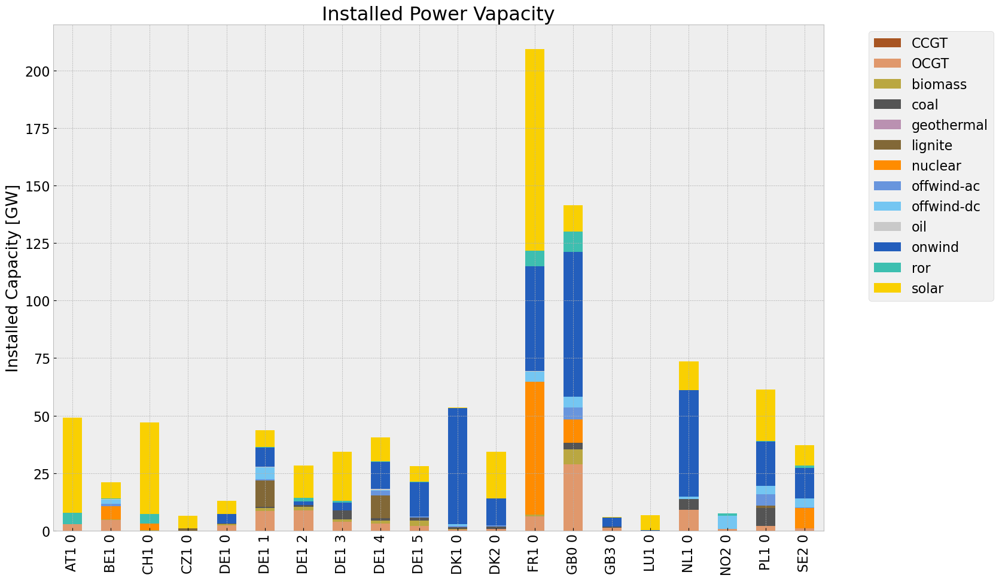

<Figure size 640x480 with 0 Axes>

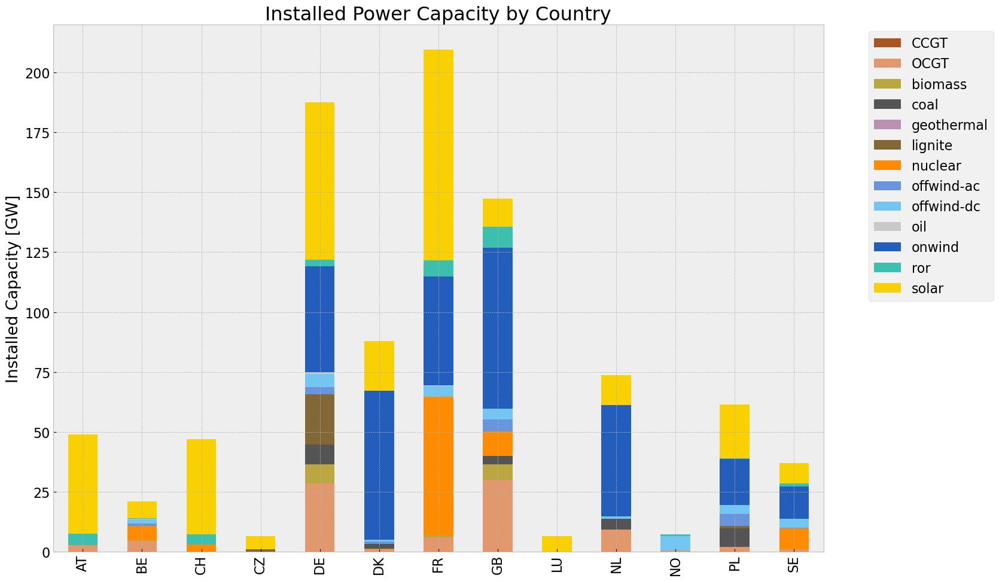

<Figure size 640x480 with 0 Axes>

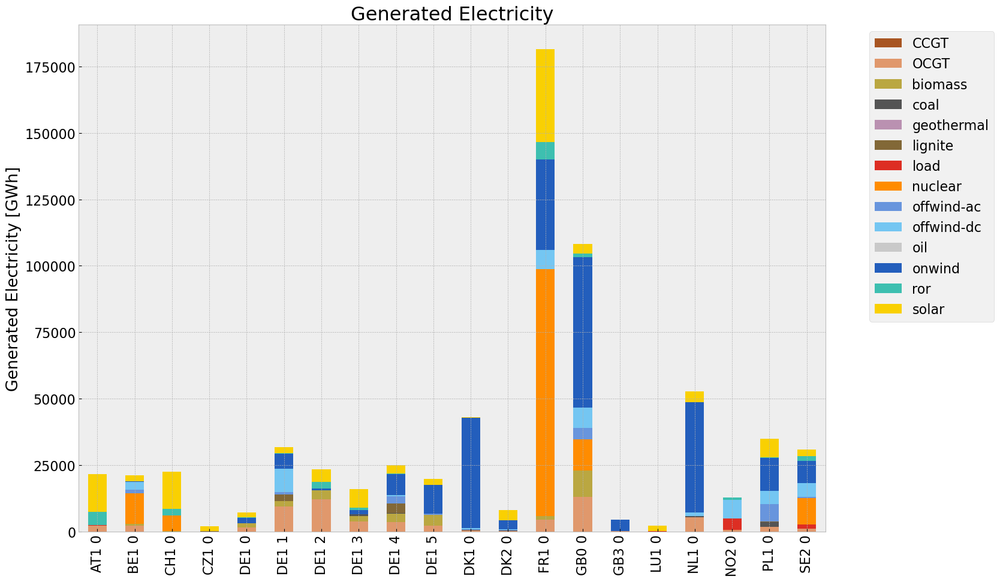

<Figure size 640x480 with 0 Axes>

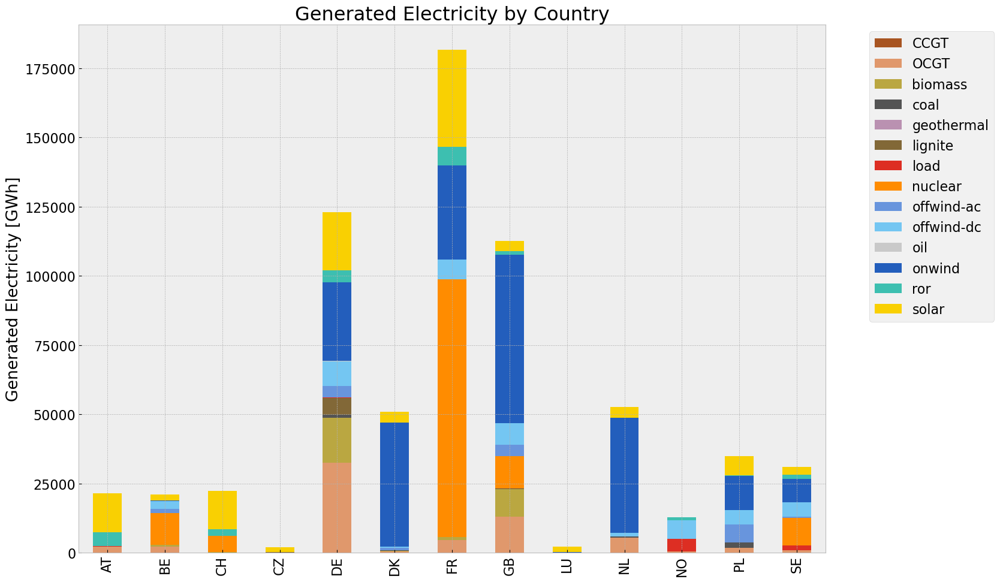

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,6.387140e+07,0.451621,0.1980,2.800255e+07
biomass,2.830825e+07,0.468000,0.0000,0.000000e+00
coal,3.787806e+06,0.329908,0.3361,3.858898e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.244218e+06,0.337285,0.4069,7.533019e+06
load,6.668860e+06,1.000000,0.0000,0.000000e+00
nuclear,1.320411e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.735933e+07,1.000000,0.0000,0.000000e+00


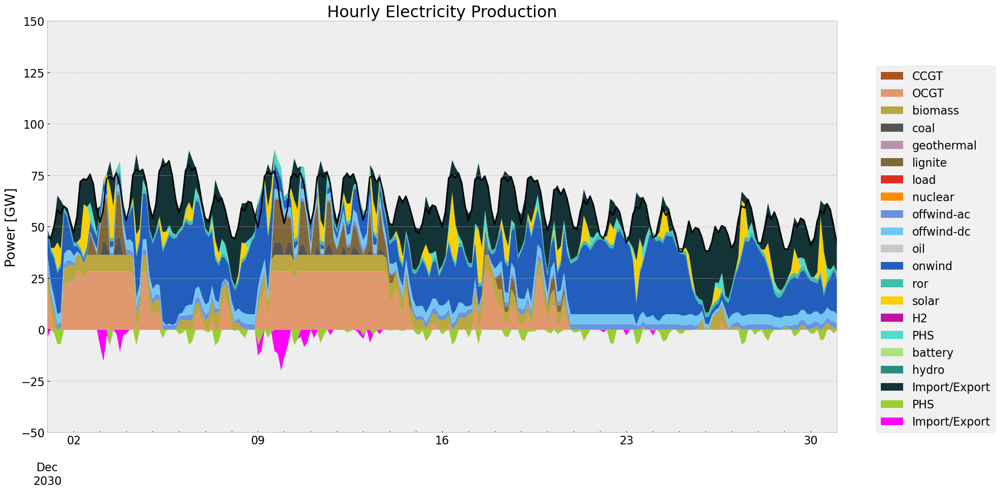

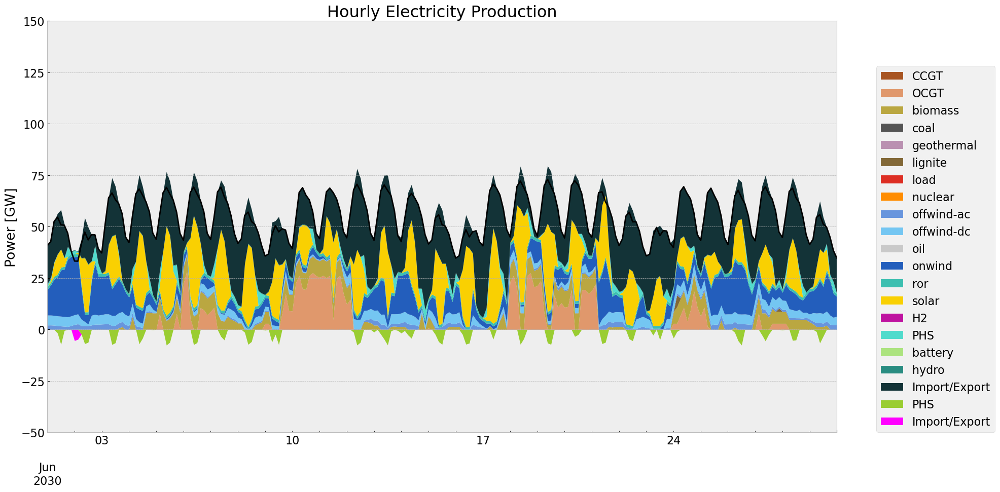

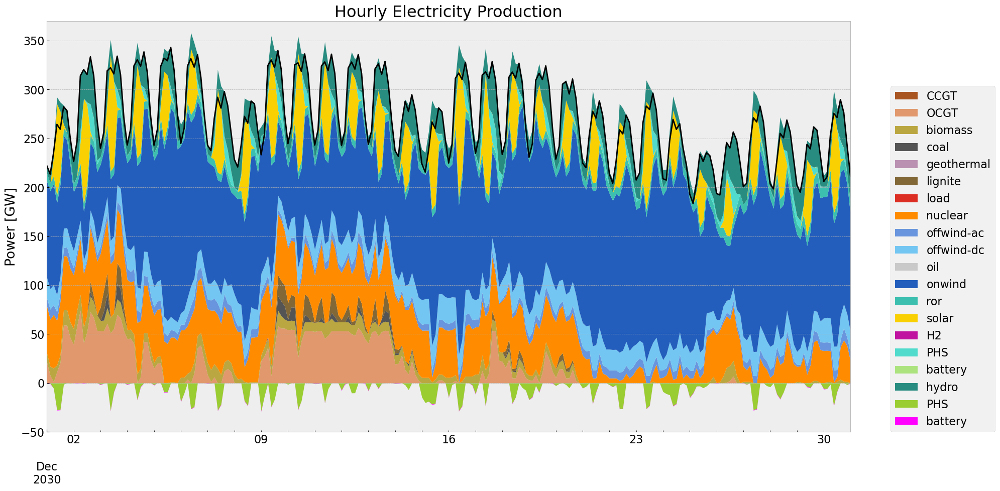

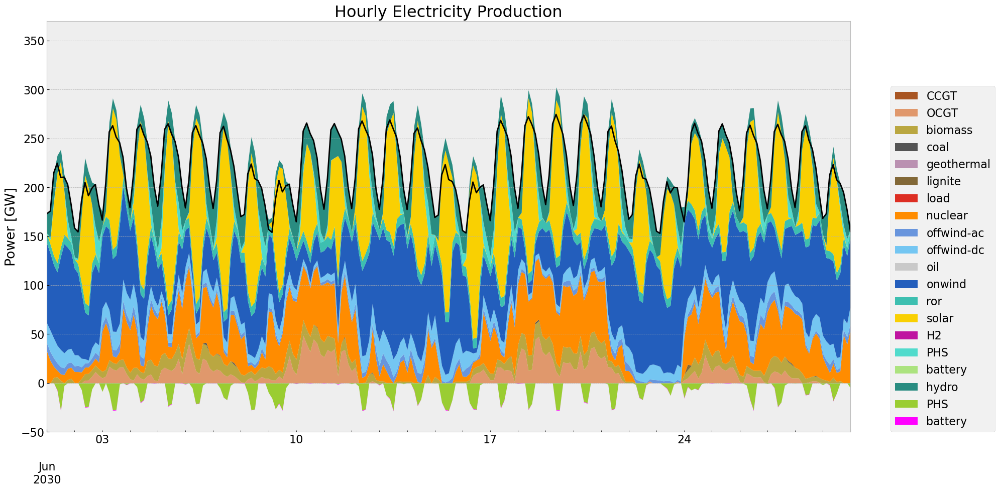

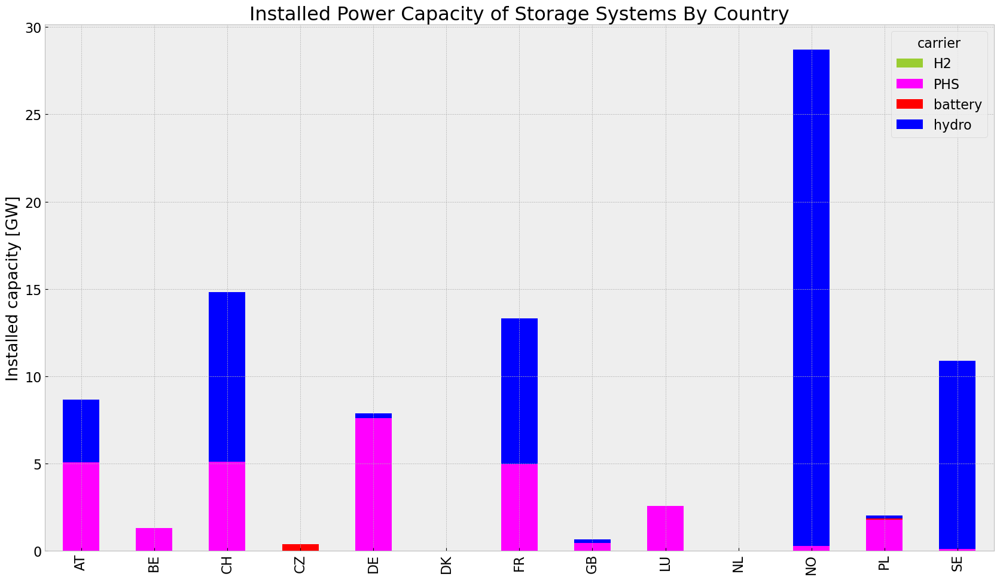

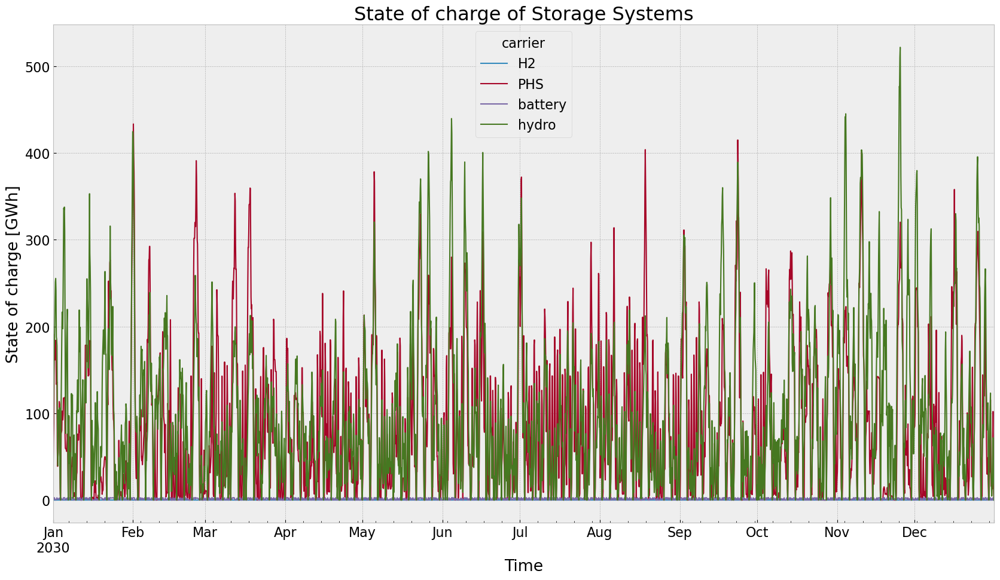

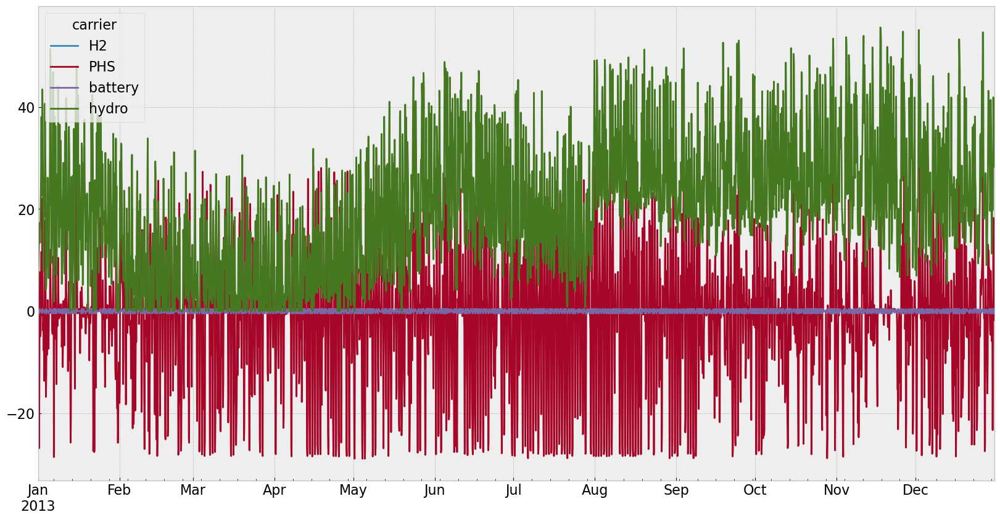

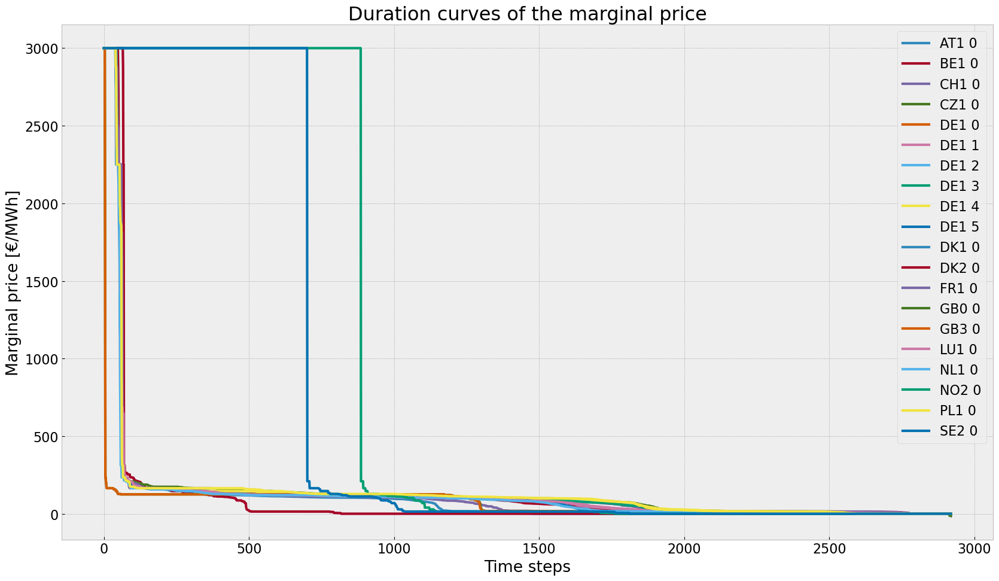

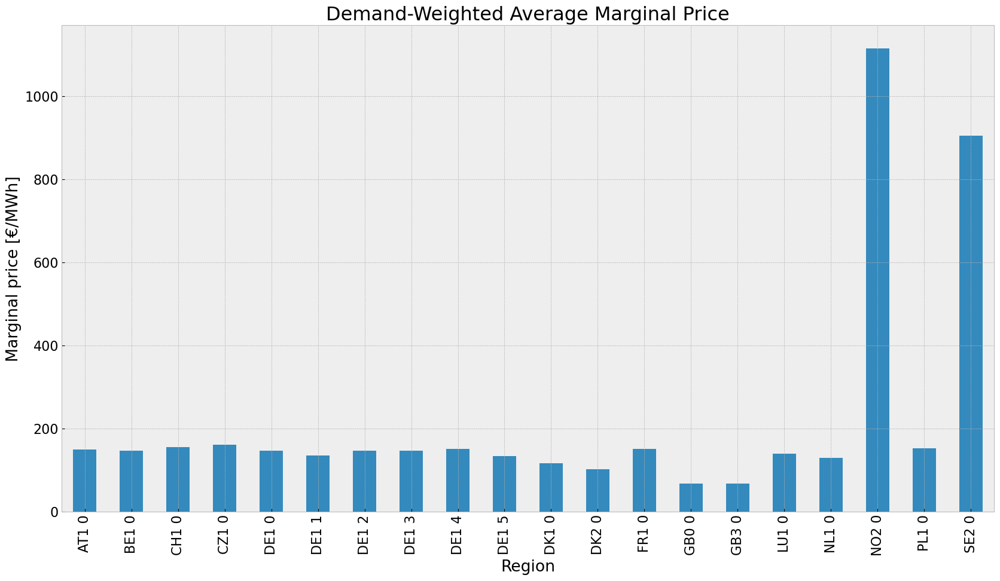

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


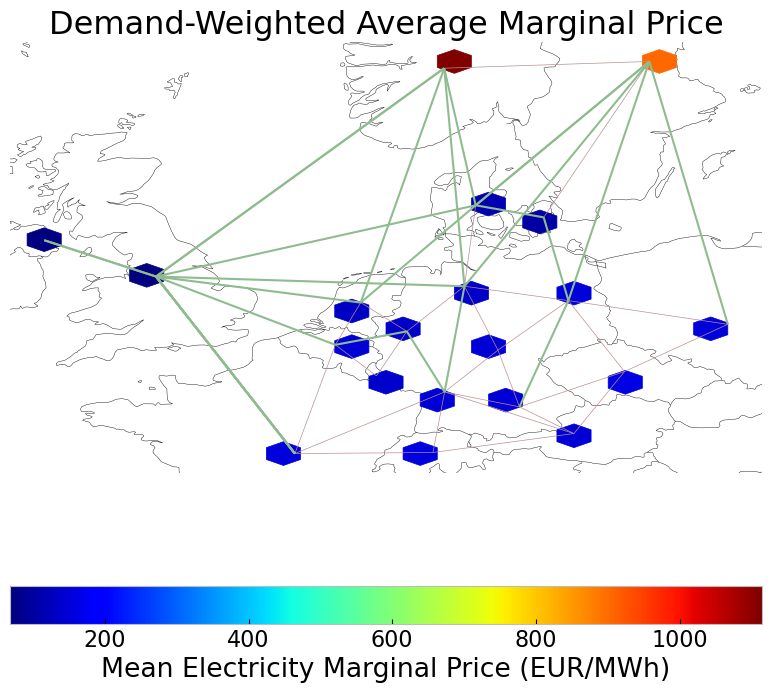

In [76]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4,colors_gen_table)
gen_inv_roll_country = gen_power_table_country(n4,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4)
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [77]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

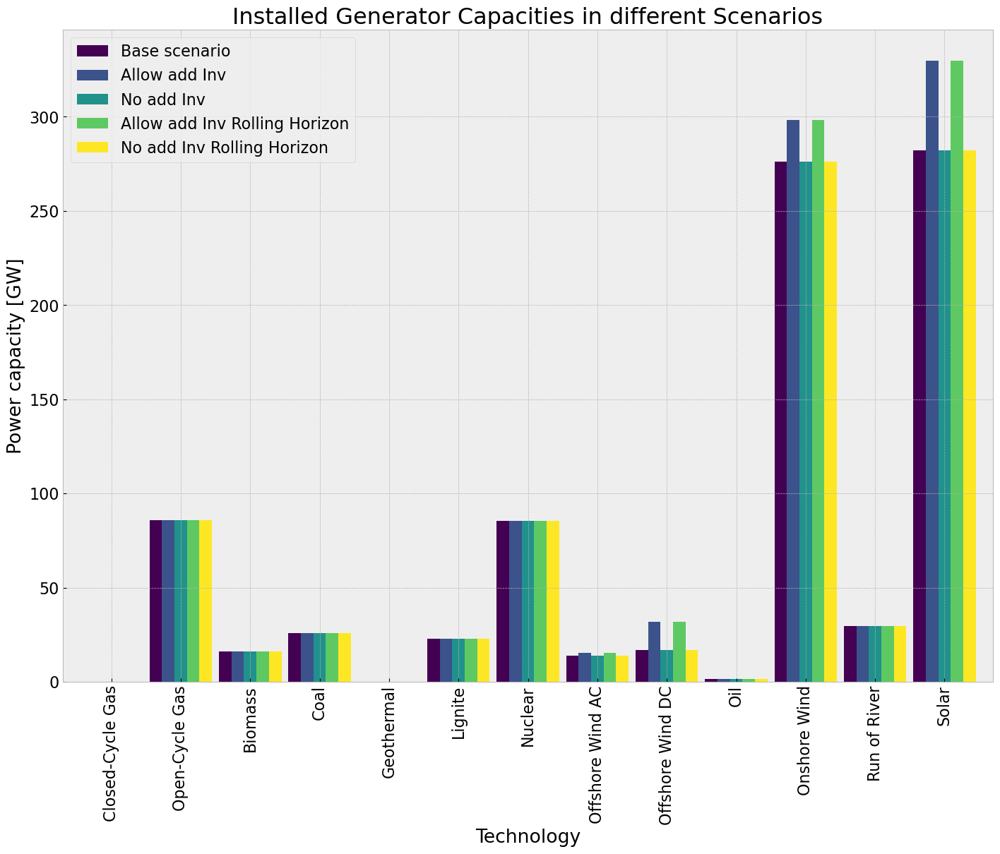

In [78]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


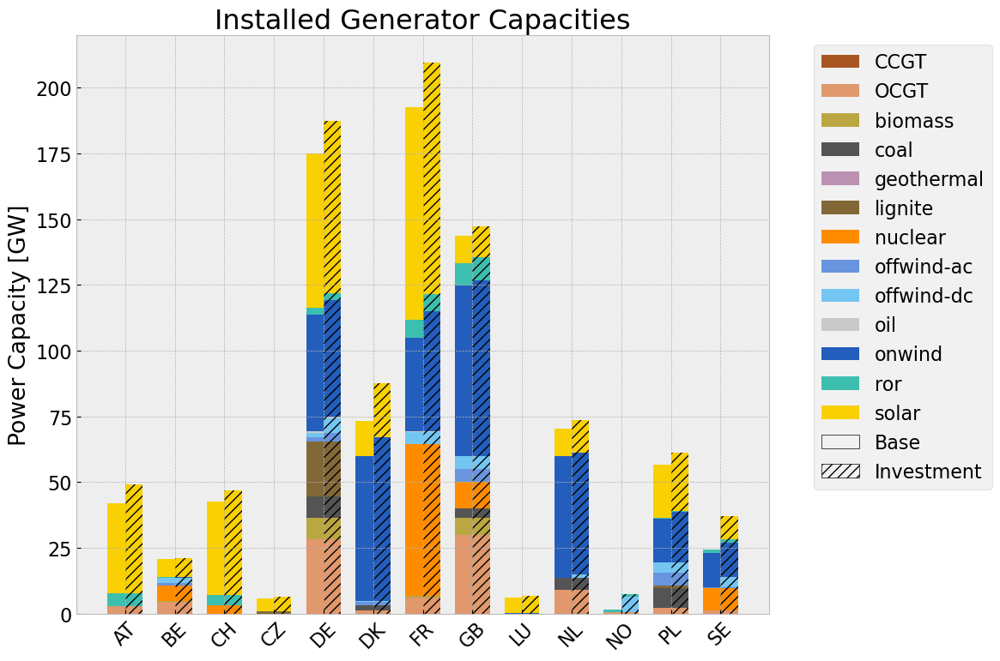

In [79]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv_drought.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

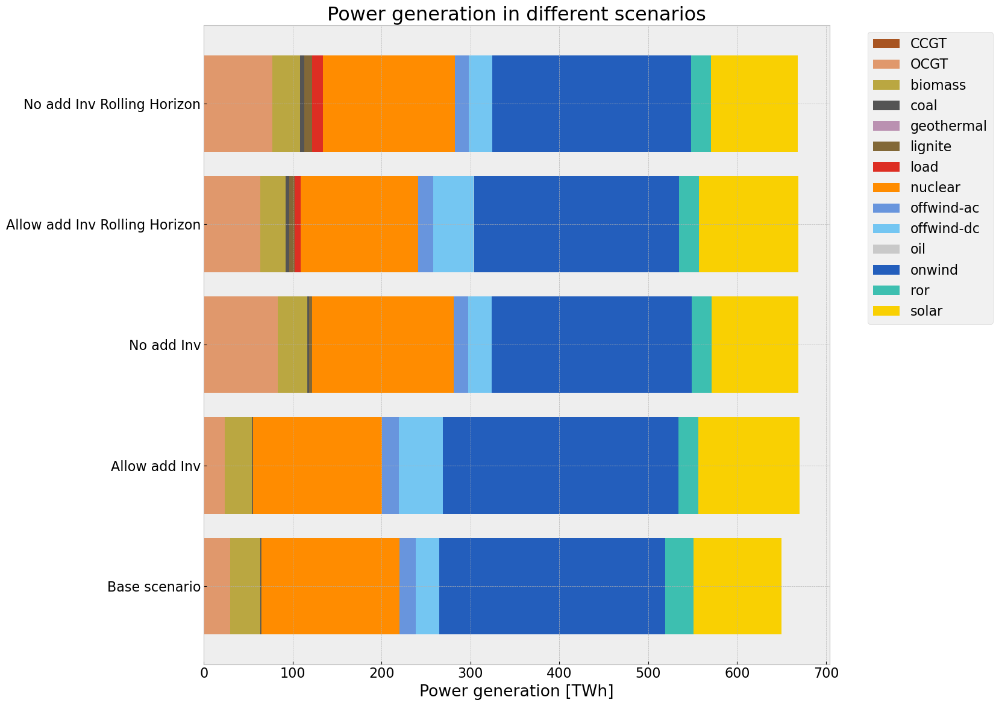

In [80]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = tech_list_gen_table)

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation_drought.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

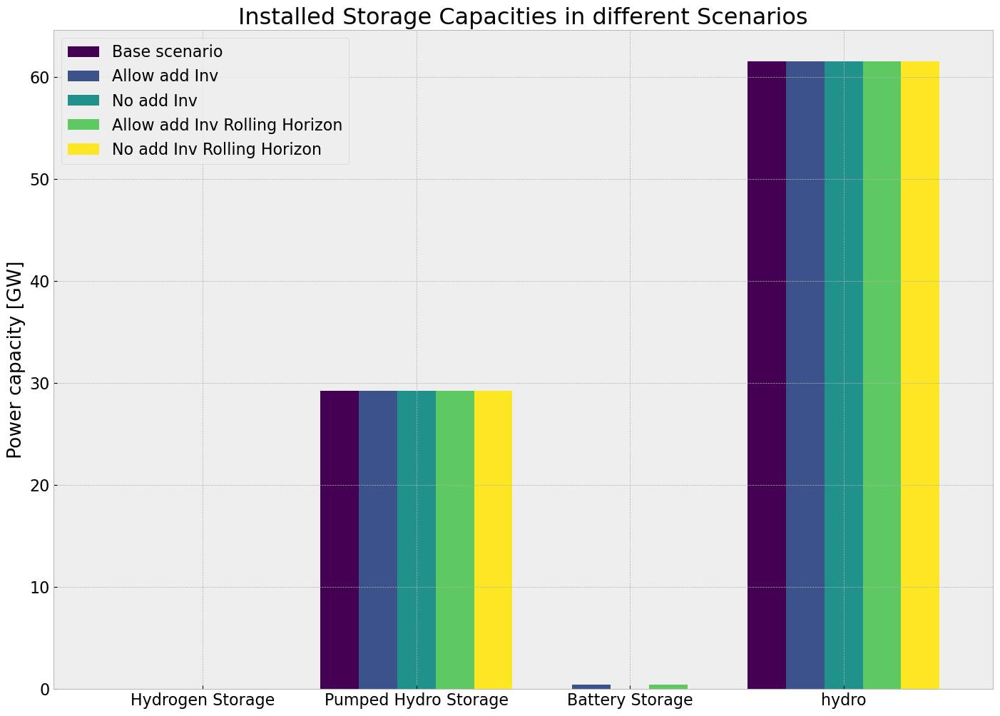

In [81]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap_drought.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

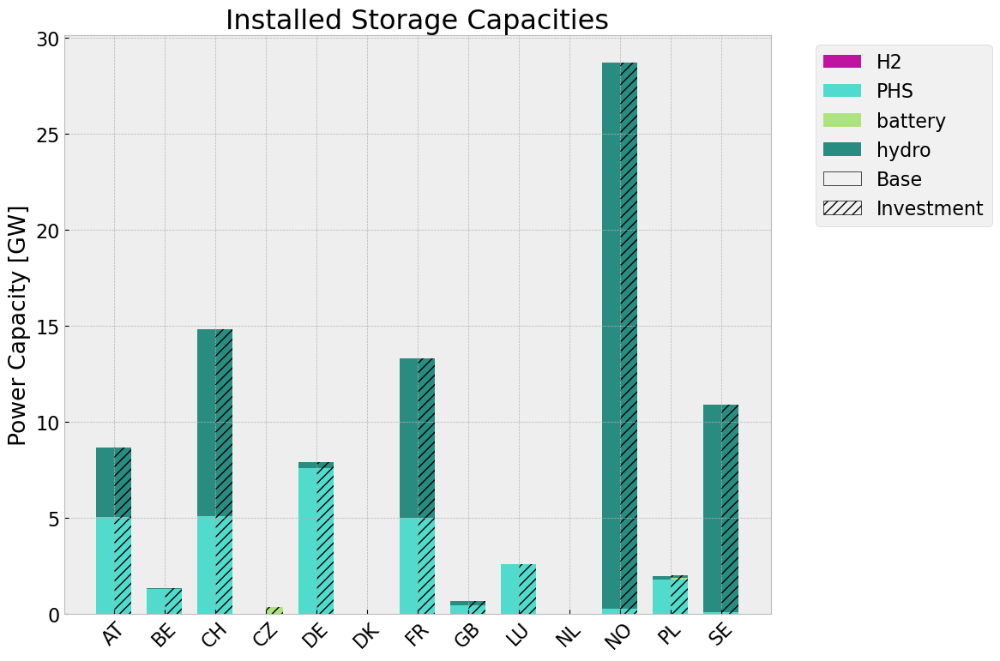

In [82]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv_drought.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [83]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3074275008.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3074275008.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


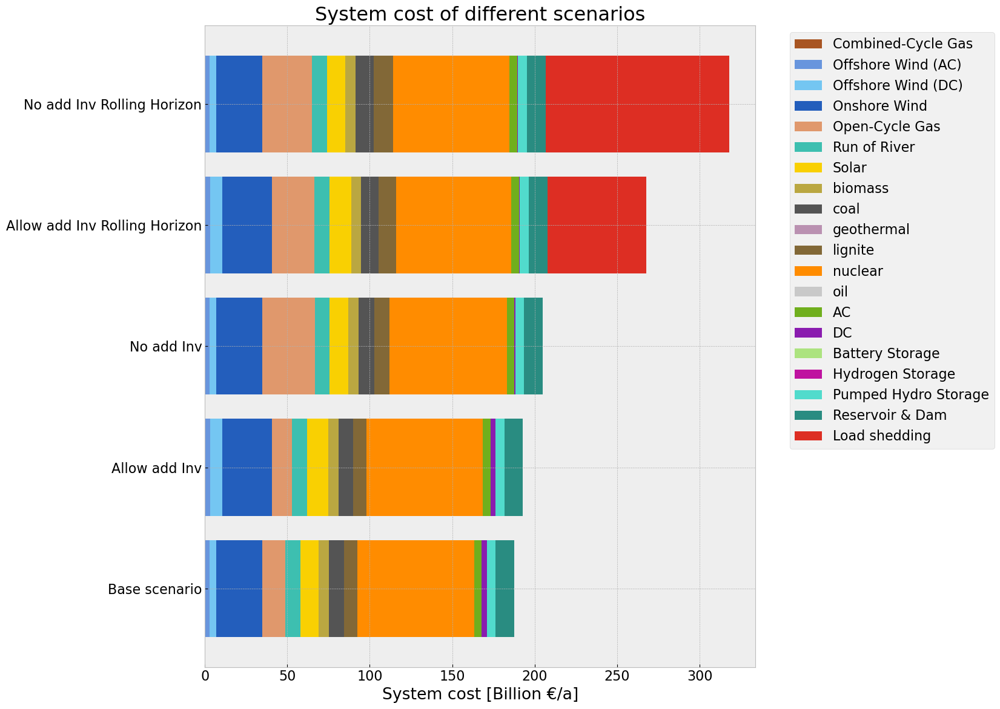

In [84]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost_drought.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [85]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [86]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


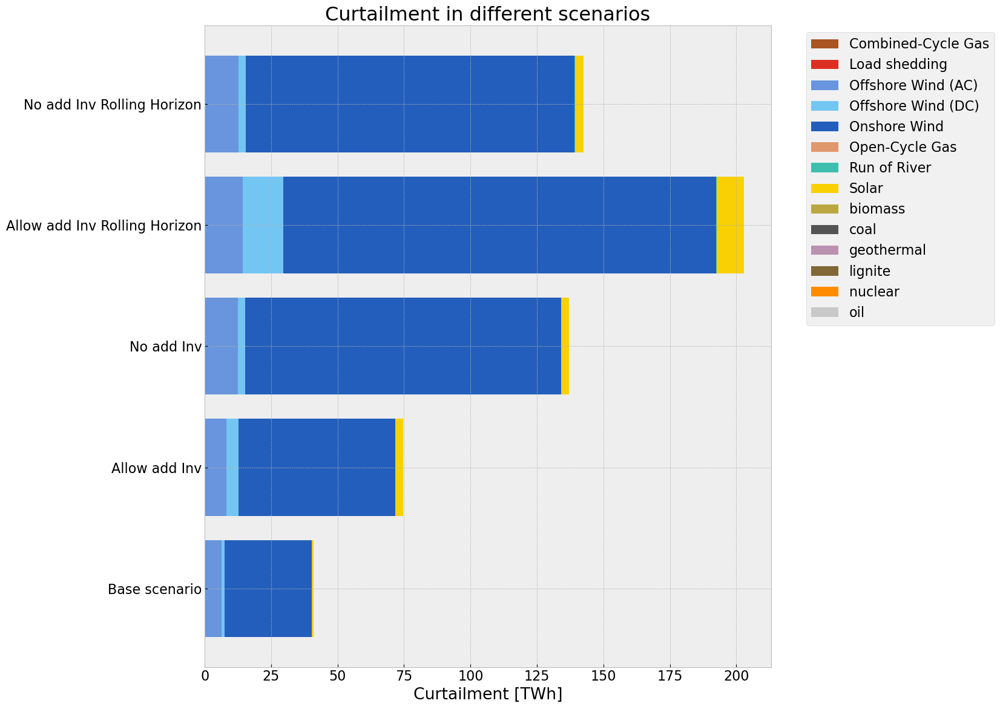

In [87]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment_drought.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_16500\1004574021.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


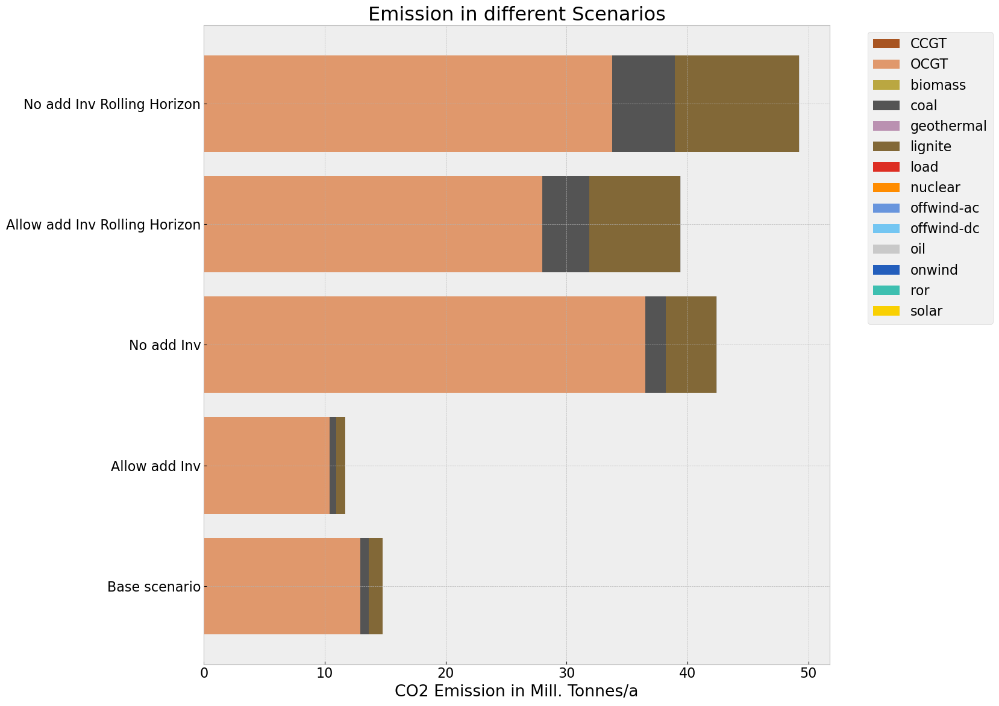

In [88]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission_drought.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()